In [1]:
import matplotlib.pyplot as plt
%matplotlib inline

import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils as utils
import torchvision.transforms as transforms

from torch.autograd import Variable

import os
import time

from PIL.Image import BICUBIC
from torchvision.datasets import MNIST
from ram import RecurrentAttentionModel
from trainer import *

### MNIST dataset
Testing out this model and training algorithm implementation on the basic MNIST dataset, which is pretty simple so hopefully everything goes well.

In [2]:
num_train_data_copies = 1  # Number of times to load the training dataset (with augmentation)
num_eval_data_copies = 1   # Number of times to load the evaluation dataset (with augmentation)
test_val_split = 0.5       # Percentage of the test set to use as validation data
batch_size = 20            # Batch size for training
eval_batch_size = 20       # Batch size for validation and testing

# Image parameters
num_classes = 10       # Digits 0-9
image_size = 28        # MNIST images are 28x28 b/w images
in_channels = 1        # Number of color channels in the inputs (MNIST dataset is grayscale)

glimpse_sizes = [8]  #[5, 10, 18]
padding = int(np.ceil(glimpse_sizes[-1] / 2))
padded_img_size = image_size + 2*padding

In [3]:
# Down/load MNIST data
mnist_data_loc = os.path.join('data', 'mnist')
data_transforms = transforms.Compose([ # Keep things pretty basic for now
    # Pad images with 0s so the GlimpseSensor won't have to
    transforms.Pad(padding = padding),
    # Converts a PIL Image or numpy.ndarray (H x W x C) in the range [0, 255]
    # to a torch.FloatTensor of shape (C x H x W) in the range [0.0, 1.0]
    transforms.ToTensor(),
])

'''
Can increase the number of images in each dataset by loading up the data again,
applying the (random) transformations, then concatenating it all together
'''
### Training Dataset and DataLoader
all_train_datasets = [
    MNIST(
        root = mnist_data_loc, train = True,
        download = True, transform = data_transforms
    ) for _ in range(num_train_data_copies)
]
train_datasets = utils.data.ConcatDataset(all_train_datasets)
train_data = utils.data.DataLoader(train_datasets, batch_size = batch_size, shuffle = True)
num_train_data = len(train_datasets)
num_train_batches = len(train_data)

### Validation and Test Dataset and DataLoader
all_eval_datasets = [
    MNIST(
        root = mnist_data_loc, train = False,
        download = True, transform = data_transforms
    ) for _ in range(num_eval_data_copies)
]
eval_datasets = utils.data.ConcatDataset(all_eval_datasets)
num_eval_data = len(eval_datasets)

eval_split_pt = int(test_val_split * num_eval_data)
eval_idx = list(range(num_eval_data))
np.random.shuffle(eval_idx)

val_idx, test_idx = eval_idx[:eval_split_pt], eval_idx[eval_split_pt:]

val_sampler = utils.data.sampler.SubsetRandomSampler(val_idx)
val_data = utils.data.DataLoader(
    eval_datasets, batch_size = eval_batch_size, sampler = val_sampler
)
num_val_data = len(val_sampler)
num_val_batches = len(val_data)

test_sampler = utils.data.sampler.SubsetRandomSampler(test_idx)
test_data = utils.data.DataLoader(
    eval_datasets, batch_size = eval_batch_size, sampler = test_sampler
)
num_test_data = len(test_sampler)
num_test_batches = len(test_data)

print('Num:\n- train data: %d (%d batches)\n- val data: %d (%d batches)\n- test data: %d (%d batches)' % (
    num_train_data, num_train_batches, num_val_data, num_val_batches, num_test_data, num_test_batches
))

Num:
- train data: 60000 (3000 batches)
- val data: 5000 (250 batches)
- test data: 5000 (250 batches)


In [4]:
# Basic training hyperparameters
lr = 1e-3
grad_clip = 2
lr_step_size = 1
steps_per_epoch = int(num_train_data_copies * 15)  # Number of times to step the lr scheduler in an epoch
decay_rate = 0.999

# RL training hyperparameters
end_train_ep_early = False     # End each training episode early after a correct classification
assert (end_train_ep_early and batch_size == 1) or not end_train_ep_early
max_ep_len = 6                 # Maximum number of glimpses per episode
num_epochs = 400               # Number of times to go through all of the training examples
early_stopping = int(num_epochs * 0.02)

random_start_loc = True
error_penalty = 0.  # Amount of penalty to apply each time the agent makes an incorrect classification (<= 0.)
gamma = 0.1         # Reward discount factor

# Etc
log_freq = num_train_batches // 10    # How often to print a training log in an epoch
viz_freq = num_train_batches // 5     # How often to visualize the glimpses in an epoch
eval_viz_freq = num_val_batches // 2  # How often to visualize the glimpses in an epoch

### Model
Need to modify class implementation so that any recurrent `nn.Module` instance can be passed in when initializing a new `RecurrentAttentionModel` to make it easier to try this visual attention mechanism out with different core recurrent networks.

In [5]:
# Model hyperparameters
glimpse_g_size = 128    # Size of the transformed Glimpse representation in the GlimpseNetwork
loc_g_size = 128        # Size of the transformed location representation in the GlimpseNetwork
glimpse_net_size = 256  # Size of the GlimpseNetwork output
rnn_state_size = 256
sensor_size = 8         # Size of the glimpses after resizing
g_rep_op = 'mul'

dropout = 0.0
# Standard deviation to use when sampling the glimpse location coordinates from a normal distribution
loc_std = 0.22

In [6]:
# Initialize the network
model = RecurrentAttentionModel(
    image_size = image_size, in_channels = in_channels,
    glimpse_g_size = glimpse_g_size, loc_g_size = loc_g_size,
    glimpse_net_size = glimpse_net_size, g_rep_op = g_rep_op,
    rnn_state_size = rnn_state_size, num_actions = num_classes,
    sensor_size = sensor_size, glimpse_sizes = glimpse_sizes,
    pad_imgs = False, padding = padding, dropout = dropout
)
num_parameters = sum([p.numel() for p in model.parameters()])
print('Model has %d parameters' % num_parameters)

# Criterion, optimizer, learning rate scheduler
class_criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr = lr)
lr_scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma = decay_rate)

Model has 547085 parameters


Epoch   1/400) lr = 0.001
 b    300/  3000 >> 163.6 ms/b | lr: 9.99e-04 | grad 2norm:  4.17 | grad inf norm:  2.751
         Weights || abs max:  0.37 ( 7331.83) | mean: -6.30e-05 ( 0.03) | var: 2.13e-03 ( 1612.25)
          Biases || abs max:  0.12 (29032.31) | mean:  1.03e-02 (22.57) | var: 3.98e-04 (83454224.00)
                    class loss: 2.031 | steps: 4.562 | reward:  1.352 | acc.: 27.73%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 160.6 ms/b | lr: 9.98e-04 | grad 2norm:  5.89 | grad inf norm:  2.242
         Weights || abs max:  0.49 ( 5716.62) | mean: -5.18e-04 ( 0.04) | var: 4.56e-03 (  309.45)
          Biases || abs max:  0.25 ( 1195.87) | mean:  1.69e-02 ( 1.61) | var: 9.78e-04 ( 7109.63)
                    class loss: 1.647 | steps: 4.152 | reward:  1.894 | acc.: 42.23%

	Target class: 8 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]
	                | Baseline rewards:   [0.28

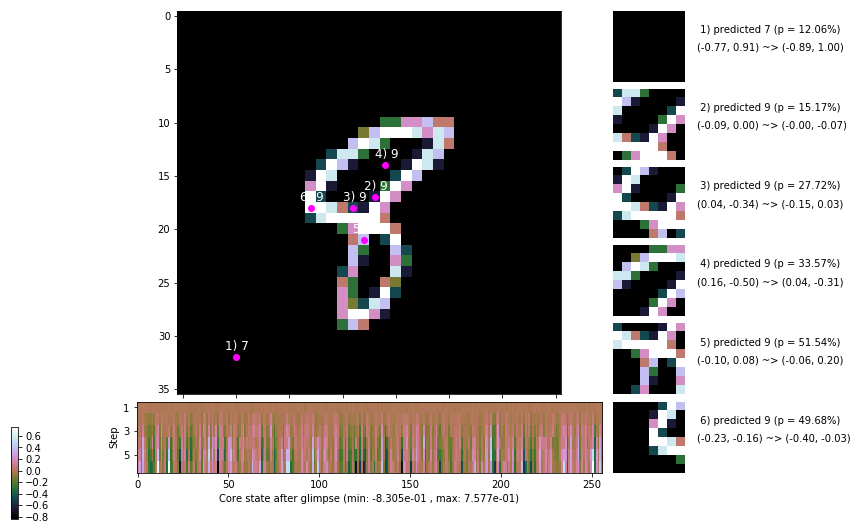

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 164.1 ms/b | lr: 9.96e-04 | grad 2norm:  7.10 | grad inf norm:  2.364
         Weights || abs max:  0.53 (36378.30) | mean: -4.85e-04 ( 0.09) | var: 6.16e-03 (471295.94)
          Biases || abs max:  0.29 ( 4410.66) | mean:  1.67e-02 ( 3.99) | var: 1.37e-03 (2923897.50)
                    class loss: 1.391 | steps: 3.768 | reward:  2.367 | acc.: 52.28%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 155.9 ms/b | lr: 9.95e-04 | grad 2norm:  7.82 | grad inf norm:  2.444
         Weights || abs max:  0.64 ( 7177.46) | mean: -3.15e-04 ( 0.04) | var: 7.30e-03 ( 1413.42)
          Biases || abs max:  0.32 (  715.25) | mean:  1.60e-02 ( 0.98) | var: 1.70e-03 ( 2474.87)
                    class loss: 1.275 | steps: 3.577 | reward:  2.606 | acc.: 56.52%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 

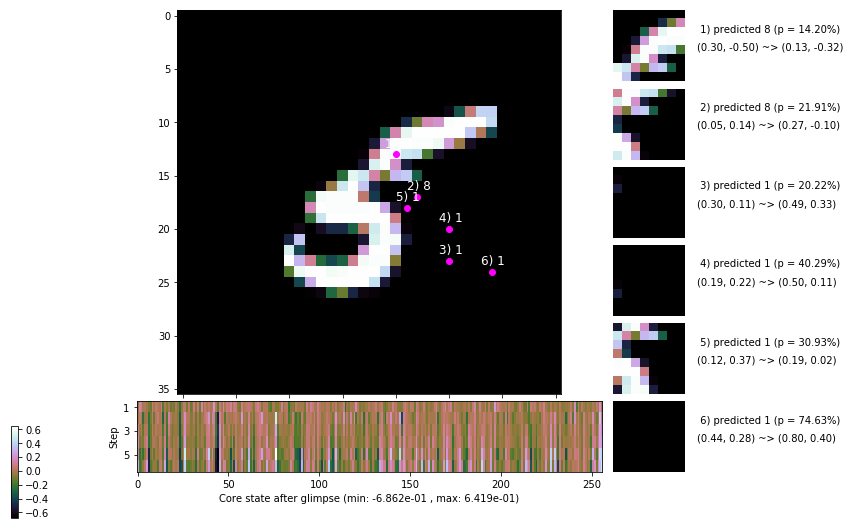

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 156.5 ms/b | lr: 9.93e-04 | grad 2norm:  8.56 | grad inf norm:  2.486
         Weights || abs max:  0.68 ( 8083.96) | mean: -1.70e-04 ( 0.04) | var: 8.20e-03 ( 2194.97)
          Biases || abs max:  0.35 (  646.15) | mean:  1.58e-02 ( 0.91) | var: 2.06e-03 ( 5391.83)
                    class loss: 1.112 | steps: 3.343 | reward:  2.938 | acc.: 62.65%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 155.0 ms/b | lr: 9.92e-04 | grad 2norm:  8.80 | grad inf norm:  2.444
         Weights || abs max:  0.73 (16813.46) | mean: -3.42e-05 ( 0.06) | var: 8.96e-03 (13973.26)
          Biases || abs max:  0.36 (  919.28) | mean:  1.44e-02 ( 0.93) | var: 2.38e-03 (27013.16)
                    class loss: 1.060 | steps: 3.338 | reward:  2.953 | acc.: 63.57%

	Target class: 1 | Discounted rewards: [0.011, 0.111, 1.1

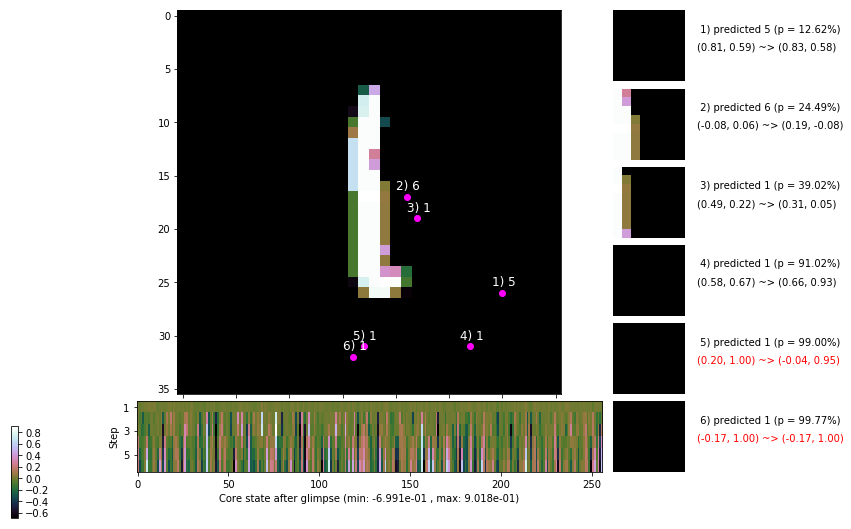

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 157.2 ms/b | lr: 9.90e-04 | grad 2norm:  8.93 | grad inf norm:  2.325
         Weights || abs max:  0.76 (12687.07) | mean:  7.63e-05 ( 0.05) | var: 9.65e-03 (20106.76)
          Biases || abs max:  0.38 (  282.62) | mean:  1.31e-02 ( 0.51) | var: 2.75e-03 (  381.91)
                    class loss: 0.981 | steps: 3.209 | reward:  3.135 | acc.: 66.12%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 154.0 ms/b | lr: 9.89e-04 | grad 2norm:  9.10 | grad inf norm:  2.360
         Weights || abs max:  0.80 ( 6623.61) | mean:  1.23e-04 ( 0.04) | var: 1.02e-02 (  780.96)
          Biases || abs max:  0.40 (  381.21) | mean:  1.07e-02 ( 0.54) | var: 3.07e-03 ( 1119.85)
                    class loss: 0.968 | steps: 3.200 | reward:  3.184 | acc.: 67.15%

	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.1

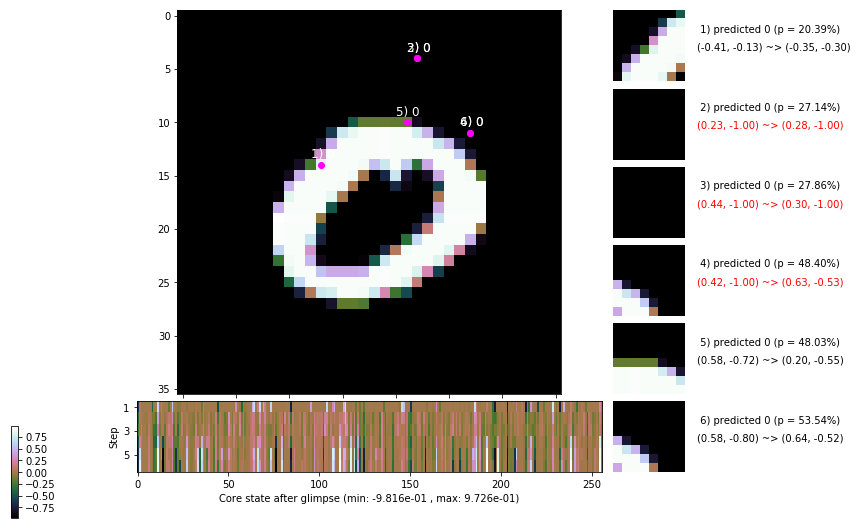

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 155.7 ms/b | lr: 9.87e-04 | grad 2norm:  9.05 | grad inf norm:  2.440
         Weights || abs max:  0.89 (65961.64) | mean:  2.14e-04 ( 0.14) | var: 1.08e-02 (1800055.25)
          Biases || abs max:  0.41 (  710.66) | mean:  8.61e-03 ( 0.82) | var: 3.44e-03 (18111.58)
                    class loss: 0.923 | steps: 3.137 | reward:  3.233 | acc.: 67.83%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 156.9 ms/b | lr: 9.86e-04 | grad 2norm:  9.04 | grad inf norm:  2.351
         Weights || abs max:  0.92 (10692.65) | mean:  2.39e-04 ( 0.04) | var: 1.13e-02 ( 4101.37)
          Biases || abs max:  0.41 (  715.05) | mean:  5.80e-03 ( 0.73) | var: 3.82e-03 ( 6130.42)
                    class loss: 0.897 | steps: 3.120 | reward:  3.259 | acc.: 68.90%

	Target class: 3 | Discounted rewards: [0.111, 1.111, 1

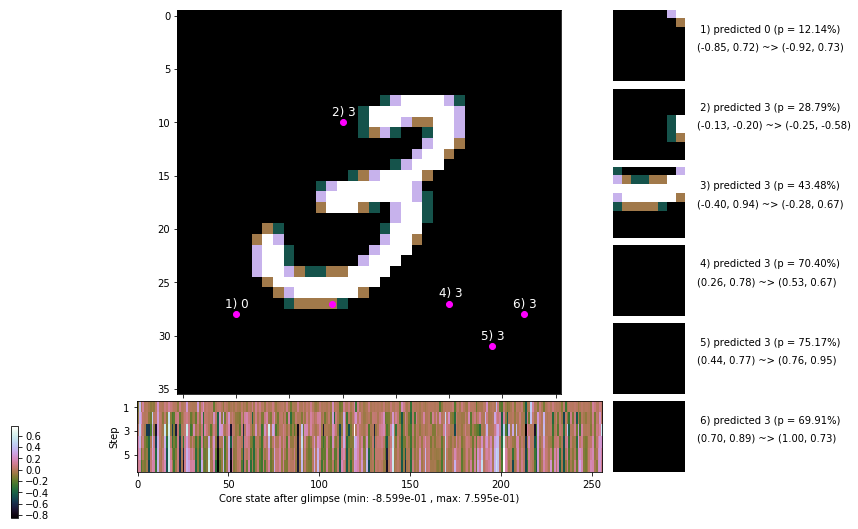

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


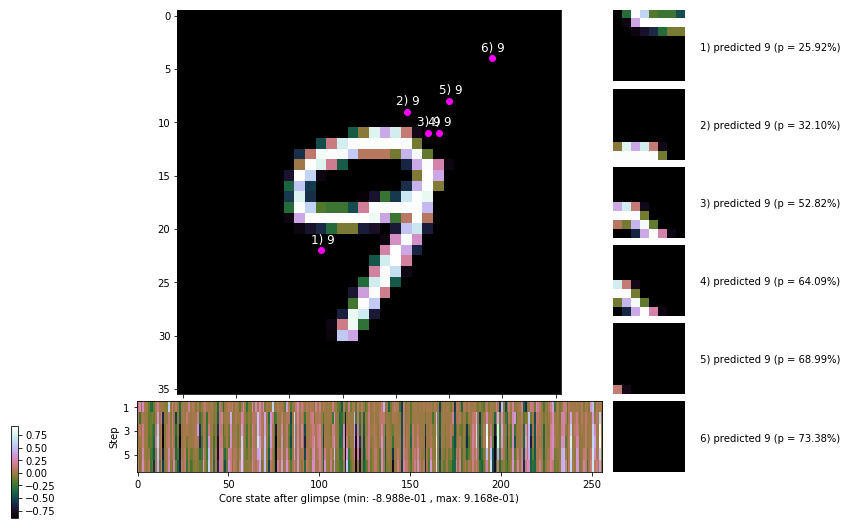


	Target class: 5 | Discounted rewards: [0.000, 0.001, 0.011, 0.110, 1.100, 1.000]


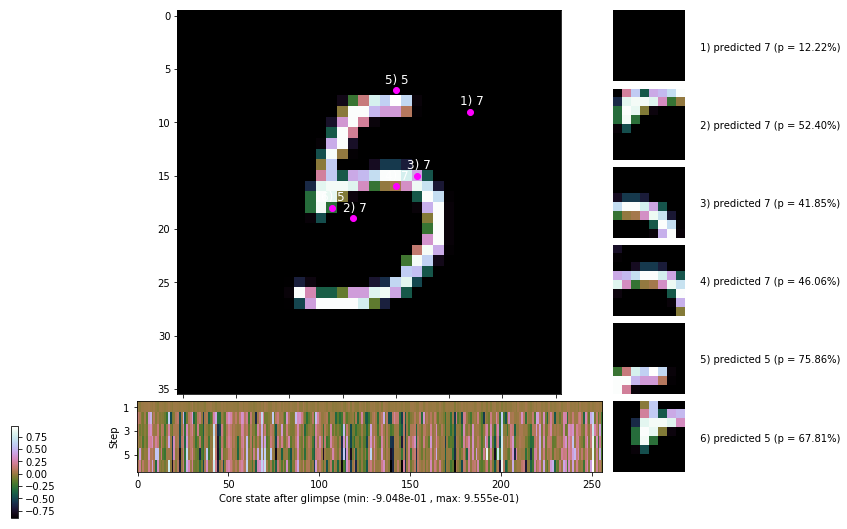

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


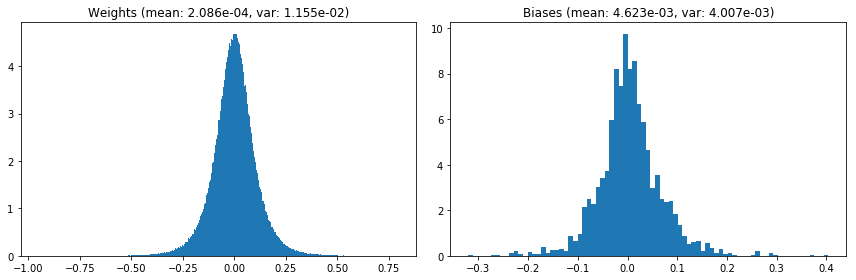

                                      Location network weights and biases


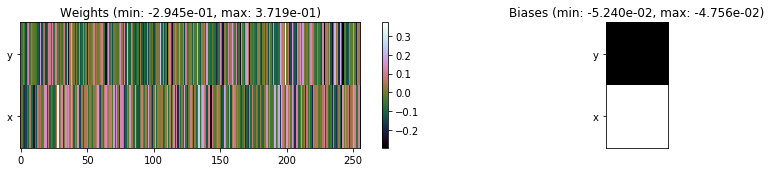

---------------------------------------------------------------------------------------------------------------
Elapsed time:  474.47 sec | TRAIN >> class loss: 1.2282 | steps:  3.541    | reward:  2.6921    | acc.: 57.498% 
                          | VAL   >> class loss: 0.9207 | steps:  2.952    | reward:  3.4522    | acc.: 68.420% 


Epoch   2/400) lr = 0.0009851
 b    300/  3000 >> 154.0 ms/b | lr: 9.84e-04 | grad 2norm:  9.31 | grad inf norm:  2.493
         Weights || abs max:  0.95 (13831.01) | mean:  2.00e-04 ( 0.05) | var: 1.18e-02 (40973.53)
          Biases || abs max:  0.40 (  437.86) | mean:  3.43e-03 ( 0.59) | var: 4.22e-03 ( 1350.63)
                    class loss: 0.877 | steps: 3.077 | reward:  3.338 | acc.: 70.13%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 155.6 ms/b | lr: 9.83e-04 | grad 2norm:  9.43 | grad inf norm:  2.493
         Weights || abs max:  0.98 ( 6688.45) | mean:  2.02e-04 ( 0.0

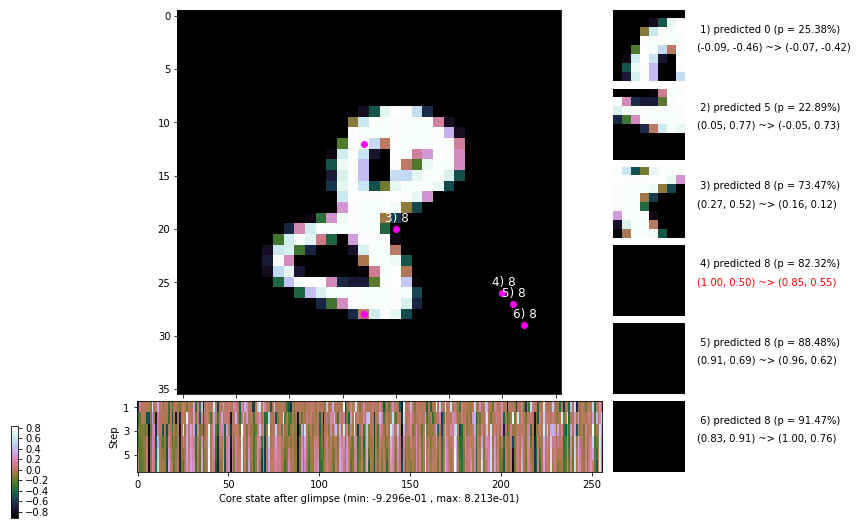

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 160.0 ms/b | lr: 9.81e-04 | grad 2norm:  9.38 | grad inf norm:  2.420
         Weights || abs max:  1.00 ( 6777.65) | mean:  2.10e-04 ( 0.04) | var: 1.26e-02 (  771.71)
          Biases || abs max:  0.42 (  462.65) | mean: -1.18e-03 ( 0.49) | var: 4.97e-03 ( 1992.09)
                    class loss: 0.818 | steps: 2.953 | reward:  3.479 | acc.: 72.93%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 172.3 ms/b | lr: 9.80e-04 | grad 2norm:  9.53 | grad inf norm:  2.421
         Weights || abs max:  1.01 (22838.48) | mean:  2.08e-04 ( 0.06) | var: 1.31e-02 (164619.05)
          Biases || abs max:  0.43 (  246.92) | mean: -3.16e-03 ( 0.34) | var: 5.32e-03 (  286.89)
                    class loss: 0.819 | steps: 2.977 | reward:  3.446 | acc.: 71.47%

	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.

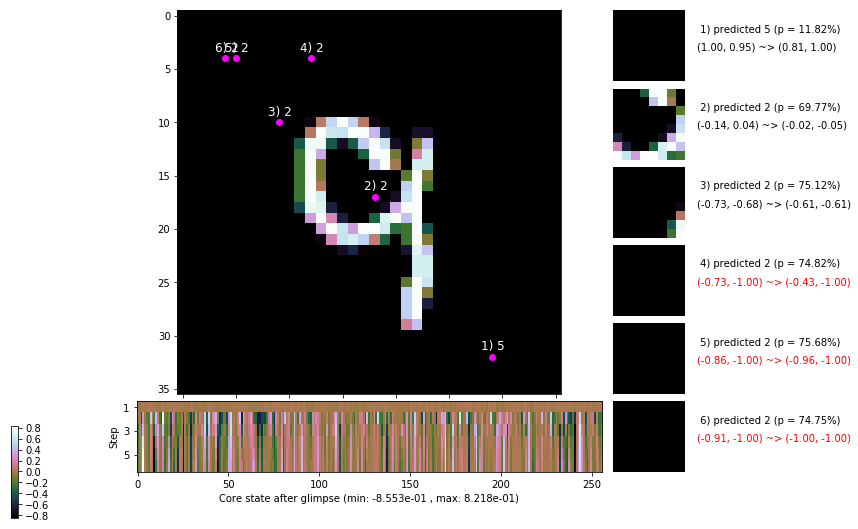

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 175.8 ms/b | lr: 9.78e-04 | grad 2norm:  9.68 | grad inf norm:  2.433
         Weights || abs max:  1.05 (28324.64) | mean:  2.73e-04 ( 0.07) | var: 1.35e-02 (169847.09)
          Biases || abs max:  0.43 (  278.60) | mean: -5.63e-03 ( 0.36) | var: 5.75e-03 (  728.26)
                    class loss: 0.830 | steps: 2.979 | reward:  3.434 | acc.: 71.63%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 165.2 ms/b | lr: 9.77e-04 | grad 2norm:  9.63 | grad inf norm:  2.418
         Weights || abs max:  1.06 ( 5435.72) | mean:  3.03e-04 ( 0.03) | var: 1.38e-02 (  773.79)
          Biases || abs max:  0.44 (  336.26) | mean: -8.42e-03 ( 0.40) | var: 6.20e-03 ( 1974.66)
                    class loss: 0.777 | steps: 2.873 | reward:  3.554 | acc.: 73.58%

	Target class: 5 | Discounted rewards: [0.001, 0.011, 0.

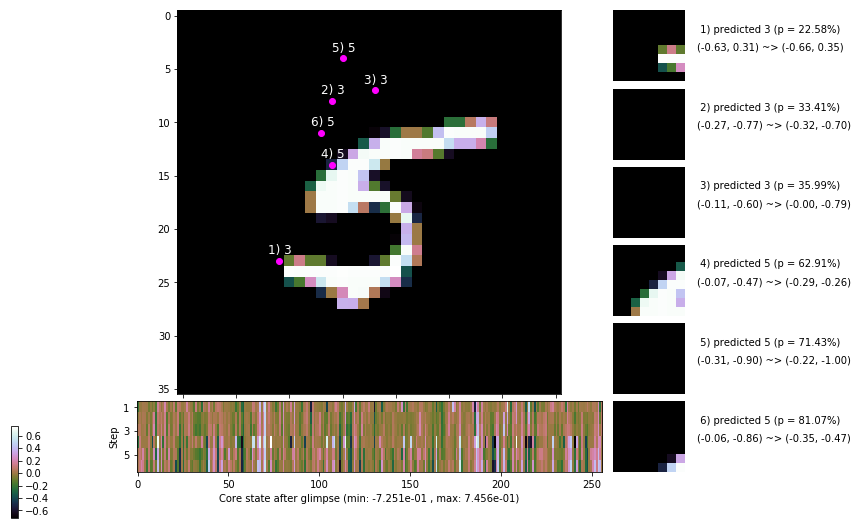

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 165.8 ms/b | lr: 9.75e-04 | grad 2norm:  9.71 | grad inf norm:  2.485
         Weights || abs max:  1.09 (11643.59) | mean:  2.88e-04 ( 0.04) | var: 1.42e-02 (20518.82)
          Biases || abs max:  0.44 (  481.02) | mean: -1.05e-02 ( 0.46) | var: 6.61e-03 ( 1280.30)
                    class loss: 0.759 | steps: 2.868 | reward:  3.572 | acc.: 74.00%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 164.3 ms/b | lr: 9.74e-04 | grad 2norm:  9.79 | grad inf norm:  2.444
         Weights || abs max:  1.10 ( 4000.14) | mean:  3.11e-04 ( 0.03) | var: 1.45e-02 (  183.44)
          Biases || abs max:  0.45 (  277.18) | mean: -1.29e-02 ( 0.33) | var: 7.10e-03 (  242.53)
                    class loss: 0.755 | steps: 2.877 | reward:  3.565 | acc.: 74.52%

	Target class: 9 | Discounted rewards: [1.111, 1.111, 1.1

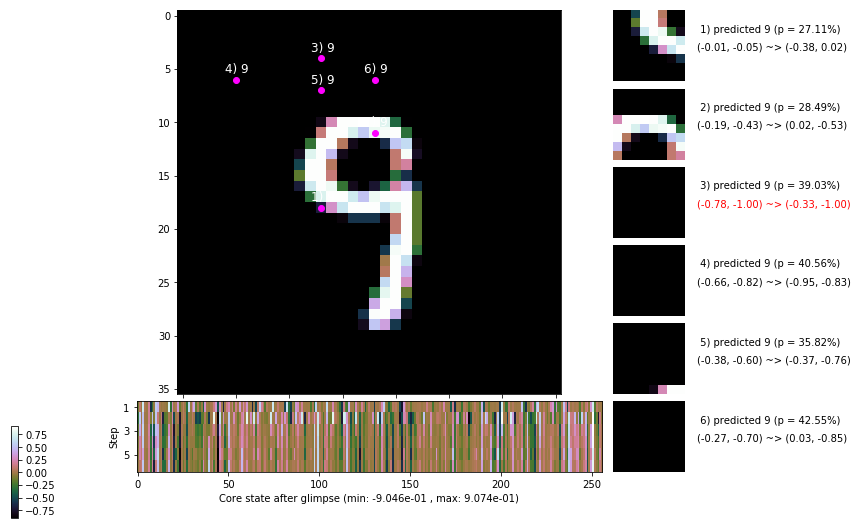

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 169.9 ms/b | lr: 9.72e-04 | grad 2norm:  9.72 | grad inf norm:  2.379
         Weights || abs max:  1.11 (11127.44) | mean:  2.71e-04 ( 0.04) | var: 1.49e-02 (11817.08)
          Biases || abs max:  0.45 ( 2028.74) | mean: -1.46e-02 ( 1.14) | var: 7.45e-03 (239304.27)
                    class loss: 0.689 | steps: 2.803 | reward:  3.679 | acc.: 76.85%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 163.9 ms/b | lr: 9.71e-04 | grad 2norm: 10.00 | grad inf norm:  2.500
         Weights || abs max:  1.11 ( 4581.68) | mean:  2.39e-04 ( 0.03) | var: 1.52e-02 (  644.51)
          Biases || abs max:  0.45 (  362.73) | mean: -1.54e-02 ( 0.39) | var: 7.77e-03 ( 1283.73)
                    class loss: 0.668 | steps: 2.771 | reward:  3.745 | acc.: 77.82%

	Target class: 3 | Discounted rewards: [0.100, 1.000, 0.

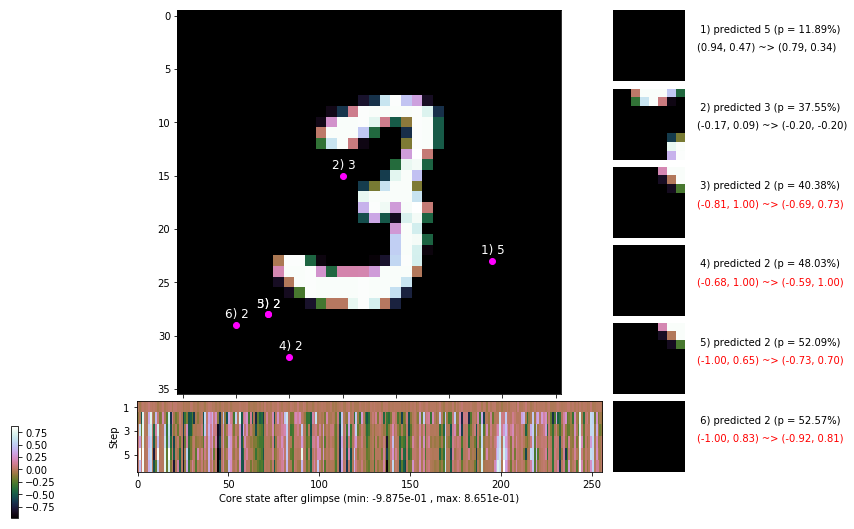

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


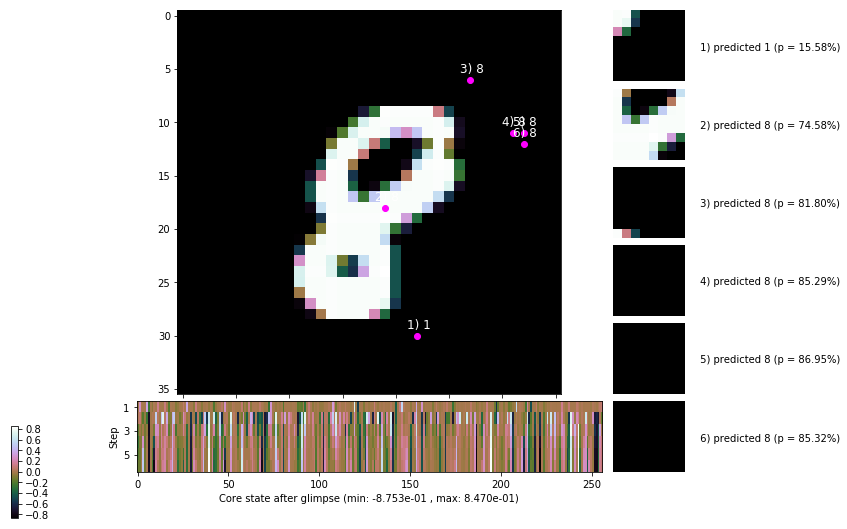


	Target class: 4 | Discounted rewards: [0.011, 0.111, 1.111, 1.110, 1.100, 1.000]


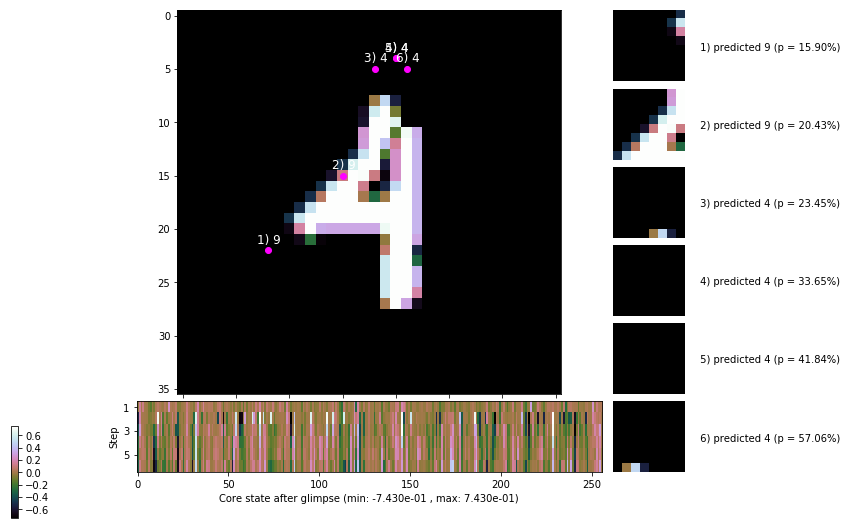

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


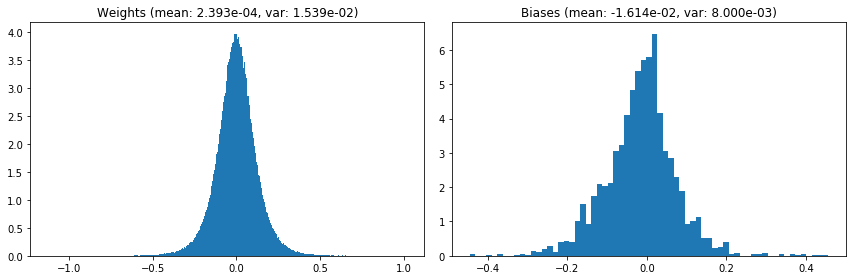

                                      Location network weights and biases


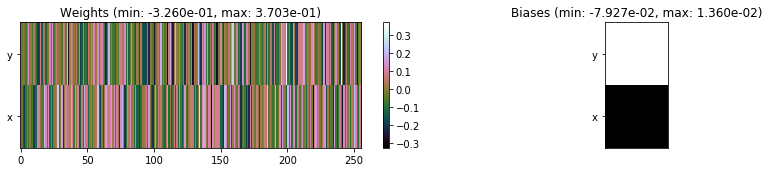

---------------------------------------------------------------------------------------------------------------
Elapsed time:  494.80 sec | TRAIN >> class loss: 0.7812 | steps:  2.915    | reward:  3.5276    | acc.: 73.517% 
                          | VAL   >> class loss: 0.6691 | steps:  2.678    | reward:  3.7876    | acc.: 75.980% 


Epoch   3/400) lr = 0.0009704
 b    300/  3000 >> 163.0 ms/b | lr: 9.69e-04 | grad 2norm:  9.85 | grad inf norm:  2.360
         Weights || abs max:  1.13 ( 9988.85) | mean:  2.52e-04 ( 0.04) | var: 1.56e-02 ( 7967.13)
          Biases || abs max:  0.46 (  230.34) | mean: -1.74e-02 ( 0.28) | var: 8.25e-03 (  553.79)
                    class loss: 0.676 | steps: 2.777 | reward:  3.687 | acc.: 76.60%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 167.7 ms/b | lr: 9.68e-04 | grad 2norm:  9.92 | grad inf norm:  2.336
         Weights || abs max:  1.15 ( 4601.10) | mean:  2.50e-04 ( 0.0

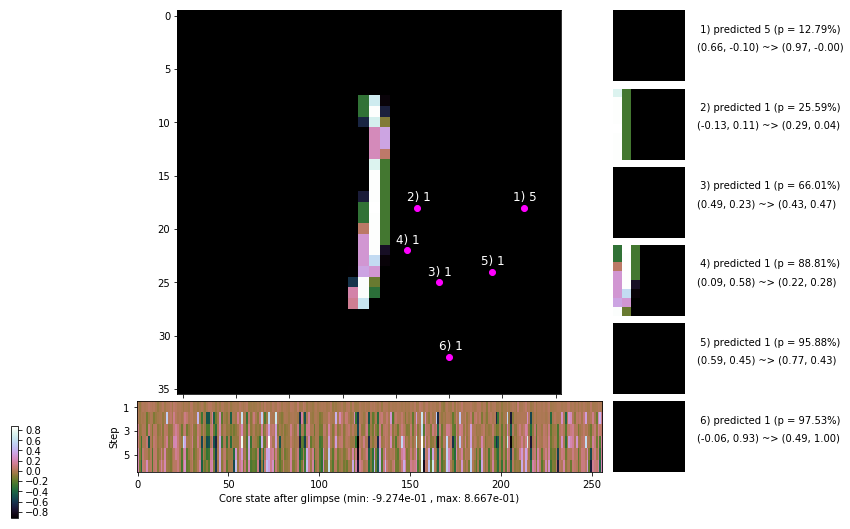

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 168.5 ms/b | lr: 9.67e-04 | grad 2norm:  9.89 | grad inf norm:  2.387
         Weights || abs max:  1.16 ( 6197.75) | mean:  3.34e-04 ( 0.03) | var: 1.62e-02 ( 1381.90)
          Biases || abs max:  0.46 (  196.90) | mean: -2.10e-02 ( 0.27) | var: 9.13e-03 (  182.54)
                    class loss: 0.653 | steps: 2.754 | reward:  3.743 | acc.: 77.87%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 163.2 ms/b | lr: 9.66e-04 | grad 2norm: 10.10 | grad inf norm:  2.418
         Weights || abs max:  1.15 ( 6208.50) | mean:  3.61e-04 ( 0.03) | var: 1.65e-02 (  704.24)
          Biases || abs max:  0.47 (  223.82) | mean: -2.28e-02 ( 0.30) | var: 9.58e-03 (  790.82)
                    class loss: 0.671 | steps: 2.740 | reward:  3.751 | acc.: 77.63%

	Target class: 1 | Discounted rewards: [0.011, 0.111, 1.1

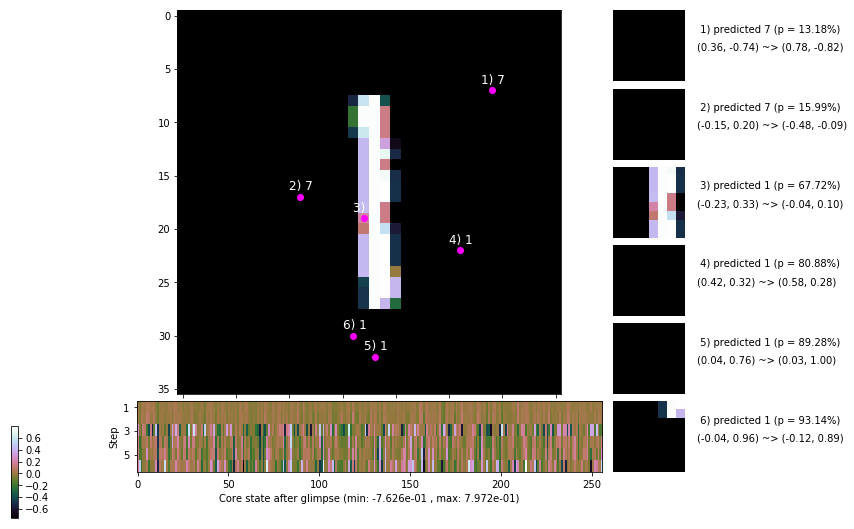

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 164.6 ms/b | lr: 9.64e-04 | grad 2norm:  9.92 | grad inf norm:  2.429
         Weights || abs max:  1.17 (12286.47) | mean:  3.21e-04 ( 0.04) | var: 1.69e-02 (12034.79)
          Biases || abs max:  0.48 ( 1574.39) | mean: -2.39e-02 ( 0.78) | var: 1.00e-02 (201502.09)
                    class loss: 0.653 | steps: 2.753 | reward:  3.759 | acc.: 77.95%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 161.1 ms/b | lr: 9.63e-04 | grad 2norm:  9.92 | grad inf norm:  2.404
         Weights || abs max:  1.18 ( 6216.46) | mean:  3.13e-04 ( 0.03) | var: 1.72e-02 ( 1719.31)
          Biases || abs max:  0.48 ( 1492.14) | mean: -2.62e-02 ( 0.74) | var: 1.05e-02 (201366.88)
                    class loss: 0.642 | steps: 2.708 | reward:  3.787 | acc.: 78.10%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1

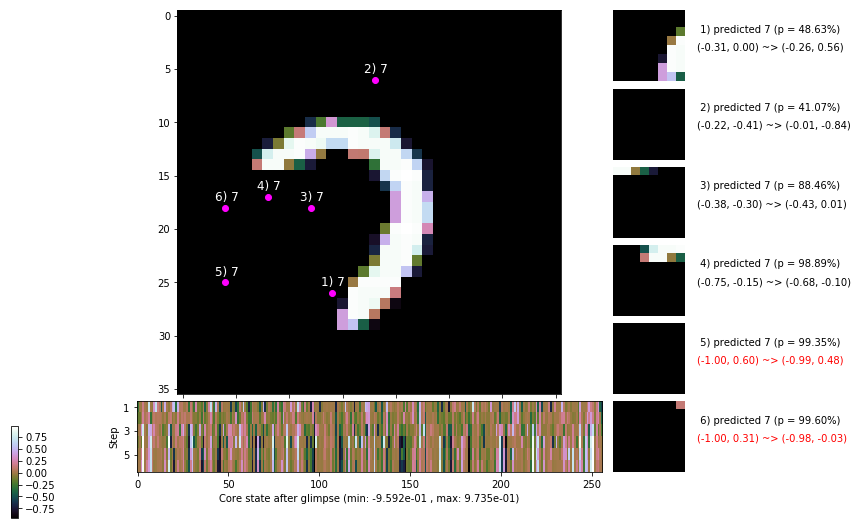

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 163.5 ms/b | lr: 9.61e-04 | grad 2norm: 10.19 | grad inf norm:  2.462
         Weights || abs max:  1.19 ( 4374.42) | mean:  3.40e-04 ( 0.03) | var: 1.75e-02 (  354.32)
          Biases || abs max:  0.48 (  217.26) | mean: -2.80e-02 ( 0.25) | var: 1.09e-02 (  405.30)
                    class loss: 0.646 | steps: 2.716 | reward:  3.784 | acc.: 78.28%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 162.2 ms/b | lr: 9.60e-04 | grad 2norm: 10.12 | grad inf norm:  2.486
         Weights || abs max:  1.19 ( 6686.85) | mean:  3.62e-04 ( 0.03) | var: 1.78e-02 ( 1858.20)
          Biases || abs max:  0.49 (  174.01) | mean: -2.96e-02 ( 0.22) | var: 1.13e-02 (  282.99)
                    class loss: 0.617 | steps: 2.713 | reward:  3.791 | acc.: 78.87%

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.1

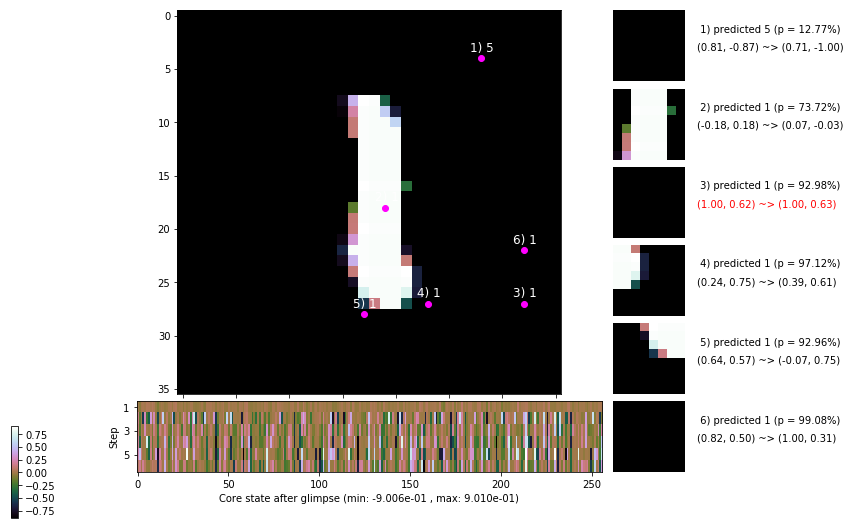

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 165.1 ms/b | lr: 9.58e-04 | grad 2norm: 10.25 | grad inf norm:  2.411
         Weights || abs max:  1.18 (33135.37) | mean:  3.23e-04 ( 0.08) | var: 1.81e-02 (464827.44)
          Biases || abs max:  0.49 (  136.82) | mean: -3.12e-02 ( 0.20) | var: 1.17e-02 (   55.27)
                    class loss: 0.617 | steps: 2.663 | reward:  3.832 | acc.: 79.13%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 175.6 ms/b | lr: 9.57e-04 | grad 2norm: 10.36 | grad inf norm:  2.452
         Weights || abs max:  1.20 ( 7796.59) | mean:  3.28e-04 ( 0.03) | var: 1.84e-02 ( 1221.74)
          Biases || abs max:  0.50 (  306.12) | mean: -3.20e-02 ( 0.28) | var: 1.21e-02 ( 1047.31)
                    class loss: 0.599 | steps: 2.699 | reward:  3.821 | acc.: 79.67%

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.

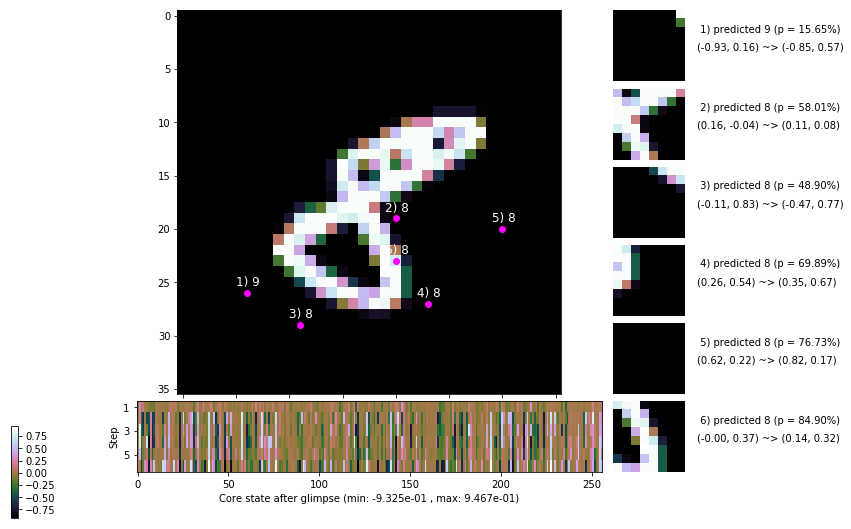

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


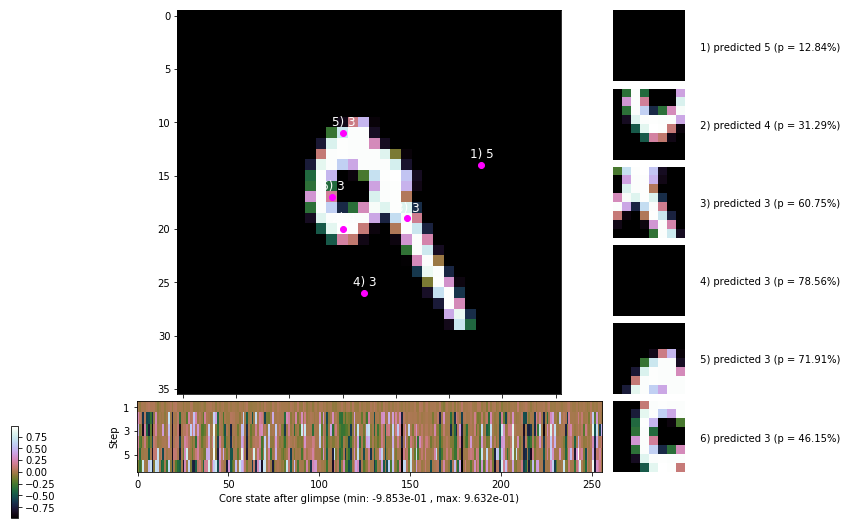


	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


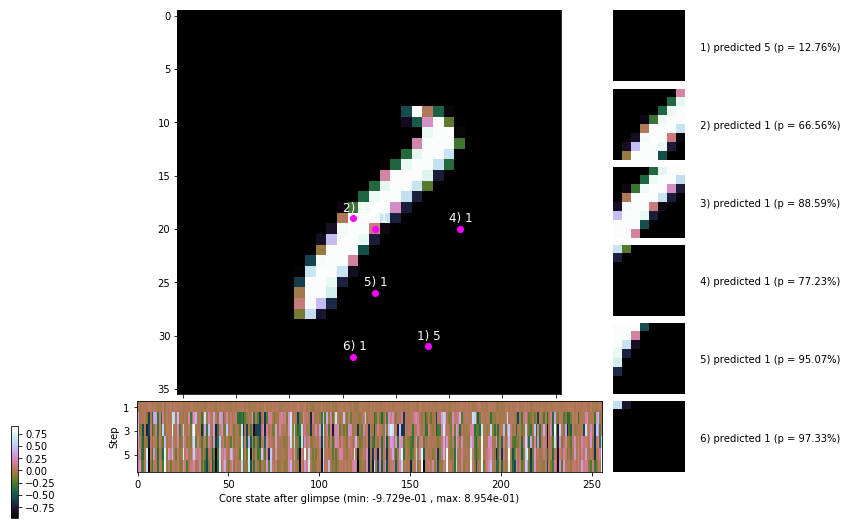

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


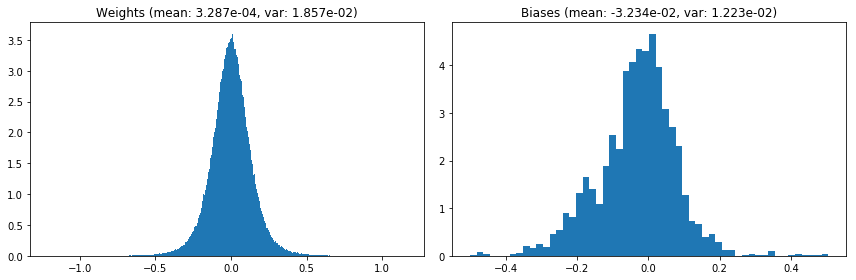

                                      Location network weights and biases


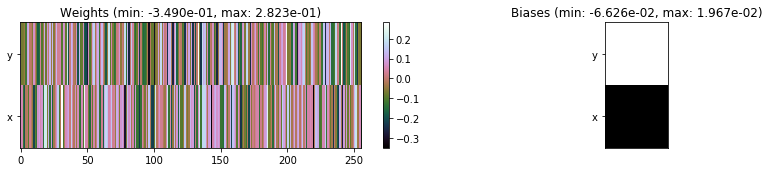

---------------------------------------------------------------------------------------------------------------
Elapsed time:  497.17 sec | TRAIN >> class loss: 0.6444 | steps:  2.727    | reward:  3.7683    | acc.: 78.162% 
                          | VAL   >> class loss: 0.6141 | steps:  2.610    | reward:  3.9212    | acc.: 78.220% 


Epoch   4/400) lr = 0.000956
 b    300/  3000 >> 164.8 ms/b | lr: 9.55e-04 | grad 2norm: 10.33 | grad inf norm:  2.411
         Weights || abs max:  1.22 ( 5822.37) | mean:  3.55e-04 ( 0.03) | var: 1.87e-02 (  910.28)
          Biases || abs max:  0.51 (  170.51) | mean: -3.36e-02 ( 0.21) | var: 1.26e-02 (  162.26)
                    class loss: 0.592 | steps: 2.651 | reward:  3.889 | acc.: 80.10%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 166.7 ms/b | lr: 9.54e-04 | grad 2norm: 10.34 | grad inf norm:  2.362
         Weights || abs max:  1.22 ( 6126.70) | mean:  3.46e-04 ( 0.03

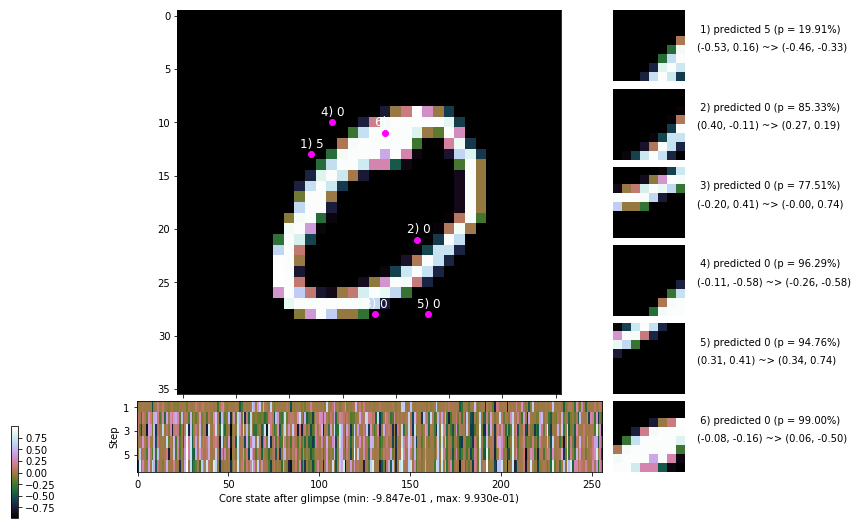

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 163.2 ms/b | lr: 9.52e-04 | grad 2norm: 10.32 | grad inf norm:  2.402
         Weights || abs max:  1.22 ( 9155.52) | mean:  3.17e-04 ( 0.03) | var: 1.93e-02 (13819.34)
          Biases || abs max:  0.53 (  118.63) | mean: -3.55e-02 ( 0.18) | var: 1.33e-02 (  134.62)
                    class loss: 0.568 | steps: 2.641 | reward:  3.892 | acc.: 80.70%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 162.9 ms/b | lr: 9.51e-04 | grad 2norm: 10.06 | grad inf norm:  2.374
         Weights || abs max:  1.21 ( 8179.66) | mean:  3.42e-04 ( 0.03) | var: 1.96e-02 ( 2050.51)
          Biases || abs max:  0.53 (  330.53) | mean: -3.65e-02 ( 0.27) | var: 1.36e-02 ( 2014.03)
                    class loss: 0.547 | steps: 2.631 | reward:  3.927 | acc.: 81.43%

	Target class: 5 | Discounted rewards: [1.000, 0.001, 0.0

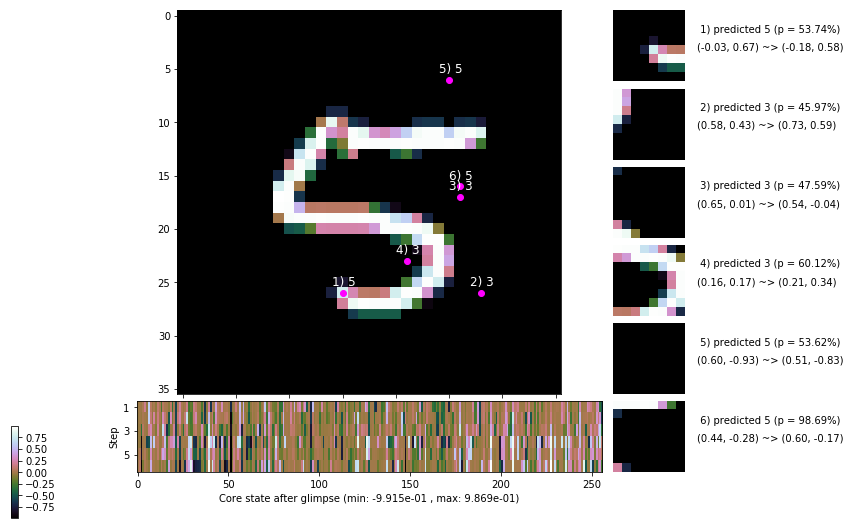

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 166.3 ms/b | lr: 9.49e-04 | grad 2norm: 10.06 | grad inf norm:  2.428
         Weights || abs max:  1.21 ( 6712.32) | mean:  3.10e-04 ( 0.03) | var: 1.98e-02 (  765.17)
          Biases || abs max:  0.55 (  839.90) | mean: -3.82e-02 ( 0.59) | var: 1.42e-02 (27618.04)
                    class loss: 0.573 | steps: 2.619 | reward:  3.913 | acc.: 80.97%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 161.8 ms/b | lr: 9.48e-04 | grad 2norm: 10.17 | grad inf norm:  2.422
         Weights || abs max:  1.22 ( 4989.02) | mean:  3.06e-04 ( 0.03) | var: 2.01e-02 (  561.89)
          Biases || abs max:  0.56 (  542.15) | mean: -4.03e-02 ( 0.36) | var: 1.47e-02 ( 3571.22)
                    class loss: 0.571 | steps: 2.626 | reward:  3.934 | acc.: 81.07%

	Target class: 3 | Discounted rewards: [0.001, 0.011, 0.1

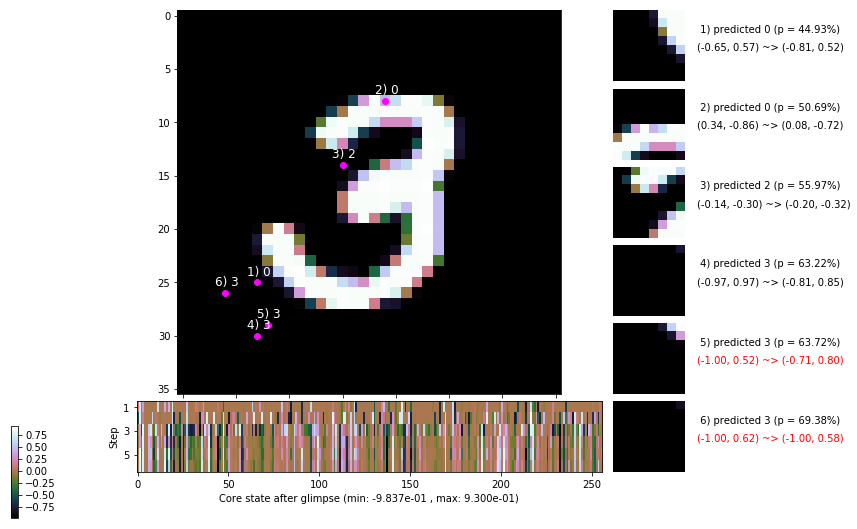

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 155.3 ms/b | lr: 9.46e-04 | grad 2norm: 10.01 | grad inf norm:  2.290
         Weights || abs max:  1.22 ( 5205.59) | mean:  3.16e-04 ( 0.03) | var: 2.04e-02 (  793.71)
          Biases || abs max:  0.57 (  195.83) | mean: -4.10e-02 ( 0.21) | var: 1.51e-02 (  317.36)
                    class loss: 0.525 | steps: 2.574 | reward:  3.966 | acc.: 81.98%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 152.4 ms/b | lr: 9.46e-04 | grad 2norm: 10.27 | grad inf norm:  2.407
         Weights || abs max:  1.23 ( 5055.63) | mean:  3.06e-04 ( 0.03) | var: 2.07e-02 (  505.08)
          Biases || abs max:  0.59 (  224.83) | mean: -4.27e-02 ( 0.22) | var: 1.55e-02 (  188.21)
                    class loss: 0.566 | steps: 2.611 | reward:  3.931 | acc.: 81.02%

	Target class: 9 | Discounted rewards: [1.111, 1.111, 1.1

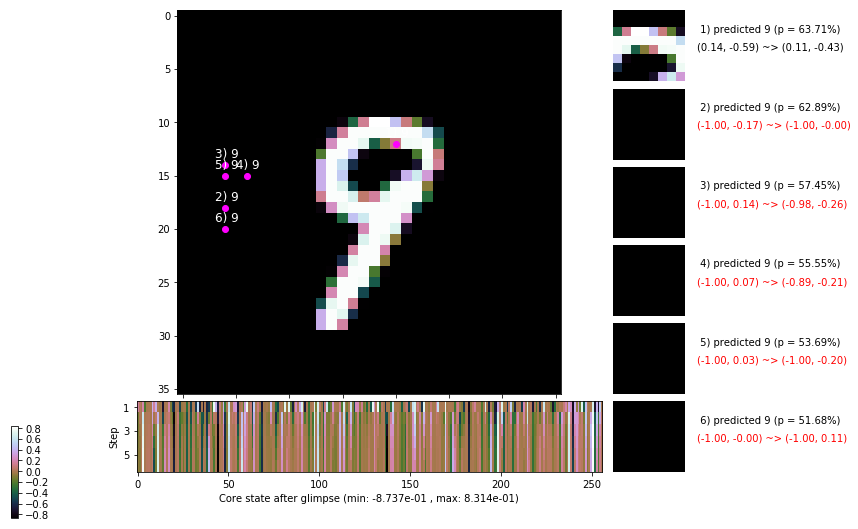

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.1 ms/b | lr: 9.44e-04 | grad 2norm: 10.06 | grad inf norm:  2.272
         Weights || abs max:  1.24 ( 7030.99) | mean:  2.54e-04 ( 0.03) | var: 2.09e-02 ( 3049.69)
          Biases || abs max:  0.58 (  382.36) | mean: -4.35e-02 ( 0.27) | var: 1.60e-02 ( 1143.23)
                    class loss: 0.519 | steps: 2.577 | reward:  3.974 | acc.: 82.65%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 150.9 ms/b | lr: 9.43e-04 | grad 2norm: 10.19 | grad inf norm:  2.322
         Weights || abs max:  1.25 ( 8969.92) | mean:  2.23e-04 ( 0.03) | var: 2.12e-02 ( 7163.85)
          Biases || abs max:  0.59 (  528.38) | mean: -4.43e-02 ( 0.34) | var: 1.64e-02 (10728.89)
                    class loss: 0.554 | steps: 2.639 | reward:  3.901 | acc.: 81.43%

	Target class: 4 | Discounted rewards: [0.000, 0.001, 0.0

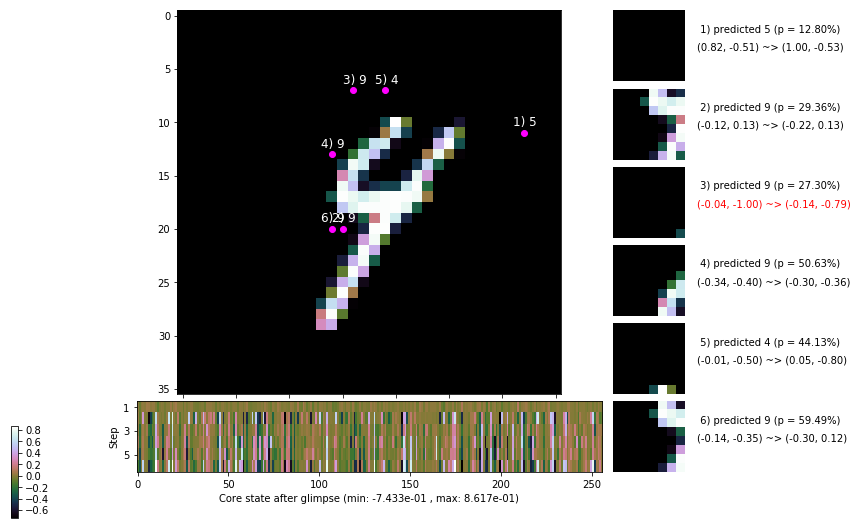

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


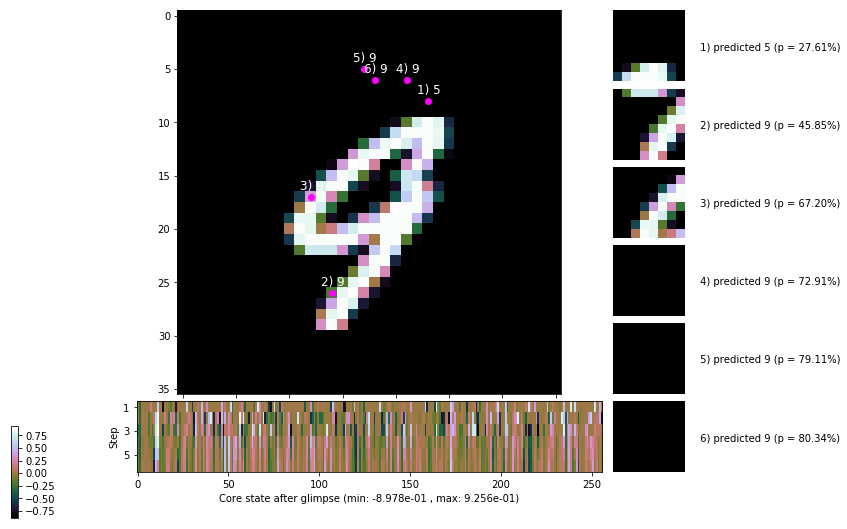


	Target class: 9 | Discounted rewards: [0.000, 0.001, 0.010, 0.100, 1.000, 0.000]


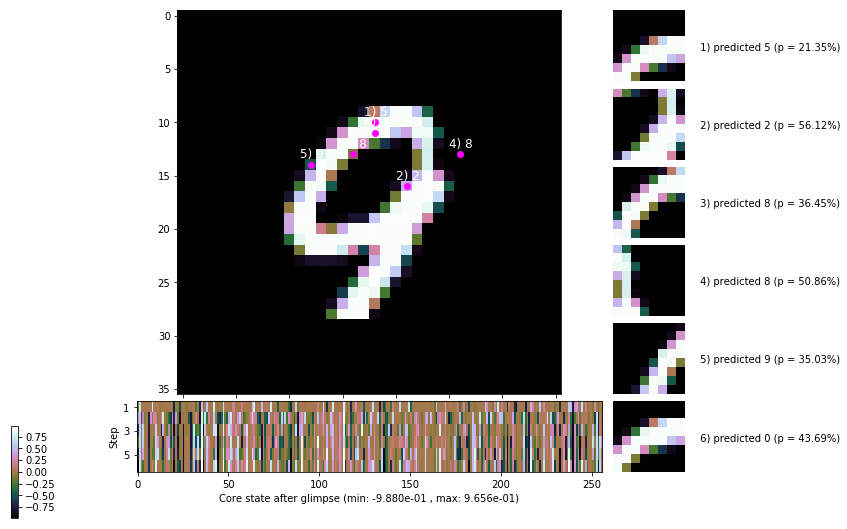

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


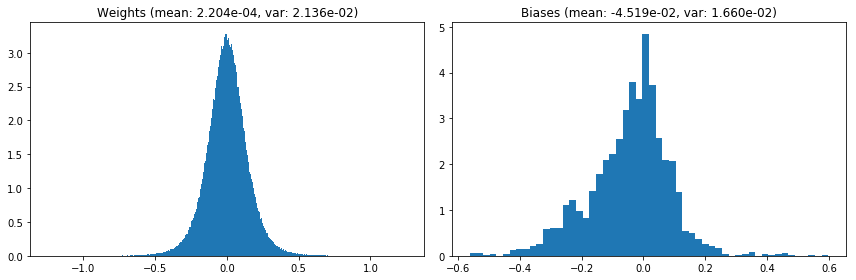

                                      Location network weights and biases


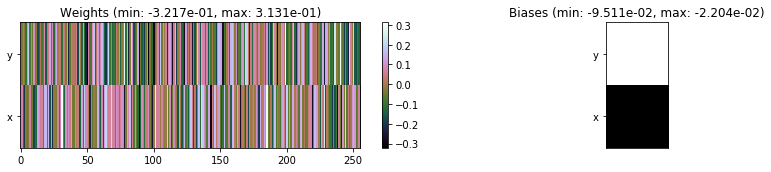

---------------------------------------------------------------------------------------------------------------
Elapsed time:  480.12 sec | TRAIN >> class loss: 0.5582 | steps:  2.622    | reward:  3.9206    | acc.: 81.223% 
                          | VAL   >> class loss: 0.4917 | steps:  2.456    | reward:  4.1180    | acc.: 83.220% 


Epoch   5/400) lr = 0.0009417
 b    300/  3000 >> 151.3 ms/b | lr: 9.41e-04 | grad 2norm: 10.04 | grad inf norm:  2.293
         Weights || abs max:  1.25 ( 8924.07) | mean:  2.45e-04 ( 0.03) | var: 2.15e-02 ( 7208.12)
          Biases || abs max:  0.59 (  131.62) | mean: -4.61e-02 ( 0.17) | var: 1.69e-02 (   55.58)
                    class loss: 0.507 | steps: 2.604 | reward:  3.961 | acc.: 82.95%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.8 ms/b | lr: 9.40e-04 | grad 2norm: 10.07 | grad inf norm:  2.331
         Weights || abs max:  1.26 ( 4523.32) | mean:  2.53e-04 ( 0.0

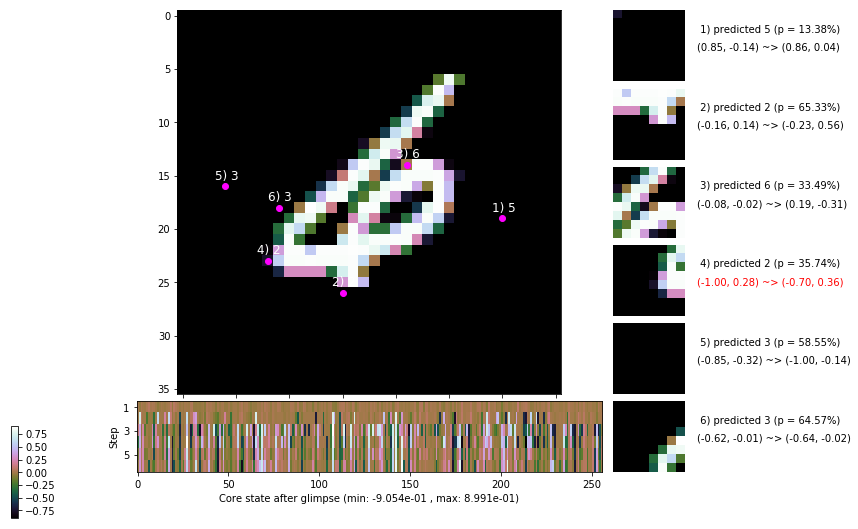

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 157.2 ms/b | lr: 9.38e-04 | grad 2norm: 10.34 | grad inf norm:  2.447
         Weights || abs max:  1.27 ( 4783.05) | mean:  2.46e-04 ( 0.02) | var: 2.21e-02 (  521.50)
          Biases || abs max:  0.60 (  171.49) | mean: -4.82e-02 ( 0.18) | var: 1.77e-02 (  252.07)
                    class loss: 0.506 | steps: 2.579 | reward:  3.997 | acc.: 82.72%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 152.4 ms/b | lr: 9.37e-04 | grad 2norm: 10.22 | grad inf norm:  2.390
         Weights || abs max:  1.27 ( 3217.97) | mean:  2.65e-04 ( 0.02) | var: 2.23e-02 (  139.94)
          Biases || abs max:  0.62 (  294.38) | mean: -4.91e-02 ( 0.26) | var: 1.81e-02 ( 1761.65)
                    class loss: 0.487 | steps: 2.549 | reward:  4.034 | acc.: 83.47%

	Target class: 2 | Discounted rewards: [1.111, 1.111, 1.1

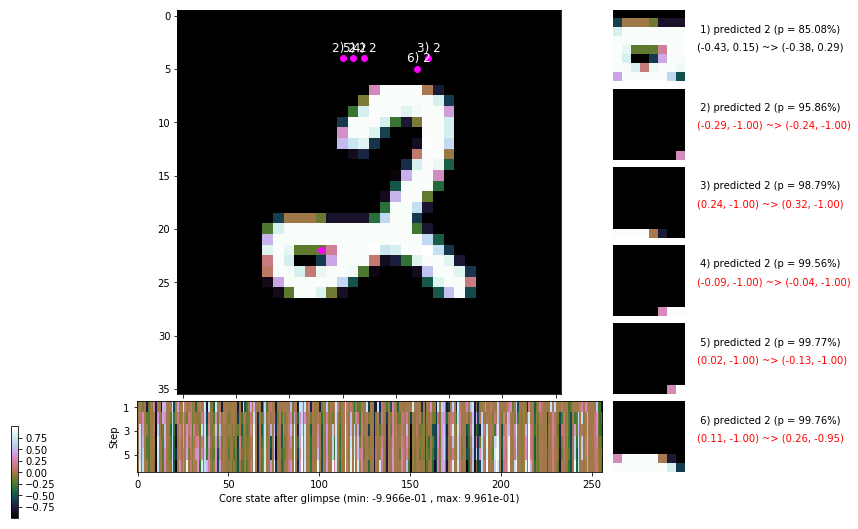

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.6 ms/b | lr: 9.35e-04 | grad 2norm: 10.19 | grad inf norm:  2.338
         Weights || abs max:  1.29 ( 4870.07) | mean:  3.05e-04 ( 0.02) | var: 2.26e-02 (  696.37)
          Biases || abs max:  0.64 (  181.04) | mean: -4.95e-02 ( 0.19) | var: 1.84e-02 (  487.32)
                    class loss: 0.494 | steps: 2.558 | reward:  4.017 | acc.: 83.67%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 156.8 ms/b | lr: 9.34e-04 | grad 2norm: 10.36 | grad inf norm:  2.440
         Weights || abs max:  1.29 ( 6347.74) | mean:  3.35e-04 ( 0.03) | var: 2.28e-02 (  889.75)
          Biases || abs max:  0.65 (  183.93) | mean: -5.08e-02 ( 0.20) | var: 1.88e-02 (  298.74)
                    class loss: 0.509 | steps: 2.583 | reward:  3.992 | acc.: 82.75%

	Target class: 4 | Discounted rewards: [0.011, 0.110, 1.1

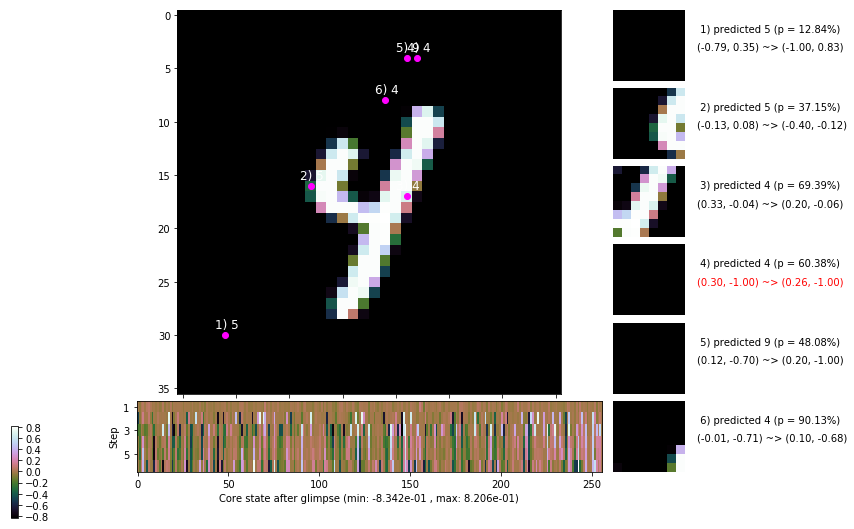

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 181.8 ms/b | lr: 9.32e-04 | grad 2norm: 10.01 | grad inf norm:  2.350
         Weights || abs max:  1.30 ( 3433.51) | mean:  2.78e-04 ( 0.02) | var: 2.31e-02 (  155.54)
          Biases || abs max:  0.66 (  418.25) | mean: -5.17e-02 ( 0.29) | var: 1.92e-02 ( 8474.32)
                    class loss: 0.469 | steps: 2.509 | reward:  4.079 | acc.: 84.97%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 196.9 ms/b | lr: 9.31e-04 | grad 2norm: 10.28 | grad inf norm:  2.378
         Weights || abs max:  1.31 ( 4551.87) | mean:  2.64e-04 ( 0.02) | var: 2.33e-02 (  354.73)
          Biases || abs max:  0.66 (  182.90) | mean: -5.15e-02 ( 0.19) | var: 1.95e-02 (  254.63)
                    class loss: 0.448 | steps: 2.532 | reward:  4.083 | acc.: 85.35%

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.1

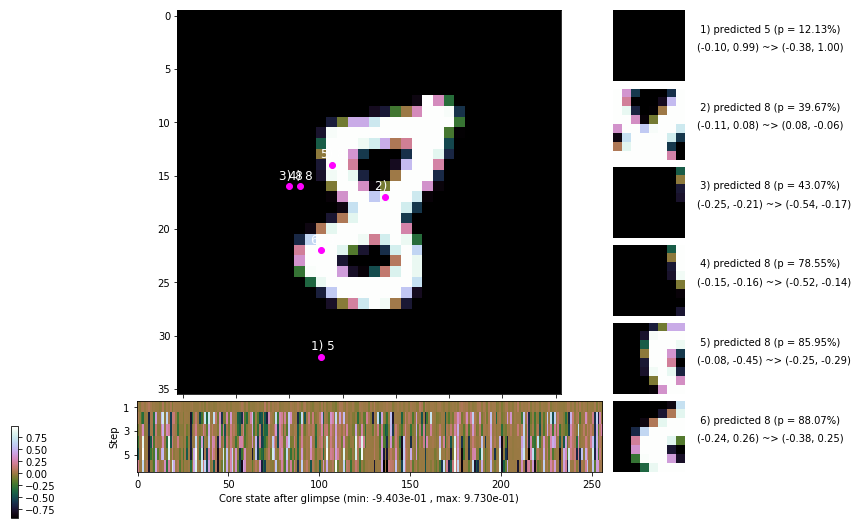

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 194.7 ms/b | lr: 9.30e-04 | grad 2norm: 10.53 | grad inf norm:  2.325
         Weights || abs max:  1.31 ( 6909.03) | mean:  3.00e-04 ( 0.03) | var: 2.36e-02 ( 2141.00)
          Biases || abs max:  0.66 (  303.21) | mean: -5.22e-02 ( 0.22) | var: 1.99e-02 (  667.17)
                    class loss: 0.441 | steps: 2.499 | reward:  4.104 | acc.: 85.10%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 206.0 ms/b | lr: 9.29e-04 | grad 2norm: 10.24 | grad inf norm:  2.323
         Weights || abs max:  1.31 ( 4428.66) | mean:  2.65e-04 ( 0.02) | var: 2.38e-02 (  284.10)
          Biases || abs max:  0.66 (  562.51) | mean: -5.36e-02 ( 0.34) | var: 2.02e-02 ( 3833.78)
                    class loss: 0.480 | steps: 2.527 | reward:  4.042 | acc.: 84.30%

	Target class: 8 | Discounted rewards: [0.000, 0.001, 0.0

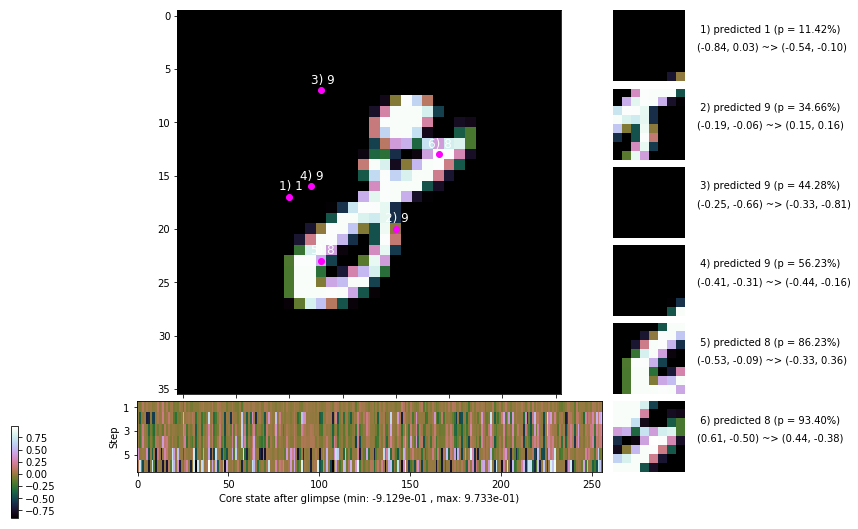

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.110, 1.100, 1.000, 0.000]


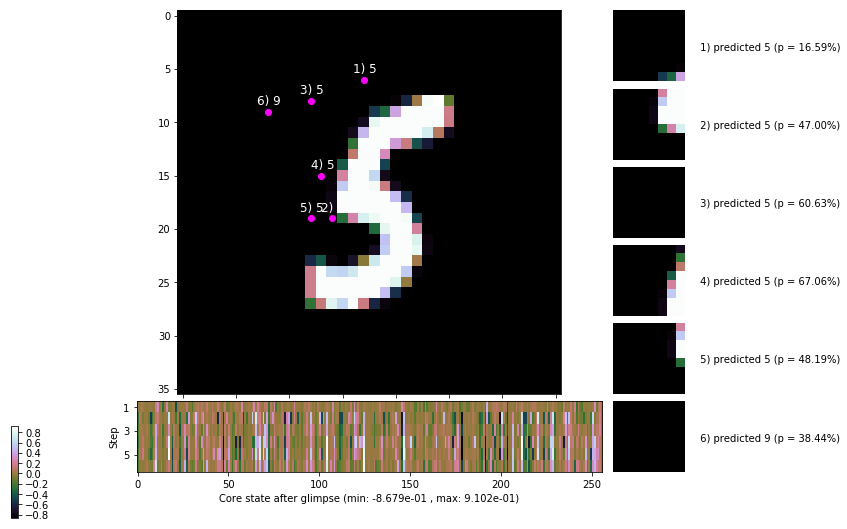


	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


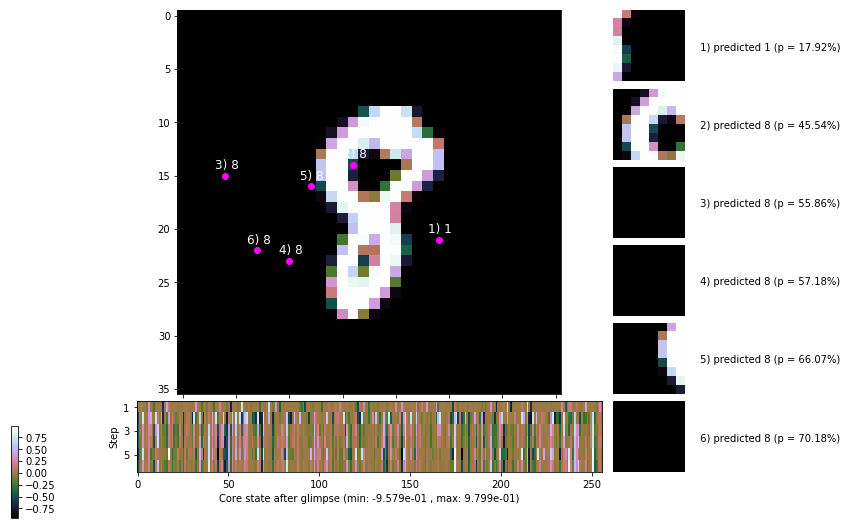

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


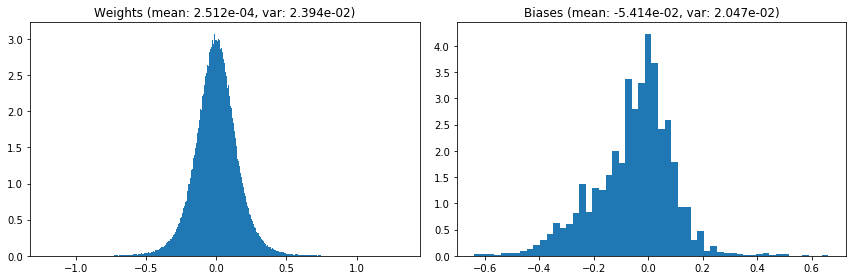

                                      Location network weights and biases


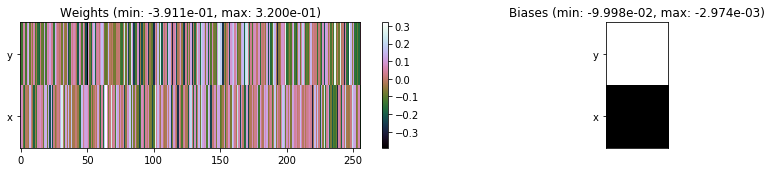

---------------------------------------------------------------------------------------------------------------
Elapsed time:  512.22 sec | TRAIN >> class loss: 0.4841 | steps:  2.552    | reward:  4.0314    | acc.: 83.852% 
                          | VAL   >> class loss: 0.4294 | steps:  2.395    | reward:  4.2196    | acc.: 85.400% 


Epoch   6/400) lr = 0.0009277
 b    300/  3000 >> 193.5 ms/b | lr: 9.27e-04 | grad 2norm: 10.03 | grad inf norm:  2.286
         Weights || abs max:  1.33 (12905.39) | mean:  2.31e-04 ( 0.04) | var: 2.41e-02 (39245.07)
          Biases || abs max:  0.67 (  373.85) | mean: -5.48e-02 ( 0.27) | var: 2.08e-02 ( 1095.50)
                    class loss: 0.478 | steps: 2.529 | reward:  4.053 | acc.: 84.00%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 189.6 ms/b | lr: 9.26e-04 | grad 2norm: 10.08 | grad inf norm:  2.324
         Weights || abs max:  1.34 ( 9983.47) | mean:  2.09e-04 ( 0.0

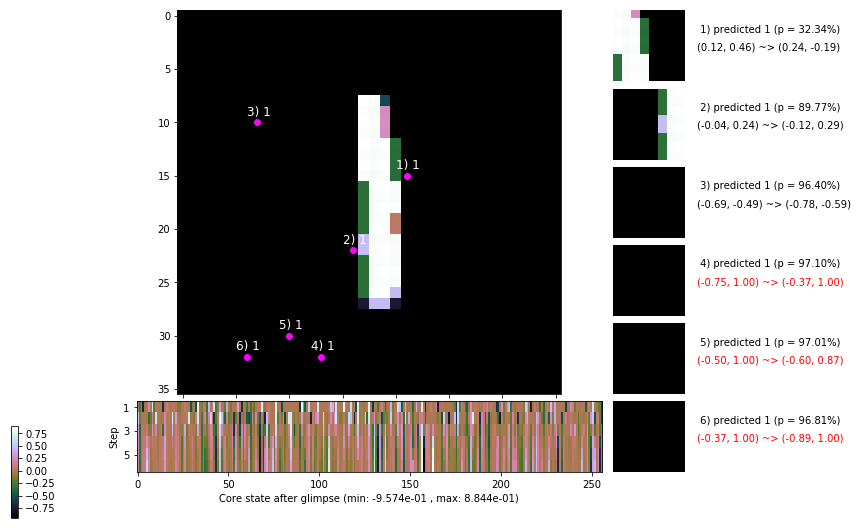

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 195.6 ms/b | lr: 9.24e-04 | grad 2norm: 10.20 | grad inf norm:  2.403
         Weights || abs max:  1.35 ( 6727.88) | mean:  2.34e-04 ( 0.03) | var: 2.46e-02 ( 2038.21)
          Biases || abs max:  0.67 (  194.61) | mean: -5.55e-02 ( 0.17) | var: 2.16e-02 (  358.15)
                    class loss: 0.452 | steps: 2.501 | reward:  4.102 | acc.: 84.67%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 219.3 ms/b | lr: 9.23e-04 | grad 2norm: 10.17 | grad inf norm:  2.381
         Weights || abs max:  1.36 ( 5280.65) | mean:  2.42e-04 ( 0.02) | var: 2.48e-02 (  605.74)
          Biases || abs max:  0.69 (   70.54) | mean: -5.59e-02 ( 0.10) | var: 2.20e-02 (   25.50)
                    class loss: 0.438 | steps: 2.526 | reward:  4.093 | acc.: 85.17%

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.1

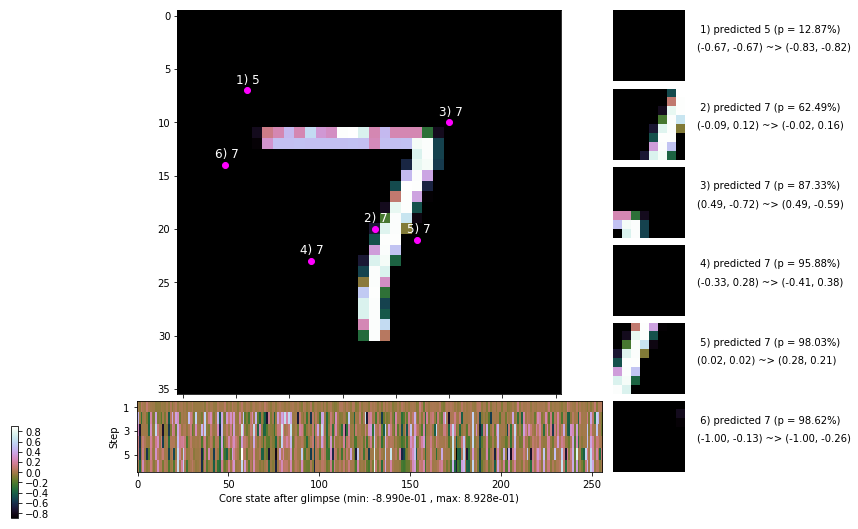

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 204.6 ms/b | lr: 9.21e-04 | grad 2norm:  9.75 | grad inf norm:  2.204
         Weights || abs max:  1.37 ( 3649.54) | mean:  2.09e-04 ( 0.02) | var: 2.51e-02 (  467.52)
          Biases || abs max:  0.70 (  140.49) | mean: -5.76e-02 ( 0.15) | var: 2.25e-02 (  117.98)
                    class loss: 0.444 | steps: 2.484 | reward:  4.114 | acc.: 85.42%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 179.2 ms/b | lr: 9.20e-04 | grad 2norm:  9.90 | grad inf norm:  2.309
         Weights || abs max:  1.36 ( 3247.40) | mean:  1.76e-04 ( 0.02) | var: 2.53e-02 (  338.35)
          Biases || abs max:  0.69 ( 2028.73) | mean: -5.87e-02 ( 0.92) | var: 2.28e-02 (337289.84)
                    class loss: 0.436 | steps: 2.500 | reward:  4.103 | acc.: 85.35%

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.

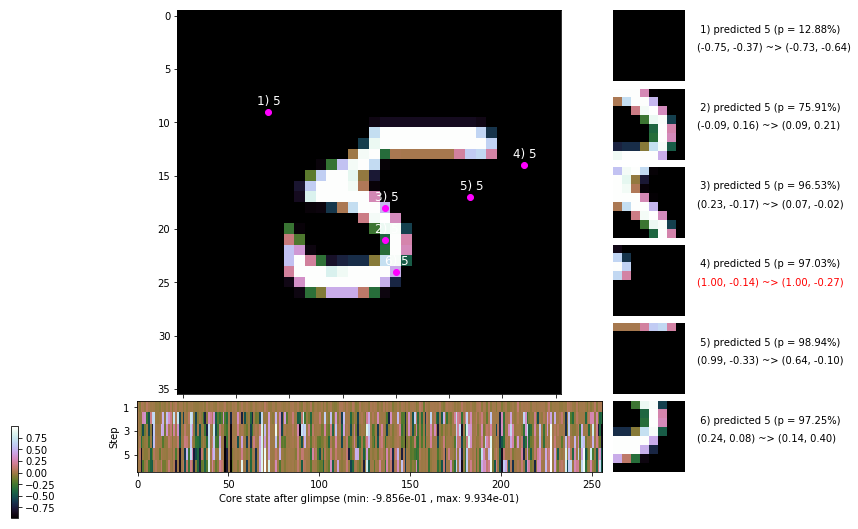

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 164.4 ms/b | lr: 9.18e-04 | grad 2norm: 10.00 | grad inf norm:  2.420
         Weights || abs max:  1.37 ( 6995.66) | mean:  1.25e-04 ( 0.03) | var: 2.56e-02 ( 3525.89)
          Biases || abs max:  0.70 (  388.61) | mean: -6.02e-02 ( 0.25) | var: 2.31e-02 ( 2930.43)
                    class loss: 0.438 | steps: 2.507 | reward:  4.110 | acc.: 85.73%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 172.5 ms/b | lr: 9.18e-04 | grad 2norm:  9.88 | grad inf norm:  2.370
         Weights || abs max:  1.37 ( 3782.66) | mean:  1.25e-04 ( 0.02) | var: 2.58e-02 (  919.92)
          Biases || abs max:  0.72 (  143.31) | mean: -6.08e-02 ( 0.16) | var: 2.35e-02 (  480.72)
                    class loss: 0.416 | steps: 2.474 | reward:  4.154 | acc.: 86.08%

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.1

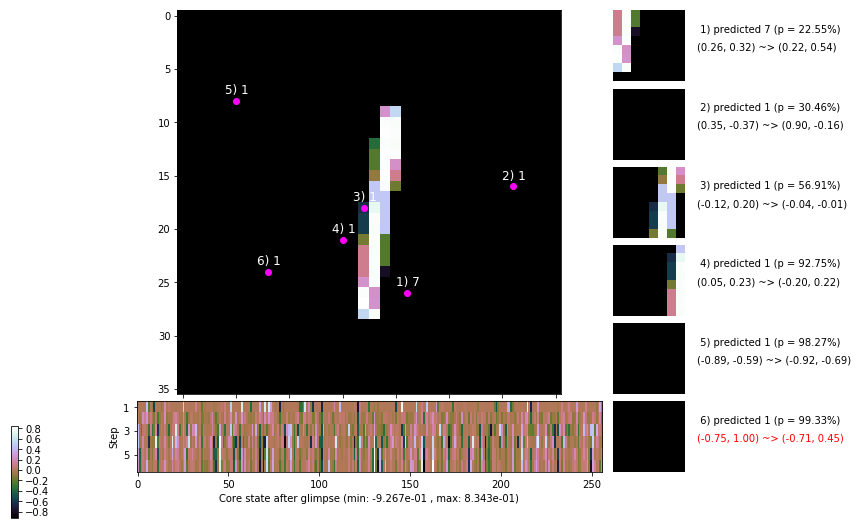

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 175.3 ms/b | lr: 9.16e-04 | grad 2norm:  9.80 | grad inf norm:  2.266
         Weights || abs max:  1.37 ( 6705.35) | mean:  8.32e-05 ( 0.03) | var: 2.61e-02 ( 2881.70)
          Biases || abs max:  0.71 (  336.95) | mean: -6.17e-02 ( 0.26) | var: 2.38e-02 ( 1456.20)
                    class loss: 0.423 | steps: 2.499 | reward:  4.123 | acc.: 85.67%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 174.0 ms/b | lr: 9.15e-04 | grad 2norm:  9.73 | grad inf norm:  2.267
         Weights || abs max:  1.38 ( 2927.10) | mean:  6.10e-05 ( 0.02) | var: 2.63e-02 (  231.79)
          Biases || abs max:  0.72 (  284.77) | mean: -6.25e-02 ( 0.21) | var: 2.42e-02 (  723.68)
                    class loss: 0.441 | steps: 2.517 | reward:  4.107 | acc.: 85.38%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.1

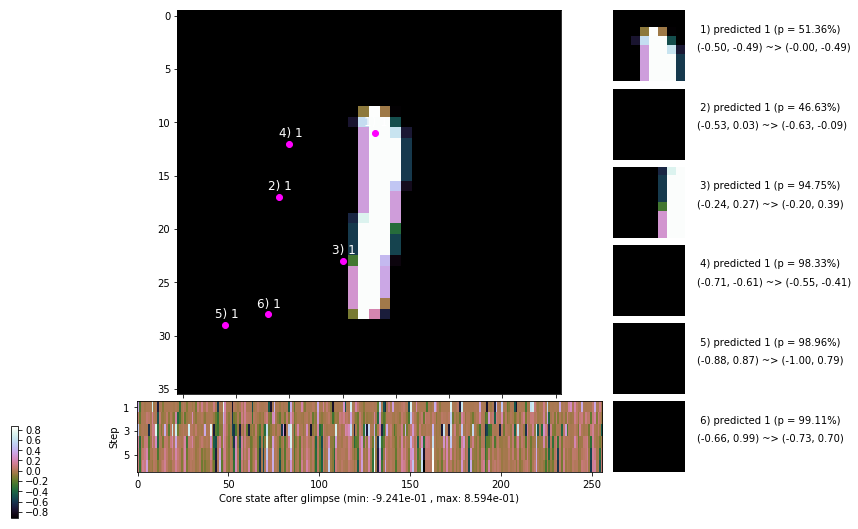

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


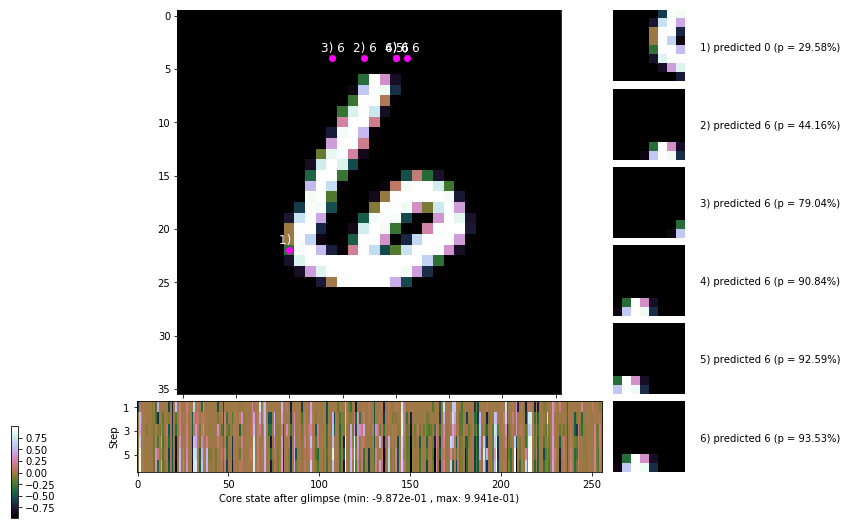


	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


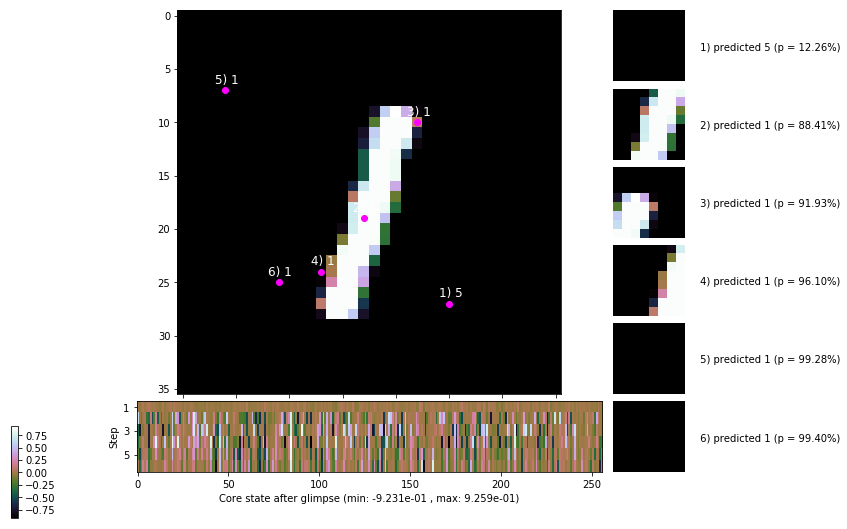

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


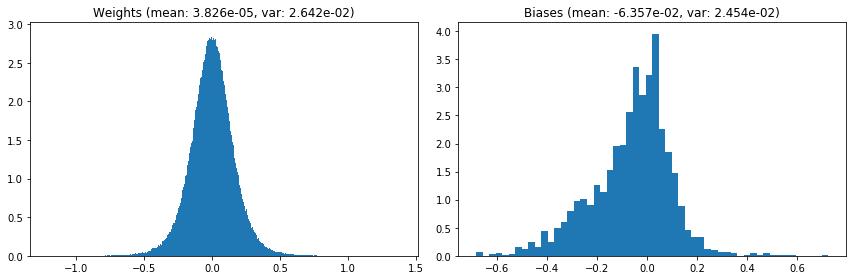

                                      Location network weights and biases


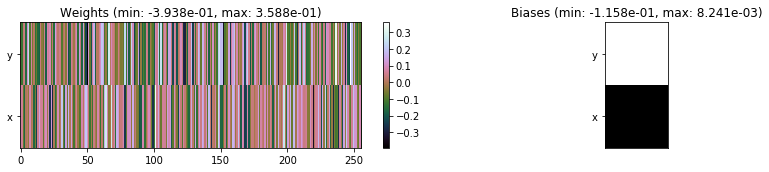

---------------------------------------------------------------------------------------------------------------
Elapsed time:  561.15 sec | TRAIN >> class loss: 0.4416 | steps:  2.502    | reward:  4.1089    | acc.: 85.278% 
                          | VAL   >> class loss: 0.4234 | steps:  2.375    | reward:  4.2424    | acc.: 86.060% 


Epoch   7/400) lr = 0.0009139
 b    300/  3000 >> 172.3 ms/b | lr: 9.13e-04 | grad 2norm:  9.71 | grad inf norm:  2.318
         Weights || abs max:  1.39 (34154.48) | mean:  6.64e-05 ( 0.08) | var: 2.65e-02 (252375.20)
          Biases || abs max:  0.72 (  132.70) | mean: -6.39e-02 ( 0.13) | var: 2.47e-02 (   91.14)
                    class loss: 0.450 | steps: 2.483 | reward:  4.116 | acc.: 85.12%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 173.3 ms/b | lr: 9.12e-04 | grad 2norm:  9.83 | grad inf norm:  2.229
         Weights || abs max:  1.42 (11896.12) | mean:  4.37e-05 ( 0.

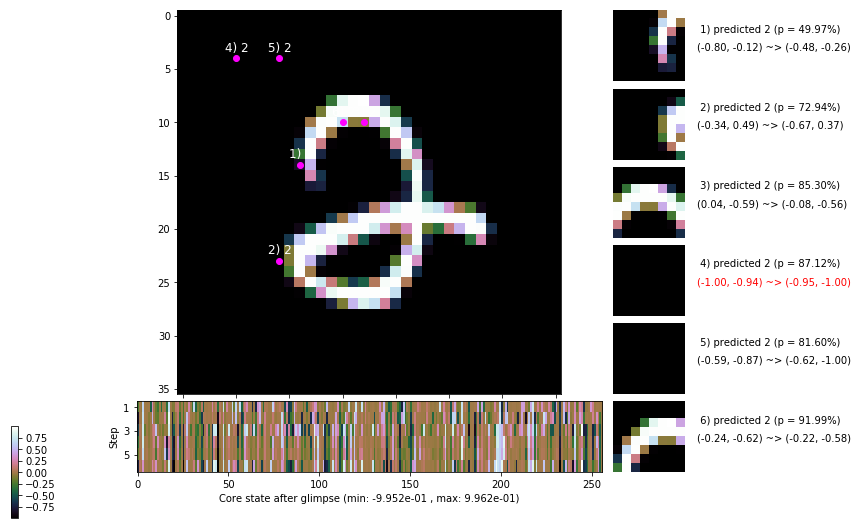

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 175.4 ms/b | lr: 9.10e-04 | grad 2norm:  9.82 | grad inf norm:  2.399
         Weights || abs max:  1.43 ( 4752.14) | mean:  4.29e-05 ( 0.02) | var: 2.71e-02 (  540.32)
          Biases || abs max:  0.73 (  288.34) | mean: -6.49e-02 ( 0.20) | var: 2.54e-02 ( 1953.31)
                    class loss: 0.465 | steps: 2.504 | reward:  4.083 | acc.: 84.18%
                 --------------------------------------------------------------------------------


H:\Users\Andrew\Anaconda3\envs\conda_jupyter\lib\site-packages\numpy\lib\nanfunctions.py:1315: RuntimeWarning: invalid value encountered in subtract
  np.subtract(arr, avg, out=arr, casting='unsafe')


 b   1200/  3000 >> 175.8 ms/b | lr: 9.09e-04 | grad 2norm:  9.75 | grad inf norm:  2.253
         Weights || abs max:  1.43 (     inf) | mean: -8.62e-06 (  inf) | var: 2.73e-02 (     nan)
          Biases || abs max:  0.75 (  365.46) | mean: -6.64e-02 ( 0.23) | var: 2.60e-02 ( 7253.77)
                    class loss: 0.435 | steps: 2.500 | reward:  4.115 | acc.: 85.05%

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]
	                | Baseline rewards:   [0.402, 0.938, 1.001, 1.078, 0.994, 0.953]


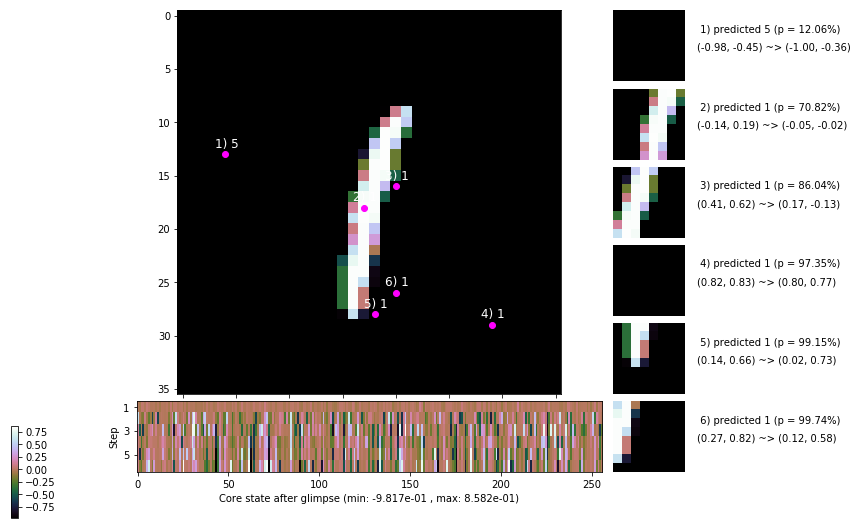

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 176.9 ms/b | lr: 9.08e-04 | grad 2norm:  9.81 | grad inf norm:  2.245
         Weights || abs max:  1.42 ( 7030.95) | mean:  1.95e-07 ( 0.03) | var: 2.75e-02 ( 5684.14)
          Biases || abs max:  0.72 (  114.28) | mean: -6.75e-02 ( 0.14) | var: 2.62e-02 (  111.00)
                    class loss: 0.450 | steps: 2.471 | reward:  4.111 | acc.: 84.82%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 179.4 ms/b | lr: 9.07e-04 | grad 2norm:  9.83 | grad inf norm:  2.483
         Weights || abs max:  1.41 ( 4572.47) | mean: -4.71e-06 ( 0.02) | var: 2.78e-02 (  665.35)
          Biases || abs max:  0.73 (   85.61) | mean: -6.80e-02 ( 0.13) | var: 2.64e-02 (   31.92)
                    class loss: 0.429 | steps: 2.479 | reward:  4.129 | acc.: 85.37%

	Target class: 2 | Discounted rewards: [0.011, 0.111, 1.1

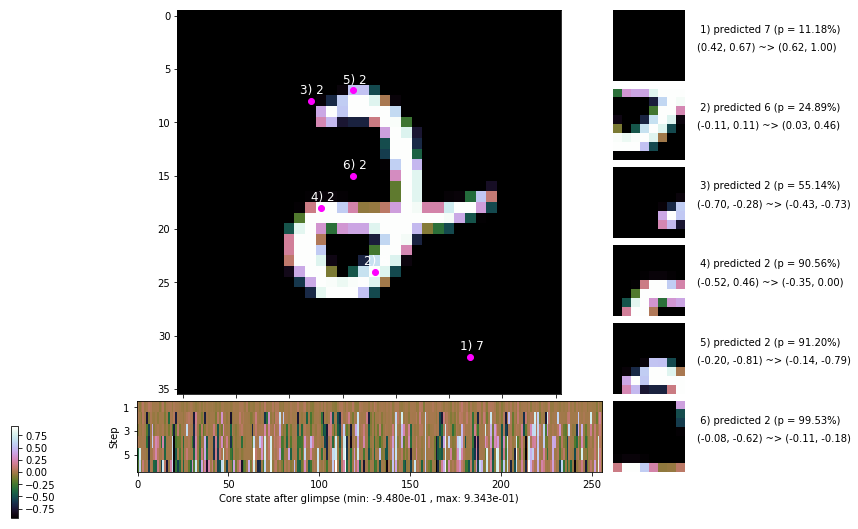

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 189.0 ms/b | lr: 9.05e-04 | grad 2norm:  9.61 | grad inf norm:  2.171
         Weights || abs max:  1.41 ( 8151.01) | mean:  1.79e-05 ( 0.03) | var: 2.80e-02 ( 7719.72)
          Biases || abs max:  0.74 (  154.54) | mean: -6.86e-02 ( 0.16) | var: 2.67e-02 (  411.89)
                    class loss: 0.415 | steps: 2.426 | reward:  4.200 | acc.: 86.38%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 185.8 ms/b | lr: 9.04e-04 | grad 2norm:  9.78 | grad inf norm:  2.389
         Weights || abs max:  1.41 ( 4621.12) | mean: -6.00e-05 ( 0.02) | var: 2.82e-02 (  333.02)
          Biases || abs max:  0.73 (  113.22) | mean: -6.88e-02 ( 0.13) | var: 2.72e-02 (   94.63)
                    class loss: 0.432 | steps: 2.452 | reward:  4.156 | acc.: 85.30%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.1

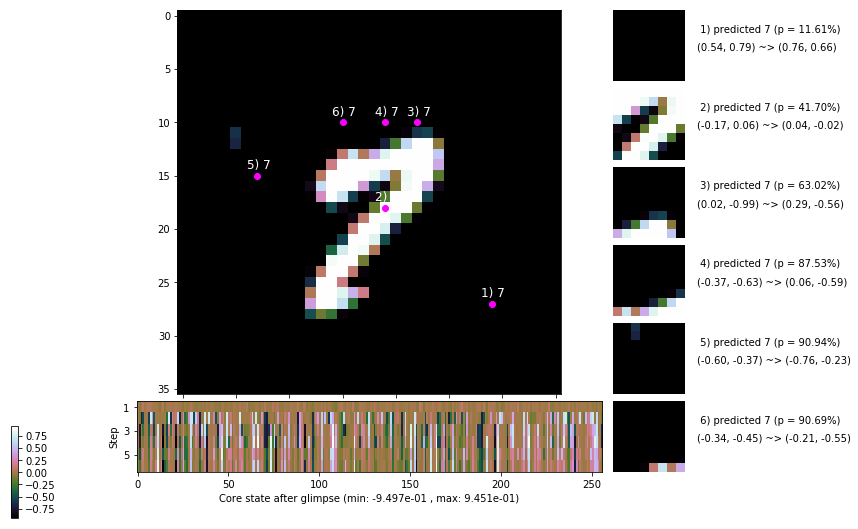

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 176.9 ms/b | lr: 9.02e-04 | grad 2norm:  9.81 | grad inf norm:  2.264
         Weights || abs max:  1.41 ( 9341.03) | mean: -5.02e-06 ( 0.03) | var: 2.84e-02 ( 5908.55)
          Biases || abs max:  0.73 (  122.89) | mean: -7.01e-02 ( 0.14) | var: 2.78e-02 (   98.70)
                    class loss: 0.441 | steps: 2.473 | reward:  4.148 | acc.: 85.58%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 165.5 ms/b | lr: 9.01e-04 | grad 2norm:  9.52 | grad inf norm:  2.288
         Weights || abs max:  1.40 ( 5337.72) | mean: -2.47e-05 ( 0.02) | var: 2.87e-02 (  646.90)
          Biases || abs max:  0.74 (16068.94) | mean: -7.08e-02 ( 6.33) | var: 2.81e-02 (29734052.00)
                    class loss: 0.429 | steps: 2.461 | reward:  4.157 | acc.: 85.60%

	Target class: 3 | Discounted rewards: [1.111, 1.111, 

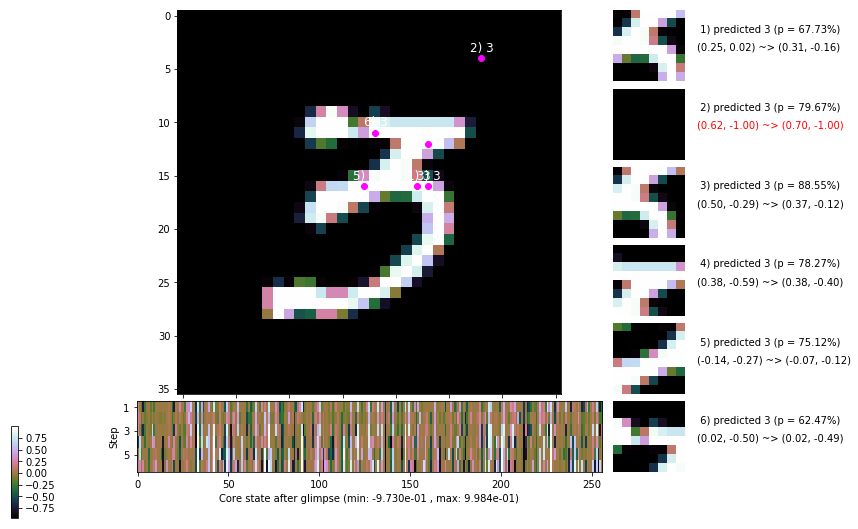

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


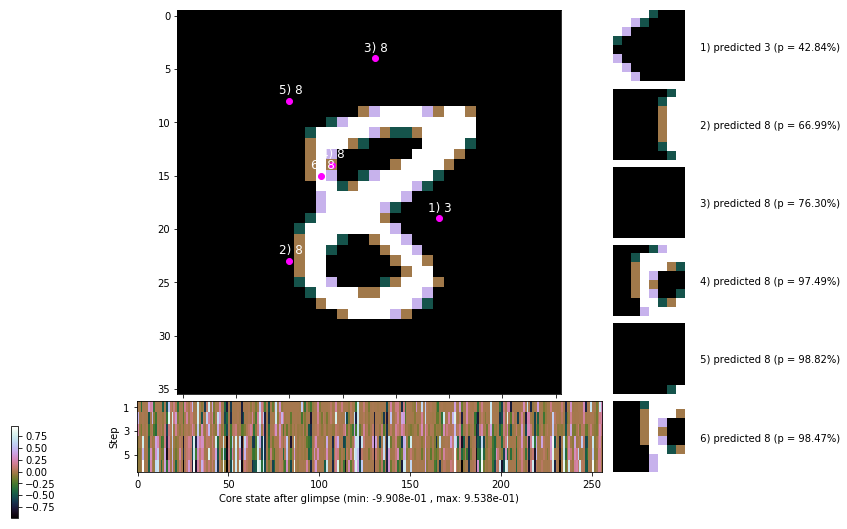


	Target class: 4 | Discounted rewards: [1.011, 0.111, 1.111, 1.110, 1.100, 1.000]


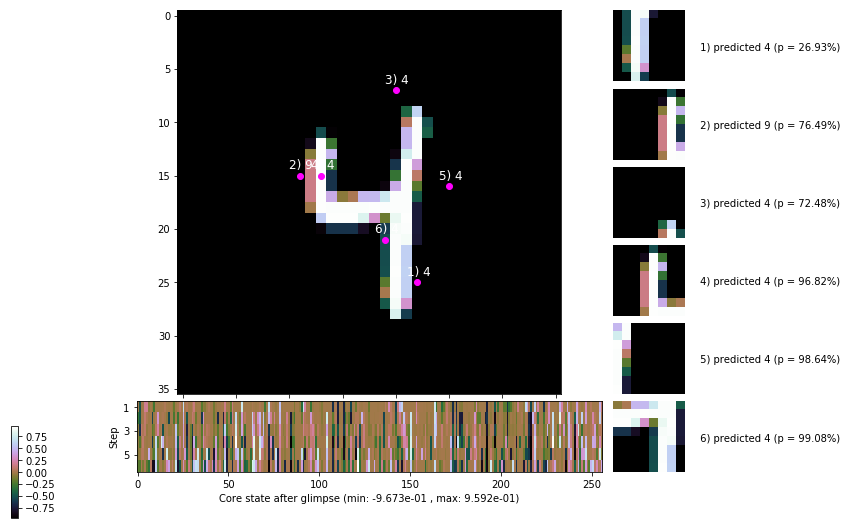

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


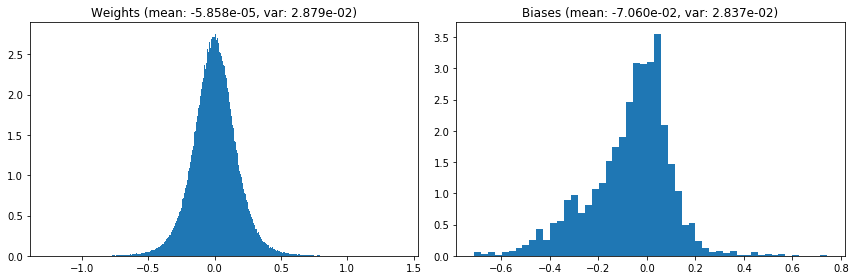

                                      Location network weights and biases


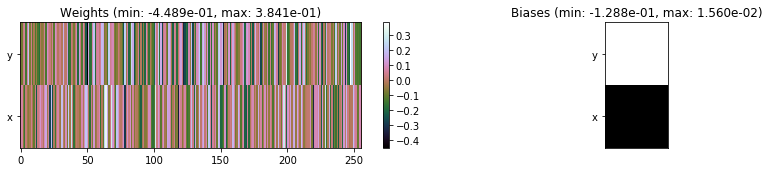

---------------------------------------------------------------------------------------------------------------
Elapsed time:  531.79 sec | TRAIN >> class loss: 0.4377 | steps:  2.477    | reward:  4.1316    | acc.: 85.298% 
                          | VAL   >> class loss: 0.3955 | steps:  2.363    | reward:  4.2894    | acc.: 86.660% 


Epoch   8/400) lr = 0.0009003
 b    300/  3000 >> 164.6 ms/b | lr: 8.99e-04 | grad 2norm:  9.82 | grad inf norm:  2.288
         Weights || abs max:  1.41 ( 4801.82) | mean: -4.01e-05 ( 0.02) | var: 2.89e-02 (  802.10)
          Biases || abs max:  0.74 (   90.46) | mean: -7.11e-02 ( 0.11) | var: 2.85e-02 (   16.00)
                    class loss: 0.426 | steps: 2.477 | reward:  4.152 | acc.: 85.82%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 165.2 ms/b | lr: 8.98e-04 | grad 2norm: 10.07 | grad inf norm:  2.371
         Weights || abs max:  1.42 ( 9657.92) | mean: -4.39e-05 ( 0.0

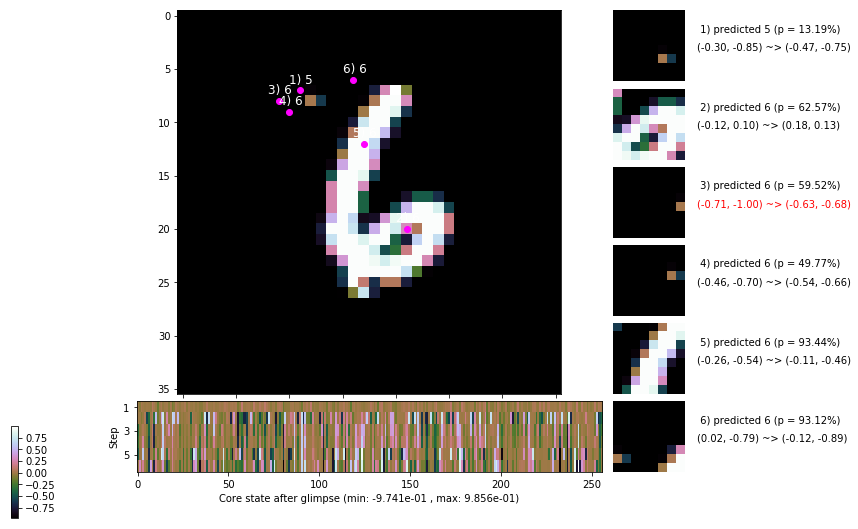

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 165.8 ms/b | lr: 8.97e-04 | grad 2norm:  9.85 | grad inf norm:  2.298
         Weights || abs max:  1.43 ( 6436.84) | mean: -4.34e-05 ( 0.03) | var: 2.93e-02 ( 4123.95)
          Biases || abs max:  0.74 (  149.53) | mean: -7.35e-02 ( 0.15) | var: 2.92e-02 (  119.79)
                    class loss: 0.426 | steps: 2.490 | reward:  4.154 | acc.: 86.22%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 165.8 ms/b | lr: 8.96e-04 | grad 2norm:  9.59 | grad inf norm:  2.227
         Weights || abs max:  1.45 ( 4494.93) | mean: -3.56e-05 ( 0.02) | var: 2.95e-02 (  663.19)
          Biases || abs max:  0.75 (  273.10) | mean: -7.43e-02 ( 0.21) | var: 2.96e-02 (  139.88)
                    class loss: 0.430 | steps: 2.486 | reward:  4.120 | acc.: 85.08%

	Target class: 8 | Discounted rewards: [0.011, 0.111, 1.1

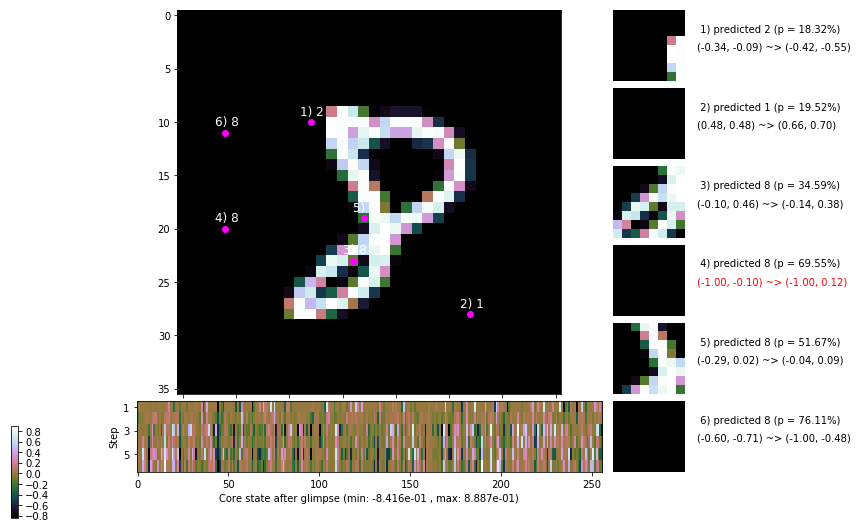

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 167.7 ms/b | lr: 8.94e-04 | grad 2norm:  9.34 | grad inf norm:  2.223
         Weights || abs max:  1.45 ( 6076.09) | mean: -9.57e-06 ( 0.02) | var: 2.98e-02 ( 4354.40)
          Biases || abs max:  0.75 (  291.43) | mean: -7.48e-02 ( 0.23) | var: 2.99e-02 (  374.67)
                    class loss: 0.395 | steps: 2.440 | reward:  4.216 | acc.: 86.97%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 166.3 ms/b | lr: 8.93e-04 | grad 2norm:  9.55 | grad inf norm:  2.278
         Weights || abs max:  1.45 ( 3496.71) | mean: -2.38e-05 ( 0.02) | var: 3.00e-02 (  448.41)
          Biases || abs max:  0.76 (  113.50) | mean: -7.50e-02 ( 0.13) | var: 3.03e-02 (   82.62)
                    class loss: 0.422 | steps: 2.500 | reward:  4.129 | acc.: 85.78%

	Target class: 2 | Discounted rewards: [0.111, 1.111, 1.1

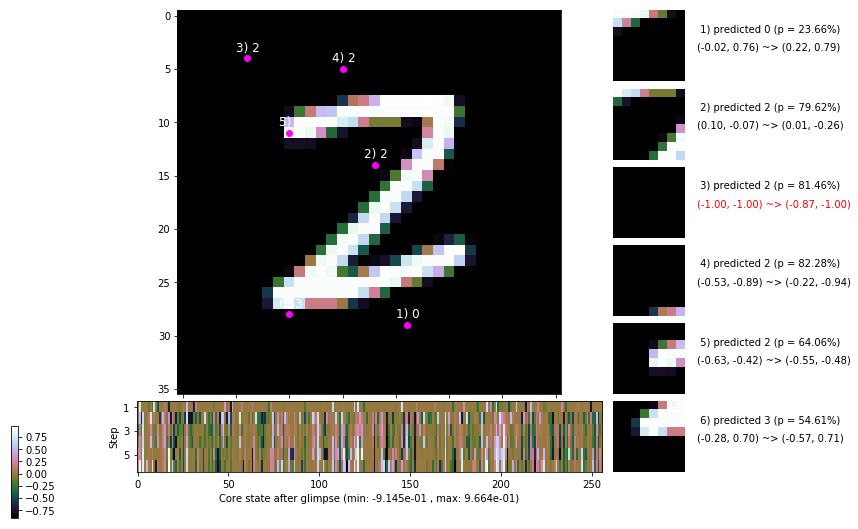

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 165.1 ms/b | lr: 8.91e-04 | grad 2norm:  9.48 | grad inf norm:  2.212
         Weights || abs max:  1.45 ( 3750.82) | mean: -2.13e-05 ( 0.02) | var: 3.02e-02 (  188.88)
          Biases || abs max:  0.76 (  143.06) | mean: -7.55e-02 ( 0.15) | var: 3.06e-02 (  127.34)
                    class loss: 0.406 | steps: 2.458 | reward:  4.173 | acc.: 86.68%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 166.6 ms/b | lr: 8.90e-04 | grad 2norm:  9.52 | grad inf norm:  2.257
         Weights || abs max:  1.45 (15185.86) | mean: -3.71e-05 ( 0.04) | var: 3.04e-02 (59375.58)
          Biases || abs max:  0.77 (  229.48) | mean: -7.64e-02 ( 0.19) | var: 3.09e-02 (  294.24)
                    class loss: 0.410 | steps: 2.485 | reward:  4.149 | acc.: 86.47%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.1

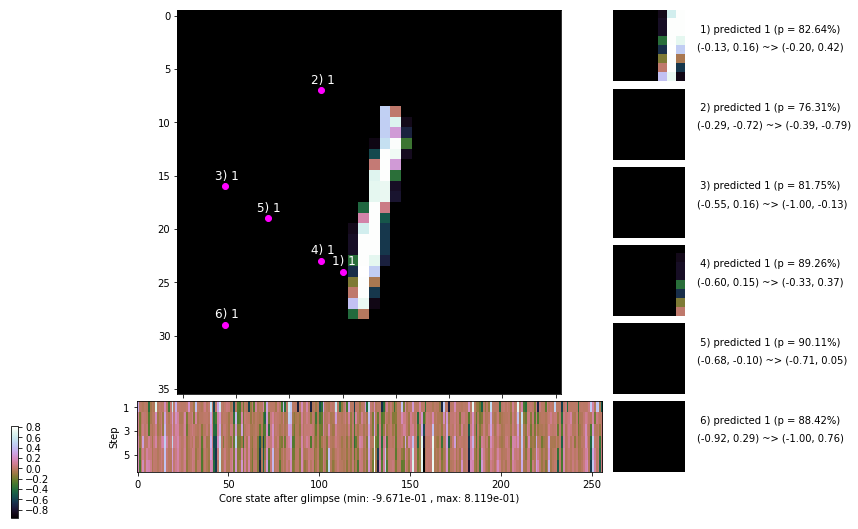

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 182.0 ms/b | lr: 8.89e-04 | grad 2norm:  9.63 | grad inf norm:  2.310
         Weights || abs max:  1.46 ( 7653.67) | mean: -3.56e-05 ( 0.03) | var: 3.07e-02 ( 8750.32)
          Biases || abs max:  0.78 (  294.36) | mean: -7.65e-02 ( 0.22) | var: 3.12e-02 (  435.16)
                    class loss: 0.432 | steps: 2.497 | reward:  4.132 | acc.: 85.62%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 180.7 ms/b | lr: 8.88e-04 | grad 2norm:  9.84 | grad inf norm:  2.326
         Weights || abs max:  1.44 ( 4693.98) | mean: -1.98e-05 ( 0.02) | var: 3.09e-02 (  612.66)
          Biases || abs max:  0.79 (  204.97) | mean: -7.71e-02 ( 0.20) | var: 3.16e-02 (  278.75)
                    class loss: 0.453 | steps: 2.542 | reward:  4.069 | acc.: 84.88%

	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.1

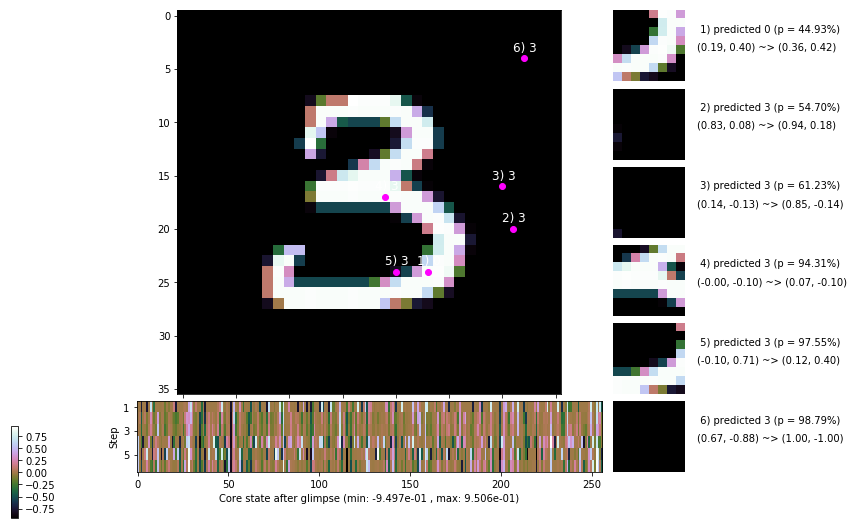

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


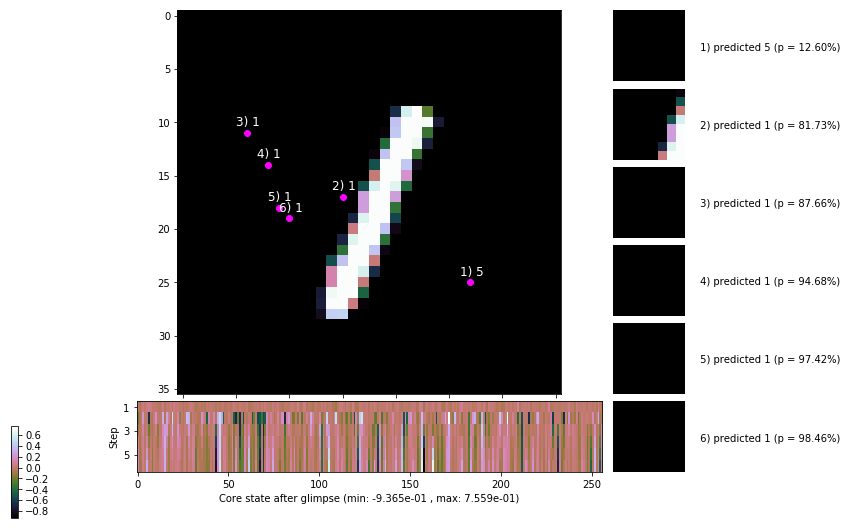


	Target class: 3 | Discounted rewards: [0.000, 0.001, 0.010, 0.100, 1.000, 0.000]


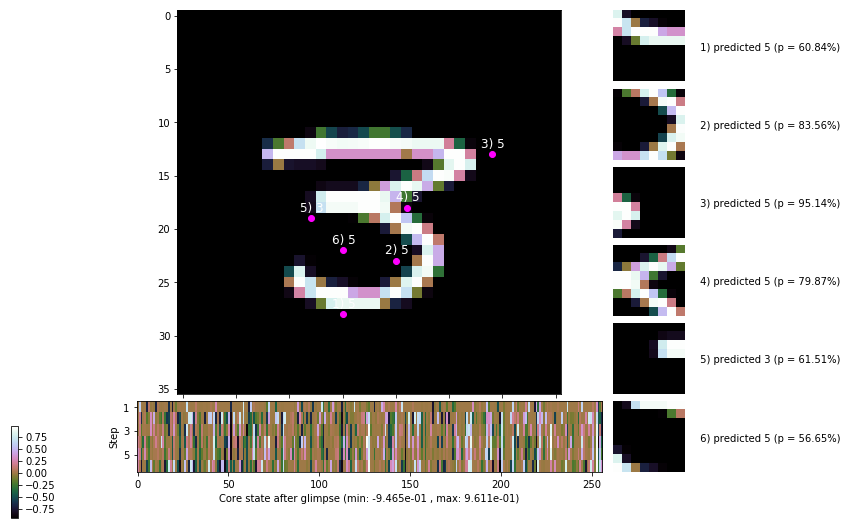

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


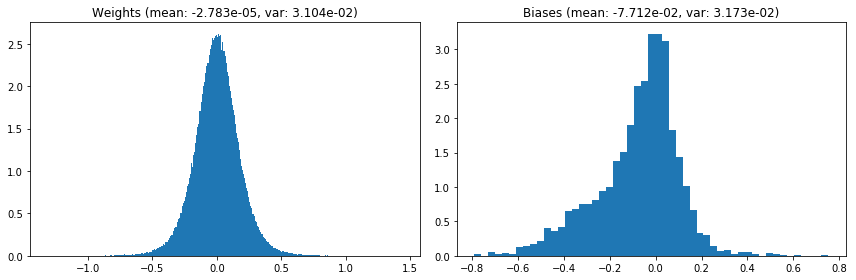

                                      Location network weights and biases


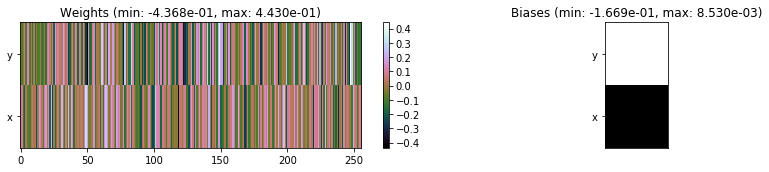

---------------------------------------------------------------------------------------------------------------
Elapsed time:  507.67 sec | TRAIN >> class loss: 0.4257 | steps:  2.490 :( | reward:  4.1372    | acc.: 85.840% 
                          | VAL   >> class loss: 0.4266 | steps:  2.382 :( | reward:  4.2660 :( | acc.: 86.140% :(


Epoch   9/400) lr = 0.0008869
 b    300/  3000 >> 188.3 ms/b | lr: 8.86e-04 | grad 2norm:  9.77 | grad inf norm:  2.350
         Weights || abs max:  1.45 (17341.07) | mean: -2.33e-05 ( 0.05) | var: 3.12e-02 (40829.68)
          Biases || abs max:  0.78 (  107.61) | mean: -7.74e-02 ( 0.13) | var: 3.19e-02 (   23.86)
                    class loss: 0.430 | steps: 2.505 | reward:  4.118 | acc.: 85.25%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 179.3 ms/b | lr: 8.85e-04 | grad 2norm:  9.85 | grad inf norm:  2.267
         Weights || abs max:  1.46 (13884.68) | mean: -4.48e-05 ( 0

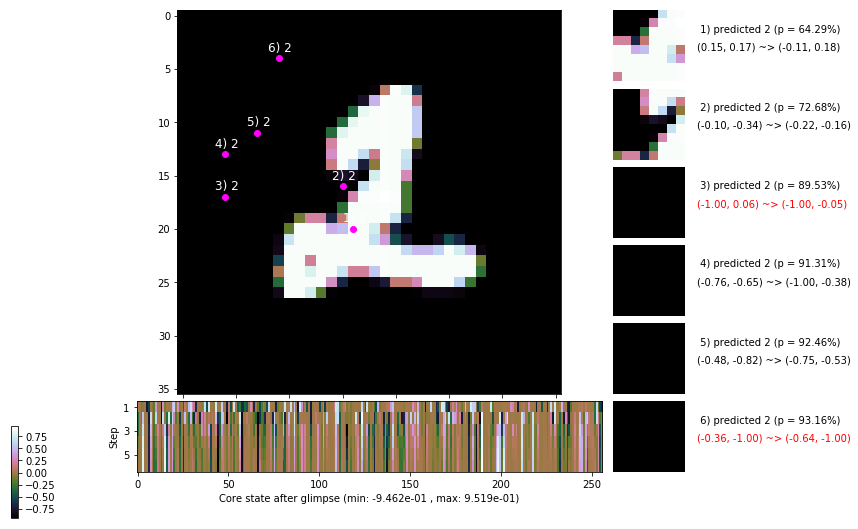

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 174.8 ms/b | lr: 8.83e-04 | grad 2norm:  9.56 | grad inf norm:  2.254
         Weights || abs max:  1.47 ( 6725.56) | mean: -6.24e-05 ( 0.03) | var: 3.16e-02 (  858.86)
          Biases || abs max:  0.80 (  191.13) | mean: -7.83e-02 ( 0.17) | var: 3.27e-02 (  197.90)
                    class loss: 0.423 | steps: 2.472 | reward:  4.150 | acc.: 85.50%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 172.4 ms/b | lr: 8.82e-04 | grad 2norm:  9.77 | grad inf norm:  2.293
         Weights || abs max:  1.48 (25145.99) | mean:  1.56e-06 ( 0.06) | var: 3.18e-02 (73518.42)
          Biases || abs max:  0.80 (  357.25) | mean: -7.83e-02 ( 0.28) | var: 3.28e-02 ( 1610.30)
                    class loss: 0.425 | steps: 2.539 | reward:  4.101 | acc.: 85.47%

	Target class: 8 | Discounted rewards: [0.011, 0.111, 1.1

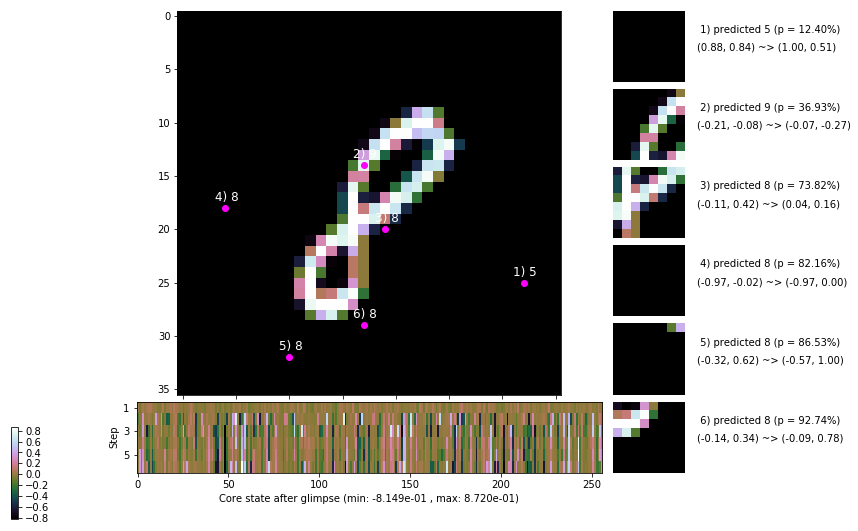

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 176.6 ms/b | lr: 8.81e-04 | grad 2norm:  9.46 | grad inf norm:  2.253
         Weights || abs max:  1.48 ( 6081.94) | mean:  6.01e-05 ( 0.03) | var: 3.20e-02 ( 1415.04)
          Biases || abs max:  0.79 (  576.35) | mean: -7.92e-02 ( 0.36) | var: 3.30e-02 ( 2112.10)
                    class loss: 0.423 | steps: 2.454 | reward:  4.170 | acc.: 85.85%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 172.6 ms/b | lr: 8.80e-04 | grad 2norm:  9.51 | grad inf norm:  2.400
         Weights || abs max:  1.47 (165719.42) | mean:  1.31e-04 ( 0.32) | var: 3.22e-02 (13990091.00)
          Biases || abs max:  0.78 (  206.60) | mean: -7.98e-02 ( 0.17) | var: 3.33e-02 ( 2050.30)
                    class loss: 0.443 | steps: 2.490 | reward:  4.134 | acc.: 85.53%

	Target class: 3 | Discounted rewards: [1.111, 1.111,

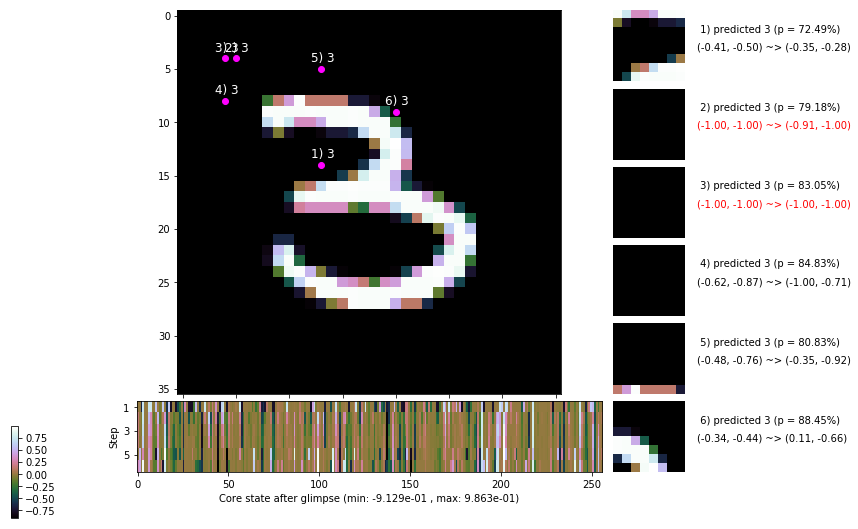

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 174.5 ms/b | lr: 8.78e-04 | grad 2norm:  9.53 | grad inf norm:  2.301
         Weights || abs max:  1.45 (68168.42) | mean:  1.22e-04 ( 0.14) | var: 3.25e-02 (2262699.25)
          Biases || abs max:  0.79 (   98.85) | mean: -8.07e-02 ( 0.12) | var: 3.38e-02 (   24.82)
                    class loss: 0.446 | steps: 2.478 | reward:  4.133 | acc.: 85.13%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 193.6 ms/b | lr: 8.77e-04 | grad 2norm:  9.54 | grad inf norm:  2.249
         Weights || abs max:  1.43 ( 3833.93) | mean:  1.37e-04 ( 0.02) | var: 3.27e-02 (  369.64)
          Biases || abs max:  0.79 (  860.74) | mean: -8.10e-02 ( 0.43) | var: 3.41e-02 (56069.44)
                    class loss: 0.426 | steps: 2.468 | reward:  4.159 | acc.: 85.88%

	Target class: 8 | Discounted rewards: [0.000, 0.000, 0

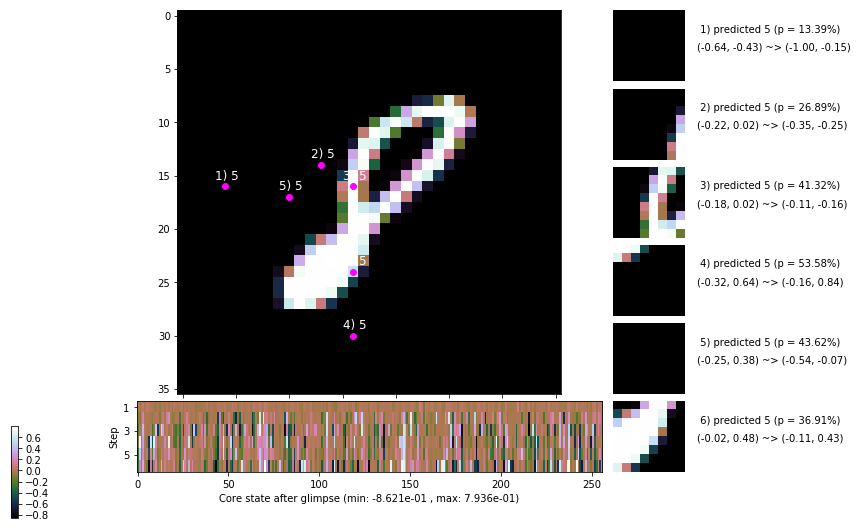

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 184.2 ms/b | lr: 8.75e-04 | grad 2norm:  9.48 | grad inf norm:  2.367
         Weights || abs max:  1.44 (47578.82) | mean:  1.75e-04 ( 0.10) | var: 3.29e-02 (1005692.50)
          Biases || abs max:  0.80 (  201.16) | mean: -8.14e-02 ( 0.17) | var: 3.44e-02 ( 1173.33)
                    class loss: 0.422 | steps: 2.473 | reward:  4.168 | acc.: 86.28%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 173.4 ms/b | lr: 8.75e-04 | grad 2norm:  9.24 | grad inf norm:  2.279
         Weights || abs max:  1.45 ( 5890.87) | mean:  1.42e-04 ( 0.02) | var: 3.31e-02 ( 1374.79)
          Biases || abs max:  0.81 (   92.10) | mean: -8.22e-02 ( 0.13) | var: 3.47e-02 (   28.53)
                    class loss: 0.430 | steps: 2.455 | reward:  4.176 | acc.: 85.70%

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1

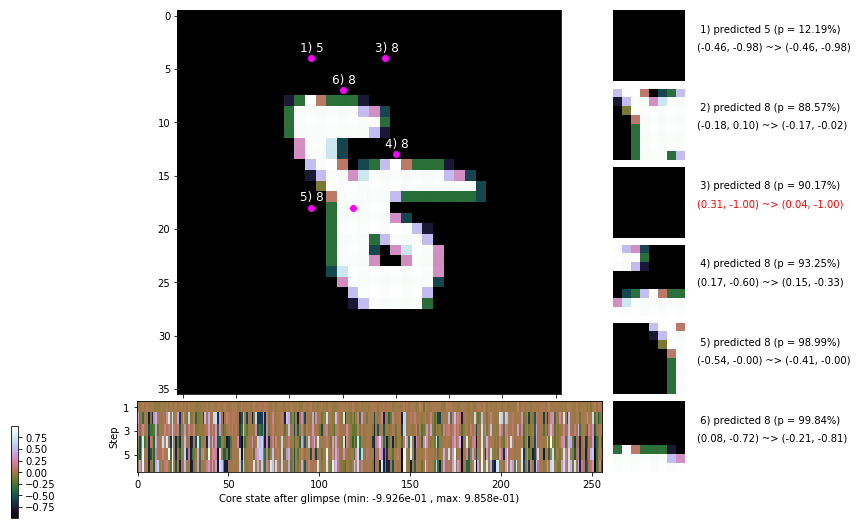

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.000, 0.001, 0.011, 0.110, 1.100, 1.000]


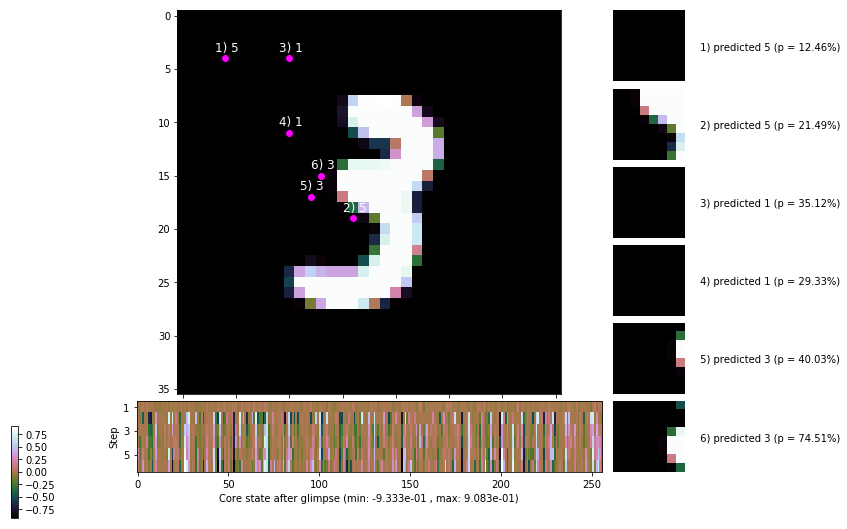


	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


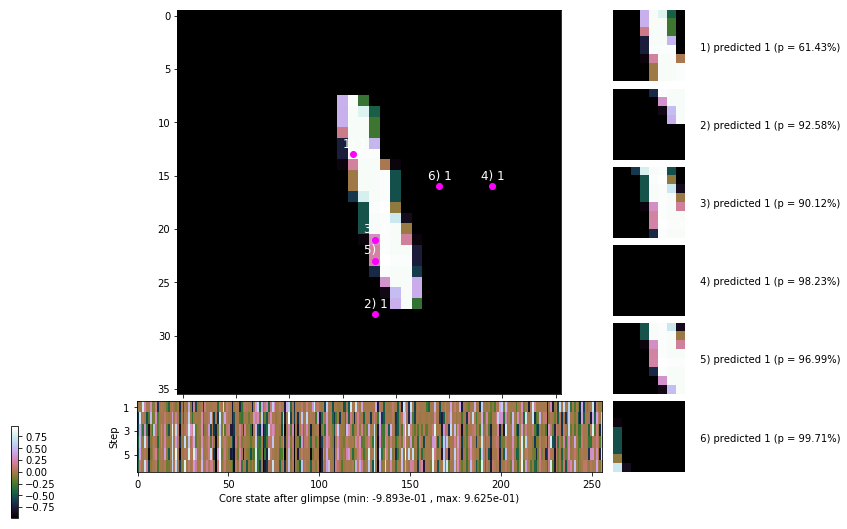

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


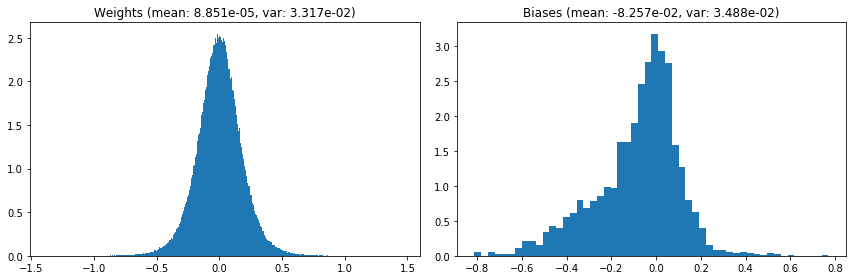

                                      Location network weights and biases


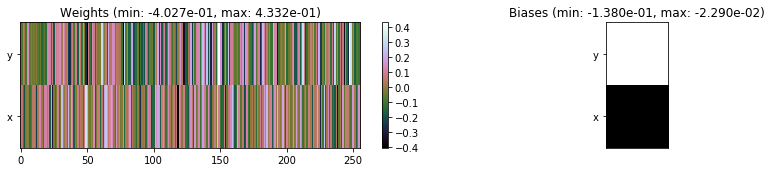

---------------------------------------------------------------------------------------------------------------
Elapsed time:  537.53 sec | TRAIN >> class loss: 0.4280 | steps:  2.478 :( | reward:  4.1493    | acc.: 85.702% :(
                          | VAL   >> class loss: 0.4230 | steps:  2.339    | reward:  4.3052    | acc.: 86.520% :(


Epoch  10/400) lr = 0.0008737
 b    300/  3000 >> 173.2 ms/b | lr: 8.73e-04 | grad 2norm:  9.36 | grad inf norm:  2.242
         Weights || abs max:  1.46 ( 4249.99) | mean:  1.16e-04 ( 0.02) | var: 3.33e-02 (  342.32)
          Biases || abs max:  0.81 (  177.38) | mean: -8.20e-02 ( 0.20) | var: 3.49e-02 (  978.46)
                    class loss: 0.428 | steps: 2.437 | reward:  4.197 | acc.: 86.28%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 172.0 ms/b | lr: 8.72e-04 | grad 2norm:  9.34 | grad inf norm:  2.147
         Weights || abs max:  1.49 ( 6522.78) | mean:  1.55e-04 (

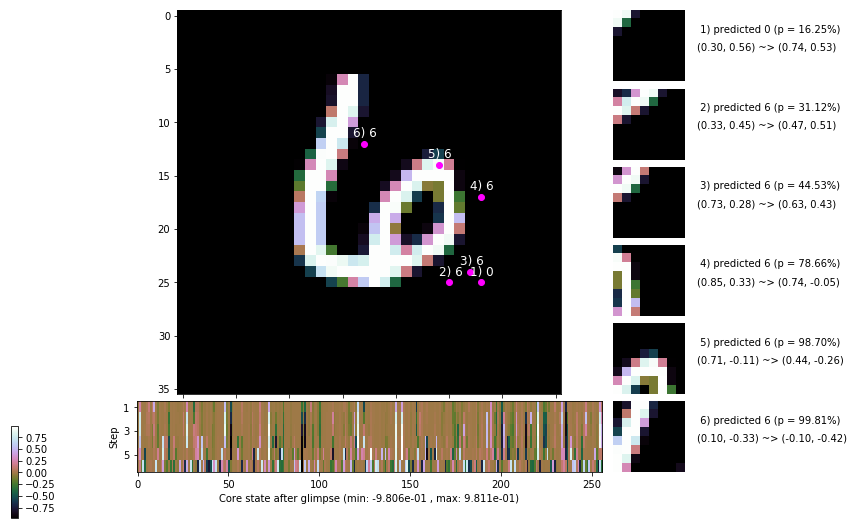

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 175.7 ms/b | lr: 8.70e-04 | grad 2norm:  9.46 | grad inf norm:  2.342
         Weights || abs max:  1.48 (10389.11) | mean:  1.50e-04 ( 0.03) | var: 3.37e-02 (17701.20)
          Biases || abs max:  0.82 (  242.10) | mean: -8.36e-02 ( 0.20) | var: 3.57e-02 (  999.22)
                    class loss: 0.436 | steps: 2.438 | reward:  4.168 | acc.: 85.50%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 172.6 ms/b | lr: 8.69e-04 | grad 2norm:  9.53 | grad inf norm:  2.340
         Weights || abs max:  1.48 (63650.29) | mean:  1.27e-04 ( 0.13) | var: 3.39e-02 (2007983.38)
          Biases || abs max:  0.83 (  168.07) | mean: -8.29e-02 ( 0.17) | var: 3.59e-02 (  296.29)
                    class loss: 0.409 | steps: 2.431 | reward:  4.207 | acc.: 86.40%

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1

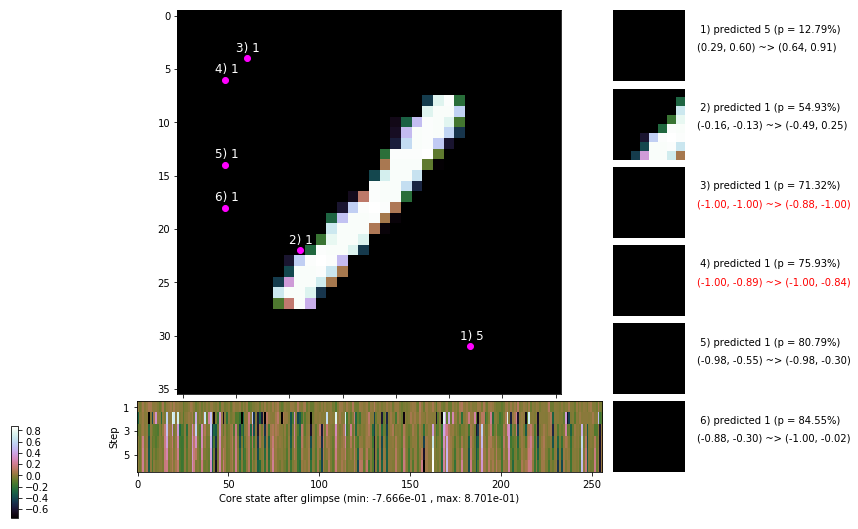

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 174.6 ms/b | lr: 8.68e-04 | grad 2norm:  9.46 | grad inf norm:  2.299
         Weights || abs max:  1.50 ( 9831.30) | mean:  1.03e-04 ( 0.03) | var: 3.41e-02 (13548.78)
          Biases || abs max:  0.84 (  250.07) | mean: -8.33e-02 ( 0.21) | var: 3.63e-02 (  504.28)
                    class loss: 0.440 | steps: 2.438 | reward:  4.184 | acc.: 85.95%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 171.6 ms/b | lr: 8.67e-04 | grad 2norm:  9.39 | grad inf norm:  2.127
         Weights || abs max:  1.50 ( 8116.49) | mean:  3.87e-05 ( 0.03) | var: 3.43e-02 ( 5185.03)
          Biases || abs max:  0.84 (  240.79) | mean: -8.49e-02 ( 0.22) | var: 3.68e-02 (  345.17)
                    class loss: 0.458 | steps: 2.456 | reward:  4.148 | acc.: 85.17%

	Target class: 6 | Discounted rewards: [1.111, 1.111, 1.1

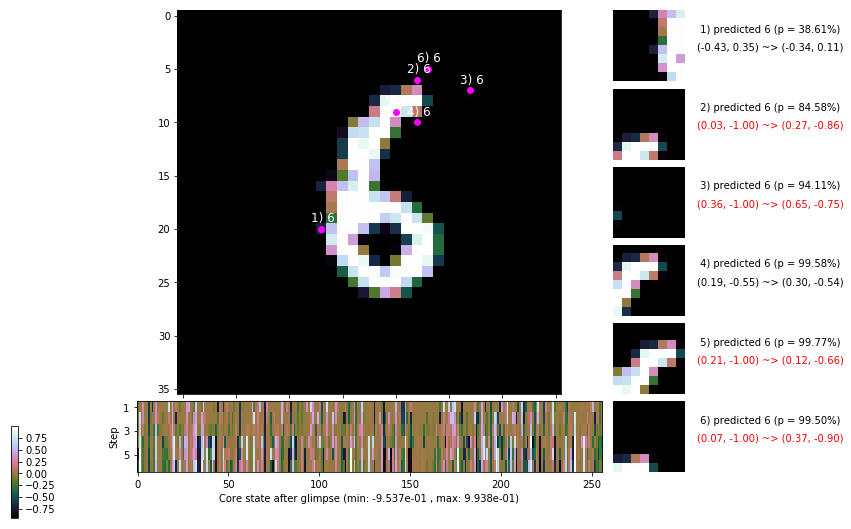

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 178.4 ms/b | lr: 8.65e-04 | grad 2norm:  9.39 | grad inf norm:  2.197
         Weights || abs max:  1.50 ( 5168.73) | mean:  2.96e-05 ( 0.02) | var: 3.45e-02 ( 1793.34)
          Biases || abs max:  0.85 (  234.67) | mean: -8.55e-02 ( 0.20) | var: 3.73e-02 (  822.79)
                    class loss: 0.425 | steps: 2.430 | reward:  4.196 | acc.: 85.83%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 172.0 ms/b | lr: 8.64e-04 | grad 2norm:  9.38 | grad inf norm:  2.289
         Weights || abs max:  1.50 ( 2186.23) | mean: -2.39e-05 ( 0.02) | var: 3.47e-02 (   40.26)
          Biases || abs max:  0.85 (  131.05) | mean: -8.59e-02 ( 0.14) | var: 3.75e-02 (   47.90)
                    class loss: 0.422 | steps: 2.476 | reward:  4.171 | acc.: 86.27%

	Target class: 0 | Discounted rewards: [0.111, 1.111, 1.1

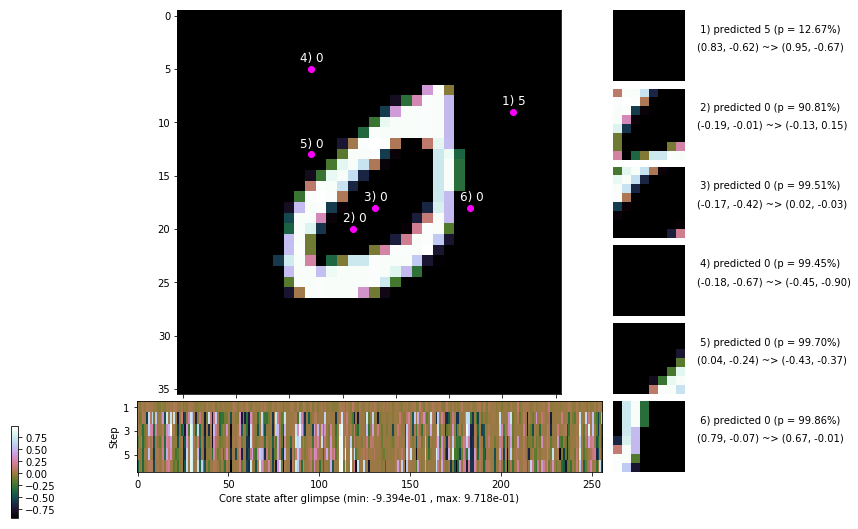

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 192.2 ms/b | lr: 8.62e-04 | grad 2norm:  9.35 | grad inf norm:  2.311
         Weights || abs max:  1.50 ( 7955.31) | mean: -2.39e-05 ( 0.03) | var: 3.49e-02 ( 6826.79)
          Biases || abs max:  0.87 (  182.06) | mean: -8.65e-02 ( 0.19) | var: 3.78e-02 (  454.73)
                    class loss: 0.431 | steps: 2.463 | reward:  4.162 | acc.: 85.47%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 186.9 ms/b | lr: 8.62e-04 | grad 2norm:  9.09 | grad inf norm:  2.141
         Weights || abs max:  1.52 (14189.11) | mean:  9.25e-06 ( 0.04) | var: 3.51e-02 (52589.32)
          Biases || abs max:  0.86 (  134.71) | mean: -8.70e-02 ( 0.15) | var: 3.81e-02 (  164.47)
                    class loss: 0.426 | steps: 2.452 | reward:  4.175 | acc.: 85.62%

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.1

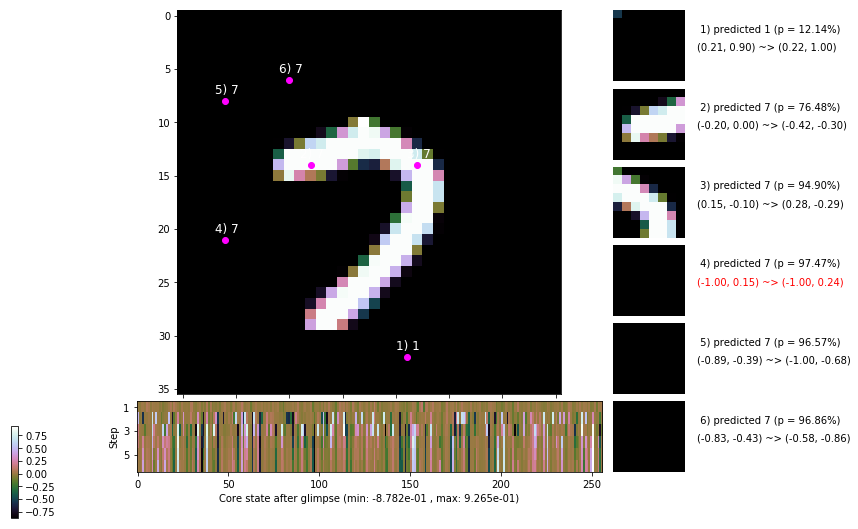

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


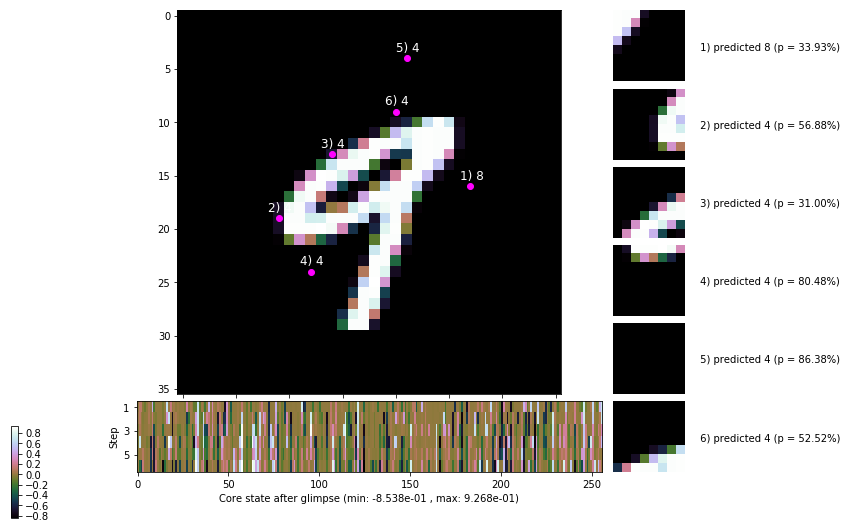


	Target class: 3 | Discounted rewards: [0.001, 0.011, 0.111, 1.110, 1.100, 1.000]


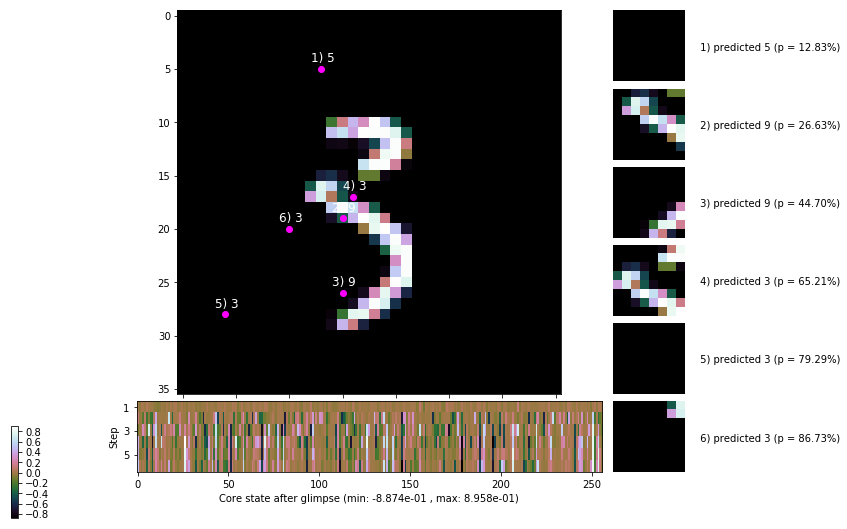

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


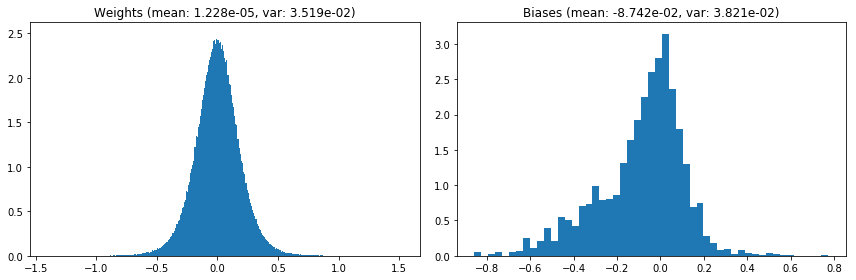

                                      Location network weights and biases


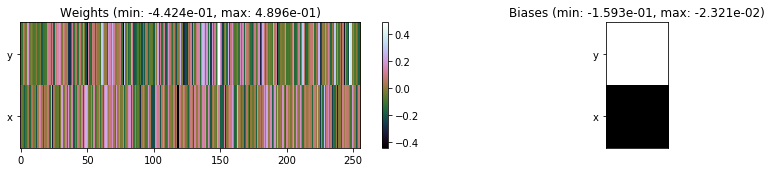

---------------------------------------------------------------------------------------------------------------
Elapsed time:  531.53 sec | TRAIN >> class loss: 0.4301 | steps:  2.446    | reward:  4.1799    | acc.: 85.887% 
                          | VAL   >> class loss: 0.4099 | steps:  2.314    | reward:  4.3348    | acc.: 86.140% :(


Epoch  11/400) lr = 0.0008606
 b    300/  3000 >> 163.6 ms/b | lr: 8.60e-04 | grad 2norm:  9.44 | grad inf norm:  2.376
         Weights || abs max:  1.53 (11450.64) | mean:  2.55e-05 ( 0.03) | var: 3.53e-02 (34840.64)
          Biases || abs max:  0.86 (  239.35) | mean: -8.78e-02 ( 0.21) | var: 3.83e-02 (  625.61)
                    class loss: 0.423 | steps: 2.447 | reward:  4.175 | acc.: 85.45%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 159.1 ms/b | lr: 8.59e-04 | grad 2norm:  9.52 | grad inf norm:  2.285
         Weights || abs max:  1.54 (21304.64) | mean:  6.52e-05 ( 0

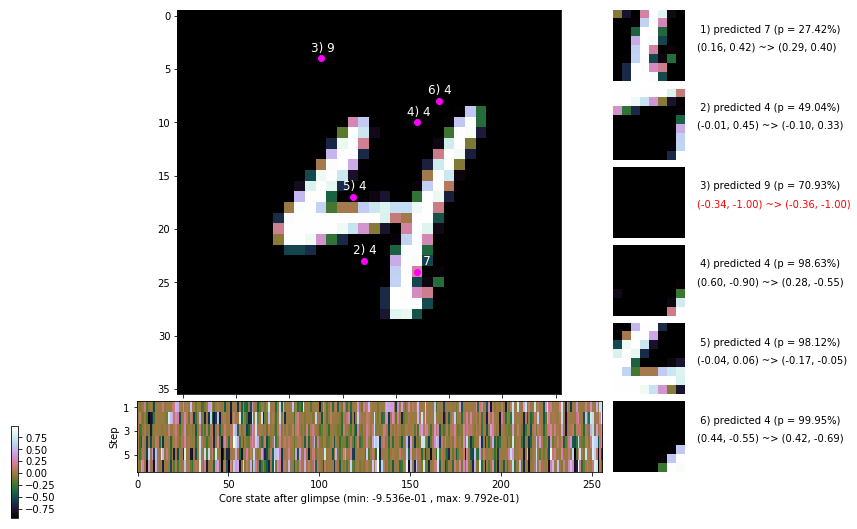

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 160.5 ms/b | lr: 8.57e-04 | grad 2norm:  9.47 | grad inf norm:  2.263
         Weights || abs max:  1.53 ( 7117.77) | mean:  5.65e-05 ( 0.03) | var: 3.57e-02 ( 3450.51)
          Biases || abs max:  0.90 (  158.83) | mean: -8.89e-02 ( 0.15) | var: 3.88e-02 (  333.35)
                    class loss: 0.422 | steps: 2.446 | reward:  4.200 | acc.: 86.12%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 161.0 ms/b | lr: 8.56e-04 | grad 2norm:  9.66 | grad inf norm:  2.326
         Weights || abs max:  1.55 ( 3662.98) | mean:  5.32e-05 ( 0.02) | var: 3.59e-02 (  442.64)
          Biases || abs max:  0.90 (  188.33) | mean: -8.86e-02 ( 0.18) | var: 3.90e-02 (  847.49)
                    class loss: 0.407 | steps: 2.396 | reward:  4.243 | acc.: 86.45%

	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.1

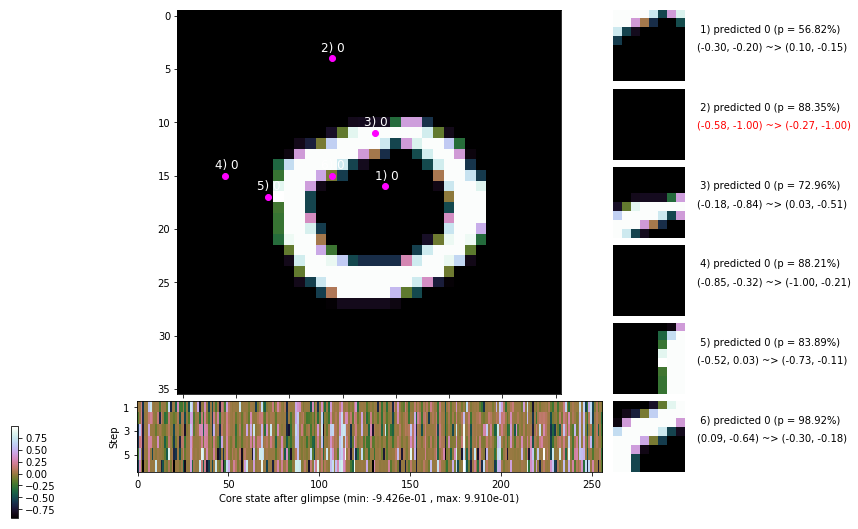

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 161.5 ms/b | lr: 8.55e-04 | grad 2norm:  9.44 | grad inf norm:  2.278
         Weights || abs max:  1.55 ( 4289.13) | mean:  2.40e-05 ( 0.02) | var: 3.61e-02 (  515.83)
          Biases || abs max:  0.89 ( 1127.74) | mean: -8.90e-02 ( 0.54) | var: 3.92e-02 (105330.45)
                    class loss: 0.407 | steps: 2.411 | reward:  4.228 | acc.: 86.12%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 157.8 ms/b | lr: 8.54e-04 | grad 2norm:  9.48 | grad inf norm:  2.332
         Weights || abs max:  1.54 ( 5274.44) | mean:  1.47e-05 ( 0.02) | var: 3.63e-02 (  380.24)
          Biases || abs max:  0.90 (   85.92) | mean: -8.92e-02 ( 0.12) | var: 3.95e-02 (   31.74)
                    class loss: 0.410 | steps: 2.423 | reward:  4.211 | acc.: 86.27%

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.

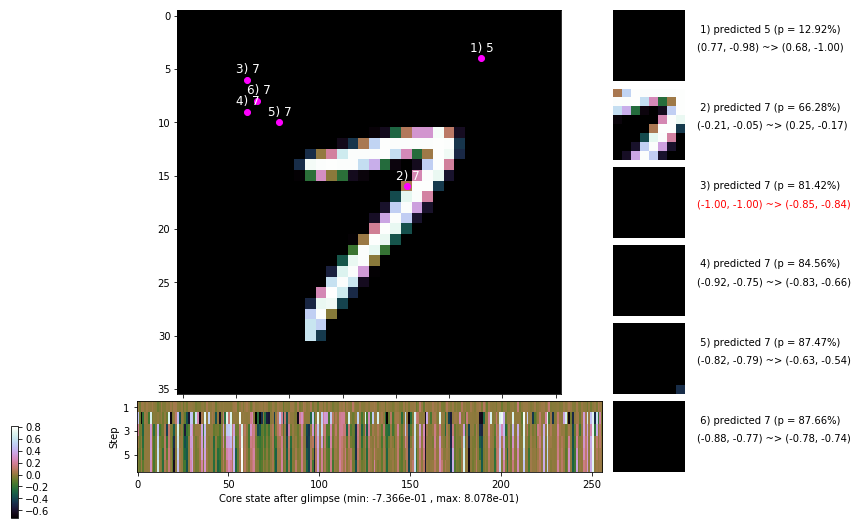

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 161.7 ms/b | lr: 8.52e-04 | grad 2norm:  9.50 | grad inf norm:  2.299
         Weights || abs max:  1.55 ( 5994.89) | mean:  8.94e-05 ( 0.02) | var: 3.65e-02 (  859.71)
          Biases || abs max:  0.89 (  254.93) | mean: -8.93e-02 ( 0.20) | var: 3.98e-02 (  993.62)
                    class loss: 0.409 | steps: 2.411 | reward:  4.215 | acc.: 85.82%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 160.8 ms/b | lr: 8.51e-04 | grad 2norm:  9.36 | grad inf norm:  2.275
         Weights || abs max:  1.54 ( 3010.18) | mean:  1.16e-04 ( 0.02) | var: 3.67e-02 (   90.37)
          Biases || abs max:  0.88 (  192.48) | mean: -8.98e-02 ( 0.18) | var: 4.01e-02 (  204.68)
                    class loss: 0.452 | steps: 2.457 | reward:  4.149 | acc.: 84.85%

	Target class: 5 | Discounted rewards: [0.111, 1.111, 1.1

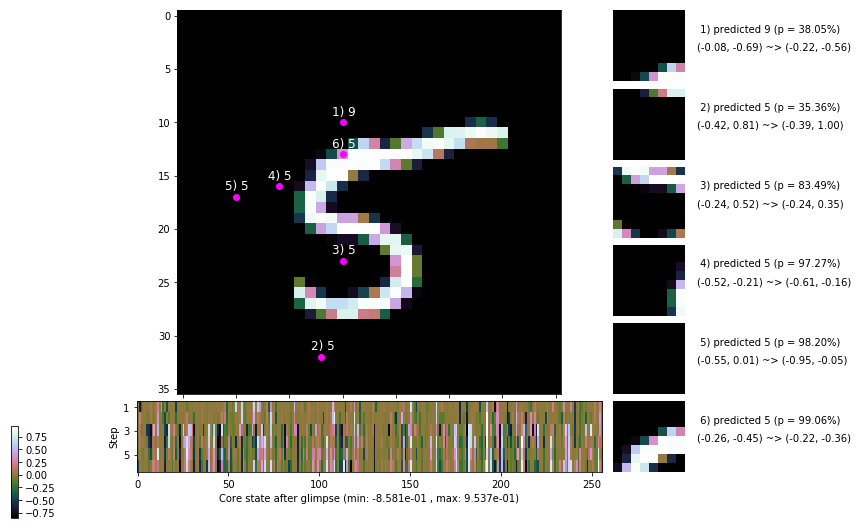

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 160.6 ms/b | lr: 8.50e-04 | grad 2norm:  9.30 | grad inf norm:  2.311
         Weights || abs max:  1.53 ( 3204.69) | mean:  7.45e-05 ( 0.02) | var: 3.69e-02 (   96.97)
          Biases || abs max:  0.89 (  102.29) | mean: -9.02e-02 ( 0.13) | var: 4.06e-02 (   41.70)
                    class loss: 0.423 | steps: 2.427 | reward:  4.210 | acc.: 85.72%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 158.6 ms/b | lr: 8.49e-04 | grad 2norm:  9.30 | grad inf norm:  2.207
         Weights || abs max:  1.53 ( 5062.45) | mean:  9.52e-05 ( 0.02) | var: 3.71e-02 (  448.44)
          Biases || abs max:  0.90 (  126.88) | mean: -9.01e-02 ( 0.14) | var: 4.09e-02 (   89.34)
                    class loss: 0.431 | steps: 2.446 | reward:  4.194 | acc.: 85.57%

	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.1

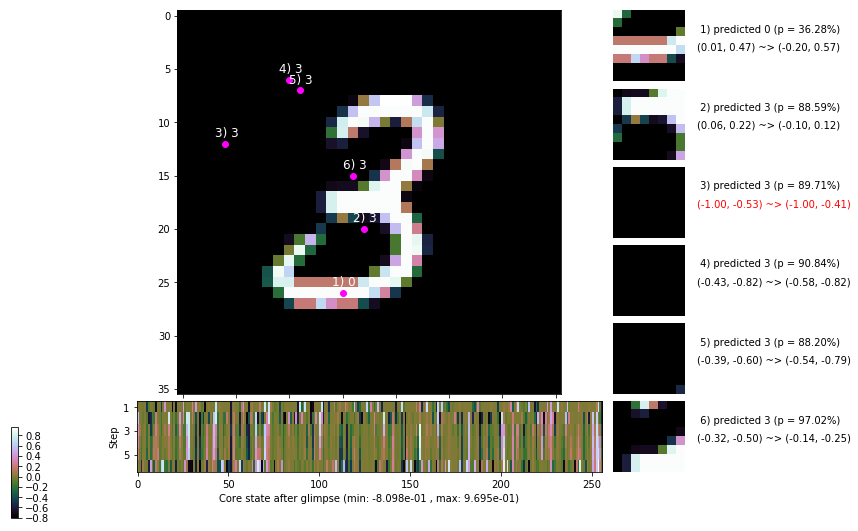

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


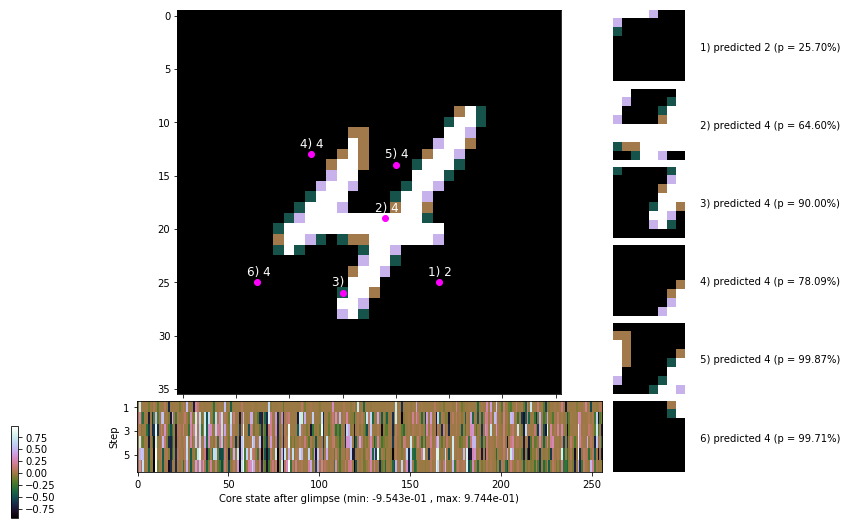


	Target class: 8 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


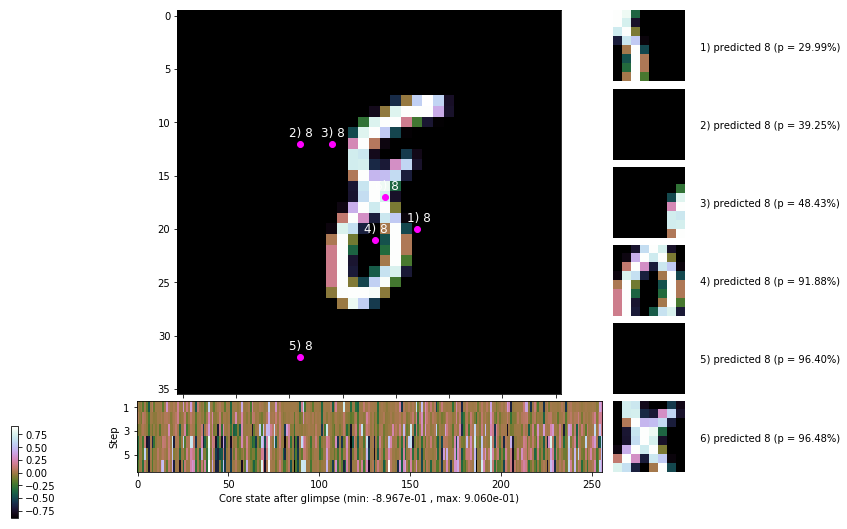

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


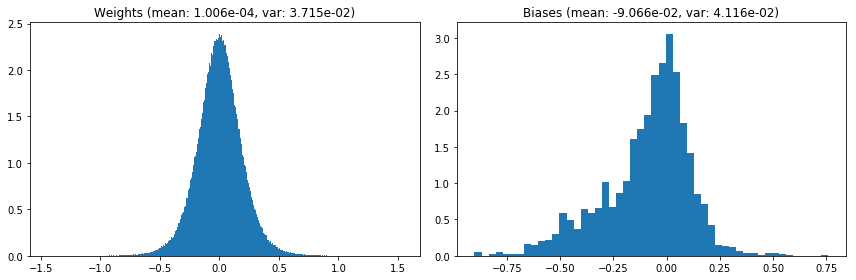

                                      Location network weights and biases


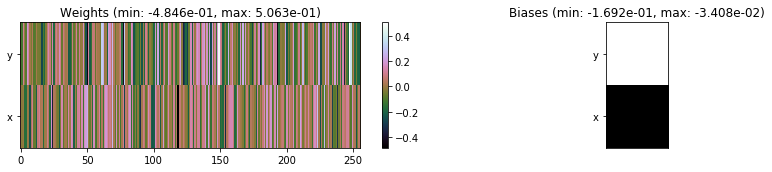

---------------------------------------------------------------------------------------------------------------
Elapsed time:  482.23 sec | TRAIN >> class loss: 0.4195 | steps:  2.428    | reward:  4.2053    | acc.: 85.930% 
                          | VAL   >> class loss: 0.4252 | steps:  2.305    | reward:  4.3452    | acc.: 85.680% :(


Epoch  12/400) lr = 0.0008478
 b    300/  3000 >> 180.5 ms/b | lr: 8.47e-04 | grad 2norm:  9.49 | grad inf norm:  2.312
         Weights || abs max:  1.53 ( 6366.08) | mean:  1.03e-04 ( 0.03) | var: 3.72e-02 ( 3092.85)
          Biases || abs max:  0.92 (  123.13) | mean: -9.09e-02 ( 0.13) | var: 4.13e-02 (  126.76)
                    class loss: 0.451 | steps: 2.433 | reward:  4.181 | acc.: 84.70%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 165.5 ms/b | lr: 8.46e-04 | grad 2norm:  9.08 | grad inf norm:  2.262
         Weights || abs max:  1.55 ( 5183.92) | mean:  1.21e-04 ( 0

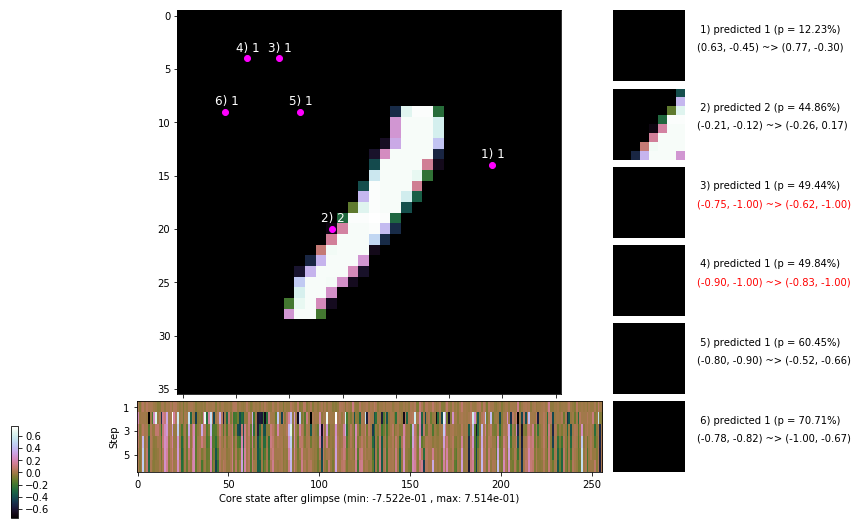

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 161.0 ms/b | lr: 8.44e-04 | grad 2norm:  9.15 | grad inf norm:  2.272
         Weights || abs max:  1.56 (10395.08) | mean:  1.60e-04 ( 0.03) | var: 3.76e-02 ( 7871.85)
          Biases || abs max:  0.91 (  111.21) | mean: -9.22e-02 ( 0.14) | var: 4.19e-02 (   88.52)
                    class loss: 0.417 | steps: 2.412 | reward:  4.221 | acc.: 85.78%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 157.5 ms/b | lr: 8.44e-04 | grad 2norm:  9.34 | grad inf norm:  2.327
         Weights || abs max:  1.57 ( 3010.08) | mean:  2.05e-04 ( 0.02) | var: 3.78e-02 (   70.46)
          Biases || abs max:  0.91 (  142.75) | mean: -9.21e-02 ( 0.14) | var: 4.23e-02 (  170.58)
                    class loss: 0.423 | steps: 2.385 | reward:  4.266 | acc.: 85.72%

	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.0

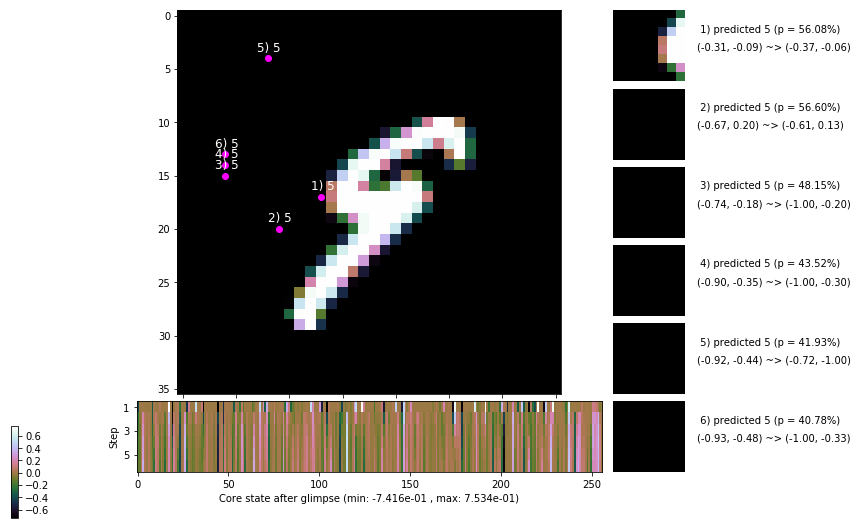

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 161.7 ms/b | lr: 8.42e-04 | grad 2norm:  9.44 | grad inf norm:  2.278
         Weights || abs max:  1.58 ( 9421.93) | mean:  1.81e-04 ( 0.03) | var: 3.80e-02 ( 6793.51)
          Biases || abs max:  0.92 (  143.03) | mean: -9.29e-02 ( 0.14) | var: 4.24e-02 (  253.98)
                    class loss: 0.445 | steps: 2.443 | reward:  4.176 | acc.: 85.28%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 160.1 ms/b | lr: 8.41e-04 | grad 2norm:  9.44 | grad inf norm:  2.236
         Weights || abs max:  1.59 ( 4183.42) | mean:  1.63e-04 ( 0.02) | var: 3.82e-02 (  349.51)
          Biases || abs max:  0.93 (  128.20) | mean: -9.37e-02 ( 0.13) | var: 4.28e-02 (   79.81)
                    class loss: 0.431 | steps: 2.405 | reward:  4.215 | acc.: 85.58%

	Target class: 2 | Discounted rewards: [1.111, 1.111, 1.1

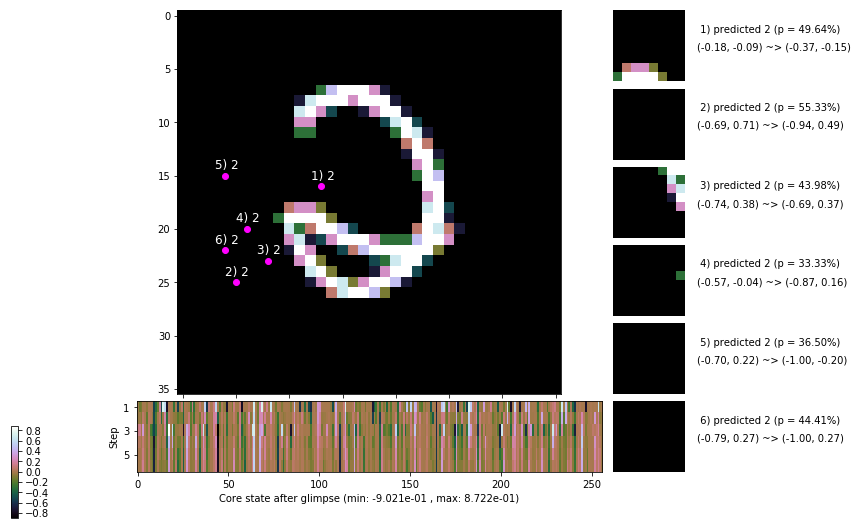

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 161.7 ms/b | lr: 8.39e-04 | grad 2norm:  9.32 | grad inf norm:  2.316
         Weights || abs max:  1.60 ( 7256.30) | mean:  1.64e-04 ( 0.03) | var: 3.84e-02 ( 3188.38)
          Biases || abs max:  0.93 (  210.71) | mean: -9.38e-02 ( 0.22) | var: 4.32e-02 ( 4580.83)
                    class loss: 0.429 | steps: 2.427 | reward:  4.189 | acc.: 85.35%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 158.7 ms/b | lr: 8.39e-04 | grad 2norm:  9.41 | grad inf norm:  2.342
         Weights || abs max:  1.60 ( 4185.23) | mean:  1.77e-04 ( 0.02) | var: 3.85e-02 (  205.86)
          Biases || abs max:  0.95 (  372.26) | mean: -9.44e-02 ( 0.23) | var: 4.36e-02 ( 6388.54)
                    class loss: 0.456 | steps: 2.432 | reward:  4.178 | acc.: 84.12%

	Target class: 1 | Discounted rewards: [0.101, 1.011, 0.1

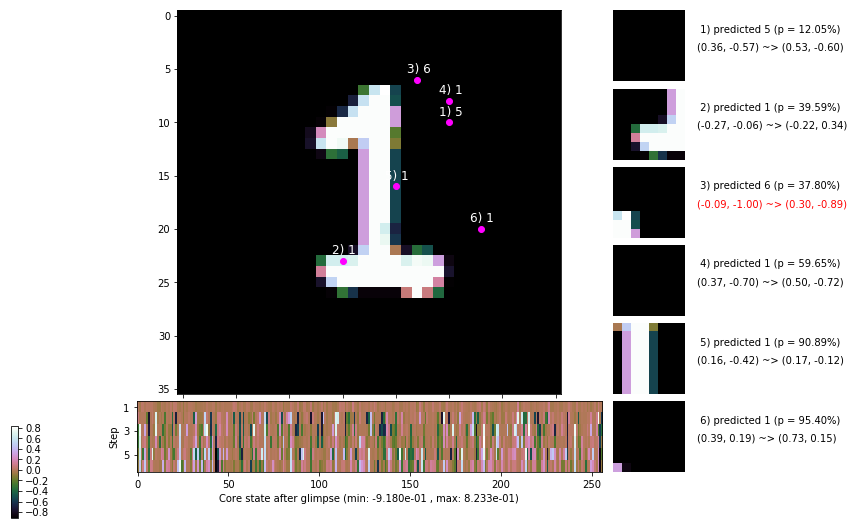

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 162.4 ms/b | lr: 8.37e-04 | grad 2norm:  9.17 | grad inf norm:  2.249
         Weights || abs max:  1.60 ( 8340.04) | mean:  2.05e-04 ( 0.03) | var: 3.87e-02 ( 9868.70)
          Biases || abs max:  0.95 (  112.65) | mean: -9.50e-02 ( 0.13) | var: 4.39e-02 (   61.04)
                    class loss: 0.407 | steps: 2.408 | reward:  4.237 | acc.: 86.37%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 160.0 ms/b | lr: 8.36e-04 | grad 2norm:  9.45 | grad inf norm:  2.271
         Weights || abs max:  1.60 ( 4115.40) | mean:  1.29e-04 ( 0.02) | var: 3.89e-02 (  268.74)
          Biases || abs max:  0.94 (   94.01) | mean: -9.53e-02 ( 0.11) | var: 4.43e-02 (   71.73)
                    class loss: 0.437 | steps: 2.444 | reward:  4.175 | acc.: 85.25%

	Target class: 2 | Discounted rewards: [0.011, 0.111, 1.1

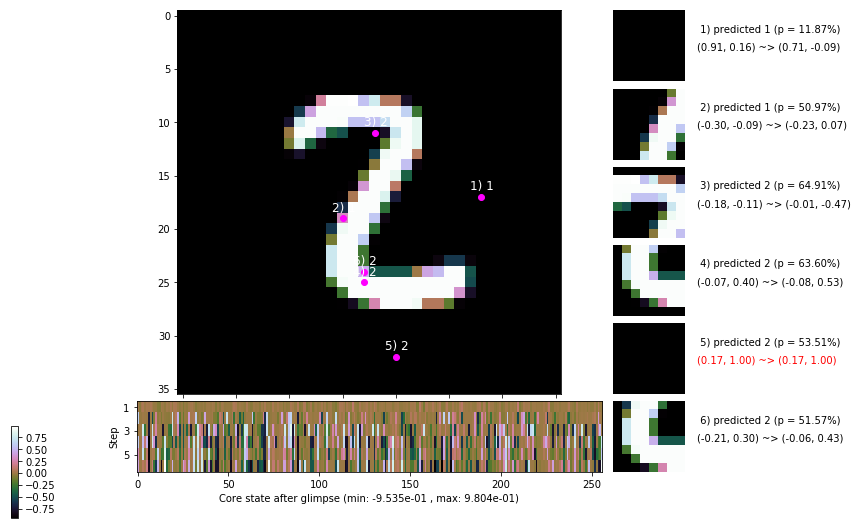

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


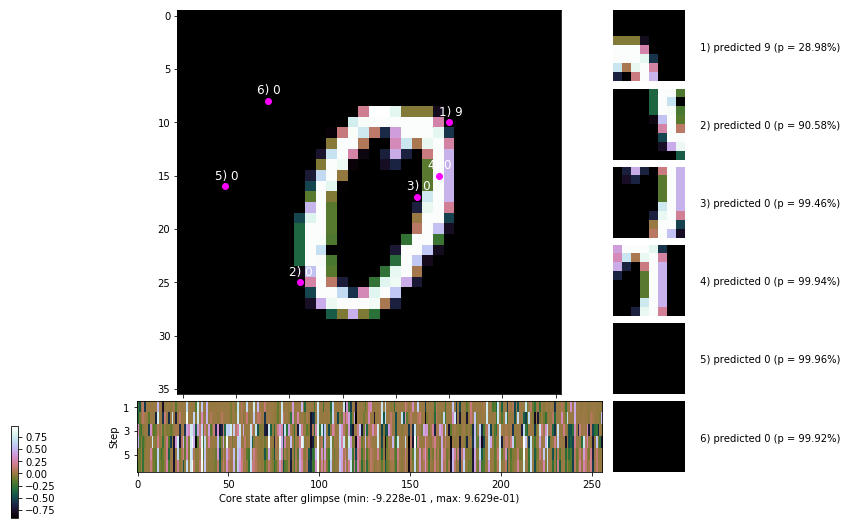


	Target class: 4 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


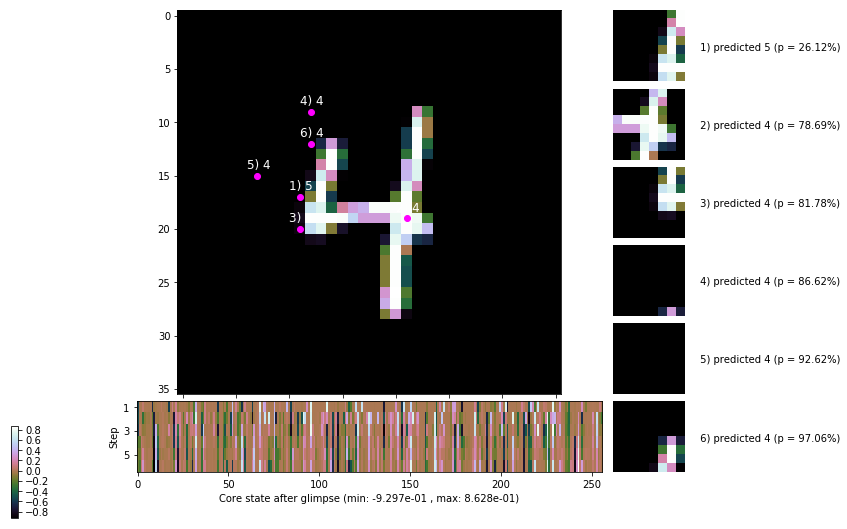

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


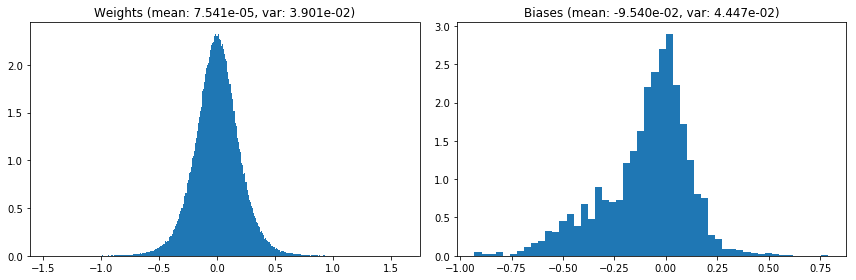

                                      Location network weights and biases


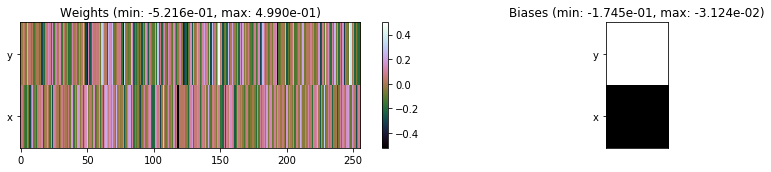

---------------------------------------------------------------------------------------------------------------
Elapsed time:  489.35 sec | TRAIN >> class loss: 0.4347 | steps:  2.422    | reward:  4.2018 :( | acc.: 85.297% :(
                          | VAL   >> class loss: 0.4123 | steps:  2.280    | reward:  4.3676    | acc.: 86.320% :(


Epoch  13/400) lr = 0.0008352
 b    300/  3000 >> 159.7 ms/b | lr: 8.34e-04 | grad 2norm:  9.41 | grad inf norm:  2.355
         Weights || abs max:  1.60 ( 6870.26) | mean:  9.05e-05 ( 0.03) | var: 3.91e-02 ( 2045.49)
          Biases || abs max:  0.93 (   84.61) | mean: -9.52e-02 ( 0.11) | var: 4.46e-02 (   38.06)
                    class loss: 0.426 | steps: 2.420 | reward:  4.205 | acc.: 86.02%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 158.7 ms/b | lr: 8.34e-04 | grad 2norm:  9.37 | grad inf norm:  2.410
         Weights || abs max:  1.61 ( 6549.64) | mean:  1.00e-04 (

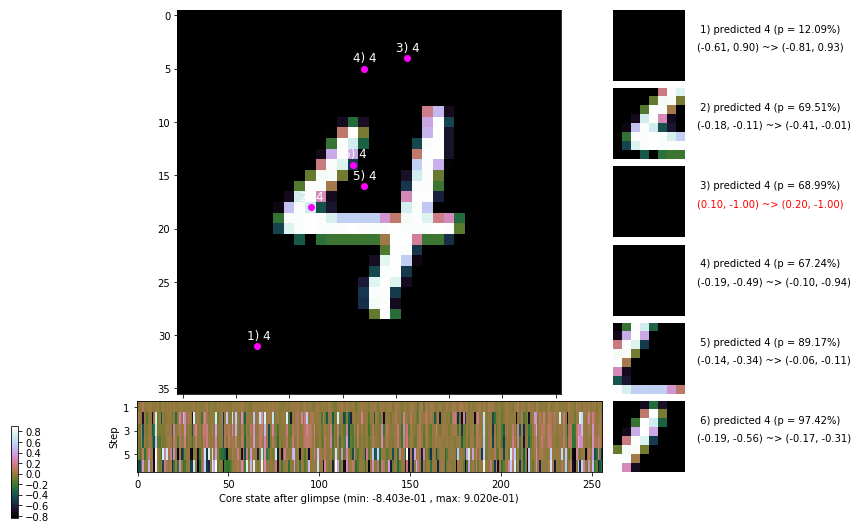

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 181.4 ms/b | lr: 8.32e-04 | grad 2norm:  9.04 | grad inf norm:  2.290
         Weights || abs max:  1.60 ( 6026.59) | mean:  5.65e-05 ( 0.03) | var: 3.94e-02 ( 1619.57)
          Biases || abs max:  0.94 (  137.07) | mean: -9.61e-02 ( 0.13) | var: 4.53e-02 (  261.48)
                    class loss: 0.409 | steps: 2.392 | reward:  4.255 | acc.: 86.43%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 179.2 ms/b | lr: 8.31e-04 | grad 2norm:  9.33 | grad inf norm:  2.351
         Weights || abs max:  1.59 (176976.19) | mean:  4.04e-05 ( 0.34) | var: 3.96e-02 (10192256.00)
          Biases || abs max:  0.95 (  140.02) | mean: -9.59e-02 ( 0.14) | var: 4.54e-02 (  125.09)
                    class loss: 0.408 | steps: 2.415 | reward:  4.228 | acc.: 86.58%

	Target class: 0 | Discounted rewards: [0.111, 1.111,

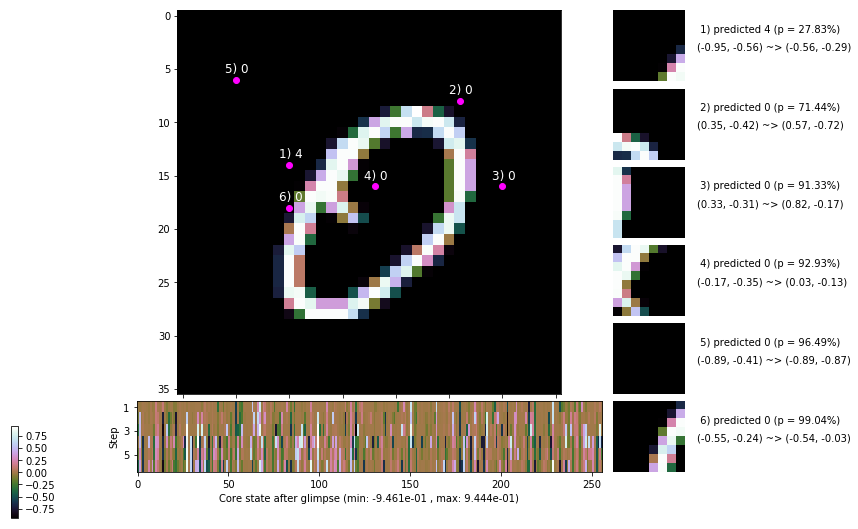

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 157.8 ms/b | lr: 8.29e-04 | grad 2norm:  9.75 | grad inf norm:  2.443
         Weights || abs max:  1.58 ( 8281.58) | mean:  3.97e-05 ( 0.03) | var: 3.98e-02 ( 5333.57)
          Biases || abs max:  0.95 (  140.76) | mean: -9.62e-02 ( 0.14) | var: 4.57e-02 (  251.48)
                    class loss: 0.431 | steps: 2.447 | reward:  4.204 | acc.: 86.02%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 154.4 ms/b | lr: 8.29e-04 | grad 2norm:  9.46 | grad inf norm:  2.293
         Weights || abs max:  1.56 (10772.46) | mean:  4.14e-05 ( 0.03) | var: 4.00e-02 (12825.74)
          Biases || abs max:  0.95 (   89.37) | mean: -9.69e-02 ( 0.12) | var: 4.61e-02 (   32.42)
                    class loss: 0.384 | steps: 2.388 | reward:  4.264 | acc.: 86.95%

	Target class: 2 | Discounted rewards: [0.100, 1.001, 0.0

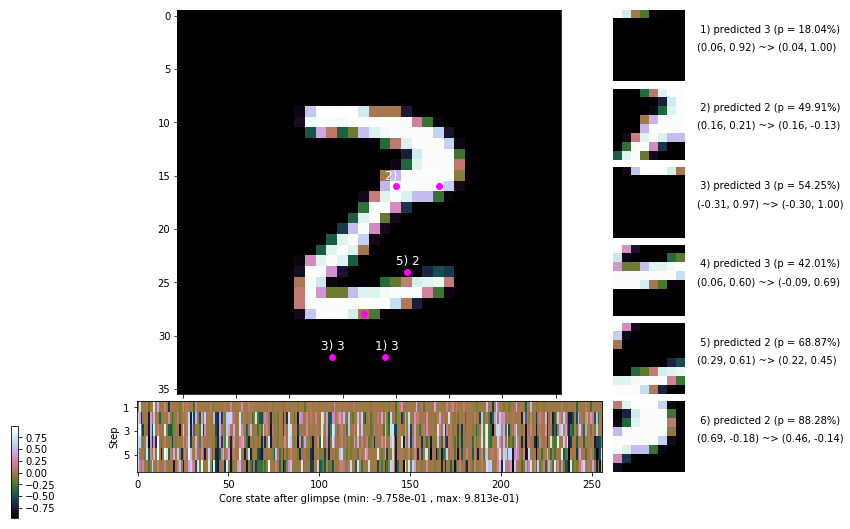

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.7 ms/b | lr: 8.27e-04 | grad 2norm:  9.43 | grad inf norm:  2.218
         Weights || abs max:  1.55 ( 6824.13) | mean:  5.40e-05 ( 0.02) | var: 4.01e-02 ( 2376.36)
          Biases || abs max:  0.96 (  106.57) | mean: -9.66e-02 ( 0.12) | var: 4.61e-02 (   62.12)
                    class loss: 0.395 | steps: 2.393 | reward:  4.260 | acc.: 87.20%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 156.1 ms/b | lr: 8.26e-04 | grad 2norm:  9.37 | grad inf norm:  2.254
         Weights || abs max:  1.56 ( 8540.81) | mean:  4.54e-05 ( 0.03) | var: 4.03e-02 ( 3256.46)
          Biases || abs max:  0.97 (   91.69) | mean: -9.67e-02 ( 0.12) | var: 4.62e-02 (   36.20)
                    class loss: 0.396 | steps: 2.403 | reward:  4.246 | acc.: 86.67%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.0

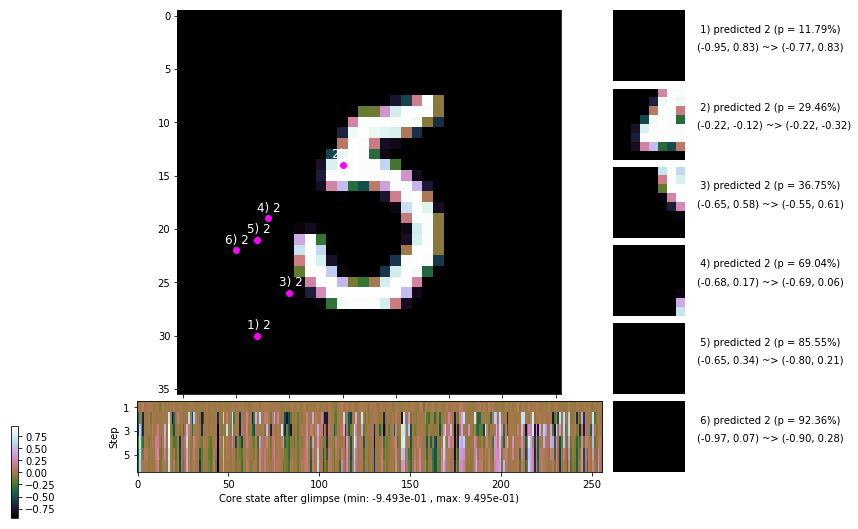

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 157.5 ms/b | lr: 8.24e-04 | grad 2norm:  9.32 | grad inf norm:  2.273
         Weights || abs max:  1.57 (19842.47) | mean:  1.19e-05 ( 0.05) | var: 4.05e-02 (89626.23)
          Biases || abs max:  0.98 (  163.08) | mean: -9.72e-02 ( 0.15) | var: 4.64e-02 (   85.15)
                    class loss: 0.400 | steps: 2.361 | reward:  4.284 | acc.: 86.92%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 156.5 ms/b | lr: 8.24e-04 | grad 2norm:  9.42 | grad inf norm:  2.300
         Weights || abs max:  1.56 (15233.30) | mean:  1.72e-05 ( 0.04) | var: 4.07e-02 (50121.57)
          Biases || abs max:  1.00 (  111.85) | mean: -9.82e-02 ( 0.13) | var: 4.68e-02 (   83.02)
                    class loss: 0.393 | steps: 2.390 | reward:  4.265 | acc.: 86.70%

	Target class: 4 | Discounted rewards: [1.111, 1.111, 1.1

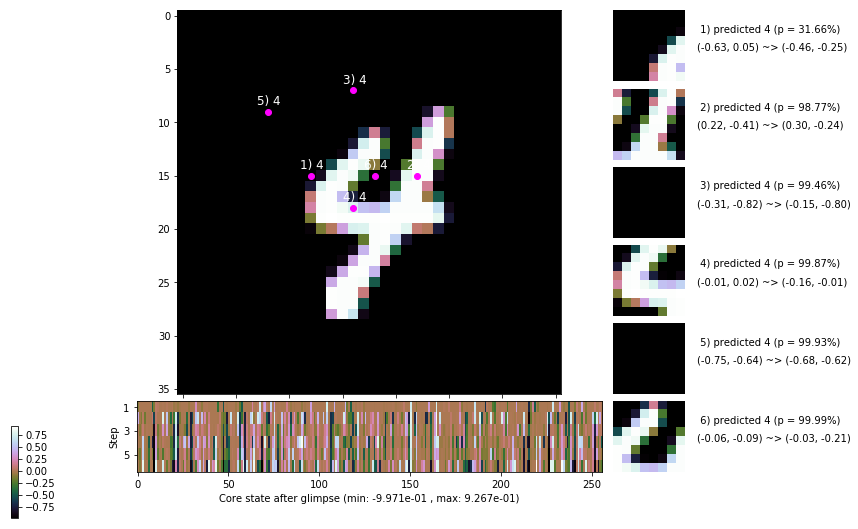

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


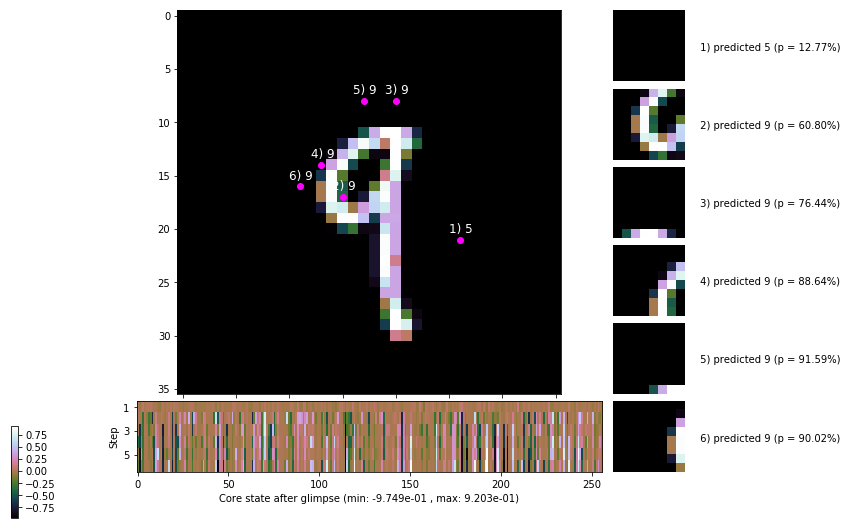


	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


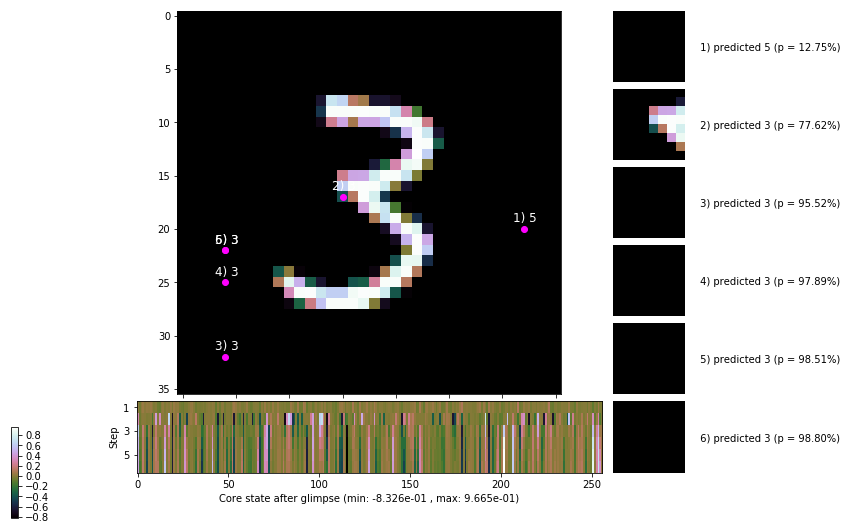

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


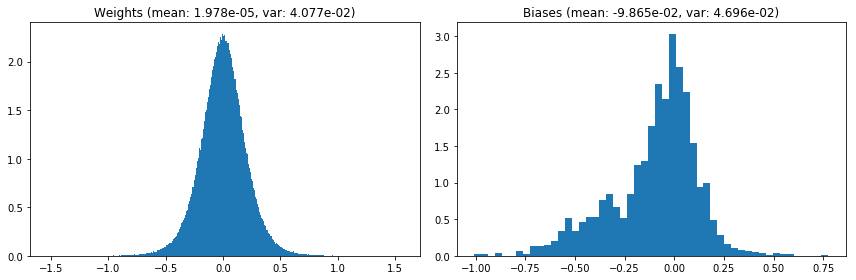

                                      Location network weights and biases


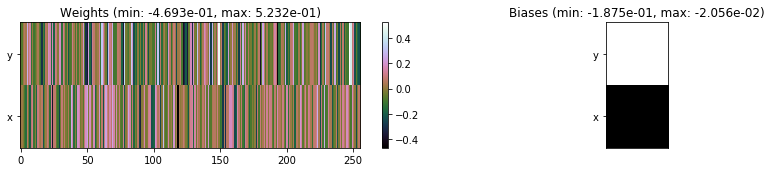

---------------------------------------------------------------------------------------------------------------
Elapsed time:  486.00 sec | TRAIN >> class loss: 0.4082 | steps:  2.406    | reward:  4.2396    | acc.: 86.493% 
                          | VAL   >> class loss: 0.4380 | steps:  2.353 :( | reward:  4.2882 :( | acc.: 85.420% :(


Epoch  14/400) lr = 0.0008228
 b    300/  3000 >> 154.3 ms/b | lr: 8.22e-04 | grad 2norm:  9.15 | grad inf norm:  2.246
         Weights || abs max:  1.55 (20433.95) | mean:  8.28e-06 ( 0.05) | var: 4.09e-02 (144983.08)
          Biases || abs max:  1.00 (  145.72) | mean: -9.88e-02 ( 0.14) | var: 4.71e-02 (  389.42)
                    class loss: 0.397 | steps: 2.405 | reward:  4.257 | acc.: 86.73%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.3 ms/b | lr: 8.21e-04 | grad 2norm:  9.38 | grad inf norm:  2.326
         Weights || abs max:  1.57 (545841.31) | mean:  3.41e-05 (

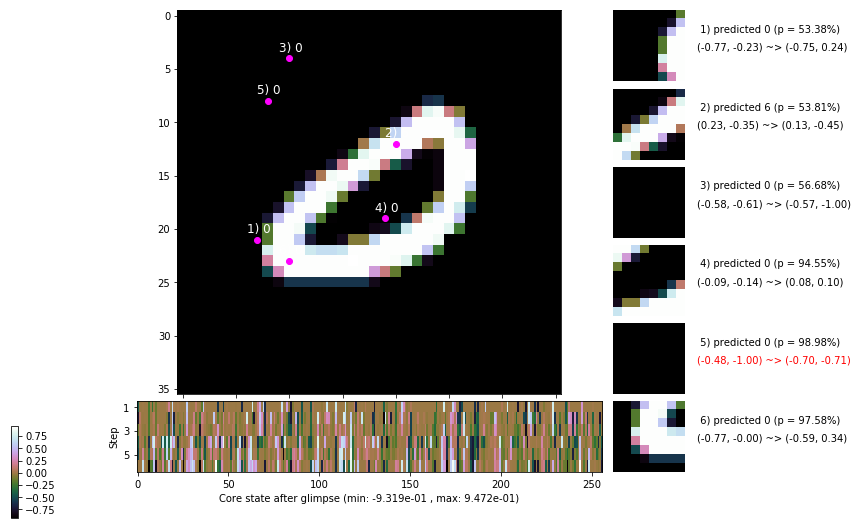

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 158.5 ms/b | lr: 8.19e-04 | grad 2norm:  9.24 | grad inf norm:  2.289
         Weights || abs max:  1.57 ( 3912.97) | mean: -1.68e-05 ( 0.02) | var: 4.12e-02 (  431.88)
          Biases || abs max:  1.03 (  148.81) | mean: -9.87e-02 ( 0.14) | var: 4.74e-02 (  243.24)
                    class loss: 0.415 | steps: 2.408 | reward:  4.220 | acc.: 85.93%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 155.6 ms/b | lr: 8.19e-04 | grad 2norm:  9.22 | grad inf norm:  2.361
         Weights || abs max:  1.58 ( 3789.66) | mean: -3.05e-05 ( 0.02) | var: 4.14e-02 (  169.65)
          Biases || abs max:  1.04 (   71.11) | mean: -9.87e-02 ( 0.10) | var: 4.75e-02 (   21.08)
                    class loss: 0.407 | steps: 2.408 | reward:  4.263 | acc.: 86.77%

	Target class: 5 | Discounted rewards: [0.001, 0.011, 0.1

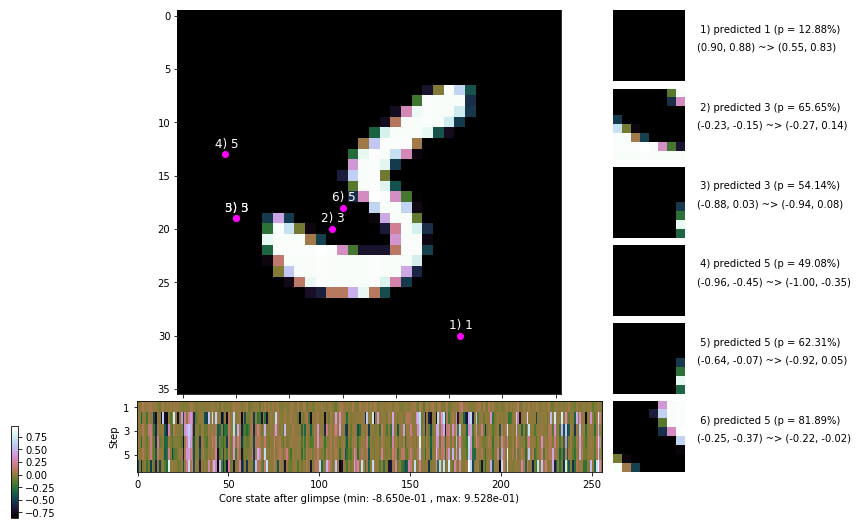

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 168.9 ms/b | lr: 8.17e-04 | grad 2norm:  9.41 | grad inf norm:  2.334
         Weights || abs max:  1.61 ( 4698.25) | mean: -6.87e-05 ( 0.02) | var: 4.16e-02 (  417.86)
          Biases || abs max:  1.04 (  101.51) | mean: -9.94e-02 ( 0.13) | var: 4.77e-02 (   27.03)
                    class loss: 0.419 | steps: 2.431 | reward:  4.194 | acc.: 85.80%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 186.6 ms/b | lr: 8.16e-04 | grad 2norm:  9.11 | grad inf norm:  2.348
         Weights || abs max:  1.61 ( 9281.83) | mean: -7.33e-05 ( 0.03) | var: 4.17e-02 ( 8031.70)
          Biases || abs max:  1.05 (   82.49) | mean: -9.95e-02 ( 0.12) | var: 4.80e-02 (   15.56)
                    class loss: 0.404 | steps: 2.409 | reward:  4.242 | acc.: 86.37%

	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.1

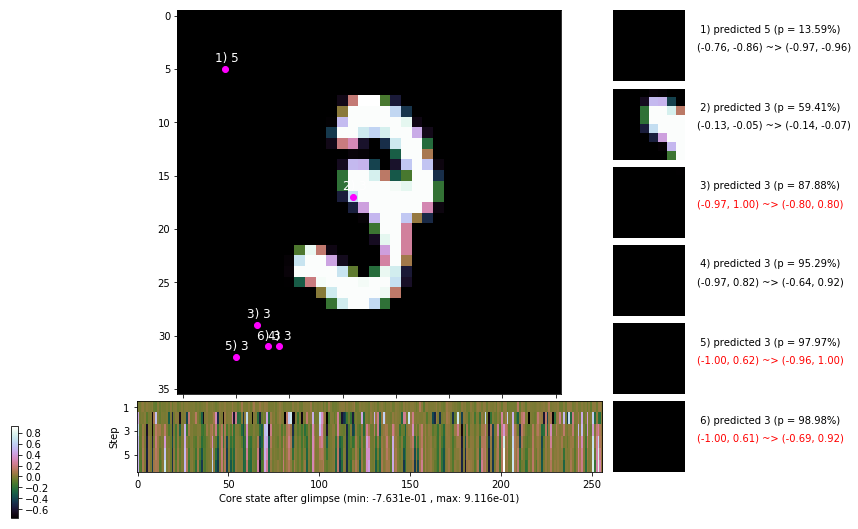

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 158.3 ms/b | lr: 8.15e-04 | grad 2norm:  9.10 | grad inf norm:  2.278
         Weights || abs max:  1.61 ( 7959.41) | mean: -2.65e-05 ( 0.03) | var: 4.19e-02 ( 9042.42)
          Biases || abs max:  1.06 (  317.02) | mean: -9.90e-02 ( 0.19) | var: 4.83e-02 ( 4984.15)
                    class loss: 0.408 | steps: 2.374 | reward:  4.257 | acc.: 86.40%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 156.5 ms/b | lr: 8.14e-04 | grad 2norm:  9.26 | grad inf norm:  2.329
         Weights || abs max:  1.62 ( 7980.07) | mean: -4.83e-05 ( 0.03) | var: 4.21e-02 ( 3255.12)
          Biases || abs max:  1.06 (  151.32) | mean: -9.93e-02 ( 0.14) | var: 4.86e-02 (  176.63)
                    class loss: 0.413 | steps: 2.408 | reward:  4.252 | acc.: 86.32%

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.1

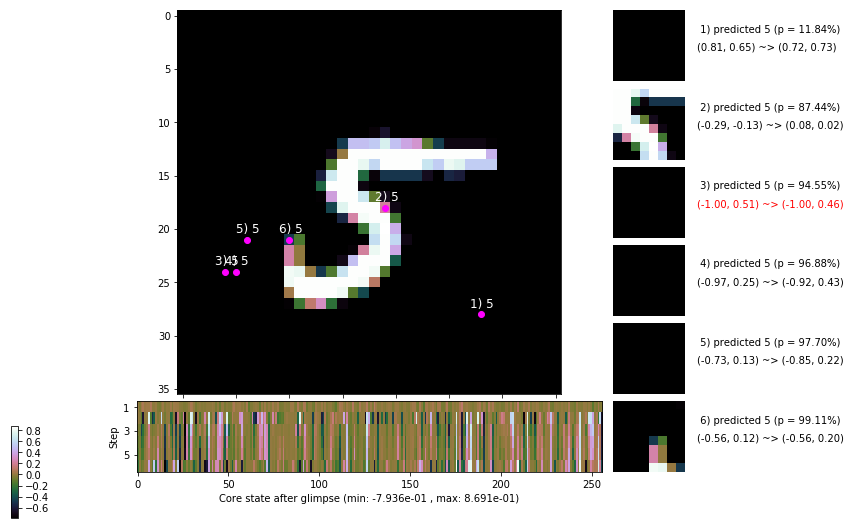

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 155.9 ms/b | lr: 8.12e-04 | grad 2norm:  9.17 | grad inf norm:  2.349
         Weights || abs max:  1.63 ( 5054.58) | mean: -8.33e-05 ( 0.02) | var: 4.23e-02 ( 1050.98)
          Biases || abs max:  1.06 (  127.22) | mean: -1.00e-01 ( 0.12) | var: 4.89e-02 (   87.42)
                    class loss: 0.419 | steps: 2.398 | reward:  4.248 | acc.: 86.53%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 155.5 ms/b | lr: 8.11e-04 | grad 2norm:  8.91 | grad inf norm:  2.198
         Weights || abs max:  1.65 (14002.11) | mean: -1.09e-04 ( 0.04) | var: 4.24e-02 (28598.04)
          Biases || abs max:  1.06 (  110.17) | mean: -1.01e-01 ( 0.12) | var: 4.92e-02 (   52.75)
                    class loss: 0.409 | steps: 2.388 | reward:  4.270 | acc.: 86.83%

	Target class: 8 | Discounted rewards: [0.000, 0.000, 0.0

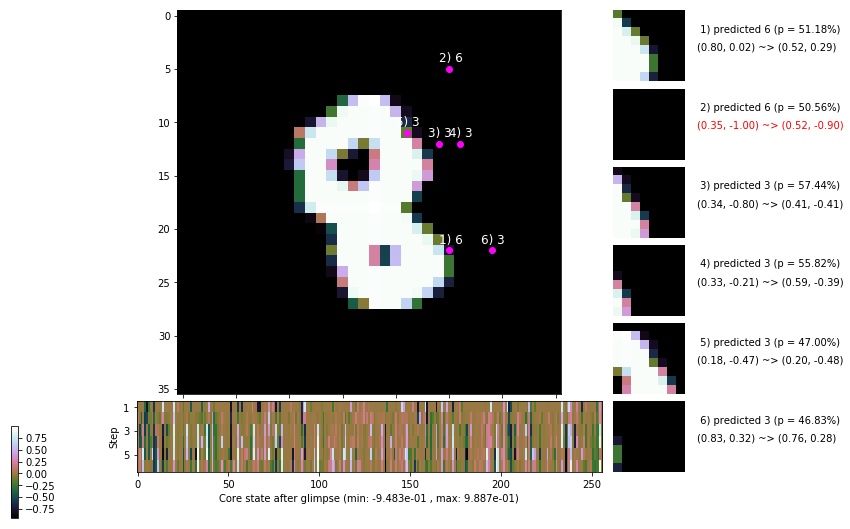

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


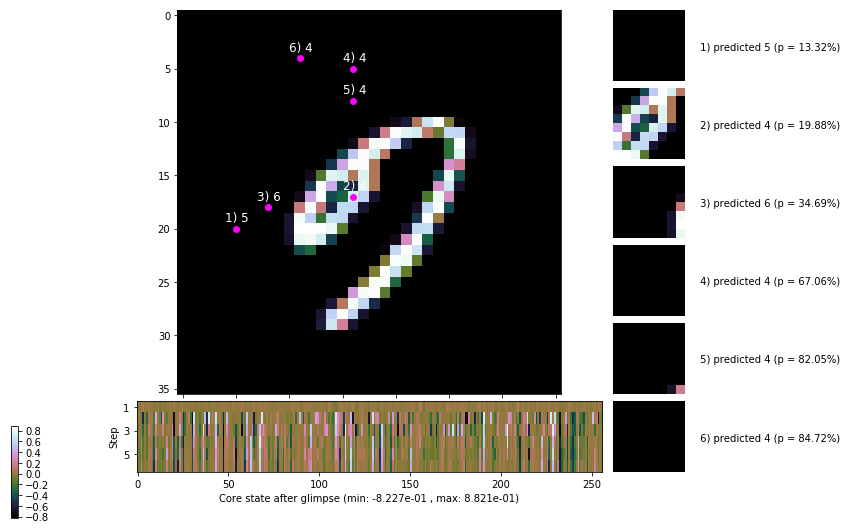


	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


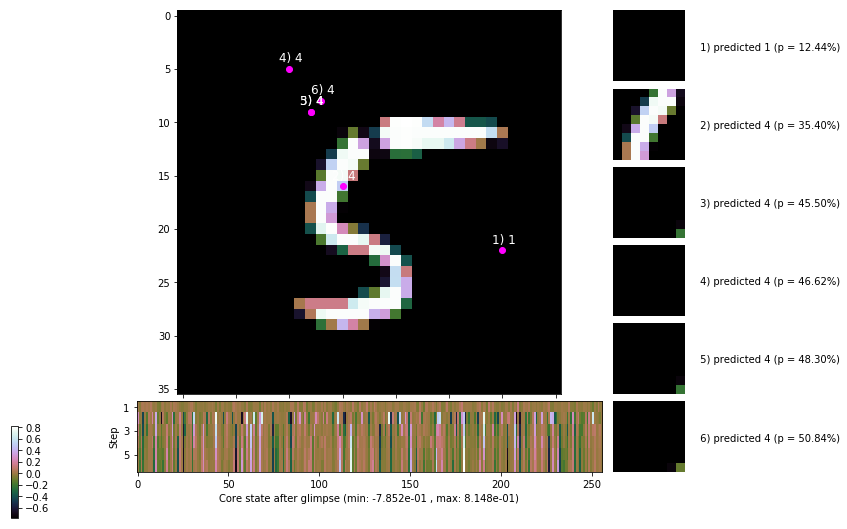

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


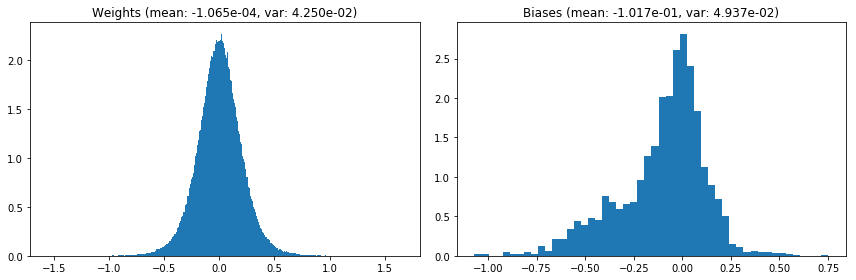

                                      Location network weights and biases


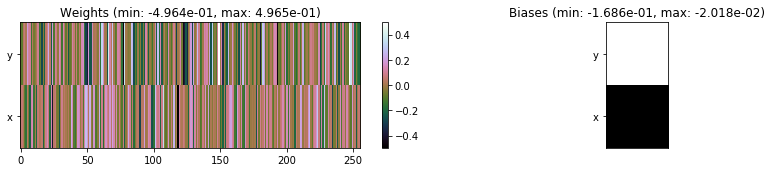

---------------------------------------------------------------------------------------------------------------
Elapsed time:  481.73 sec | TRAIN >> class loss: 0.4106 | steps:  2.401    | reward:  4.2440    | acc.: 86.325% :(
                          | VAL   >> class loss: 0.4254 | steps:  2.310 :( | reward:  4.3318 :( | acc.: 85.680% :(


Epoch  15/400) lr = 0.0008105
 b    300/  3000 >> 156.1 ms/b | lr: 8.10e-04 | grad 2norm:  9.01 | grad inf norm:  2.259
         Weights || abs max:  1.67 ( 7035.65) | mean: -7.61e-05 ( 0.03) | var: 4.26e-02 ( 2621.63)
          Biases || abs max:  1.06 (  208.92) | mean: -1.02e-01 ( 0.18) | var: 4.95e-02 (   62.98)
                    class loss: 0.375 | steps: 2.387 | reward:  4.279 | acc.: 87.72%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 157.4 ms/b | lr: 8.09e-04 | grad 2norm:  9.32 | grad inf norm:  2.212
         Weights || abs max:  1.67 ( 3447.75) | mean: -1.18e-04 (

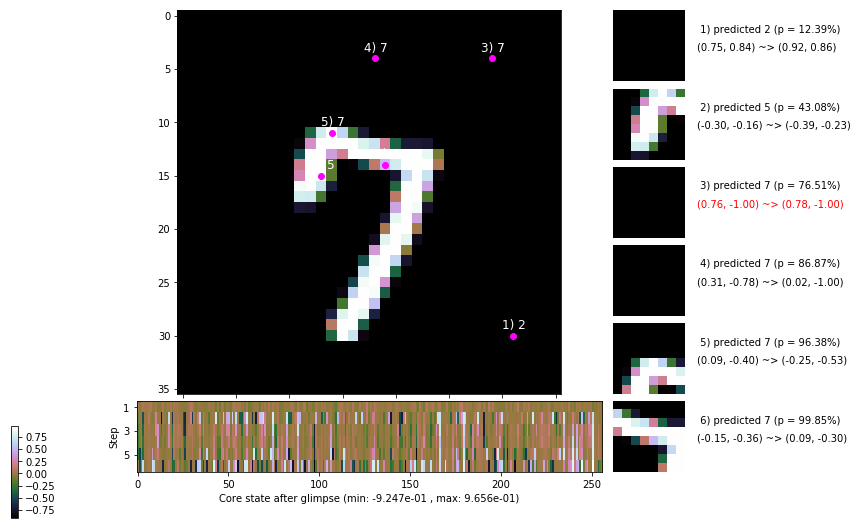

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 156.9 ms/b | lr: 8.07e-04 | grad 2norm:  9.09 | grad inf norm:  2.275
         Weights || abs max:  1.67 ( 5851.76) | mean: -1.06e-04 ( 0.02) | var: 4.29e-02 ( 1563.32)
          Biases || abs max:  1.07 (  402.14) | mean: -1.02e-01 ( 0.25) | var: 4.98e-02 (  725.48)
                    class loss: 0.361 | steps: 2.350 | reward:  4.318 | acc.: 88.40%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 154.1 ms/b | lr: 8.06e-04 | grad 2norm:  9.20 | grad inf norm:  2.208
         Weights || abs max:  1.67 ( 4507.62) | mean: -4.67e-05 ( 0.02) | var: 4.31e-02 (  935.74)
          Biases || abs max:  1.08 (  111.34) | mean: -1.02e-01 ( 0.13) | var: 5.01e-02 (   28.05)
                    class loss: 0.371 | steps: 2.364 | reward:  4.311 | acc.: 87.57%

	Target class: 6 | Discounted rewards: [0.111, 1.111, 1.1

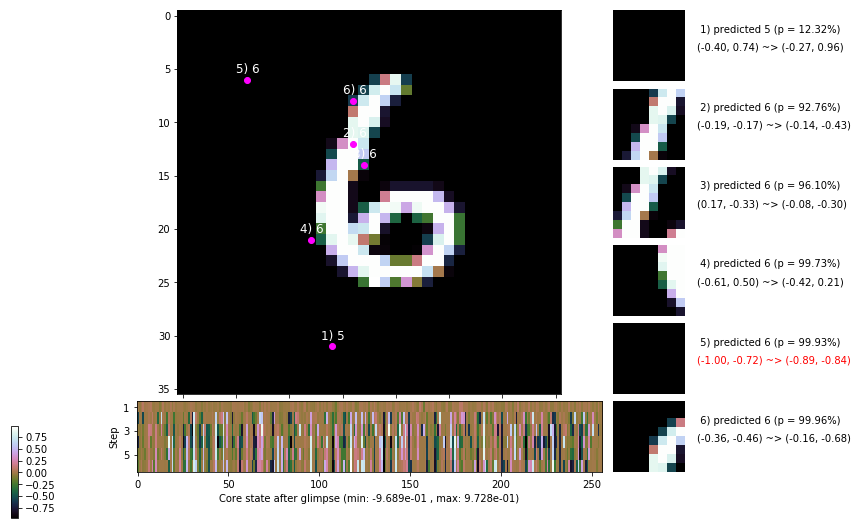

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 156.1 ms/b | lr: 8.05e-04 | grad 2norm:  9.38 | grad inf norm:  2.301
         Weights || abs max:  1.67 ( 9950.63) | mean: -3.46e-05 ( 0.03) | var: 4.32e-02 (13015.18)
          Biases || abs max:  1.07 (  534.09) | mean: -1.03e-01 ( 0.30) | var: 5.04e-02 ( 5145.93)
                    class loss: 0.382 | steps: 2.401 | reward:  4.261 | acc.: 87.27%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 153.5 ms/b | lr: 8.04e-04 | grad 2norm:  8.92 | grad inf norm:  2.226
         Weights || abs max:  1.68 ( 7182.89) | mean: -2.80e-05 ( 0.02) | var: 4.34e-02 (13798.91)
          Biases || abs max:  1.08 (  214.06) | mean: -1.03e-01 ( 0.18) | var: 5.06e-02 (  250.29)
                    class loss: 0.371 | steps: 2.344 | reward:  4.337 | acc.: 87.72%

	Target class: 7 | Discounted rewards: [0.000, 0.001, 0.0

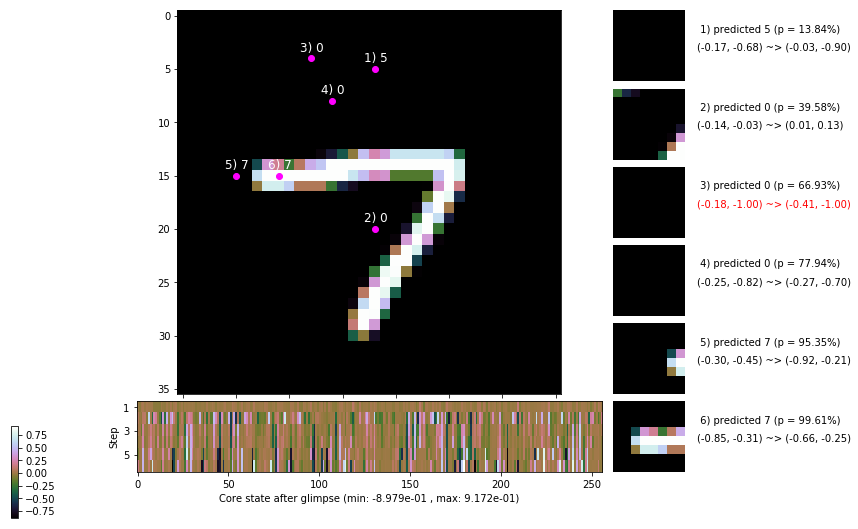

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.8 ms/b | lr: 8.02e-04 | grad 2norm:  9.14 | grad inf norm:  2.196
         Weights || abs max:  1.70 (13234.87) | mean: -4.01e-05 ( 0.04) | var: 4.35e-02 (42403.39)
          Biases || abs max:  1.08 (  679.67) | mean: -1.03e-01 ( 0.56) | var: 5.09e-02 (75080.34)
                    class loss: 0.374 | steps: 2.384 | reward:  4.291 | acc.: 87.57%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 180.9 ms/b | lr: 8.02e-04 | grad 2norm:  9.10 | grad inf norm:  2.215
         Weights || abs max:  1.70 ( 2723.94) | mean:  2.67e-05 ( 0.02) | var: 4.37e-02 (  143.59)
          Biases || abs max:  1.09 (  104.14) | mean: -1.04e-01 ( 0.11) | var: 5.11e-02 (   87.41)
                    class loss: 0.385 | steps: 2.354 | reward:  4.294 | acc.: 87.53%

	Target class: 0 | Discounted rewards: [0.011, 0.111, 1.1

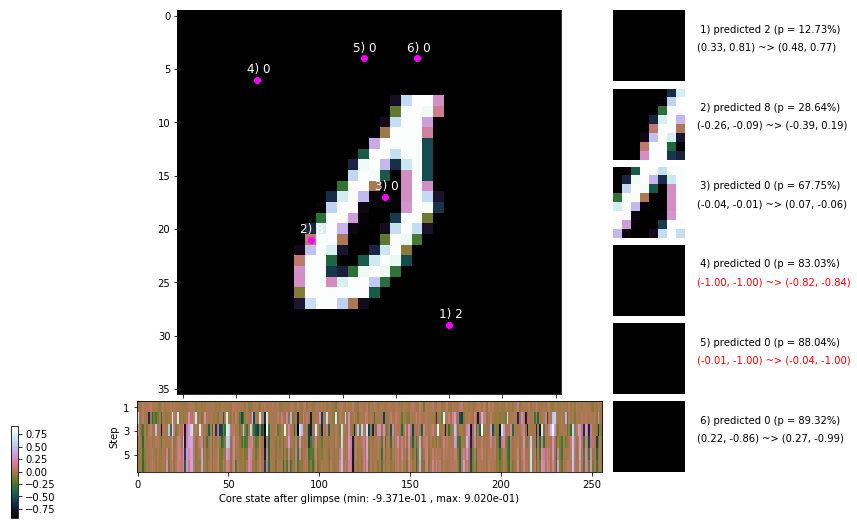

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 164.6 ms/b | lr: 8.00e-04 | grad 2norm:  8.87 | grad inf norm:  2.221
         Weights || abs max:  1.70 ( 6589.12) | mean:  2.16e-05 ( 0.02) | var: 4.38e-02 ( 4356.28)
          Biases || abs max:  1.09 (   78.72) | mean: -1.04e-01 ( 0.11) | var: 5.12e-02 (   13.26)
                    class loss: 0.358 | steps: 2.338 | reward:  4.331 | acc.: 88.35%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 154.4 ms/b | lr: 7.99e-04 | grad 2norm:  8.97 | grad inf norm:  2.236
         Weights || abs max:  1.71 ( 4228.62) | mean:  7.99e-06 ( 0.02) | var: 4.40e-02 (  824.04)
          Biases || abs max:  1.09 (   97.53) | mean: -1.05e-01 ( 0.11) | var: 5.15e-02 (   50.50)
                    class loss: 0.417 | steps: 2.414 | reward:  4.220 | acc.: 86.28%

	Target class: 2 | Discounted rewards: [1.111, 1.111, 1.1

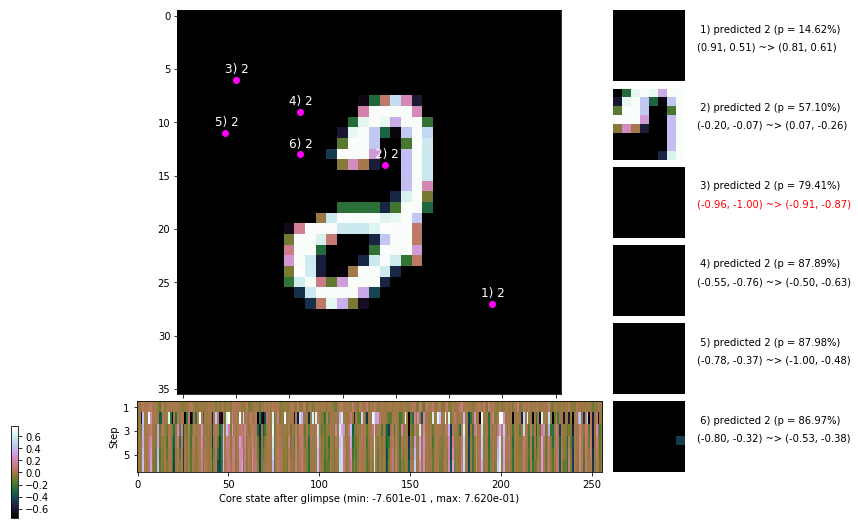

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


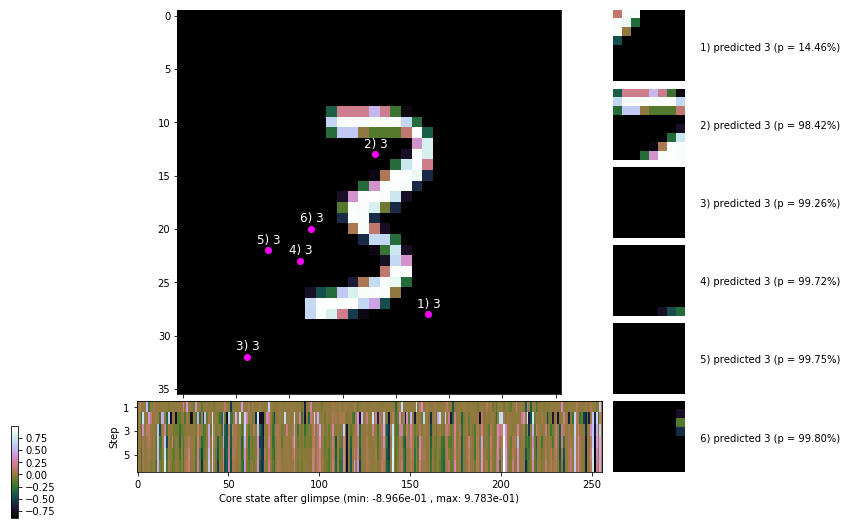


	Target class: 6 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


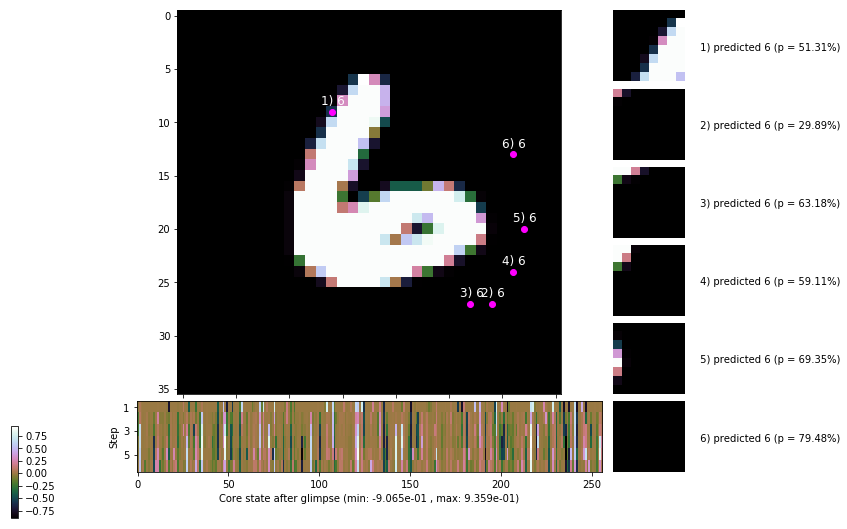

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


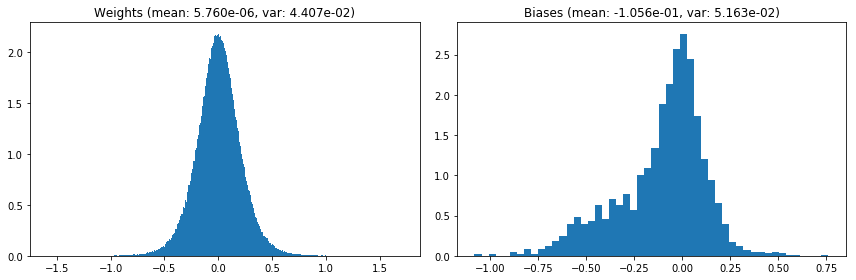

                                      Location network weights and biases


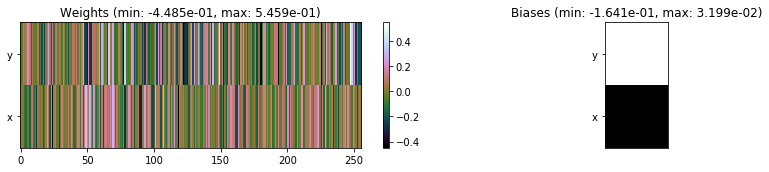

---------------------------------------------------------------------------------------------------------------
Elapsed time:  477.96 sec | TRAIN >> class loss: 0.3773 | steps:  2.374    | reward:  4.2900    | acc.: 87.568% 
                          | VAL   >> class loss: 0.3894 | steps:  2.288 :( | reward:  4.3946    | acc.: 87.260% 


Epoch  16/400) lr = 0.0007984
 b    300/  3000 >> 152.8 ms/b | lr: 7.98e-04 | grad 2norm:  8.82 | grad inf norm:  2.164
         Weights || abs max:  1.71 ( 3580.80) | mean: -2.08e-05 ( 0.02) | var: 4.42e-02 (  211.67)
          Biases || abs max:  1.07 (  131.84) | mean: -1.05e-01 ( 0.14) | var: 5.16e-02 (  283.52)
                    class loss: 0.373 | steps: 2.376 | reward:  4.298 | acc.: 87.88%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.0 ms/b | lr: 7.97e-04 | grad 2norm:  9.11 | grad inf norm:  2.255
         Weights || abs max:  1.73 ( 5508.41) | mean: -5.16e-05 ( 0.0

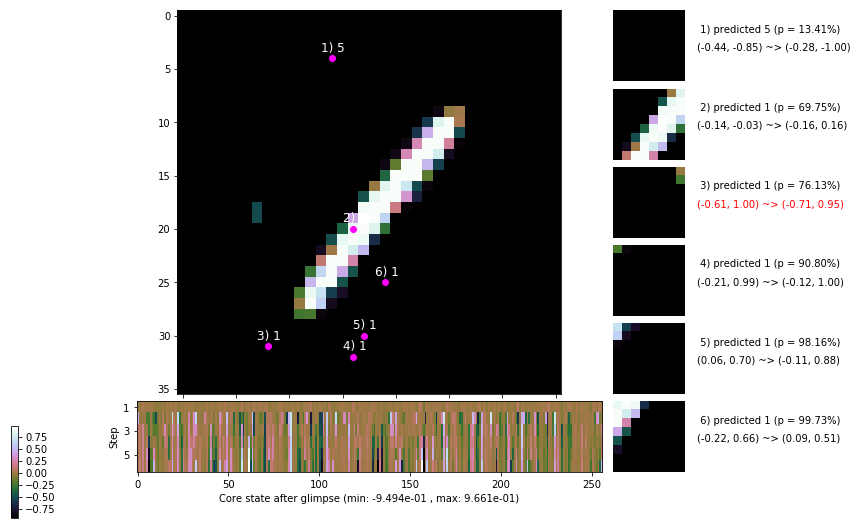

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 158.3 ms/b | lr: 7.95e-04 | grad 2norm:  9.23 | grad inf norm:  2.240
         Weights || abs max:  1.73 ( 7618.75) | mean: -2.88e-05 ( 0.03) | var: 4.45e-02 ( 4278.32)
          Biases || abs max:  1.08 (   93.39) | mean: -1.05e-01 ( 0.11) | var: 5.22e-02 (   29.23)
                    class loss: 0.395 | steps: 2.378 | reward:  4.282 | acc.: 86.93%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 152.2 ms/b | lr: 7.94e-04 | grad 2norm:  8.90 | grad inf norm:  2.176
         Weights || abs max:  1.73 ( 3408.37) | mean: -1.28e-05 ( 0.02) | var: 4.47e-02 (  200.29)
          Biases || abs max:  1.08 (   80.14) | mean: -1.06e-01 ( 0.11) | var: 5.27e-02 (   15.69)
                    class loss: 0.365 | steps: 2.348 | reward:  4.321 | acc.: 87.88%

	Target class: 4 | Discounted rewards: [0.111, 1.111, 1.1

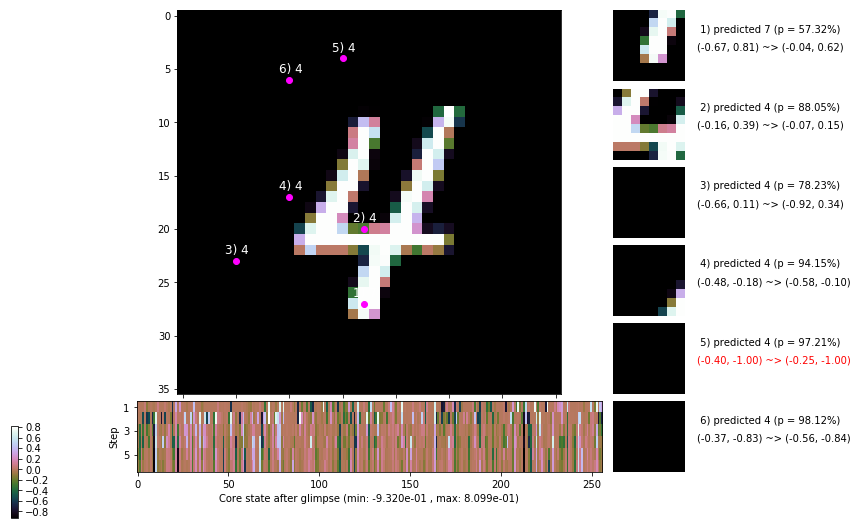

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 156.6 ms/b | lr: 7.93e-04 | grad 2norm:  8.78 | grad inf norm:  2.048
         Weights || abs max:  1.74 ( 2836.44) | mean: -5.69e-05 ( 0.02) | var: 4.48e-02 (   98.90)
          Biases || abs max:  1.10 (  119.30) | mean: -1.06e-01 ( 0.14) | var: 5.30e-02 (  116.60)
                    class loss: 0.366 | steps: 2.368 | reward:  4.310 | acc.: 87.67%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.9 ms/b | lr: 7.92e-04 | grad 2norm:  8.78 | grad inf norm:  2.164
         Weights || abs max:  1.76 ( 5629.65) | mean: -7.50e-05 ( 0.02) | var: 4.50e-02 (  727.64)
          Biases || abs max:  1.10 (  124.55) | mean: -1.06e-01 ( 0.14) | var: 5.34e-02 (  243.57)
                    class loss: 0.378 | steps: 2.327 | reward:  4.323 | acc.: 87.48%

	Target class: 8 | Discounted rewards: [0.011, 0.111, 1.1

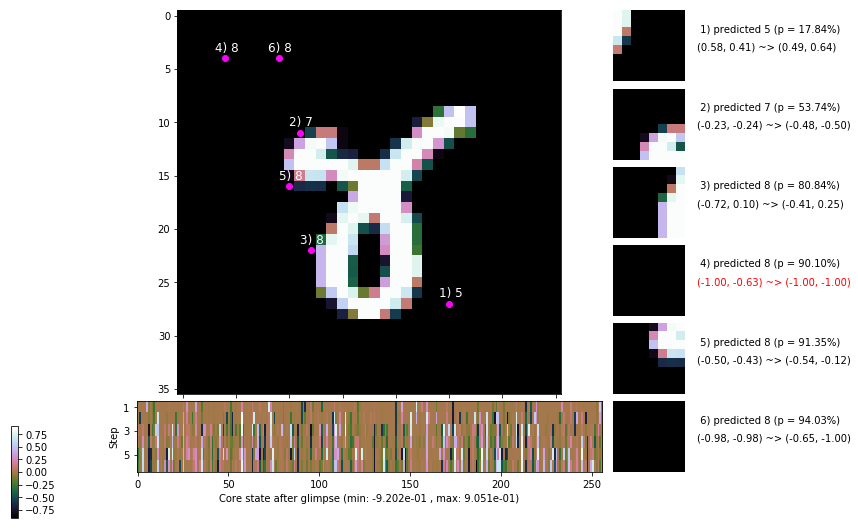

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.5 ms/b | lr: 7.90e-04 | grad 2norm:  8.73 | grad inf norm:  2.103
         Weights || abs max:  1.77 ( 4481.55) | mean: -7.09e-05 ( 0.02) | var: 4.51e-02 (  427.93)
          Biases || abs max:  1.09 (  114.19) | mean: -1.07e-01 ( 0.13) | var: 5.36e-02 (   50.74)
                    class loss: 0.353 | steps: 2.327 | reward:  4.359 | acc.: 88.70%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.7 ms/b | lr: 7.90e-04 | grad 2norm:  8.93 | grad inf norm:  2.194
         Weights || abs max:  1.77 ( 4506.46) | mean: -9.48e-05 ( 0.02) | var: 4.53e-02 ( 1618.22)
          Biases || abs max:  1.08 (  269.83) | mean: -1.07e-01 ( 0.19) | var: 5.38e-02 (  194.94)
                    class loss: 0.363 | steps: 2.376 | reward:  4.290 | acc.: 87.92%

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.1

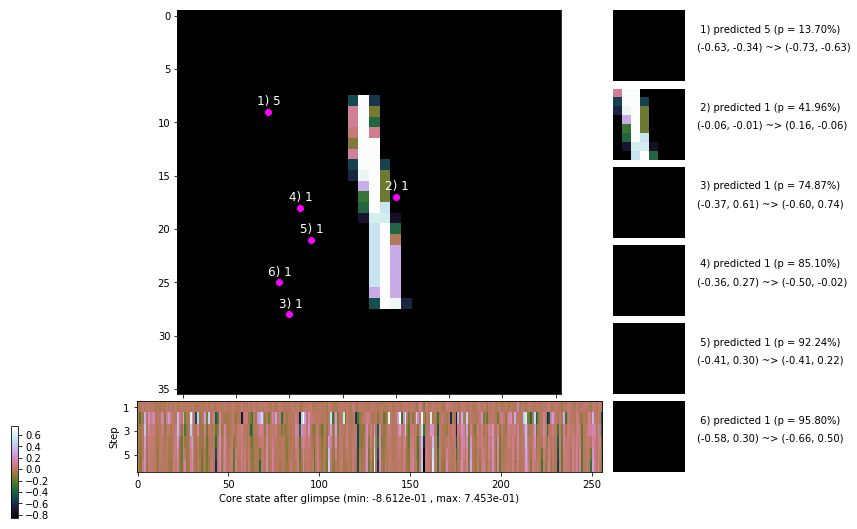

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.1 ms/b | lr: 7.88e-04 | grad 2norm:  8.78 | grad inf norm:  2.194
         Weights || abs max:  1.78 (12113.52) | mean: -8.48e-05 ( 0.03) | var: 4.54e-02 (17496.57)
          Biases || abs max:  1.09 (  147.40) | mean: -1.08e-01 ( 0.15) | var: 5.40e-02 (  136.91)
                    class loss: 0.339 | steps: 2.348 | reward:  4.350 | acc.: 88.62%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 164.5 ms/b | lr: 7.87e-04 | grad 2norm:  8.79 | grad inf norm:  2.088
         Weights || abs max:  1.78 ( 2531.65) | mean: -9.30e-05 ( 0.02) | var: 4.56e-02 (   84.81)
          Biases || abs max:  1.09 (  692.10) | mean: -1.08e-01 ( 0.35) | var: 5.40e-02 (11615.62)
                    class loss: 0.340 | steps: 2.282 | reward:  4.394 | acc.: 88.88%

	Target class: 5 | Discounted rewards: [0.111, 1.111, 1.1

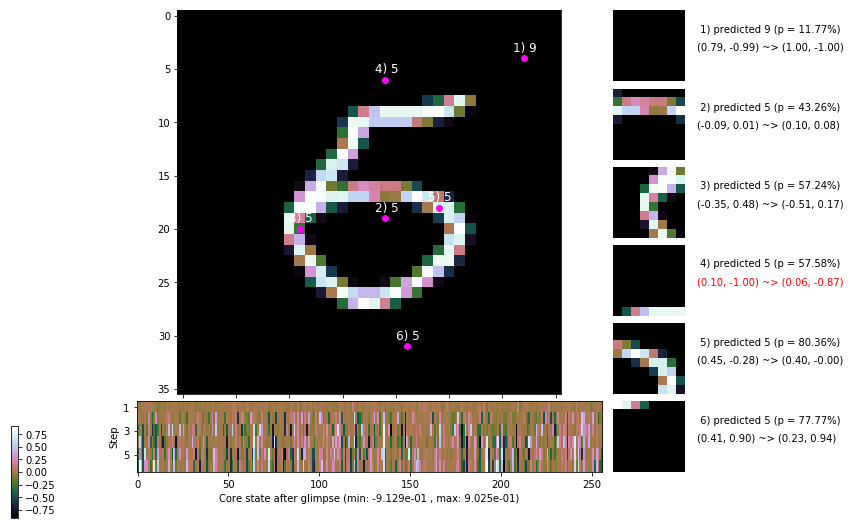

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


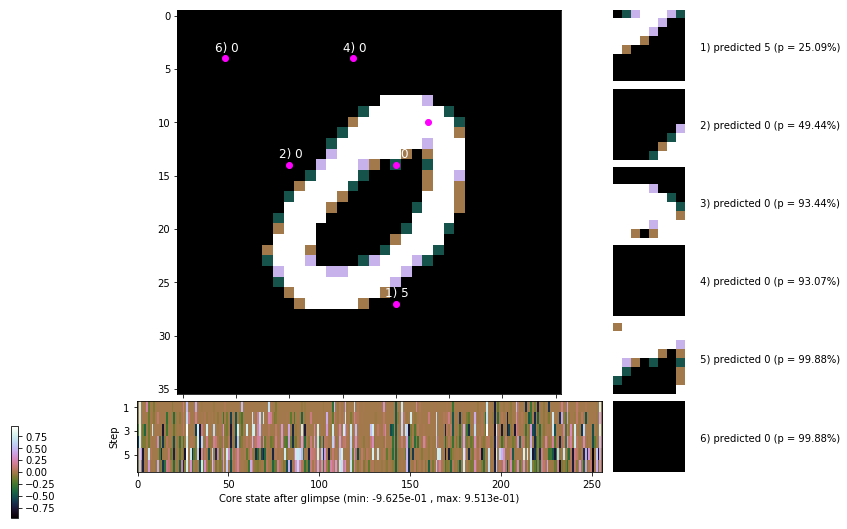


	Target class: 2 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


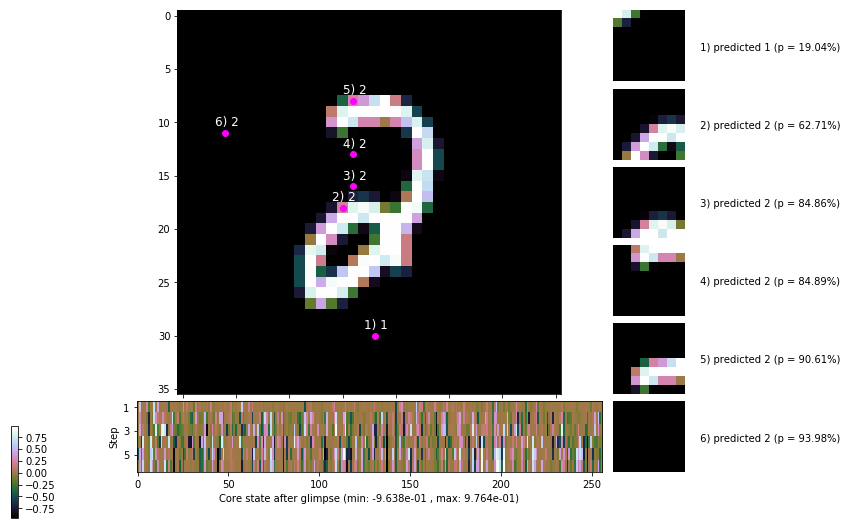

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


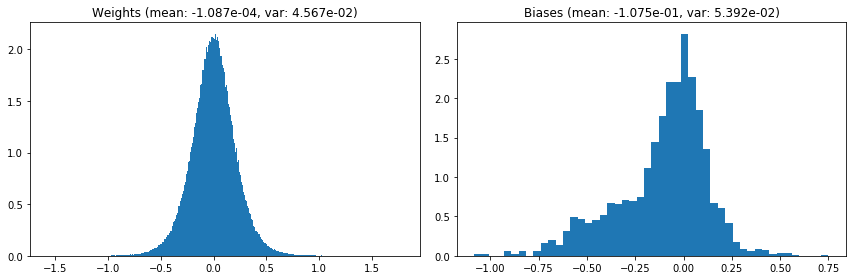

                                      Location network weights and biases


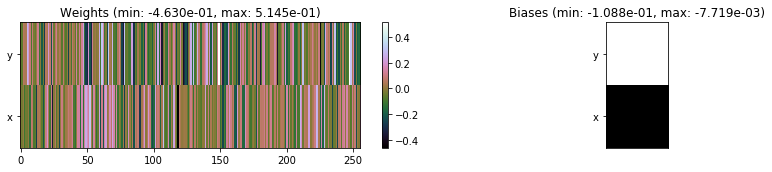

---------------------------------------------------------------------------------------------------------------
Elapsed time:  466.50 sec | TRAIN >> class loss: 0.3652 | steps:  2.353    | reward:  4.3185    | acc.: 87.873% 
                          | VAL   >> class loss: 0.3613 | steps:  2.220    | reward:  4.4454    | acc.: 87.960% 


Epoch  17/400) lr = 0.0007865
 b    300/  3000 >> 162.9 ms/b | lr: 7.86e-04 | grad 2norm:  8.90 | grad inf norm:  2.224
         Weights || abs max:  1.79 ( 3262.84) | mean: -1.07e-04 ( 0.02) | var: 4.58e-02 (  149.46)
          Biases || abs max:  1.07 (  168.88) | mean: -1.08e-01 ( 0.15) | var: 5.41e-02 (  103.52)
                    class loss: 0.377 | steps: 2.359 | reward:  4.303 | acc.: 87.63%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 154.9 ms/b | lr: 7.85e-04 | grad 2norm:  8.47 | grad inf norm:  2.202
         Weights || abs max:  1.80 ( 3146.15) | mean: -1.05e-04 ( 0.0

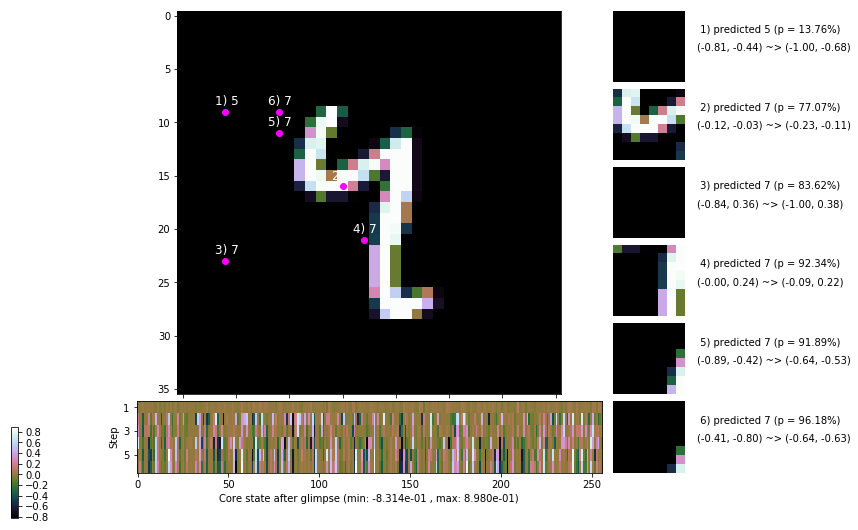

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 154.9 ms/b | lr: 7.83e-04 | grad 2norm:  8.88 | grad inf norm:  2.198
         Weights || abs max:  1.79 ( 4426.78) | mean: -7.45e-05 ( 0.02) | var: 4.61e-02 (  986.55)
          Biases || abs max:  1.09 (  565.62) | mean: -1.07e-01 ( 0.30) | var: 5.45e-02 (11414.29)
                    class loss: 0.382 | steps: 2.364 | reward:  4.287 | acc.: 86.90%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 153.8 ms/b | lr: 7.83e-04 | grad 2norm:  8.75 | grad inf norm:  2.274
         Weights || abs max:  1.78 ( 5126.46) | mean: -4.63e-05 ( 0.02) | var: 4.62e-02 (  811.16)
          Biases || abs max:  1.08 (   93.51) | mean: -1.08e-01 ( 0.11) | var: 5.48e-02 (   28.41)
                    class loss: 0.382 | steps: 2.365 | reward:  4.309 | acc.: 87.47%

	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.1

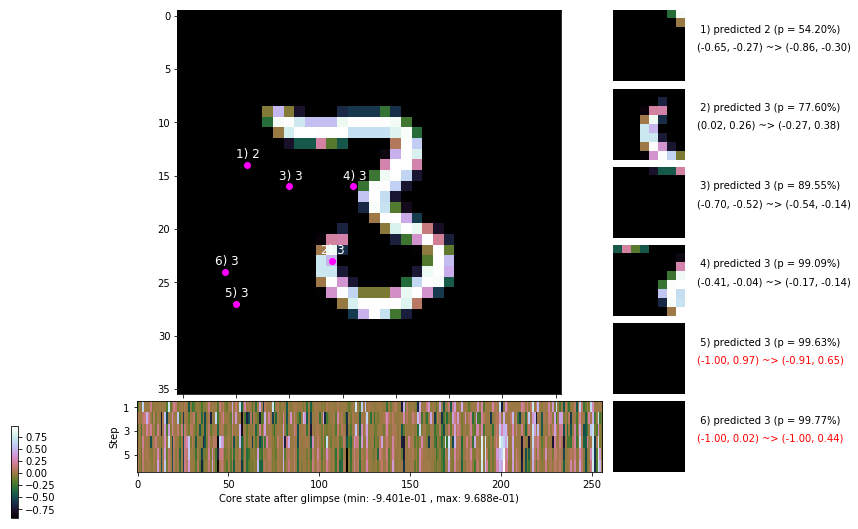

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.8 ms/b | lr: 7.81e-04 | grad 2norm:  9.17 | grad inf norm:  2.282
         Weights || abs max:  1.79 (37199.21) | mean: -3.88e-05 ( 0.08) | var: 4.64e-02 (626307.38)
          Biases || abs max:  1.07 (  413.46) | mean: -1.08e-01 ( 0.36) | var: 5.49e-02 (14138.77)
                    class loss: 0.387 | steps: 2.365 | reward:  4.306 | acc.: 87.12%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.5 ms/b | lr: 7.80e-04 | grad 2norm:  8.97 | grad inf norm:  2.307
         Weights || abs max:  1.78 (11959.10) | mean: -1.94e-05 ( 0.03) | var: 4.65e-02 (13081.51)
          Biases || abs max:  1.07 (  205.73) | mean: -1.09e-01 ( 0.16) | var: 5.51e-02 (  441.22)
                    class loss: 0.389 | steps: 2.362 | reward:  4.297 | acc.: 87.12%

	Target class: 5 | Discounted rewards: [0.111, 1.111, 1.

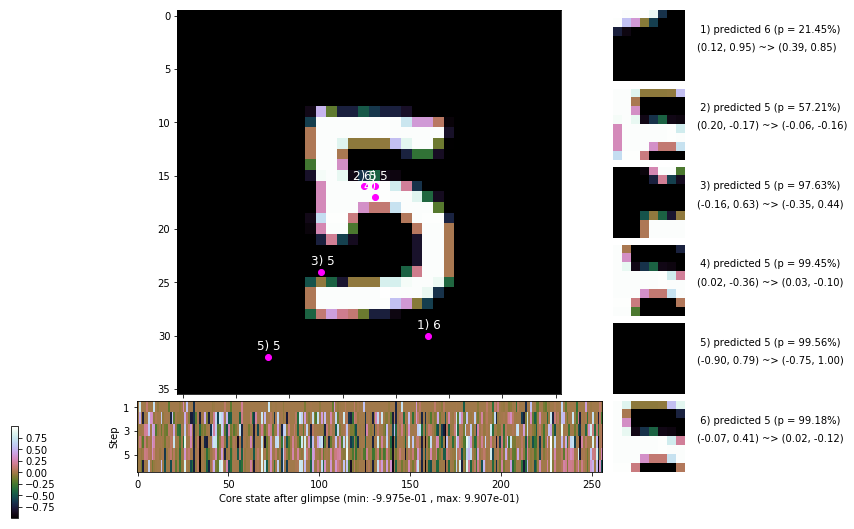

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.1 ms/b | lr: 7.79e-04 | grad 2norm:  9.11 | grad inf norm:  2.251
         Weights || abs max:  1.77 ( 2999.21) | mean: -5.21e-06 ( 0.02) | var: 4.67e-02 (  232.35)
          Biases || abs max:  1.08 (  340.50) | mean: -1.08e-01 ( 0.28) | var: 5.53e-02 ( 4944.00)
                    class loss: 0.377 | steps: 2.359 | reward:  4.300 | acc.: 87.32%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.8 ms/b | lr: 7.78e-04 | grad 2norm:  8.94 | grad inf norm:  2.168
         Weights || abs max:  1.77 ( 3107.29) | mean: -4.77e-05 ( 0.02) | var: 4.68e-02 (  139.19)
          Biases || abs max:  1.08 (  127.71) | mean: -1.09e-01 ( 0.13) | var: 5.57e-02 (  204.26)
                    class loss: 0.385 | steps: 2.343 | reward:  4.326 | acc.: 87.72%

	Target class: 4 | Discounted rewards: [0.100, 1.001, 0.0

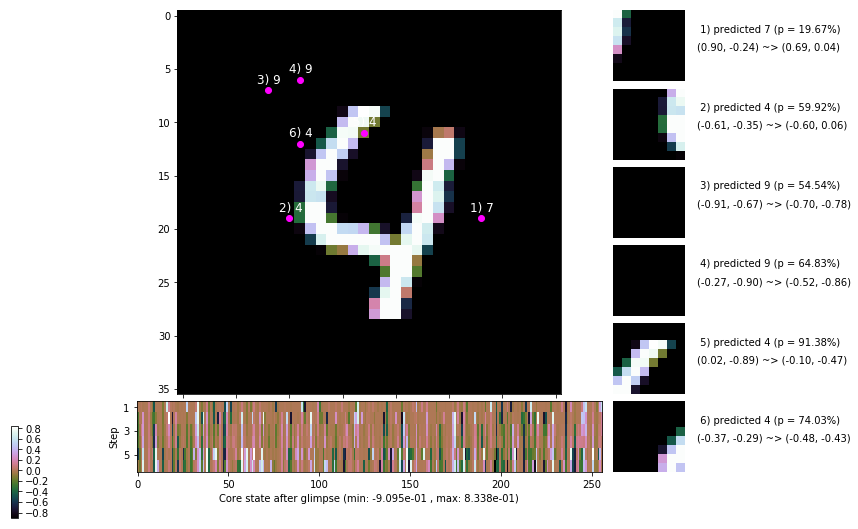

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.6 ms/b | lr: 7.76e-04 | grad 2norm:  8.63 | grad inf norm:  2.141
         Weights || abs max:  1.76 ( 3257.24) | mean: -5.85e-05 ( 0.02) | var: 4.69e-02 (  289.31)
          Biases || abs max:  1.06 (  134.76) | mean: -1.09e-01 ( 0.11) | var: 5.57e-02 (  303.85)
                    class loss: 0.350 | steps: 2.297 | reward:  4.376 | acc.: 88.83%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 151.0 ms/b | lr: 7.76e-04 | grad 2norm:  9.13 | grad inf norm:  2.336
         Weights || abs max:  1.75 (21238.12) | mean: -9.05e-05 ( 0.05) | var: 4.71e-02 (167450.31)
          Biases || abs max:  1.06 (  180.92) | mean: -1.09e-01 ( 0.16) | var: 5.58e-02 (  755.95)
                    class loss: 0.344 | steps: 2.315 | reward:  4.375 | acc.: 88.58%

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.

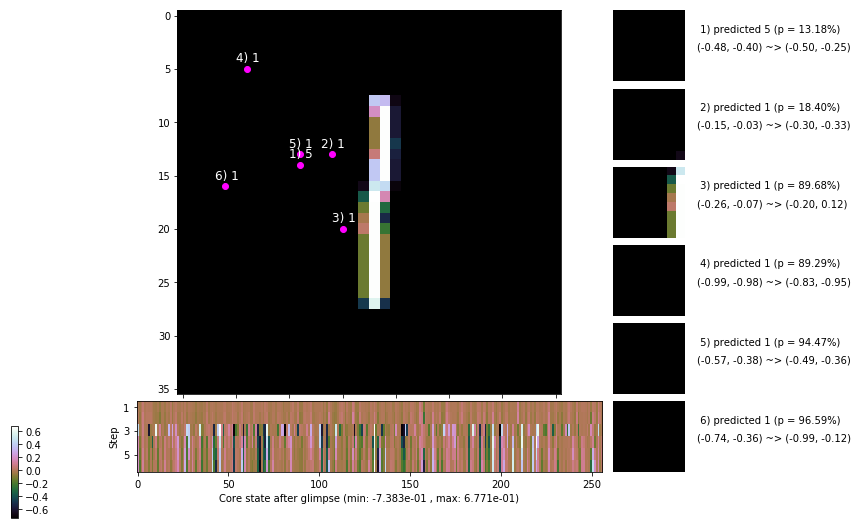

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


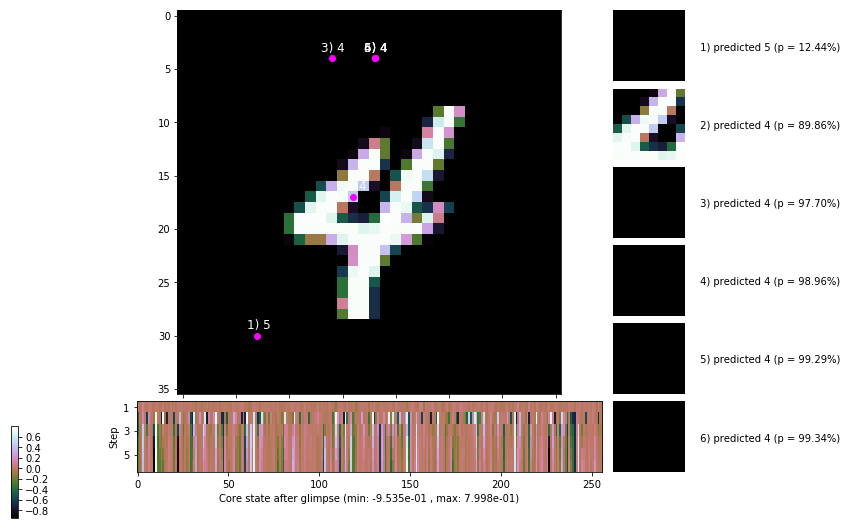


	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


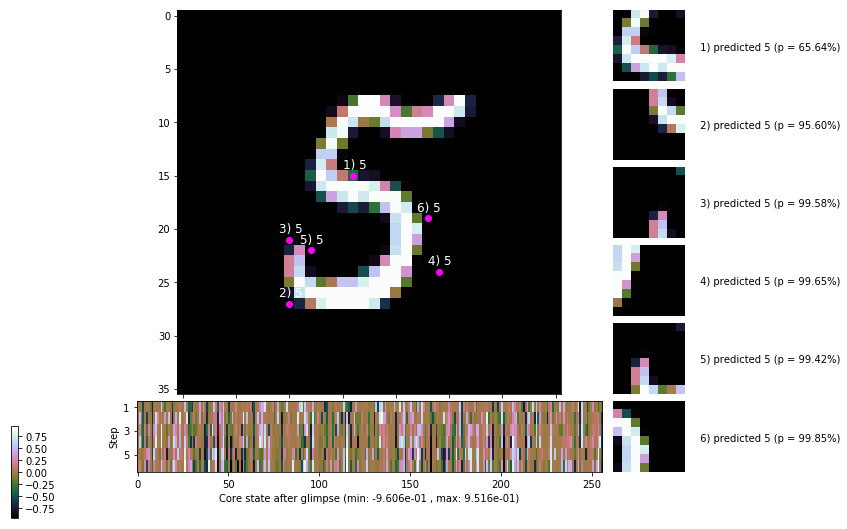

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


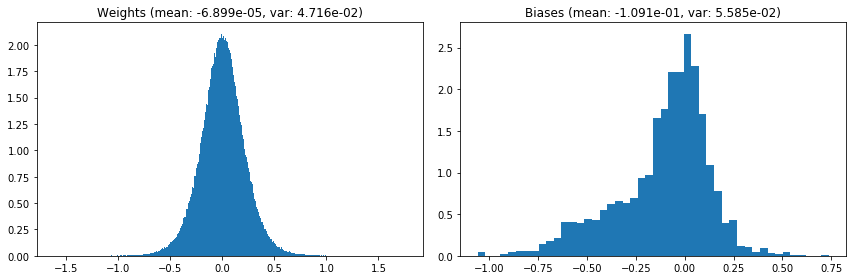

                                      Location network weights and biases


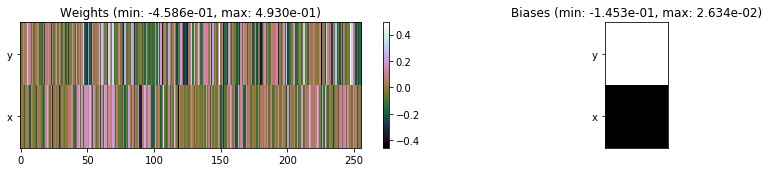

---------------------------------------------------------------------------------------------------------------
Elapsed time:  464.90 sec | TRAIN >> class loss: 0.3709 | steps:  2.345    | reward:  4.3230    | acc.: 87.683% :(
                          | VAL   >> class loss: 0.3495 | steps:  2.219    | reward:  4.4658    | acc.: 88.220% 


Epoch  18/400) lr = 0.0007748
 b    300/  3000 >> 152.7 ms/b | lr: 7.74e-04 | grad 2norm:  8.90 | grad inf norm:  2.245
         Weights || abs max:  1.75 ( 5958.24) | mean: -7.29e-05 ( 0.02) | var: 4.72e-02 ( 1753.81)
          Biases || abs max:  1.06 (  134.83) | mean: -1.09e-01 ( 0.15) | var: 5.60e-02 (  472.06)
                    class loss: 0.368 | steps: 2.364 | reward:  4.301 | acc.: 87.45%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.0 ms/b | lr: 7.73e-04 | grad 2norm:  9.13 | grad inf norm:  2.207
         Weights || abs max:  1.76 ( 4313.12) | mean: -7.54e-05 ( 0

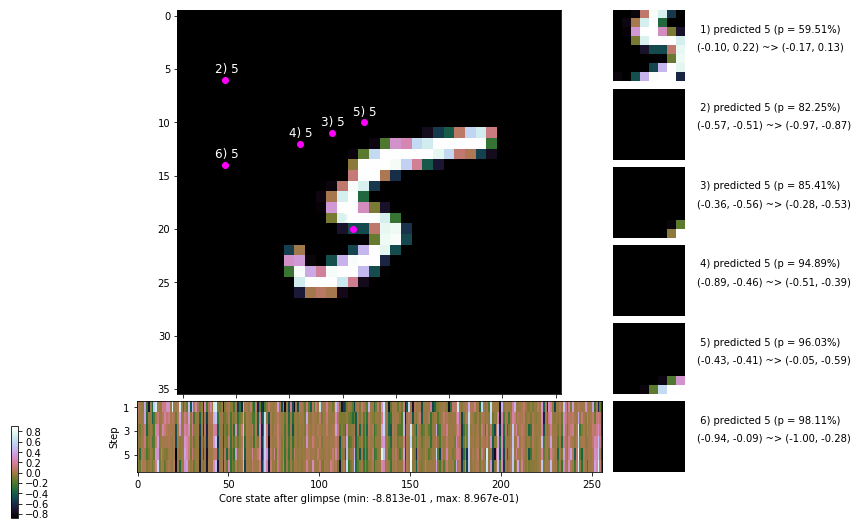

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 181.3 ms/b | lr: 7.72e-04 | grad 2norm:  8.67 | grad inf norm:  2.139
         Weights || abs max:  1.76 ( 3075.57) | mean: -5.84e-05 ( 0.02) | var: 4.75e-02 (  249.13)
          Biases || abs max:  1.10 (  213.30) | mean: -1.10e-01 ( 0.18) | var: 5.66e-02 (  188.85)
                    class loss: 0.349 | steps: 2.318 | reward:  4.376 | acc.: 88.33%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 153.1 ms/b | lr: 7.71e-04 | grad 2norm:  8.90 | grad inf norm:  2.219
         Weights || abs max:  1.77 ( 4647.68) | mean: -6.97e-05 ( 0.02) | var: 4.77e-02 ( 1091.27)
          Biases || abs max:  1.09 (  309.42) | mean: -1.10e-01 ( 0.23) | var: 5.67e-02 ( 2558.14)
                    class loss: 0.349 | steps: 2.320 | reward:  4.355 | acc.: 88.25%

	Target class: 0 | Discounted rewards: [1.011, 0.111, 1.1

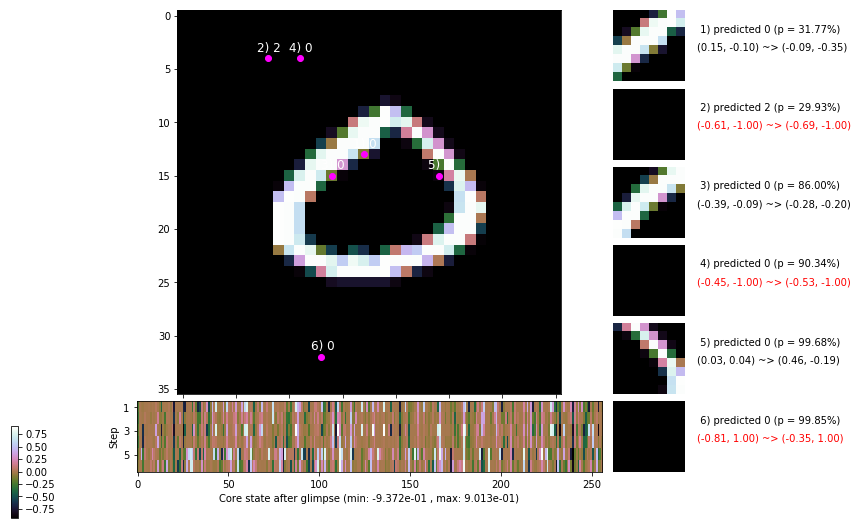

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 153.7 ms/b | lr: 7.69e-04 | grad 2norm:  8.70 | grad inf norm:  2.155
         Weights || abs max:  1.79 ( 4635.07) | mean: -1.13e-04 ( 0.02) | var: 4.78e-02 ( 1600.91)
          Biases || abs max:  1.09 (  170.69) | mean: -1.11e-01 ( 0.16) | var: 5.68e-02 (  202.75)
                    class loss: 0.348 | steps: 2.349 | reward:  4.346 | acc.: 88.97%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 153.4 ms/b | lr: 7.69e-04 | grad 2norm:  8.91 | grad inf norm:  2.256
         Weights || abs max:  1.81 ( 6468.89) | mean: -1.44e-04 ( 0.02) | var: 4.80e-02 ( 3709.85)
          Biases || abs max:  1.12 (  154.32) | mean: -1.11e-01 ( 0.16) | var: 5.72e-02 (   68.05)
                    class loss: 0.378 | steps: 2.357 | reward:  4.298 | acc.: 86.98%

	Target class: 6 | Discounted rewards: [1.111, 1.111, 1.1

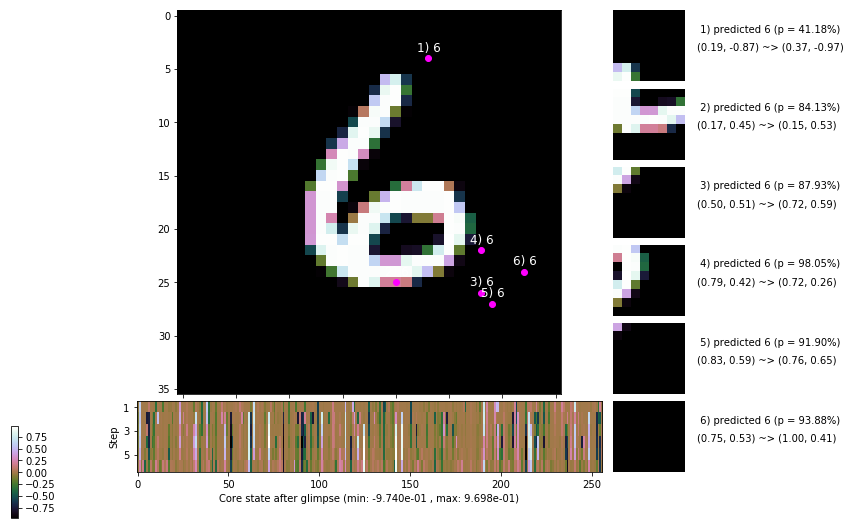

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 155.0 ms/b | lr: 7.67e-04 | grad 2norm:  8.77 | grad inf norm:  2.295
         Weights || abs max:  1.82 ( 6845.05) | mean: -1.56e-04 ( 0.02) | var: 4.81e-02 ( 5336.44)
          Biases || abs max:  1.11 (35764.30) | mean: -1.11e-01 (14.01) | var: 5.75e-02 (143613536.00)
                    class loss: 0.389 | steps: 2.353 | reward:  4.303 | acc.: 86.70%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.4 ms/b | lr: 7.66e-04 | grad 2norm:  8.88 | grad inf norm:  2.211
         Weights || abs max:  1.82 ( 5185.90) | mean: -1.35e-04 ( 0.02) | var: 4.83e-02 ( 1562.91)
          Biases || abs max:  1.10 ( 4970.69) | mean: -1.11e-01 ( 2.02) | var: 5.79e-02 (1268911.12)
                    class loss: 0.400 | steps: 2.393 | reward:  4.269 | acc.: 86.85%

	Target class: 4 | Discounted rewards: [0.111, 1.11

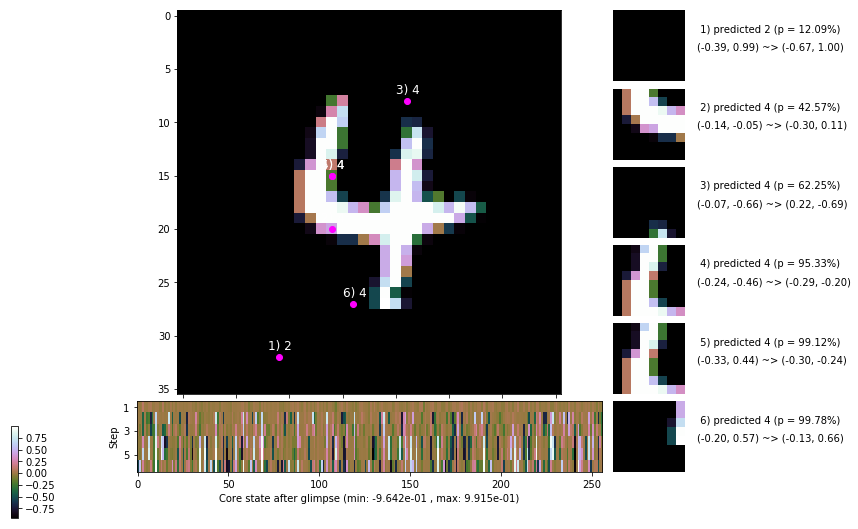

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 155.6 ms/b | lr: 7.65e-04 | grad 2norm:  8.86 | grad inf norm:  2.261
         Weights || abs max:  1.83 ( 4576.79) | mean: -1.17e-04 ( 0.02) | var: 4.84e-02 ( 1124.02)
          Biases || abs max:  1.10 ( 1251.74) | mean: -1.11e-01 ( 0.66) | var: 5.84e-02 (38875.47)
                    class loss: 0.390 | steps: 2.365 | reward:  4.285 | acc.: 87.02%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 152.8 ms/b | lr: 7.64e-04 | grad 2norm:  8.67 | grad inf norm:  2.185
         Weights || abs max:  1.83 ( 3656.63) | mean: -1.41e-04 ( 0.02) | var: 4.86e-02 (  441.30)
          Biases || abs max:  1.11 (  205.72) | mean: -1.11e-01 ( 0.18) | var: 5.85e-02 (  135.66)
                    class loss: 0.371 | steps: 2.323 | reward:  4.345 | acc.: 87.52%

	Target class: 0 | Discounted rewards: [0.111, 1.111, 1.1

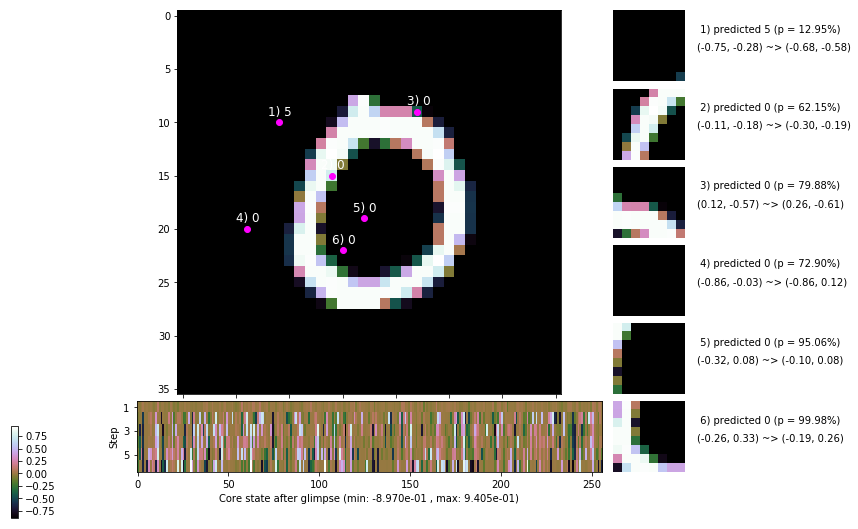

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


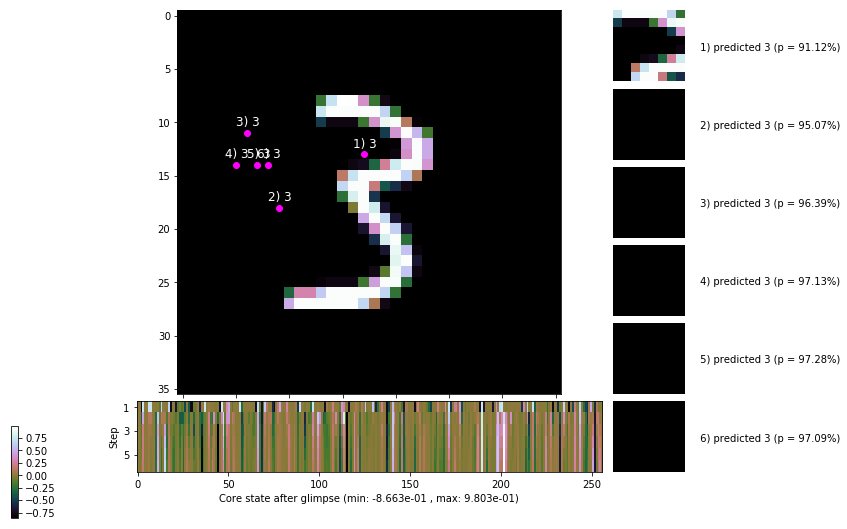


	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


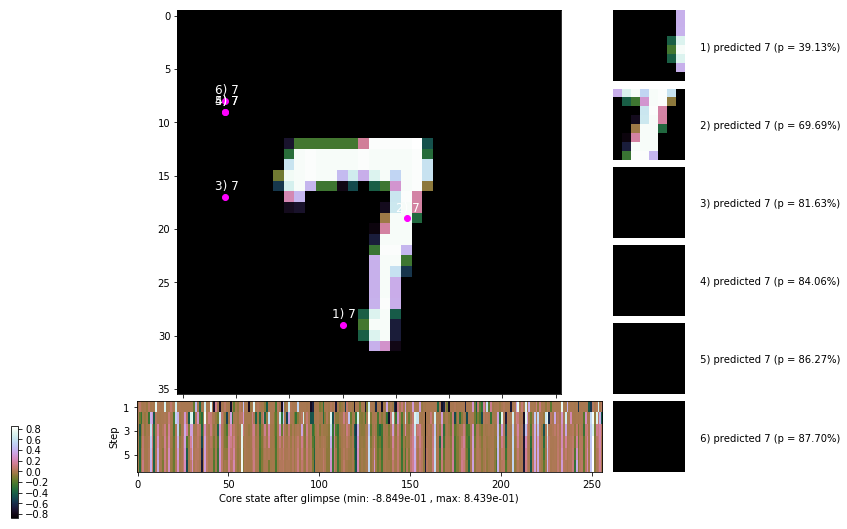

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


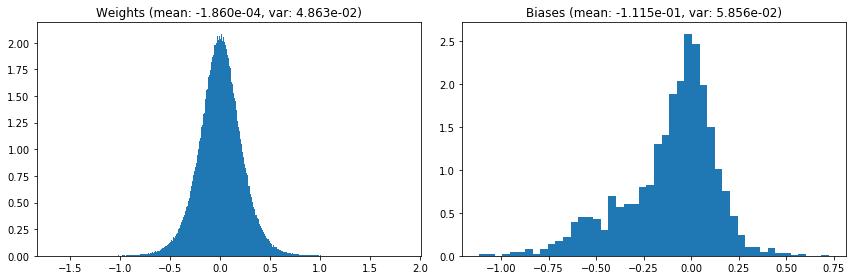

                                      Location network weights and biases


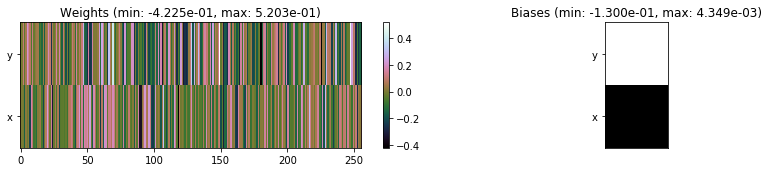

---------------------------------------------------------------------------------------------------------------
Elapsed time:  469.90 sec | TRAIN >> class loss: 0.3717 | steps:  2.350 :( | reward:  4.3182 :( | acc.: 87.548% :(
                          | VAL   >> class loss: 0.3759 | steps:  2.234 :( | reward:  4.4558 :( | acc.: 87.760% :(


Epoch  19/400) lr = 0.0007633
 b    300/  3000 >> 153.5 ms/b | lr: 7.63e-04 | grad 2norm:  8.89 | grad inf norm:  2.198
         Weights || abs max:  1.83 ( 3947.04) | mean: -1.69e-04 ( 0.02) | var: 4.87e-02 (  504.02)
          Biases || abs max:  1.11 (  264.23) | mean: -1.12e-01 ( 0.19) | var: 5.87e-02 (  991.27)
                    class loss: 0.374 | steps: 2.349 | reward:  4.314 | acc.: 87.30%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.0 ms/b | lr: 7.62e-04 | grad 2norm:  8.70 | grad inf norm:  2.275
         Weights || abs max:  1.82 ( 5648.39) | mean: -1.68e-04 (

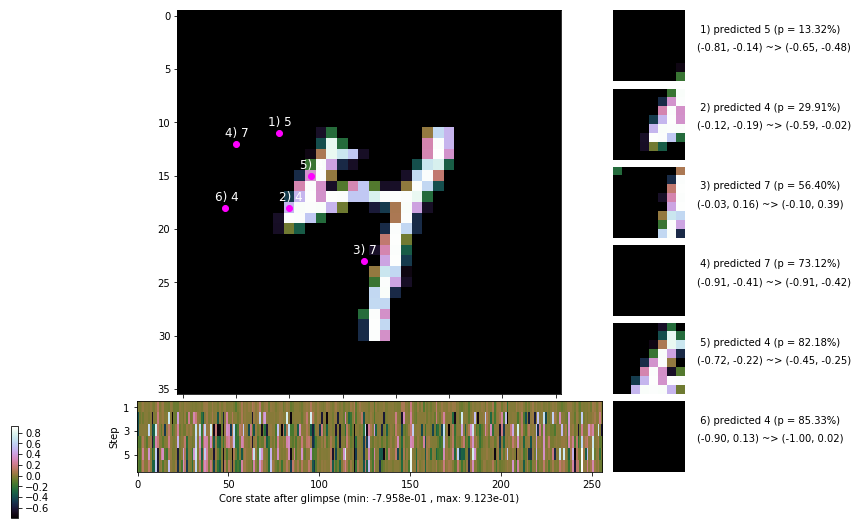

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 157.7 ms/b | lr: 7.60e-04 | grad 2norm:  8.63 | grad inf norm:  2.253
         Weights || abs max:  1.83 ( 3893.50) | mean: -1.68e-04 ( 0.02) | var: 4.90e-02 (  689.19)
          Biases || abs max:  1.10 (   84.90) | mean: -1.13e-01 ( 0.10) | var: 5.92e-02 (   39.80)
                    class loss: 0.374 | steps: 2.346 | reward:  4.322 | acc.: 87.65%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 152.8 ms/b | lr: 7.59e-04 | grad 2norm:  8.71 | grad inf norm:  2.224
         Weights || abs max:  1.83 ( 5628.44) | mean: -1.88e-04 ( 0.02) | var: 4.91e-02 ( 2080.13)
          Biases || abs max:  1.12 (  149.04) | mean: -1.13e-01 ( 0.14) | var: 5.92e-02 (  158.35)
                    class loss: 0.385 | steps: 2.354 | reward:  4.309 | acc.: 86.98%

	Target class: 2 | Discounted rewards: [0.111, 1.111, 1.1

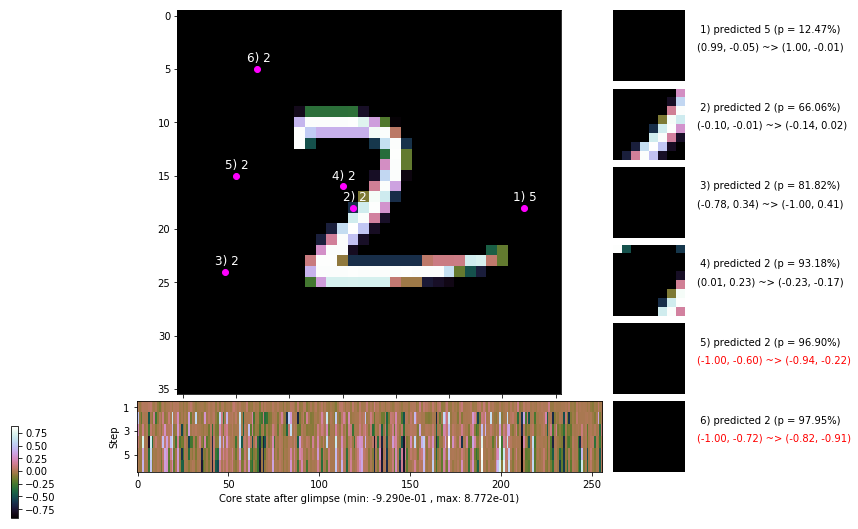

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 166.8 ms/b | lr: 7.58e-04 | grad 2norm:  8.56 | grad inf norm:  2.150
         Weights || abs max:  1.83 ( 3424.17) | mean: -1.91e-04 ( 0.02) | var: 4.93e-02 (  205.66)
          Biases || abs max:  1.10 (  417.21) | mean: -1.13e-01 ( 0.28) | var: 5.93e-02 ( 2178.36)
                    class loss: 0.387 | steps: 2.363 | reward:  4.306 | acc.: 87.48%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 169.1 ms/b | lr: 7.57e-04 | grad 2norm:  8.62 | grad inf norm:  2.121
         Weights || abs max:  1.83 ( 3542.17) | mean: -1.84e-04 ( 0.02) | var: 4.94e-02 (  260.32)
          Biases || abs max:  1.11 (  163.86) | mean: -1.14e-01 ( 0.15) | var: 5.94e-02 (  221.98)
                    class loss: 0.390 | steps: 2.376 | reward:  4.301 | acc.: 87.43%

	Target class: 8 | Discounted rewards: [0.000, 0.000, 0.0

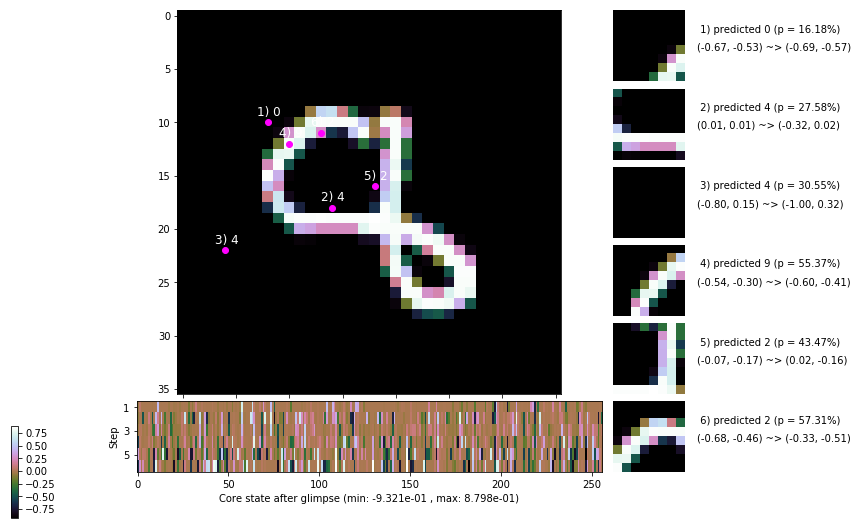

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 155.6 ms/b | lr: 7.56e-04 | grad 2norm:  8.70 | grad inf norm:  2.208
         Weights || abs max:  1.83 ( 6710.40) | mean: -1.88e-04 ( 0.02) | var: 4.95e-02 ( 4509.62)
          Biases || abs max:  1.11 (  309.45) | mean: -1.14e-01 ( 0.21) | var: 5.95e-02 ( 1085.94)
                    class loss: 0.379 | steps: 2.321 | reward:  4.343 | acc.: 87.63%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 152.7 ms/b | lr: 7.55e-04 | grad 2norm:  8.86 | grad inf norm:  2.247
         Weights || abs max:  1.82 (14856.30) | mean: -1.82e-04 ( 0.04) | var: 4.97e-02 (65546.64)
          Biases || abs max:  1.10 (  176.23) | mean: -1.14e-01 ( 0.18) | var: 5.98e-02 ( 1148.27)
                    class loss: 0.381 | steps: 2.348 | reward:  4.307 | acc.: 87.40%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.1

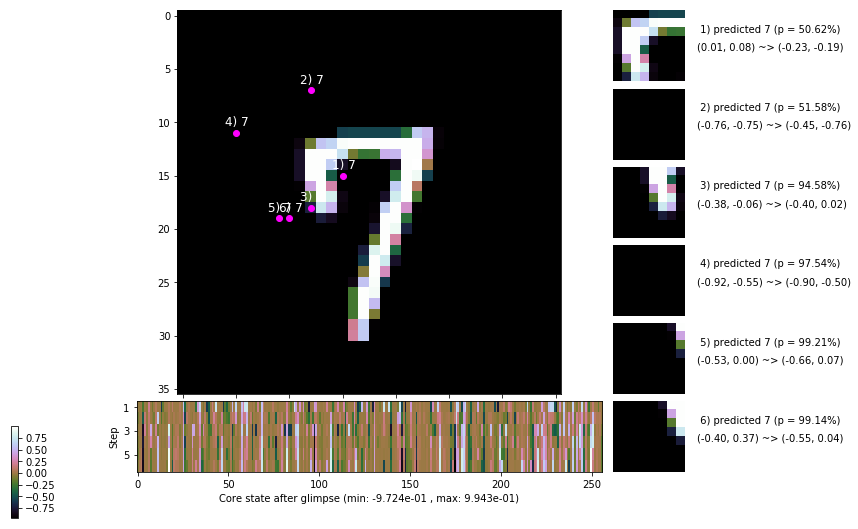

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 152.7 ms/b | lr: 7.53e-04 | grad 2norm:  8.86 | grad inf norm:  2.191
         Weights || abs max:  1.81 ( 4804.08) | mean: -1.77e-04 ( 0.02) | var: 4.98e-02 (  496.84)
          Biases || abs max:  1.10 (  146.53) | mean: -1.14e-01 ( 0.15) | var: 6.01e-02 (  150.96)
                    class loss: 0.374 | steps: 2.337 | reward:  4.332 | acc.: 87.68%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 155.2 ms/b | lr: 7.53e-04 | grad 2norm:  8.81 | grad inf norm:  2.228
         Weights || abs max:  1.80 ( 6020.52) | mean: -2.09e-04 ( 0.02) | var: 5.00e-02 ( 1280.35)
          Biases || abs max:  1.12 (  108.45) | mean: -1.15e-01 ( 0.12) | var: 6.03e-02 (   61.92)
                    class loss: 0.358 | steps: 2.309 | reward:  4.365 | acc.: 88.03%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.1

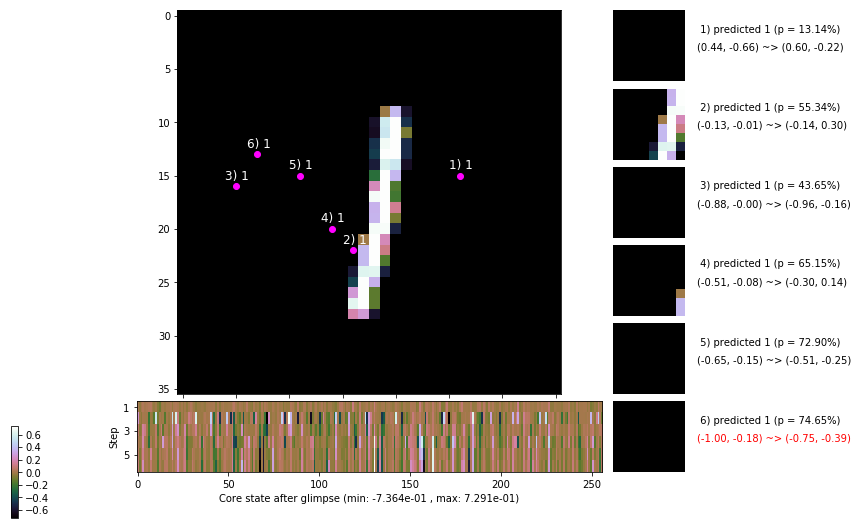

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


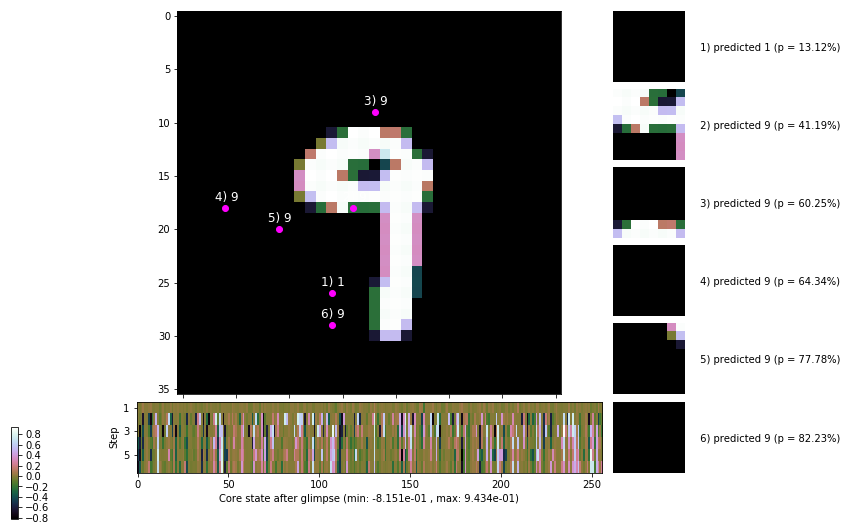


	Target class: 6 | Discounted rewards: [0.011, 0.111, 1.111, 1.110, 1.100, 1.000]


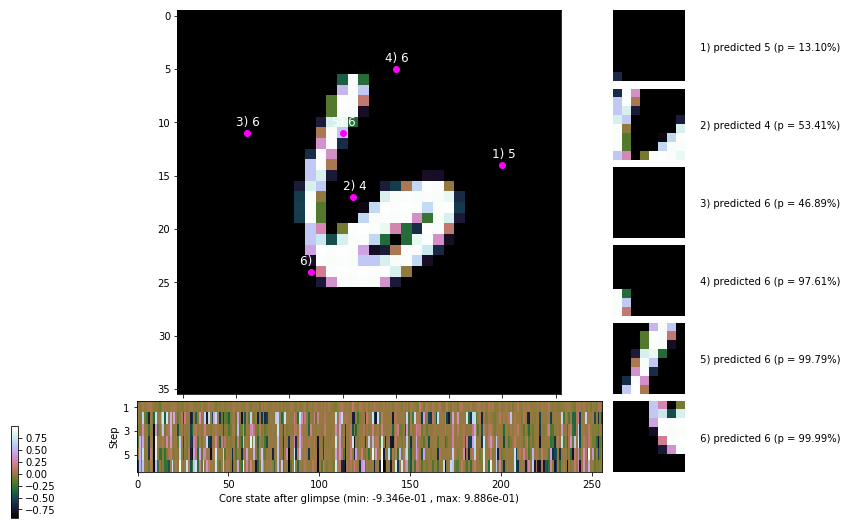

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


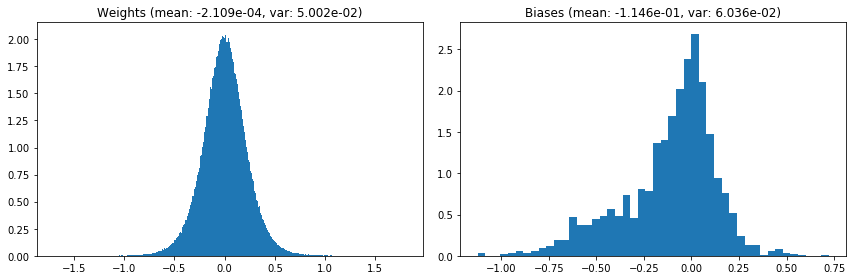

                                      Location network weights and biases


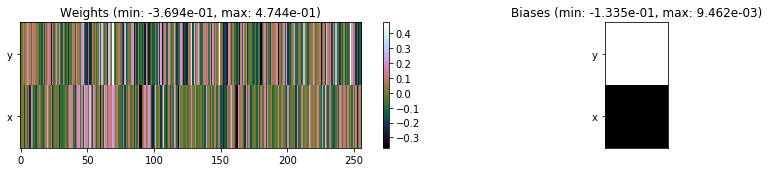

---------------------------------------------------------------------------------------------------------------
Elapsed time:  471.09 sec | TRAIN >> class loss: 0.3797 | steps:  2.347 :( | reward:  4.3204 :( | acc.: 87.447% :(
                          | VAL   >> class loss: 0.3603 | steps:  2.204    | reward:  4.4808    | acc.: 88.100% :(


Epoch  20/400) lr = 0.0007519
 b    300/  3000 >> 153.2 ms/b | lr: 7.51e-04 | grad 2norm:  8.66 | grad inf norm:  2.294
         Weights || abs max:  1.79 ( 2929.23) | mean: -2.16e-04 ( 0.02) | var: 5.01e-02 (  162.13)
          Biases || abs max:  1.13 (  804.63) | mean: -1.15e-01 ( 0.42) | var: 6.05e-02 (15843.37)
                    class loss: 0.368 | steps: 2.308 | reward:  4.372 | acc.: 87.68%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 151.8 ms/b | lr: 7.50e-04 | grad 2norm:  8.63 | grad inf norm:  2.236
         Weights || abs max:  1.79 ( 4446.04) | mean: -1.92e-04 (

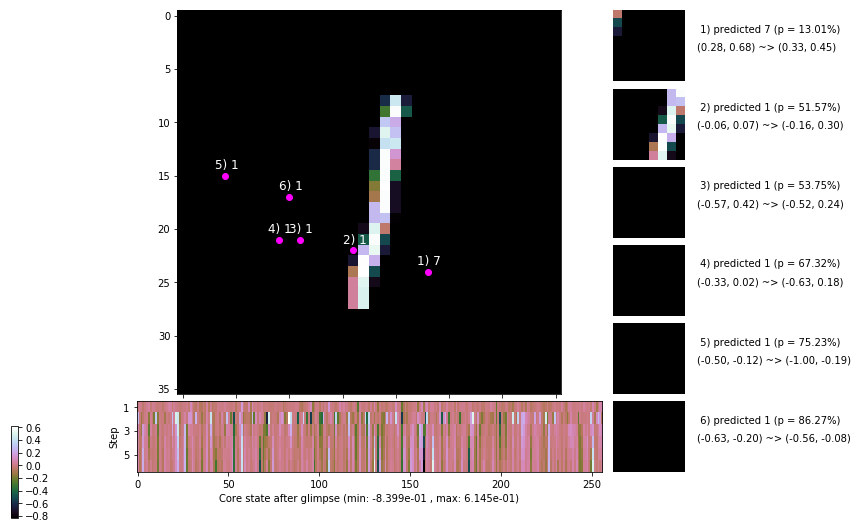

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 156.2 ms/b | lr: 7.49e-04 | grad 2norm:  8.53 | grad inf norm:  2.255
         Weights || abs max:  1.82 (22684.69) | mean: -2.15e-04 ( 0.05) | var: 5.04e-02 (138477.39)
          Biases || abs max:  1.11 (  148.69) | mean: -1.15e-01 ( 0.16) | var: 6.09e-02 (   86.49)
                    class loss: 0.376 | steps: 2.348 | reward:  4.324 | acc.: 87.47%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 153.7 ms/b | lr: 7.48e-04 | grad 2norm:  8.88 | grad inf norm:  2.230
         Weights || abs max:  1.82 ( 4125.96) | mean: -2.26e-04 ( 0.02) | var: 5.05e-02 (  769.47)
          Biases || abs max:  1.12 ( 2282.20) | mean: -1.16e-01 ( 1.12) | var: 6.12e-02 (256124.02)
                    class loss: 0.402 | steps: 2.384 | reward:  4.277 | acc.: 86.62%

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1

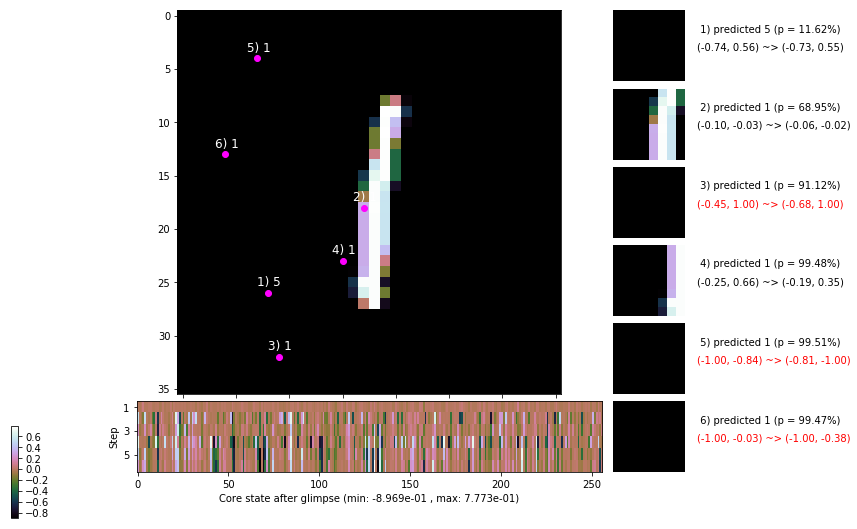

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 156.9 ms/b | lr: 7.47e-04 | grad 2norm:  8.62 | grad inf norm:  2.172
         Weights || abs max:  1.84 ( 3050.02) | mean: -2.63e-04 ( 0.02) | var: 5.06e-02 (  104.74)
          Biases || abs max:  1.12 (  346.74) | mean: -1.16e-01 ( 0.26) | var: 6.15e-02 ( 2876.28)
                    class loss: 0.373 | steps: 2.333 | reward:  4.332 | acc.: 87.13%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 153.9 ms/b | lr: 7.46e-04 | grad 2norm:  8.81 | grad inf norm:  2.172
         Weights || abs max:  1.85 ( 2554.22) | mean: -2.41e-04 ( 0.02) | var: 5.08e-02 (   90.84)
          Biases || abs max:  1.11 (  304.94) | mean: -1.15e-01 ( 0.25) | var: 6.13e-02 ( 1595.77)
                    class loss: 0.369 | steps: 2.331 | reward:  4.332 | acc.: 87.78%

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.1

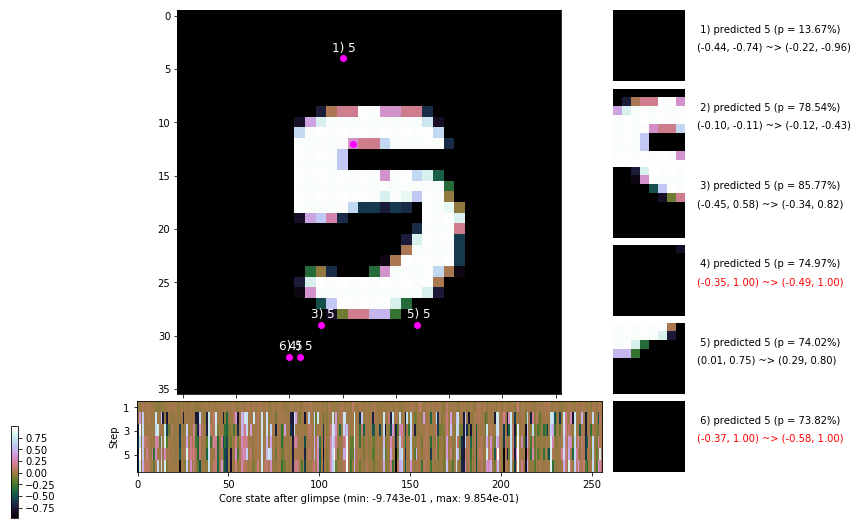

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.9 ms/b | lr: 7.44e-04 | grad 2norm:  8.88 | grad inf norm:  2.264
         Weights || abs max:  1.86 (14385.36) | mean: -1.99e-04 ( 0.04) | var: 5.09e-02 (22080.24)
          Biases || abs max:  1.11 (  104.52) | mean: -1.16e-01 ( 0.12) | var: 6.17e-02 (   45.88)
                    class loss: 0.385 | steps: 2.364 | reward:  4.313 | acc.: 87.60%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 174.4 ms/b | lr: 7.44e-04 | grad 2norm:  8.59 | grad inf norm:  2.168
         Weights || abs max:  1.85 (28485.87) | mean: -1.80e-04 ( 0.06) | var: 5.10e-02 (360533.22)
          Biases || abs max:  1.12 (  205.13) | mean: -1.17e-01 ( 0.19) | var: 6.20e-02 (  693.82)
                    class loss: 0.393 | steps: 2.363 | reward:  4.296 | acc.: 86.90%

	Target class: 4 | Discounted rewards: [0.111, 1.111, 1.

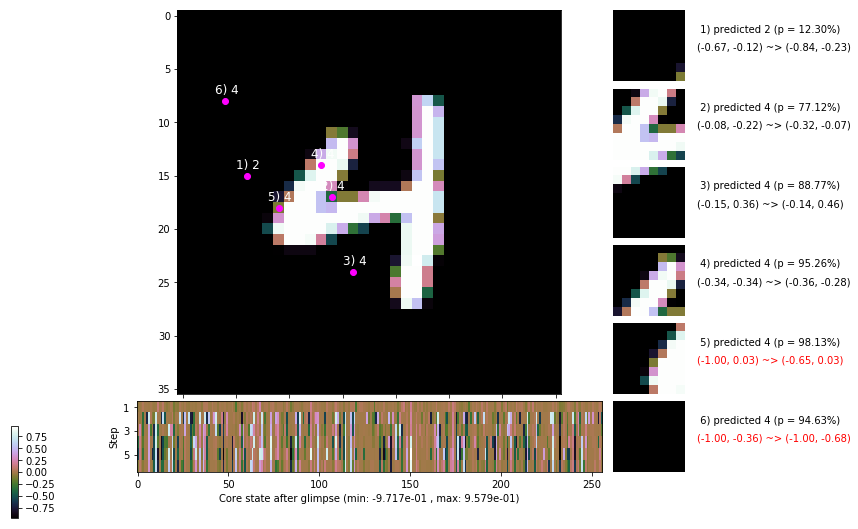

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 162.4 ms/b | lr: 7.42e-04 | grad 2norm:  8.59 | grad inf norm:  2.142
         Weights || abs max:  1.84 (14648.10) | mean: -2.10e-04 ( 0.04) | var: 5.11e-02 (28713.87)
          Biases || abs max:  1.14 (  625.26) | mean: -1.17e-01 ( 0.35) | var: 6.21e-02 (11407.18)
                    class loss: 0.363 | steps: 2.350 | reward:  4.331 | acc.: 87.73%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 154.5 ms/b | lr: 7.41e-04 | grad 2norm:  8.63 | grad inf norm:  2.272
         Weights || abs max:  1.84 ( 3432.22) | mean: -2.42e-04 ( 0.02) | var: 5.13e-02 (  407.31)
          Biases || abs max:  1.15 (  260.62) | mean: -1.17e-01 ( 0.20) | var: 6.24e-02 ( 2292.35)
                    class loss: 0.395 | steps: 2.373 | reward:  4.289 | acc.: 86.93%

	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.1

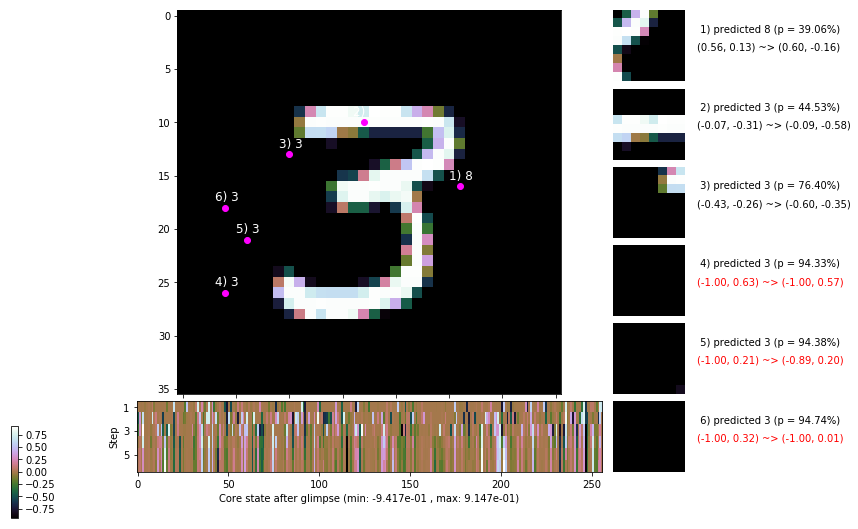

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [1.010, 0.100, 1.000, 0.000, 0.000, 0.000]


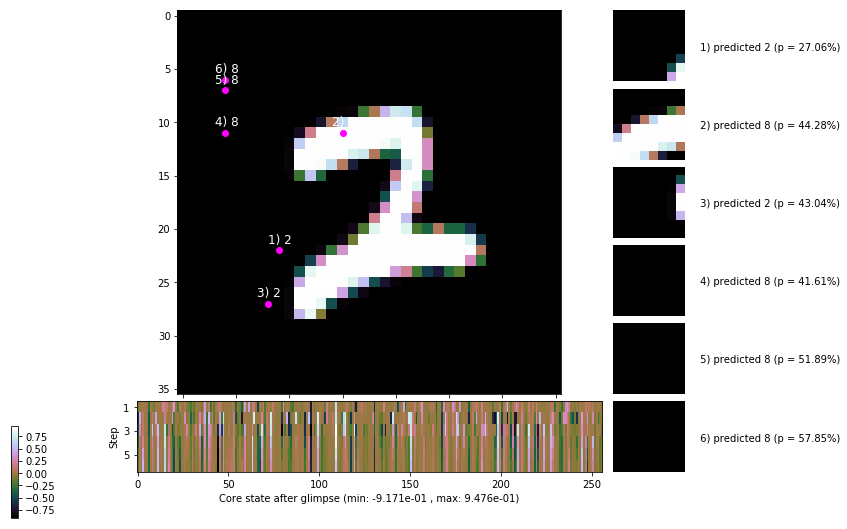


	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


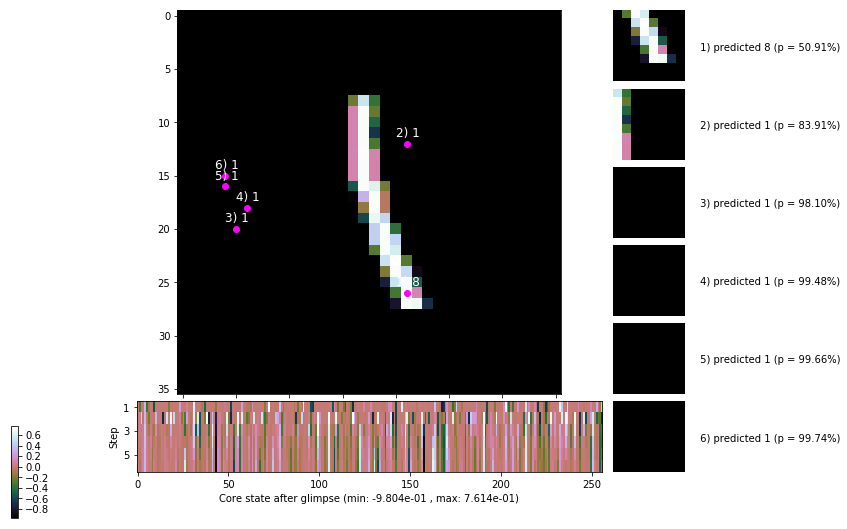

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


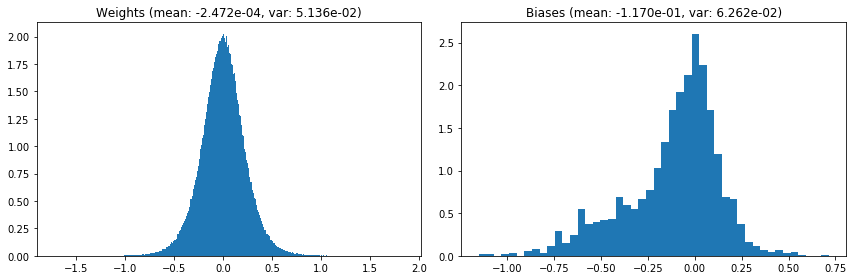

                                      Location network weights and biases


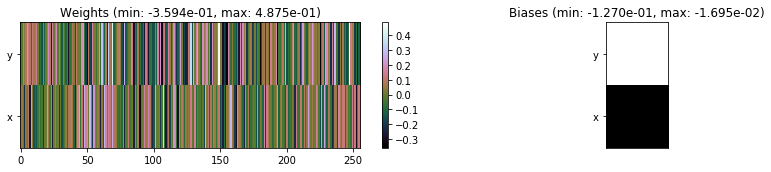

---------------------------------------------------------------------------------------------------------------
Elapsed time:  472.22 sec | TRAIN >> class loss: 0.3801 | steps:  2.348 :( | reward:  4.3212 :( | acc.: 87.342% :(
                          | VAL   >> class loss: 0.3832 | steps:  2.260 :( | reward:  4.4274 :( | acc.: 87.180% :(


Epoch  21/400) lr = 0.0007407
 b    300/  3000 >> 154.6 ms/b | lr: 7.40e-04 | grad 2norm:  8.69 | grad inf norm:  2.257
         Weights || abs max:  1.84 (11979.47) | mean: -2.25e-04 ( 0.03) | var: 5.14e-02 (30792.07)
          Biases || abs max:  1.16 (  169.60) | mean: -1.17e-01 ( 0.17) | var: 6.25e-02 (  406.35)
                    class loss: 0.376 | steps: 2.321 | reward:  4.351 | acc.: 87.52%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.4 ms/b | lr: 7.39e-04 | grad 2norm:  8.58 | grad inf norm:  2.210
         Weights || abs max:  1.84 ( 2235.63) | mean: -2.60e-04 (

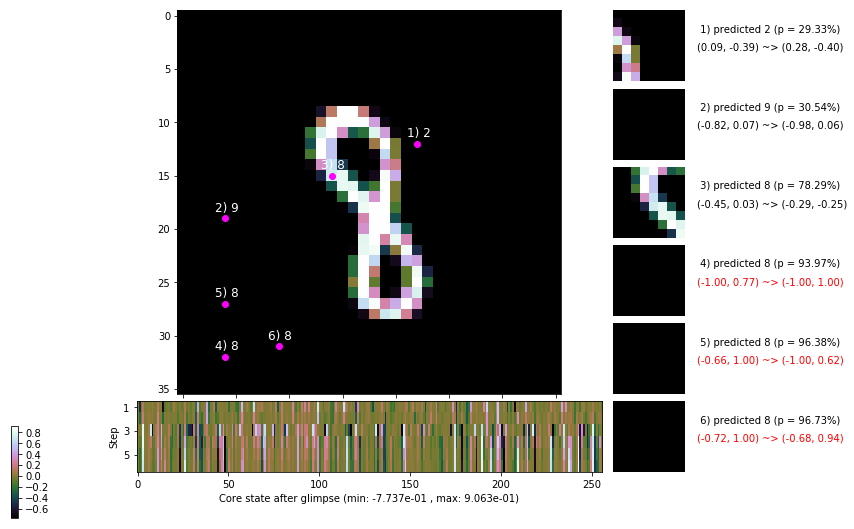

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 155.1 ms/b | lr: 7.38e-04 | grad 2norm:  8.61 | grad inf norm:  2.185
         Weights || abs max:  1.85 ( 4319.49) | mean: -3.11e-04 ( 0.02) | var: 5.17e-02 (  329.58)
          Biases || abs max:  1.15 (  150.46) | mean: -1.18e-01 ( 0.15) | var: 6.28e-02 (  181.41)
                    class loss: 0.358 | steps: 2.341 | reward:  4.348 | acc.: 88.12%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 151.9 ms/b | lr: 7.37e-04 | grad 2norm:  8.83 | grad inf norm:  2.329
         Weights || abs max:  1.84 ( 7682.97) | mean: -3.66e-04 ( 0.03) | var: 5.19e-02 ( 6453.02)
          Biases || abs max:  1.14 (  275.96) | mean: -1.18e-01 ( 0.23) | var: 6.30e-02 ( 1920.39)
                    class loss: 0.371 | steps: 2.352 | reward:  4.343 | acc.: 87.88%

	Target class: 2 | Discounted rewards: [1.111, 1.111, 1.1

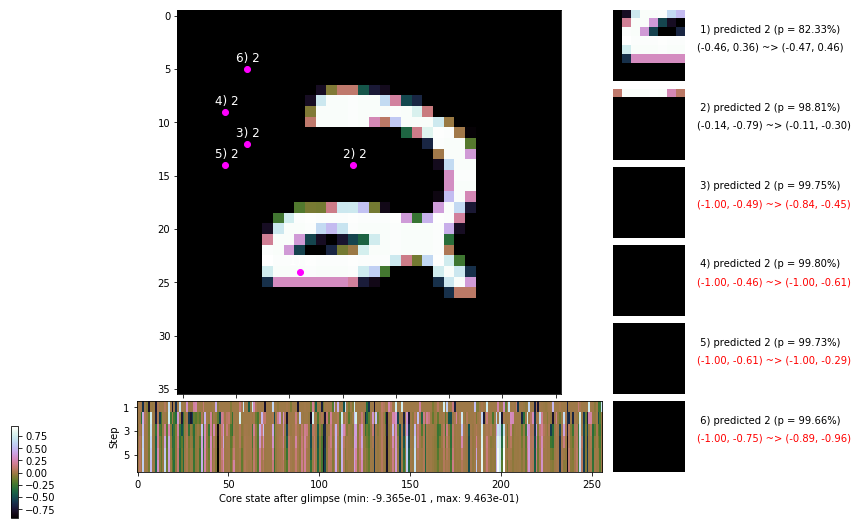

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 155.1 ms/b | lr: 7.36e-04 | grad 2norm:  8.71 | grad inf norm:  2.275
         Weights || abs max:  1.85 ( 3998.85) | mean: -3.62e-04 ( 0.02) | var: 5.20e-02 (  430.39)
          Biases || abs max:  1.15 (  120.07) | mean: -1.18e-01 ( 0.14) | var: 6.31e-02 (  135.10)
                    class loss: 0.371 | steps: 2.337 | reward:  4.335 | acc.: 88.12%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 153.9 ms/b | lr: 7.35e-04 | grad 2norm:  8.38 | grad inf norm:  2.066
         Weights || abs max:  1.88 ( 3964.64) | mean: -3.39e-04 ( 0.02) | var: 5.21e-02 (  414.80)
          Biases || abs max:  1.14 (  118.29) | mean: -1.18e-01 ( 0.14) | var: 6.34e-02 (   51.16)
                    class loss: 0.359 | steps: 2.314 | reward:  4.367 | acc.: 88.08%

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.1

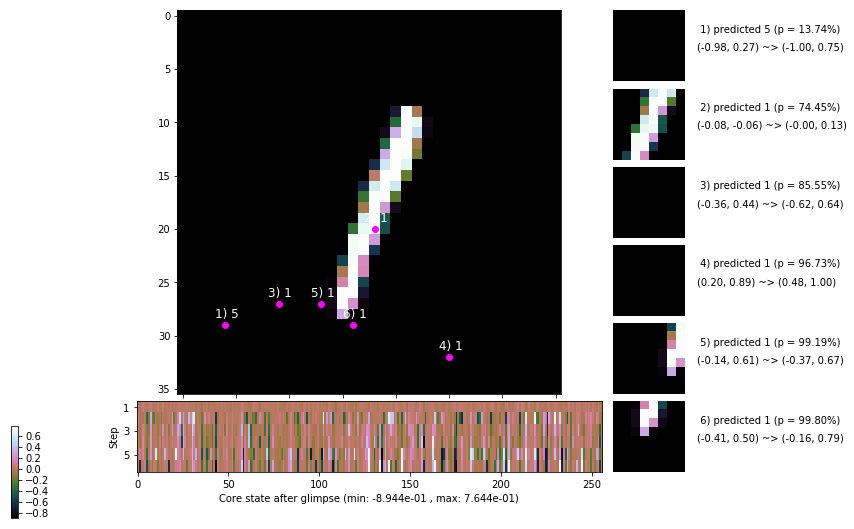

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 153.7 ms/b | lr: 7.33e-04 | grad 2norm:  8.75 | grad inf norm:  2.381
         Weights || abs max:  1.88 ( 4871.47) | mean: -3.18e-04 ( 0.02) | var: 5.23e-02 ( 1656.38)
          Biases || abs max:  1.13 (  150.76) | mean: -1.18e-01 ( 0.15) | var: 6.36e-02 (   76.83)
                    class loss: 0.396 | steps: 2.345 | reward:  4.327 | acc.: 86.92%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.2 ms/b | lr: 7.33e-04 | grad 2norm:  8.53 | grad inf norm:  2.297
         Weights || abs max:  1.89 ( 3516.65) | mean: -2.65e-04 ( 0.02) | var: 5.24e-02 (  172.77)
          Biases || abs max:  1.13 (  306.15) | mean: -1.19e-01 ( 0.23) | var: 6.39e-02 ( 1711.55)
                    class loss: 0.382 | steps: 2.353 | reward:  4.309 | acc.: 87.22%

	Target class: 6 | Discounted rewards: [1.111, 1.111, 1.1

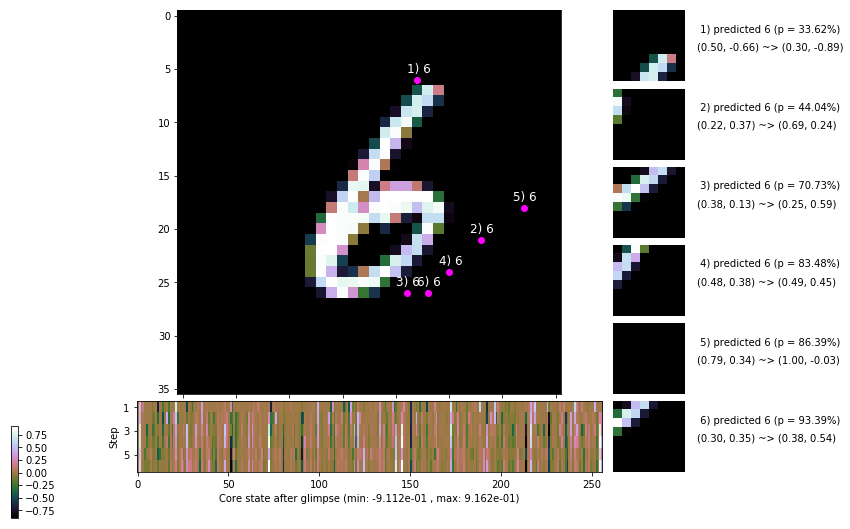

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 155.3 ms/b | lr: 7.31e-04 | grad 2norm:  8.46 | grad inf norm:  2.189
         Weights || abs max:  1.89 ( 4201.87) | mean: -2.70e-04 ( 0.02) | var: 5.25e-02 (  807.76)
          Biases || abs max:  1.12 (  190.02) | mean: -1.18e-01 ( 0.16) | var: 6.40e-02 (  222.88)
                    class loss: 0.386 | steps: 2.352 | reward:  4.310 | acc.: 87.00%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 159.3 ms/b | lr: 7.30e-04 | grad 2norm:  8.66 | grad inf norm:  2.264
         Weights || abs max:  1.90 ( 9475.01) | mean: -2.52e-04 ( 0.03) | var: 5.27e-02 (16572.98)
          Biases || abs max:  1.14 (  135.17) | mean: -1.19e-01 ( 0.13) | var: 6.44e-02 (   88.03)
                    class loss: 0.379 | steps: 2.342 | reward:  4.316 | acc.: 87.07%

	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.1

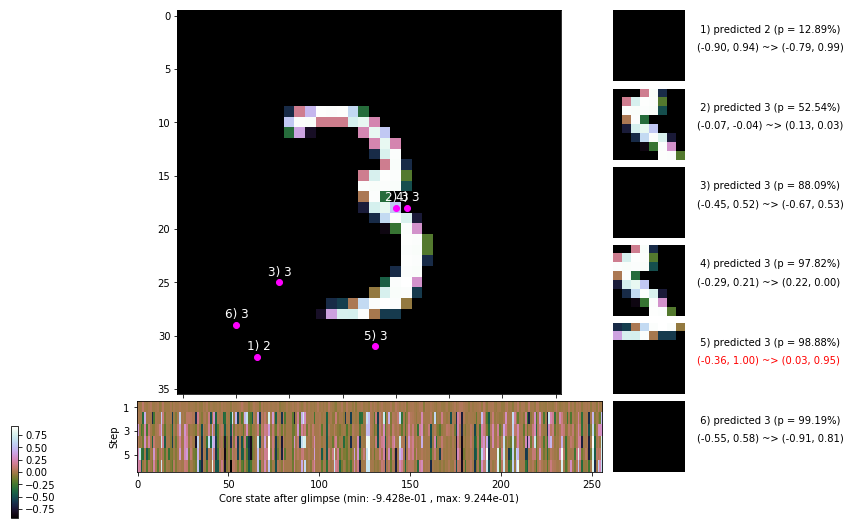

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


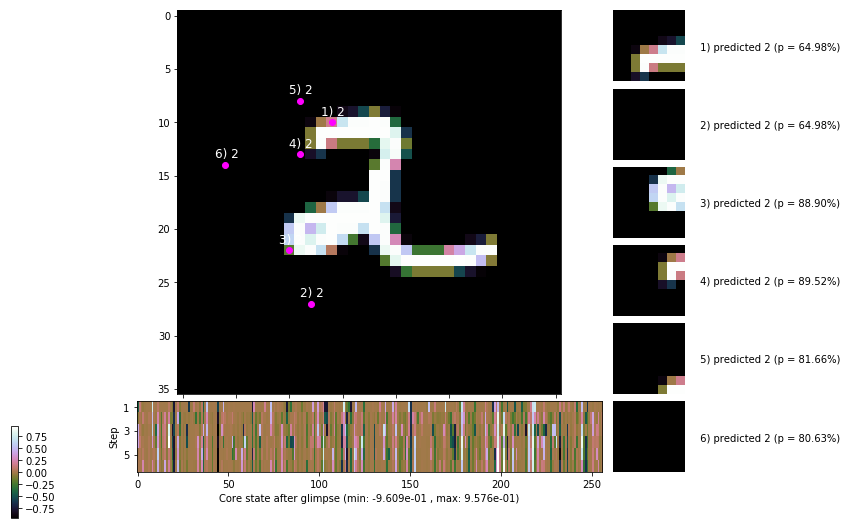


	Target class: 8 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


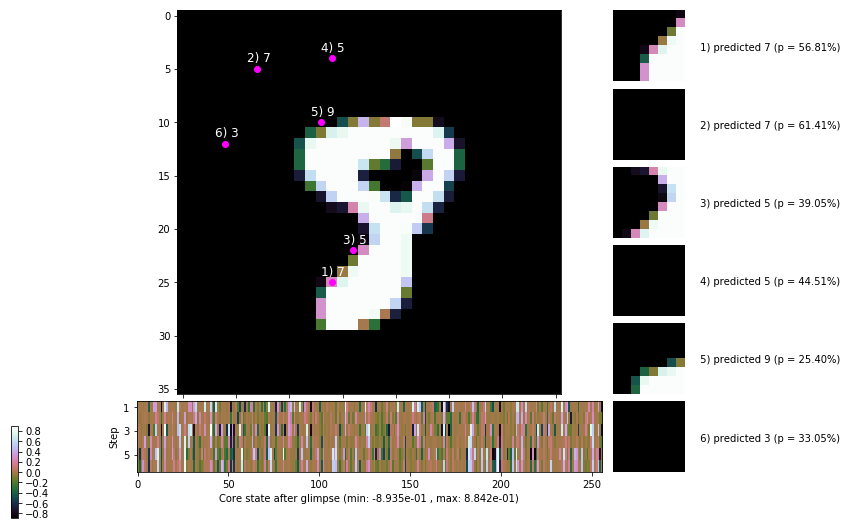

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


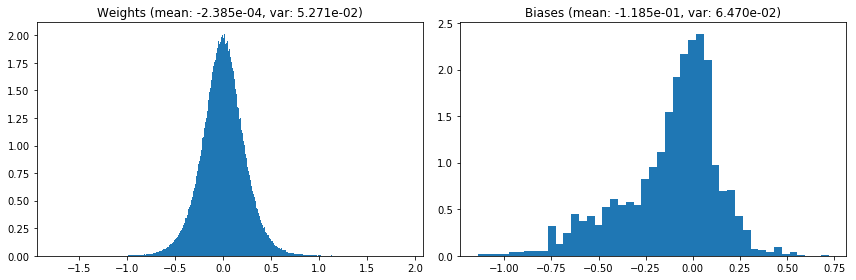

                                      Location network weights and biases


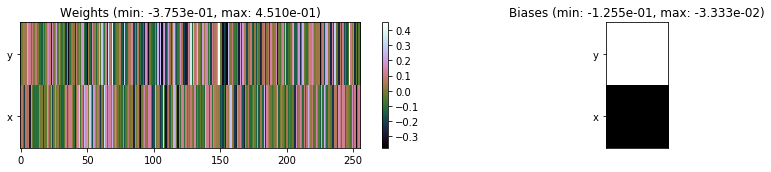

---------------------------------------------------------------------------------------------------------------
Elapsed time:  464.05 sec | TRAIN >> class loss: 0.3754 | steps:  2.340    | reward:  4.3339    | acc.: 87.530% :(
                          | VAL   >> class loss: 0.3814 | steps:  2.246 :( | reward:  4.4450 :( | acc.: 87.260% :(


Epoch  22/400) lr = 0.0007297
 b    300/  3000 >> 172.7 ms/b | lr: 7.29e-04 | grad 2norm:  8.45 | grad inf norm:  2.143
         Weights || abs max:  1.90 ( 6065.56) | mean: -2.48e-04 ( 0.02) | var: 5.28e-02 ( 5356.68)
          Biases || abs max:  1.14 (  375.92) | mean: -1.19e-01 ( 0.24) | var: 6.46e-02 ( 1305.97)
                    class loss: 0.381 | steps: 2.356 | reward:  4.312 | acc.: 87.68%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.6 ms/b | lr: 7.28e-04 | grad 2norm:  8.39 | grad inf norm:  2.196
         Weights || abs max:  1.89 ( 4471.99) | mean: -2.26e-04 (

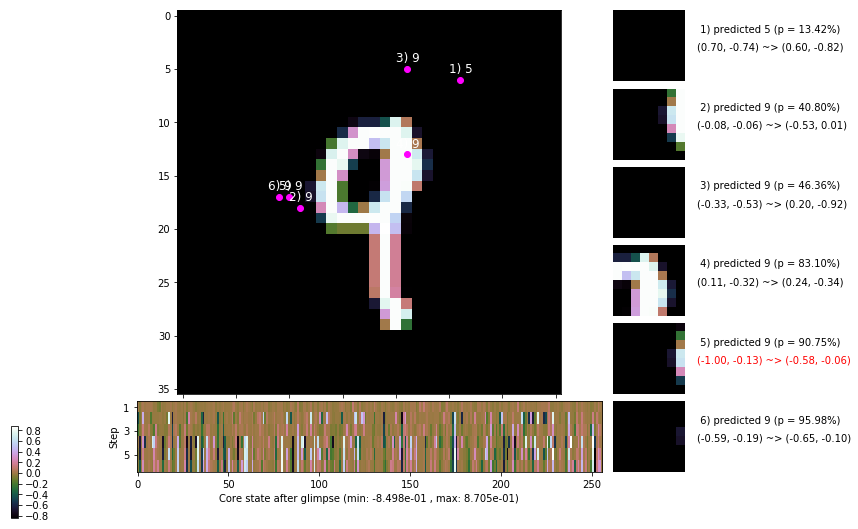

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 160.3 ms/b | lr: 7.27e-04 | grad 2norm:  8.58 | grad inf norm:  2.201
         Weights || abs max:  1.89 ( 4423.17) | mean: -2.46e-04 ( 0.02) | var: 5.30e-02 (  600.33)
          Biases || abs max:  1.15 (  199.67) | mean: -1.19e-01 ( 0.17) | var: 6.48e-02 (  353.18)
                    class loss: 0.373 | steps: 2.346 | reward:  4.330 | acc.: 87.40%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 151.6 ms/b | lr: 7.26e-04 | grad 2norm:  8.79 | grad inf norm:  2.208
         Weights || abs max:  1.91 ( 3383.89) | mean: -2.24e-04 ( 0.02) | var: 5.32e-02 (  172.71)
          Biases || abs max:  1.15 (  103.71) | mean: -1.20e-01 ( 0.12) | var: 6.50e-02 (   60.28)
                    class loss: 0.367 | steps: 2.312 | reward:  4.378 | acc.: 88.28%

	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.0

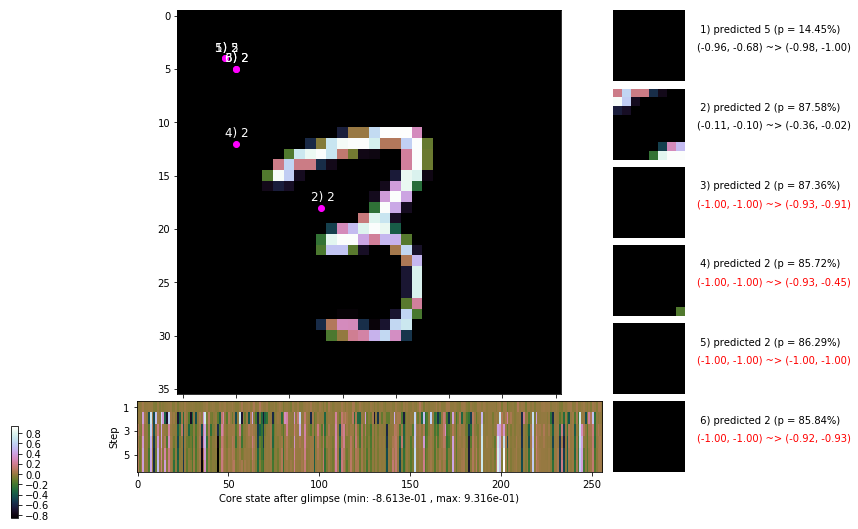

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.4 ms/b | lr: 7.25e-04 | grad 2norm:  8.72 | grad inf norm:  2.264
         Weights || abs max:  1.90 ( 5163.18) | mean: -1.85e-04 ( 0.02) | var: 5.33e-02 (  989.34)
          Biases || abs max:  1.15 (  246.90) | mean: -1.20e-01 ( 0.17) | var: 6.53e-02 ( 1328.96)
                    class loss: 0.362 | steps: 2.335 | reward:  4.340 | acc.: 87.68%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.5 ms/b | lr: 7.24e-04 | grad 2norm:  8.59 | grad inf norm:  2.225
         Weights || abs max:  1.91 ( 6397.33) | mean: -1.81e-04 ( 0.02) | var: 5.34e-02 ( 2921.14)
          Biases || abs max:  1.14 (   81.51) | mean: -1.20e-01 ( 0.11) | var: 6.53e-02 (   17.47)
                    class loss: 0.362 | steps: 2.287 | reward:  4.397 | acc.: 88.20%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.1

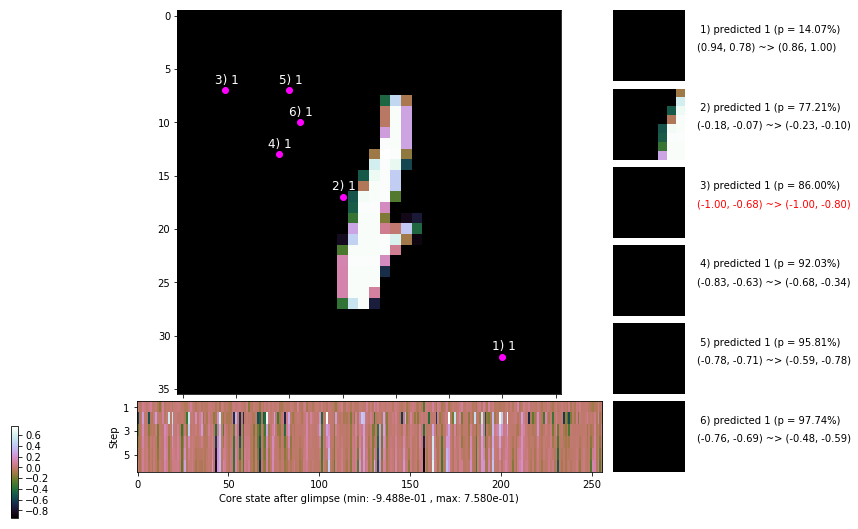

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 152.9 ms/b | lr: 7.22e-04 | grad 2norm:  8.87 | grad inf norm:  2.196
         Weights || abs max:  1.91 ( 4252.14) | mean: -2.01e-04 ( 0.02) | var: 5.35e-02 (  472.78)
          Biases || abs max:  1.13 (  233.25) | mean: -1.21e-01 ( 0.17) | var: 6.54e-02 (  720.18)
                    class loss: 0.355 | steps: 2.296 | reward:  4.359 | acc.: 88.10%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 152.7 ms/b | lr: 7.22e-04 | grad 2norm:  8.66 | grad inf norm:  2.150
         Weights || abs max:  1.91 ( 5632.33) | mean: -2.43e-04 ( 0.02) | var: 5.36e-02 ( 1409.92)
          Biases || abs max:  1.13 (  141.84) | mean: -1.21e-01 ( 0.13) | var: 6.56e-02 (   99.41)
                    class loss: 0.354 | steps: 2.317 | reward:  4.373 | acc.: 88.38%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.1

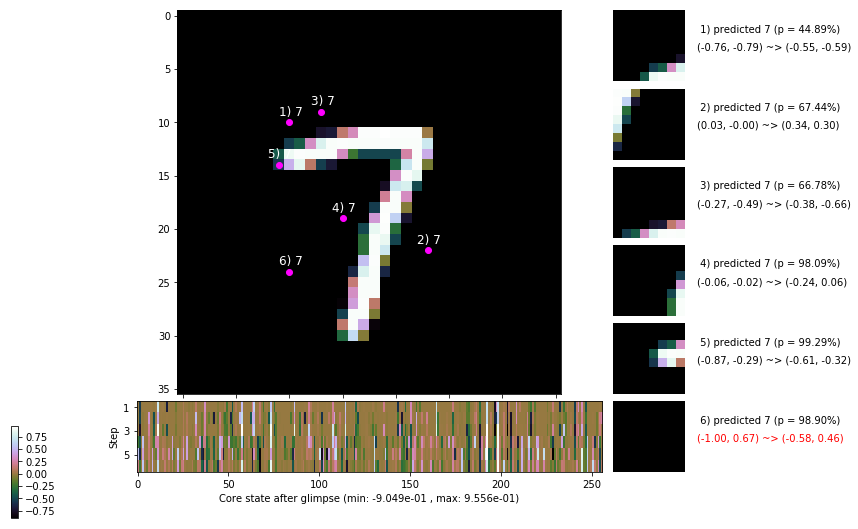

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 152.9 ms/b | lr: 7.20e-04 | grad 2norm:  8.73 | grad inf norm:  2.249
         Weights || abs max:  1.90 ( 4444.61) | mean: -2.41e-04 ( 0.02) | var: 5.38e-02 (  770.22)
          Biases || abs max:  1.14 (  118.33) | mean: -1.21e-01 ( 0.12) | var: 6.56e-02 (   84.64)
                    class loss: 0.371 | steps: 2.347 | reward:  4.340 | acc.: 87.92%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 153.8 ms/b | lr: 7.20e-04 | grad 2norm:  8.61 | grad inf norm:  2.243
         Weights || abs max:  1.91 ( 3137.15) | mean: -2.13e-04 ( 0.02) | var: 5.39e-02 (  153.34)
          Biases || abs max:  1.14 (   95.28) | mean: -1.21e-01 ( 0.11) | var: 6.57e-02 (   28.42)
                    class loss: 0.367 | steps: 2.308 | reward:  4.375 | acc.: 87.88%

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.1

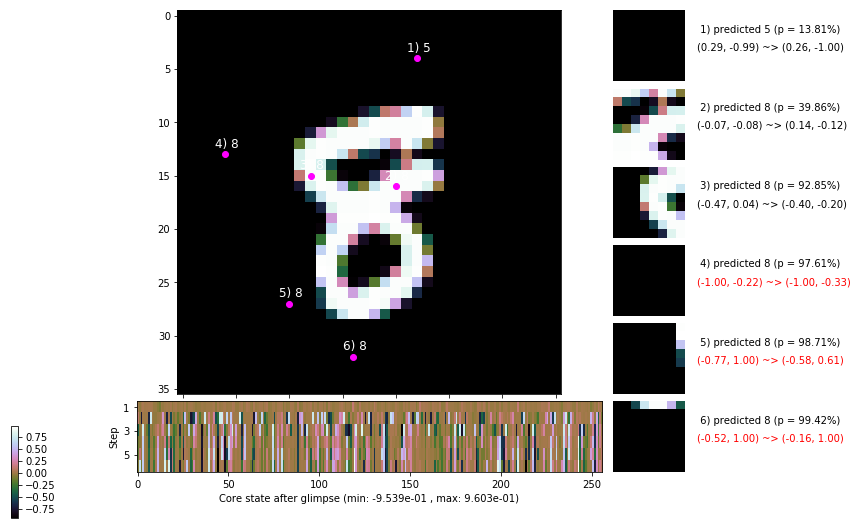

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


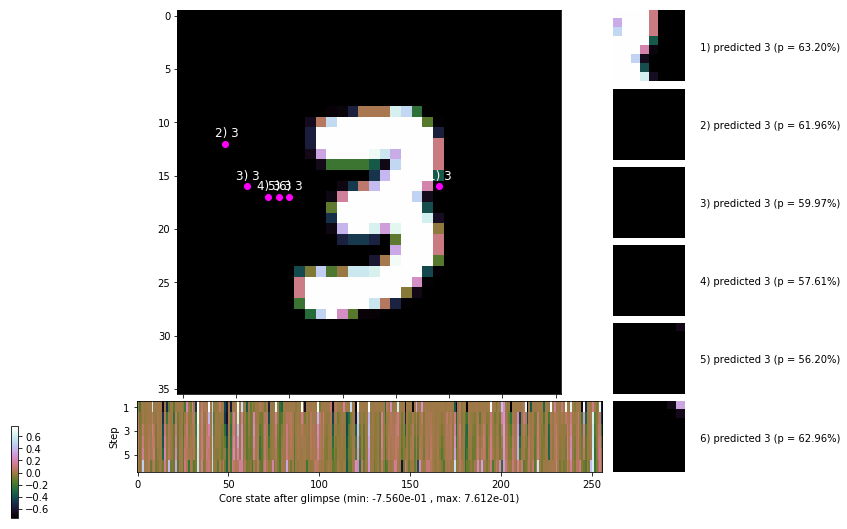


	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


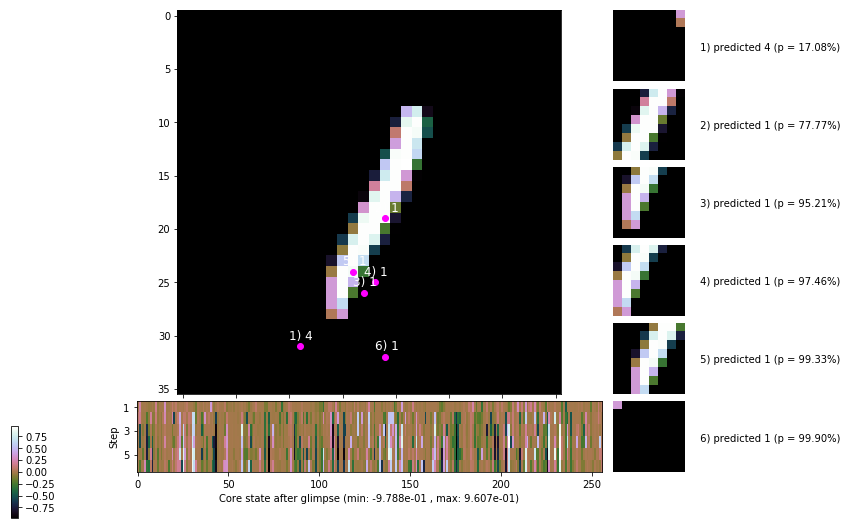

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


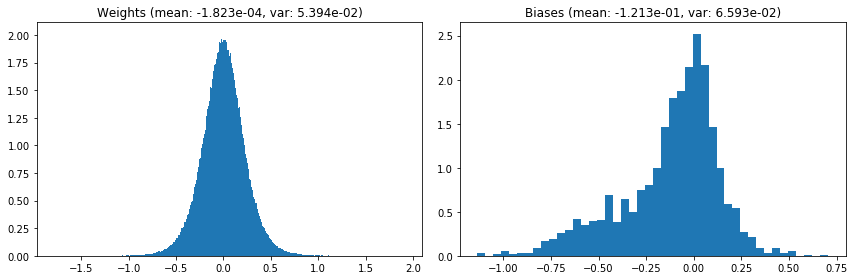

                                      Location network weights and biases


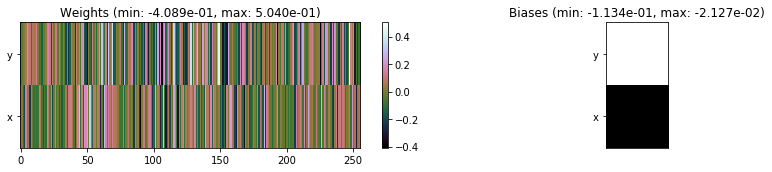

---------------------------------------------------------------------------------------------------------------
Elapsed time:  467.53 sec | TRAIN >> class loss: 0.3649 | steps:  2.322    | reward:  4.3571    | acc.: 87.997% 
                          | VAL   >> class loss: 0.3550 | steps:  2.219 :( | reward:  4.4840    | acc.: 88.080% :(


Epoch  23/400) lr = 0.0007188
 b    300/  3000 >> 154.1 ms/b | lr: 7.18e-04 | grad 2norm:  8.62 | grad inf norm:  2.175
         Weights || abs max:  1.92 ( 7387.15) | mean: -2.03e-04 ( 0.03) | var: 5.40e-02 ( 1993.71)
          Biases || abs max:  1.14 (  151.20) | mean: -1.22e-01 ( 0.13) | var: 6.63e-02 (  463.17)
                    class loss: 0.385 | steps: 2.321 | reward:  4.332 | acc.: 87.10%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.2 ms/b | lr: 7.17e-04 | grad 2norm:  8.74 | grad inf norm:  2.223
         Weights || abs max:  1.93 ( 4679.20) | mean: -2.16e-04 ( 0

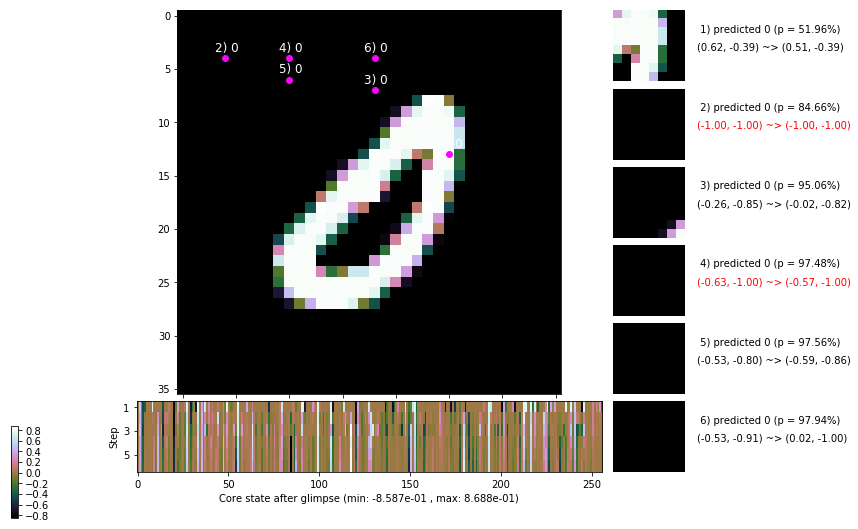

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 175.9 ms/b | lr: 7.16e-04 | grad 2norm:  8.72 | grad inf norm:  2.316
         Weights || abs max:  1.93 (17261.33) | mean: -2.00e-04 ( 0.04) | var: 5.42e-02 (57303.61)
          Biases || abs max:  1.14 (  264.76) | mean: -1.22e-01 ( 0.18) | var: 6.66e-02 ( 1205.00)
                    class loss: 0.372 | steps: 2.287 | reward:  4.392 | acc.: 87.90%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 160.2 ms/b | lr: 7.15e-04 | grad 2norm:  8.60 | grad inf norm:  2.252
         Weights || abs max:  1.94 ( 3919.96) | mean: -1.88e-04 ( 0.02) | var: 5.43e-02 (  839.27)
          Biases || abs max:  1.15 (  167.46) | mean: -1.22e-01 ( 0.14) | var: 6.69e-02 (  146.61)
                    class loss: 0.374 | steps: 2.317 | reward:  4.346 | acc.: 87.43%

	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.1

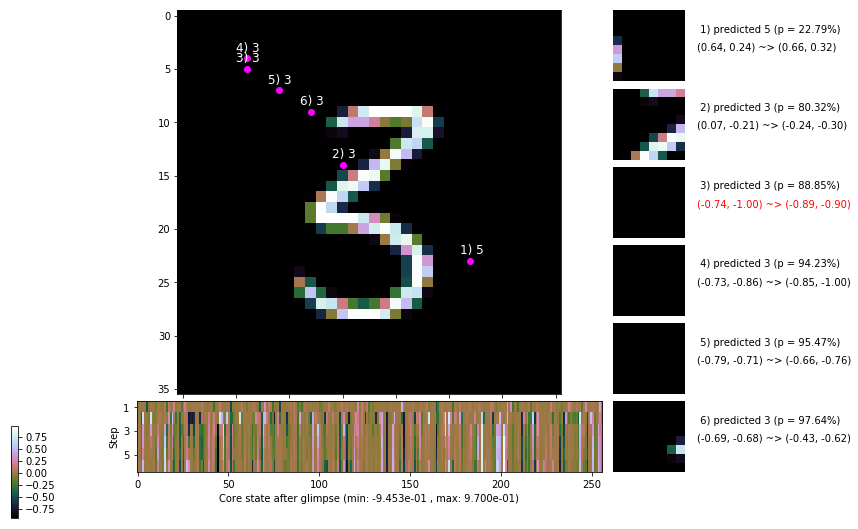

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.6 ms/b | lr: 7.14e-04 | grad 2norm:  8.78 | grad inf norm:  2.234
         Weights || abs max:  1.94 ( 9347.46) | mean: -2.11e-04 ( 0.03) | var: 5.45e-02 (12176.28)
          Biases || abs max:  1.16 (   93.13) | mean: -1.22e-01 ( 0.12) | var: 6.70e-02 (   84.69)
                    class loss: 0.363 | steps: 2.310 | reward:  4.370 | acc.: 88.15%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.9 ms/b | lr: 7.13e-04 | grad 2norm:  8.55 | grad inf norm:  2.209
         Weights || abs max:  1.94 ( 2680.48) | mean: -2.19e-04 ( 0.02) | var: 5.46e-02 (   86.75)
          Biases || abs max:  1.16 (  140.25) | mean: -1.22e-01 ( 0.14) | var: 6.69e-02 (   83.40)
                    class loss: 0.370 | steps: 2.303 | reward:  4.371 | acc.: 87.63%

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.1

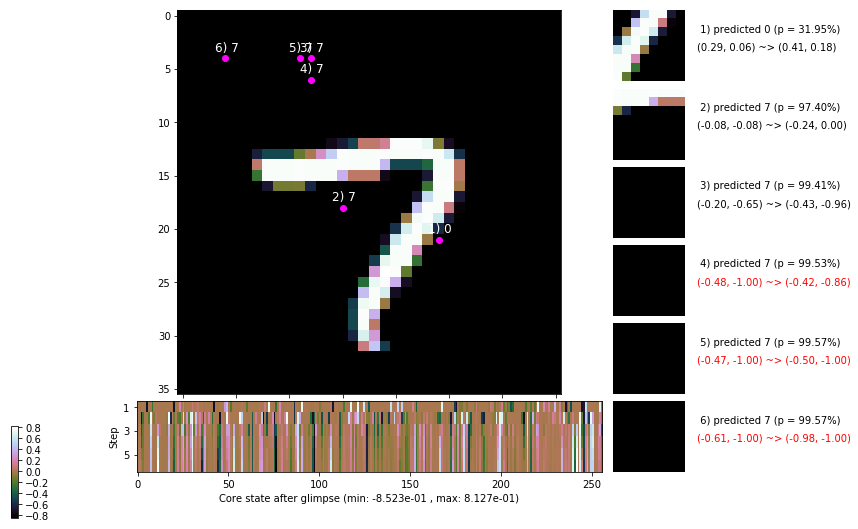

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.5 ms/b | lr: 7.12e-04 | grad 2norm:  8.60 | grad inf norm:  2.210
         Weights || abs max:  1.95 ( 5270.51) | mean: -2.20e-04 ( 0.02) | var: 5.47e-02 (  974.05)
          Biases || abs max:  1.16 (  138.41) | mean: -1.22e-01 ( 0.14) | var: 6.71e-02 (   62.50)
                    class loss: 0.348 | steps: 2.306 | reward:  4.384 | acc.: 88.77%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.6 ms/b | lr: 7.11e-04 | grad 2norm:  8.60 | grad inf norm:  2.263
         Weights || abs max:  1.95 ( 2853.11) | mean: -2.18e-04 ( 0.02) | var: 5.48e-02 (  118.93)
          Biases || abs max:  1.16 (  110.33) | mean: -1.22e-01 ( 0.12) | var: 6.72e-02 (   57.64)
                    class loss: 0.363 | steps: 2.322 | reward:  4.358 | acc.: 88.05%

	Target class: 2 | Discounted rewards: [0.111, 1.111, 1.1

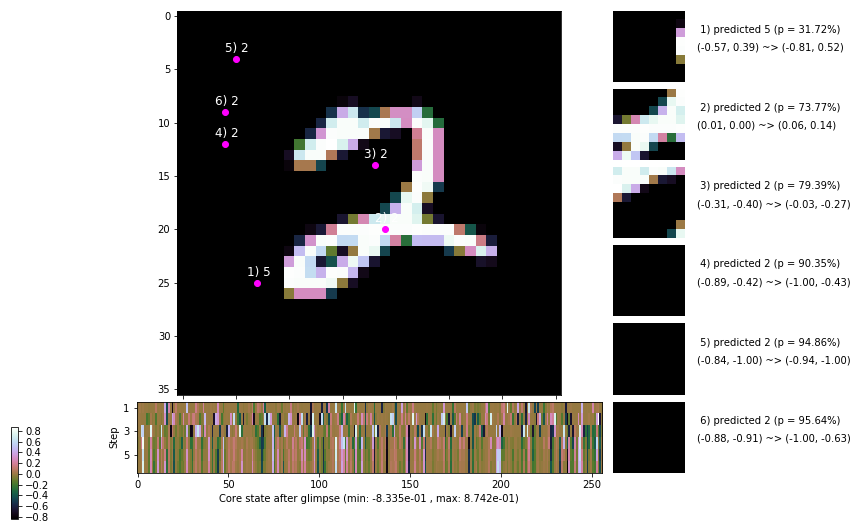

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 153.4 ms/b | lr: 7.10e-04 | grad 2norm:  8.63 | grad inf norm:  2.301
         Weights || abs max:  1.95 ( 4357.50) | mean: -2.07e-04 ( 0.02) | var: 5.49e-02 (  494.18)
          Biases || abs max:  1.16 (  138.02) | mean: -1.22e-01 ( 0.13) | var: 6.74e-02 (   76.64)
                    class loss: 0.369 | steps: 2.320 | reward:  4.356 | acc.: 87.37%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 153.9 ms/b | lr: 7.09e-04 | grad 2norm:  8.44 | grad inf norm:  2.227
         Weights || abs max:  1.95 ( 3570.79) | mean: -1.98e-04 ( 0.02) | var: 5.50e-02 (  425.85)
          Biases || abs max:  1.16 (  136.17) | mean: -1.23e-01 ( 0.14) | var: 6.75e-02 (   81.54)
                    class loss: 0.367 | steps: 2.310 | reward:  4.365 | acc.: 88.07%

	Target class: 6 | Discounted rewards: [1.111, 1.111, 1.1

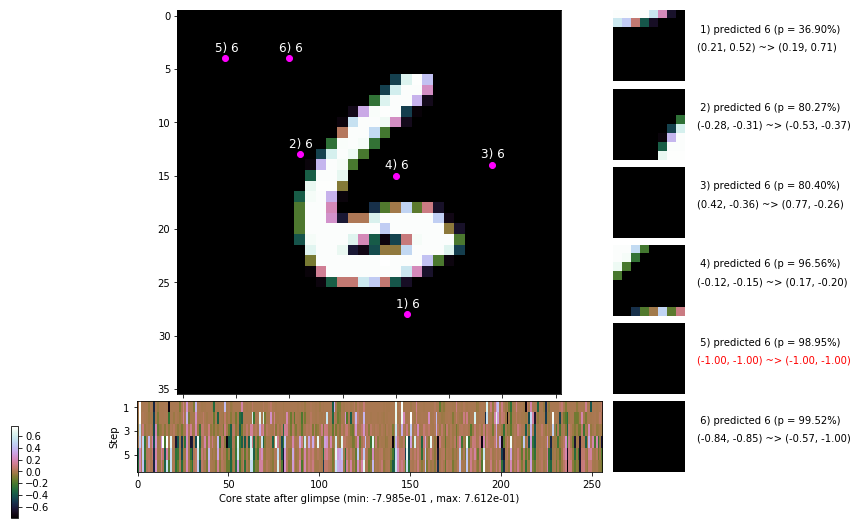

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


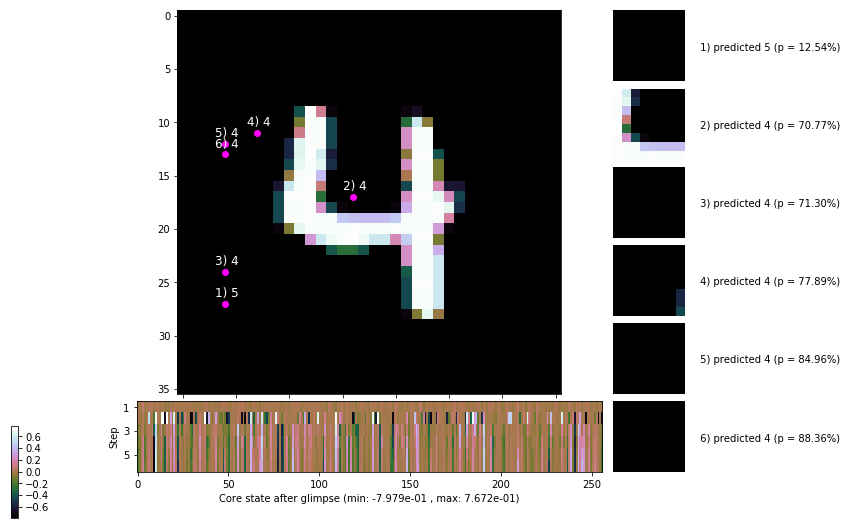


	Target class: 6 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


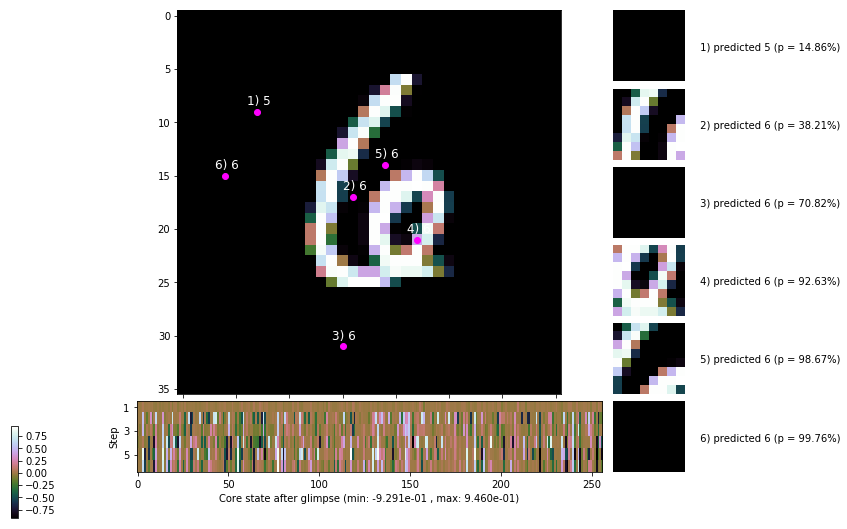

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


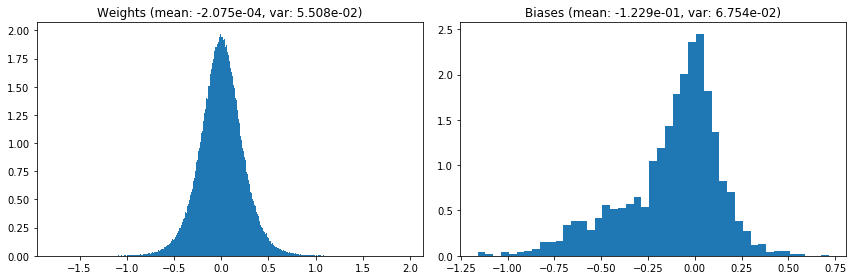

                                      Location network weights and biases


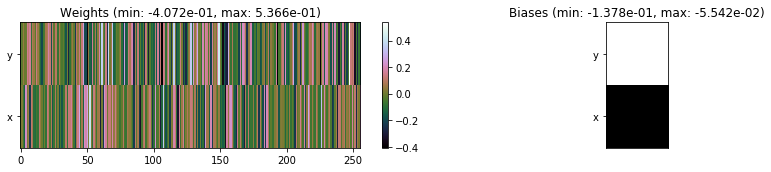

---------------------------------------------------------------------------------------------------------------
Elapsed time:  470.57 sec | TRAIN >> class loss: 0.3673 | steps:  2.313    | reward:  4.3624    | acc.: 87.807% :(
                          | VAL   >> class loss: 0.3798 | steps:  2.232 :( | reward:  4.4334 :( | acc.: 87.340% :(


Epoch  24/400) lr = 0.0007081
 b    300/  3000 >> 152.9 ms/b | lr: 7.07e-04 | grad 2norm:  8.35 | grad inf norm:  2.152
         Weights || abs max:  1.95 ( 6443.11) | mean: -2.18e-04 ( 0.02) | var: 5.51e-02 ( 3255.75)
          Biases || abs max:  1.16 (  218.85) | mean: -1.23e-01 ( 0.18) | var: 6.77e-02 ( 1198.01)
                    class loss: 0.369 | steps: 2.329 | reward:  4.337 | acc.: 87.70%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.8 ms/b | lr: 7.07e-04 | grad 2norm:  8.43 | grad inf norm:  2.260
         Weights || abs max:  1.95 ( 4625.51) | mean: -2.17e-04 (

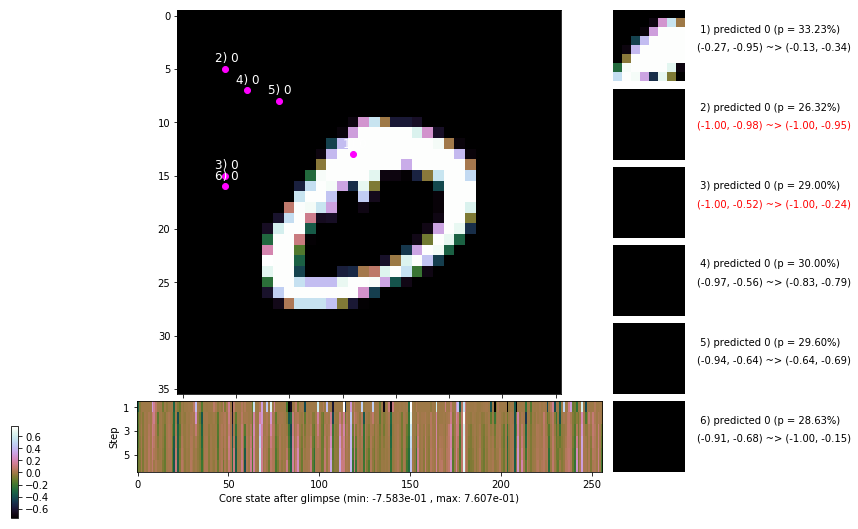

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 159.1 ms/b | lr: 7.05e-04 | grad 2norm:  8.49 | grad inf norm:  2.196
         Weights || abs max:  1.97 ( 2999.52) | mean: -2.18e-04 ( 0.02) | var: 5.54e-02 (  213.67)
          Biases || abs max:  1.18 (  230.97) | mean: -1.23e-01 ( 0.17) | var: 6.80e-02 (  927.96)
                    class loss: 0.386 | steps: 2.323 | reward:  4.348 | acc.: 87.03%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 153.8 ms/b | lr: 7.05e-04 | grad 2norm:  8.36 | grad inf norm:  2.191
         Weights || abs max:  1.97 ( 2289.42) | mean: -2.01e-04 ( 0.01) | var: 5.55e-02 (   63.66)
          Biases || abs max:  1.18 (  221.74) | mean: -1.23e-01 ( 0.17) | var: 6.83e-02 (  454.63)
                    class loss: 0.372 | steps: 2.335 | reward:  4.342 | acc.: 87.50%

	Target class: 9 | Discounted rewards: [0.111, 1.111, 1.1

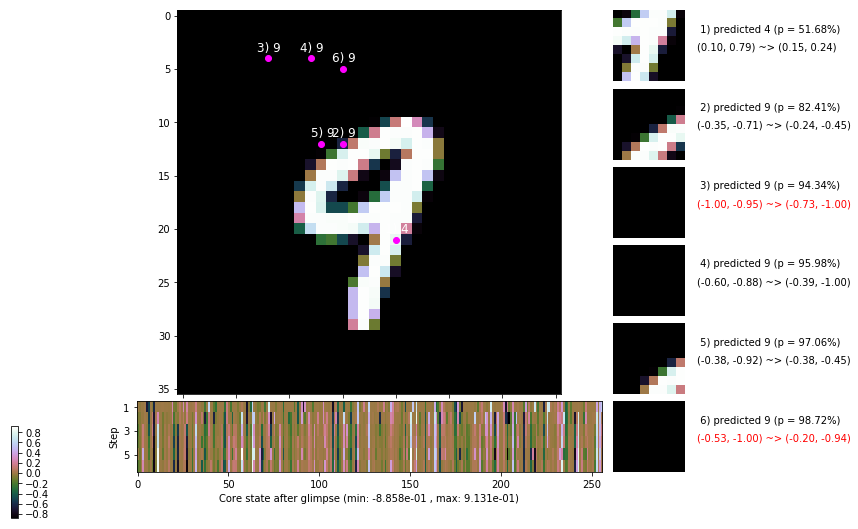

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 159.5 ms/b | lr: 7.03e-04 | grad 2norm:  8.21 | grad inf norm:  2.187
         Weights || abs max:  1.96 ( 6346.44) | mean: -2.42e-04 ( 0.02) | var: 5.56e-02 ( 5776.86)
          Biases || abs max:  1.18 (  890.09) | mean: -1.23e-01 ( 0.43) | var: 6.85e-02 (66727.52)
                    class loss: 0.367 | steps: 2.330 | reward:  4.351 | acc.: 88.02%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 175.5 ms/b | lr: 7.02e-04 | grad 2norm:  8.71 | grad inf norm:  2.217
         Weights || abs max:  1.97 ( 3938.85) | mean: -2.36e-04 ( 0.02) | var: 5.57e-02 (  543.12)
          Biases || abs max:  1.18 (  421.31) | mean: -1.24e-01 ( 0.25) | var: 6.87e-02 (10513.84)
                    class loss: 0.390 | steps: 2.347 | reward:  4.326 | acc.: 87.43%

	Target class: 2 | Discounted rewards: [0.011, 0.111, 1.1

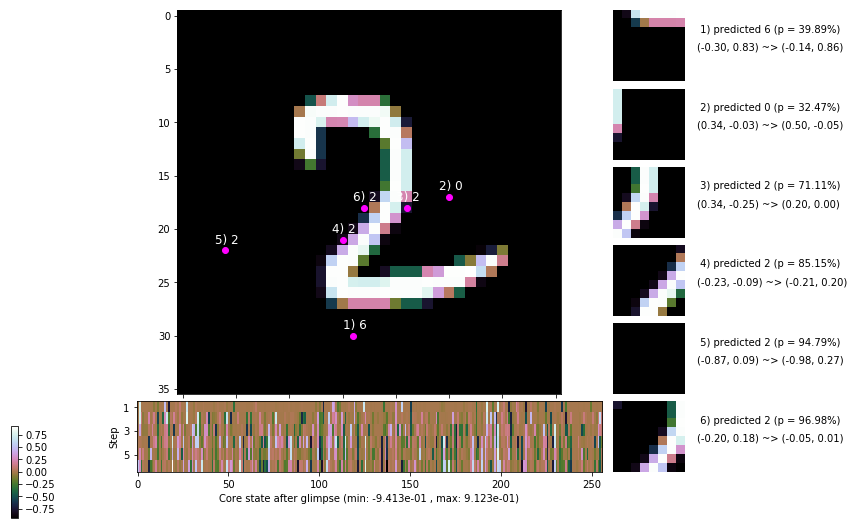

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 153.2 ms/b | lr: 7.01e-04 | grad 2norm:  8.42 | grad inf norm:  2.281
         Weights || abs max:  1.95 ( 3536.54) | mean: -2.42e-04 ( 0.02) | var: 5.59e-02 (  391.42)
          Biases || abs max:  1.18 (  226.59) | mean: -1.24e-01 ( 0.16) | var: 6.90e-02 ( 1802.03)
                    class loss: 0.376 | steps: 2.335 | reward:  4.335 | acc.: 87.40%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 154.4 ms/b | lr: 7.00e-04 | grad 2norm:  8.33 | grad inf norm:  2.084
         Weights || abs max:  1.95 ( 3489.85) | mean: -2.59e-04 ( 0.02) | var: 5.60e-02 (  148.80)
          Biases || abs max:  1.19 (  162.38) | mean: -1.24e-01 ( 0.14) | var: 6.92e-02 (  138.41)
                    class loss: 0.370 | steps: 2.292 | reward:  4.386 | acc.: 87.83%

	Target class: 6 | Discounted rewards: [1.101, 1.011, 0.1

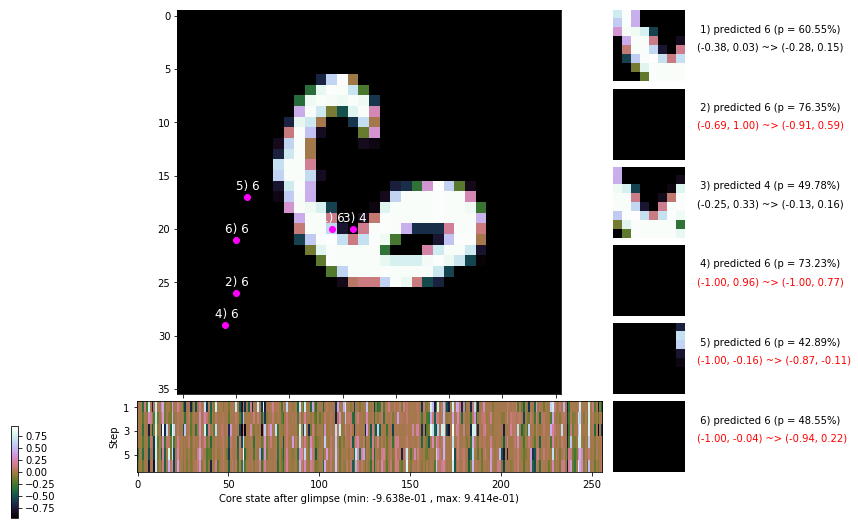

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 155.9 ms/b | lr: 6.99e-04 | grad 2norm:  8.52 | grad inf norm:  2.123
         Weights || abs max:  1.95 ( 8616.23) | mean: -2.93e-04 ( 0.03) | var: 5.61e-02 (14540.91)
          Biases || abs max:  1.19 (  419.67) | mean: -1.24e-01 ( 0.23) | var: 6.95e-02 ( 4537.37)
                    class loss: 0.392 | steps: 2.315 | reward:  4.354 | acc.: 86.87%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 151.6 ms/b | lr: 6.98e-04 | grad 2norm:  8.22 | grad inf norm:  2.129
         Weights || abs max:  1.93 ( 2352.09) | mean: -3.10e-04 ( 0.02) | var: 5.62e-02 (   99.89)
          Biases || abs max:  1.20 (   76.75) | mean: -1.25e-01 ( 0.10) | var: 6.96e-02 (   10.85)
                    class loss: 0.372 | steps: 2.324 | reward:  4.343 | acc.: 87.47%

	Target class: 4 | Discounted rewards: [0.111, 1.111, 1.1

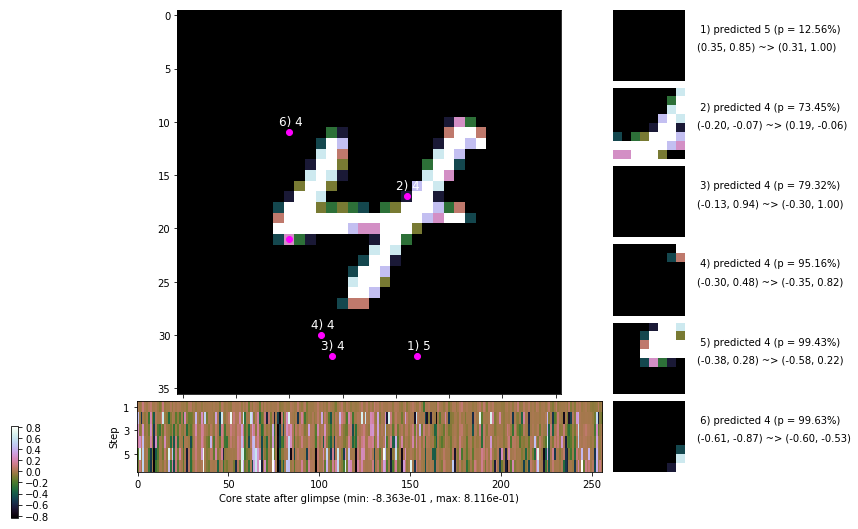

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


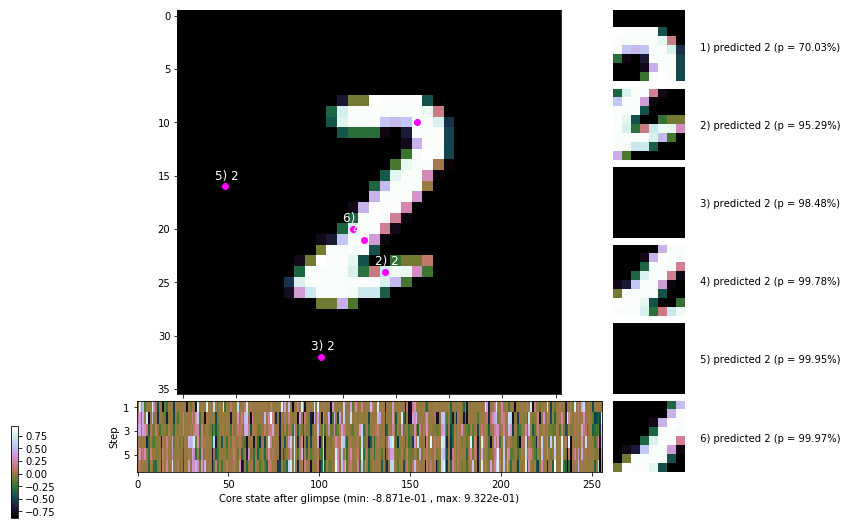


	Target class: 2 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


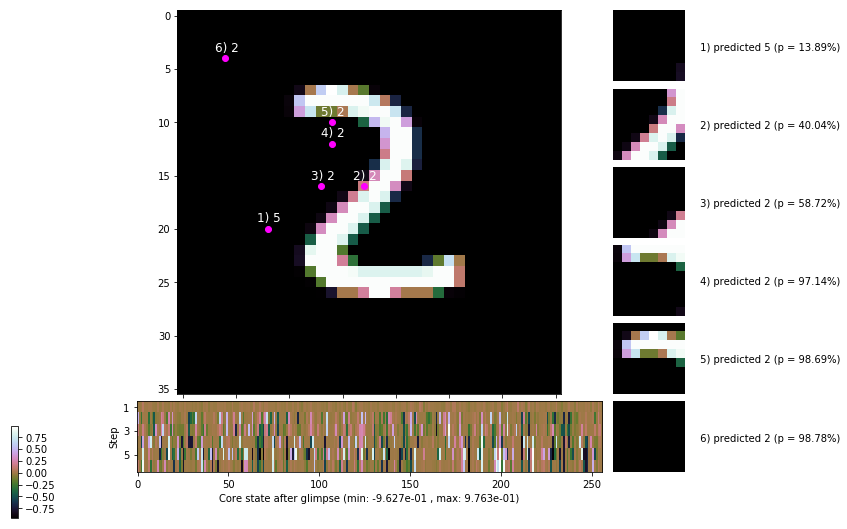

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


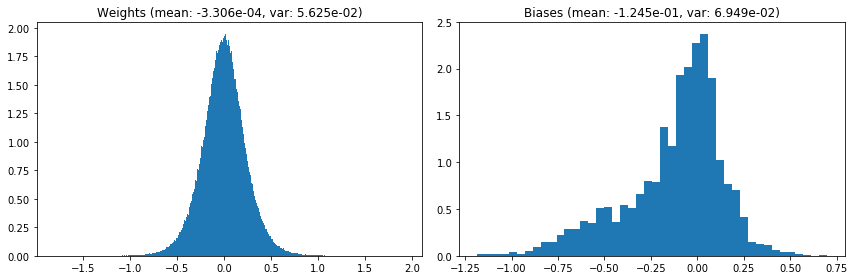

                                      Location network weights and biases


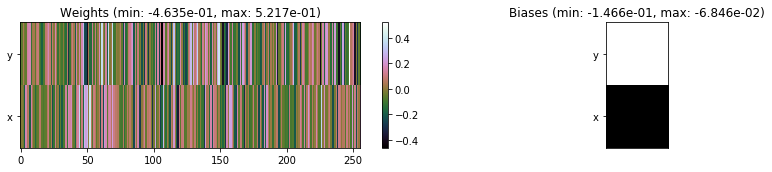

---------------------------------------------------------------------------------------------------------------
Elapsed time:  471.19 sec | TRAIN >> class loss: 0.3776 | steps:  2.325 :( | reward:  4.3461 :( | acc.: 87.457% :(
                          | VAL   >> class loss: 0.3904 | steps:  2.246 :( | reward:  4.4504 :( | acc.: 87.560% :(


Epoch  25/400) lr = 0.0006976
 b    300/  3000 >> 153.1 ms/b | lr: 6.97e-04 | grad 2norm:  8.53 | grad inf norm:  2.304
         Weights || abs max:  1.93 ( 3650.95) | mean: -3.00e-04 ( 0.02) | var: 5.63e-02 (  475.91)
          Biases || abs max:  1.19 (  543.77) | mean: -1.25e-01 ( 0.31) | var: 6.96e-02 (14359.00)
                    class loss: 0.392 | steps: 2.367 | reward:  4.309 | acc.: 86.82%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.4 ms/b | lr: 6.96e-04 | grad 2norm:  8.32 | grad inf norm:  2.171
         Weights || abs max:  1.93 ( 6098.62) | mean: -2.88e-04 (

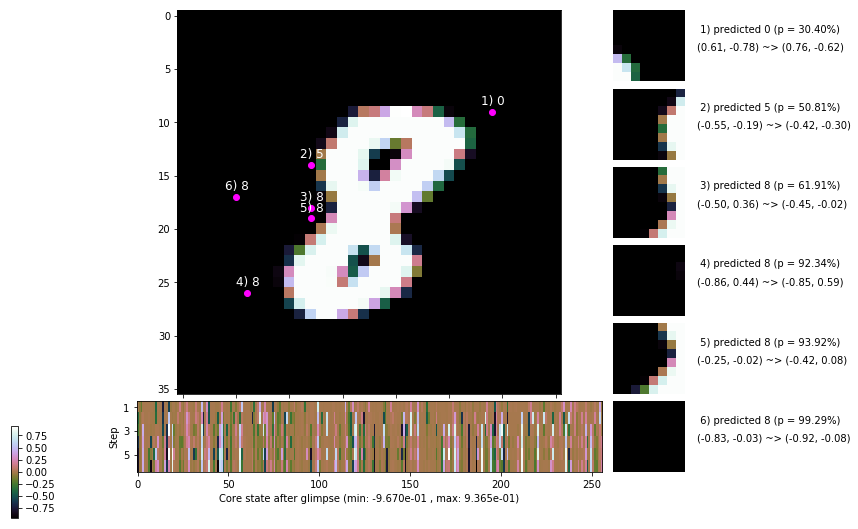

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 156.4 ms/b | lr: 6.95e-04 | grad 2norm:  8.34 | grad inf norm:  2.163
         Weights || abs max:  1.92 ( 5167.42) | mean: -2.63e-04 ( 0.02) | var: 5.65e-02 (  831.53)
          Biases || abs max:  1.19 (  121.71) | mean: -1.24e-01 ( 0.12) | var: 6.98e-02 (  144.00)
                    class loss: 0.368 | steps: 2.331 | reward:  4.347 | acc.: 87.73%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 152.8 ms/b | lr: 6.94e-04 | grad 2norm:  8.16 | grad inf norm:  2.223
         Weights || abs max:  1.92 ( 2810.13) | mean: -2.39e-04 ( 0.02) | var: 5.67e-02 (  139.04)
          Biases || abs max:  1.19 (  920.61) | mean: -1.25e-01 ( 0.44) | var: 6.99e-02 (76974.55)
                    class loss: 0.379 | steps: 2.336 | reward:  4.356 | acc.: 87.47%

	Target class: 6 | Discounted rewards: [0.111, 1.111, 1.1

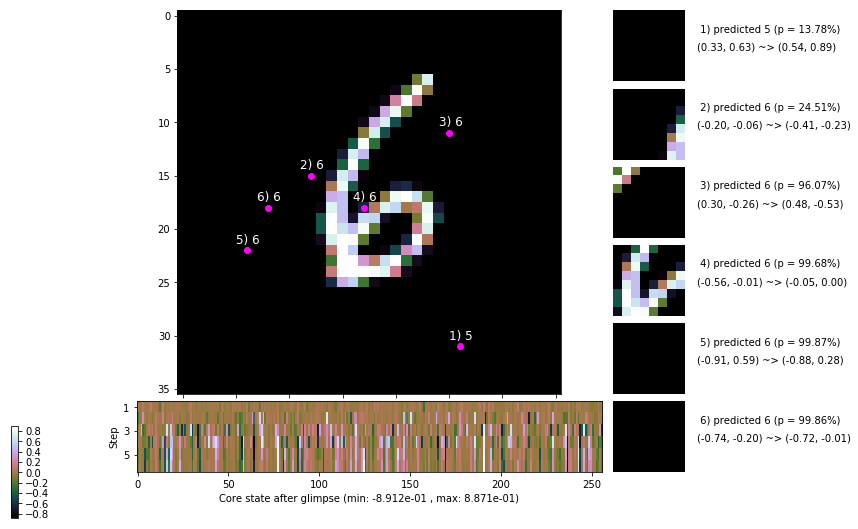

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 156.9 ms/b | lr: 6.93e-04 | grad 2norm:  8.38 | grad inf norm:  2.222
         Weights || abs max:  1.92 (16498.71) | mean: -1.95e-04 ( 0.04) | var: 5.68e-02 (42716.30)
          Biases || abs max:  1.19 (  302.26) | mean: -1.25e-01 ( 0.20) | var: 7.01e-02 ( 2430.19)
                    class loss: 0.387 | steps: 2.352 | reward:  4.321 | acc.: 87.15%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.2 ms/b | lr: 6.92e-04 | grad 2norm:  8.48 | grad inf norm:  2.235
         Weights || abs max:  1.91 ( 4475.07) | mean: -1.79e-04 ( 0.02) | var: 5.69e-02 ( 1106.72)
          Biases || abs max:  1.19 (  423.18) | mean: -1.25e-01 ( 0.24) | var: 7.02e-02 ( 6596.98)
                    class loss: 0.354 | steps: 2.324 | reward:  4.371 | acc.: 88.52%

	Target class: 7 | Discounted rewards: [1.011, 0.111, 1.1

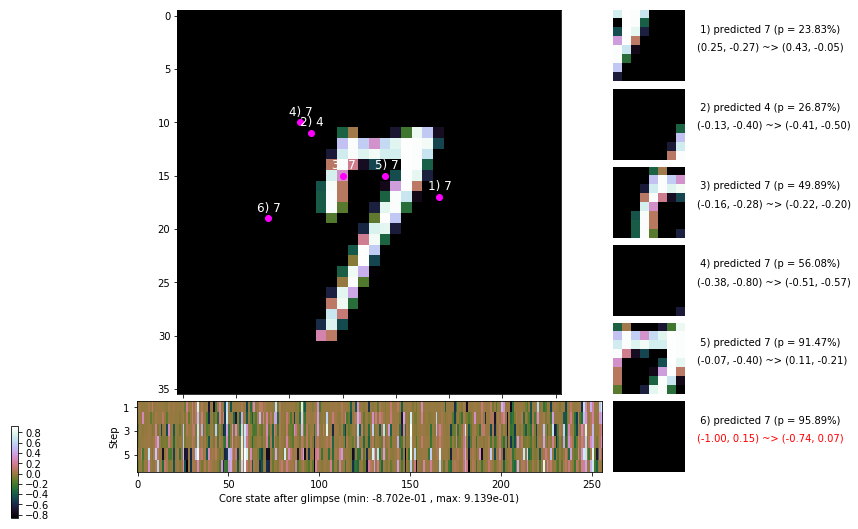

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.7 ms/b | lr: 6.91e-04 | grad 2norm:  8.32 | grad inf norm:  2.231
         Weights || abs max:  1.91 ( 4969.57) | mean: -1.98e-04 ( 0.02) | var: 5.70e-02 (  657.52)
          Biases || abs max:  1.20 (  159.79) | mean: -1.25e-01 ( 0.14) | var: 7.04e-02 (  260.34)
                    class loss: 0.357 | steps: 2.288 | reward:  4.393 | acc.: 87.78%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 172.3 ms/b | lr: 6.90e-04 | grad 2norm:  8.30 | grad inf norm:  2.190
         Weights || abs max:  1.92 ( 6403.82) | mean: -2.05e-04 ( 0.02) | var: 5.71e-02 ( 2945.79)
          Biases || abs max:  1.21 (   99.89) | mean: -1.25e-01 ( 0.12) | var: 7.06e-02 (   34.66)
                    class loss: 0.380 | steps: 2.372 | reward:  4.306 | acc.: 86.88%

	Target class: 2 | Discounted rewards: [0.111, 1.111, 1.1

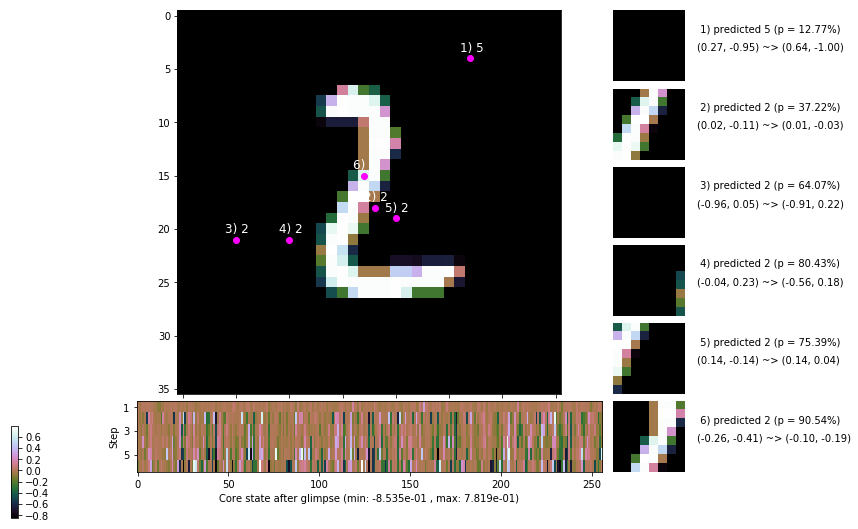

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 167.5 ms/b | lr: 6.89e-04 | grad 2norm:  8.32 | grad inf norm:  2.187
         Weights || abs max:  1.91 ( 5670.41) | mean: -1.66e-04 ( 0.02) | var: 5.72e-02 ( 4001.95)
          Biases || abs max:  1.21 (  215.86) | mean: -1.25e-01 ( 0.16) | var: 7.06e-02 (  500.94)
                    class loss: 0.355 | steps: 2.286 | reward:  4.397 | acc.: 88.37%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 153.8 ms/b | lr: 6.88e-04 | grad 2norm:  8.53 | grad inf norm:  2.301
         Weights || abs max:  1.91 ( 2455.78) | mean: -1.38e-04 ( 0.02) | var: 5.73e-02 (   82.89)
          Biases || abs max:  1.20 (  197.94) | mean: -1.25e-01 ( 0.15) | var: 7.07e-02 ( 1086.56)
                    class loss: 0.376 | steps: 2.317 | reward:  4.354 | acc.: 87.20%

	Target class: 6 | Discounted rewards: [0.111, 1.111, 1.1

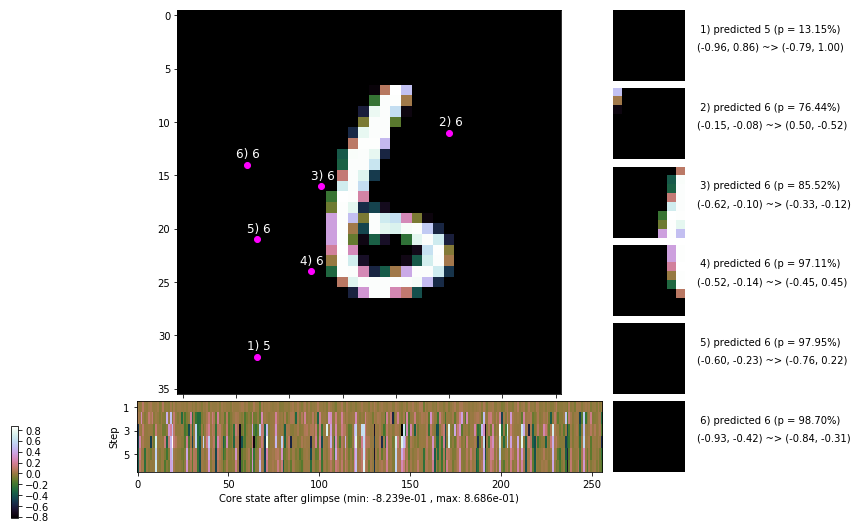

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


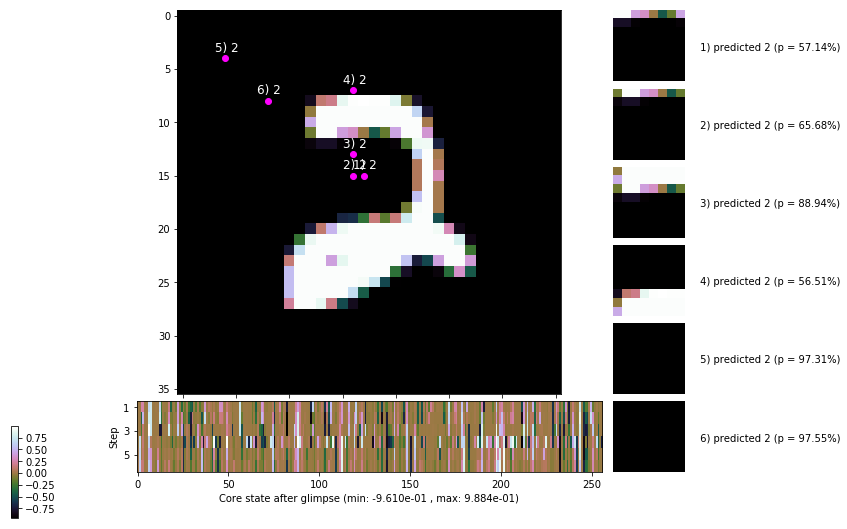


	Target class: 6 | Discounted rewards: [0.011, 0.111, 1.111, 1.110, 1.100, 1.000]


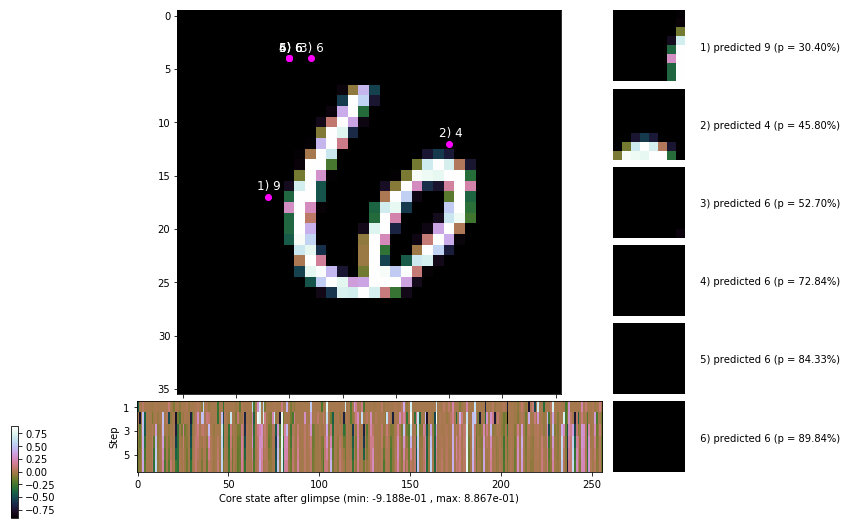

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


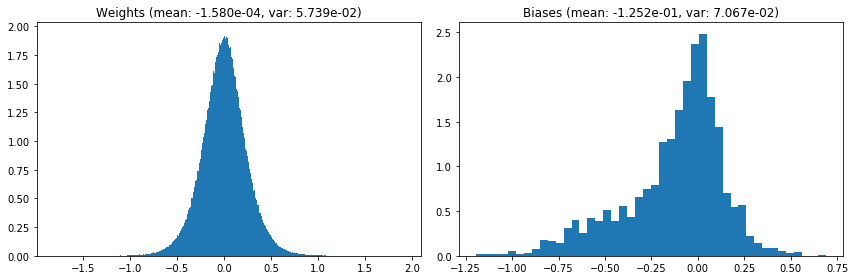

                                      Location network weights and biases


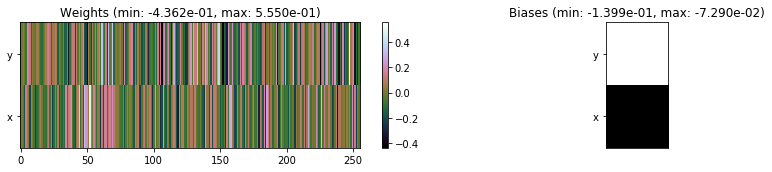

---------------------------------------------------------------------------------------------------------------
Elapsed time:  472.87 sec | TRAIN >> class loss: 0.3709 | steps:  2.329 :( | reward:  4.3538 :( | acc.: 87.588% :(
                          | VAL   >> class loss: 0.3883 | steps:  2.238 :( | reward:  4.4700 :( | acc.: 87.520% :(


Epoch  26/400) lr = 0.0006872
 b    300/  3000 >> 154.6 ms/b | lr: 6.86e-04 | grad 2norm:  8.44 | grad inf norm:  2.255
         Weights || abs max:  1.91 ( 3879.66) | mean: -1.83e-04 ( 0.02) | var: 5.74e-02 (  255.19)
          Biases || abs max:  1.20 (  188.29) | mean: -1.26e-01 ( 0.15) | var: 7.09e-02 (  385.49)
                    class loss: 0.380 | steps: 2.335 | reward:  4.328 | acc.: 87.03%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 154.4 ms/b | lr: 6.86e-04 | grad 2norm:  8.23 | grad inf norm:  2.214
         Weights || abs max:  1.93 ( 4028.39) | mean: -1.97e-04 (

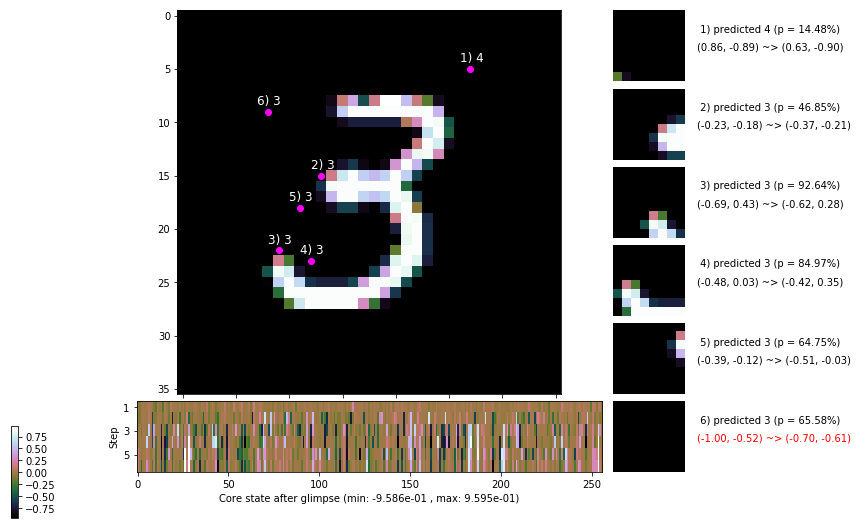

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 157.3 ms/b | lr: 6.84e-04 | grad 2norm:  8.36 | grad inf norm:  2.210
         Weights || abs max:  1.92 ( 6328.02) | mean: -1.80e-04 ( 0.02) | var: 5.76e-02 ( 2200.83)
          Biases || abs max:  1.21 (  450.10) | mean: -1.27e-01 ( 0.27) | var: 7.13e-02 ( 5039.73)
                    class loss: 0.399 | steps: 2.320 | reward:  4.347 | acc.: 87.23%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 151.8 ms/b | lr: 6.84e-04 | grad 2norm:  8.30 | grad inf norm:  2.105
         Weights || abs max:  1.90 ( 3198.81) | mean: -1.88e-04 ( 0.02) | var: 5.77e-02 (  148.31)
          Biases || abs max:  1.21 (  300.96) | mean: -1.27e-01 ( 0.22) | var: 7.15e-02 ( 1570.83)
                    class loss: 0.365 | steps: 2.322 | reward:  4.356 | acc.: 87.62%

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.1

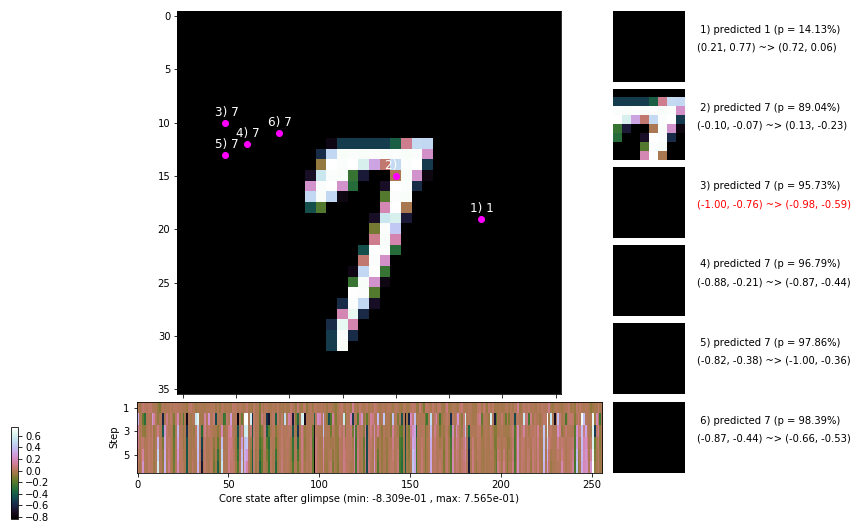

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.8 ms/b | lr: 6.82e-04 | grad 2norm:  8.37 | grad inf norm:  2.218
         Weights || abs max:  1.91 ( 4090.72) | mean: -1.58e-04 ( 0.02) | var: 5.79e-02 (  396.35)
          Biases || abs max:  1.22 (  133.68) | mean: -1.27e-01 ( 0.15) | var: 7.18e-02 (  163.84)
                    class loss: 0.381 | steps: 2.332 | reward:  4.338 | acc.: 87.02%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 153.1 ms/b | lr: 6.82e-04 | grad 2norm:  8.35 | grad inf norm:  2.396
         Weights || abs max:  1.92 ( 2995.86) | mean: -1.65e-04 ( 0.02) | var: 5.80e-02 (  174.87)
          Biases || abs max:  1.21 (  122.75) | mean: -1.27e-01 ( 0.12) | var: 7.20e-02 (  107.18)
                    class loss: 0.358 | steps: 2.345 | reward:  4.356 | acc.: 88.27%

	Target class: 4 | Discounted rewards: [0.111, 1.111, 1.1

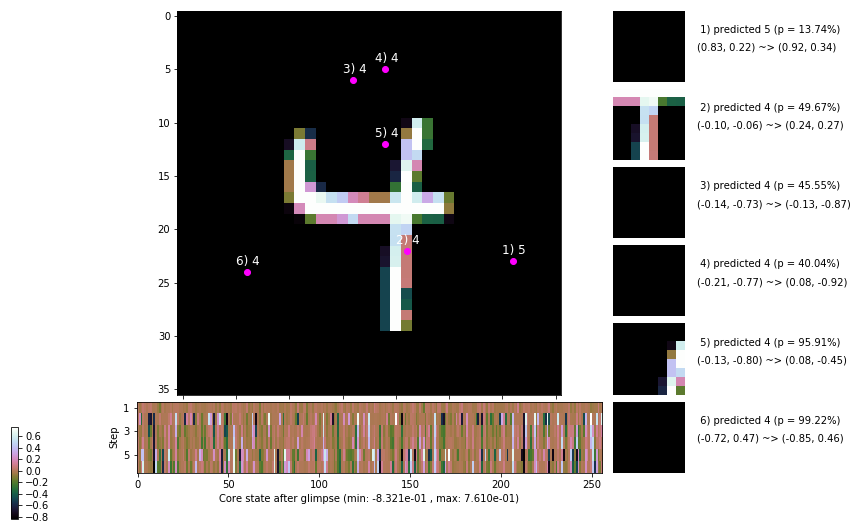

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 152.1 ms/b | lr: 6.80e-04 | grad 2norm:  8.23 | grad inf norm:  2.150
         Weights || abs max:  1.92 ( 6221.46) | mean: -1.64e-04 ( 0.02) | var: 5.81e-02 ( 1781.16)
          Biases || abs max:  1.21 (  217.98) | mean: -1.27e-01 ( 0.18) | var: 7.20e-02 (  268.07)
                    class loss: 0.370 | steps: 2.291 | reward:  4.377 | acc.: 87.47%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.9 ms/b | lr: 6.80e-04 | grad 2norm:  8.32 | grad inf norm:  2.255
         Weights || abs max:  1.93 ( 6292.70) | mean: -1.21e-04 ( 0.02) | var: 5.82e-02 ( 4747.72)
          Biases || abs max:  1.20 (  428.99) | mean: -1.27e-01 ( 0.26) | var: 7.19e-02 ( 2368.49)
                    class loss: 0.392 | steps: 2.318 | reward:  4.350 | acc.: 87.23%

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.1

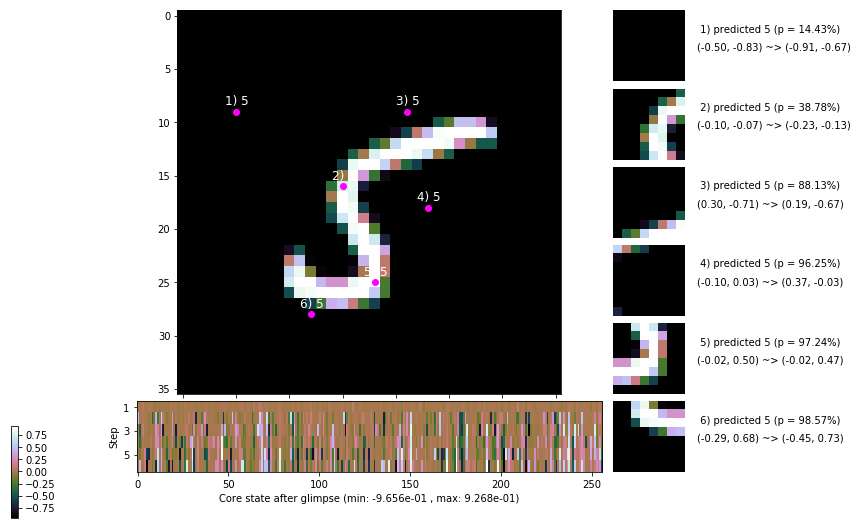

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.7 ms/b | lr: 6.78e-04 | grad 2norm:  8.25 | grad inf norm:  2.249
         Weights || abs max:  1.94 ( 9491.60) | mean: -1.17e-04 ( 0.03) | var: 5.83e-02 (13343.04)
          Biases || abs max:  1.20 (  168.18) | mean: -1.27e-01 ( 0.15) | var: 7.21e-02 (  249.96)
                    class loss: 0.360 | steps: 2.283 | reward:  4.409 | acc.: 87.88%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 151.9 ms/b | lr: 6.78e-04 | grad 2norm:  8.04 | grad inf norm:  2.080
         Weights || abs max:  1.94 ( 4524.94) | mean: -9.72e-05 ( 0.02) | var: 5.84e-02 ( 2018.12)
          Biases || abs max:  1.19 (  335.32) | mean: -1.28e-01 ( 0.24) | var: 7.25e-02 ( 1059.70)
                    class loss: 0.359 | steps: 2.291 | reward:  4.411 | acc.: 88.40%

	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.0

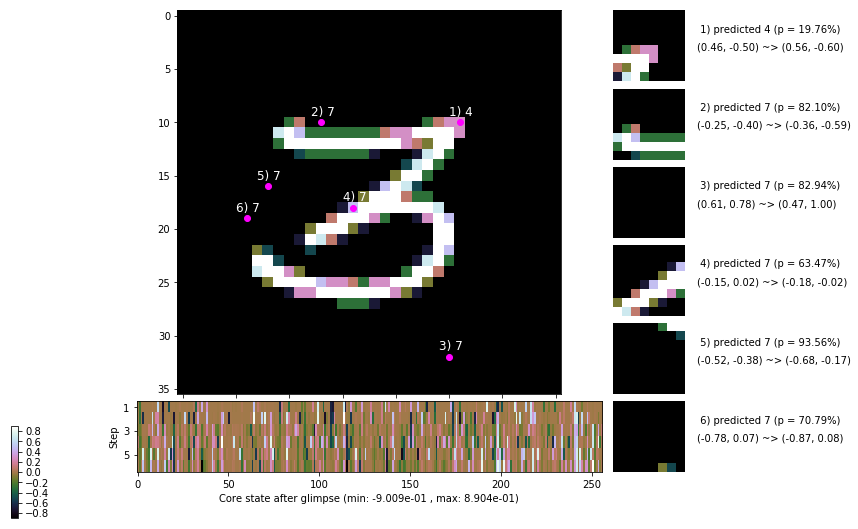

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


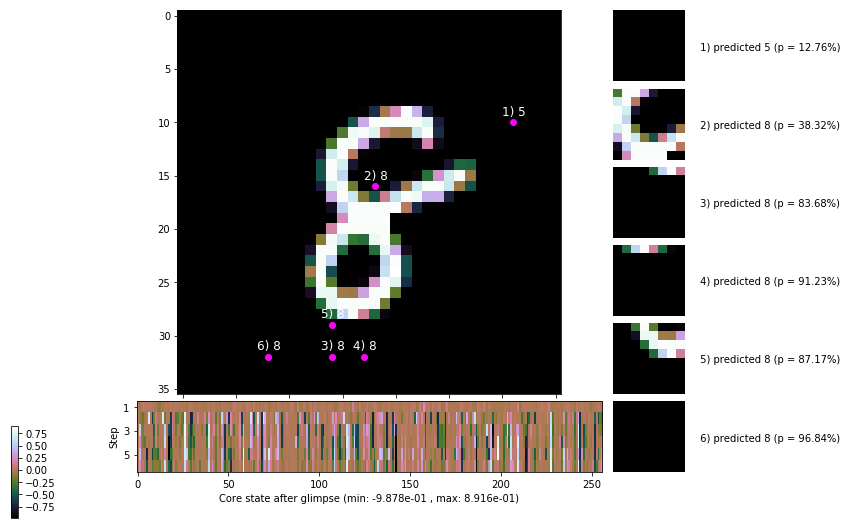


	Target class: 2 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


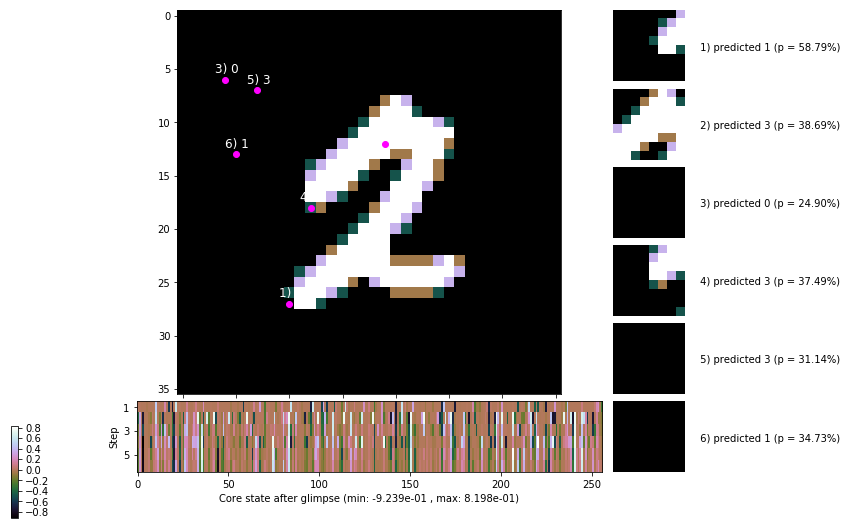

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


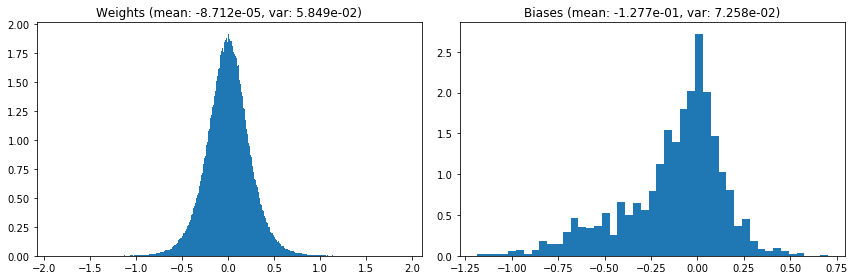

                                      Location network weights and biases


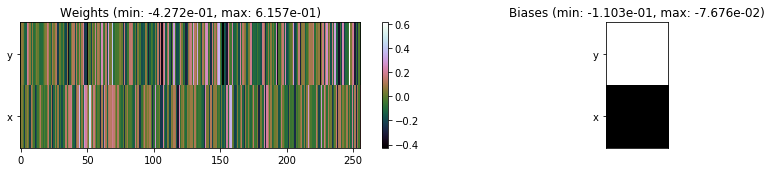

---------------------------------------------------------------------------------------------------------------
Elapsed time:  461.73 sec | TRAIN >> class loss: 0.3751 | steps:  2.319 :( | reward:  4.3612 :( | acc.: 87.568% :(
                          | VAL   >> class loss: 0.3822 | steps:  2.219 :( | reward:  4.4840    | acc.: 87.540% :(


Epoch  27/400) lr = 0.0006769
 b    300/  3000 >> 176.3 ms/b | lr: 6.76e-04 | grad 2norm:  8.36 | grad inf norm:  2.208
         Weights || abs max:  1.93 ( 3775.62) | mean: -7.66e-05 ( 0.02) | var: 5.86e-02 (  290.42)
          Biases || abs max:  1.19 (  161.73) | mean: -1.27e-01 ( 0.15) | var: 7.26e-02 (   67.75)
                    class loss: 0.358 | steps: 2.308 | reward:  4.369 | acc.: 87.53%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.1 ms/b | lr: 6.76e-04 | grad 2norm:  8.22 | grad inf norm:  2.250
         Weights || abs max:  1.92 (38379.89) | mean: -7.17e-05 (

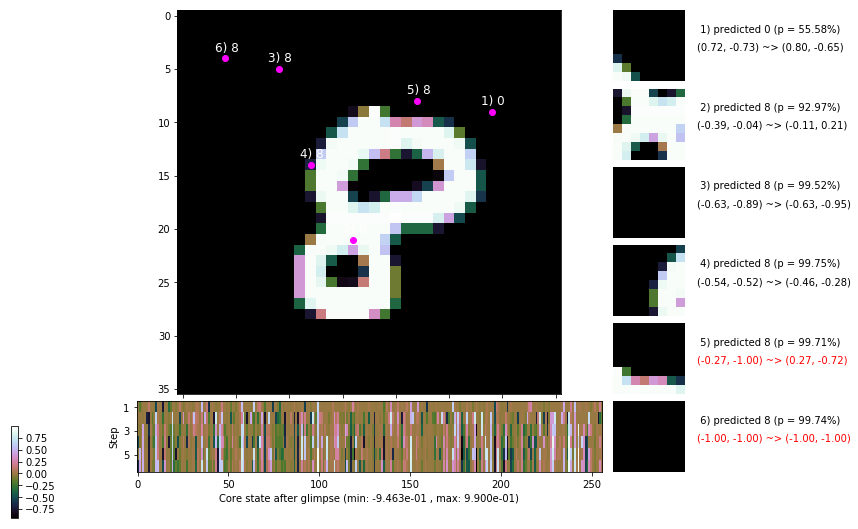

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 156.7 ms/b | lr: 6.74e-04 | grad 2norm:  8.40 | grad inf norm:  2.177
         Weights || abs max:  1.92 ( 7655.09) | mean: -9.47e-05 ( 0.02) | var: 5.87e-02 ( 6141.03)
          Biases || abs max:  1.20 (  116.16) | mean: -1.29e-01 ( 0.14) | var: 7.33e-02 (   47.25)
                    class loss: 0.371 | steps: 2.304 | reward:  4.381 | acc.: 87.97%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 151.8 ms/b | lr: 6.74e-04 | grad 2norm:  8.51 | grad inf norm:  2.226
         Weights || abs max:  1.93 (12396.01) | mean: -1.43e-04 ( 0.03) | var: 5.88e-02 (25513.75)
          Biases || abs max:  1.19 (  137.85) | mean: -1.29e-01 ( 0.15) | var: 7.33e-02 (   90.05)
                    class loss: 0.380 | steps: 2.301 | reward:  4.383 | acc.: 87.53%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.0

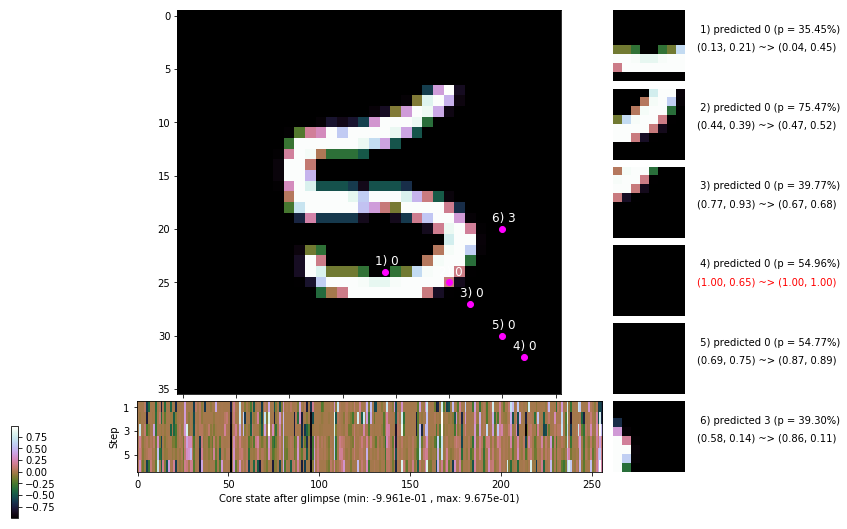

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 156.6 ms/b | lr: 6.72e-04 | grad 2norm:  8.47 | grad inf norm:  2.229
         Weights || abs max:  1.93 ( 3062.73) | mean: -1.43e-04 ( 0.02) | var: 5.89e-02 (  126.40)
          Biases || abs max:  1.19 (  624.05) | mean: -1.29e-01 ( 0.33) | var: 7.33e-02 (13305.81)
                    class loss: 0.381 | steps: 2.321 | reward:  4.341 | acc.: 87.17%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 154.6 ms/b | lr: 6.72e-04 | grad 2norm:  8.07 | grad inf norm:  2.173
         Weights || abs max:  1.92 ( 2678.11) | mean: -1.29e-04 ( 0.02) | var: 5.91e-02 (  126.71)
          Biases || abs max:  1.20 (  188.87) | mean: -1.29e-01 ( 0.16) | var: 7.34e-02 (  429.76)
                    class loss: 0.393 | steps: 2.326 | reward:  4.366 | acc.: 87.17%

	Target class: 2 | Discounted rewards: [1.111, 1.111, 1.1

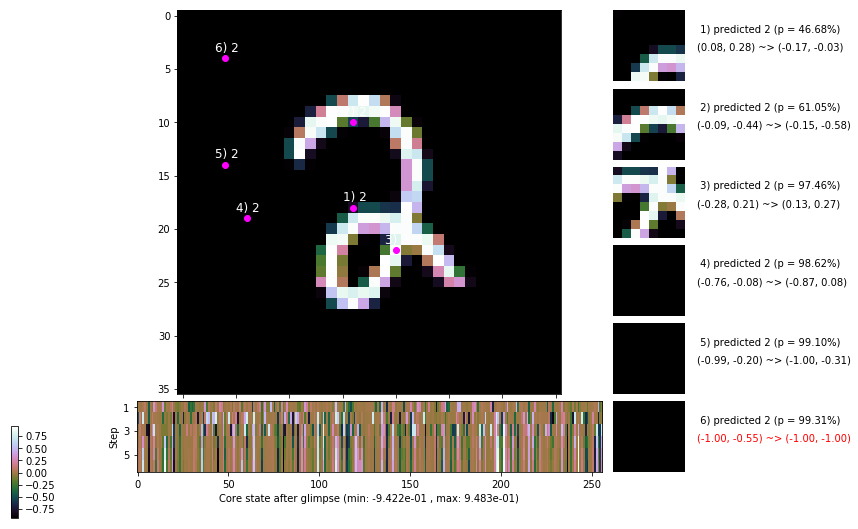

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.4 ms/b | lr: 6.70e-04 | grad 2norm:  8.38 | grad inf norm:  2.274
         Weights || abs max:  1.92 ( 1759.65) | mean: -1.36e-04 ( 0.01) | var: 5.92e-02 (   32.73)
          Biases || abs max:  1.21 (  231.67) | mean: -1.29e-01 ( 0.17) | var: 7.37e-02 ( 1742.12)
                    class loss: 0.403 | steps: 2.299 | reward:  4.363 | acc.: 86.85%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 154.1 ms/b | lr: 6.70e-04 | grad 2norm:  8.23 | grad inf norm:  2.235
         Weights || abs max:  1.92 ( 5912.59) | mean: -1.23e-04 ( 0.02) | var: 5.93e-02 ( 3766.59)
          Biases || abs max:  1.21 (  160.41) | mean: -1.29e-01 ( 0.15) | var: 7.39e-02 (  209.57)
                    class loss: 0.392 | steps: 2.315 | reward:  4.369 | acc.: 87.03%

	Target class: 9 | Discounted rewards: [0.111, 1.111, 1.1

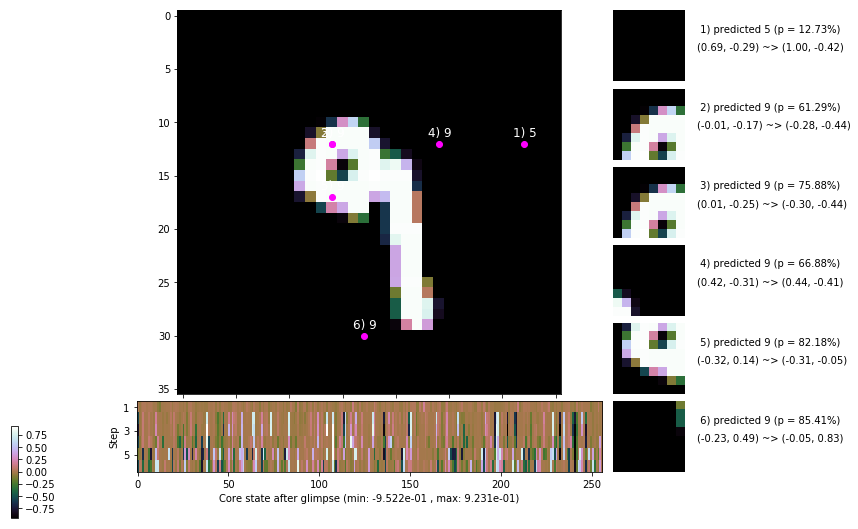

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 155.1 ms/b | lr: 6.68e-04 | grad 2norm:  8.15 | grad inf norm:  2.154
         Weights || abs max:  1.91 ( 4079.38) | mean: -1.68e-04 ( 0.02) | var: 5.94e-02 (  283.81)
          Biases || abs max:  1.20 (  176.36) | mean: -1.30e-01 ( 0.18) | var: 7.42e-02 (  287.06)
                    class loss: 0.425 | steps: 2.337 | reward:  4.327 | acc.: 85.98%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 152.3 ms/b | lr: 6.68e-04 | grad 2norm:  8.18 | grad inf norm:  2.263
         Weights || abs max:  1.91 ( 4040.72) | mean: -1.58e-04 ( 0.02) | var: 5.95e-02 (  354.30)
          Biases || abs max:  1.21 (  191.91) | mean: -1.30e-01 ( 0.18) | var: 7.44e-02 (  287.58)
                    class loss: 0.404 | steps: 2.321 | reward:  4.355 | acc.: 87.00%

	Target class: 1 | Discounted rewards: [0.011, 0.110, 1.1

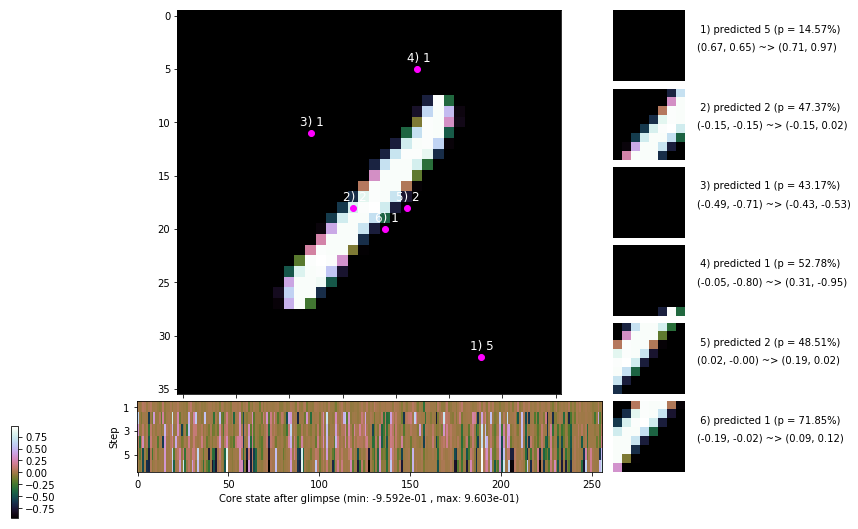

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


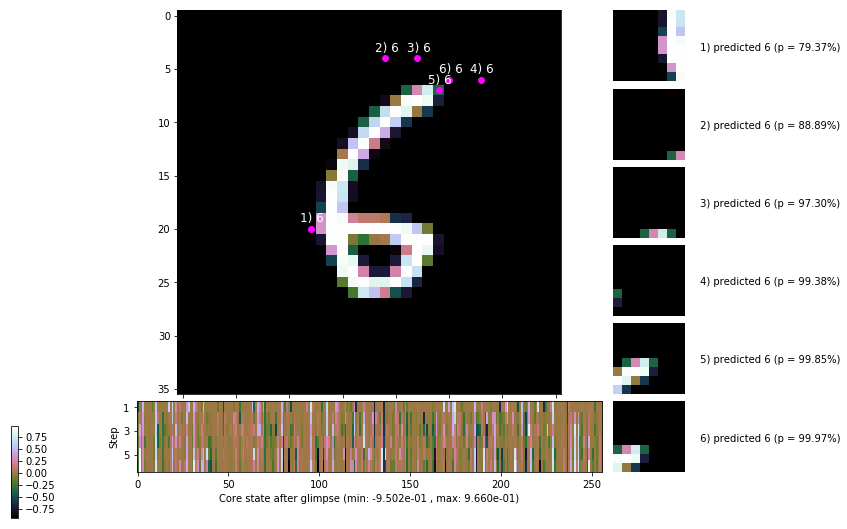


	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


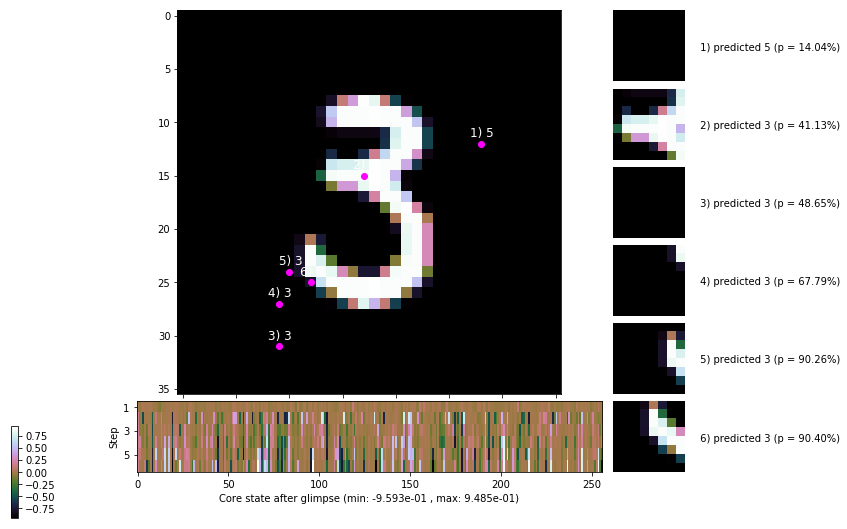

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


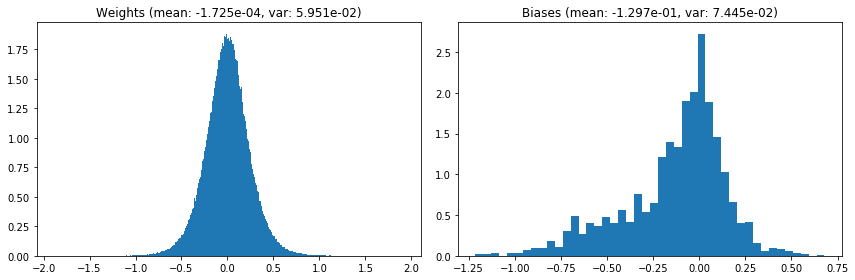

                                      Location network weights and biases


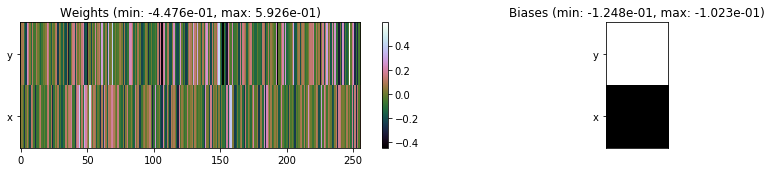

---------------------------------------------------------------------------------------------------------------
Elapsed time:  470.15 sec | TRAIN >> class loss: 0.3890 | steps:  2.317 :( | reward:  4.3598 :( | acc.: 87.150% :(
                          | VAL   >> class loss: 0.4293 | steps:  2.262 :( | reward:  4.4034 :( | acc.: 85.400% :(


Epoch  28/400) lr = 0.0006668
 b    300/  3000 >> 152.8 ms/b | lr: 6.66e-04 | grad 2norm:  8.10 | grad inf norm:  2.173
         Weights || abs max:  1.91 (15282.21) | mean: -1.79e-04 ( 0.04) | var: 5.96e-02 (41560.96)
          Biases || abs max:  1.21 (  935.29) | mean: -1.29e-01 ( 0.47) | var: 7.45e-02 (54458.63)
                    class loss: 0.406 | steps: 2.312 | reward:  4.359 | acc.: 86.68%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 151.3 ms/b | lr: 6.66e-04 | grad 2norm:  8.34 | grad inf norm:  2.281
         Weights || abs max:  1.90 ( 5947.28) | mean: -1.97e-04 (

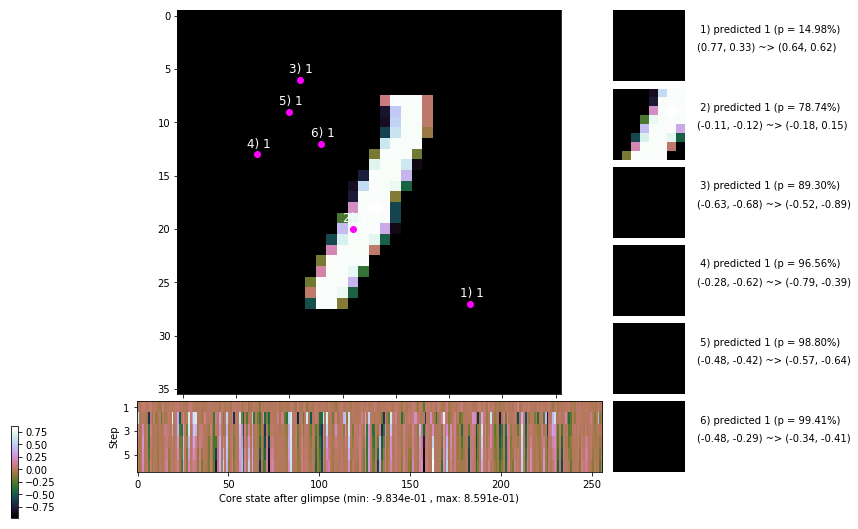

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 161.7 ms/b | lr: 6.64e-04 | grad 2norm:  8.13 | grad inf norm:  2.186
         Weights || abs max:  1.92 ( 8488.73) | mean: -1.99e-04 ( 0.03) | var: 5.98e-02 (17899.53)
          Biases || abs max:  1.21 (  155.09) | mean: -1.30e-01 ( 0.15) | var: 7.48e-02 (  321.82)
                    class loss: 0.393 | steps: 2.307 | reward:  4.369 | acc.: 87.07%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 169.2 ms/b | lr: 6.64e-04 | grad 2norm:  8.22 | grad inf norm:  2.191
         Weights || abs max:  1.94 (10146.18) | mean: -1.82e-04 ( 0.03) | var: 5.99e-02 (17230.22)
          Biases || abs max:  1.20 (  151.85) | mean: -1.30e-01 ( 0.15) | var: 7.50e-02 (  399.18)
                    class loss: 0.393 | steps: 2.316 | reward:  4.351 | acc.: 87.20%

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.1

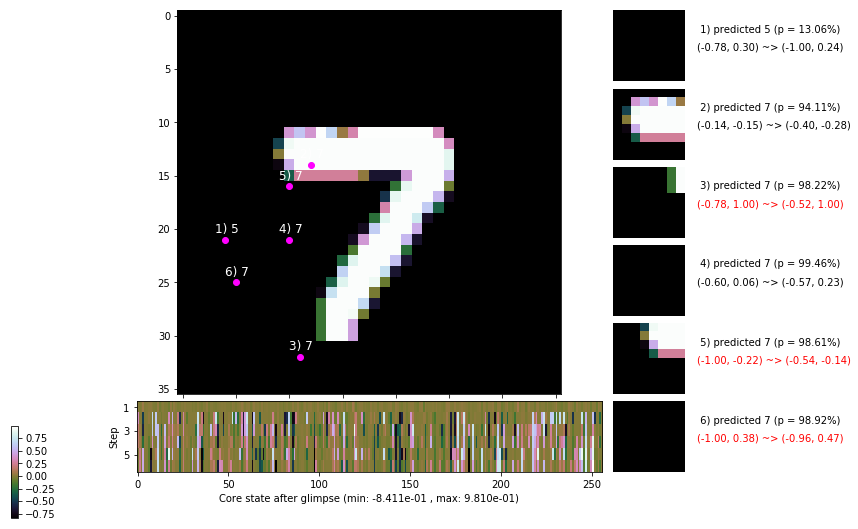

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 163.5 ms/b | lr: 6.62e-04 | grad 2norm:  8.16 | grad inf norm:  2.182
         Weights || abs max:  1.95 ( 3643.14) | mean: -2.13e-04 ( 0.02) | var: 6.00e-02 (  680.95)
          Biases || abs max:  1.20 (  157.35) | mean: -1.30e-01 ( 0.15) | var: 7.52e-02 (  178.13)
                    class loss: 0.373 | steps: 2.305 | reward:  4.376 | acc.: 88.00%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 153.4 ms/b | lr: 6.62e-04 | grad 2norm:  8.18 | grad inf norm:  2.273
         Weights || abs max:  1.95 ( 7728.28) | mean: -2.17e-04 ( 0.03) | var: 6.01e-02 (11221.18)
          Biases || abs max:  1.21 (  278.17) | mean: -1.30e-01 ( 0.18) | var: 7.55e-02 ( 3798.36)
                    class loss: 0.381 | steps: 2.330 | reward:  4.340 | acc.: 87.65%

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.1

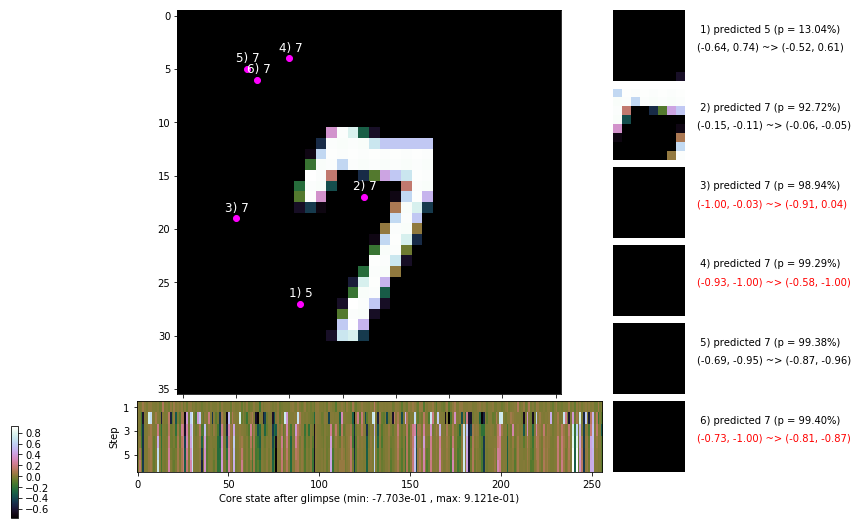

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.8 ms/b | lr: 6.60e-04 | grad 2norm:  8.22 | grad inf norm:  2.171
         Weights || abs max:  1.94 ( 4177.13) | mean: -1.80e-04 ( 0.02) | var: 6.02e-02 ( 1261.02)
          Biases || abs max:  1.21 (  287.92) | mean: -1.30e-01 ( 0.20) | var: 7.57e-02 ( 1427.45)
                    class loss: 0.359 | steps: 2.282 | reward:  4.410 | acc.: 88.35%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 152.9 ms/b | lr: 6.60e-04 | grad 2norm:  8.28 | grad inf norm:  2.175
         Weights || abs max:  1.94 ( 5707.68) | mean: -1.48e-04 ( 0.02) | var: 6.03e-02 ( 2559.16)
          Biases || abs max:  1.22 (  149.18) | mean: -1.31e-01 ( 0.13) | var: 7.60e-02 (  157.91)
                    class loss: 0.390 | steps: 2.322 | reward:  4.352 | acc.: 87.42%

	Target class: 2 | Discounted rewards: [0.011, 0.111, 1.1

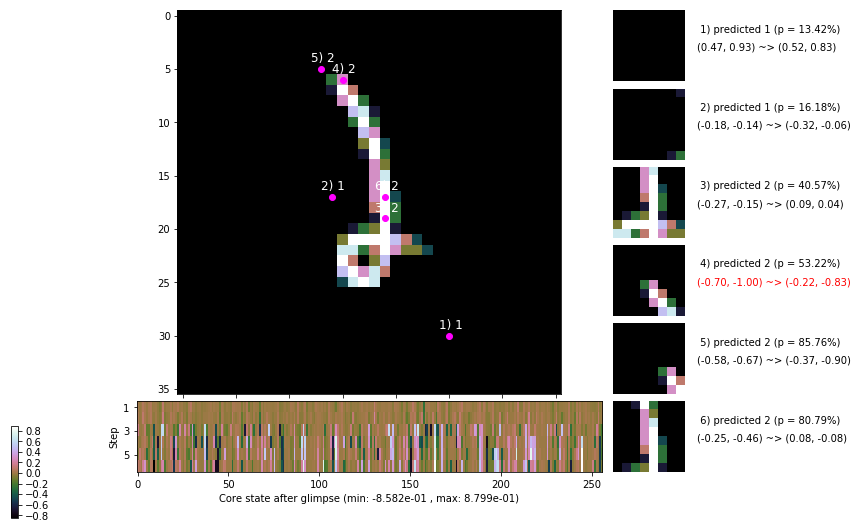

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.0 ms/b | lr: 6.58e-04 | grad 2norm:  8.49 | grad inf norm:  2.314
         Weights || abs max:  1.95 ( 3237.38) | mean: -1.54e-04 ( 0.02) | var: 6.04e-02 (  311.57)
          Biases || abs max:  1.23 (  112.81) | mean: -1.31e-01 ( 0.13) | var: 7.60e-02 (   68.79)
                    class loss: 0.372 | steps: 2.312 | reward:  4.359 | acc.: 87.83%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 150.0 ms/b | lr: 6.58e-04 | grad 2norm:  8.13 | grad inf norm:  2.117
         Weights || abs max:  1.95 ( 6616.12) | mean: -1.29e-04 ( 0.02) | var: 6.05e-02 ( 3845.07)
          Biases || abs max:  1.23 (  141.58) | mean: -1.31e-01 ( 0.13) | var: 7.61e-02 (  147.03)
                    class loss: 0.360 | steps: 2.323 | reward:  4.354 | acc.: 88.17%

	Target class: 0 | Discounted rewards: [0.011, 0.110, 1.1

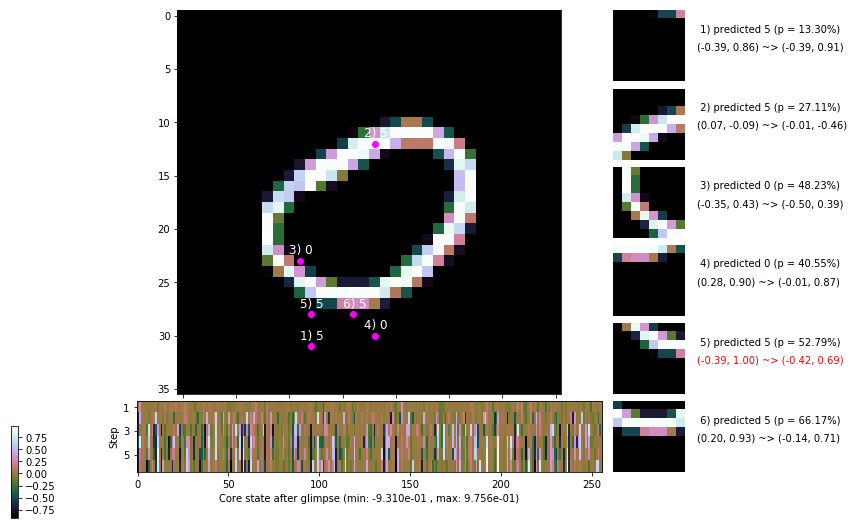

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


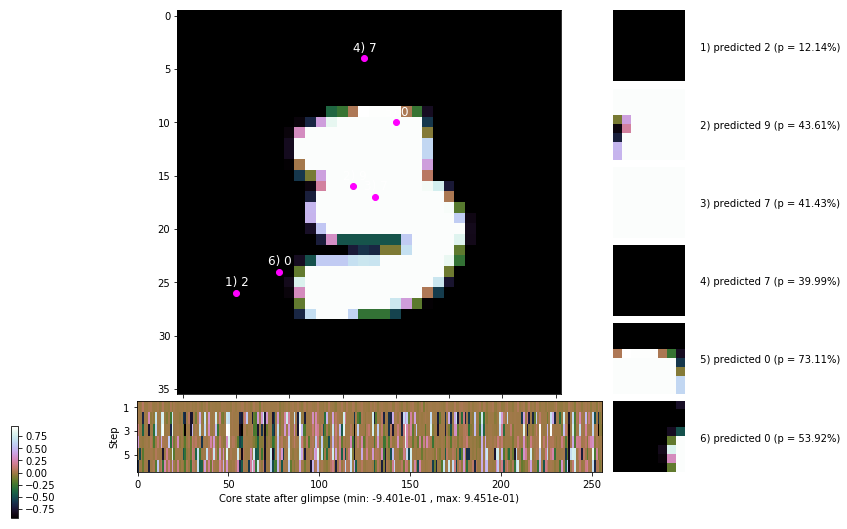


	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


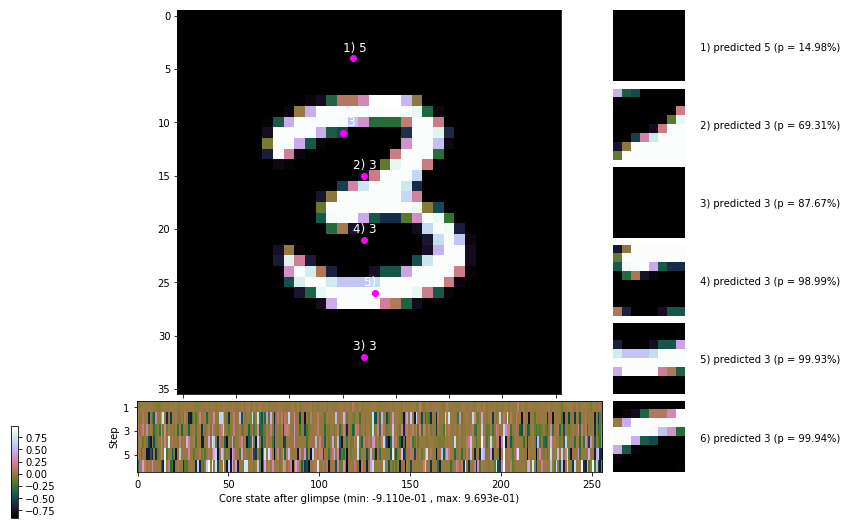

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


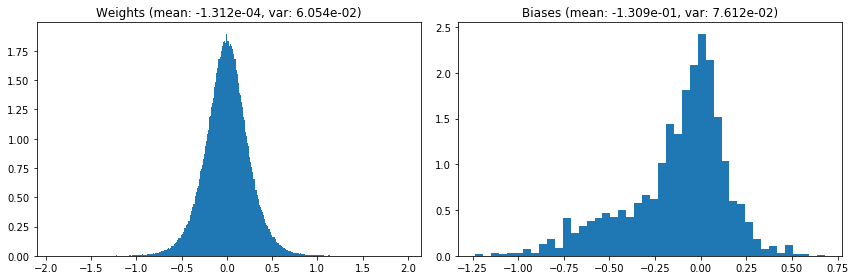

                                      Location network weights and biases


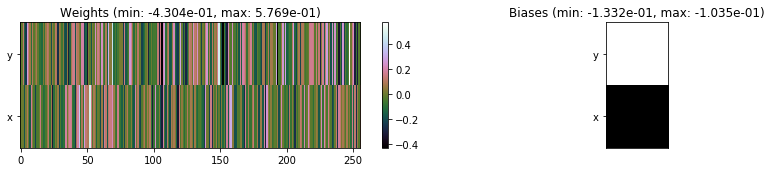

---------------------------------------------------------------------------------------------------------------
Elapsed time:  469.77 sec | TRAIN >> class loss: 0.3818 | steps:  2.313 :( | reward:  4.3604 :( | acc.: 87.462% :(
                          | VAL   >> class loss: 0.3715 | steps:  2.211 :( | reward:  4.4760 :( | acc.: 87.800% :(


Epoch  29/400) lr = 0.0006569
 b    300/  3000 >> 154.7 ms/b | lr: 6.56e-04 | grad 2norm:  8.18 | grad inf norm:  2.223
         Weights || abs max:  1.96 ( 2877.19) | mean: -1.45e-04 ( 0.02) | var: 6.06e-02 (  134.30)
          Biases || abs max:  1.24 (  647.29) | mean: -1.31e-01 ( 0.33) | var: 7.62e-02 (23853.07)
                    class loss: 0.369 | steps: 2.307 | reward:  4.367 | acc.: 87.90%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 151.2 ms/b | lr: 6.56e-04 | grad 2norm:  8.13 | grad inf norm:  2.096
         Weights || abs max:  1.98 ( 3300.18) | mean: -1.83e-04 (

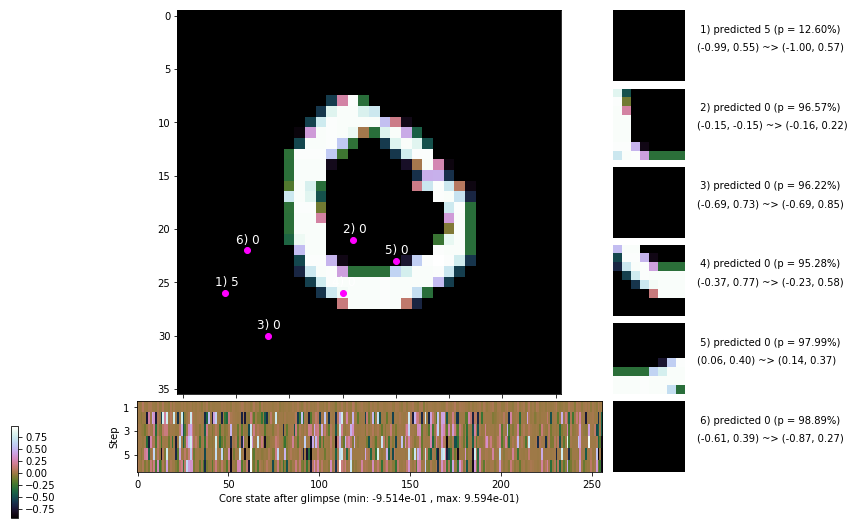

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 156.0 ms/b | lr: 6.54e-04 | grad 2norm:  8.12 | grad inf norm:  2.118
         Weights || abs max:  1.97 (80928.51) | mean: -1.62e-04 ( 0.16) | var: 6.08e-02 (1997257.75)
          Biases || abs max:  1.25 (  158.18) | mean: -1.32e-01 ( 0.14) | var: 7.67e-02 (  322.75)
                    class loss: 0.352 | steps: 2.314 | reward:  4.396 | acc.: 88.48%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 154.0 ms/b | lr: 6.54e-04 | grad 2norm:  8.17 | grad inf norm:  2.131
         Weights || abs max:  1.97 ( 2291.02) | mean: -2.21e-04 ( 0.01) | var: 6.09e-02 (   58.05)
          Biases || abs max:  1.25 (   77.44) | mean: -1.31e-01 ( 0.10) | var: 7.66e-02 (   21.20)
                    class loss: 0.364 | steps: 2.330 | reward:  4.366 | acc.: 88.37%

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1

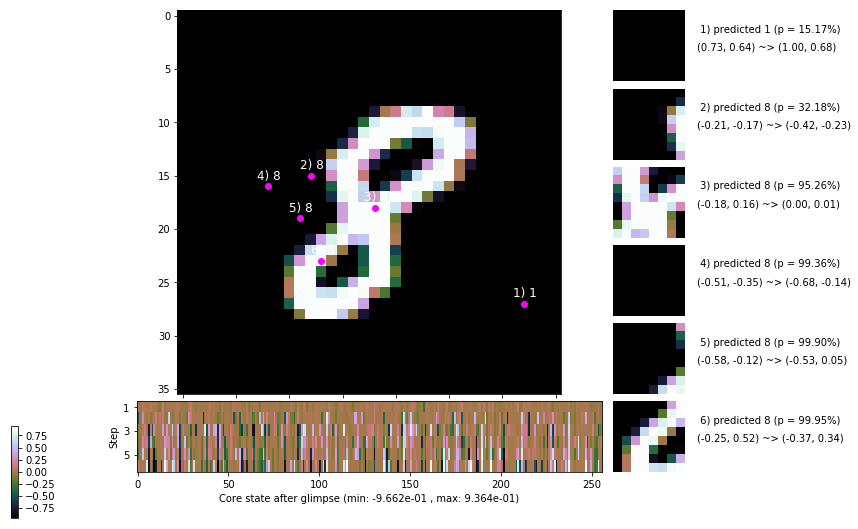

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 153.4 ms/b | lr: 6.52e-04 | grad 2norm:  8.31 | grad inf norm:  2.237
         Weights || abs max:  1.98 ( 6549.64) | mean: -2.58e-04 ( 0.02) | var: 6.10e-02 ( 2597.03)
          Biases || abs max:  1.26 (  245.91) | mean: -1.32e-01 ( 0.17) | var: 7.68e-02 ( 1251.71)
                    class loss: 0.349 | steps: 2.324 | reward:  4.365 | acc.: 88.32%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 162.3 ms/b | lr: 6.52e-04 | grad 2norm:  7.86 | grad inf norm:  2.084
         Weights || abs max:  1.97 ( 3541.99) | mean: -2.38e-04 ( 0.02) | var: 6.11e-02 (  161.60)
          Biases || abs max:  1.24 (   68.00) | mean: -1.32e-01 ( 0.09) | var: 7.69e-02 (   14.78)
                    class loss: 0.355 | steps: 2.296 | reward:  4.393 | acc.: 87.82%

	Target class: 7 | Discounted rewards: [1.010, 0.101, 1.0

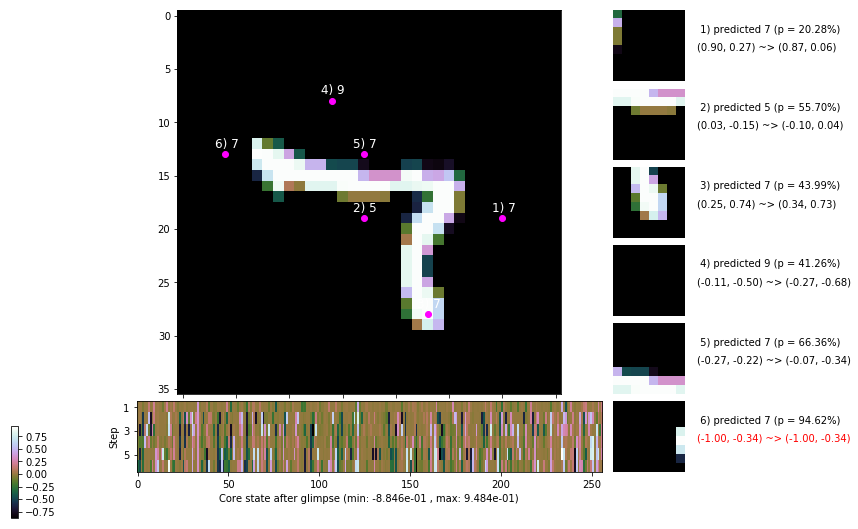

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 166.9 ms/b | lr: 6.50e-04 | grad 2norm:  8.07 | grad inf norm:  2.234
         Weights || abs max:  1.96 ( 5283.61) | mean: -2.39e-04 ( 0.02) | var: 6.12e-02 ( 1310.24)
          Biases || abs max:  1.25 (   89.16) | mean: -1.32e-01 ( 0.10) | var: 7.69e-02 (   46.04)
                    class loss: 0.344 | steps: 2.266 | reward:  4.441 | acc.: 89.02%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 161.4 ms/b | lr: 6.50e-04 | grad 2norm:  8.38 | grad inf norm:  2.279
         Weights || abs max:  1.96 (11405.09) | mean: -2.23e-04 ( 0.03) | var: 6.13e-02 (11029.52)
          Biases || abs max:  1.25 ( 2175.48) | mean: -1.32e-01 ( 0.92) | var: 7.70e-02 (496832.38)
                    class loss: 0.384 | steps: 2.305 | reward:  4.367 | acc.: 87.73%

	Target class: 8 | Discounted rewards: [0.011, 0.111, 1.

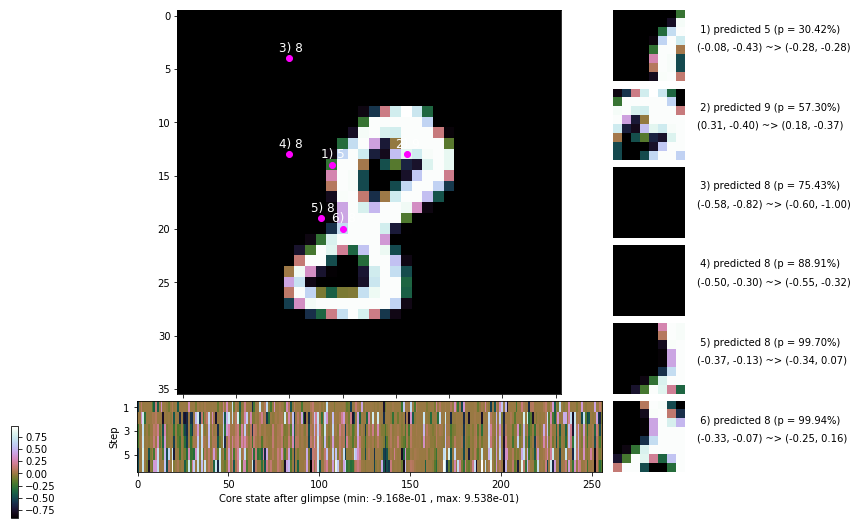

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 158.5 ms/b | lr: 6.48e-04 | grad 2norm:  8.20 | grad inf norm:  2.183
         Weights || abs max:  1.96 ( 3274.62) | mean: -2.49e-04 ( 0.02) | var: 6.14e-02 (  258.66)
          Biases || abs max:  1.26 (  117.70) | mean: -1.32e-01 ( 0.12) | var: 7.72e-02 (   70.72)
                    class loss: 0.390 | steps: 2.312 | reward:  4.368 | acc.: 87.47%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 152.5 ms/b | lr: 6.48e-04 | grad 2norm:  8.47 | grad inf norm:  2.237
         Weights || abs max:  1.96 ( 4130.42) | mean: -2.78e-04 ( 0.02) | var: 6.15e-02 (  370.14)
          Biases || abs max:  1.27 (  149.56) | mean: -1.32e-01 ( 0.13) | var: 7.72e-02 (  144.81)
                    class loss: 0.397 | steps: 2.303 | reward:  4.367 | acc.: 87.18%

	Target class: 8 | Discounted rewards: [0.011, 0.110, 1.1

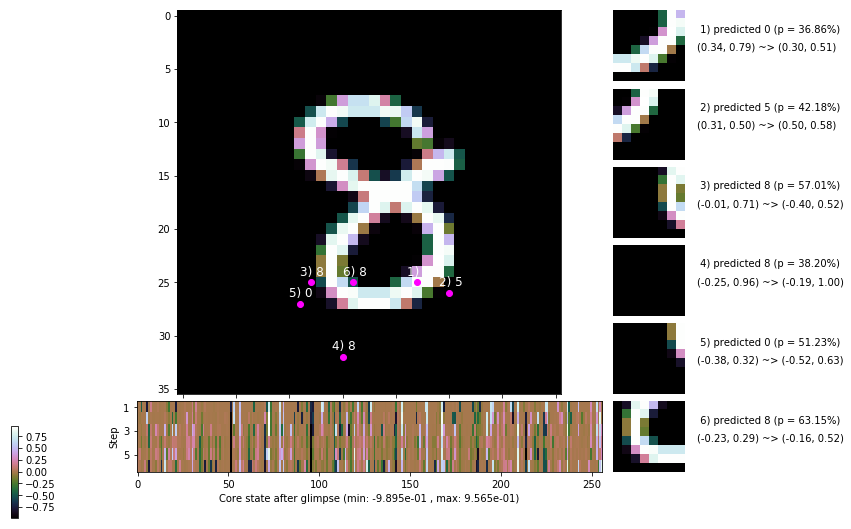

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.011, 0.111, 1.111, 1.110, 1.100, 1.000]


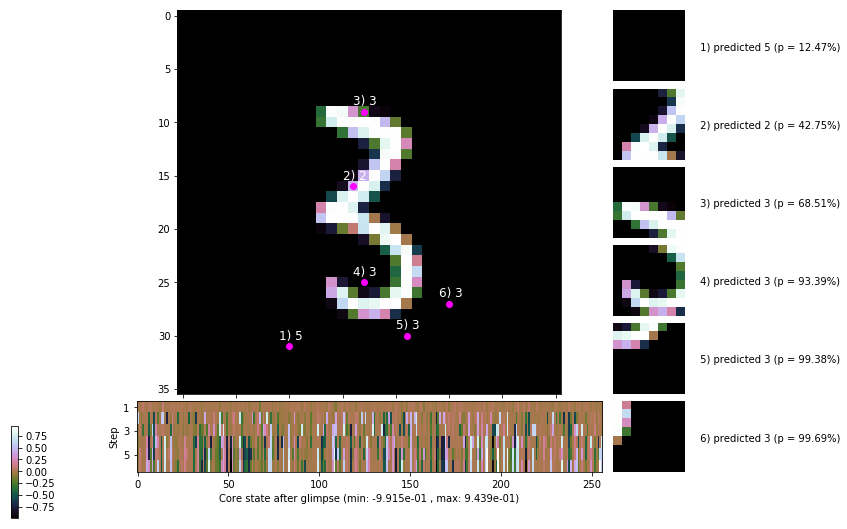


	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


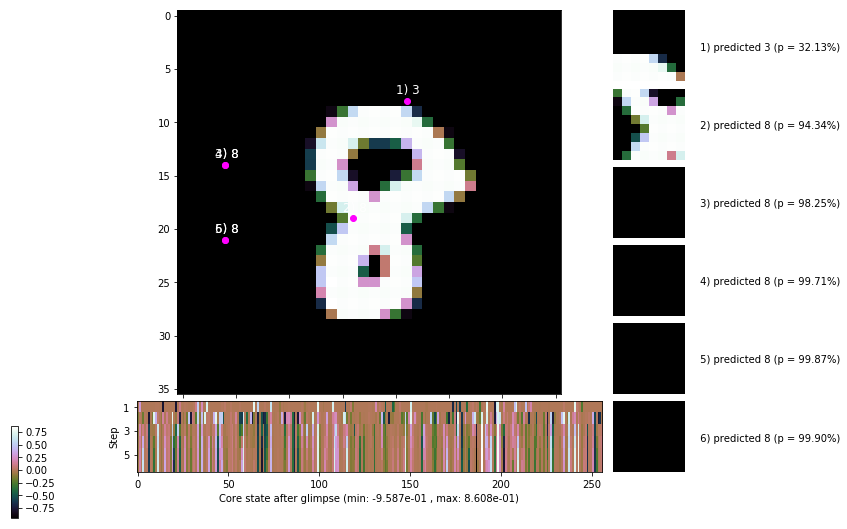

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


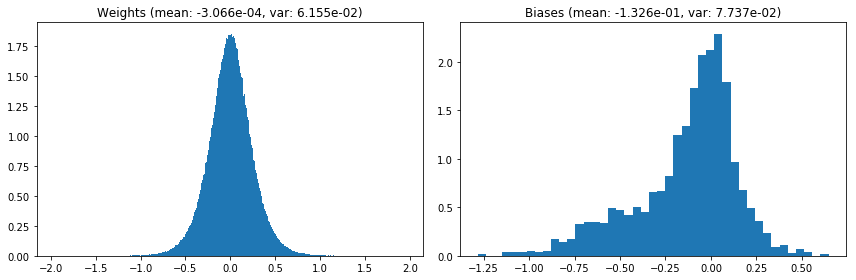

                                      Location network weights and biases


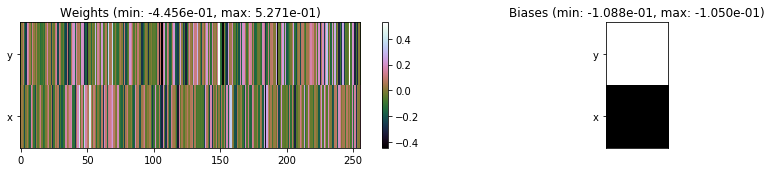

---------------------------------------------------------------------------------------------------------------
Elapsed time:  471.87 sec | TRAIN >> class loss: 0.3673 | steps:  2.306    | reward:  4.3816    | acc.: 87.985% :(
                          | VAL   >> class loss: 0.3856 | steps:  2.217 :( | reward:  4.4706 :( | acc.: 86.720% :(


Epoch  30/400) lr = 0.0006471
 b    300/  3000 >> 154.0 ms/b | lr: 6.46e-04 | grad 2norm:  8.43 | grad inf norm:  2.269
         Weights || abs max:  1.96 ( 7460.24) | mean: -3.08e-04 ( 0.02) | var: 6.16e-02 ( 7209.59)
          Biases || abs max:  1.28 (  128.35) | mean: -1.32e-01 ( 0.12) | var: 7.74e-02 (  277.90)
                    class loss: 0.374 | steps: 2.283 | reward:  4.406 | acc.: 87.82%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.3 ms/b | lr: 6.46e-04 | grad 2norm:  8.44 | grad inf norm:  2.220
         Weights || abs max:  1.97 (11146.43) | mean: -2.83e-04 (

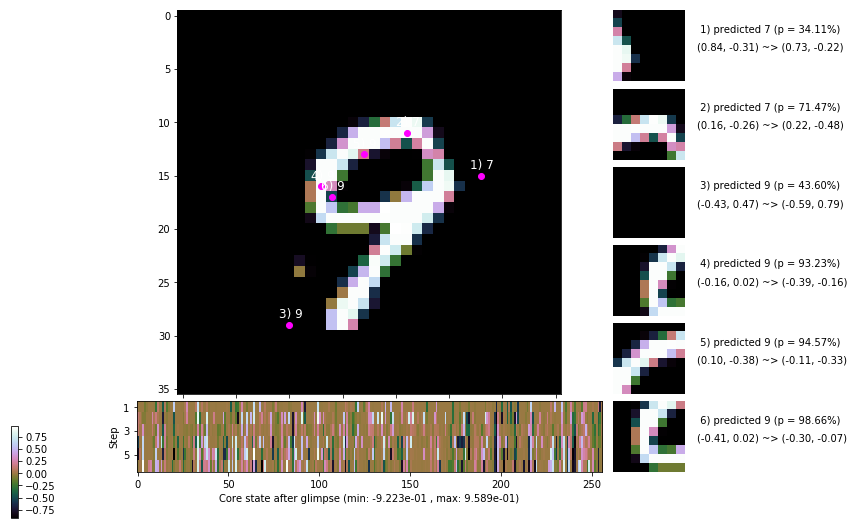

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 153.7 ms/b | lr: 6.45e-04 | grad 2norm:  8.07 | grad inf norm:  2.204
         Weights || abs max:  1.98 ( 3025.98) | mean: -2.67e-04 ( 0.02) | var: 6.18e-02 (  283.97)
          Biases || abs max:  1.27 (  170.39) | mean: -1.33e-01 ( 0.14) | var: 7.80e-02 (  482.81)
                    class loss: 0.373 | steps: 2.300 | reward:  4.390 | acc.: 87.97%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 152.2 ms/b | lr: 6.44e-04 | grad 2norm:  8.06 | grad inf norm:  2.225
         Weights || abs max:  1.98 ( 5143.97) | mean: -2.95e-04 ( 0.02) | var: 6.19e-02 ( 2295.12)
          Biases || abs max:  1.27 (  132.80) | mean: -1.32e-01 ( 0.13) | var: 7.80e-02 (  183.68)
                    class loss: 0.368 | steps: 2.306 | reward:  4.391 | acc.: 87.73%

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.1

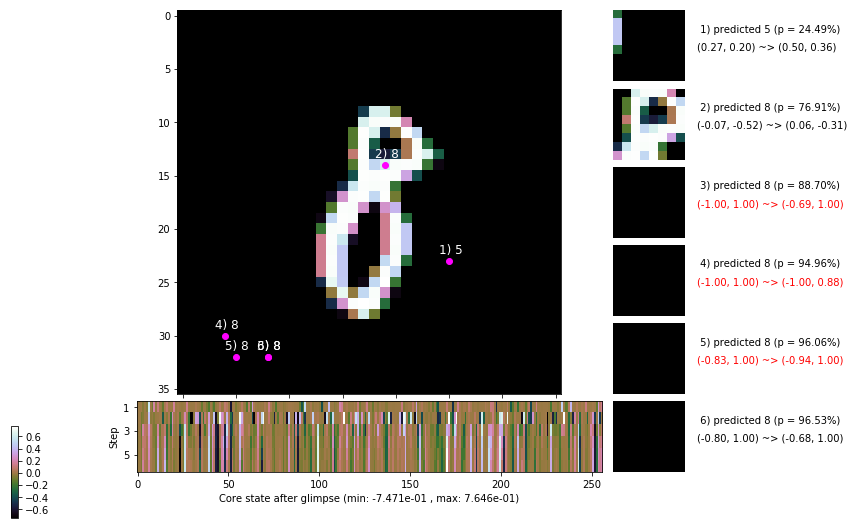

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 152.6 ms/b | lr: 6.43e-04 | grad 2norm:  8.18 | grad inf norm:  2.224
         Weights || abs max:  1.98 ( 3421.18) | mean: -3.03e-04 ( 0.02) | var: 6.19e-02 (  139.40)
          Biases || abs max:  1.28 (  175.74) | mean: -1.33e-01 ( 0.15) | var: 7.82e-02 (  693.04)
                    class loss: 0.395 | steps: 2.312 | reward:  4.360 | acc.: 86.78%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.6 ms/b | lr: 6.42e-04 | grad 2norm:  8.20 | grad inf norm:  2.221
         Weights || abs max:  1.99 ( 4776.00) | mean: -2.65e-04 ( 0.02) | var: 6.20e-02 (  562.99)
          Biases || abs max:  1.27 (  256.07) | mean: -1.33e-01 ( 0.18) | var: 7.83e-02 ( 2203.62)
                    class loss: 0.394 | steps: 2.334 | reward:  4.343 | acc.: 87.05%

	Target class: 2 | Discounted rewards: [0.111, 1.111, 1.1

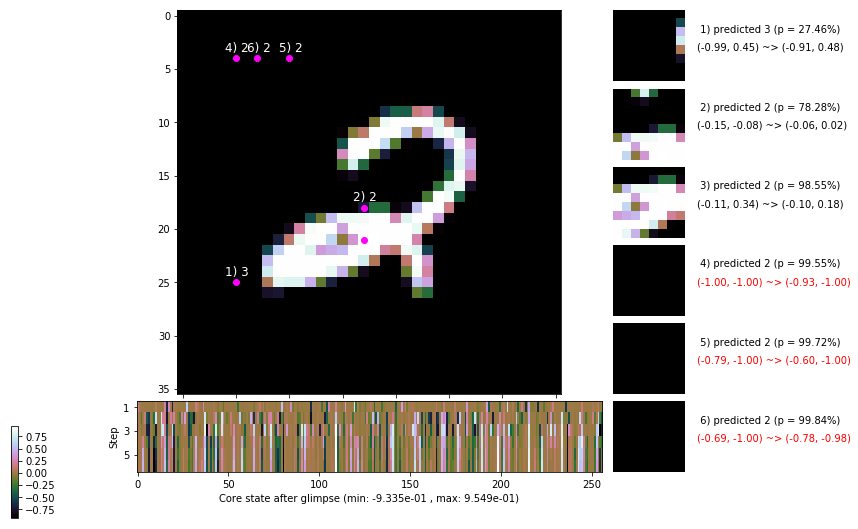

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 153.6 ms/b | lr: 6.41e-04 | grad 2norm:  7.95 | grad inf norm:  2.177
         Weights || abs max:  2.01 ( 4216.09) | mean: -2.63e-04 ( 0.02) | var: 6.21e-02 (  630.09)
          Biases || abs max:  1.27 (  242.88) | mean: -1.33e-01 ( 0.22) | var: 7.85e-02 ( 1765.66)
                    class loss: 0.406 | steps: 2.323 | reward:  4.344 | acc.: 86.92%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 154.6 ms/b | lr: 6.40e-04 | grad 2norm:  8.27 | grad inf norm:  2.174
         Weights || abs max:  2.02 ( 4827.45) | mean: -2.99e-04 ( 0.02) | var: 6.22e-02 (  715.98)
          Biases || abs max:  1.27 (  308.16) | mean: -1.33e-01 ( 0.25) | var: 7.86e-02 ( 3640.55)
                    class loss: 0.406 | steps: 2.321 | reward:  4.339 | acc.: 86.55%

	Target class: 4 | Discounted rewards: [0.011, 0.111, 1.1

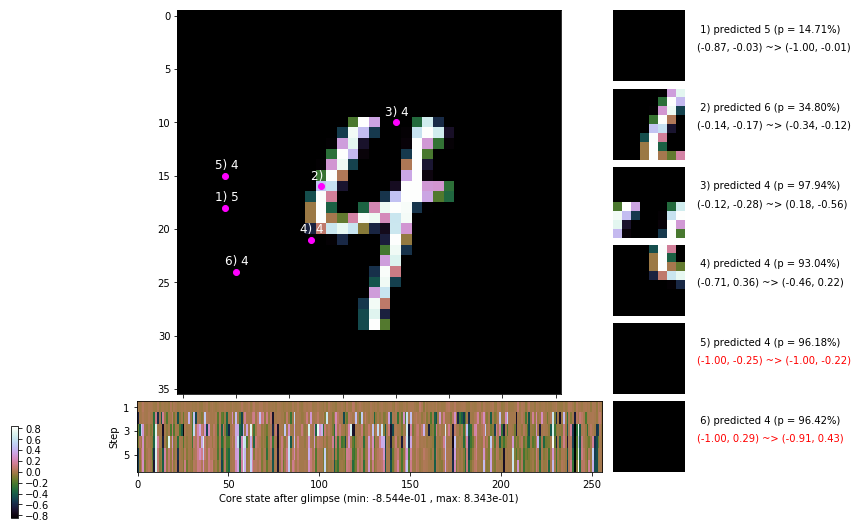

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 169.3 ms/b | lr: 6.39e-04 | grad 2norm:  8.19 | grad inf norm:  2.314
         Weights || abs max:  2.02 ( 2897.83) | mean: -2.95e-04 ( 0.02) | var: 6.23e-02 (  105.77)
          Biases || abs max:  1.27 (  134.85) | mean: -1.33e-01 ( 0.15) | var: 7.85e-02 (  135.41)
                    class loss: 0.412 | steps: 2.318 | reward:  4.343 | acc.: 86.32%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 163.1 ms/b | lr: 6.38e-04 | grad 2norm:  8.17 | grad inf norm:  2.216
         Weights || abs max:  2.01 ( 3531.10) | mean: -2.88e-04 ( 0.02) | var: 6.24e-02 (  445.89)
          Biases || abs max:  1.27 (  872.40) | mean: -1.33e-01 ( 0.48) | var: 7.85e-02 (38829.88)
                    class loss: 0.411 | steps: 2.329 | reward:  4.337 | acc.: 86.38%

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.1

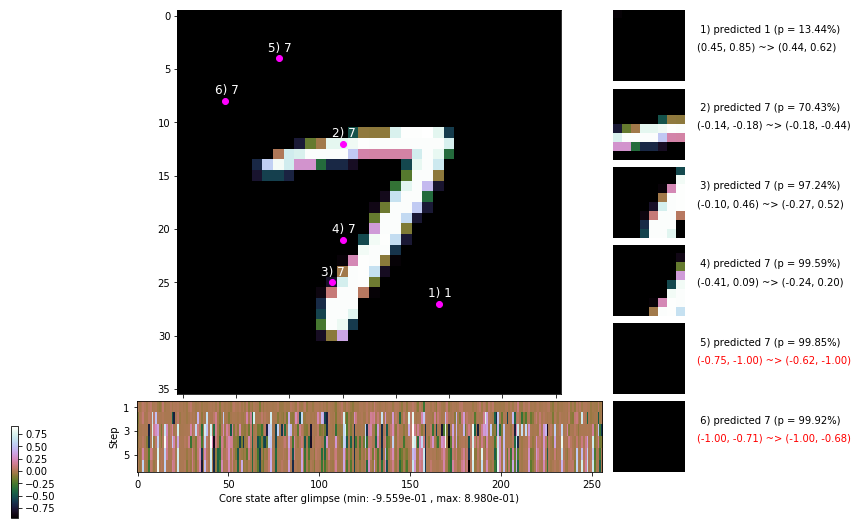

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.101, 1.011, 0.111, 1.110, 1.100, 1.000]


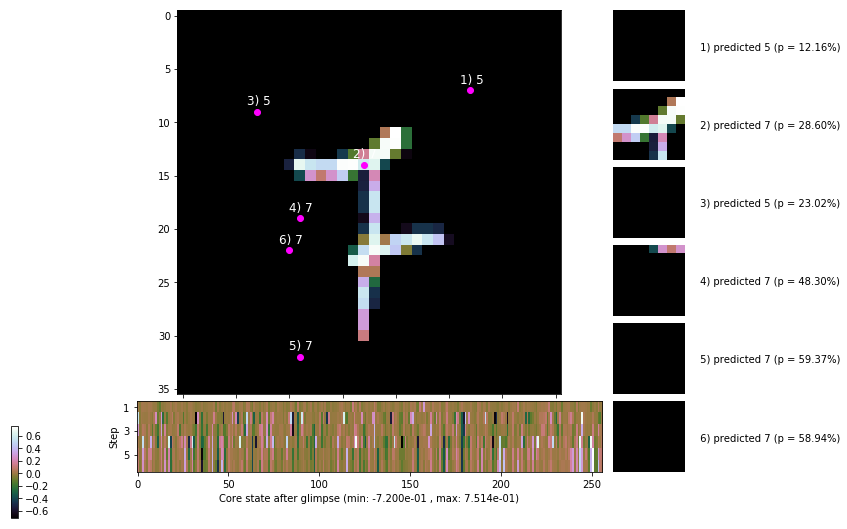


	Target class: 9 | Discounted rewards: [0.011, 0.111, 1.111, 1.110, 1.100, 1.000]


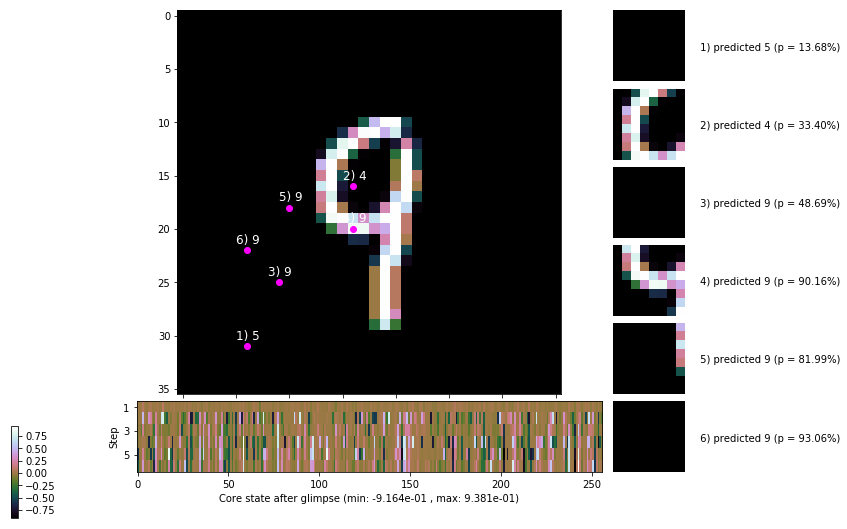

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


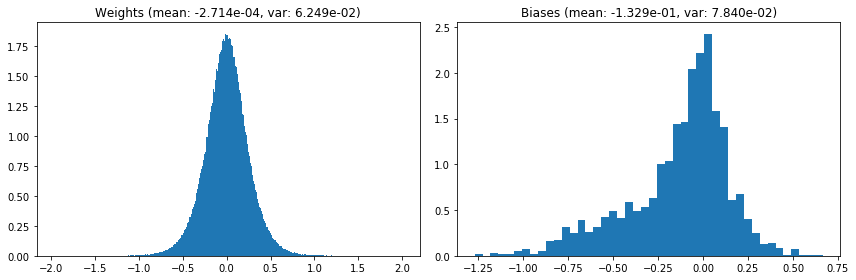

                                      Location network weights and biases


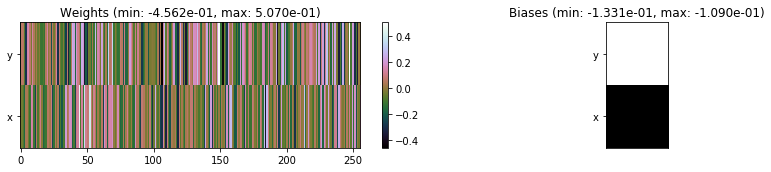

---------------------------------------------------------------------------------------------------------------
Elapsed time:  468.33 sec | TRAIN >> class loss: 0.3926 | steps:  2.312 :( | reward:  4.3633 :( | acc.: 87.117% :(
                          | VAL   >> class loss: 0.4547 | steps:  2.280 :( | reward:  4.3770 :( | acc.: 84.320% :(


Epoch  31/400) lr = 0.0006375
 b    300/  3000 >> 159.5 ms/b | lr: 6.37e-04 | grad 2norm:  8.43 | grad inf norm:  2.297
         Weights || abs max:  2.00 ( 6414.93) | mean: -2.80e-04 ( 0.02) | var: 6.25e-02 ( 6522.17)
          Biases || abs max:  1.27 (  148.38) | mean: -1.33e-01 ( 0.12) | var: 7.86e-02 (  484.93)
                    class loss: 0.439 | steps: 2.371 | reward:  4.282 | acc.: 85.32%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.3 ms/b | lr: 6.36e-04 | grad 2norm:  8.32 | grad inf norm:  2.311
         Weights || abs max:  1.99 (11631.40) | mean: -2.74e-04 (

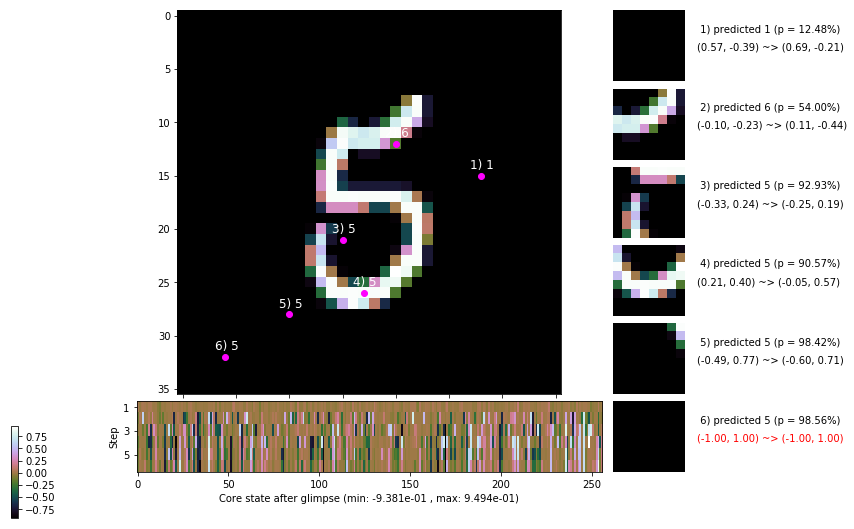

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 157.6 ms/b | lr: 6.35e-04 | grad 2norm:  8.48 | grad inf norm:  2.287
         Weights || abs max:  2.00 ( 5832.37) | mean: -2.68e-04 ( 0.02) | var: 6.27e-02 ( 1083.82)
          Biases || abs max:  1.27 (  106.40) | mean: -1.34e-01 ( 0.12) | var: 7.90e-02 (   31.13)
                    class loss: 0.402 | steps: 2.319 | reward:  4.343 | acc.: 86.15%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 154.4 ms/b | lr: 6.34e-04 | grad 2norm:  8.13 | grad inf norm:  2.195
         Weights || abs max:  1.99 ( 4145.13) | mean: -2.85e-04 ( 0.02) | var: 6.28e-02 (  438.21)
          Biases || abs max:  1.27 (  105.50) | mean: -1.34e-01 ( 0.11) | var: 7.92e-02 (   44.81)
                    class loss: 0.387 | steps: 2.319 | reward:  4.356 | acc.: 87.23%

	Target class: 6 | Discounted rewards: [0.111, 1.111, 1.1

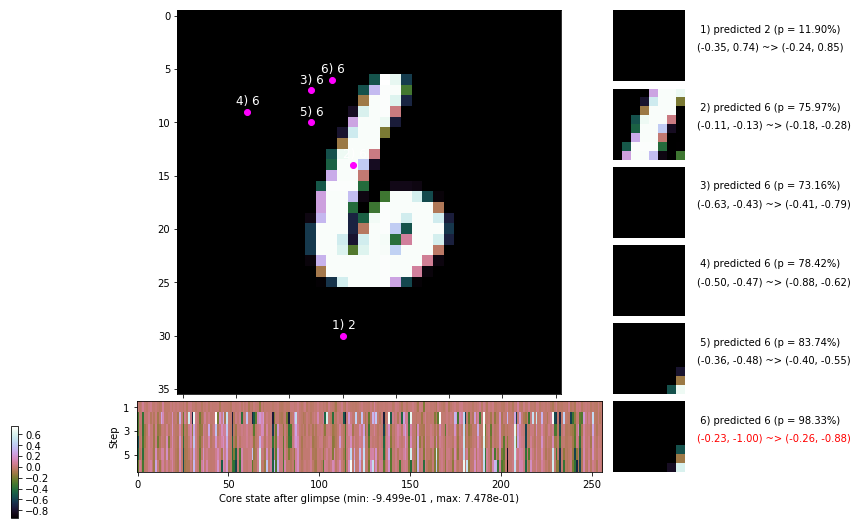

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 155.3 ms/b | lr: 6.33e-04 | grad 2norm:  8.40 | grad inf norm:  2.251
         Weights || abs max:  2.00 ( 6027.07) | mean: -2.98e-04 ( 0.02) | var: 6.29e-02 ( 1809.48)
          Biases || abs max:  1.27 (  106.17) | mean: -1.35e-01 ( 0.12) | var: 7.93e-02 (   73.44)
                    class loss: 0.402 | steps: 2.307 | reward:  4.368 | acc.: 86.85%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 153.2 ms/b | lr: 6.32e-04 | grad 2norm:  8.20 | grad inf norm:  2.322
         Weights || abs max:  1.99 ( 3947.07) | mean: -3.35e-04 ( 0.02) | var: 6.30e-02 (  460.78)
          Biases || abs max:  1.27 (  153.43) | mean: -1.35e-01 ( 0.15) | var: 7.95e-02 (  178.89)
                    class loss: 0.379 | steps: 2.291 | reward:  4.390 | acc.: 87.35%

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.1

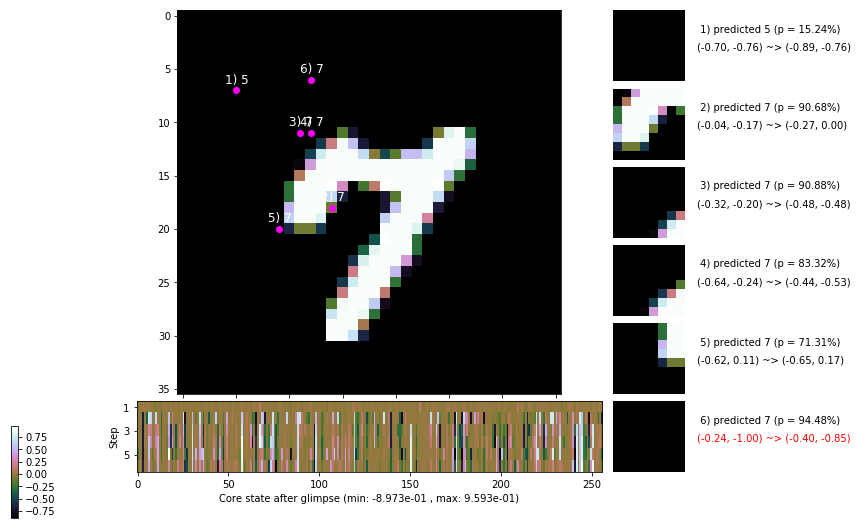

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.3 ms/b | lr: 6.31e-04 | grad 2norm:  8.31 | grad inf norm:  2.286
         Weights || abs max:  1.99 ( 3729.86) | mean: -2.79e-04 ( 0.02) | var: 6.31e-02 (  300.90)
          Biases || abs max:  1.27 (  125.60) | mean: -1.34e-01 ( 0.13) | var: 7.95e-02 (   49.72)
                    class loss: 0.368 | steps: 2.295 | reward:  4.381 | acc.: 87.52%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.5 ms/b | lr: 6.31e-04 | grad 2norm:  8.32 | grad inf norm:  2.232
         Weights || abs max:  2.00 ( 6159.65) | mean: -2.50e-04 ( 0.02) | var: 6.31e-02 ( 2245.75)
          Biases || abs max:  1.27 (  127.18) | mean: -1.34e-01 ( 0.14) | var: 7.96e-02 (  146.95)
                    class loss: 0.368 | steps: 2.283 | reward:  4.423 | acc.: 87.85%

	Target class: 4 | Discounted rewards: [1.111, 1.111, 1.1

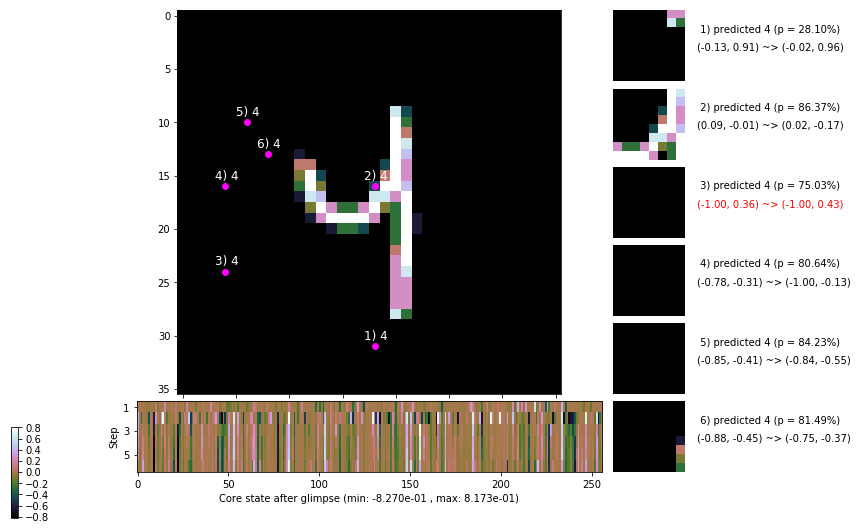

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 155.1 ms/b | lr: 6.29e-04 | grad 2norm:  8.29 | grad inf norm:  2.144
         Weights || abs max:  2.01 ( 4317.73) | mean: -2.66e-04 ( 0.02) | var: 6.32e-02 (  453.91)
          Biases || abs max:  1.26 (  139.37) | mean: -1.34e-01 ( 0.14) | var: 7.96e-02 (  115.57)
                    class loss: 0.371 | steps: 2.286 | reward:  4.402 | acc.: 87.42%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 153.0 ms/b | lr: 6.29e-04 | grad 2norm:  8.44 | grad inf norm:  2.270
         Weights || abs max:  2.02 ( 7467.67) | mean: -2.57e-04 ( 0.02) | var: 6.33e-02 ( 3477.41)
          Biases || abs max:  1.26 (  135.87) | mean: -1.35e-01 ( 0.16) | var: 7.99e-02 (  223.86)
                    class loss: 0.396 | steps: 2.341 | reward:  4.341 | acc.: 86.93%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.1

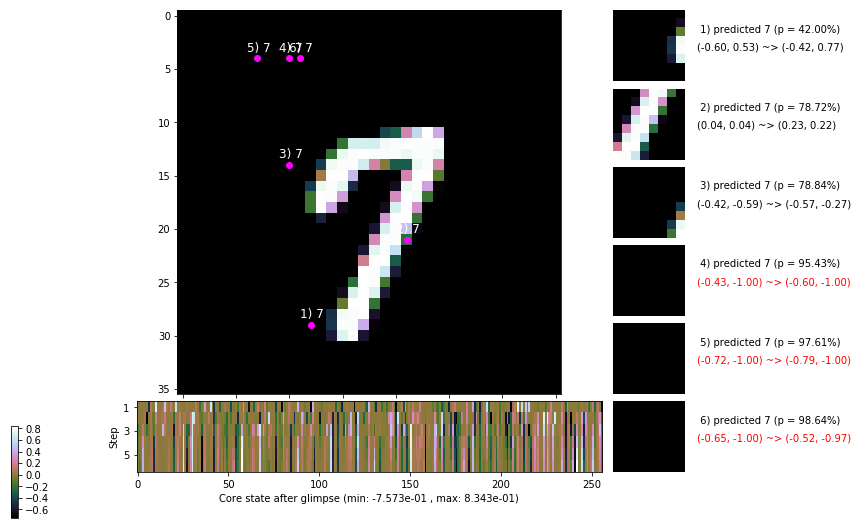

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


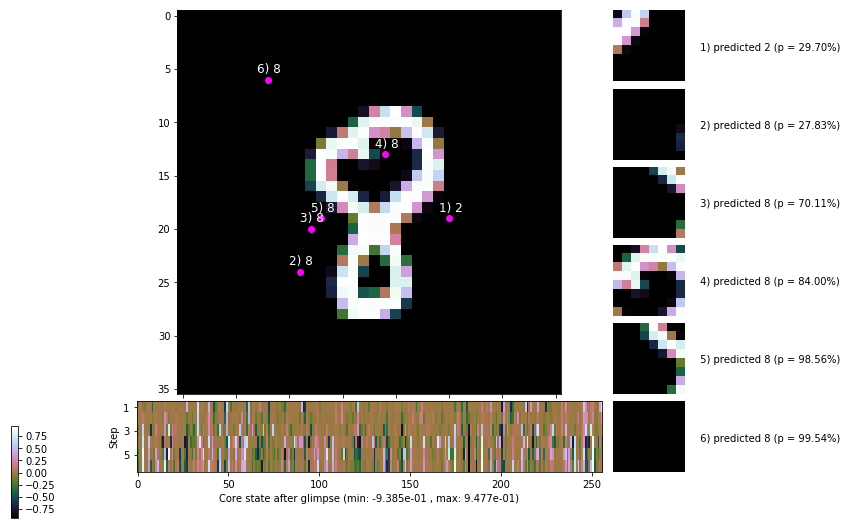


	Target class: 4 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


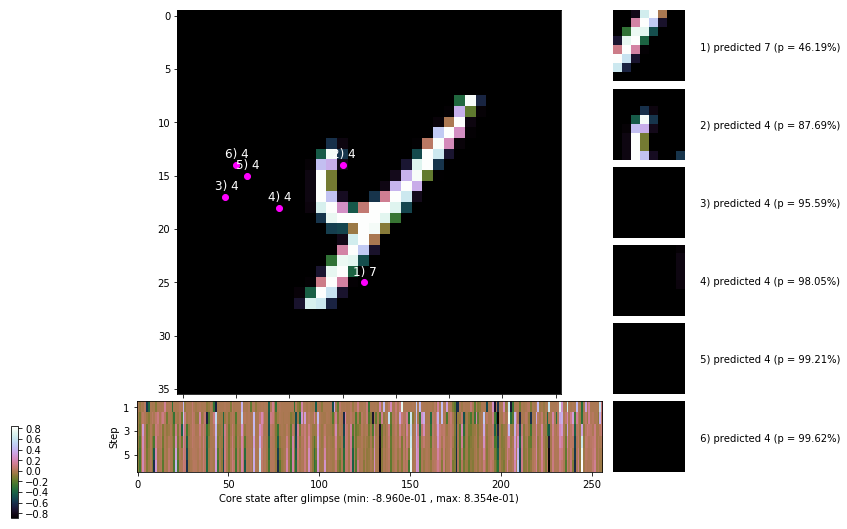

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


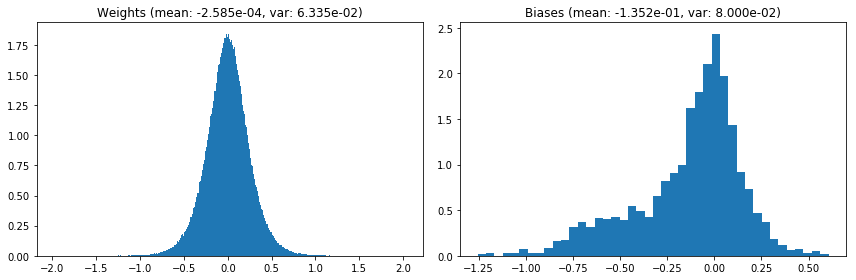

                                      Location network weights and biases


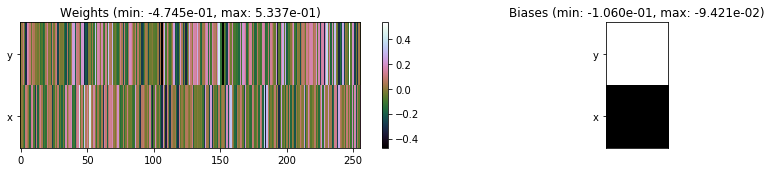

---------------------------------------------------------------------------------------------------------------
Elapsed time:  465.79 sec | TRAIN >> class loss: 0.3934 | steps:  2.316 :( | reward:  4.3593 :( | acc.: 86.860% :(
                          | VAL   >> class loss: 0.3991 | steps:  2.198    | reward:  4.4868    | acc.: 87.120% :(


Epoch  32/400) lr = 0.000628
 b    300/  3000 >> 161.7 ms/b | lr: 6.27e-04 | grad 2norm:  7.95 | grad inf norm:  2.140
         Weights || abs max:  2.02 ( 4849.91) | mean: -2.62e-04 ( 0.02) | var: 6.34e-02 ( 1516.99)
          Biases || abs max:  1.26 (  614.92) | mean: -1.35e-01 ( 0.33) | var: 8.01e-02 (28191.29)
                    class loss: 0.376 | steps: 2.307 | reward:  4.398 | acc.: 87.92%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 159.8 ms/b | lr: 6.27e-04 | grad 2norm:  8.02 | grad inf norm:  2.188
         Weights || abs max:  2.01 ( 4686.77) | mean: -2.70e-04 ( 

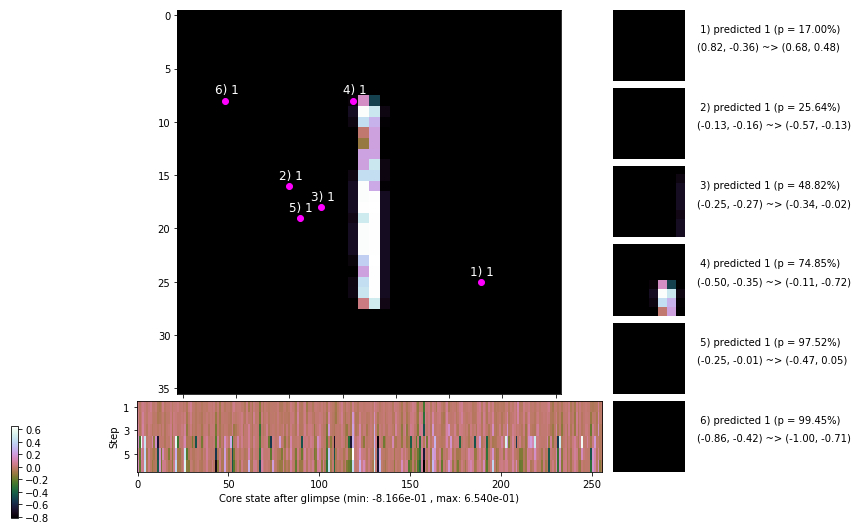

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 167.4 ms/b | lr: 6.25e-04 | grad 2norm:  8.19 | grad inf norm:  2.228
         Weights || abs max:  2.00 ( 6685.56) | mean: -2.75e-04 ( 0.02) | var: 6.36e-02 ( 1783.75)
          Biases || abs max:  1.28 (  115.99) | mean: -1.35e-01 ( 0.12) | var: 8.03e-02 (   58.19)
                    class loss: 0.372 | steps: 2.304 | reward:  4.391 | acc.: 87.73%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 161.2 ms/b | lr: 6.25e-04 | grad 2norm:  8.11 | grad inf norm:  2.117
         Weights || abs max:  2.01 (20266.77) | mean: -3.00e-04 ( 0.05) | var: 6.37e-02 (153066.33)
          Biases || abs max:  1.28 ( 1079.76) | mean: -1.35e-01 ( 0.49) | var: 8.02e-02 (103138.02)
                    class loss: 0.363 | steps: 2.294 | reward:  4.402 | acc.: 87.85%

	Target class: 5 | Discounted rewards: [0.111, 1.111, 1

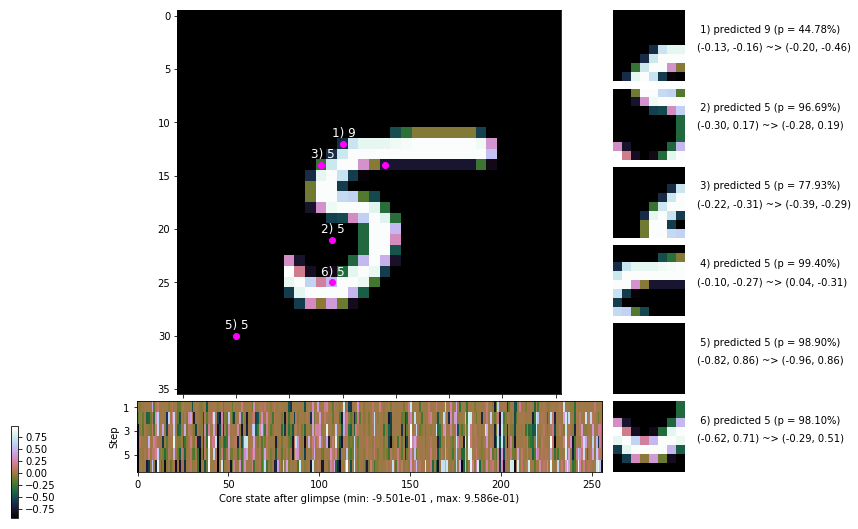

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 156.2 ms/b | lr: 6.24e-04 | grad 2norm:  8.35 | grad inf norm:  2.266
         Weights || abs max:  2.02 ( 5658.49) | mean: -3.14e-04 ( 0.02) | var: 6.38e-02 (  919.50)
          Biases || abs max:  1.29 (  216.97) | mean: -1.35e-01 ( 0.16) | var: 8.04e-02 ( 1102.90)
                    class loss: 0.377 | steps: 2.296 | reward:  4.393 | acc.: 88.02%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 157.5 ms/b | lr: 6.23e-04 | grad 2norm:  8.12 | grad inf norm:  2.199
         Weights || abs max:  2.01 ( 6543.16) | mean: -3.44e-04 ( 0.02) | var: 6.38e-02 ( 1655.49)
          Biases || abs max:  1.28 (  761.11) | mean: -1.36e-01 ( 0.38) | var: 8.05e-02 (47391.29)
                    class loss: 0.368 | steps: 2.315 | reward:  4.383 | acc.: 87.80%

	Target class: 5 | Discounted rewards: [1.110, 1.101, 1.0

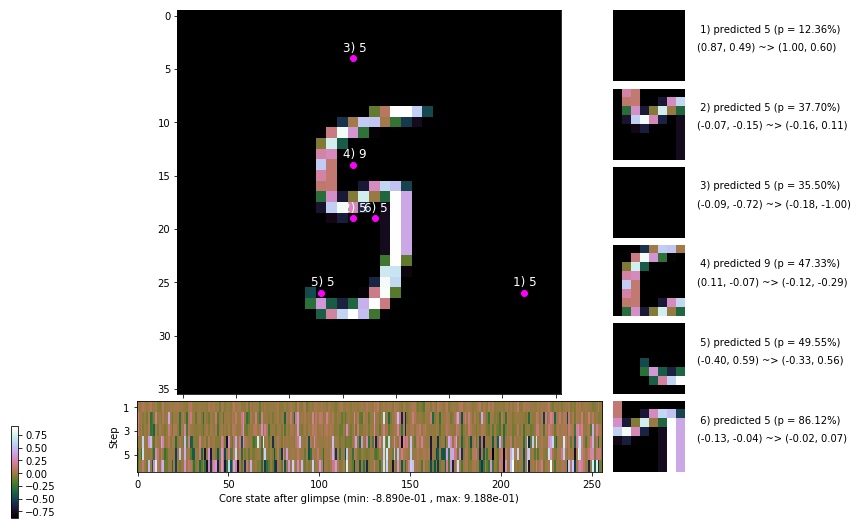

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 153.9 ms/b | lr: 6.22e-04 | grad 2norm:  8.09 | grad inf norm:  2.199
         Weights || abs max:  2.00 ( 4884.17) | mean: -3.61e-04 ( 0.02) | var: 6.39e-02 (  855.00)
          Biases || abs max:  1.27 (  517.65) | mean: -1.35e-01 ( 0.37) | var: 8.04e-02 ( 7588.54)
                    class loss: 0.344 | steps: 2.278 | reward:  4.426 | acc.: 88.42%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 154.6 ms/b | lr: 6.21e-04 | grad 2norm:  8.05 | grad inf norm:  2.102
         Weights || abs max:  1.99 (31708.54) | mean: -3.52e-04 ( 0.07) | var: 6.40e-02 (355983.03)
          Biases || abs max:  1.27 (  109.16) | mean: -1.35e-01 ( 0.12) | var: 8.05e-02 (   44.32)
                    class loss: 0.337 | steps: 2.235 | reward:  4.482 | acc.: 88.95%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.

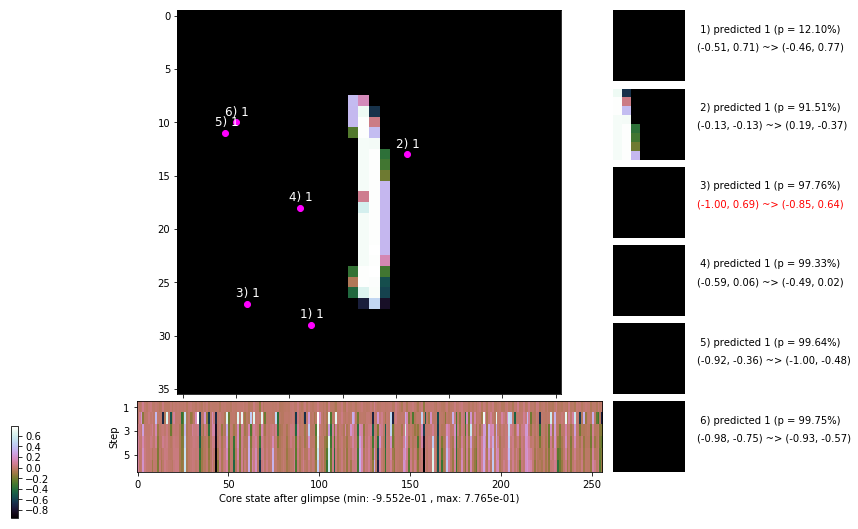

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 156.2 ms/b | lr: 6.20e-04 | grad 2norm:  8.08 | grad inf norm:  2.126
         Weights || abs max:  1.99 ( 4013.15) | mean: -3.32e-04 ( 0.02) | var: 6.41e-02 (  429.10)
          Biases || abs max:  1.27 ( 1146.24) | mean: -1.35e-01 ( 0.54) | var: 8.06e-02 (107391.77)
                    class loss: 0.340 | steps: 2.260 | reward:  4.444 | acc.: 88.55%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 154.1 ms/b | lr: 6.19e-04 | grad 2norm:  8.21 | grad inf norm:  2.143
         Weights || abs max:  2.00 ( 3321.41) | mean: -3.49e-04 ( 0.02) | var: 6.42e-02 (  244.39)
          Biases || abs max:  1.27 (  143.29) | mean: -1.35e-01 ( 0.14) | var: 8.10e-02 (  261.34)
                    class loss: 0.353 | steps: 2.263 | reward:  4.430 | acc.: 88.17%

	Target class: 4 | Discounted rewards: [1.111, 1.111, 1.

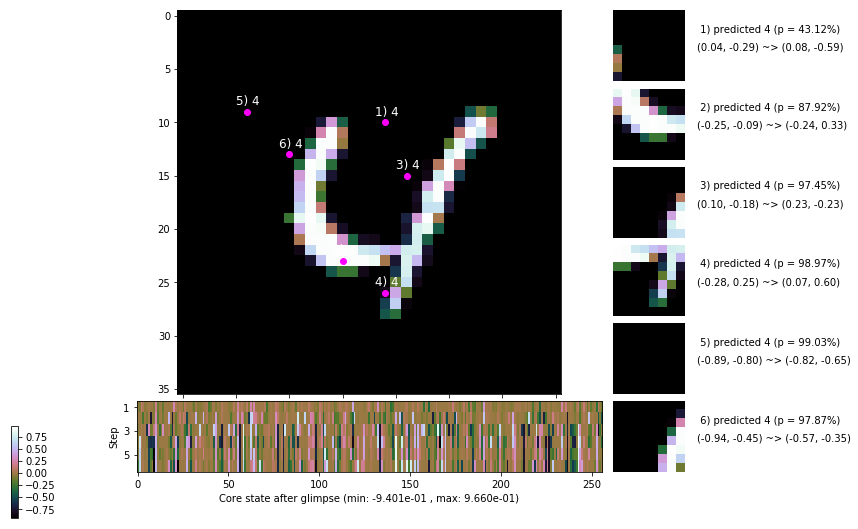

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


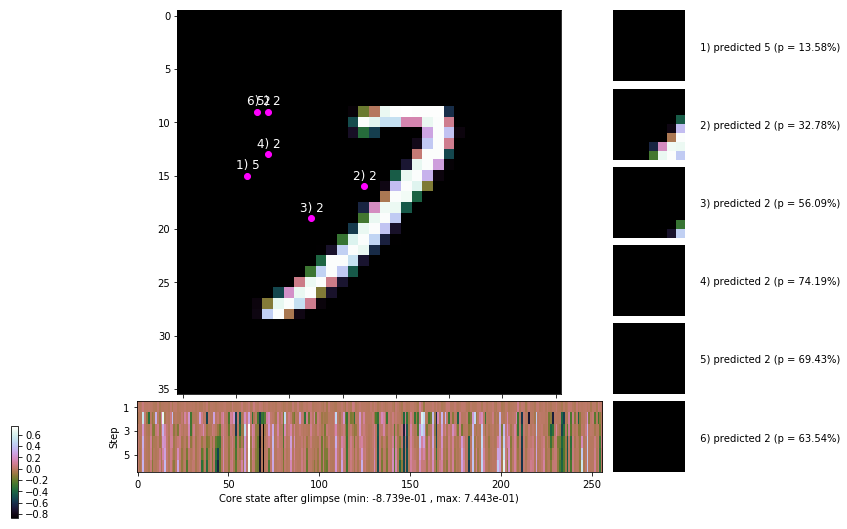


	Target class: 3 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


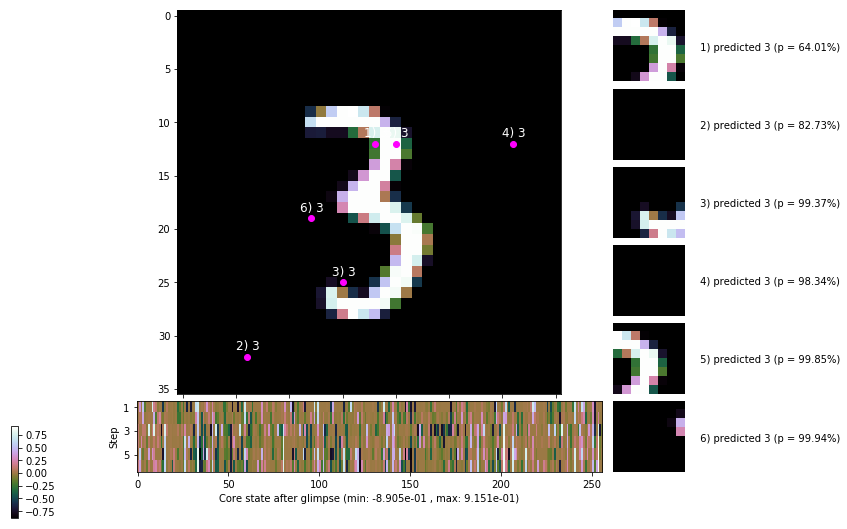

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


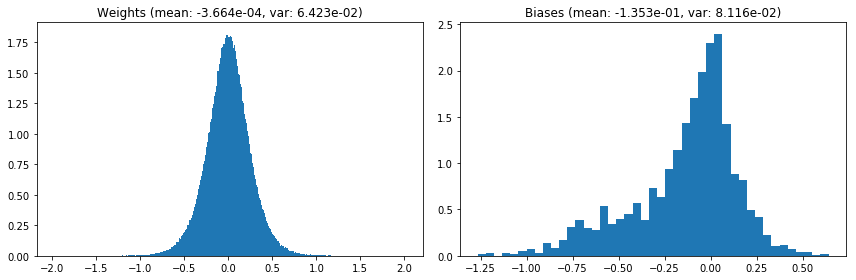

                                      Location network weights and biases


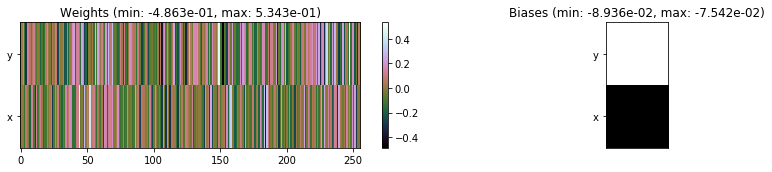

---------------------------------------------------------------------------------------------------------------
Elapsed time:  475.40 sec | TRAIN >> class loss: 0.3589 | steps:  2.284    | reward:  4.4146    | acc.: 88.115% 
                          | VAL   >> class loss: 0.3494 | steps:  2.176    | reward:  4.5646    | acc.: 88.880% 


Epoch  33/400) lr = 0.0006186
 b    300/  3000 >> 154.4 ms/b | lr: 6.18e-04 | grad 2norm:  7.99 | grad inf norm:  2.178
         Weights || abs max:  2.01 ( 3031.68) | mean: -3.70e-04 ( 0.02) | var: 6.43e-02 (  280.72)
          Biases || abs max:  1.27 (   99.96) | mean: -1.36e-01 ( 0.12) | var: 8.12e-02 (   60.30)
                    class loss: 0.356 | steps: 2.264 | reward:  4.440 | acc.: 88.50%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 156.3 ms/b | lr: 6.17e-04 | grad 2norm:  8.03 | grad inf norm:  2.178
         Weights || abs max:  2.01 ( 3646.10) | mean: -3.86e-04 ( 0.0

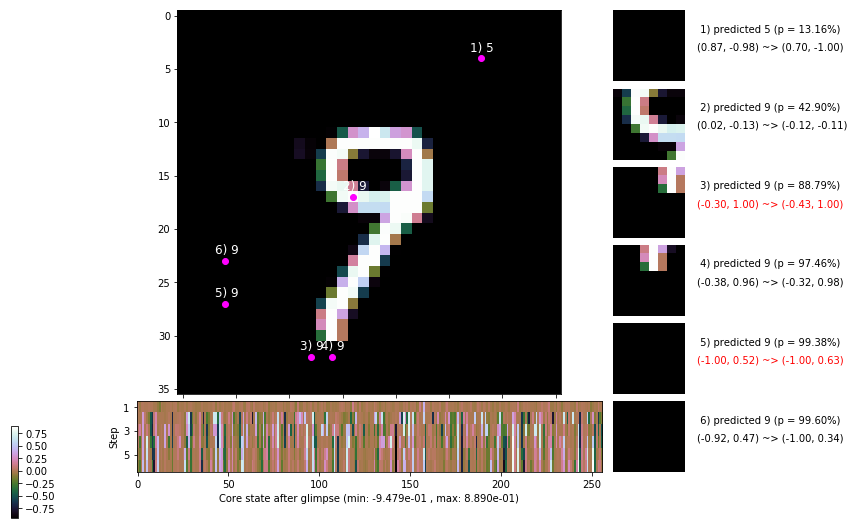

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 164.8 ms/b | lr: 6.16e-04 | grad 2norm:  8.20 | grad inf norm:  2.184
         Weights || abs max:  2.00 ( 5617.16) | mean: -3.92e-04 ( 0.02) | var: 6.44e-02 ( 4387.51)
          Biases || abs max:  1.28 (  232.17) | mean: -1.36e-01 ( 0.17) | var: 8.16e-02 ( 2015.59)
                    class loss: 0.374 | steps: 2.282 | reward:  4.396 | acc.: 87.30%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 157.2 ms/b | lr: 6.16e-04 | grad 2norm:  8.05 | grad inf norm:  2.262
         Weights || abs max:  2.01 ( 4708.74) | mean: -4.24e-04 ( 0.02) | var: 6.45e-02 ( 1647.21)
          Biases || abs max:  1.27 (  245.47) | mean: -1.36e-01 ( 0.18) | var: 8.17e-02 ( 1541.33)
                    class loss: 0.380 | steps: 2.278 | reward:  4.406 | acc.: 87.65%

	Target class: 0 | Discounted rewards: [0.011, 0.111, 1.1

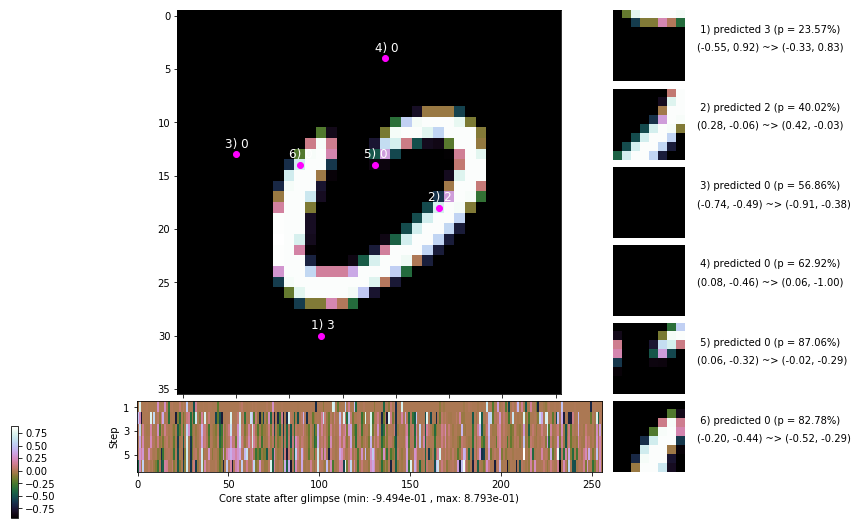

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 169.2 ms/b | lr: 6.14e-04 | grad 2norm:  8.21 | grad inf norm:  2.268
         Weights || abs max:  2.01 ( 3244.85) | mean: -4.27e-04 ( 0.02) | var: 6.46e-02 (  146.23)
          Biases || abs max:  1.26 (  308.00) | mean: -1.36e-01 ( 0.22) | var: 8.17e-02 ( 2731.59)
                    class loss: 0.369 | steps: 2.272 | reward:  4.422 | acc.: 88.12%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 163.1 ms/b | lr: 6.14e-04 | grad 2norm:  8.24 | grad inf norm:  2.266
         Weights || abs max:  2.02 ( 5321.61) | mean: -4.22e-04 ( 0.02) | var: 6.47e-02 ( 2760.48)
          Biases || abs max:  1.27 (  380.32) | mean: -1.36e-01 ( 0.24) | var: 8.18e-02 ( 3510.66)
                    class loss: 0.380 | steps: 2.291 | reward:  4.401 | acc.: 87.47%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.1

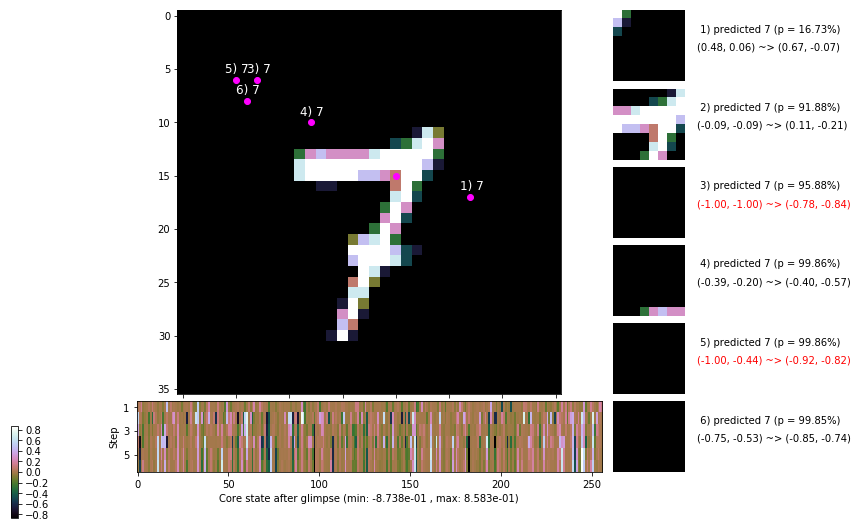

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 157.0 ms/b | lr: 6.12e-04 | grad 2norm:  8.29 | grad inf norm:  2.194
         Weights || abs max:  2.02 ( 6364.26) | mean: -4.23e-04 ( 0.02) | var: 6.48e-02 ( 1336.00)
          Biases || abs max:  1.26 (  279.78) | mean: -1.36e-01 ( 0.21) | var: 8.19e-02 ( 1387.57)
                    class loss: 0.374 | steps: 2.271 | reward:  4.402 | acc.: 87.52%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 154.2 ms/b | lr: 6.12e-04 | grad 2norm:  8.26 | grad inf norm:  2.230
         Weights || abs max:  2.04 ( 3961.19) | mean: -4.19e-04 ( 0.02) | var: 6.49e-02 (  932.72)
          Biases || abs max:  1.27 (  285.17) | mean: -1.36e-01 ( 0.21) | var: 8.21e-02 ( 2532.03)
                    class loss: 0.374 | steps: 2.296 | reward:  4.371 | acc.: 86.93%

	Target class: 4 | Discounted rewards: [1.111, 1.111, 1.1

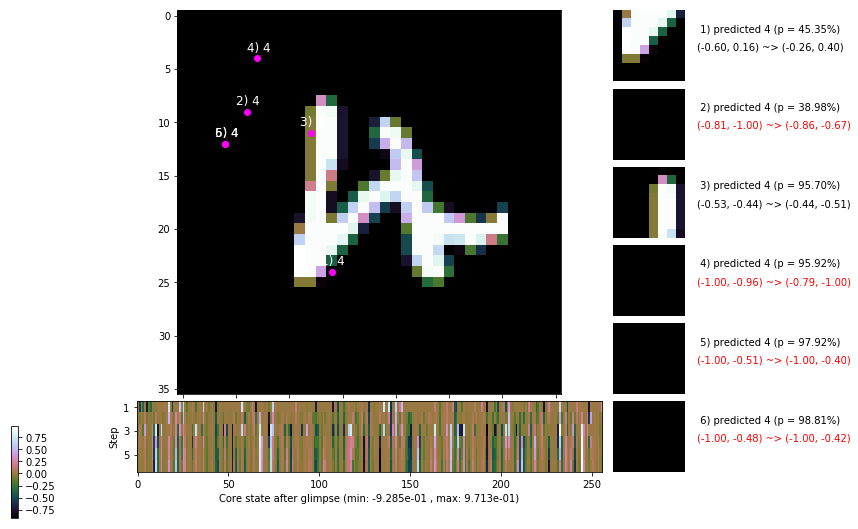

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 159.1 ms/b | lr: 6.11e-04 | grad 2norm:  8.25 | grad inf norm:  2.282
         Weights || abs max:  2.04 ( 3643.49) | mean: -4.19e-04 ( 0.02) | var: 6.50e-02 (  281.29)
          Biases || abs max:  1.27 (  328.53) | mean: -1.36e-01 ( 0.22) | var: 8.25e-02 ( 1123.02)
                    class loss: 0.391 | steps: 2.303 | reward:  4.372 | acc.: 86.60%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 153.5 ms/b | lr: 6.10e-04 | grad 2norm:  8.12 | grad inf norm:  2.119
         Weights || abs max:  2.03 ( 3876.87) | mean: -3.94e-04 ( 0.02) | var: 6.50e-02 (  330.48)
          Biases || abs max:  1.28 (  226.20) | mean: -1.37e-01 ( 0.19) | var: 8.27e-02 (  248.33)
                    class loss: 0.389 | steps: 2.260 | reward:  4.408 | acc.: 87.08%

	Target class: 6 | Discounted rewards: [0.001, 0.011, 0.1

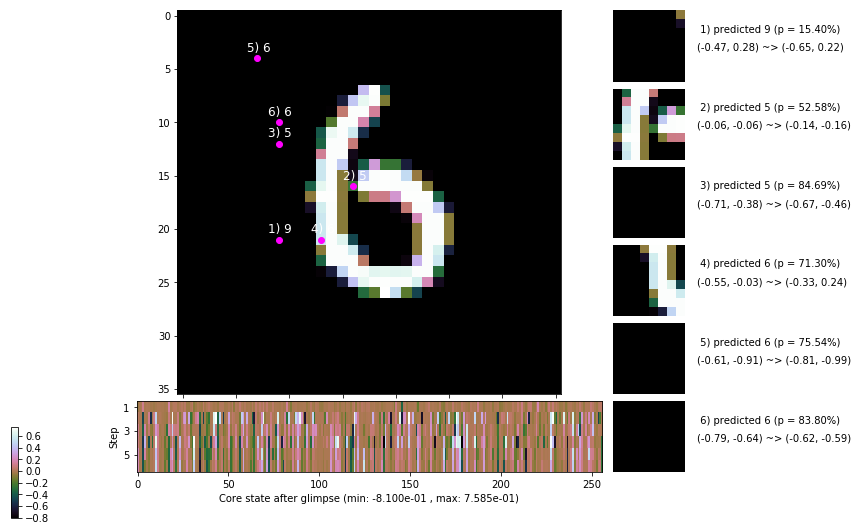

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.011, 0.111, 1.111, 1.110, 1.100, 1.000]


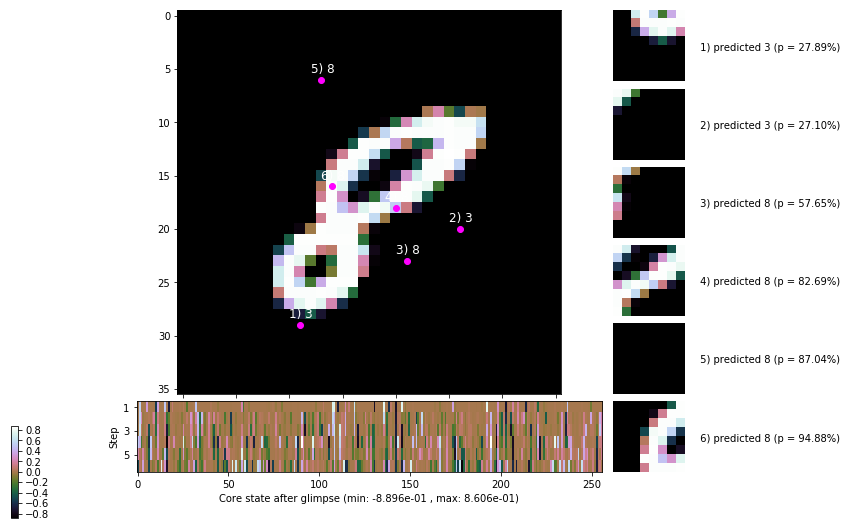


	Target class: 0 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


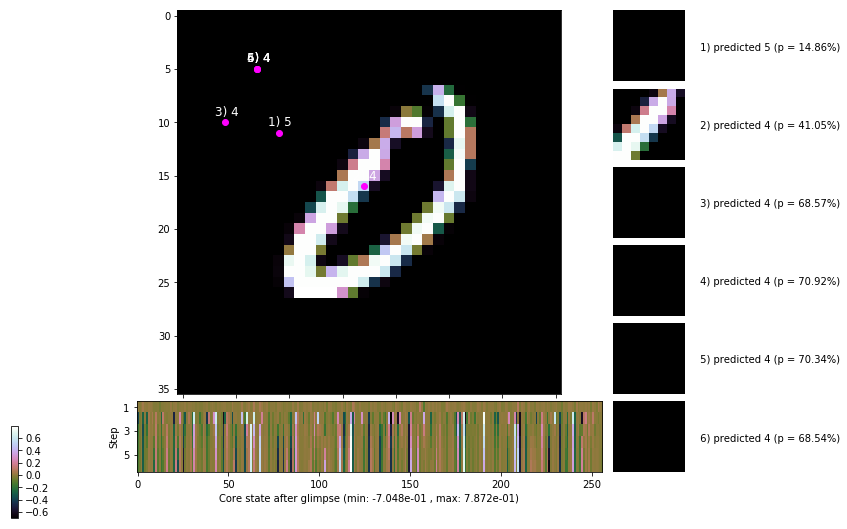

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


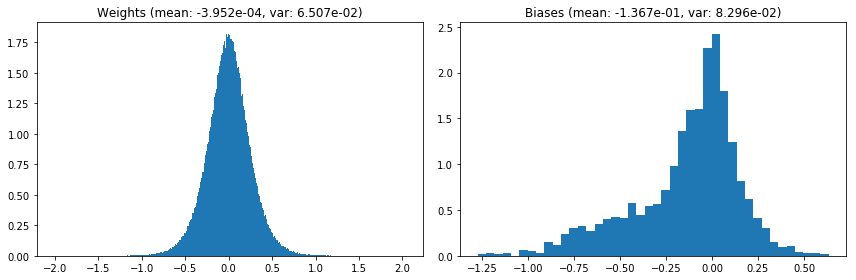

                                      Location network weights and biases


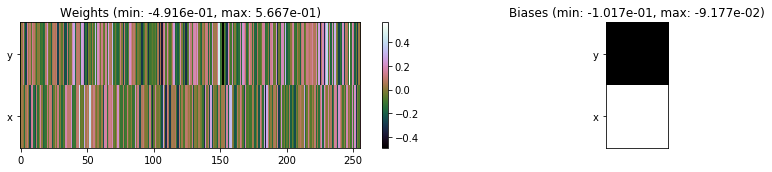

---------------------------------------------------------------------------------------------------------------
Elapsed time:  477.35 sec | TRAIN >> class loss: 0.3747 | steps:  2.276    | reward:  4.4047 :( | acc.: 87.528% :(
                          | VAL   >> class loss: 0.4317 | steps:  2.222 :( | reward:  4.4540 :( | acc.: 85.340% :(


Epoch  34/400) lr = 0.0006094
 b    300/  3000 >> 153.6 ms/b | lr: 6.09e-04 | grad 2norm:  8.05 | grad inf norm:  2.268
         Weights || abs max:  2.03 (21396.64) | mean: -4.31e-04 ( 0.05) | var: 6.51e-02 (110971.77)
          Biases || abs max:  1.28 (  373.04) | mean: -1.36e-01 ( 0.24) | var: 8.28e-02 ( 3141.23)
                    class loss: 0.382 | steps: 2.294 | reward:  4.378 | acc.: 87.18%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.9 ms/b | lr: 6.08e-04 | grad 2norm:  8.02 | grad inf norm:  2.216
         Weights || abs max:  2.04 ( 3014.40) | mean: -4.37e-04 

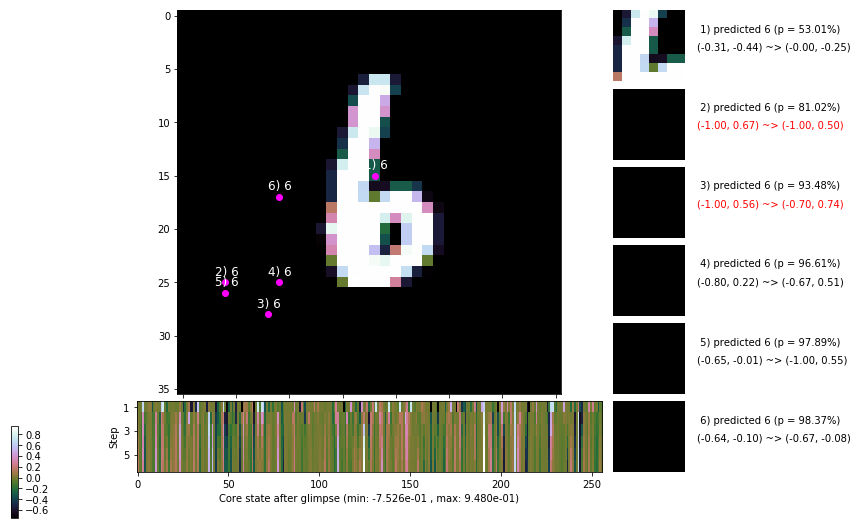

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 158.1 ms/b | lr: 6.07e-04 | grad 2norm:  8.39 | grad inf norm:  2.321
         Weights || abs max:  2.04 ( 4665.19) | mean: -4.53e-04 ( 0.02) | var: 6.53e-02 ( 1517.69)
          Biases || abs max:  1.27 (  205.60) | mean: -1.36e-01 ( 0.16) | var: 8.28e-02 (  777.15)
                    class loss: 0.371 | steps: 2.303 | reward:  4.379 | acc.: 87.43%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 155.7 ms/b | lr: 6.06e-04 | grad 2norm:  7.95 | grad inf norm:  2.145
         Weights || abs max:  2.02 ( 4553.83) | mean: -4.53e-04 ( 0.02) | var: 6.54e-02 (  607.44)
          Biases || abs max:  1.26 (  140.70) | mean: -1.37e-01 ( 0.14) | var: 8.30e-02 (   57.05)
                    class loss: 0.348 | steps: 2.277 | reward:  4.427 | acc.: 88.82%

	Target class: 6 | Discounted rewards: [1.111, 1.111, 1.1

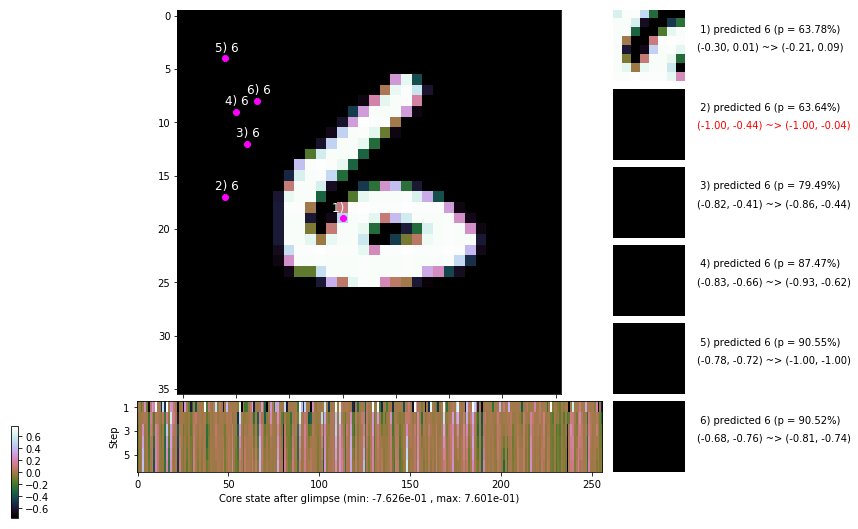

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 155.7 ms/b | lr: 6.05e-04 | grad 2norm:  8.10 | grad inf norm:  2.102
         Weights || abs max:  2.01 ( 2961.89) | mean: -4.73e-04 ( 0.02) | var: 6.55e-02 (  165.67)
          Biases || abs max:  1.26 (  150.82) | mean: -1.37e-01 ( 0.16) | var: 8.30e-02 (  279.21)
                    class loss: 0.356 | steps: 2.280 | reward:  4.408 | acc.: 87.93%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 162.9 ms/b | lr: 6.05e-04 | grad 2norm:  8.00 | grad inf norm:  2.118
         Weights || abs max:  2.00 ( 5270.59) | mean: -4.89e-04 ( 0.02) | var: 6.55e-02 ( 2121.81)
          Biases || abs max:  1.26 (  288.16) | mean: -1.37e-01 ( 0.24) | var: 8.31e-02 ( 3159.93)
                    class loss: 0.349 | steps: 2.274 | reward:  4.427 | acc.: 88.43%

	Target class: 9 | Discounted rewards: [0.011, 0.111, 1.1

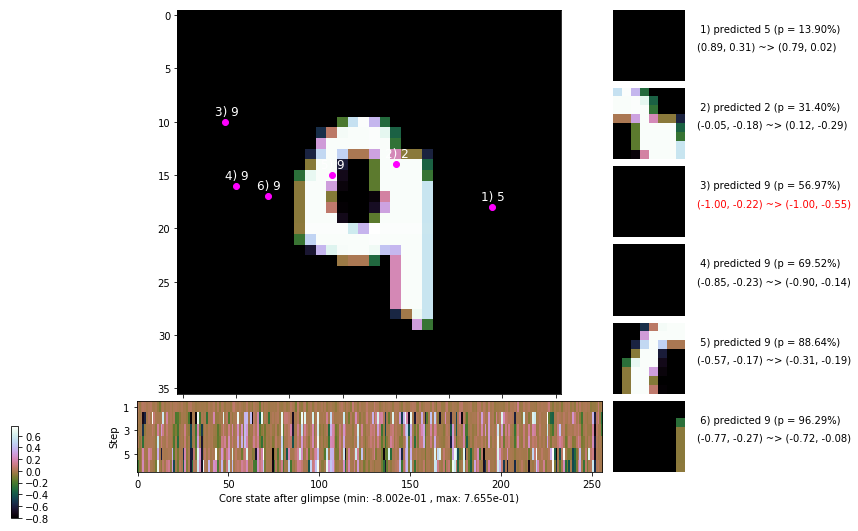

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 167.0 ms/b | lr: 6.03e-04 | grad 2norm:  8.09 | grad inf norm:  2.224
         Weights || abs max:  2.01 ( 4043.19) | mean: -5.04e-04 ( 0.02) | var: 6.56e-02 (  248.54)
          Biases || abs max:  1.25 ( 3319.71) | mean: -1.37e-01 ( 1.38) | var: 8.34e-02 (1052897.38)
                    class loss: 0.360 | steps: 2.290 | reward:  4.409 | acc.: 87.95%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 164.1 ms/b | lr: 6.03e-04 | grad 2norm:  8.10 | grad inf norm:  2.277
         Weights || abs max:  2.02 ( 2795.55) | mean: -5.27e-04 ( 0.02) | var: 6.57e-02 (  132.77)
          Biases || abs max:  1.26 (  187.62) | mean: -1.37e-01 ( 0.17) | var: 8.35e-02 (  203.60)
                    class loss: 0.395 | steps: 2.326 | reward:  4.344 | acc.: 86.98%

	Target class: 2 | Discounted rewards: [1.111, 1.111, 1

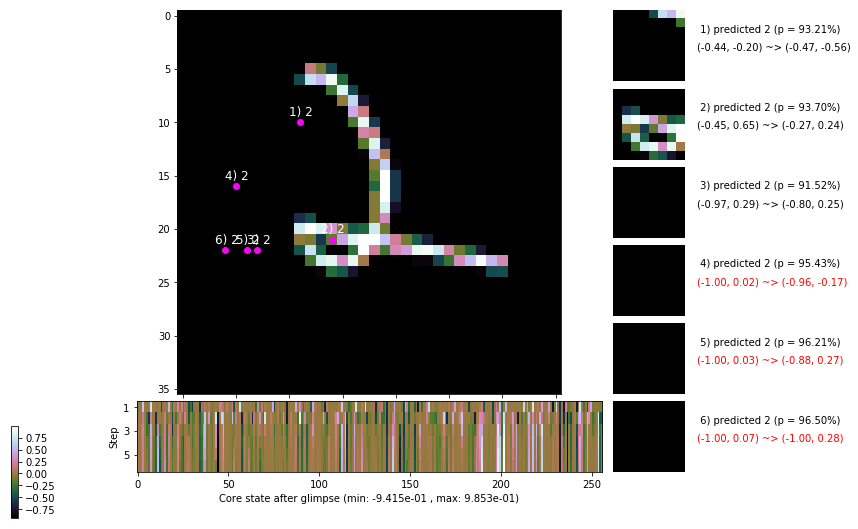

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 164.8 ms/b | lr: 6.02e-04 | grad 2norm:  7.87 | grad inf norm:  2.219
         Weights || abs max:  2.01 ( 2855.47) | mean: -5.06e-04 ( 0.02) | var: 6.58e-02 (  242.93)
          Biases || abs max:  1.27 (  247.44) | mean: -1.38e-01 ( 0.19) | var: 8.35e-02 (  589.08)
                    class loss: 0.363 | steps: 2.304 | reward:  4.388 | acc.: 87.98%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 154.8 ms/b | lr: 6.01e-04 | grad 2norm:  8.00 | grad inf norm:  2.277
         Weights || abs max:  2.02 ( 4302.96) | mean: -4.82e-04 ( 0.02) | var: 6.59e-02 (  244.86)
          Biases || abs max:  1.27 (  151.10) | mean: -1.38e-01 ( 0.16) | var: 8.35e-02 (  250.57)
                    class loss: 0.362 | steps: 2.291 | reward:  4.389 | acc.: 87.82%

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.1

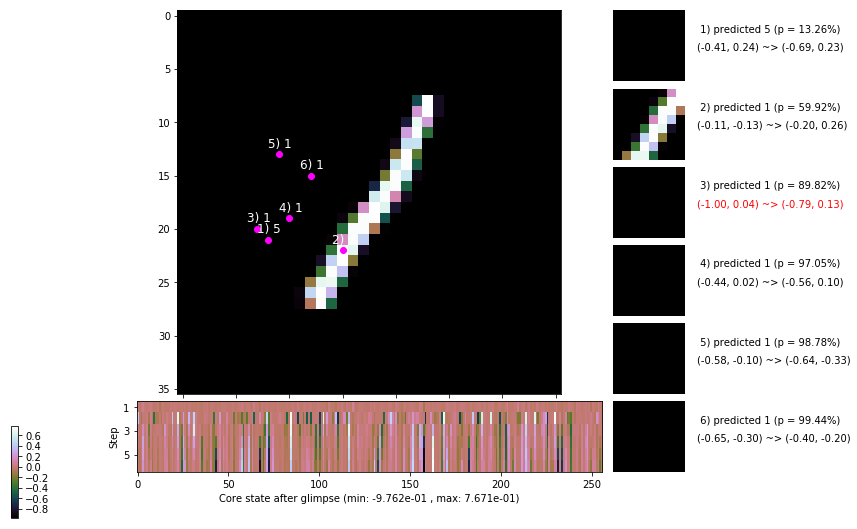

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


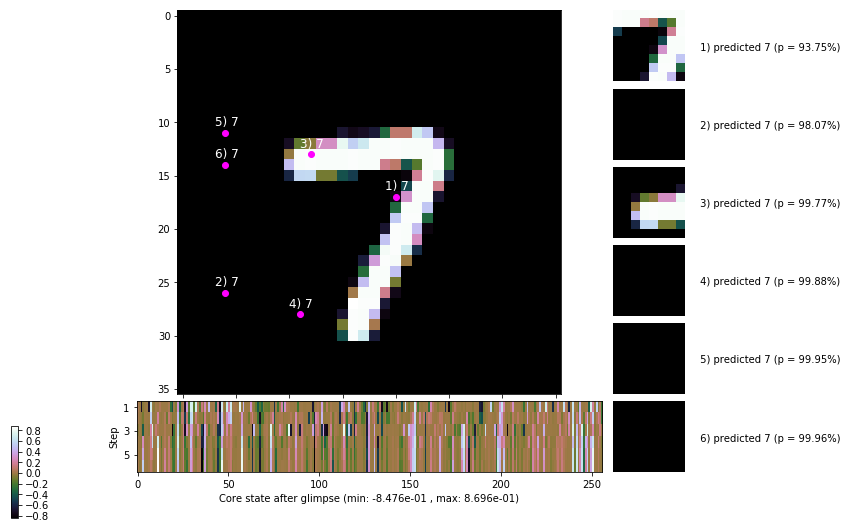


	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


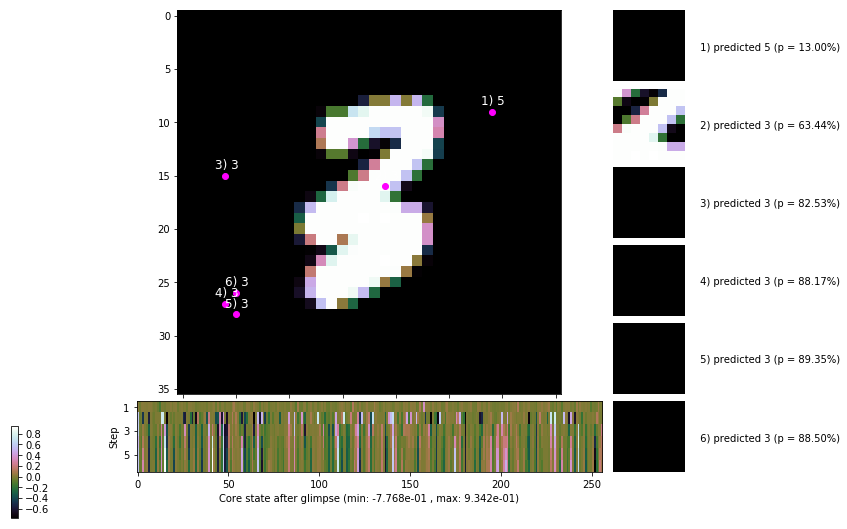

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


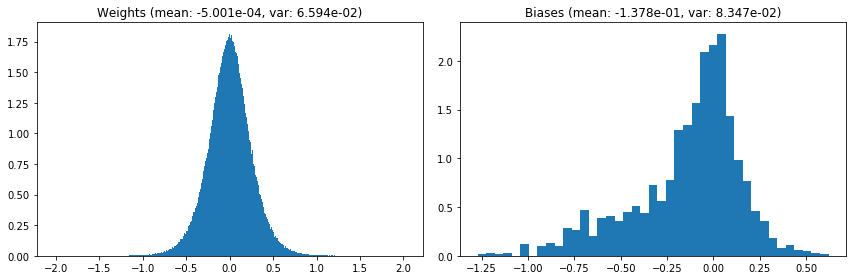

                                      Location network weights and biases


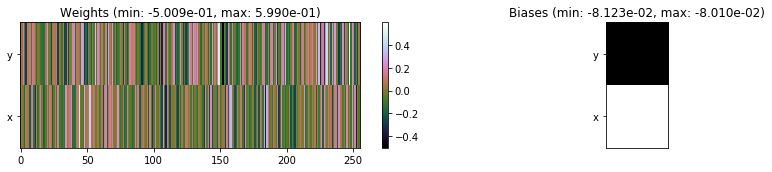

---------------------------------------------------------------------------------------------------------------
Elapsed time:  477.55 sec | TRAIN >> class loss: 0.3644 | steps:  2.291 :( | reward:  4.3975 :( | acc.: 87.895% :(
                          | VAL   >> class loss: 0.4041 | steps:  2.219 :( | reward:  4.4696 :( | acc.: 86.400% :(


Epoch  35/400) lr = 0.0006003
 b    300/  3000 >> 154.5 ms/b | lr: 6.00e-04 | grad 2norm:  7.97 | grad inf norm:  2.204
         Weights || abs max:  2.02 ( 2759.26) | mean: -5.08e-04 ( 0.02) | var: 6.60e-02 (  141.82)
          Biases || abs max:  1.27 (  312.71) | mean: -1.38e-01 ( 0.23) | var: 8.37e-02 ( 2489.19)
                    class loss: 0.353 | steps: 2.268 | reward:  4.428 | acc.: 87.97%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.1 ms/b | lr: 5.99e-04 | grad 2norm:  8.03 | grad inf norm:  2.130
         Weights || abs max:  2.02 ( 3635.31) | mean: -5.11e-04 (

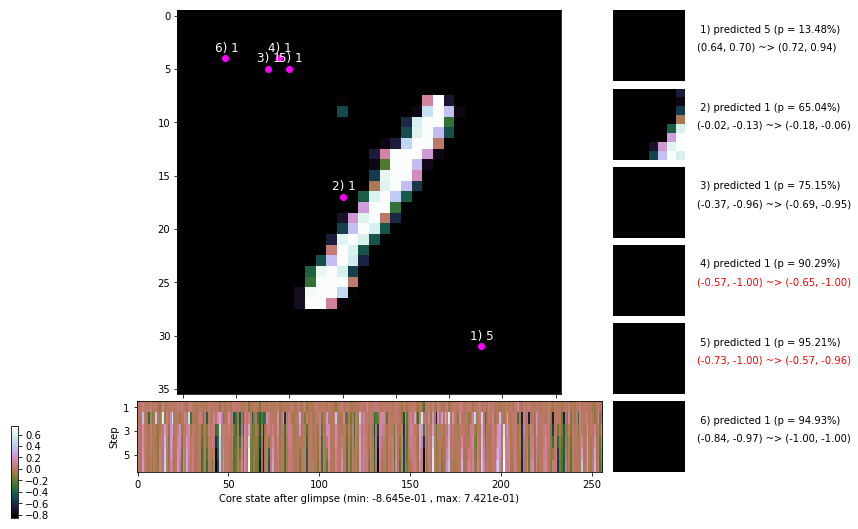

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 156.9 ms/b | lr: 5.98e-04 | grad 2norm:  7.74 | grad inf norm:  2.081
         Weights || abs max:  2.02 ( 7622.02) | mean: -5.25e-04 ( 0.03) | var: 6.62e-02 ( 8625.46)
          Biases || abs max:  1.29 (  533.44) | mean: -1.38e-01 ( 0.46) | var: 8.40e-02 (32854.84)
                    class loss: 0.361 | steps: 2.280 | reward:  4.402 | acc.: 87.98%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 153.0 ms/b | lr: 5.97e-04 | grad 2norm:  7.92 | grad inf norm:  2.213
         Weights || abs max:  2.03 (11232.43) | mean: -4.89e-04 ( 0.03) | var: 6.62e-02 (10109.00)
          Biases || abs max:  1.29 (  160.97) | mean: -1.38e-01 ( 0.15) | var: 8.41e-02 (  121.71)
                    class loss: 0.363 | steps: 2.331 | reward:  4.373 | acc.: 87.85%

	Target class: 6 | Discounted rewards: [0.011, 0.111, 1.1

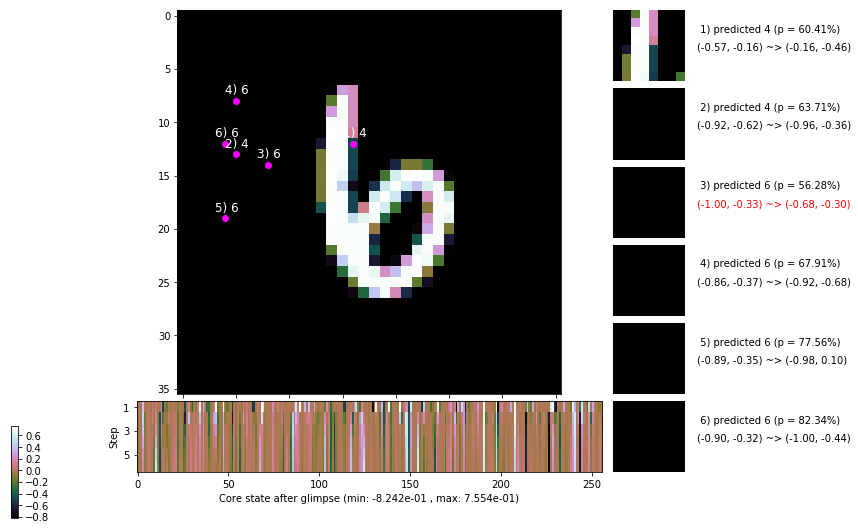

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 157.0 ms/b | lr: 5.96e-04 | grad 2norm:  7.73 | grad inf norm:  2.138
         Weights || abs max:  2.02 ( 3419.69) | mean: -4.99e-04 ( 0.02) | var: 6.63e-02 (  204.38)
          Biases || abs max:  1.30 (  146.12) | mean: -1.38e-01 ( 0.15) | var: 8.41e-02 (  165.57)
                    class loss: 0.340 | steps: 2.269 | reward:  4.417 | acc.: 88.52%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 155.0 ms/b | lr: 5.96e-04 | grad 2norm:  7.85 | grad inf norm:  2.111
         Weights || abs max:  2.01 (29011.20) | mean: -4.76e-04 ( 0.06) | var: 6.64e-02 (353887.03)
          Biases || abs max:  1.31 (  327.90) | mean: -1.38e-01 ( 0.24) | var: 8.42e-02 ( 1802.88)
                    class loss: 0.333 | steps: 2.285 | reward:  4.412 | acc.: 88.80%

	Target class: 1 | Discounted rewards: [0.000, 0.001, 0.

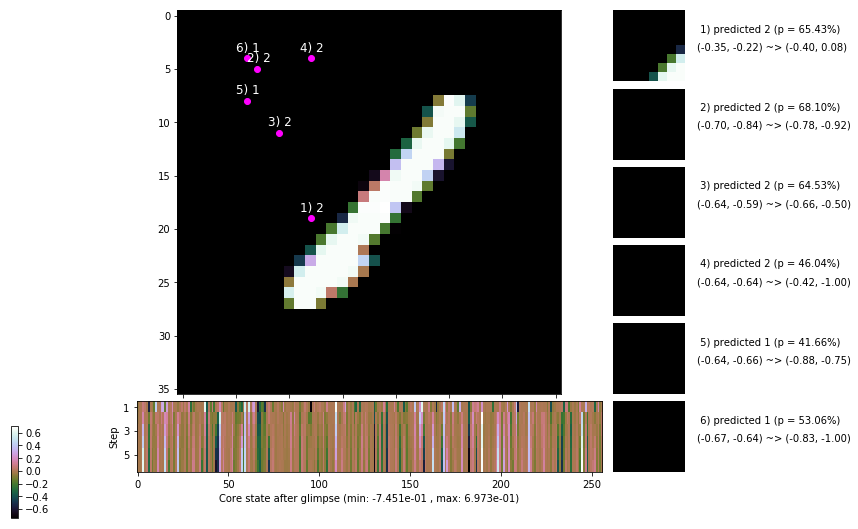

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.2 ms/b | lr: 5.94e-04 | grad 2norm:  7.93 | grad inf norm:  2.188
         Weights || abs max:  2.02 ( 3502.27) | mean: -4.72e-04 ( 0.02) | var: 6.65e-02 (  161.19)
          Biases || abs max:  1.31 (  222.27) | mean: -1.38e-01 ( 0.18) | var: 8.42e-02 (  290.59)
                    class loss: 0.345 | steps: 2.299 | reward:  4.409 | acc.: 88.73%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 159.9 ms/b | lr: 5.94e-04 | grad 2norm:  7.92 | grad inf norm:  2.164
         Weights || abs max:  2.02 (18348.77) | mean: -4.72e-04 ( 0.04) | var: 6.66e-02 (127785.74)
          Biases || abs max:  1.30 (  225.39) | mean: -1.38e-01 ( 0.20) | var: 8.44e-02 ( 1197.57)
                    class loss: 0.344 | steps: 2.283 | reward:  4.425 | acc.: 88.63%

	Target class: 2 | Discounted rewards: [0.000, 0.001, 0.

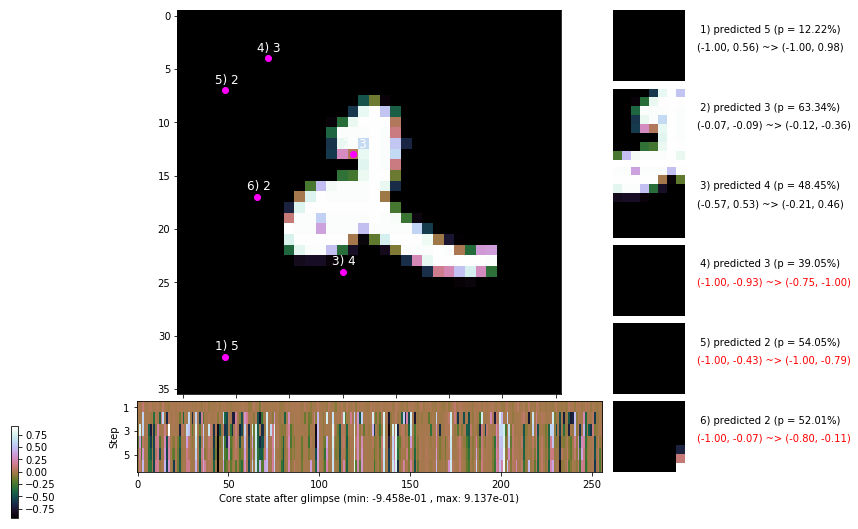

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 159.6 ms/b | lr: 5.93e-04 | grad 2norm:  8.01 | grad inf norm:  2.160
         Weights || abs max:  2.02 ( 2106.74) | mean: -4.78e-04 ( 0.01) | var: 6.66e-02 (   50.52)
          Biases || abs max:  1.30 (  198.30) | mean: -1.38e-01 ( 0.16) | var: 8.46e-02 (  400.79)
                    class loss: 0.369 | steps: 2.303 | reward:  4.391 | acc.: 87.17%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 164.4 ms/b | lr: 5.92e-04 | grad 2norm:  8.00 | grad inf norm:  2.187
         Weights || abs max:  2.03 ( 4109.93) | mean: -5.03e-04 ( 0.02) | var: 6.67e-02 (  693.65)
          Biases || abs max:  1.30 (  147.52) | mean: -1.38e-01 ( 0.13) | var: 8.47e-02 (  200.10)
                    class loss: 0.380 | steps: 2.321 | reward:  4.362 | acc.: 87.33%

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.1

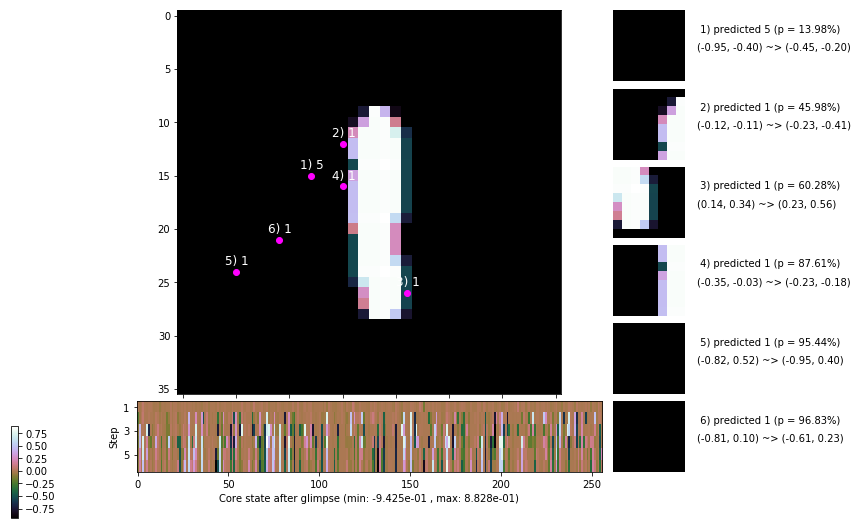

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.011, 0.111, 1.111, 1.110, 1.100, 1.000]


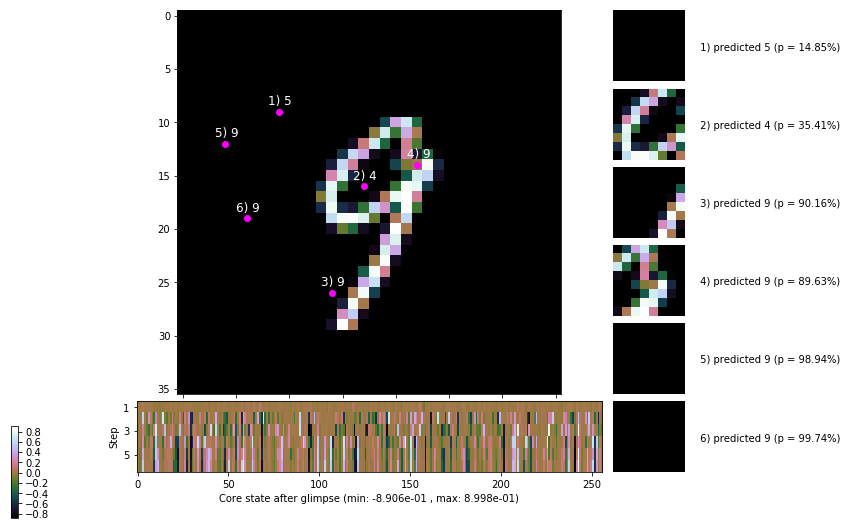


	Target class: 1 | Discounted rewards: [1.000, 0.000, 0.000, 0.000, 0.000, 0.000]


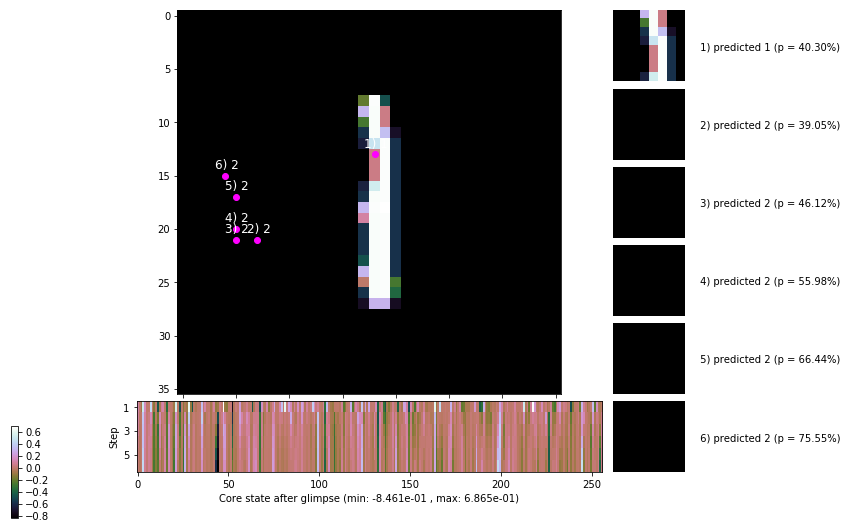

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


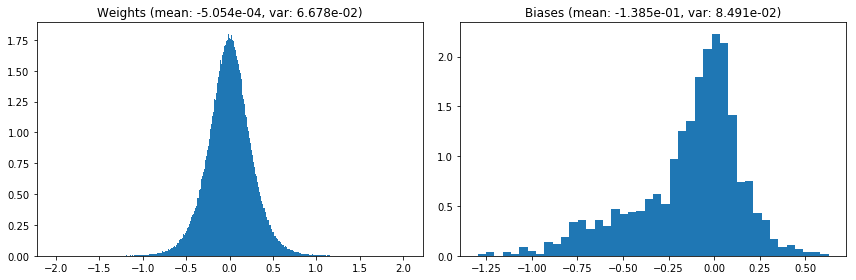

                                      Location network weights and biases


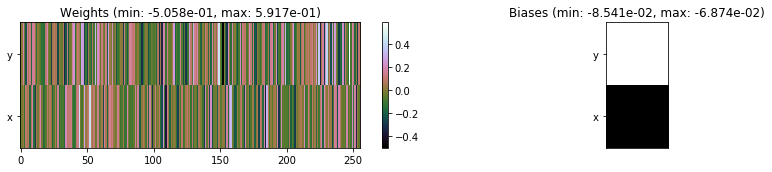

---------------------------------------------------------------------------------------------------------------
Elapsed time:  470.86 sec | TRAIN >> class loss: 0.3565 | steps:  2.294 :( | reward:  4.3999 :( | acc.: 88.045% :(
                          | VAL   >> class loss: 0.3584 | steps:  2.179 :( | reward:  4.5372 :( | acc.: 88.020% :(


Epoch  36/400) lr = 0.0005914
 b    300/  3000 >> 160.1 ms/b | lr: 5.91e-04 | grad 2norm:  7.73 | grad inf norm:  2.149
         Weights || abs max:  2.03 ( 4480.87) | mean: -4.91e-04 ( 0.02) | var: 6.68e-02 (  812.46)
          Biases || abs max:  1.30 (  105.32) | mean: -1.39e-01 ( 0.11) | var: 8.51e-02 (   44.81)
                    class loss: 0.348 | steps: 2.271 | reward:  4.434 | acc.: 88.75%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.7 ms/b | lr: 5.90e-04 | grad 2norm:  8.00 | grad inf norm:  2.173
         Weights || abs max:  2.03 ( 4347.20) | mean: -4.88e-04 (

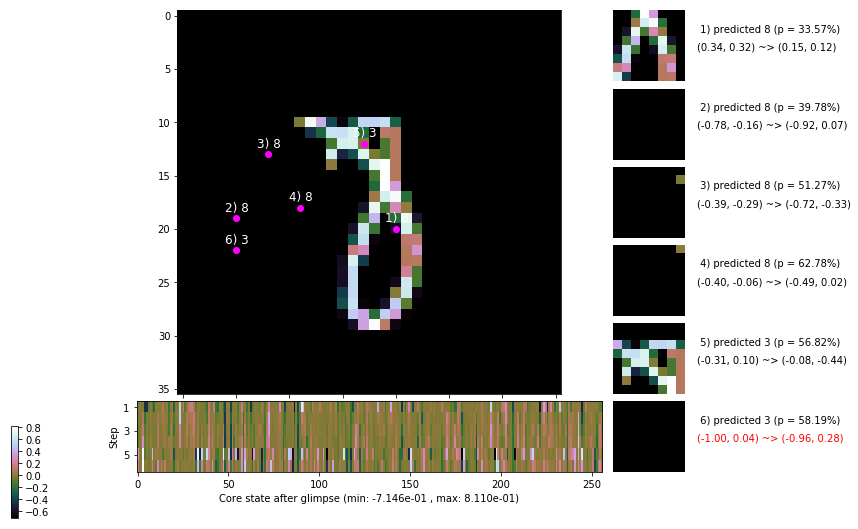

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 157.5 ms/b | lr: 5.89e-04 | grad 2norm:  7.90 | grad inf norm:  2.087
         Weights || abs max:  2.03 ( 8997.83) | mean: -5.36e-04 ( 0.03) | var: 6.70e-02 ( 7348.87)
          Biases || abs max:  1.31 (  194.11) | mean: -1.38e-01 ( 0.18) | var: 8.53e-02 (  662.29)
                    class loss: 0.341 | steps: 2.269 | reward:  4.423 | acc.: 88.00%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 153.8 ms/b | lr: 5.88e-04 | grad 2norm:  7.86 | grad inf norm:  2.147
         Weights || abs max:  2.03 ( 4204.90) | mean: -5.36e-04 ( 0.02) | var: 6.71e-02 (  464.72)
          Biases || abs max:  1.31 (  370.48) | mean: -1.37e-01 ( 0.23) | var: 8.53e-02 ( 4986.42)
                    class loss: 0.334 | steps: 2.256 | reward:  4.443 | acc.: 88.78%

	Target class: 2 | Discounted rewards: [0.111, 1.111, 1.1

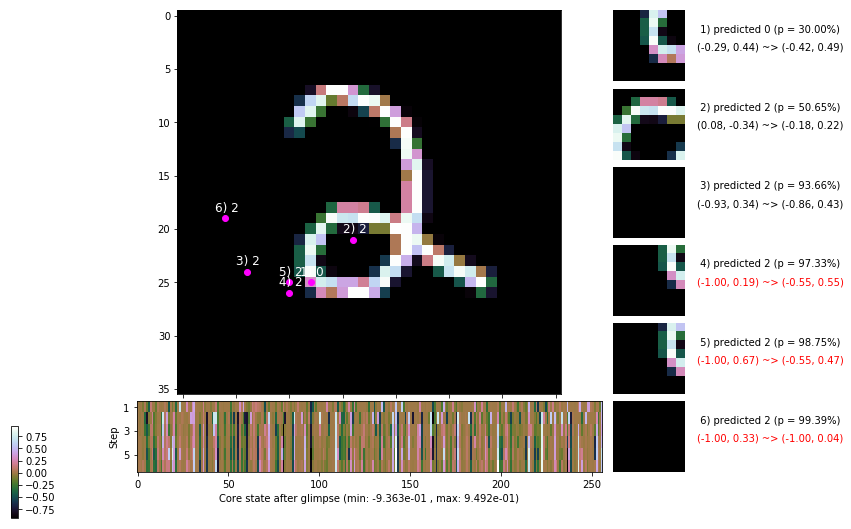

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 156.5 ms/b | lr: 5.87e-04 | grad 2norm:  8.19 | grad inf norm:  2.181
         Weights || abs max:  2.04 ( 4396.39) | mean: -5.48e-04 ( 0.02) | var: 6.71e-02 (  442.17)
          Biases || abs max:  1.31 (  355.16) | mean: -1.38e-01 ( 0.24) | var: 8.53e-02 ( 1744.63)
                    class loss: 0.354 | steps: 2.267 | reward:  4.420 | acc.: 88.10%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 156.6 ms/b | lr: 5.87e-04 | grad 2norm:  8.02 | grad inf norm:  2.263
         Weights || abs max:  2.04 ( 4915.12) | mean: -5.23e-04 ( 0.02) | var: 6.72e-02 ( 1105.66)
          Biases || abs max:  1.32 (  187.96) | mean: -1.38e-01 ( 0.16) | var: 8.53e-02 (   87.04)
                    class loss: 0.348 | steps: 2.297 | reward:  4.429 | acc.: 88.78%

	Target class: 6 | Discounted rewards: [1.111, 1.111, 1.1

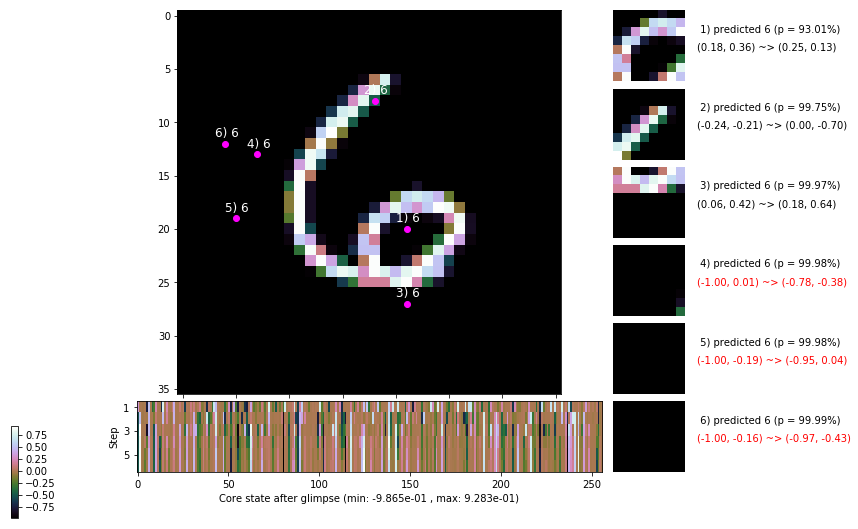

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.5 ms/b | lr: 5.86e-04 | grad 2norm:  7.85 | grad inf norm:  2.041
         Weights || abs max:  2.04 ( 4445.04) | mean: -5.01e-04 ( 0.02) | var: 6.73e-02 ( 1599.31)
          Biases || abs max:  1.32 (  122.05) | mean: -1.38e-01 ( 0.14) | var: 8.53e-02 (  194.13)
                    class loss: 0.317 | steps: 2.256 | reward:  4.449 | acc.: 89.38%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 156.1 ms/b | lr: 5.85e-04 | grad 2norm:  7.92 | grad inf norm:  2.162
         Weights || abs max:  2.03 ( 4294.27) | mean: -4.85e-04 ( 0.02) | var: 6.73e-02 ( 1085.82)
          Biases || abs max:  1.32 (  157.62) | mean: -1.38e-01 ( 0.13) | var: 8.56e-02 (  567.36)
                    class loss: 0.309 | steps: 2.255 | reward:  4.465 | acc.: 89.80%

	Target class: 9 | Discounted rewards: [0.111, 1.111, 1.1

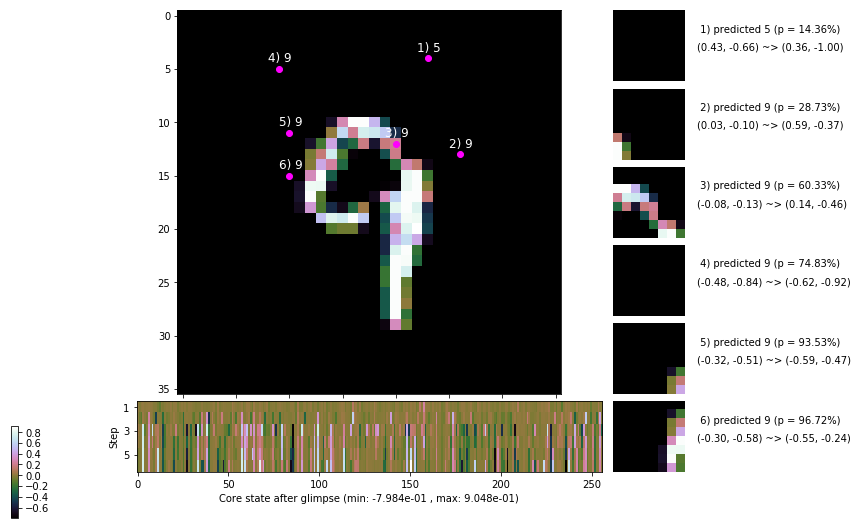

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 156.2 ms/b | lr: 5.84e-04 | grad 2norm:  8.08 | grad inf norm:  2.164
         Weights || abs max:  2.04 ( 5262.18) | mean: -4.79e-04 ( 0.02) | var: 6.74e-02 ( 1408.27)
          Biases || abs max:  1.32 (  135.43) | mean: -1.38e-01 ( 0.14) | var: 8.56e-02 (   53.13)
                    class loss: 0.312 | steps: 2.255 | reward:  4.463 | acc.: 89.57%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 154.9 ms/b | lr: 5.83e-04 | grad 2norm:  8.45 | grad inf norm:  2.338
         Weights || abs max:  2.03 ( 2886.59) | mean: -4.63e-04 ( 0.02) | var: 6.75e-02 (  189.32)
          Biases || abs max:  1.32 (  300.98) | mean: -1.38e-01 ( 0.19) | var: 8.57e-02 ( 4917.93)
                    class loss: 0.340 | steps: 2.280 | reward:  4.412 | acc.: 88.55%

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.1

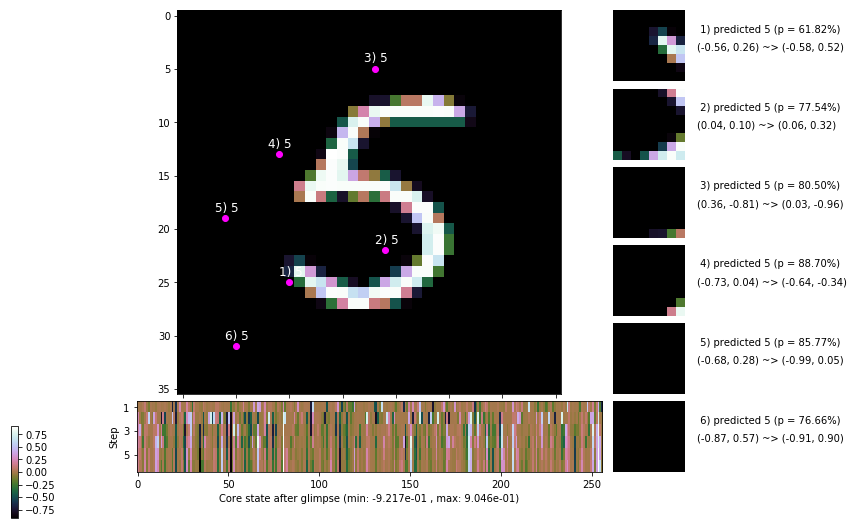

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


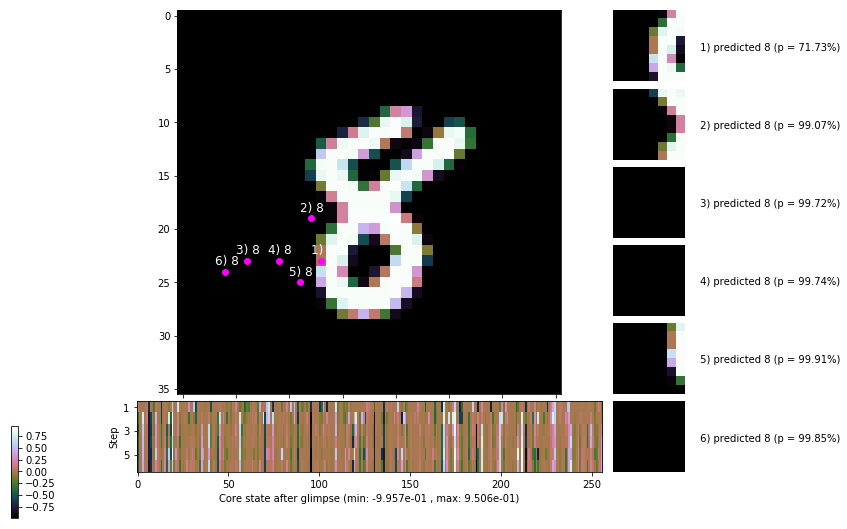


	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


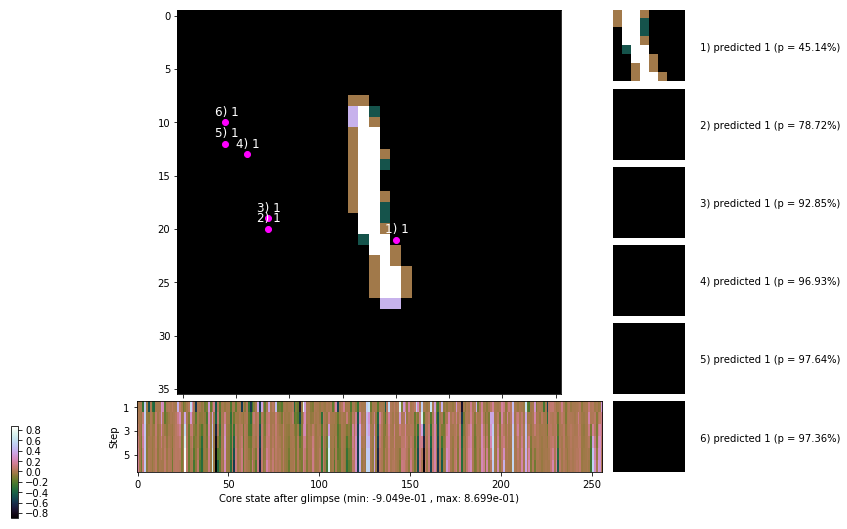

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


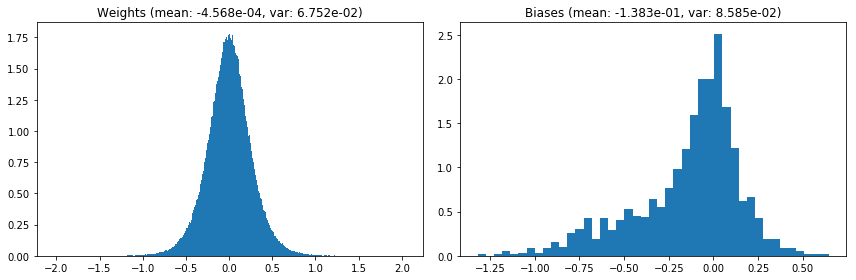

                                      Location network weights and biases


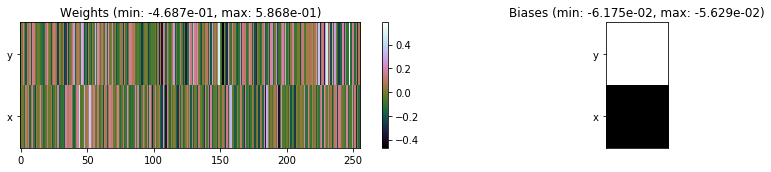

---------------------------------------------------------------------------------------------------------------
Elapsed time:  469.37 sec | TRAIN >> class loss: 0.3357 | steps:  2.268    | reward:  4.4352    | acc.: 88.773% 
                          | VAL   >> class loss: 0.3345 | steps:  2.186 :( | reward:  4.5222 :( | acc.: 88.220% :(


Epoch  37/400) lr = 0.0005826
 b    300/  3000 >> 161.3 ms/b | lr: 5.82e-04 | grad 2norm:  8.07 | grad inf norm:  2.252
         Weights || abs max:  2.03 ( 3665.37) | mean: -4.50e-04 ( 0.02) | var: 6.76e-02 (  495.64)
          Biases || abs max:  1.31 (  160.45) | mean: -1.38e-01 ( 0.14) | var: 8.59e-02 (  288.59)
                    class loss: 0.349 | steps: 2.266 | reward:  4.416 | acc.: 88.25%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 163.6 ms/b | lr: 5.81e-04 | grad 2norm:  8.07 | grad inf norm:  2.108
         Weights || abs max:  2.04 ( 2534.23) | mean: -4.77e-04 ( 0

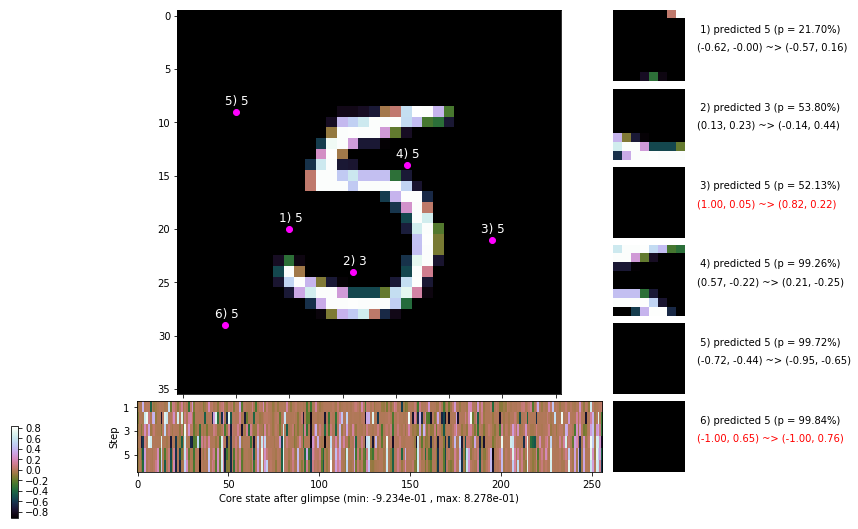

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 166.5 ms/b | lr: 5.80e-04 | grad 2norm:  8.03 | grad inf norm:  2.206
         Weights || abs max:  2.04 ( 4046.08) | mean: -5.02e-04 ( 0.02) | var: 6.77e-02 (  304.85)
          Biases || abs max:  1.31 (  418.43) | mean: -1.39e-01 ( 0.26) | var: 8.62e-02 ( 5888.70)
                    class loss: 0.355 | steps: 2.264 | reward:  4.422 | acc.: 88.22%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 159.9 ms/b | lr: 5.80e-04 | grad 2norm:  8.13 | grad inf norm:  2.231
         Weights || abs max:  2.03 ( 3325.82) | mean: -5.40e-04 ( 0.02) | var: 6.78e-02 (  364.37)
          Biases || abs max:  1.29 (  166.45) | mean: -1.39e-01 ( 0.15) | var: 8.63e-02 (  409.83)
                    class loss: 0.352 | steps: 2.256 | reward:  4.433 | acc.: 88.20%

	Target class: 0 | Discounted rewards: [0.111, 1.111, 1.1

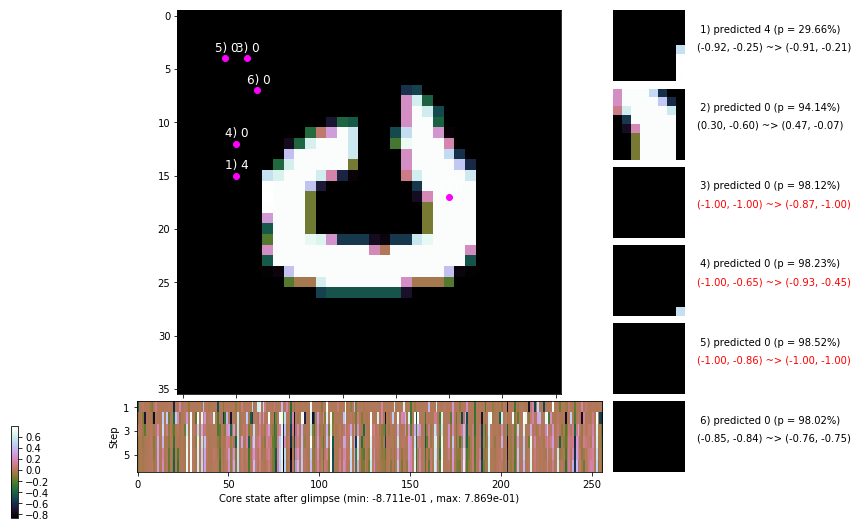

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 155.8 ms/b | lr: 5.79e-04 | grad 2norm:  7.82 | grad inf norm:  2.108
         Weights || abs max:  2.03 ( 3315.05) | mean: -5.32e-04 ( 0.02) | var: 6.79e-02 (  839.40)
          Biases || abs max:  1.30 (  162.53) | mean: -1.39e-01 ( 0.15) | var: 8.61e-02 (  189.77)
                    class loss: 0.346 | steps: 2.233 | reward:  4.450 | acc.: 88.50%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 154.2 ms/b | lr: 5.78e-04 | grad 2norm:  8.11 | grad inf norm:  2.287
         Weights || abs max:  2.03 ( 9489.14) | mean: -5.23e-04 ( 0.03) | var: 6.79e-02 ( 6401.09)
          Biases || abs max:  1.29 (  126.02) | mean: -1.39e-01 ( 0.13) | var: 8.63e-02 (   80.96)
                    class loss: 0.365 | steps: 2.270 | reward:  4.419 | acc.: 87.80%

	Target class: 1 | Discounted rewards: [0.110, 1.100, 1.0

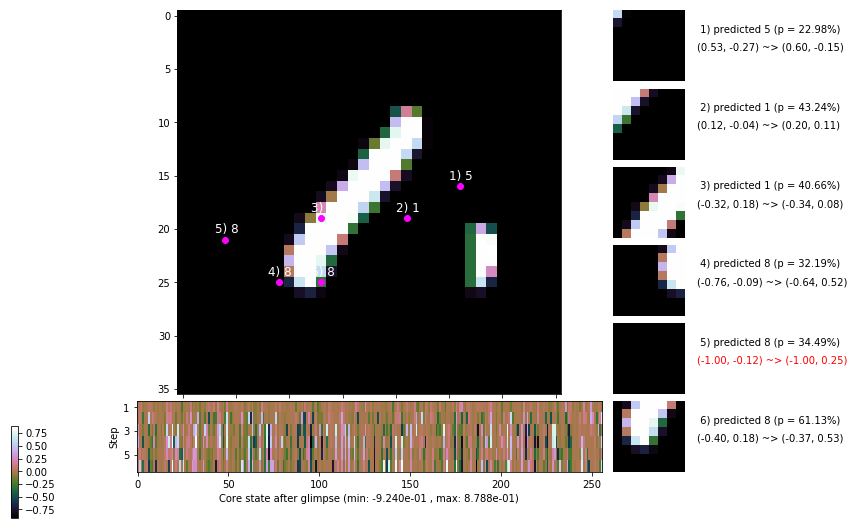

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.9 ms/b | lr: 5.77e-04 | grad 2norm:  7.80 | grad inf norm:  2.122
         Weights || abs max:  2.03 ( 9072.07) | mean: -5.35e-04 ( 0.03) | var: 6.80e-02 ( 5212.07)
          Biases || abs max:  1.29 (  120.76) | mean: -1.39e-01 ( 0.13) | var: 8.63e-02 (  172.03)
                    class loss: 0.344 | steps: 2.277 | reward:  4.427 | acc.: 88.58%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 155.3 ms/b | lr: 5.76e-04 | grad 2norm:  8.02 | grad inf norm:  2.251
         Weights || abs max:  2.04 ( 6337.60) | mean: -5.44e-04 ( 0.02) | var: 6.81e-02 ( 2652.30)
          Biases || abs max:  1.30 ( 1180.73) | mean: -1.39e-01 ( 0.55) | var: 8.64e-02 (123968.30)
                    class loss: 0.339 | steps: 2.276 | reward:  4.439 | acc.: 89.37%

	Target class: 2 | Discounted rewards: [1.110, 1.100, 1.

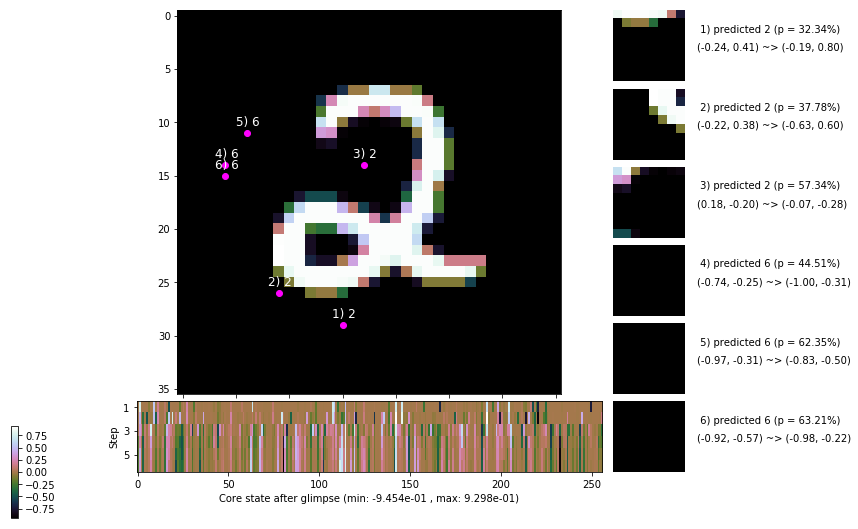

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 153.7 ms/b | lr: 5.75e-04 | grad 2norm:  7.85 | grad inf norm:  2.064
         Weights || abs max:  2.04 ( 3720.14) | mean: -5.79e-04 ( 0.02) | var: 6.82e-02 ( 1125.72)
          Biases || abs max:  1.30 (  139.31) | mean: -1.39e-01 ( 0.13) | var: 8.63e-02 (  337.09)
                    class loss: 0.326 | steps: 2.256 | reward:  4.448 | acc.: 89.02%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 152.7 ms/b | lr: 5.74e-04 | grad 2norm:  7.80 | grad inf norm:  2.105
         Weights || abs max:  2.04 (11523.00) | mean: -5.93e-04 ( 0.03) | var: 6.83e-02 (29445.87)
          Biases || abs max:  1.30 (  209.67) | mean: -1.39e-01 ( 0.16) | var: 8.65e-02 ( 1577.16)
                    class loss: 0.338 | steps: 2.256 | reward:  4.449 | acc.: 88.90%

	Target class: 2 | Discounted rewards: [1.111, 1.111, 1.1

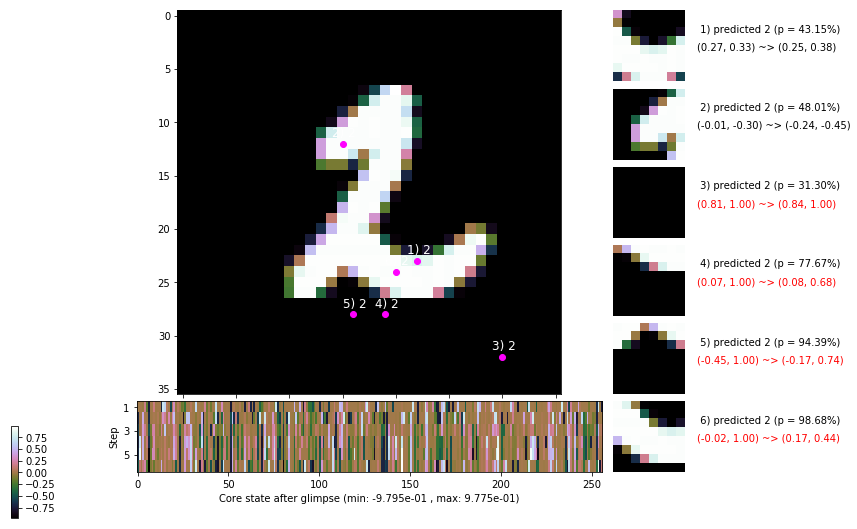

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


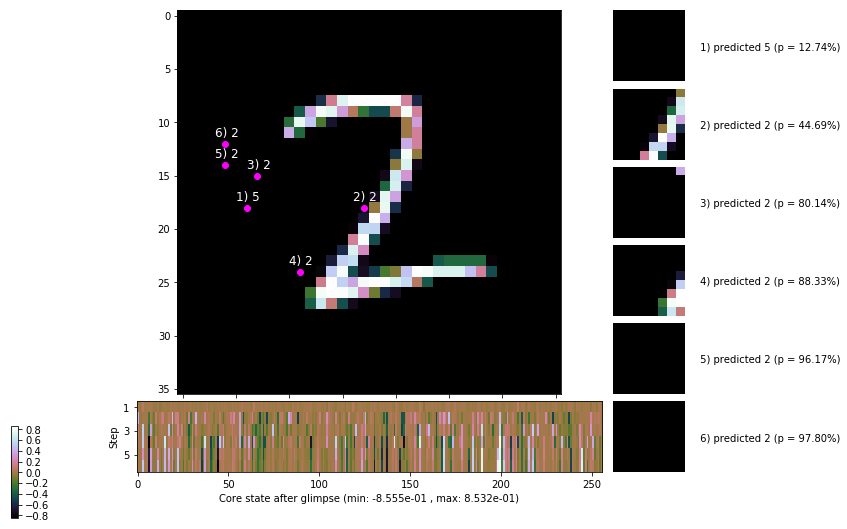


	Target class: 4 | Discounted rewards: [0.110, 1.100, 1.000, 0.000, 0.000, 0.000]


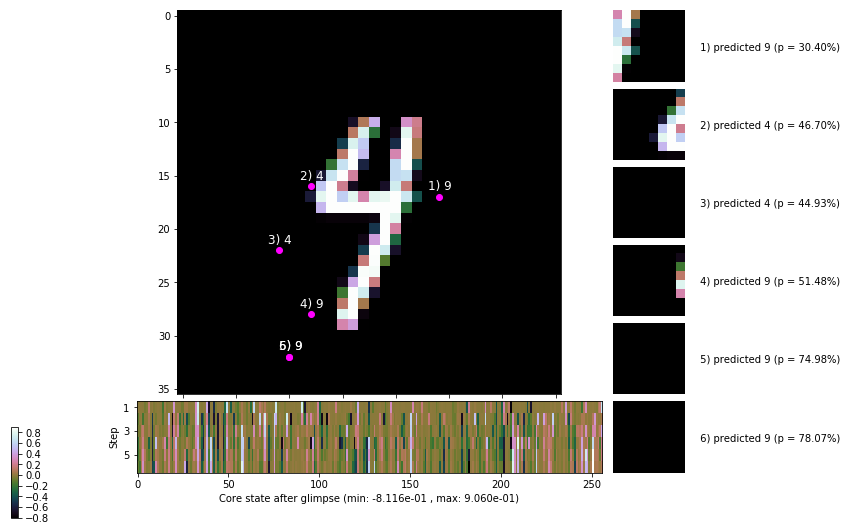

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


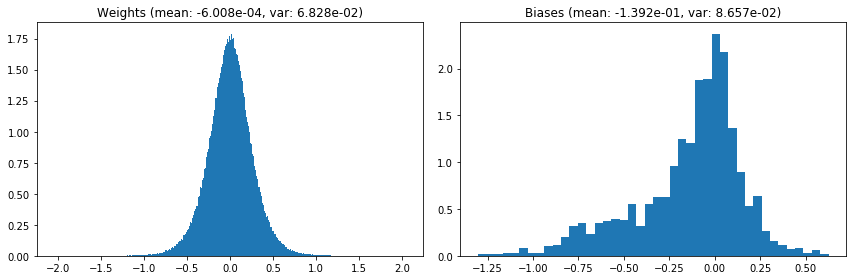

                                      Location network weights and biases


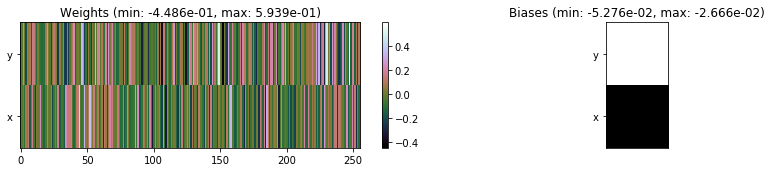

---------------------------------------------------------------------------------------------------------------
Elapsed time:  474.69 sec | TRAIN >> class loss: 0.3460 | steps:  2.262    | reward:  4.4328 :( | acc.: 88.540% :(
                          | VAL   >> class loss: 0.3348 | steps:  2.184 :( | reward:  4.5342 :( | acc.: 88.680% :(


Epoch  38/400) lr = 0.0005739
 b    300/  3000 >> 154.1 ms/b | lr: 5.73e-04 | grad 2norm:  7.93 | grad inf norm:  2.231
         Weights || abs max:  2.05 ( 6463.40) | mean: -5.97e-04 ( 0.02) | var: 6.83e-02 ( 3749.44)
          Biases || abs max:  1.30 (  222.01) | mean: -1.39e-01 ( 0.18) | var: 8.66e-02 (  368.31)
                    class loss: 0.332 | steps: 2.244 | reward:  4.456 | acc.: 88.93%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.3 ms/b | lr: 5.73e-04 | grad 2norm:  8.10 | grad inf norm:  2.212
         Weights || abs max:  2.04 (21265.61) | mean: -5.97e-04 (

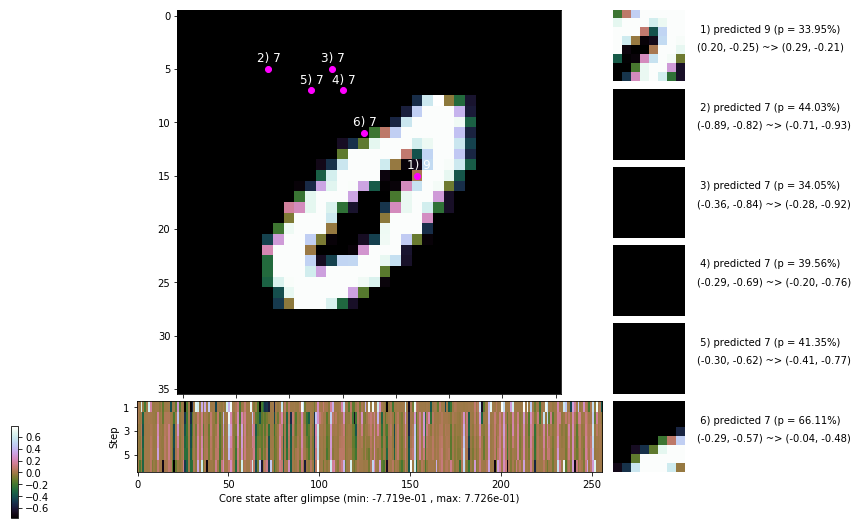

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 164.2 ms/b | lr: 5.72e-04 | grad 2norm:  8.03 | grad inf norm:  2.077
         Weights || abs max:  2.05 (11361.03) | mean: -6.11e-04 ( 0.03) | var: 6.85e-02 (28070.28)
          Biases || abs max:  1.30 (  157.04) | mean: -1.39e-01 ( 0.16) | var: 8.66e-02 (  415.30)
                    class loss: 0.326 | steps: 2.255 | reward:  4.447 | acc.: 89.27%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 159.9 ms/b | lr: 5.71e-04 | grad 2norm:  7.86 | grad inf norm:  2.181
         Weights || abs max:  2.05 ( 9186.49) | mean: -6.07e-04 ( 0.03) | var: 6.85e-02 ( 9526.83)
          Biases || abs max:  1.29 (  140.22) | mean: -1.40e-01 ( 0.15) | var: 8.68e-02 (   64.07)
                    class loss: 0.325 | steps: 2.240 | reward:  4.468 | acc.: 89.42%

	Target class: 2 | Discounted rewards: [1.001, 0.011, 0.1

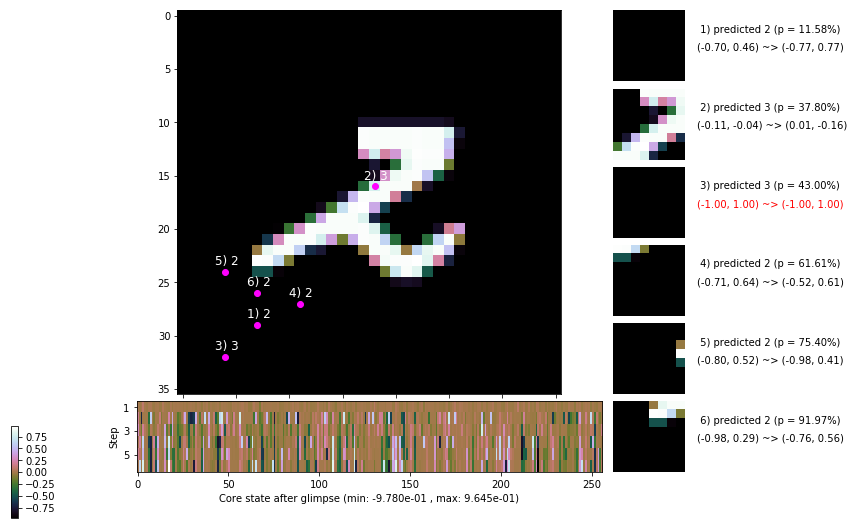

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 167.1 ms/b | lr: 5.70e-04 | grad 2norm:  7.78 | grad inf norm:  2.134
         Weights || abs max:  2.05 ( 3475.79) | mean: -6.24e-04 ( 0.02) | var: 6.86e-02 (  338.57)
          Biases || abs max:  1.30 (  174.46) | mean: -1.40e-01 ( 0.14) | var: 8.70e-02 (  562.53)
                    class loss: 0.306 | steps: 2.226 | reward:  4.489 | acc.: 89.75%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 160.7 ms/b | lr: 5.69e-04 | grad 2norm:  7.69 | grad inf norm:  2.108
         Weights || abs max:  2.05 (14811.86) | mean: -6.41e-04 ( 0.04) | var: 6.87e-02 (29859.75)
          Biases || abs max:  1.30 (  101.84) | mean: -1.40e-01 ( 0.11) | var: 8.71e-02 (   76.17)
                    class loss: 0.321 | steps: 2.250 | reward:  4.466 | acc.: 89.08%

	Target class: 6 | Discounted rewards: [1.111, 1.111, 1.1

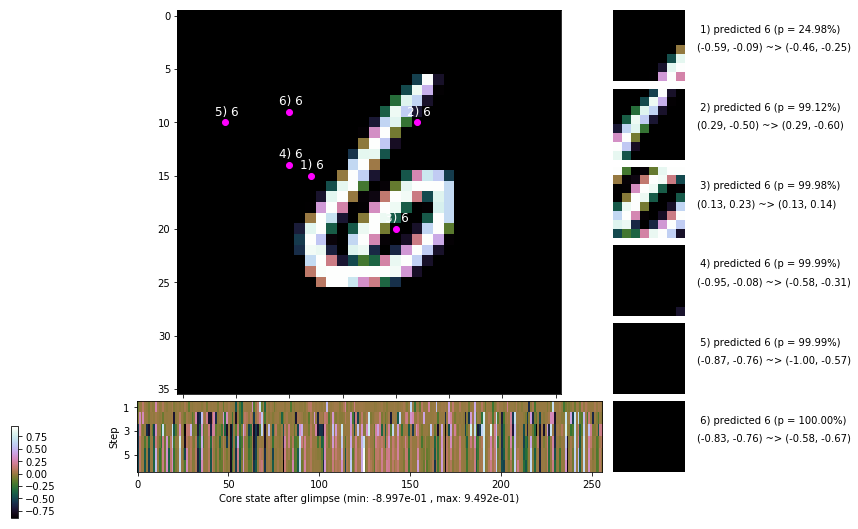

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.4 ms/b | lr: 5.68e-04 | grad 2norm:  7.92 | grad inf norm:  2.198
         Weights || abs max:  2.06 ( 3364.97) | mean: -6.13e-04 ( 0.02) | var: 6.87e-02 (  321.74)
          Biases || abs max:  1.30 (   85.55) | mean: -1.40e-01 ( 0.11) | var: 8.72e-02 (   50.16)
                    class loss: 0.336 | steps: 2.266 | reward:  4.436 | acc.: 88.92%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 156.7 ms/b | lr: 5.68e-04 | grad 2norm:  7.73 | grad inf norm:  2.078
         Weights || abs max:  2.05 ( 9541.91) | mean: -5.91e-04 ( 0.03) | var: 6.88e-02 (32807.68)
          Biases || abs max:  1.29 (  159.93) | mean: -1.40e-01 ( 0.15) | var: 8.73e-02 (   89.76)
                    class loss: 0.314 | steps: 2.243 | reward:  4.473 | acc.: 89.57%

	Target class: 8 | Discounted rewards: [0.001, 0.011, 0.1

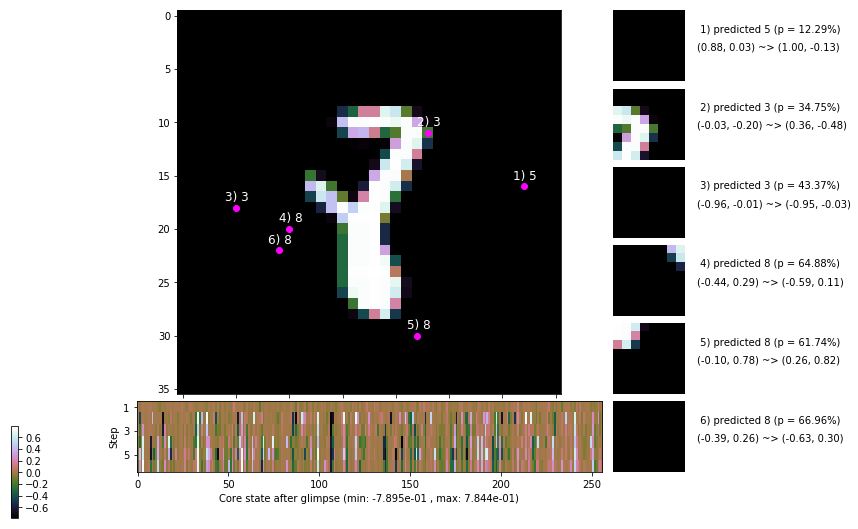

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 157.6 ms/b | lr: 5.66e-04 | grad 2norm:  7.80 | grad inf norm:  2.142
         Weights || abs max:  2.05 ( 4441.67) | mean: -5.76e-04 ( 0.02) | var: 6.89e-02 (  465.34)
          Biases || abs max:  1.29 (  192.64) | mean: -1.41e-01 ( 0.16) | var: 8.74e-02 (  434.68)
                    class loss: 0.338 | steps: 2.264 | reward:  4.436 | acc.: 88.83%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 155.3 ms/b | lr: 5.66e-04 | grad 2norm:  7.77 | grad inf norm:  2.213
         Weights || abs max:  2.05 ( 7402.84) | mean: -5.32e-04 ( 0.02) | var: 6.90e-02 (11807.02)
          Biases || abs max:  1.28 (  287.24) | mean: -1.40e-01 ( 0.21) | var: 8.73e-02 ( 2358.69)
                    class loss: 0.326 | steps: 2.244 | reward:  4.455 | acc.: 89.13%

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.1

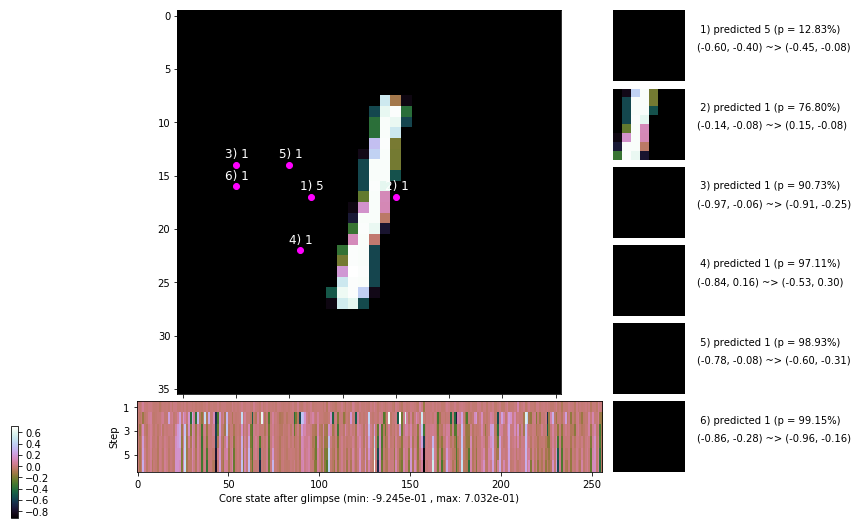

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


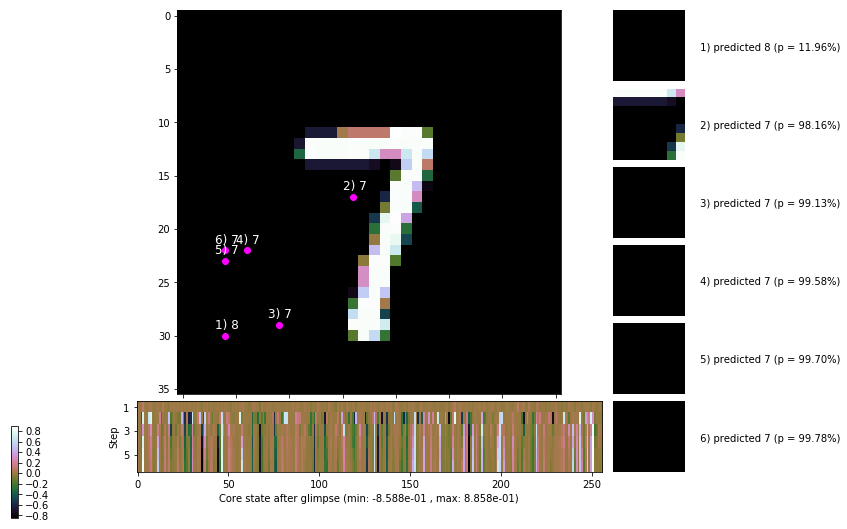


	Target class: 6 | Discounted rewards: [0.011, 0.111, 1.111, 1.110, 1.100, 1.000]


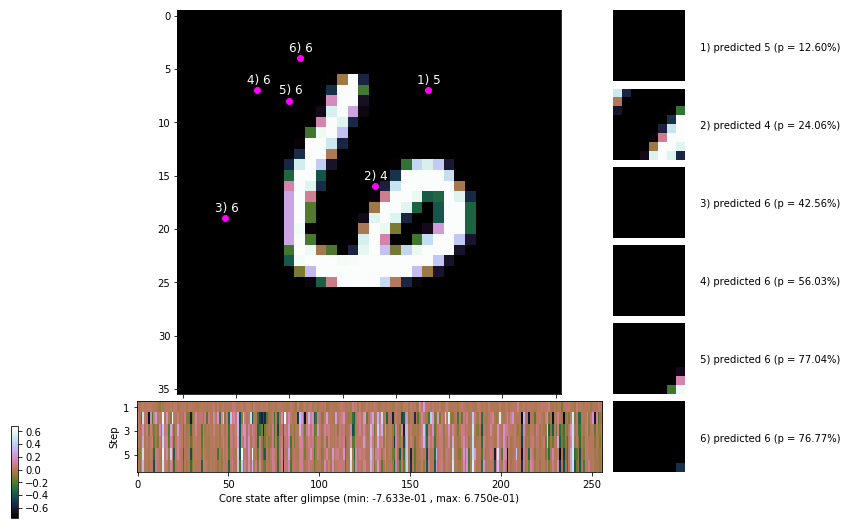

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


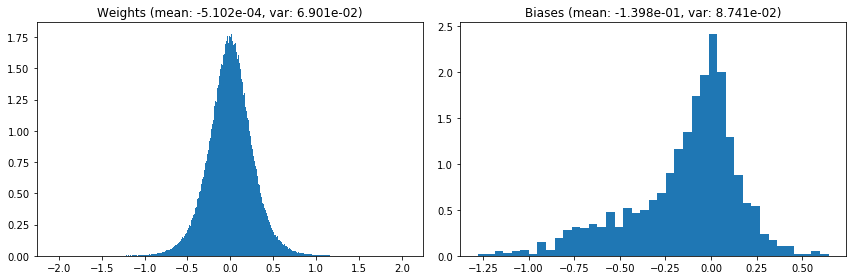

                                      Location network weights and biases


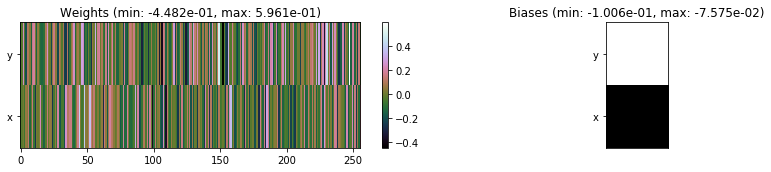

---------------------------------------------------------------------------------------------------------------
Elapsed time:  476.22 sec | TRAIN >> class loss: 0.3241 | steps:  2.250    | reward:  4.4568    | acc.: 89.210% 
                          | VAL   >> class loss: 0.3573 | steps:  2.207 :( | reward:  4.5152 :( | acc.: 88.340% :(


Epoch  39/400) lr = 0.0005654
 b    300/  3000 >> 153.7 ms/b | lr: 5.65e-04 | grad 2norm:  7.94 | grad inf norm:  2.227
         Weights || abs max:  2.05 ( 2661.86) | mean: -4.97e-04 ( 0.02) | var: 6.91e-02 (   86.15)
          Biases || abs max:  1.27 (  476.61) | mean: -1.40e-01 ( 0.32) | var: 8.75e-02 ( 7855.68)
                    class loss: 0.335 | steps: 2.277 | reward:  4.440 | acc.: 89.02%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 151.9 ms/b | lr: 5.64e-04 | grad 2norm:  7.79 | grad inf norm:  2.139
         Weights || abs max:  2.06 ( 2718.97) | mean: -4.98e-04 ( 0

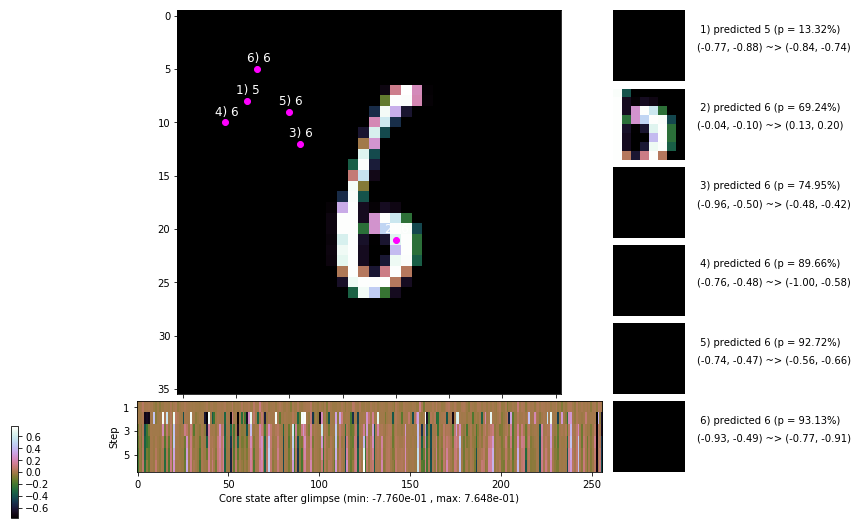

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 156.1 ms/b | lr: 5.63e-04 | grad 2norm:  8.11 | grad inf norm:  2.224
         Weights || abs max:  2.06 ( 9736.68) | mean: -5.06e-04 ( 0.03) | var: 6.92e-02 (19706.54)
          Biases || abs max:  1.28 (  194.53) | mean: -1.41e-01 ( 0.17) | var: 8.80e-02 (  287.33)
                    class loss: 0.356 | steps: 2.261 | reward:  4.437 | acc.: 88.25%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 153.0 ms/b | lr: 5.63e-04 | grad 2norm:  7.77 | grad inf norm:  2.052
         Weights || abs max:  2.06 (10394.14) | mean: -5.06e-04 ( 0.03) | var: 6.92e-02 (19893.05)
          Biases || abs max:  1.30 (  109.22) | mean: -1.41e-01 ( 0.14) | var: 8.81e-02 (   35.98)
                    class loss: 0.353 | steps: 2.291 | reward:  4.409 | acc.: 88.15%

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.1

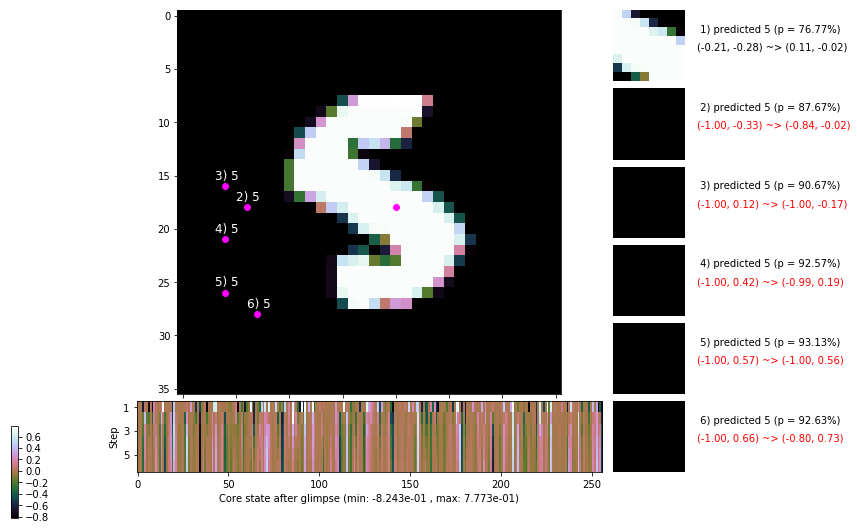

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 159.1 ms/b | lr: 5.61e-04 | grad 2norm:  7.92 | grad inf norm:  2.134
         Weights || abs max:  2.06 (68808.55) | mean: -4.81e-04 ( 0.14) | var: 6.93e-02 (2388687.50)
          Biases || abs max:  1.30 (  171.64) | mean: -1.41e-01 ( 0.14) | var: 8.82e-02 (  932.28)
                    class loss: 0.338 | steps: 2.272 | reward:  4.436 | acc.: 88.82%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 160.8 ms/b | lr: 5.61e-04 | grad 2norm:  7.92 | grad inf norm:  2.167
         Weights || abs max:  2.06 (23010.63) | mean: -5.01e-04 ( 0.05) | var: 6.94e-02 (211480.09)
          Biases || abs max:  1.30 (   99.94) | mean: -1.41e-01 ( 0.11) | var: 8.82e-02 (   24.08)
                    class loss: 0.327 | steps: 2.256 | reward:  4.452 | acc.: 89.27%

	Target class: 9 | Discounted rewards: [0.111, 1.111, 

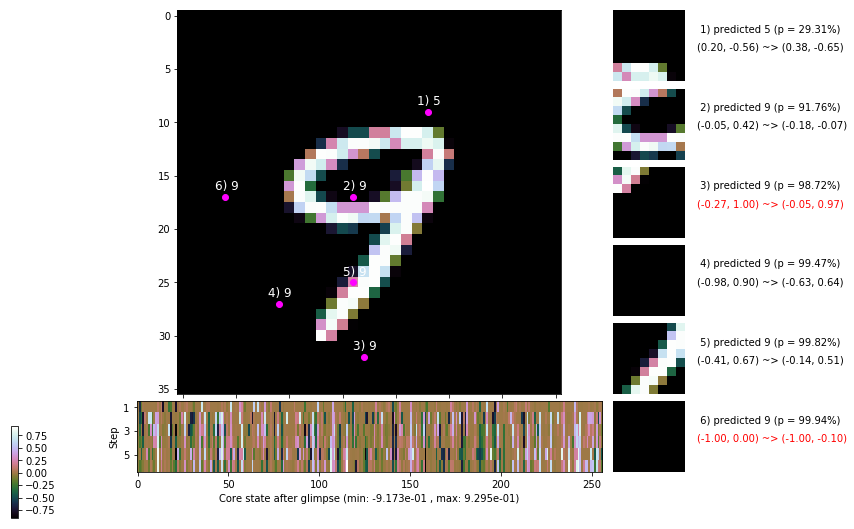

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 166.7 ms/b | lr: 5.60e-04 | grad 2norm:  7.72 | grad inf norm:  2.172
         Weights || abs max:  2.06 ( 3277.43) | mean: -5.27e-04 ( 0.02) | var: 6.94e-02 (  360.93)
          Biases || abs max:  1.31 (  210.85) | mean: -1.40e-01 ( 0.19) | var: 8.81e-02 ( 1130.12)
                    class loss: 0.329 | steps: 2.260 | reward:  4.455 | acc.: 88.80%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 161.9 ms/b | lr: 5.59e-04 | grad 2norm:  7.77 | grad inf norm:  2.141
         Weights || abs max:  2.06 ( 2552.20) | mean: -5.33e-04 ( 0.01) | var: 6.95e-02 (   87.59)
          Biases || abs max:  1.32 (  238.36) | mean: -1.40e-01 ( 0.17) | var: 8.82e-02 (  432.48)
                    class loss: 0.328 | steps: 2.243 | reward:  4.456 | acc.: 89.17%

	Target class: 0 | Discounted rewards: [0.111, 1.111, 1.1

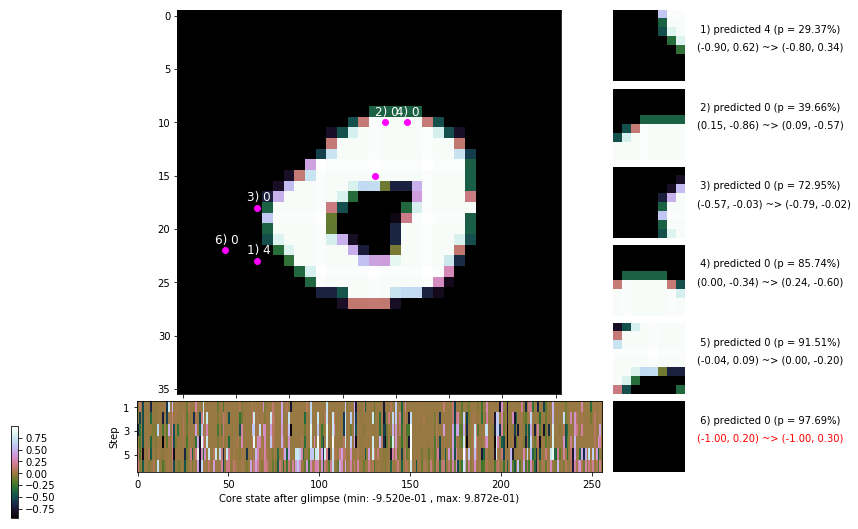

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 160.2 ms/b | lr: 5.58e-04 | grad 2norm:  7.73 | grad inf norm:  2.135
         Weights || abs max:  2.06 ( 4284.19) | mean: -5.21e-04 ( 0.02) | var: 6.96e-02 (  382.15)
          Biases || abs max:  1.32 (  135.34) | mean: -1.40e-01 ( 0.14) | var: 8.83e-02 (   56.43)
                    class loss: 0.330 | steps: 2.251 | reward:  4.450 | acc.: 89.05%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 155.3 ms/b | lr: 5.58e-04 | grad 2norm:  7.79 | grad inf norm:  2.115
         Weights || abs max:  2.06 ( 9494.26) | mean: -4.82e-04 ( 0.03) | var: 6.97e-02 ( 8788.26)
          Biases || abs max:  1.32 (  146.50) | mean: -1.40e-01 ( 0.15) | var: 8.85e-02 (  122.28)
                    class loss: 0.346 | steps: 2.273 | reward:  4.434 | acc.: 88.07%

	Target class: 0 | Discounted rewards: [0.111, 1.111, 1.1

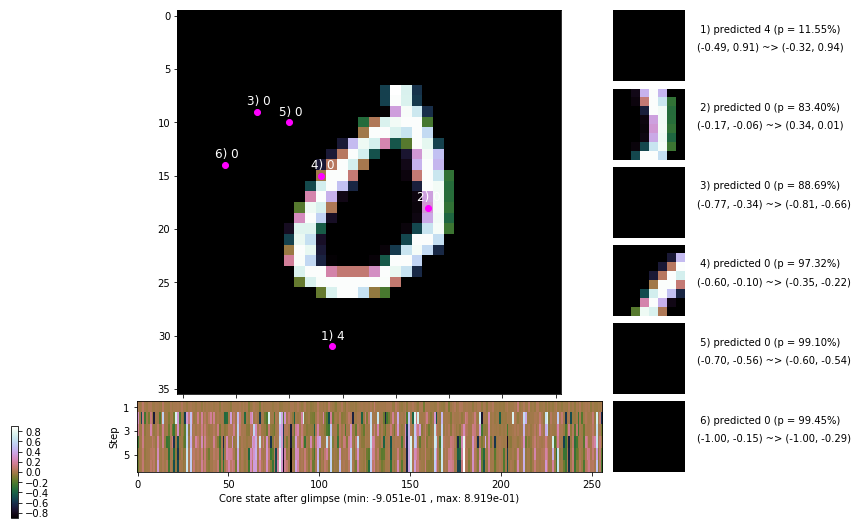

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


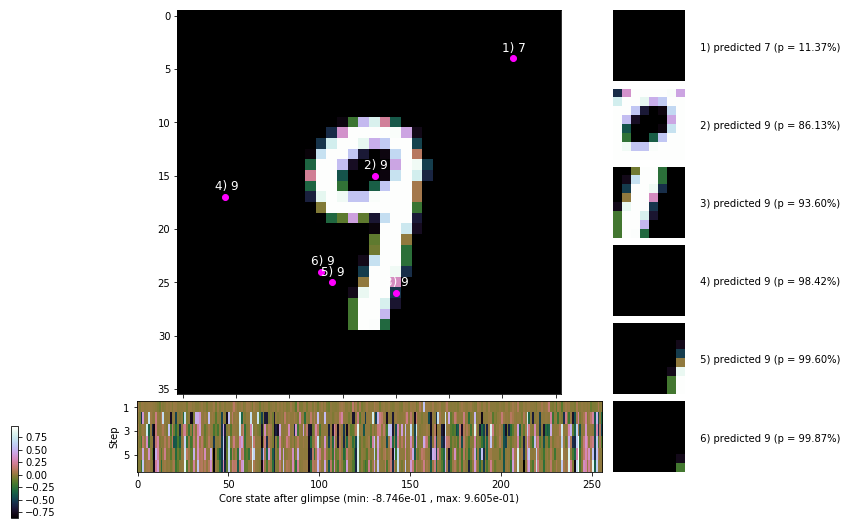


	Target class: 0 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


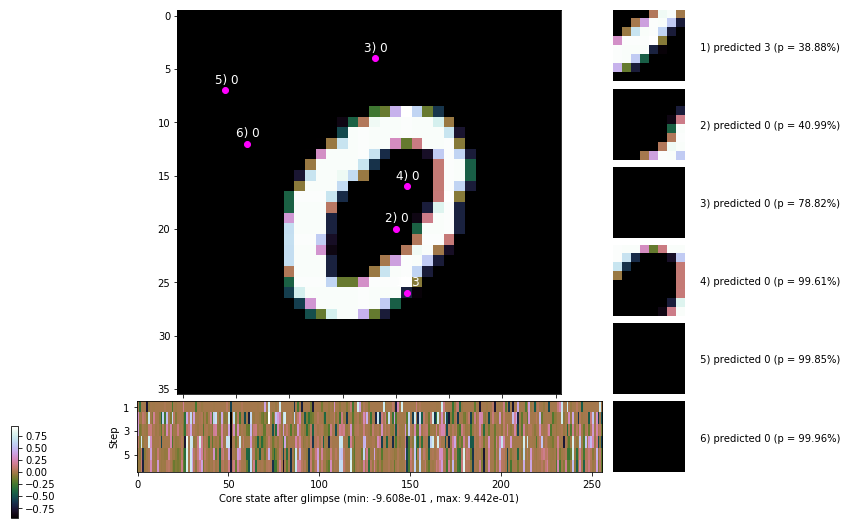

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


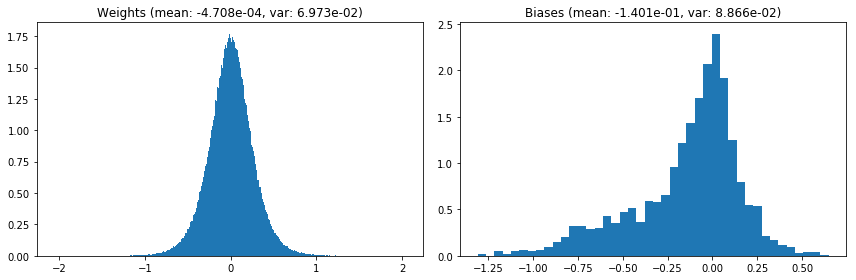

                                      Location network weights and biases


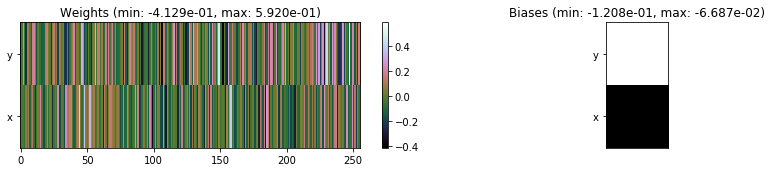

---------------------------------------------------------------------------------------------------------------
Elapsed time:  474.22 sec | TRAIN >> class loss: 0.3372 | steps:  2.264 :( | reward:  4.4425 :( | acc.: 88.788% :(
                          | VAL   >> class loss: 0.3419 | steps:  2.152    | reward:  4.5538 :( | acc.: 87.960% :(


Epoch  40/400) lr = 0.0005569
 b    300/  3000 >> 154.3 ms/b | lr: 5.56e-04 | grad 2norm:  7.79 | grad inf norm:  2.174
         Weights || abs max:  2.06 (10110.06) | mean: -4.67e-04 ( 0.03) | var: 6.98e-02 (12363.29)
          Biases || abs max:  1.30 (  177.06) | mean: -1.40e-01 ( 0.16) | var: 8.87e-02 (  279.15)
                    class loss: 0.349 | steps: 2.250 | reward:  4.441 | acc.: 88.45%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 151.7 ms/b | lr: 5.56e-04 | grad 2norm:  7.66 | grad inf norm:  2.015
         Weights || abs max:  2.06 ( 2205.37) | mean: -4.40e-04 (

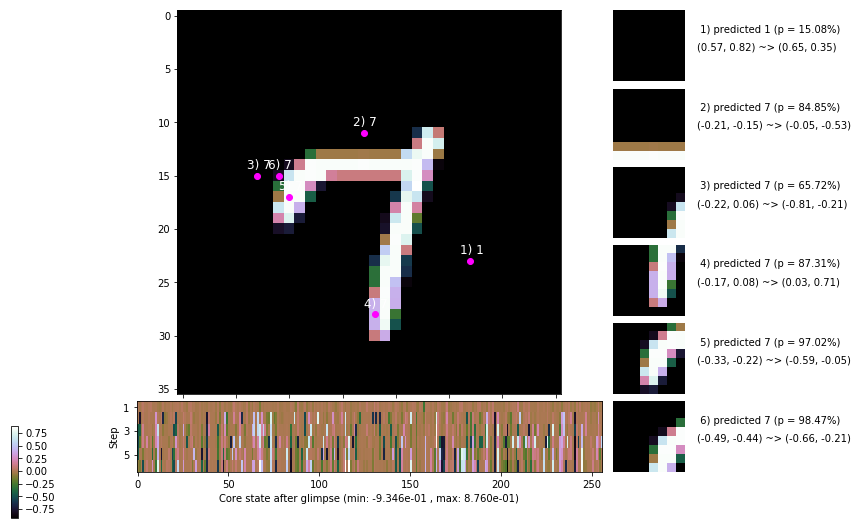

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 156.4 ms/b | lr: 5.55e-04 | grad 2norm:  7.62 | grad inf norm:  2.141
         Weights || abs max:  2.07 ( 6053.92) | mean: -4.26e-04 ( 0.02) | var: 6.99e-02 ( 3346.13)
          Biases || abs max:  1.31 (  222.16) | mean: -1.40e-01 ( 0.19) | var: 8.89e-02 (  190.48)
                    class loss: 0.331 | steps: 2.209 | reward:  4.495 | acc.: 89.40%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 152.3 ms/b | lr: 5.54e-04 | grad 2norm:  7.79 | grad inf norm:  2.150
         Weights || abs max:  2.06 ( 4363.39) | mean: -4.71e-04 ( 0.02) | var: 7.00e-02 ( 2085.87)
          Biases || abs max:  1.30 (  364.38) | mean: -1.41e-01 ( 0.25) | var: 8.90e-02 ( 1803.50)
                    class loss: 0.348 | steps: 2.259 | reward:  4.440 | acc.: 88.45%

	Target class: 0 | Discounted rewards: [0.111, 1.111, 1.1

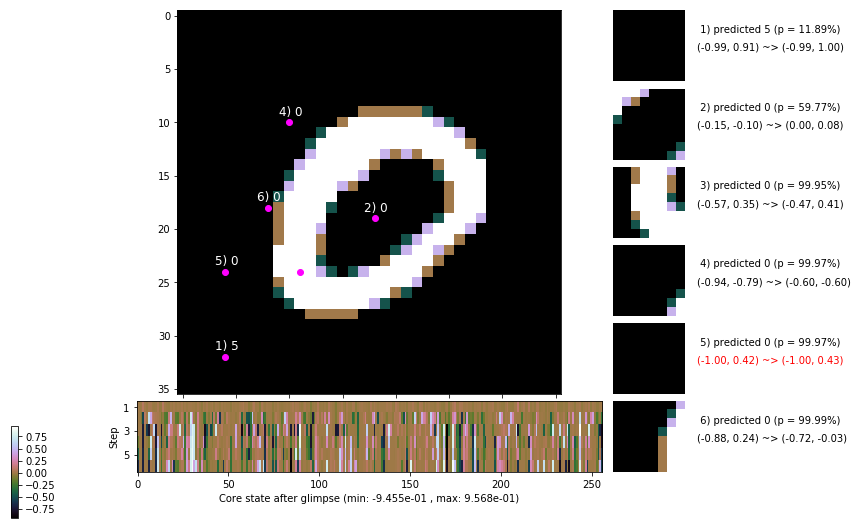

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 157.0 ms/b | lr: 5.53e-04 | grad 2norm:  7.87 | grad inf norm:  2.198
         Weights || abs max:  2.06 ( 5311.23) | mean: -4.80e-04 ( 0.02) | var: 7.00e-02 ( 2318.89)
          Biases || abs max:  1.30 (  212.00) | mean: -1.41e-01 ( 0.19) | var: 8.91e-02 (  385.31)
                    class loss: 0.336 | steps: 2.251 | reward:  4.434 | acc.: 88.23%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 155.2 ms/b | lr: 5.53e-04 | grad 2norm:  7.78 | grad inf norm:  2.236
         Weights || abs max:  2.07 (40372.46) | mean: -4.61e-04 ( 0.09) | var: 7.01e-02 (364690.69)
          Biases || abs max:  1.30 (  178.52) | mean: -1.41e-01 ( 0.16) | var: 8.94e-02 (  506.59)
                    class loss: 0.349 | steps: 2.266 | reward:  4.433 | acc.: 88.30%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.

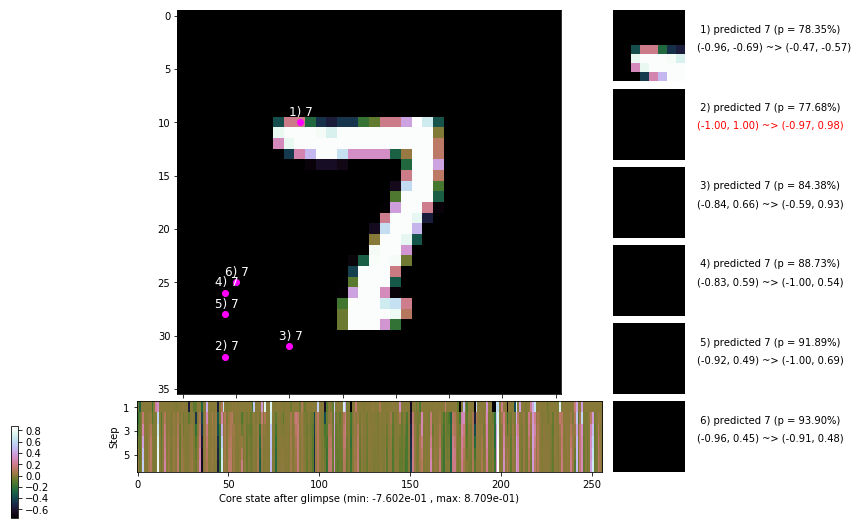

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.1 ms/b | lr: 5.51e-04 | grad 2norm:  7.87 | grad inf norm:  2.104
         Weights || abs max:  2.06 ( 2908.22) | mean: -4.89e-04 ( 0.02) | var: 7.02e-02 (  116.81)
          Biases || abs max:  1.31 (  303.16) | mean: -1.42e-01 ( 0.20) | var: 8.95e-02 ( 3277.15)
                    class loss: 0.350 | steps: 2.264 | reward:  4.434 | acc.: 88.67%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 161.1 ms/b | lr: 5.51e-04 | grad 2norm:  7.82 | grad inf norm:  2.218
         Weights || abs max:  2.05 ( 3949.01) | mean: -4.89e-04 ( 0.02) | var: 7.02e-02 (  420.04)
          Biases || abs max:  1.31 (  169.19) | mean: -1.42e-01 ( 0.16) | var: 8.96e-02 (  282.76)
                    class loss: 0.352 | steps: 2.244 | reward:  4.435 | acc.: 88.20%

	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.1

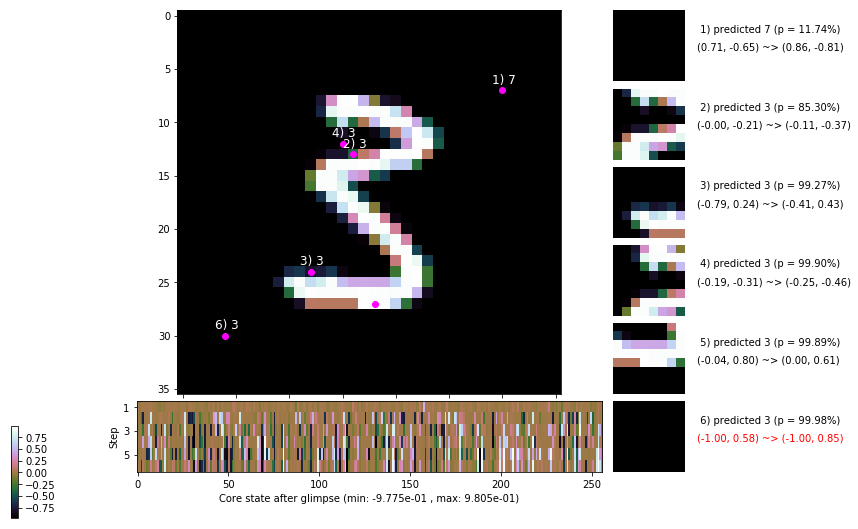

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 158.1 ms/b | lr: 5.50e-04 | grad 2norm:  7.64 | grad inf norm:  2.140
         Weights || abs max:  2.06 ( 2610.91) | mean: -5.03e-04 ( 0.01) | var: 7.03e-02 (  111.96)
          Biases || abs max:  1.30 (  207.07) | mean: -1.42e-01 ( 0.16) | var: 9.00e-02 (  241.28)
                    class loss: 0.335 | steps: 2.239 | reward:  4.465 | acc.: 89.20%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 166.1 ms/b | lr: 5.49e-04 | grad 2norm:  8.14 | grad inf norm:  2.203
         Weights || abs max:  2.06 (20346.21) | mean: -5.14e-04 ( 0.05) | var: 7.03e-02 (158725.20)
          Biases || abs max:  1.30 (  312.29) | mean: -1.42e-01 ( 0.23) | var: 9.01e-02 ( 1063.24)
                    class loss: 0.362 | steps: 2.268 | reward:  4.416 | acc.: 87.73%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.

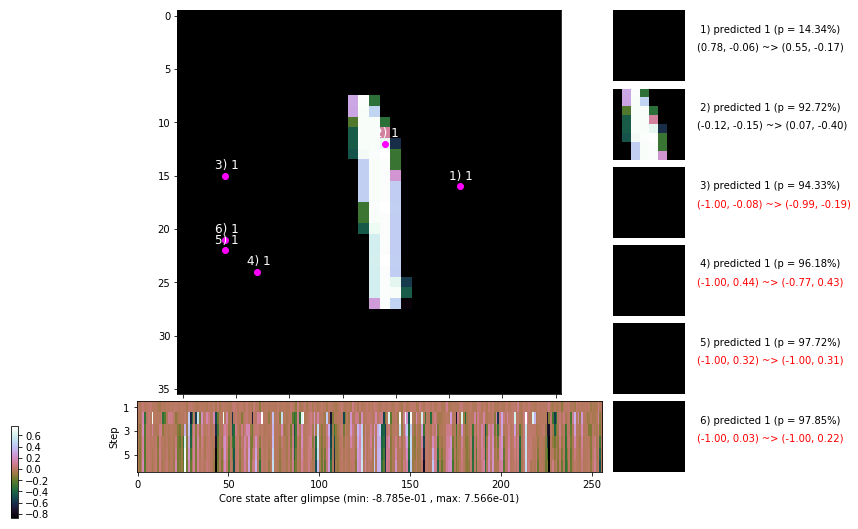

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


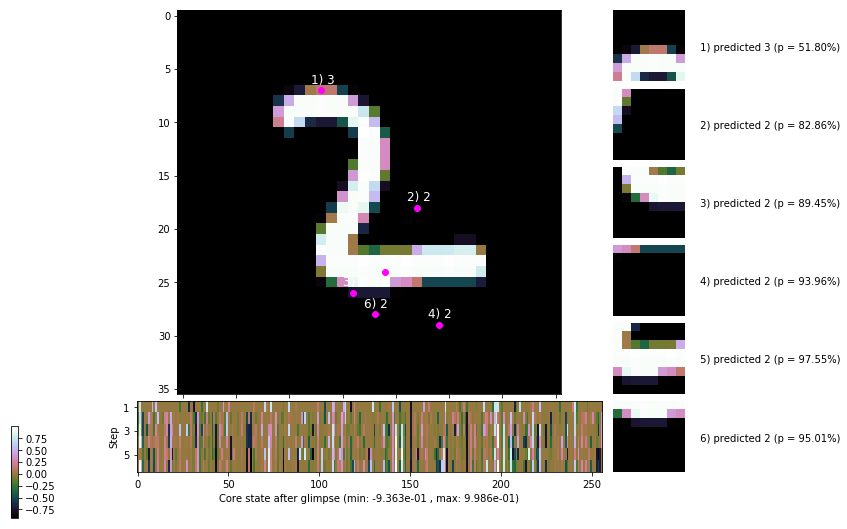


	Target class: 6 | Discounted rewards: [0.001, 0.011, 0.111, 1.110, 1.100, 1.000]


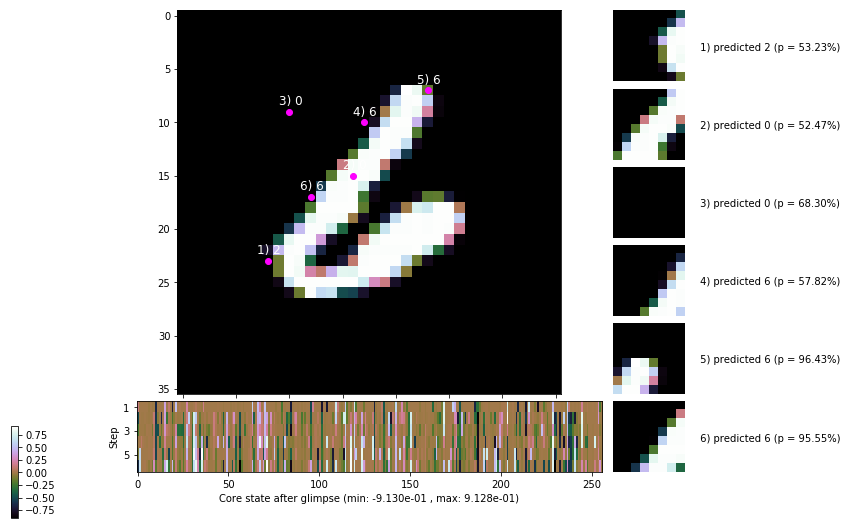

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


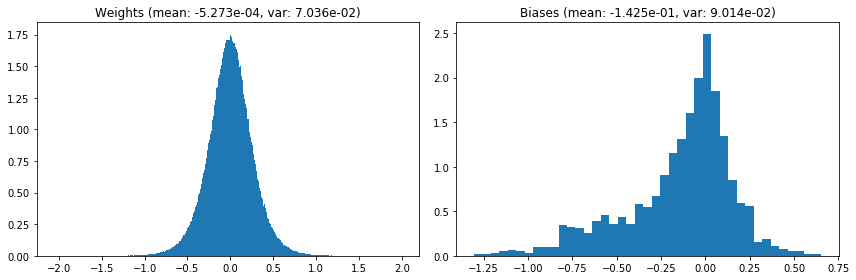

                                      Location network weights and biases


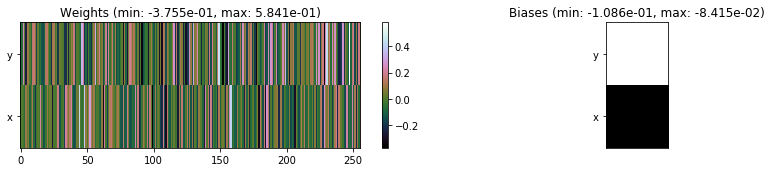

---------------------------------------------------------------------------------------------------------------
Elapsed time:  471.24 sec | TRAIN >> class loss: 0.3445 | steps:  2.248    | reward:  4.4465 :( | acc.: 88.575% :(
                          | VAL   >> class loss: 0.3776 | steps:  2.178 :( | reward:  4.5124 :( | acc.: 86.900% :(


Epoch  41/400) lr = 0.0005486
 b    300/  3000 >> 163.4 ms/b | lr: 5.48e-04 | grad 2norm:  7.65 | grad inf norm:  2.103
         Weights || abs max:  2.06 ( 3533.06) | mean: -5.30e-04 ( 0.02) | var: 7.04e-02 (  187.51)
          Biases || abs max:  1.30 (  398.17) | mean: -1.42e-01 ( 0.25) | var: 9.00e-02 ( 1936.18)
                    class loss: 0.336 | steps: 2.244 | reward:  4.469 | acc.: 88.80%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 159.6 ms/b | lr: 5.48e-04 | grad 2norm:  7.71 | grad inf norm:  2.157
         Weights || abs max:  2.06 ( 4076.49) | mean: -5.41e-04 (

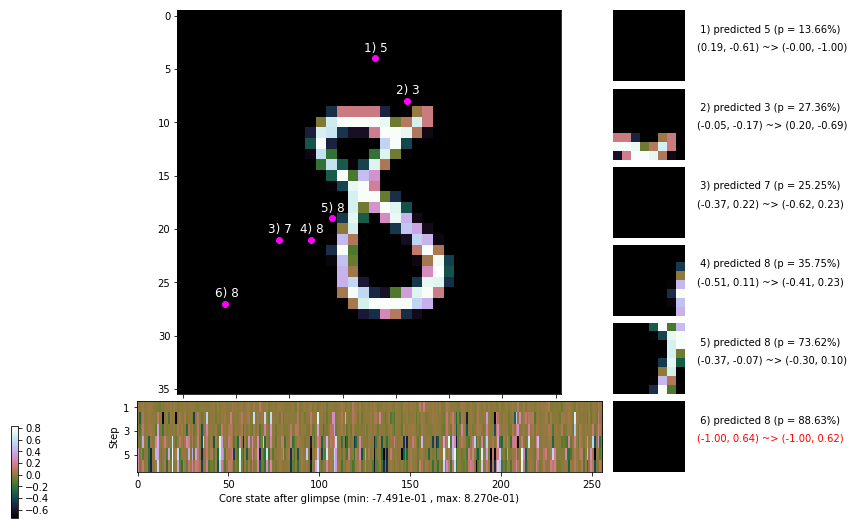

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 158.4 ms/b | lr: 5.46e-04 | grad 2norm:  7.85 | grad inf norm:  2.140
         Weights || abs max:  2.07 (17431.45) | mean: -5.31e-04 ( 0.04) | var: 7.05e-02 (62032.52)
          Biases || abs max:  1.30 (  129.01) | mean: -1.42e-01 ( 0.15) | var: 9.00e-02 (   67.16)
                    class loss: 0.366 | steps: 2.284 | reward:  4.411 | acc.: 87.98%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 153.1 ms/b | lr: 5.46e-04 | grad 2norm:  7.76 | grad inf norm:  2.137
         Weights || abs max:  2.07 ( 8927.62) | mean: -5.42e-04 ( 0.03) | var: 7.06e-02 (13354.67)
          Biases || abs max:  1.31 (  129.43) | mean: -1.43e-01 ( 0.14) | var: 9.03e-02 (  186.27)
                    class loss: 0.357 | steps: 2.282 | reward:  4.416 | acc.: 88.03%

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.1

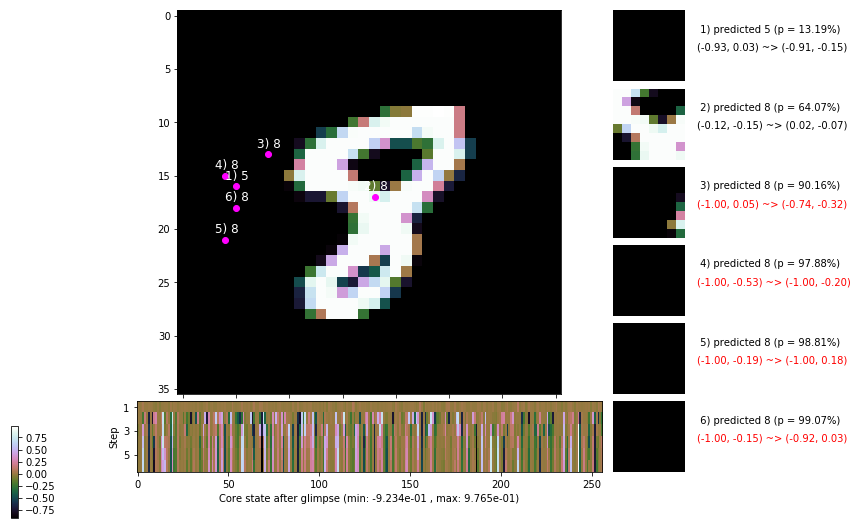

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 157.8 ms/b | lr: 5.45e-04 | grad 2norm:  7.80 | grad inf norm:  2.128
         Weights || abs max:  2.06 ( 2105.18) | mean: -5.32e-04 ( 0.01) | var: 7.07e-02 (   49.40)
          Biases || abs max:  1.31 (  312.05) | mean: -1.42e-01 ( 0.21) | var: 9.02e-02 ( 2107.90)
                    class loss: 0.344 | steps: 2.293 | reward:  4.413 | acc.: 88.37%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 155.1 ms/b | lr: 5.44e-04 | grad 2norm:  7.77 | grad inf norm:  2.181
         Weights || abs max:  2.06 ( 3742.40) | mean: -5.34e-04 ( 0.02) | var: 7.07e-02 (  279.65)
          Biases || abs max:  1.30 (  132.63) | mean: -1.42e-01 ( 0.14) | var: 9.01e-02 (   85.49)
                    class loss: 0.335 | steps: 2.233 | reward:  4.458 | acc.: 88.77%

	Target class: 1 | Discounted rewards: [0.000, 0.000, 0.0

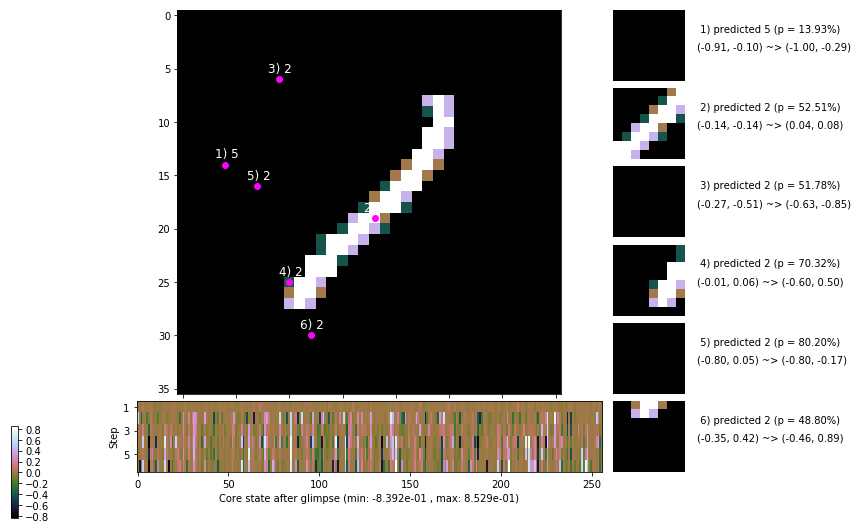

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 155.2 ms/b | lr: 5.43e-04 | grad 2norm:  7.81 | grad inf norm:  2.256
         Weights || abs max:  2.06 ( 3116.36) | mean: -5.38e-04 ( 0.02) | var: 7.08e-02 (  163.25)
          Biases || abs max:  1.30 (  729.87) | mean: -1.42e-01 ( 0.37) | var: 9.02e-02 (46646.57)
                    class loss: 0.362 | steps: 2.275 | reward:  4.422 | acc.: 88.12%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 157.0 ms/b | lr: 5.43e-04 | grad 2norm:  7.91 | grad inf norm:  2.218
         Weights || abs max:  2.07 ( 4532.19) | mean: -5.54e-04 ( 0.02) | var: 7.09e-02 (  513.87)
          Biases || abs max:  1.30 (  105.68) | mean: -1.42e-01 ( 0.13) | var: 9.05e-02 (   24.60)
                    class loss: 0.376 | steps: 2.277 | reward:  4.397 | acc.: 87.65%

	Target class: 3 | Discounted rewards: [0.011, 0.111, 1.1

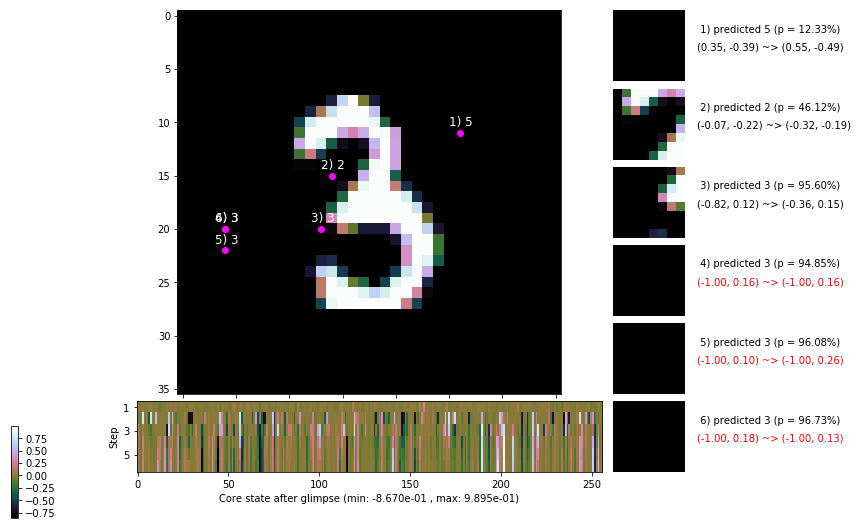

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.3 ms/b | lr: 5.42e-04 | grad 2norm:  8.03 | grad inf norm:  2.253
         Weights || abs max:  2.07 ( 3170.06) | mean: -5.32e-04 ( 0.02) | var: 7.09e-02 (  156.02)
          Biases || abs max:  1.31 (  238.31) | mean: -1.42e-01 ( 0.19) | var: 9.06e-02 (  547.68)
                    class loss: 0.358 | steps: 2.267 | reward:  4.431 | acc.: 87.97%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 155.5 ms/b | lr: 5.41e-04 | grad 2norm:  8.04 | grad inf norm:  2.277
         Weights || abs max:  2.07 ( 2661.67) | mean: -5.25e-04 ( 0.01) | var: 7.10e-02 (  235.91)
          Biases || abs max:  1.32 (  226.78) | mean: -1.42e-01 ( 0.18) | var: 9.06e-02 (  668.27)
                    class loss: 0.366 | steps: 2.284 | reward:  4.392 | acc.: 87.60%

	Target class: 8 | Discounted rewards: [0.101, 1.011, 0.1

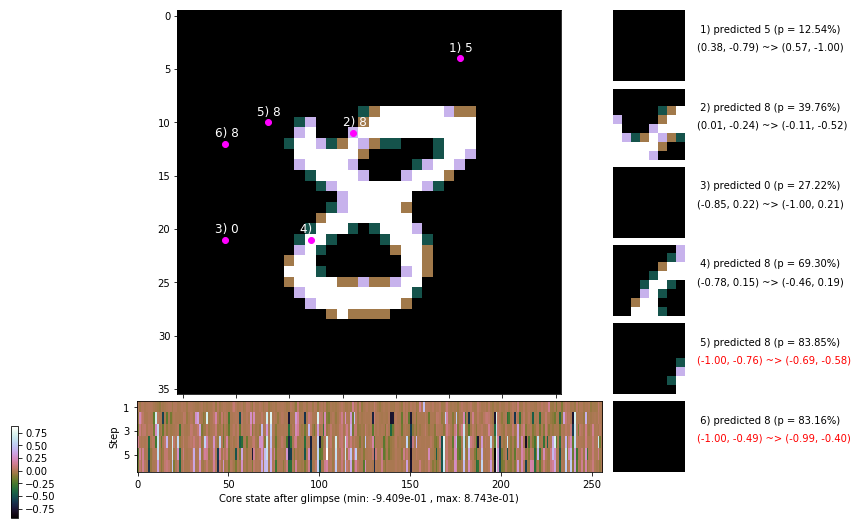

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.110, 1.100, 1.000, 0.000]


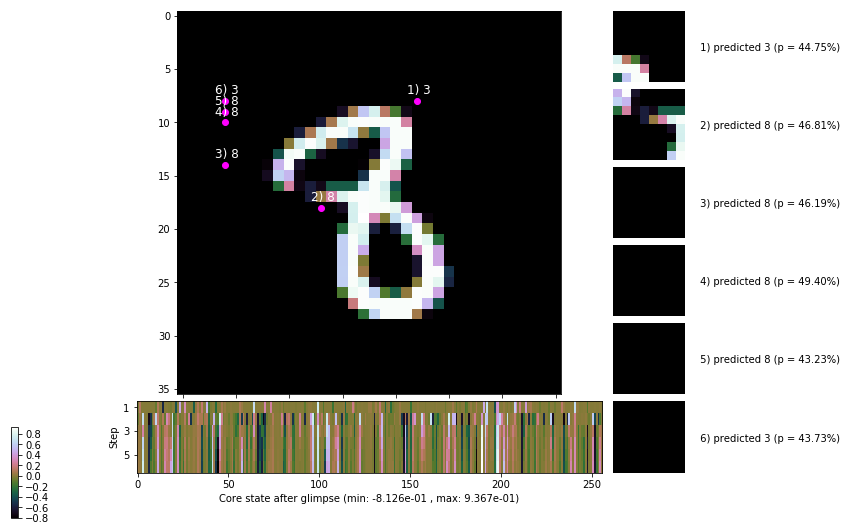


	Target class: 8 | Discounted rewards: [1.011, 0.111, 1.111, 1.110, 1.100, 1.000]


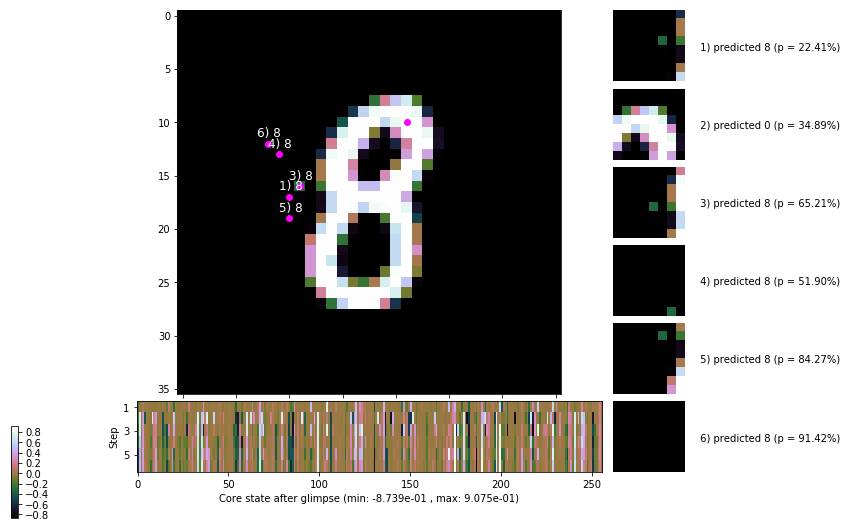

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


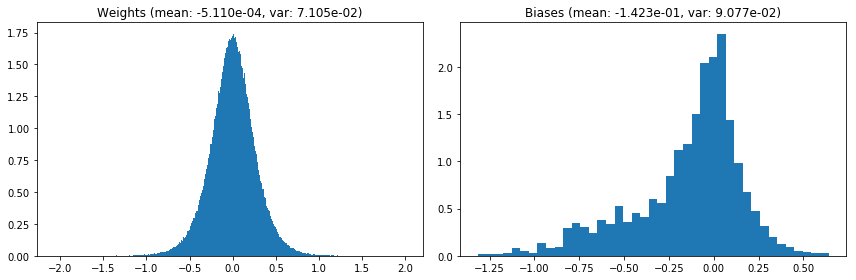

                                      Location network weights and biases


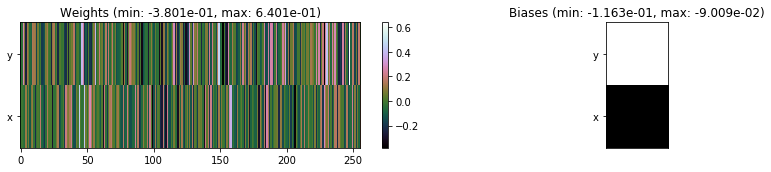

---------------------------------------------------------------------------------------------------------------
Elapsed time:  471.61 sec | TRAIN >> class loss: 0.3545 | steps:  2.268 :( | reward:  4.4270 :( | acc.: 88.162% :(
                          | VAL   >> class loss: 0.4103 | steps:  2.222 :( | reward:  4.4470 :( | acc.: 86.060% :(


Epoch  42/400) lr = 0.0005405
 b    300/  3000 >> 161.1 ms/b | lr: 5.40e-04 | grad 2norm:  7.58 | grad inf norm:  2.153
         Weights || abs max:  2.07 ( 3903.11) | mean: -5.21e-04 ( 0.02) | var: 7.11e-02 (  642.69)
          Biases || abs max:  1.32 (  306.51) | mean: -1.42e-01 ( 0.21) | var: 9.08e-02 ( 1100.02)
                    class loss: 0.337 | steps: 2.241 | reward:  4.449 | acc.: 88.60%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 168.1 ms/b | lr: 5.39e-04 | grad 2norm:  7.85 | grad inf norm:  2.132
         Weights || abs max:  2.08 ( 2924.65) | mean: -5.26e-04 (

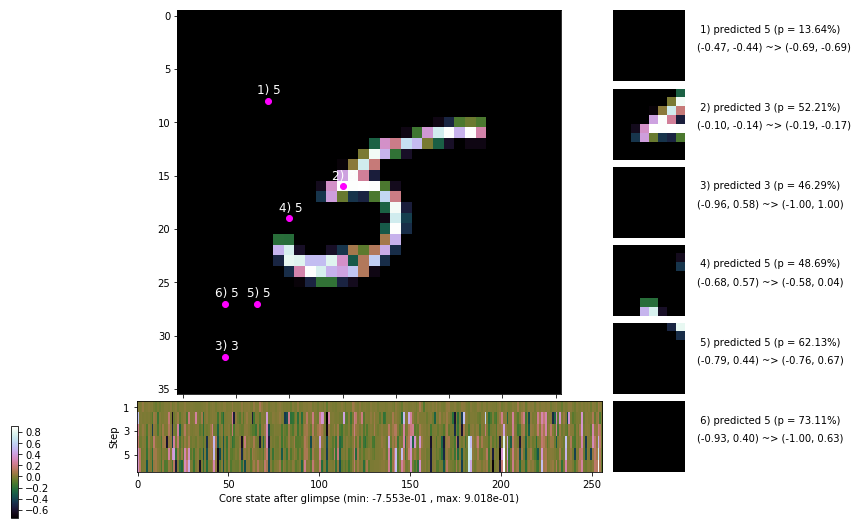

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 162.2 ms/b | lr: 5.38e-04 | grad 2norm:  7.97 | grad inf norm:  2.165
         Weights || abs max:  2.08 ( 2282.34) | mean: -5.12e-04 ( 0.01) | var: 7.12e-02 (   62.59)
          Biases || abs max:  1.30 (  524.41) | mean: -1.43e-01 ( 0.40) | var: 9.11e-02 (23781.58)
                    class loss: 0.352 | steps: 2.241 | reward:  4.452 | acc.: 88.37%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 160.3 ms/b | lr: 5.38e-04 | grad 2norm:  7.66 | grad inf norm:  2.043
         Weights || abs max:  2.08 ( 2850.25) | mean: -5.25e-04 ( 0.02) | var: 7.13e-02 (  186.49)
          Biases || abs max:  1.30 (  154.25) | mean: -1.43e-01 ( 0.13) | var: 9.12e-02 (  981.56)
                    class loss: 0.325 | steps: 2.232 | reward:  4.473 | acc.: 89.37%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.1

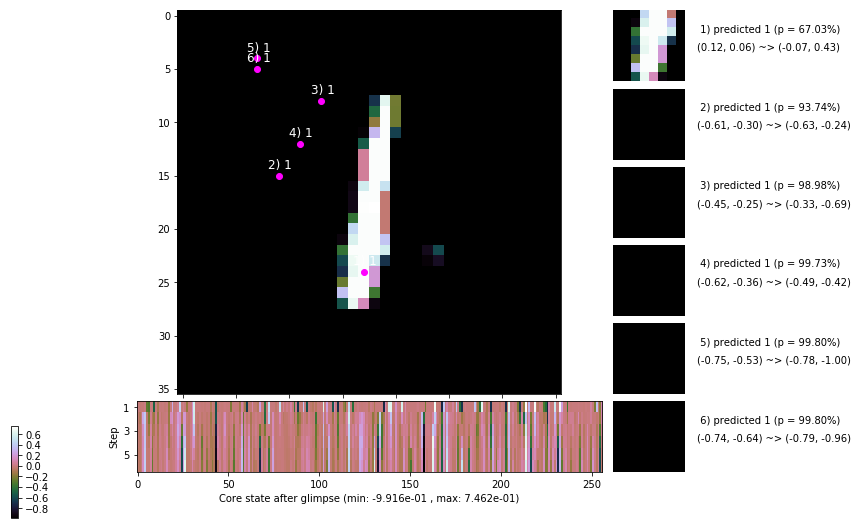

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 157.4 ms/b | lr: 5.37e-04 | grad 2norm:  7.70 | grad inf norm:  2.173
         Weights || abs max:  2.08 (21355.26) | mean: -5.07e-04 ( 0.05) | var: 7.13e-02 (109320.47)
          Biases || abs max:  1.30 (  130.21) | mean: -1.43e-01 ( 0.13) | var: 9.12e-02 (  106.64)
                    class loss: 0.334 | steps: 2.257 | reward:  4.447 | acc.: 88.93%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 154.9 ms/b | lr: 5.36e-04 | grad 2norm:  7.66 | grad inf norm:  2.077
         Weights || abs max:  2.09 ( 3716.99) | mean: -5.07e-04 ( 0.02) | var: 7.14e-02 (  473.24)
          Biases || abs max:  1.30 (  210.40) | mean: -1.43e-01 ( 0.19) | var: 9.13e-02 ( 1209.07)
                    class loss: 0.305 | steps: 2.243 | reward:  4.473 | acc.: 89.87%

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.

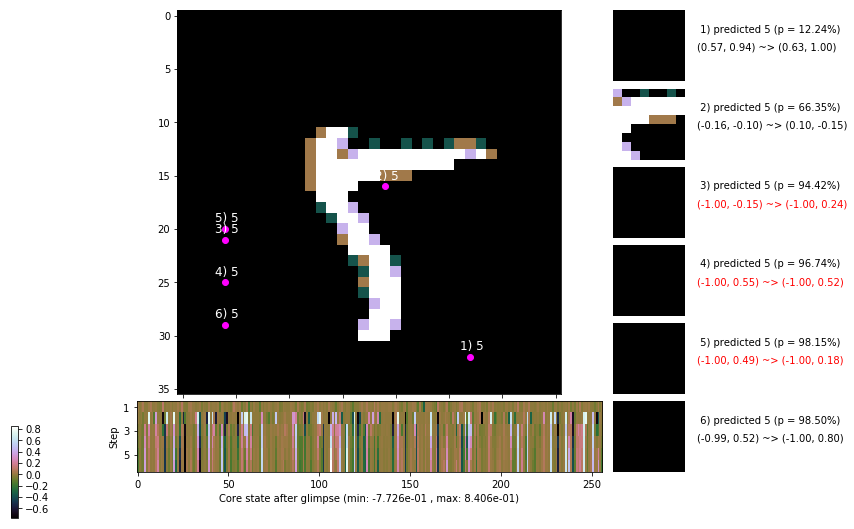

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.2 ms/b | lr: 5.35e-04 | grad 2norm:  7.98 | grad inf norm:  2.240
         Weights || abs max:  2.10 ( 3668.48) | mean: -5.05e-04 ( 0.02) | var: 7.14e-02 (  295.22)
          Biases || abs max:  1.30 (  459.85) | mean: -1.43e-01 ( 0.26) | var: 9.16e-02 (14791.08)
                    class loss: 0.316 | steps: 2.249 | reward:  4.452 | acc.: 89.23%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 156.2 ms/b | lr: 5.35e-04 | grad 2norm:  7.81 | grad inf norm:  2.141
         Weights || abs max:  2.10 ( 4218.99) | mean: -5.03e-04 ( 0.02) | var: 7.15e-02 (  633.51)
          Biases || abs max:  1.30 (  145.96) | mean: -1.43e-01 ( 0.15) | var: 9.15e-02 (  214.24)
                    class loss: 0.312 | steps: 2.211 | reward:  4.487 | acc.: 89.78%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.0

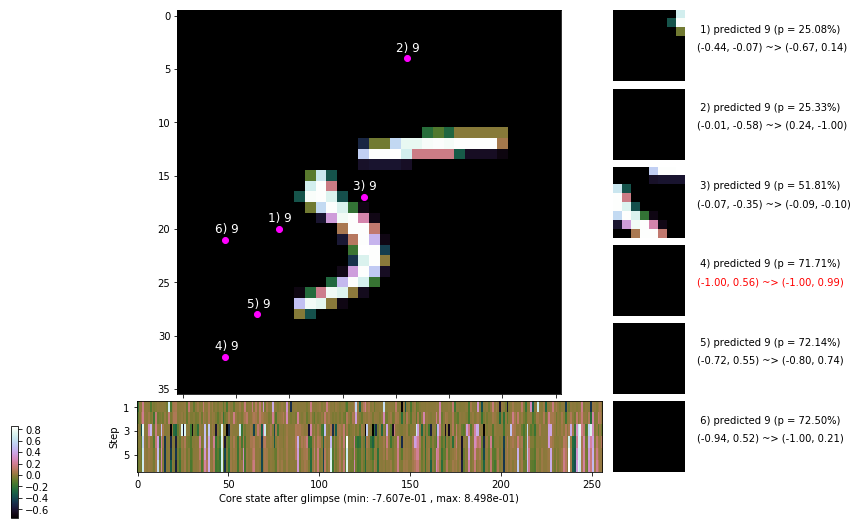

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 153.7 ms/b | lr: 5.33e-04 | grad 2norm:  7.71 | grad inf norm:  2.166
         Weights || abs max:  2.09 ( 6126.99) | mean: -5.34e-04 ( 0.02) | var: 7.16e-02 ( 1053.86)
          Biases || abs max:  1.31 (  175.71) | mean: -1.43e-01 ( 0.16) | var: 9.16e-02 (  215.59)
                    class loss: 0.325 | steps: 2.249 | reward:  4.465 | acc.: 89.40%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 154.3 ms/b | lr: 5.33e-04 | grad 2norm:  7.68 | grad inf norm:  2.109
         Weights || abs max:  2.09 ( 4243.85) | mean: -5.45e-04 ( 0.02) | var: 7.16e-02 ( 1221.24)
          Biases || abs max:  1.30 (  122.89) | mean: -1.43e-01 ( 0.13) | var: 9.17e-02 (  116.73)
                    class loss: 0.319 | steps: 2.232 | reward:  4.484 | acc.: 89.17%

	Target class: 4 | Discounted rewards: [0.111, 1.111, 1.1

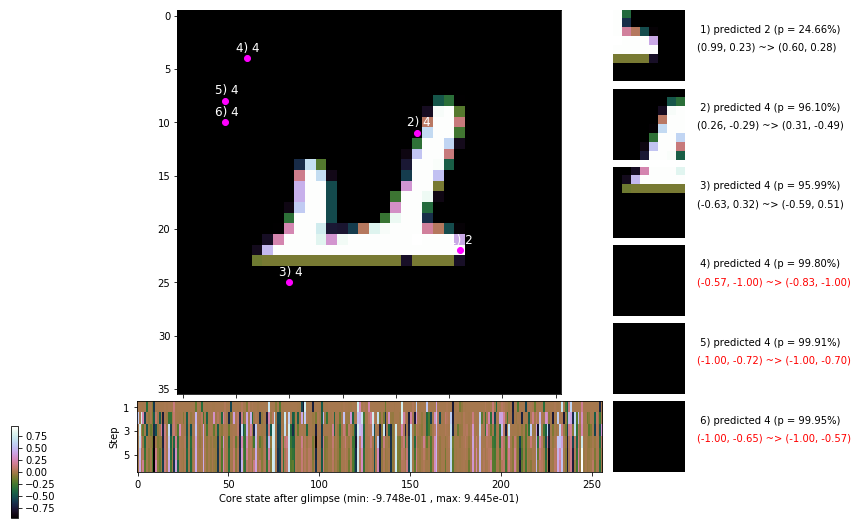

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [0.001, 0.011, 0.111, 1.110, 1.100, 1.000]


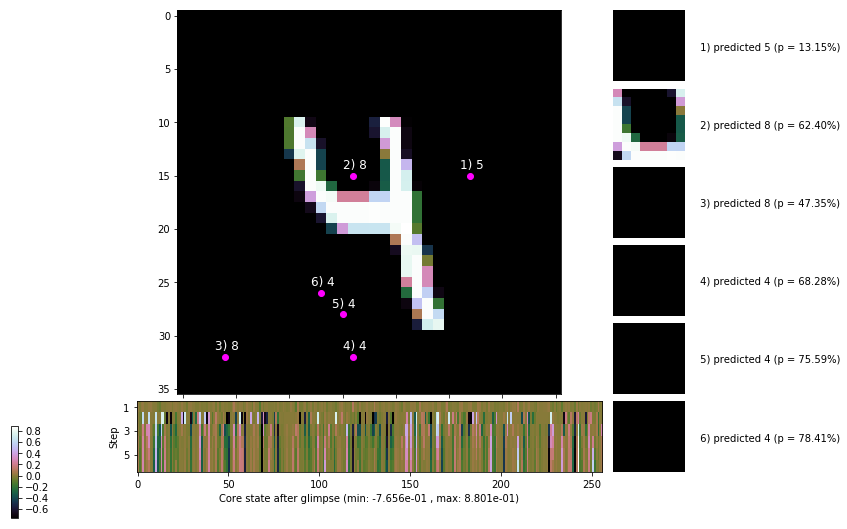


	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


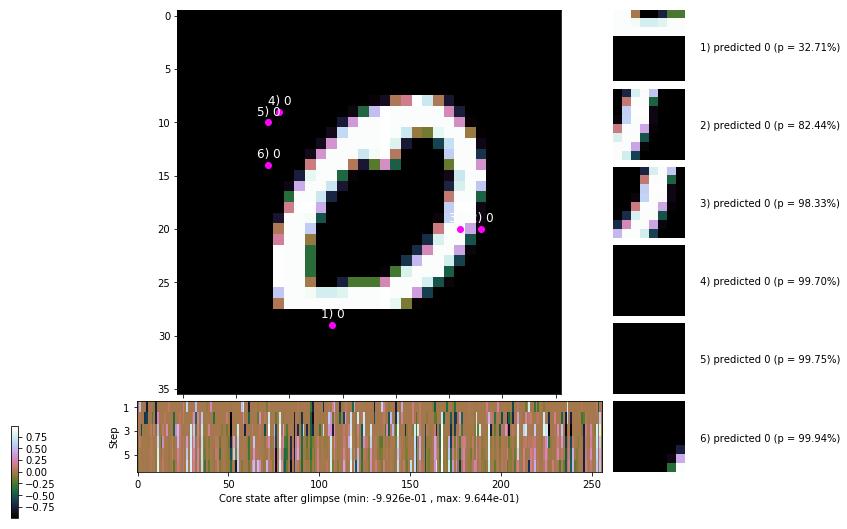

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


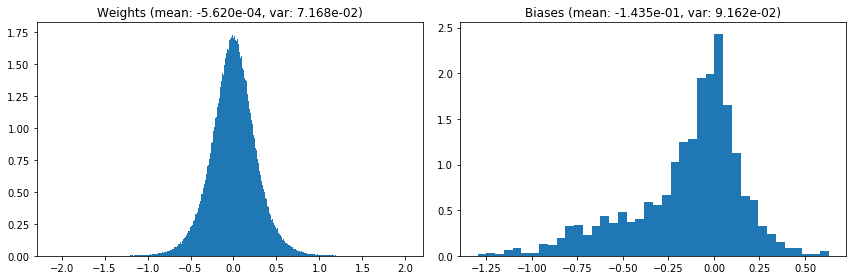

                                      Location network weights and biases


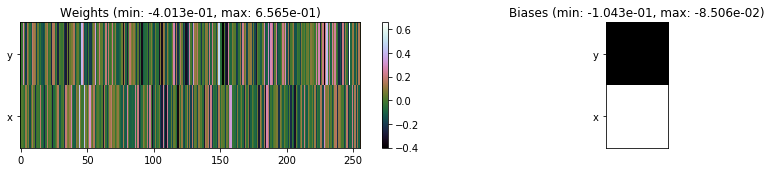

---------------------------------------------------------------------------------------------------------------
Elapsed time:  475.90 sec | TRAIN >> class loss: 0.3285 | steps:  2.242    | reward:  4.4598    | acc.: 89.077% :(
                          | VAL   >> class loss: 0.3554 | steps:  2.163 :( | reward:  4.5576 :( | acc.: 88.880% 


Epoch  43/400) lr = 0.0005324
 b    300/  3000 >> 152.4 ms/b | lr: 5.32e-04 | grad 2norm:  7.93 | grad inf norm:  2.241
         Weights || abs max:  2.08 (20559.50) | mean: -5.53e-04 ( 0.05) | var: 7.17e-02 (76112.68)
          Biases || abs max:  1.30 (  336.50) | mean: -1.44e-01 ( 0.22) | var: 9.18e-02 ( 4973.38)
                    class loss: 0.323 | steps: 2.244 | reward:  4.463 | acc.: 89.55%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.0 ms/b | lr: 5.31e-04 | grad 2norm:  7.98 | grad inf norm:  2.202
         Weights || abs max:  2.07 ( 2822.85) | mean: -5.28e-04 ( 0

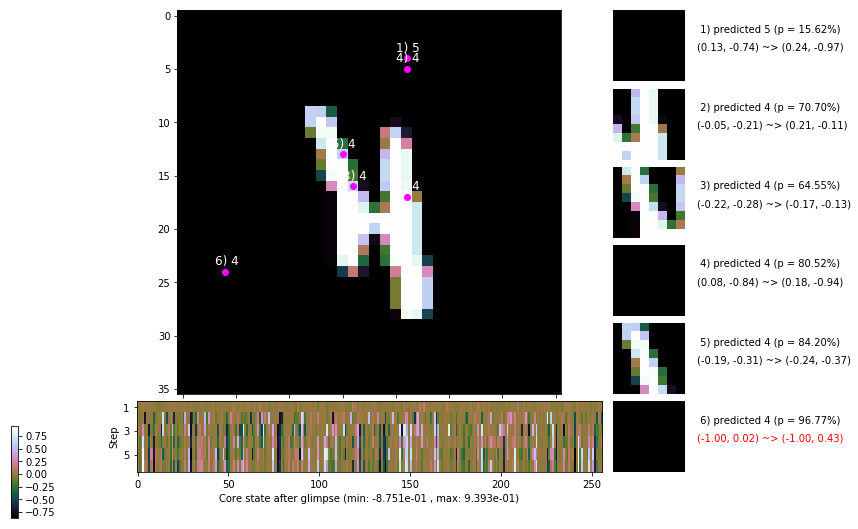

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 163.5 ms/b | lr: 5.30e-04 | grad 2norm:  7.90 | grad inf norm:  2.174
         Weights || abs max:  2.07 ( 3081.86) | mean: -5.16e-04 ( 0.02) | var: 7.18e-02 (  220.29)
          Biases || abs max:  1.29 (   99.38) | mean: -1.43e-01 ( 0.12) | var: 9.18e-02 (   40.88)
                    class loss: 0.303 | steps: 2.209 | reward:  4.501 | acc.: 89.77%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 160.3 ms/b | lr: 5.30e-04 | grad 2norm:  7.72 | grad inf norm:  2.076
         Weights || abs max:  2.06 ( 3108.71) | mean: -5.28e-04 ( 0.02) | var: 7.19e-02 (  217.78)
          Biases || abs max:  1.29 (  131.32) | mean: -1.43e-01 ( 0.13) | var: 9.20e-02 (   45.46)
                    class loss: 0.329 | steps: 2.227 | reward:  4.467 | acc.: 89.20%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.1

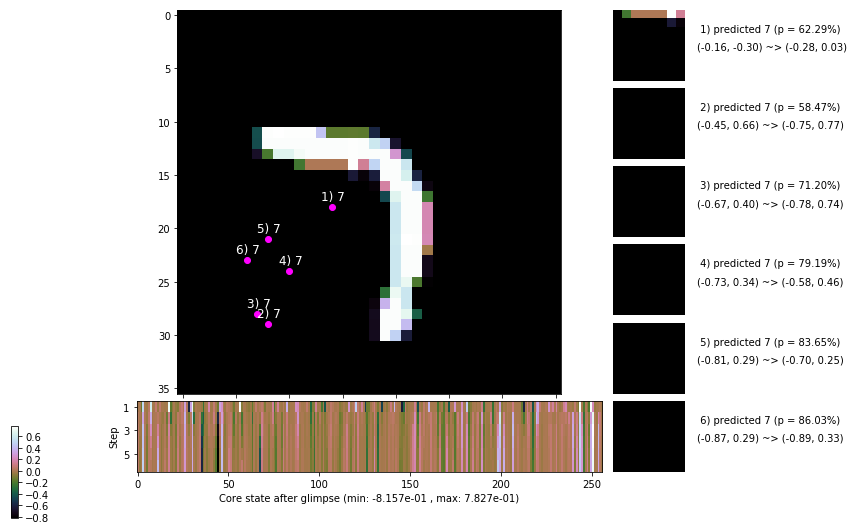

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 164.6 ms/b | lr: 5.29e-04 | grad 2norm:  7.91 | grad inf norm:  2.211
         Weights || abs max:  2.06 ( 4518.54) | mean: -5.45e-04 ( 0.02) | var: 7.19e-02 ( 1096.15)
          Biases || abs max:  1.29 ( 7660.59) | mean: -1.43e-01 ( 3.07) | var: 9.21e-02 (6555028.50)
                    class loss: 0.313 | steps: 2.233 | reward:  4.474 | acc.: 89.70%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 160.4 ms/b | lr: 5.28e-04 | grad 2norm:  7.85 | grad inf norm:  2.148
         Weights || abs max:  2.07 (11342.66) | mean: -5.77e-04 ( 0.03) | var: 7.20e-02 (19049.62)
          Biases || abs max:  1.29 (  250.05) | mean: -1.44e-01 ( 0.19) | var: 9.22e-02 (  772.37)
                    class loss: 0.313 | steps: 2.225 | reward:  4.493 | acc.: 89.67%

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1

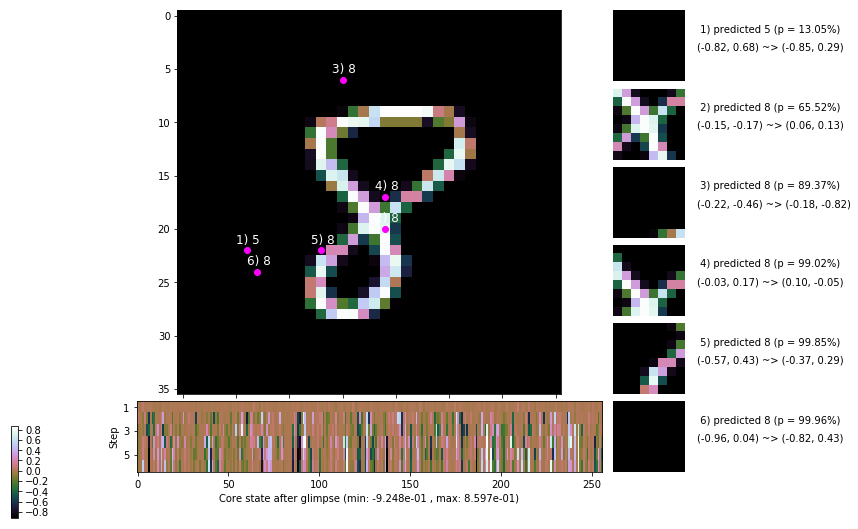

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 157.2 ms/b | lr: 5.27e-04 | grad 2norm:  7.80 | grad inf norm:  2.083
         Weights || abs max:  2.07 ( 4457.67) | mean: -5.61e-04 ( 0.02) | var: 7.20e-02 (  689.60)
          Biases || abs max:  1.30 (  286.12) | mean: -1.43e-01 ( 0.24) | var: 9.23e-02 ( 2547.51)
                    class loss: 0.318 | steps: 2.208 | reward:  4.502 | acc.: 89.37%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 155.7 ms/b | lr: 5.27e-04 | grad 2norm:  7.78 | grad inf norm:  2.123
         Weights || abs max:  2.07 ( 7212.86) | mean: -5.77e-04 ( 0.02) | var: 7.21e-02 ( 5757.64)
          Biases || abs max:  1.29 (  150.84) | mean: -1.44e-01 ( 0.14) | var: 9.24e-02 (  119.10)
                    class loss: 0.307 | steps: 2.225 | reward:  4.502 | acc.: 90.15%

	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.1

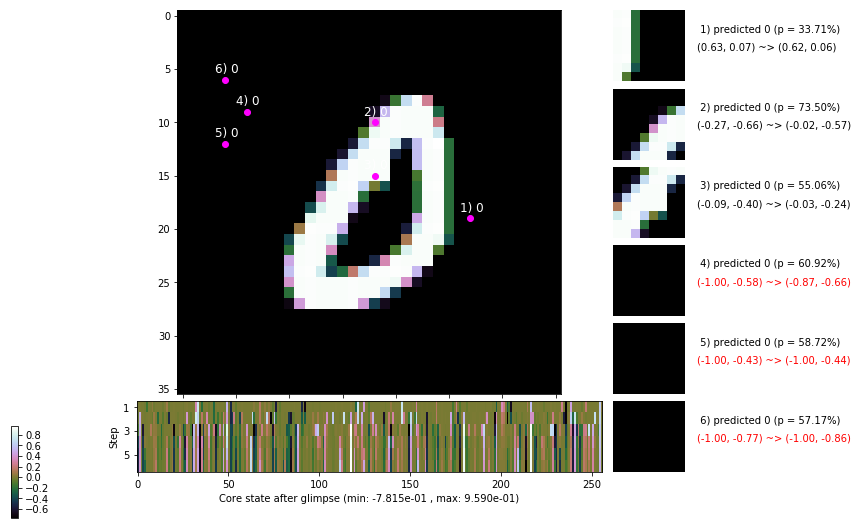

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 155.7 ms/b | lr: 5.26e-04 | grad 2norm:  7.65 | grad inf norm:  2.119
         Weights || abs max:  2.07 (14319.01) | mean: -5.66e-04 ( 0.04) | var: 7.22e-02 (64871.78)
          Biases || abs max:  1.29 (  162.26) | mean: -1.43e-01 ( 0.15) | var: 9.23e-02 (  157.44)
                    class loss: 0.311 | steps: 2.212 | reward:  4.498 | acc.: 89.63%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 154.3 ms/b | lr: 5.25e-04 | grad 2norm:  7.92 | grad inf norm:  2.236
         Weights || abs max:  2.07 ( 5054.04) | mean: -5.27e-04 ( 0.02) | var: 7.22e-02 ( 1543.98)
          Biases || abs max:  1.29 (  143.67) | mean: -1.43e-01 ( 0.14) | var: 9.22e-02 (   98.04)
                    class loss: 0.330 | steps: 2.239 | reward:  4.481 | acc.: 89.08%

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.1

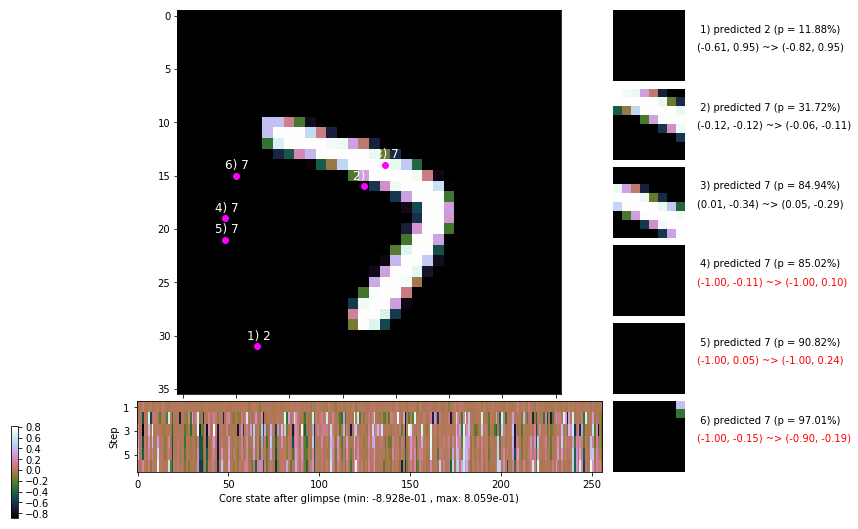

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


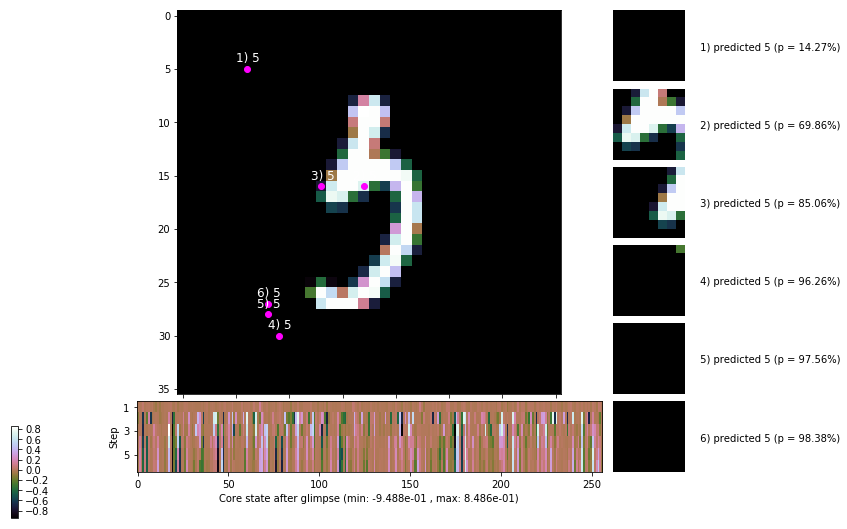


	Target class: 5 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


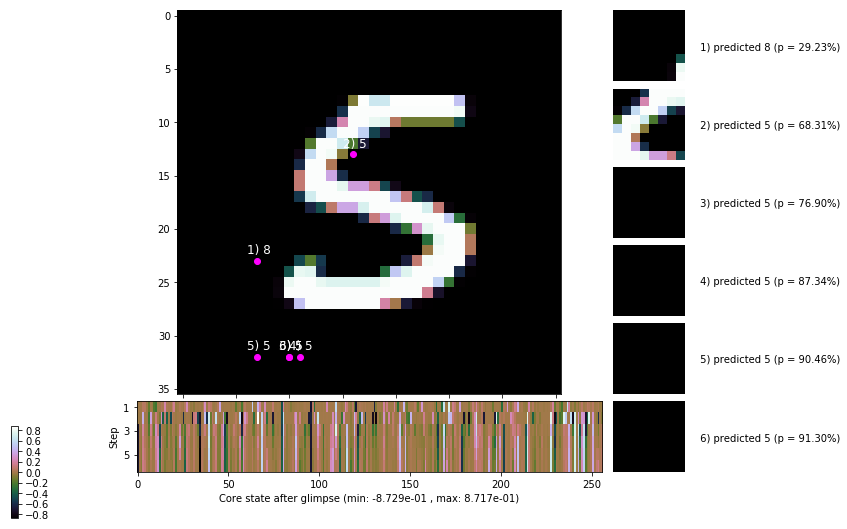

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


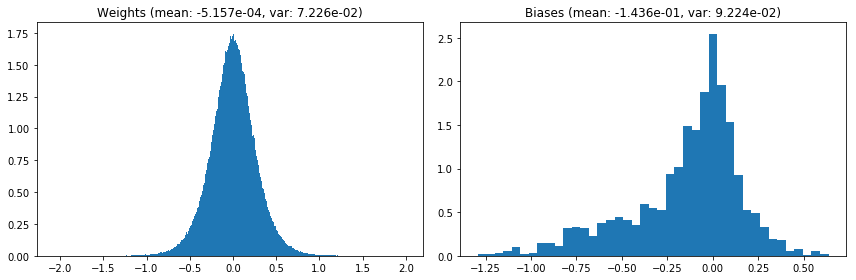

                                      Location network weights and biases


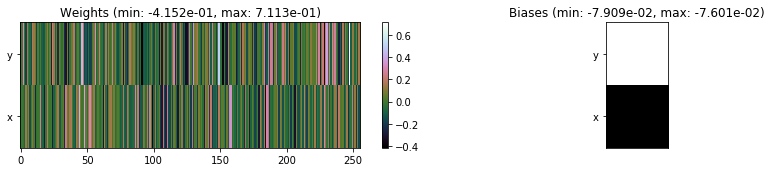

---------------------------------------------------------------------------------------------------------------
Elapsed time:  473.68 sec | TRAIN >> class loss: 0.3168 | steps:  2.227    | reward:  4.4837    | acc.: 89.553% 
                          | VAL   >> class loss: 0.3477 | steps:  2.156 :( | reward:  4.5540 :( | acc.: 87.900% :(


Epoch  44/400) lr = 0.0005245
 b    300/  3000 >> 151.8 ms/b | lr: 5.24e-04 | grad 2norm:  7.85 | grad inf norm:  2.112
         Weights || abs max:  2.07 ( 4305.01) | mean: -5.38e-04 ( 0.02) | var: 7.23e-02 (  622.77)
          Biases || abs max:  1.30 (  253.63) | mean: -1.43e-01 ( 0.20) | var: 9.21e-02 (  509.56)
                    class loss: 0.321 | steps: 2.263 | reward:  4.442 | acc.: 88.90%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.7 ms/b | lr: 5.23e-04 | grad 2norm:  7.81 | grad inf norm:  2.127
         Weights || abs max:  2.07 ( 4957.07) | mean: -5.39e-04 ( 0

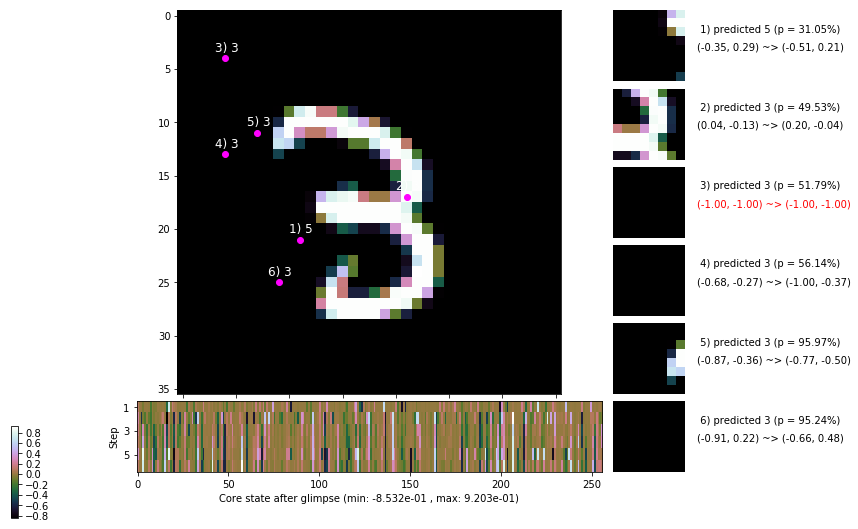

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 157.3 ms/b | lr: 5.22e-04 | grad 2norm:  7.91 | grad inf norm:  2.126
         Weights || abs max:  2.07 ( 3402.07) | mean: -5.62e-04 ( 0.02) | var: 7.24e-02 (  591.61)
          Biases || abs max:  1.29 (   74.12) | mean: -1.44e-01 ( 0.10) | var: 9.21e-02 (   12.25)
                    class loss: 0.340 | steps: 2.258 | reward:  4.442 | acc.: 88.58%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 152.6 ms/b | lr: 5.22e-04 | grad 2norm:  7.73 | grad inf norm:  2.037
         Weights || abs max:  2.08 ( 3785.93) | mean: -5.51e-04 ( 0.02) | var: 7.25e-02 (  354.11)
          Biases || abs max:  1.29 (  106.10) | mean: -1.44e-01 ( 0.12) | var: 9.22e-02 (  156.66)
                    class loss: 0.320 | steps: 2.216 | reward:  4.505 | acc.: 89.78%

	Target class: 2 | Discounted rewards: [0.001, 0.011, 0.1

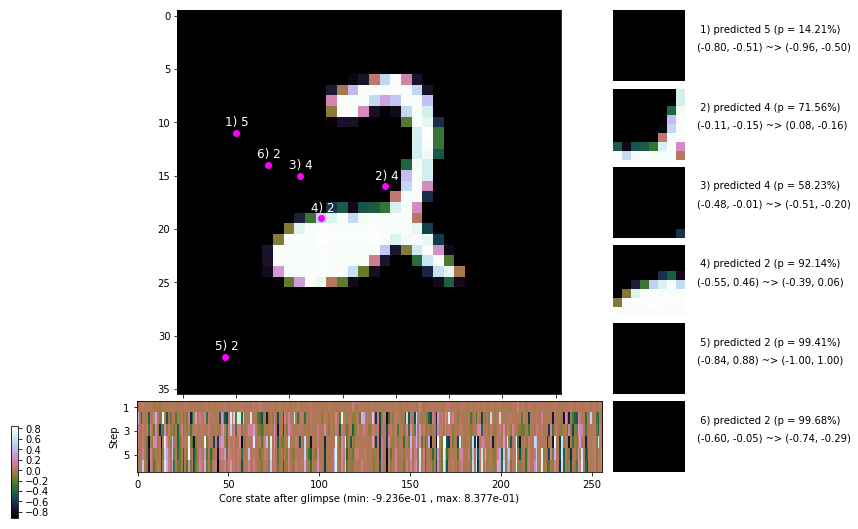

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 159.9 ms/b | lr: 5.21e-04 | grad 2norm:  7.77 | grad inf norm:  2.162
         Weights || abs max:  2.08 ( 5971.95) | mean: -5.71e-04 ( 0.02) | var: 7.25e-02 ( 2532.34)
          Biases || abs max:  1.29 (  138.89) | mean: -1.44e-01 ( 0.13) | var: 9.23e-02 (  156.34)
                    class loss: 0.349 | steps: 2.268 | reward:  4.436 | acc.: 88.90%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 171.2 ms/b | lr: 5.20e-04 | grad 2norm:  7.70 | grad inf norm:  2.111
         Weights || abs max:  2.09 ( 5054.12) | mean: -5.64e-04 ( 0.02) | var: 7.26e-02 (  564.48)
          Biases || abs max:  1.30 (  161.66) | mean: -1.45e-01 ( 0.14) | var: 9.26e-02 (  152.42)
                    class loss: 0.335 | steps: 2.264 | reward:  4.434 | acc.: 88.78%

	Target class: 4 | Discounted rewards: [1.111, 1.111, 1.1

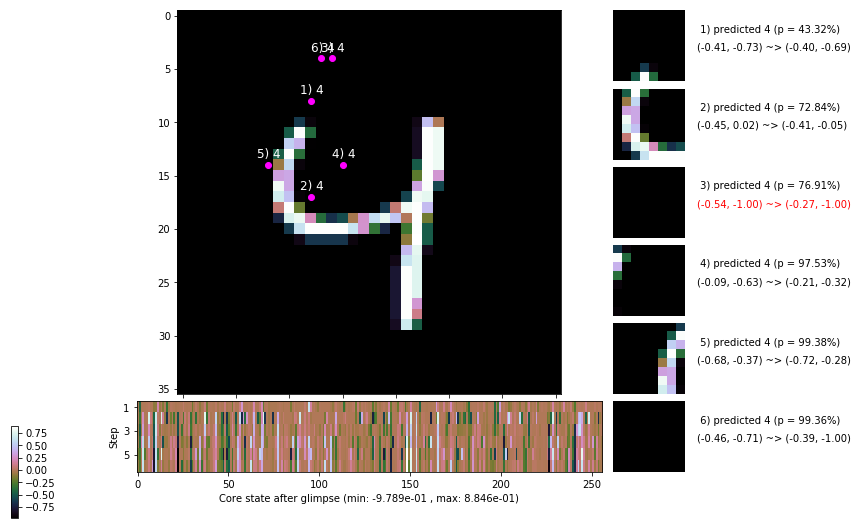

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 168.1 ms/b | lr: 5.19e-04 | grad 2norm:  7.97 | grad inf norm:  2.209
         Weights || abs max:  2.09 ( 8883.64) | mean: -5.82e-04 ( 0.03) | var: 7.27e-02 ( 6020.86)
          Biases || abs max:  1.30 (  265.66) | mean: -1.44e-01 ( 0.21) | var: 9.23e-02 (  863.13)
                    class loss: 0.355 | steps: 2.276 | reward:  4.424 | acc.: 88.15%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 171.9 ms/b | lr: 5.19e-04 | grad 2norm:  7.86 | grad inf norm:  2.232
         Weights || abs max:  2.09 ( 9339.16) | mean: -6.30e-04 ( 0.03) | var: 7.27e-02 (12137.93)
          Biases || abs max:  1.30 (  111.30) | mean: -1.45e-01 ( 0.13) | var: 9.23e-02 (   89.61)
                    class loss: 0.344 | steps: 2.256 | reward:  4.432 | acc.: 88.57%

	Target class: 4 | Discounted rewards: [1.100, 1.000, 0.0

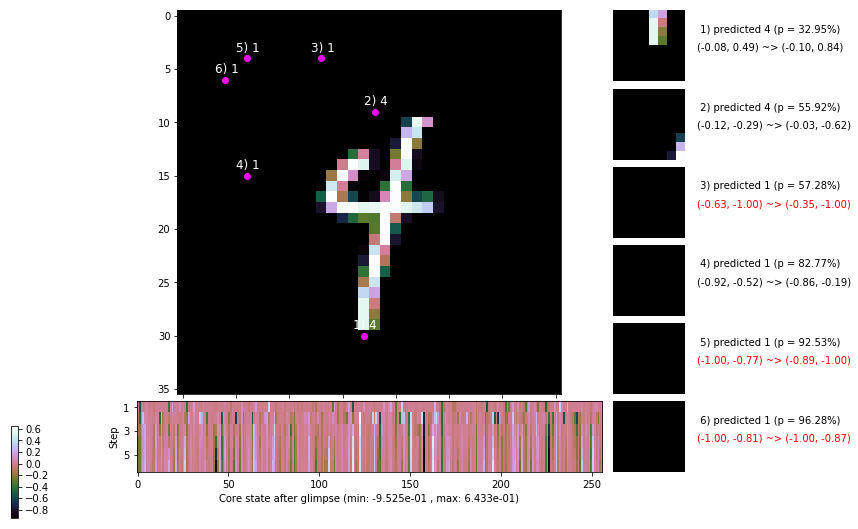

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 167.3 ms/b | lr: 5.18e-04 | grad 2norm:  7.76 | grad inf norm:  2.082
         Weights || abs max:  2.10 ( 6784.12) | mean: -6.23e-04 ( 0.02) | var: 7.28e-02 ( 1364.47)
          Biases || abs max:  1.30 (  148.99) | mean: -1.45e-01 ( 0.15) | var: 9.24e-02 (  244.33)
                    class loss: 0.342 | steps: 2.283 | reward:  4.425 | acc.: 88.75%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 165.0 ms/b | lr: 5.17e-04 | grad 2norm:  8.01 | grad inf norm:  2.169
         Weights || abs max:  2.10 ( 2238.87) | mean: -6.11e-04 ( 0.01) | var: 7.28e-02 (   62.64)
          Biases || abs max:  1.30 (  121.35) | mean: -1.45e-01 ( 0.15) | var: 9.26e-02 (  353.97)
                    class loss: 0.348 | steps: 2.261 | reward:  4.439 | acc.: 88.48%

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.1

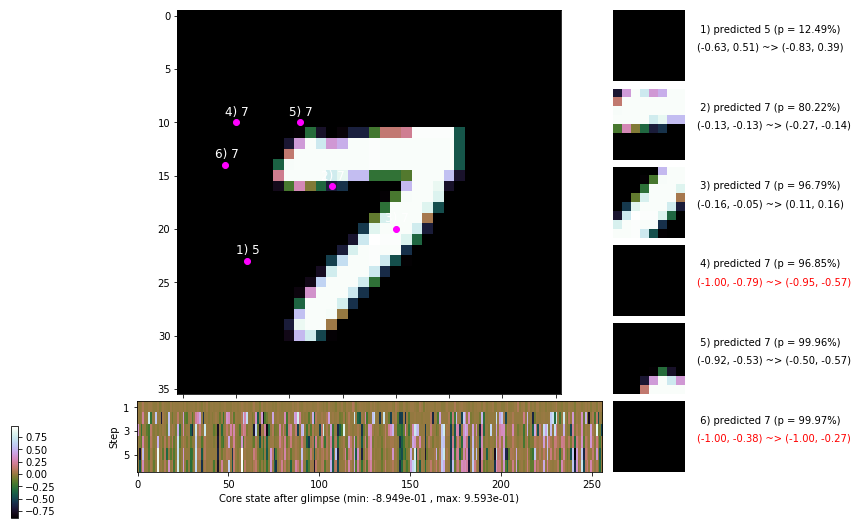

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


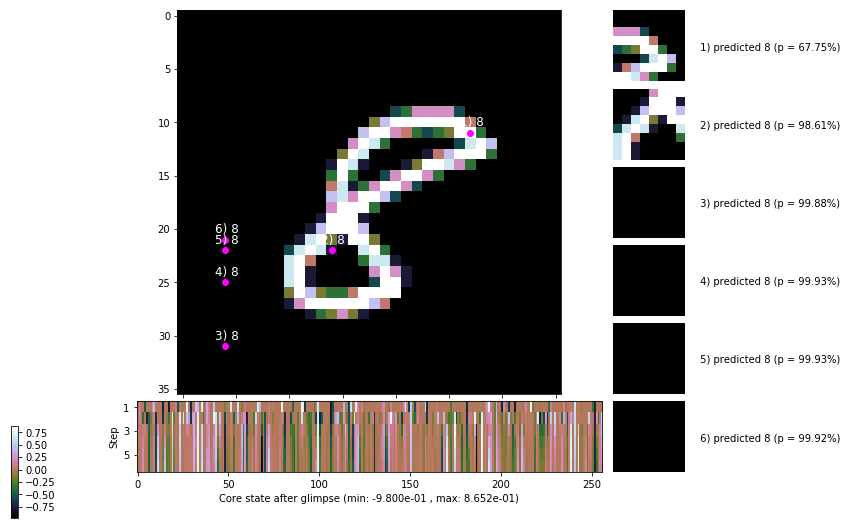


	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


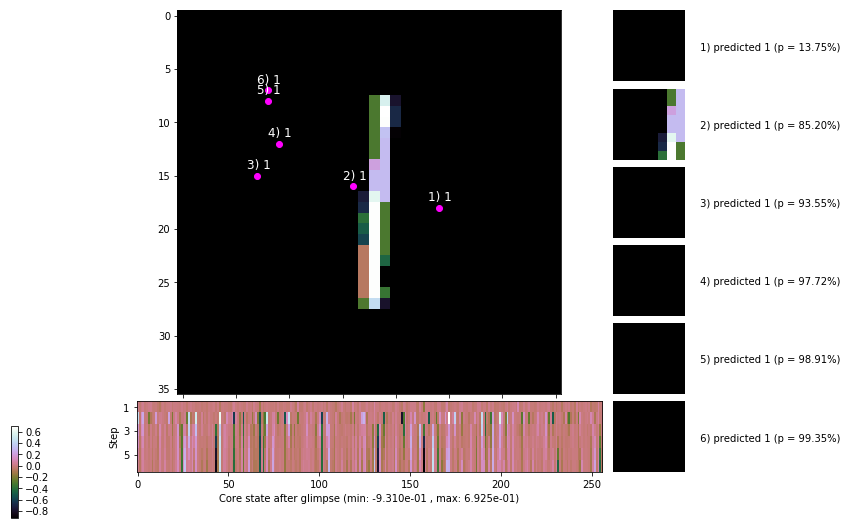

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


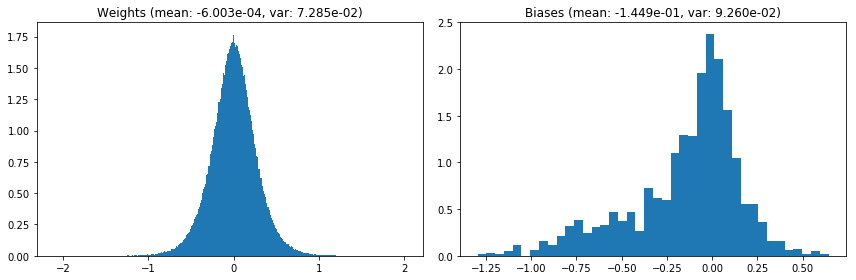

                                      Location network weights and biases


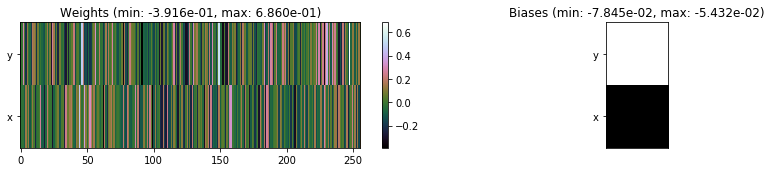

---------------------------------------------------------------------------------------------------------------
Elapsed time:  486.15 sec | TRAIN >> class loss: 0.3390 | steps:  2.259 :( | reward:  4.4421 :( | acc.: 88.728% :(
                          | VAL   >> class loss: 0.3567 | steps:  2.216 :( | reward:  4.4986 :( | acc.: 87.640% :(


Epoch  45/400) lr = 0.0005167
 b    300/  3000 >> 159.3 ms/b | lr: 5.16e-04 | grad 2norm:  7.70 | grad inf norm:  2.141
         Weights || abs max:  2.11 ( 2991.83) | mean: -5.86e-04 ( 0.02) | var: 7.29e-02 (   88.91)
          Biases || abs max:  1.30 (  203.05) | mean: -1.45e-01 ( 0.21) | var: 9.28e-02 ( 2066.48)
                    class loss: 0.345 | steps: 2.279 | reward:  4.430 | acc.: 88.83%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 163.2 ms/b | lr: 5.16e-04 | grad 2norm:  7.89 | grad inf norm:  2.142
         Weights || abs max:  2.11 ( 3518.78) | mean: -5.71e-04 (

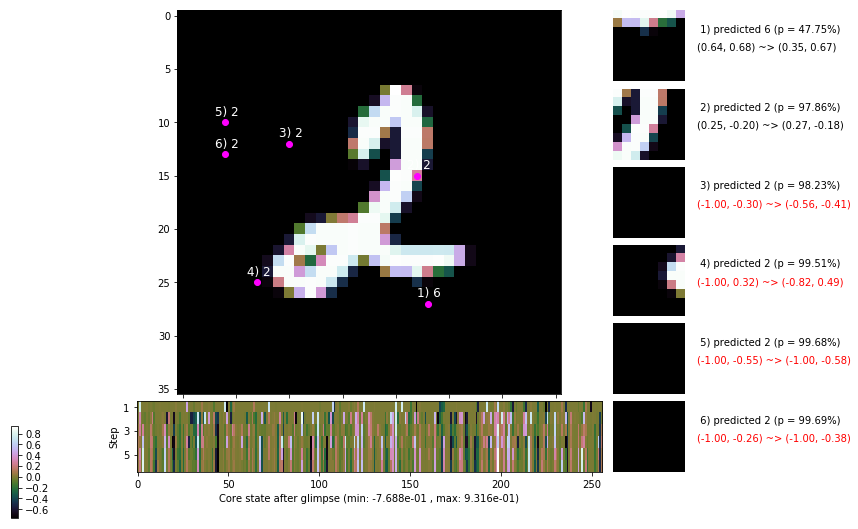

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 162.4 ms/b | lr: 5.15e-04 | grad 2norm:  7.81 | grad inf norm:  2.212
         Weights || abs max:  2.11 ( 5792.17) | mean: -5.65e-04 ( 0.02) | var: 7.30e-02 ( 2529.82)
          Biases || abs max:  1.32 (  169.17) | mean: -1.45e-01 ( 0.16) | var: 9.29e-02 (  264.93)
                    class loss: 0.331 | steps: 2.237 | reward:  4.480 | acc.: 89.13%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 159.7 ms/b | lr: 5.14e-04 | grad 2norm:  7.80 | grad inf norm:  2.135
         Weights || abs max:  2.10 ( 3698.53) | mean: -5.56e-04 ( 0.02) | var: 7.30e-02 (  312.66)
          Biases || abs max:  1.31 (  143.71) | mean: -1.45e-01 ( 0.16) | var: 9.29e-02 (  128.29)
                    class loss: 0.338 | steps: 2.260 | reward:  4.438 | acc.: 88.97%

	Target class: 8 | Discounted rewards: [0.000, 0.000, 0.0

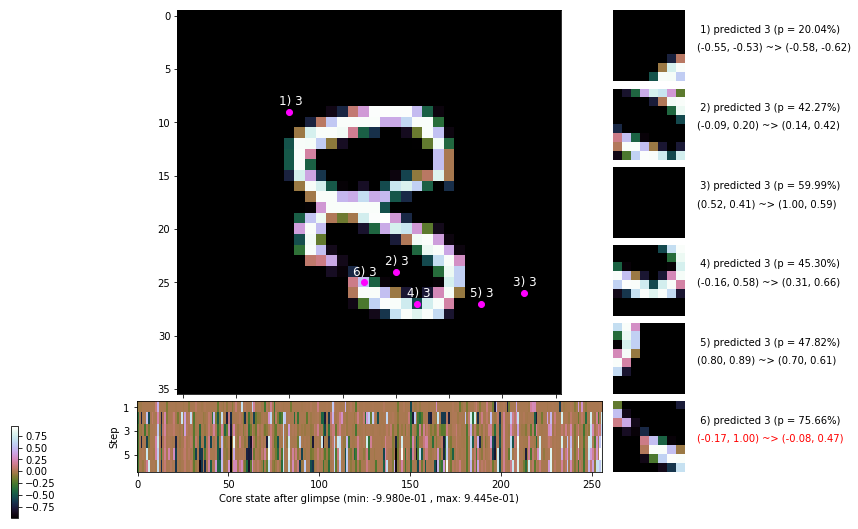

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 163.2 ms/b | lr: 5.13e-04 | grad 2norm:  7.71 | grad inf norm:  2.164
         Weights || abs max:  2.11 ( 8114.58) | mean: -5.43e-04 ( 0.03) | var: 7.31e-02 (11663.03)
          Biases || abs max:  1.31 (   85.10) | mean: -1.45e-01 ( 0.12) | var: 9.31e-02 (   15.41)
                    class loss: 0.331 | steps: 2.236 | reward:  4.470 | acc.: 89.08%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 157.3 ms/b | lr: 5.13e-04 | grad 2norm:  7.86 | grad inf norm:  2.161
         Weights || abs max:  2.11 ( 4082.66) | mean: -5.41e-04 ( 0.02) | var: 7.31e-02 (  698.75)
          Biases || abs max:  1.31 (   68.21) | mean: -1.45e-01 ( 0.10) | var: 9.32e-02 (   10.39)
                    class loss: 0.336 | steps: 2.259 | reward:  4.432 | acc.: 88.70%

	Target class: 9 | Discounted rewards: [0.000, 0.001, 0.0

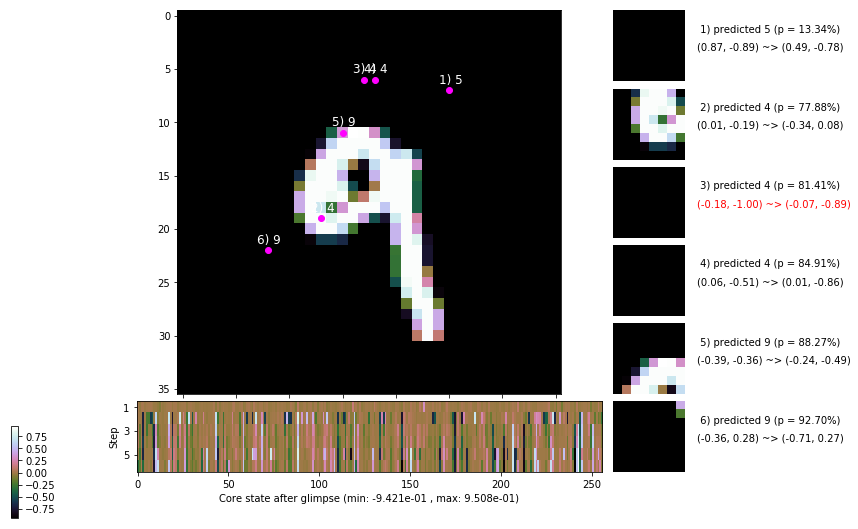

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 167.9 ms/b | lr: 5.12e-04 | grad 2norm:  7.90 | grad inf norm:  2.187
         Weights || abs max:  2.11 ( 8410.80) | mean: -5.35e-04 ( 0.03) | var: 7.32e-02 (12359.90)
          Biases || abs max:  1.33 (  147.87) | mean: -1.45e-01 ( 0.14) | var: 9.31e-02 (  122.84)
                    class loss: 0.330 | steps: 2.235 | reward:  4.467 | acc.: 88.90%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 164.5 ms/b | lr: 5.11e-04 | grad 2norm:  7.73 | grad inf norm:  2.137
         Weights || abs max:  2.11 ( 5594.59) | mean: -5.44e-04 ( 0.02) | var: 7.32e-02 ( 1136.67)
          Biases || abs max:  1.33 (  136.27) | mean: -1.45e-01 ( 0.14) | var: 9.33e-02 (   45.14)
                    class loss: 0.328 | steps: 2.260 | reward:  4.447 | acc.: 89.17%

	Target class: 3 | Discounted rewards: [1.111, 1.111, 1.1

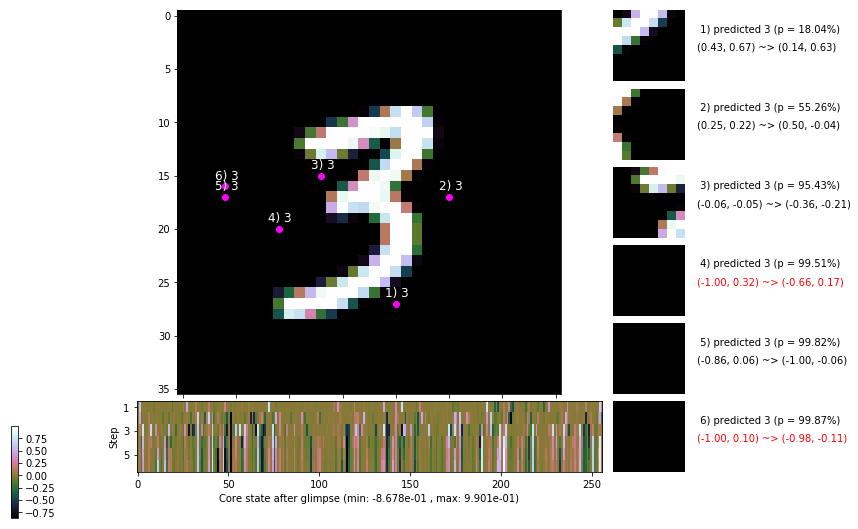

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 174.3 ms/b | lr: 5.10e-04 | grad 2norm:  7.99 | grad inf norm:  2.243
         Weights || abs max:  2.10 ( 5940.89) | mean: -5.63e-04 ( 0.02) | var: 7.33e-02 ( 4913.83)
          Biases || abs max:  1.33 (  171.49) | mean: -1.45e-01 ( 0.16) | var: 9.34e-02 (   88.16)
                    class loss: 0.334 | steps: 2.248 | reward:  4.455 | acc.: 88.57%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 168.0 ms/b | lr: 5.09e-04 | grad 2norm:  7.44 | grad inf norm:  2.123
         Weights || abs max:  2.11 ( 4212.35) | mean: -5.11e-04 ( 0.02) | var: 7.34e-02 (  488.75)
          Biases || abs max:  1.33 ( 2400.01) | mean: -1.45e-01 ( 1.02) | var: 9.36e-02 (609582.19)
                    class loss: 0.308 | steps: 2.206 | reward:  4.515 | acc.: 89.83%

	Target class: 3 | Discounted rewards: [1.111, 1.111, 1.

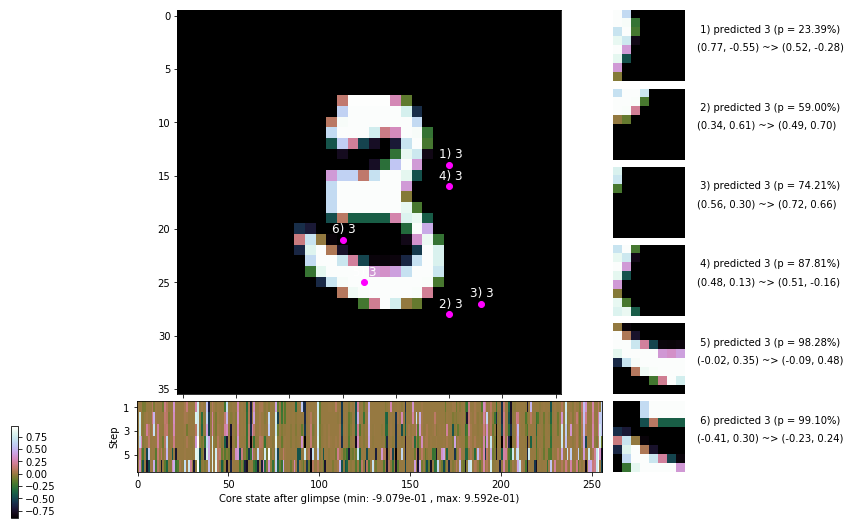

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


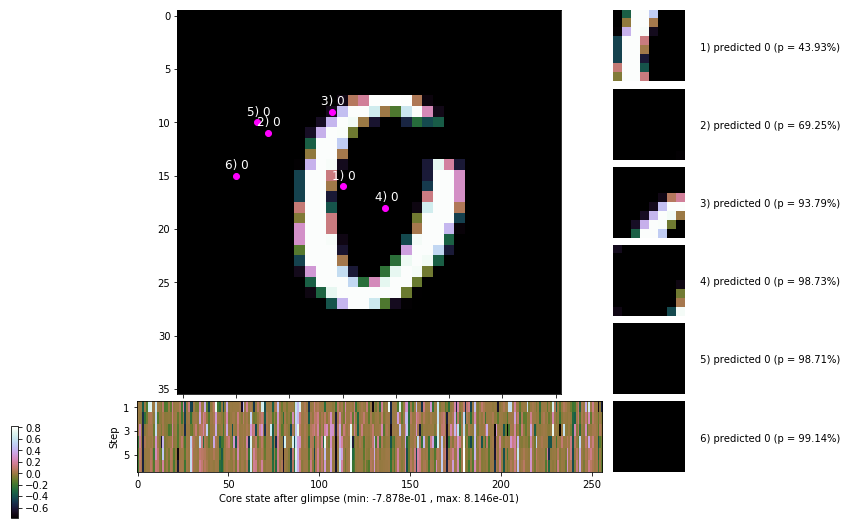


	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


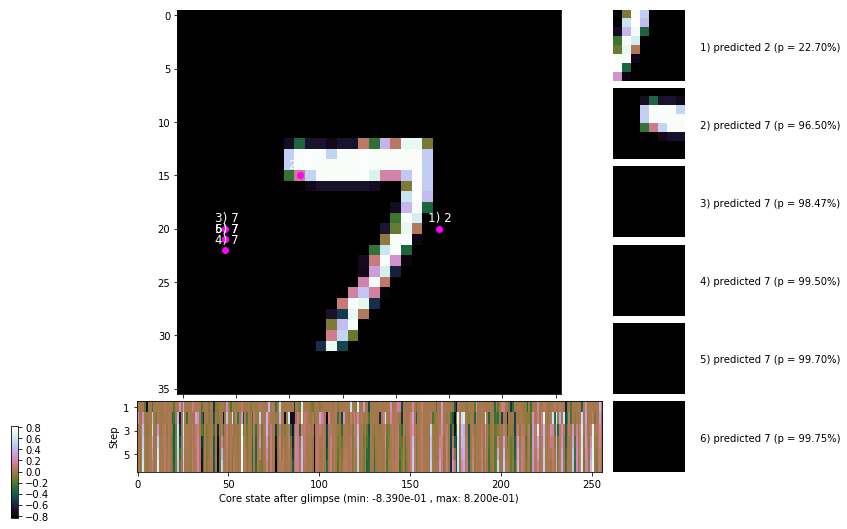

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


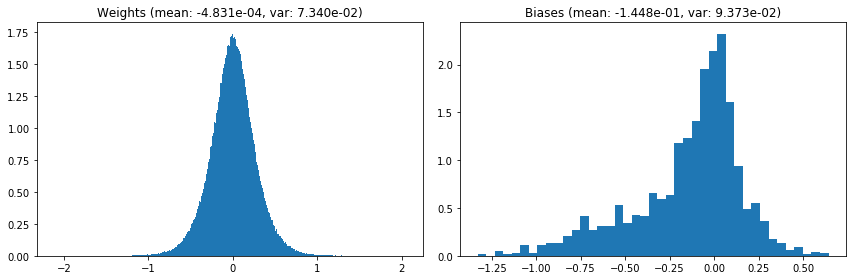

                                      Location network weights and biases


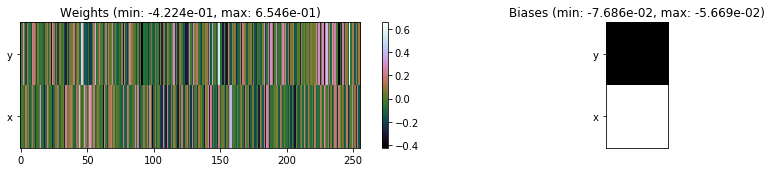

---------------------------------------------------------------------------------------------------------------
Elapsed time:  492.79 sec | TRAIN >> class loss: 0.3319 | steps:  2.246 :( | reward:  4.4585 :( | acc.: 88.995% :(
                          | VAL   >> class loss: 0.3685 | steps:  2.144    | reward:  4.5482 :( | acc.: 88.000% :(


Epoch  46/400) lr = 0.000509
 b    300/  3000 >> 160.6 ms/b | lr: 5.08e-04 | grad 2norm:  7.69 | grad inf norm:  2.134
         Weights || abs max:  2.12 ( 4574.51) | mean: -5.00e-04 ( 0.02) | var: 7.34e-02 (  574.92)
          Biases || abs max:  1.32 (  119.42) | mean: -1.45e-01 ( 0.13) | var: 9.38e-02 (   64.11)
                    class loss: 0.321 | steps: 2.240 | reward:  4.460 | acc.: 89.02%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 161.3 ms/b | lr: 5.08e-04 | grad 2norm:  7.61 | grad inf norm:  2.133
         Weights || abs max:  2.13 ( 2924.22) | mean: -5.17e-04 ( 

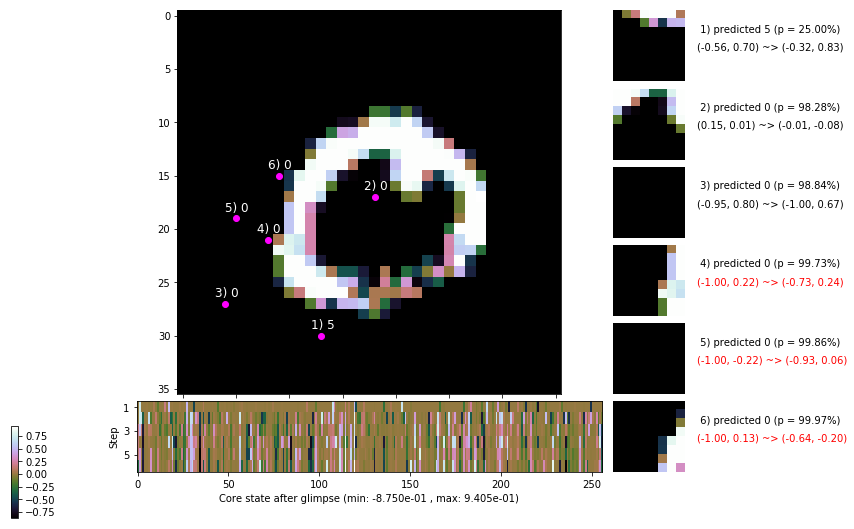

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 162.2 ms/b | lr: 5.07e-04 | grad 2norm:  7.90 | grad inf norm:  2.197
         Weights || abs max:  2.12 ( 2077.82) | mean: -5.18e-04 ( 0.01) | var: 7.35e-02 (   53.28)
          Biases || abs max:  1.32 (  124.24) | mean: -1.44e-01 ( 0.13) | var: 9.39e-02 (   78.53)
                    class loss: 0.315 | steps: 2.253 | reward:  4.459 | acc.: 89.30%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 158.9 ms/b | lr: 5.06e-04 | grad 2norm:  7.69 | grad inf norm:  2.204
         Weights || abs max:  2.12 ( 5756.90) | mean: -5.10e-04 ( 0.02) | var: 7.36e-02 ( 2619.83)
          Biases || abs max:  1.32 (  161.42) | mean: -1.45e-01 ( 0.15) | var: 9.39e-02 (  569.97)
                    class loss: 0.323 | steps: 2.237 | reward:  4.461 | acc.: 89.15%

	Target class: 0 | Discounted rewards: [0.111, 1.111, 1.1

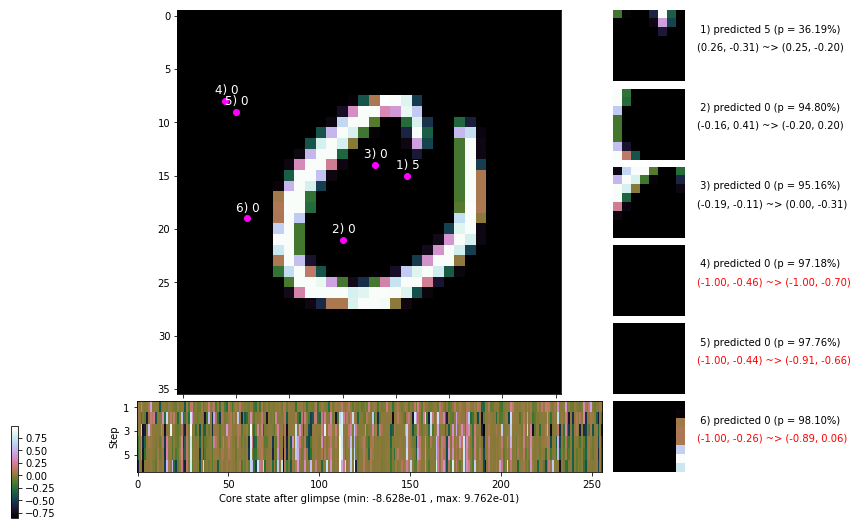

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 161.0 ms/b | lr: 5.05e-04 | grad 2norm:  7.96 | grad inf norm:  2.293
         Weights || abs max:  2.12 ( 3557.52) | mean: -5.29e-04 ( 0.02) | var: 7.37e-02 (  464.35)
          Biases || abs max:  1.33 (  119.13) | mean: -1.45e-01 ( 0.12) | var: 9.41e-02 (  126.31)
                    class loss: 0.340 | steps: 2.241 | reward:  4.449 | acc.: 88.80%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 159.1 ms/b | lr: 5.05e-04 | grad 2norm:  7.79 | grad inf norm:  2.188
         Weights || abs max:  2.13 ( 2830.97) | mean: -5.21e-04 ( 0.02) | var: 7.37e-02 (  180.37)
          Biases || abs max:  1.32 (  115.24) | mean: -1.45e-01 ( 0.13) | var: 9.42e-02 (   43.08)
                    class loss: 0.331 | steps: 2.254 | reward:  4.444 | acc.: 88.83%

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.1

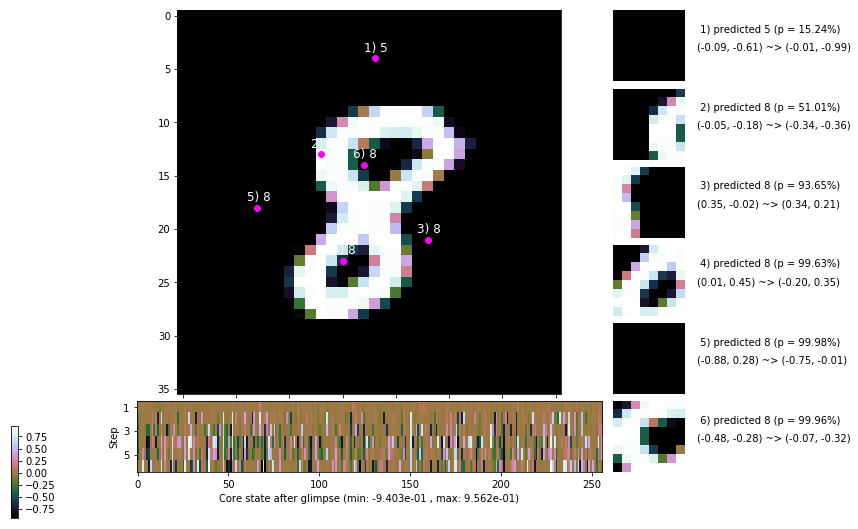

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 164.2 ms/b | lr: 5.04e-04 | grad 2norm:  7.68 | grad inf norm:  2.129
         Weights || abs max:  2.13 (11922.31) | mean: -5.24e-04 ( 0.03) | var: 7.38e-02 (35206.90)
          Biases || abs max:  1.32 (   75.96) | mean: -1.45e-01 ( 0.11) | var: 9.43e-02 (   20.82)
                    class loss: 0.345 | steps: 2.260 | reward:  4.447 | acc.: 88.80%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 159.8 ms/b | lr: 5.03e-04 | grad 2norm:  7.59 | grad inf norm:  2.050
         Weights || abs max:  2.14 ( 6709.93) | mean: -5.40e-04 ( 0.02) | var: 7.38e-02 ( 5160.79)
          Biases || abs max:  1.32 (  132.78) | mean: -1.46e-01 ( 0.13) | var: 9.45e-02 (  200.22)
                    class loss: 0.341 | steps: 2.277 | reward:  4.444 | acc.: 88.60%

	Target class: 4 | Discounted rewards: [0.111, 1.111, 1.1

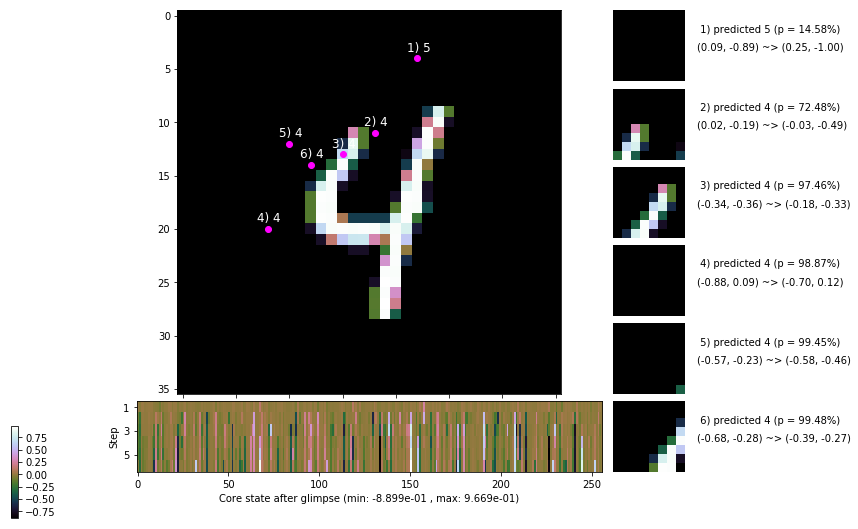

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 167.5 ms/b | lr: 5.02e-04 | grad 2norm:  7.49 | grad inf norm:  2.079
         Weights || abs max:  2.14 ( 6245.78) | mean: -5.65e-04 ( 0.02) | var: 7.39e-02 ( 1420.54)
          Biases || abs max:  1.32 (   96.43) | mean: -1.46e-01 ( 0.12) | var: 9.43e-02 (   19.61)
                    class loss: 0.318 | steps: 2.220 | reward:  4.493 | acc.: 89.40%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 163.6 ms/b | lr: 5.02e-04 | grad 2norm:  7.76 | grad inf norm:  2.203
         Weights || abs max:  2.14 ( 5157.45) | mean: -5.71e-04 ( 0.02) | var: 7.39e-02 (  581.23)
          Biases || abs max:  1.31 (  278.05) | mean: -1.45e-01 ( 0.20) | var: 9.43e-02 (  539.80)
                    class loss: 0.360 | steps: 2.258 | reward:  4.431 | acc.: 88.00%

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.1

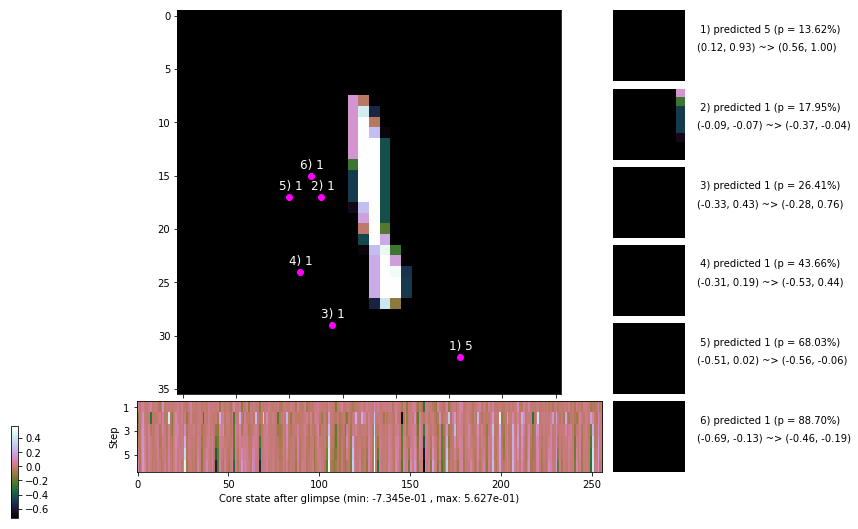

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


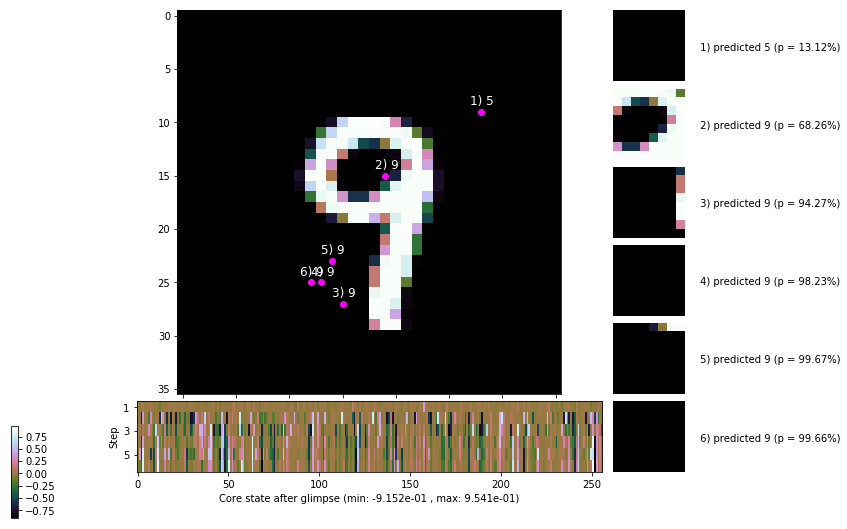


	Target class: 7 | Discounted rewards: [0.100, 1.000, 0.000, 0.000, 0.000, 0.000]


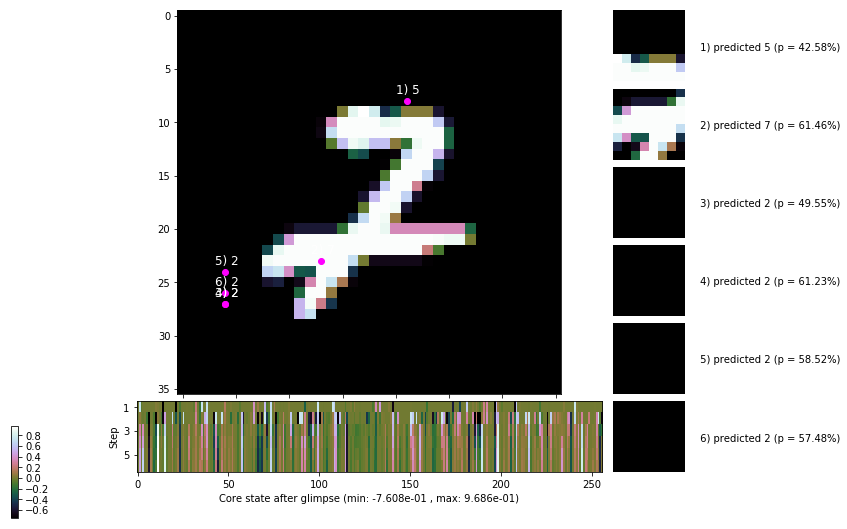

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


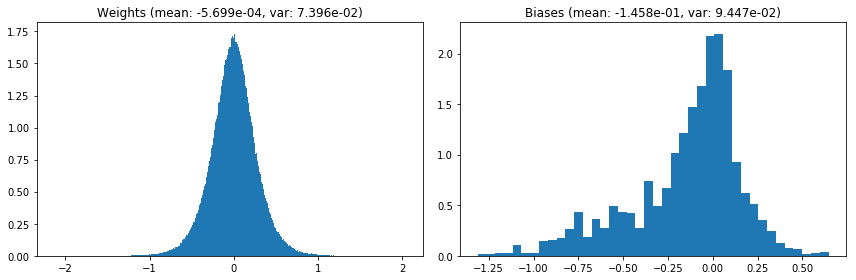

                                      Location network weights and biases


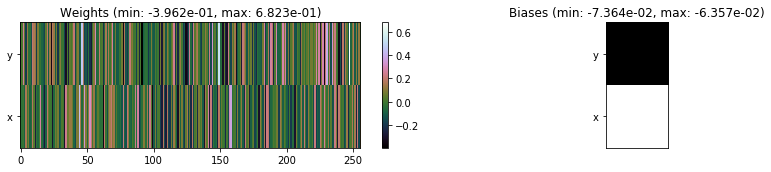

---------------------------------------------------------------------------------------------------------------
Elapsed time:  486.09 sec | TRAIN >> class loss: 0.3309 | steps:  2.247 :( | reward:  4.4568 :( | acc.: 88.932% :(
                          | VAL   >> class loss: 0.3405 | steps:  2.161 :( | reward:  4.5668    | acc.: 88.480% :(


Epoch  47/400) lr = 0.0005014
 b    300/  3000 >> 174.9 ms/b | lr: 5.01e-04 | grad 2norm:  7.62 | grad inf norm:  2.185
         Weights || abs max:  2.13 ( 2321.43) | mean: -5.60e-04 ( 0.01) | var: 7.40e-02 (   90.74)
          Biases || abs max:  1.32 (  145.89) | mean: -1.46e-01 ( 0.15) | var: 9.45e-02 (   95.40)
                    class loss: 0.355 | steps: 2.251 | reward:  4.441 | acc.: 88.60%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 169.0 ms/b | lr: 5.00e-04 | grad 2norm:  7.72 | grad inf norm:  2.210
         Weights || abs max:  2.14 ( 2857.47) | mean: -5.62e-04 (

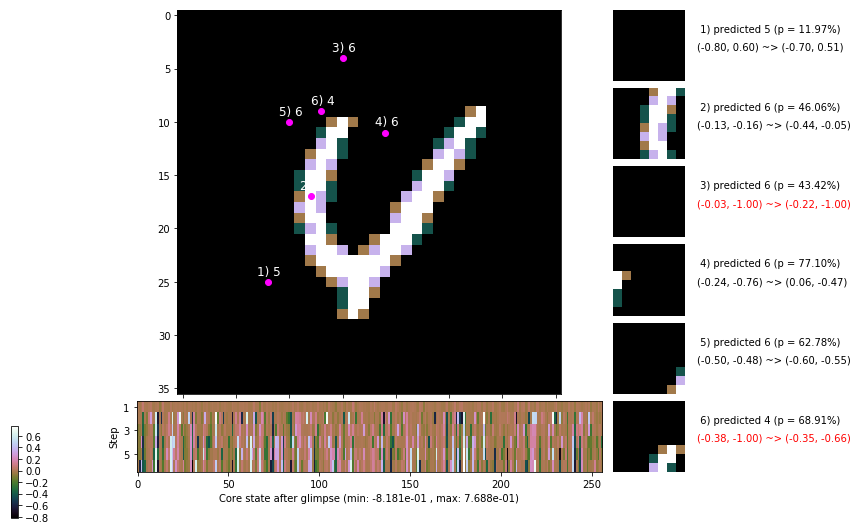

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 164.4 ms/b | lr: 4.99e-04 | grad 2norm:  7.76 | grad inf norm:  2.203
         Weights || abs max:  2.14 (16367.83) | mean: -5.57e-04 ( 0.04) | var: 7.41e-02 (83705.70)
          Biases || abs max:  1.32 (  105.92) | mean: -1.45e-01 ( 0.14) | var: 9.44e-02 (   53.99)
                    class loss: 0.340 | steps: 2.233 | reward:  4.473 | acc.: 88.90%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 162.4 ms/b | lr: 4.99e-04 | grad 2norm:  7.54 | grad inf norm:  2.185
         Weights || abs max:  2.14 ( 2018.32) | mean: -5.83e-04 ( 0.01) | var: 7.41e-02 (   28.19)
          Biases || abs max:  1.32 (   84.70) | mean: -1.46e-01 ( 0.12) | var: 9.46e-02 (   33.77)
                    class loss: 0.339 | steps: 2.259 | reward:  4.441 | acc.: 88.68%

	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.1

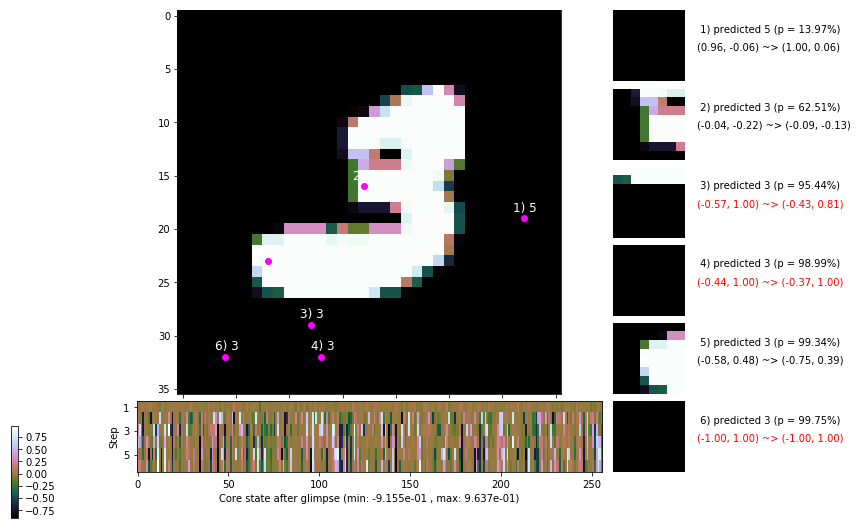

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 161.5 ms/b | lr: 4.98e-04 | grad 2norm:  7.54 | grad inf norm:  2.137
         Weights || abs max:  2.14 ( 3634.99) | mean: -5.71e-04 ( 0.02) | var: 7.42e-02 (  340.96)
          Biases || abs max:  1.31 (  220.83) | mean: -1.46e-01 ( 0.17) | var: 9.49e-02 (  908.75)
                    class loss: 0.331 | steps: 2.258 | reward:  4.462 | acc.: 89.07%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 160.1 ms/b | lr: 4.97e-04 | grad 2norm:  7.65 | grad inf norm:  2.133
         Weights || abs max:  2.14 ( 5080.61) | mean: -5.74e-04 ( 0.02) | var: 7.42e-02 ( 2345.73)
          Biases || abs max:  1.32 (  391.23) | mean: -1.46e-01 ( 0.25) | var: 9.50e-02 ( 5554.66)
                    class loss: 0.335 | steps: 2.224 | reward:  4.497 | acc.: 89.08%

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.1

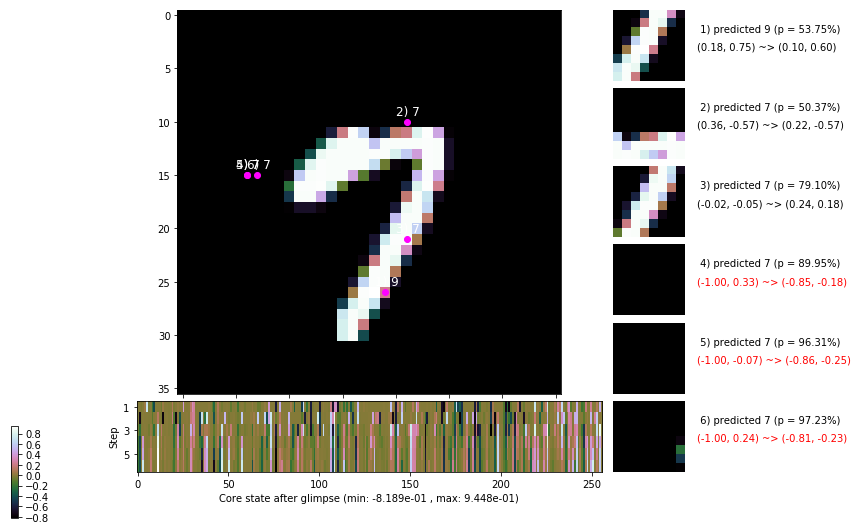

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 161.8 ms/b | lr: 4.96e-04 | grad 2norm:  7.65 | grad inf norm:  2.211
         Weights || abs max:  2.14 ( 7158.02) | mean: -5.92e-04 ( 0.02) | var: 7.43e-02 ( 3137.75)
          Biases || abs max:  1.32 (  183.26) | mean: -1.46e-01 ( 0.17) | var: 9.49e-02 (  122.39)
                    class loss: 0.366 | steps: 2.289 | reward:  4.417 | acc.: 87.73%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 158.9 ms/b | lr: 4.96e-04 | grad 2norm:  7.50 | grad inf norm:  2.149
         Weights || abs max:  2.15 ( 4554.65) | mean: -6.03e-04 ( 0.02) | var: 7.43e-02 ( 1351.02)
          Biases || abs max:  1.32 (  249.16) | mean: -1.46e-01 ( 0.20) | var: 9.50e-02 (  498.82)
                    class loss: 0.350 | steps: 2.261 | reward:  4.435 | acc.: 88.43%

	Target class: 1 | Discounted rewards: [1.001, 0.010, 0.1

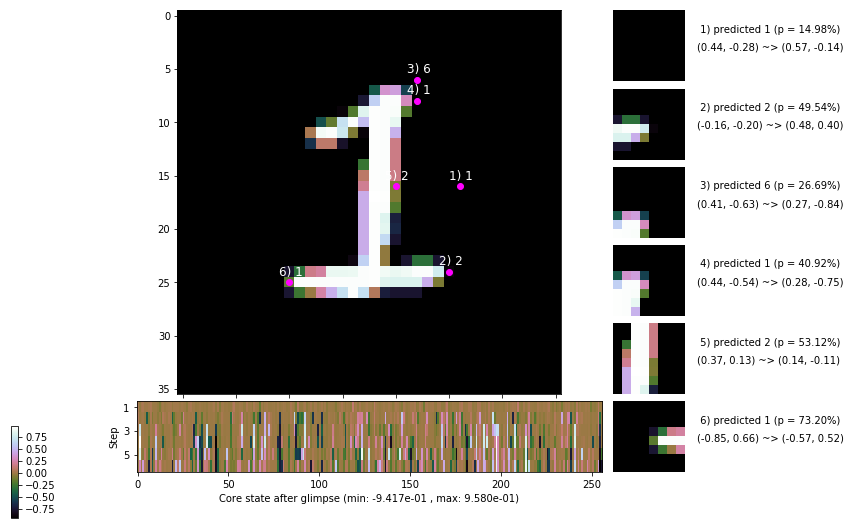

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 163.4 ms/b | lr: 4.95e-04 | grad 2norm:  7.68 | grad inf norm:  2.148
         Weights || abs max:  2.15 ( 6185.37) | mean: -5.96e-04 ( 0.02) | var: 7.44e-02 ( 1331.91)
          Biases || abs max:  1.31 (  164.34) | mean: -1.47e-01 ( 0.16) | var: 9.51e-02 (  220.44)
                    class loss: 0.341 | steps: 2.200 | reward:  4.501 | acc.: 88.80%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 158.1 ms/b | lr: 4.94e-04 | grad 2norm:  7.71 | grad inf norm:  2.167
         Weights || abs max:  2.15 ( 4401.39) | mean: -5.80e-04 ( 0.02) | var: 7.44e-02 (  679.91)
          Biases || abs max:  1.32 (  184.79) | mean: -1.47e-01 ( 0.17) | var: 9.51e-02 (  230.31)
                    class loss: 0.334 | steps: 2.249 | reward:  4.466 | acc.: 88.88%

	Target class: 6 | Discounted rewards: [0.000, 0.000, 0.0

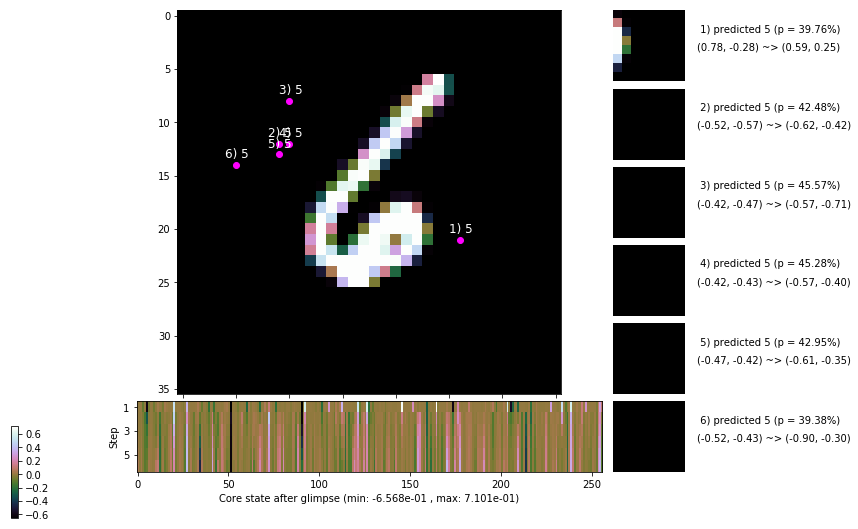

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


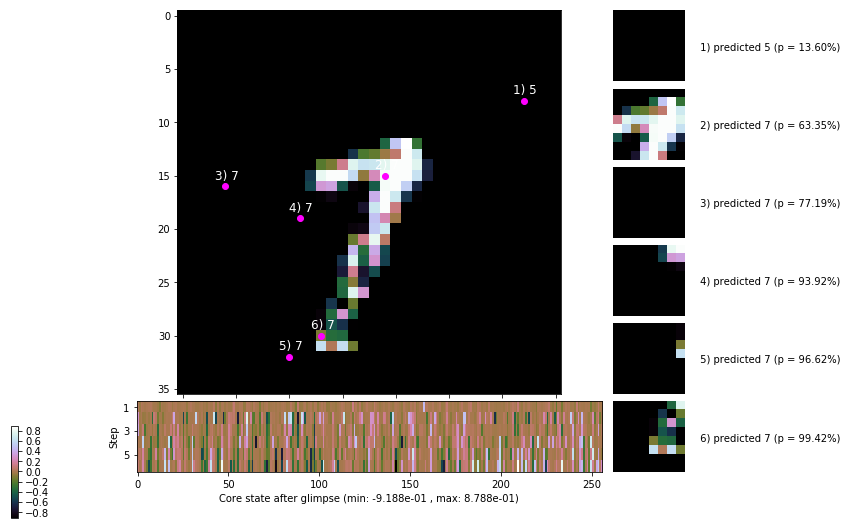


	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


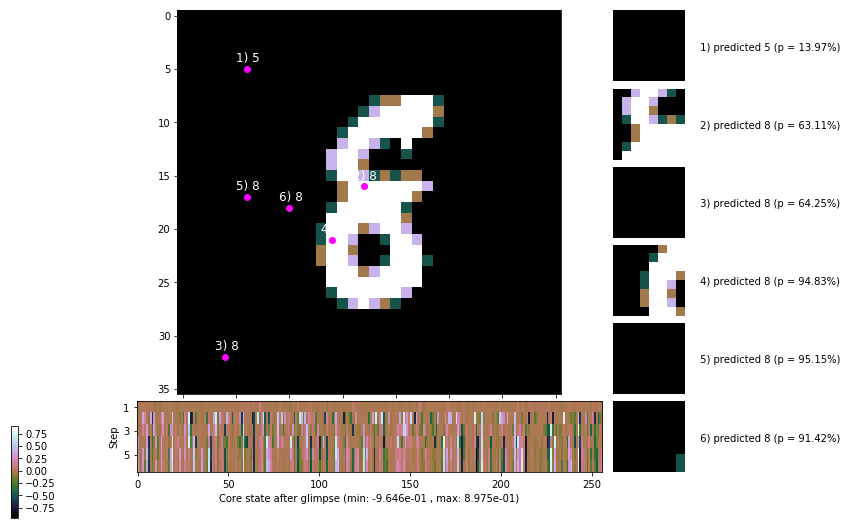

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


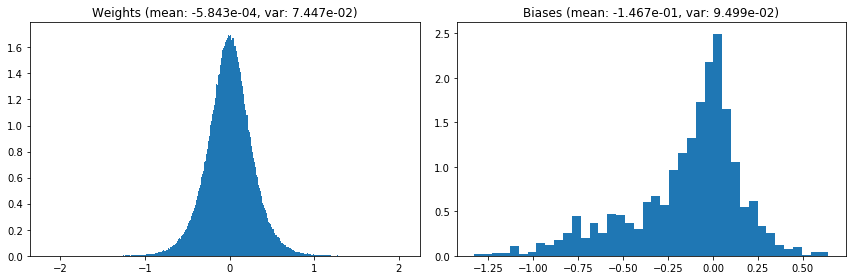

                                      Location network weights and biases


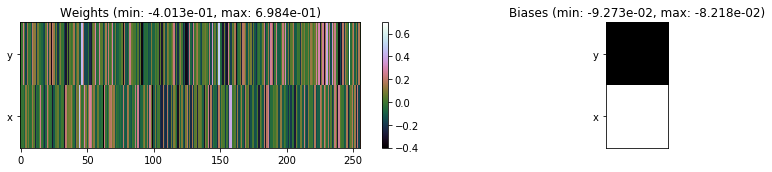

---------------------------------------------------------------------------------------------------------------
Elapsed time:  490.97 sec | TRAIN >> class loss: 0.3413 | steps:  2.246 :( | reward:  4.4612 :( | acc.: 88.748% :(
                          | VAL   >> class loss: 0.3446 | steps:  2.152 :( | reward:  4.5774    | acc.: 88.640% :(


Epoch  48/400) lr = 0.0004939
 b    300/  3000 >> 170.6 ms/b | lr: 4.93e-04 | grad 2norm:  7.57 | grad inf norm:  2.133
         Weights || abs max:  2.15 ( 6704.05) | mean: -5.80e-04 ( 0.02) | var: 7.45e-02 ( 1949.13)
          Biases || abs max:  1.32 (  155.50) | mean: -1.46e-01 ( 0.15) | var: 9.51e-02 (   92.53)
                    class loss: 0.342 | steps: 2.252 | reward:  4.457 | acc.: 88.68%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 163.4 ms/b | lr: 4.93e-04 | grad 2norm:  7.56 | grad inf norm:  2.128
         Weights || abs max:  2.16 ( 4948.08) | mean: -5.91e-04 (

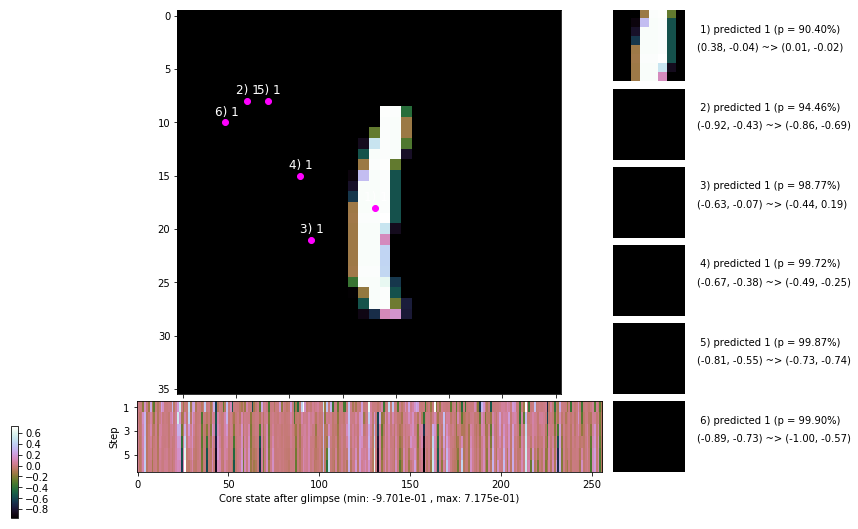

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 174.3 ms/b | lr: 4.92e-04 | grad 2norm:  7.53 | grad inf norm:  2.143
         Weights || abs max:  2.16 ( 8608.04) | mean: -6.04e-04 ( 0.03) | var: 7.46e-02 (17719.25)
          Biases || abs max:  1.32 (   73.58) | mean: -1.47e-01 ( 0.11) | var: 9.52e-02 (   11.42)
                    class loss: 0.325 | steps: 2.207 | reward:  4.499 | acc.: 89.33%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 168.1 ms/b | lr: 4.91e-04 | grad 2norm:  7.57 | grad inf norm:  2.030
         Weights || abs max:  2.17 ( 3211.54) | mean: -5.83e-04 ( 0.02) | var: 7.46e-02 (  134.99)
          Biases || abs max:  1.33 (  412.30) | mean: -1.47e-01 ( 0.26) | var: 9.53e-02 ( 3300.27)
                    class loss: 0.325 | steps: 2.236 | reward:  4.477 | acc.: 89.38%

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.1

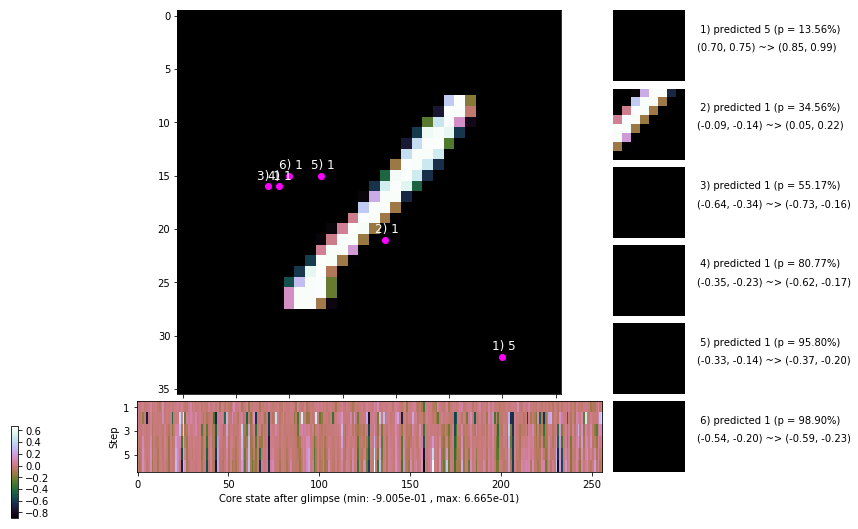

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 163.7 ms/b | lr: 4.90e-04 | grad 2norm:  7.73 | grad inf norm:  2.096
         Weights || abs max:  2.17 ( 4001.60) | mean: -5.70e-04 ( 0.02) | var: 7.47e-02 (  155.80)
          Biases || abs max:  1.32 (  100.73) | mean: -1.47e-01 ( 0.13) | var: 9.54e-02 (   63.87)
                    class loss: 0.334 | steps: 2.260 | reward:  4.441 | acc.: 88.98%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 160.8 ms/b | lr: 4.90e-04 | grad 2norm:  7.52 | grad inf norm:  2.133
         Weights || abs max:  2.16 (19724.16) | mean: -5.74e-04 ( 0.05) | var: 7.47e-02 (144333.88)
          Biases || abs max:  1.32 (  123.56) | mean: -1.47e-01 ( 0.13) | var: 9.55e-02 (   66.47)
                    class loss: 0.318 | steps: 2.231 | reward:  4.494 | acc.: 89.57%

	Target class: 9 | Discounted rewards: [0.001, 0.011, 0.

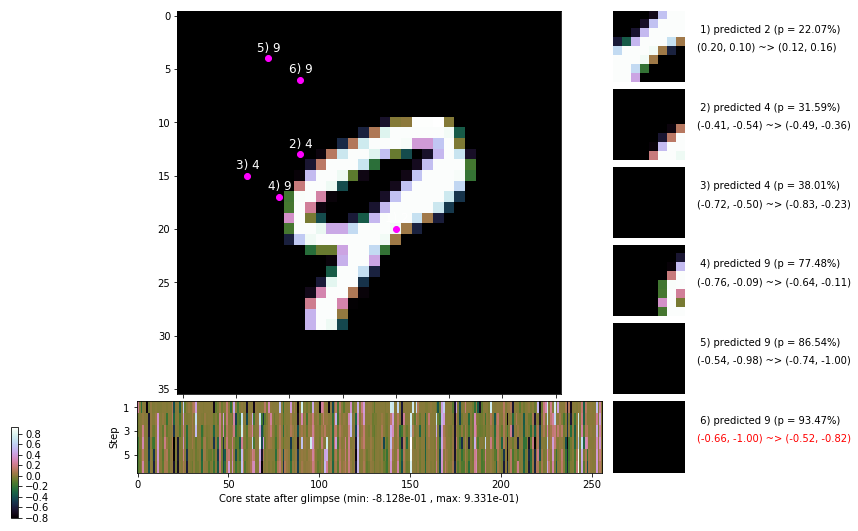

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 162.9 ms/b | lr: 4.89e-04 | grad 2norm:  7.63 | grad inf norm:  2.167
         Weights || abs max:  2.16 ( 3393.80) | mean: -5.84e-04 ( 0.02) | var: 7.48e-02 (  315.15)
          Biases || abs max:  1.32 (  218.65) | mean: -1.47e-01 ( 0.18) | var: 9.54e-02 (  635.07)
                    class loss: 0.317 | steps: 2.216 | reward:  4.505 | acc.: 89.83%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 161.2 ms/b | lr: 4.89e-04 | grad 2norm:  7.66 | grad inf norm:  2.075
         Weights || abs max:  2.17 ( 4298.08) | mean: -5.89e-04 ( 0.02) | var: 7.48e-02 (  730.43)
          Biases || abs max:  1.33 (  144.08) | mean: -1.47e-01 ( 0.14) | var: 9.56e-02 (  214.64)
                    class loss: 0.339 | steps: 2.250 | reward:  4.468 | acc.: 89.48%

	Target class: 6 | Discounted rewards: [0.011, 0.111, 1.1

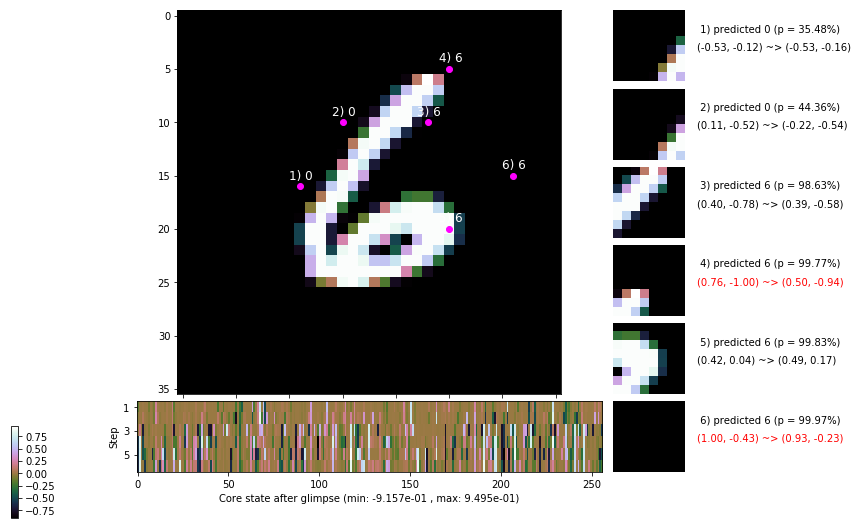

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 162.9 ms/b | lr: 4.88e-04 | grad 2norm:  7.41 | grad inf norm:  2.015
         Weights || abs max:  2.18 ( 3755.89) | mean: -5.86e-04 ( 0.02) | var: 7.49e-02 (  522.02)
          Biases || abs max:  1.33 (  213.88) | mean: -1.47e-01 ( 0.19) | var: 9.57e-02 ( 1049.20)
                    class loss: 0.325 | steps: 2.224 | reward:  4.484 | acc.: 89.28%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 158.5 ms/b | lr: 4.87e-04 | grad 2norm:  7.45 | grad inf norm:  2.065
         Weights || abs max:  2.17 (113436.02) | mean: -5.93e-04 ( 0.22) | var: 7.49e-02 (6747369.50)
          Biases || abs max:  1.33 (   69.81) | mean: -1.47e-01 ( 0.11) | var: 9.59e-02 (   52.50)
                    class loss: 0.327 | steps: 2.200 | reward:  4.506 | acc.: 89.37%

	Target class: 6 | Discounted rewards: [0.111, 1.111, 

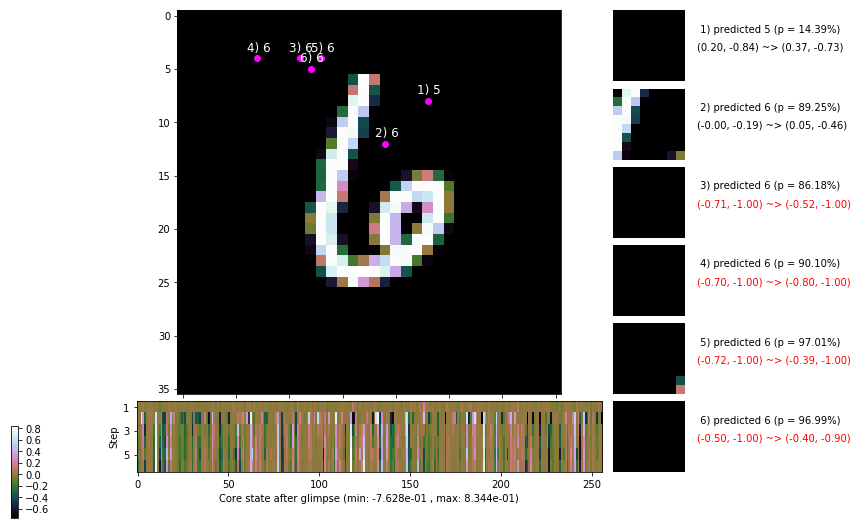

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


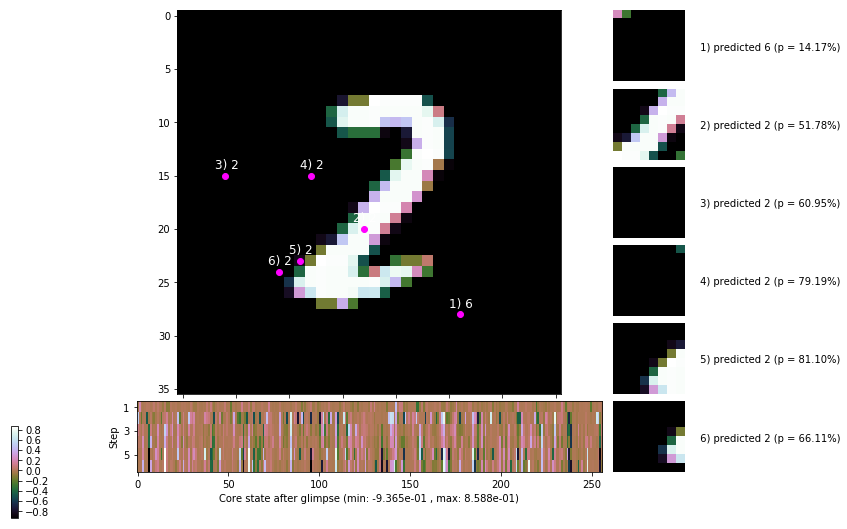


	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


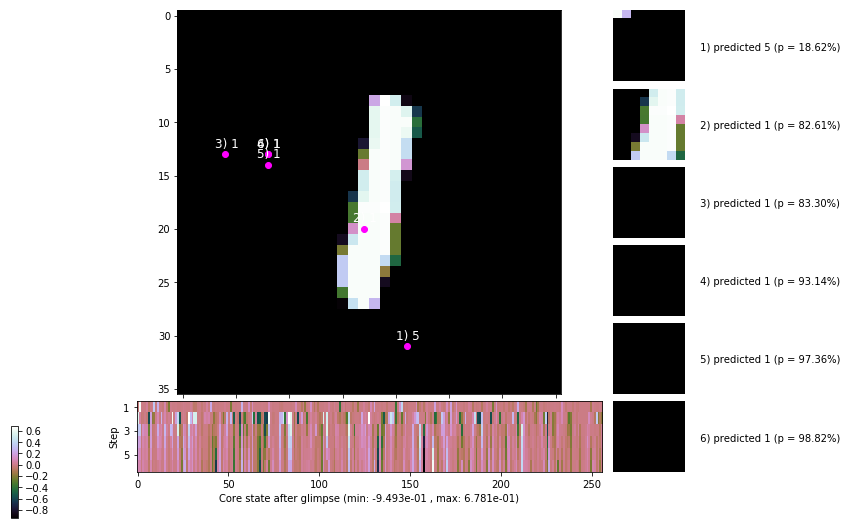

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


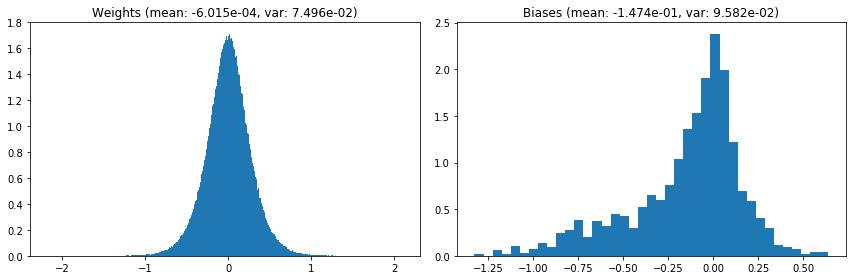

                                      Location network weights and biases


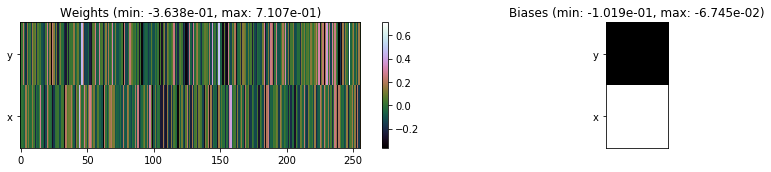

---------------------------------------------------------------------------------------------------------------
Elapsed time:  494.52 sec | TRAIN >> class loss: 0.3272 | steps:  2.229 :( | reward:  4.4834 :( | acc.: 89.368% :(
                          | VAL   >> class loss: 0.3552 | steps:  2.185 :( | reward:  4.5420 :( | acc.: 88.080% :(


Epoch  49/400) lr = 0.0004866
 b    300/  3000 >> 160.5 ms/b | lr: 4.86e-04 | grad 2norm:  7.62 | grad inf norm:  2.078
         Weights || abs max:  2.18 ( 2981.91) | mean: -5.68e-04 ( 0.01) | var: 7.50e-02 (  281.69)
          Biases || abs max:  1.33 (  122.57) | mean: -1.47e-01 ( 0.15) | var: 9.60e-02 (   46.83)
                    class loss: 0.333 | steps: 2.238 | reward:  4.483 | acc.: 89.30%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 160.2 ms/b | lr: 4.86e-04 | grad 2norm:  7.54 | grad inf norm:  2.105
         Weights || abs max:  2.18 ( 2607.40) | mean: -5.60e-04 (

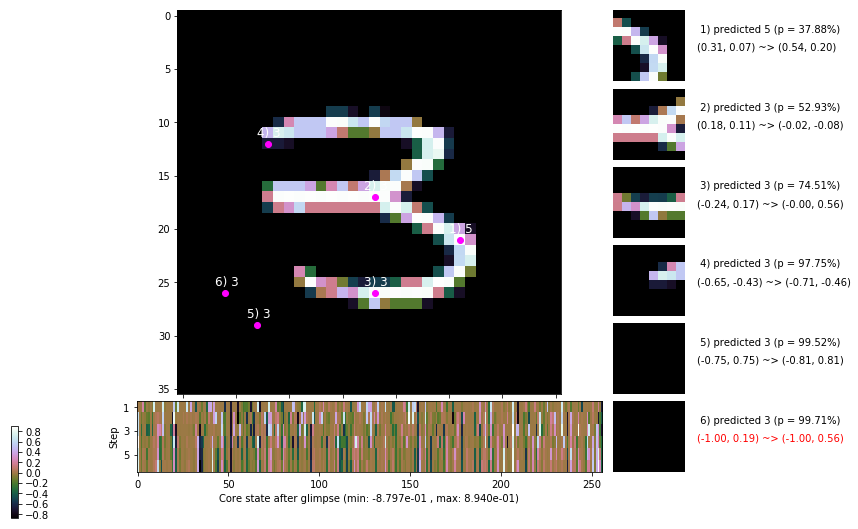

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 170.6 ms/b | lr: 4.85e-04 | grad 2norm:  7.64 | grad inf norm:  2.055
         Weights || abs max:  2.17 ( 2598.75) | mean: -5.67e-04 ( 0.01) | var: 7.51e-02 (  112.84)
          Biases || abs max:  1.33 ( 1122.54) | mean: -1.48e-01 ( 0.54) | var: 9.62e-02 (39617.86)
                    class loss: 0.314 | steps: 2.220 | reward:  4.504 | acc.: 90.15%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 178.3 ms/b | lr: 4.84e-04 | grad 2norm:  7.71 | grad inf norm:  2.122
         Weights || abs max:  2.18 ( 2666.00) | mean: -5.95e-04 ( 0.01) | var: 7.51e-02 (  125.49)
          Biases || abs max:  1.33 ( 1694.71) | mean: -1.48e-01 ( 0.74) | var: 9.63e-02 (255421.42)
                    class loss: 0.311 | steps: 2.232 | reward:  4.481 | acc.: 89.78%

	Target class: 8 | Discounted rewards: [0.011, 0.111, 1.

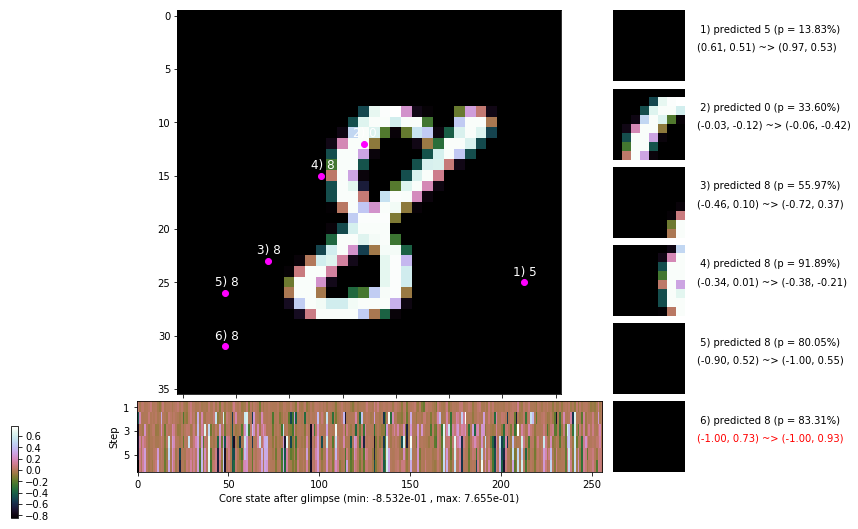

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 165.2 ms/b | lr: 4.83e-04 | grad 2norm:  7.62 | grad inf norm:  2.133
         Weights || abs max:  2.18 ( 4767.42) | mean: -6.15e-04 ( 0.02) | var: 7.52e-02 ( 2291.00)
          Biases || abs max:  1.32 (  186.41) | mean: -1.48e-01 ( 0.17) | var: 9.63e-02 (   97.16)
                    class loss: 0.313 | steps: 2.236 | reward:  4.481 | acc.: 89.40%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 159.0 ms/b | lr: 4.83e-04 | grad 2norm:  7.70 | grad inf norm:  2.170
         Weights || abs max:  2.18 ( 3479.70) | mean: -6.08e-04 ( 0.02) | var: 7.52e-02 (  273.31)
          Biases || abs max:  1.32 (  174.80) | mean: -1.48e-01 ( 0.16) | var: 9.64e-02 (  197.90)
                    class loss: 0.326 | steps: 2.231 | reward:  4.460 | acc.: 88.90%

	Target class: 5 | Discounted rewards: [0.111, 1.111, 1.1

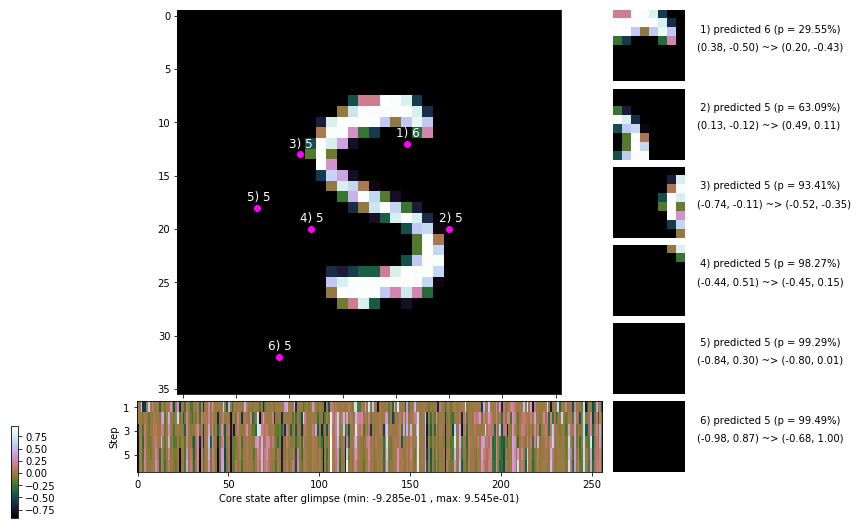

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 160.3 ms/b | lr: 4.82e-04 | grad 2norm:  7.36 | grad inf norm:  2.002
         Weights || abs max:  2.18 ( 4654.08) | mean: -6.00e-04 ( 0.02) | var: 7.53e-02 (  753.92)
          Biases || abs max:  1.33 (  585.09) | mean: -1.48e-01 ( 0.31) | var: 9.65e-02 ( 8772.04)
                    class loss: 0.324 | steps: 2.223 | reward:  4.501 | acc.: 90.05%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 167.5 ms/b | lr: 4.81e-04 | grad 2norm:  7.45 | grad inf norm:  2.102
         Weights || abs max:  2.18 ( 3132.55) | mean: -6.07e-04 ( 0.02) | var: 7.53e-02 (  331.53)
          Biases || abs max:  1.33 (  176.85) | mean: -1.48e-01 ( 0.17) | var: 9.63e-02 (  542.74)
                    class loss: 0.309 | steps: 2.202 | reward:  4.521 | acc.: 89.77%

	Target class: 8 | Discounted rewards: [0.001, 0.011, 0.1

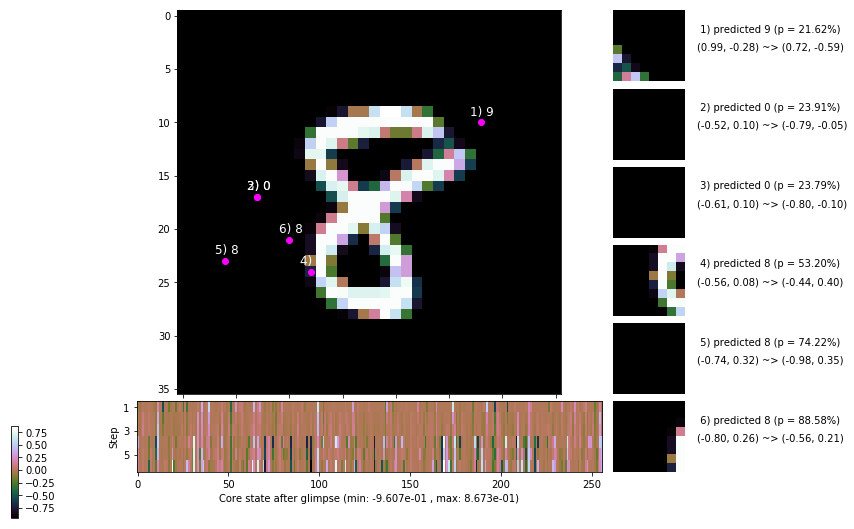

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 162.0 ms/b | lr: 4.80e-04 | grad 2norm:  7.42 | grad inf norm:  2.106
         Weights || abs max:  2.18 ( 2440.96) | mean: -6.07e-04 ( 0.01) | var: 7.54e-02 (   72.60)
          Biases || abs max:  1.34 (  297.02) | mean: -1.48e-01 ( 0.21) | var: 9.63e-02 ( 1369.44)
                    class loss: 0.325 | steps: 2.209 | reward:  4.520 | acc.: 89.82%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 159.7 ms/b | lr: 4.80e-04 | grad 2norm:  7.37 | grad inf norm:  2.038
         Weights || abs max:  2.18 (11322.25) | mean: -6.36e-04 ( 0.03) | var: 7.54e-02 (28753.05)
          Biases || abs max:  1.34 (  161.40) | mean: -1.48e-01 ( 0.16) | var: 9.63e-02 (   72.33)
                    class loss: 0.305 | steps: 2.197 | reward:  4.510 | acc.: 89.60%

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.1

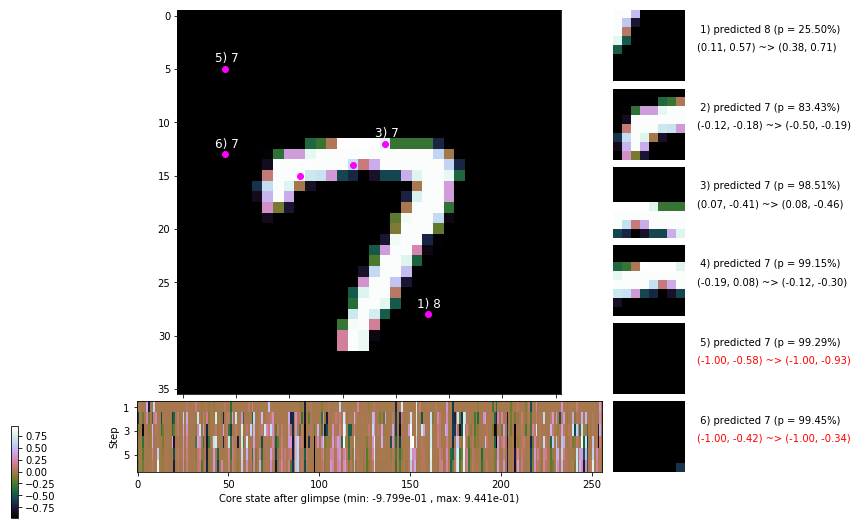

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


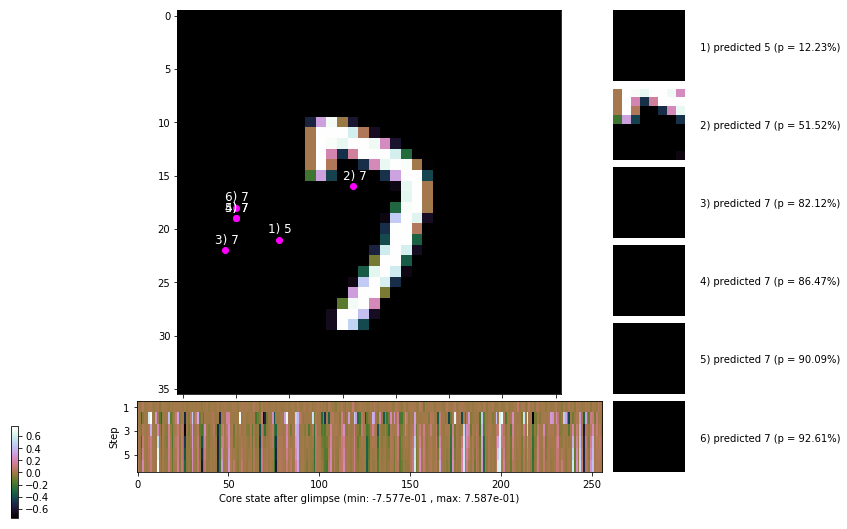


	Target class: 5 | Discounted rewards: [0.011, 0.111, 1.111, 1.110, 1.100, 1.000]


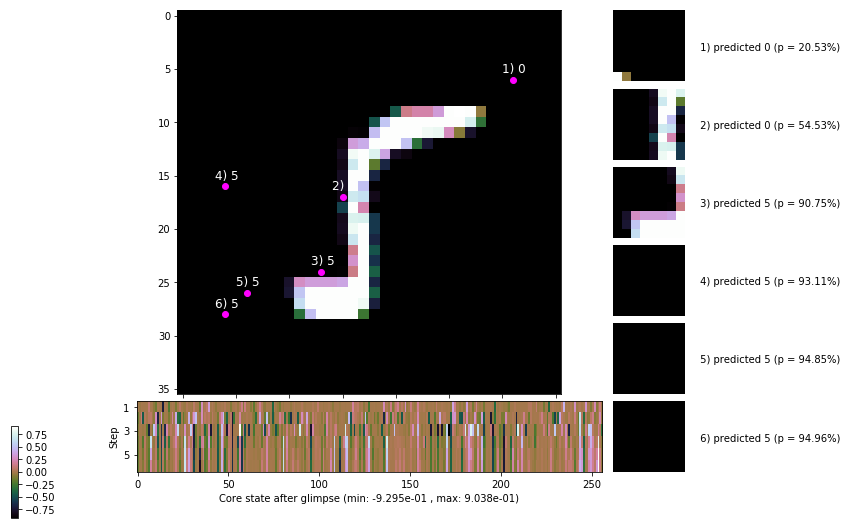

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


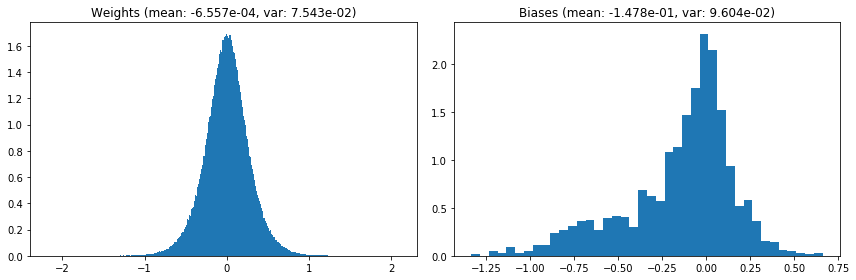

                                      Location network weights and biases


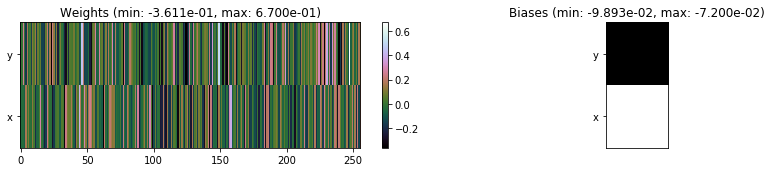

---------------------------------------------------------------------------------------------------------------
Elapsed time:  493.81 sec | TRAIN >> class loss: 0.3169 | steps:  2.219    | reward:  4.4973    | acc.: 89.653% 
                          | VAL   >> class loss: 0.3432 | steps:  2.157 :( | reward:  4.5692 :( | acc.: 88.520% :(


Epoch  50/400) lr = 0.0004793
 b    300/  3000 >> 162.1 ms/b | lr: 4.79e-04 | grad 2norm:  7.13 | grad inf norm:  1.956
         Weights || abs max:  2.18 (43200.24) | mean: -6.85e-04 ( 0.09) | var: 7.55e-02 (903840.12)
          Biases || abs max:  1.34 (  887.21) | mean: -1.48e-01 ( 0.44) | var: 9.61e-02 (44388.31)
                    class loss: 0.311 | steps: 2.217 | reward:  4.528 | acc.: 90.20%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 160.8 ms/b | lr: 4.78e-04 | grad 2norm:  7.27 | grad inf norm:  2.058
         Weights || abs max:  2.18 ( 3725.35) | mean: -6.89e-04 ( 

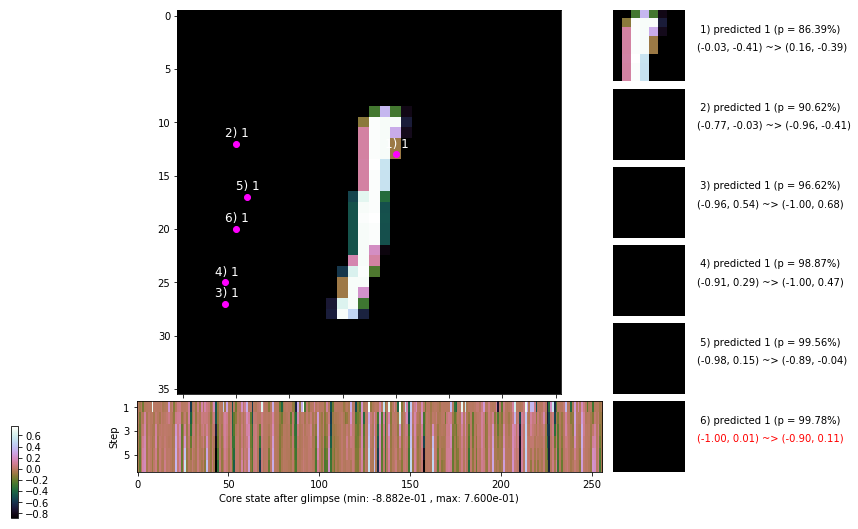

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 163.6 ms/b | lr: 4.77e-04 | grad 2norm:  7.43 | grad inf norm:  2.065
         Weights || abs max:  2.18 ( 3056.47) | mean: -6.72e-04 ( 0.01) | var: 7.56e-02 (  385.38)
          Biases || abs max:  1.36 (  159.92) | mean: -1.48e-01 ( 0.16) | var: 9.63e-02 (  111.86)
                    class loss: 0.324 | steps: 2.239 | reward:  4.479 | acc.: 89.93%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 160.6 ms/b | lr: 4.77e-04 | grad 2norm:  7.60 | grad inf norm:  2.100
         Weights || abs max:  2.19 ( 8508.34) | mean: -6.58e-04 ( 0.02) | var: 7.56e-02 (20639.81)
          Biases || abs max:  1.35 (  139.35) | mean: -1.48e-01 ( 0.17) | var: 9.64e-02 (  775.32)
                    class loss: 0.322 | steps: 2.245 | reward:  4.466 | acc.: 89.30%

	Target class: 2 | Discounted rewards: [0.000, 0.000, 0.0

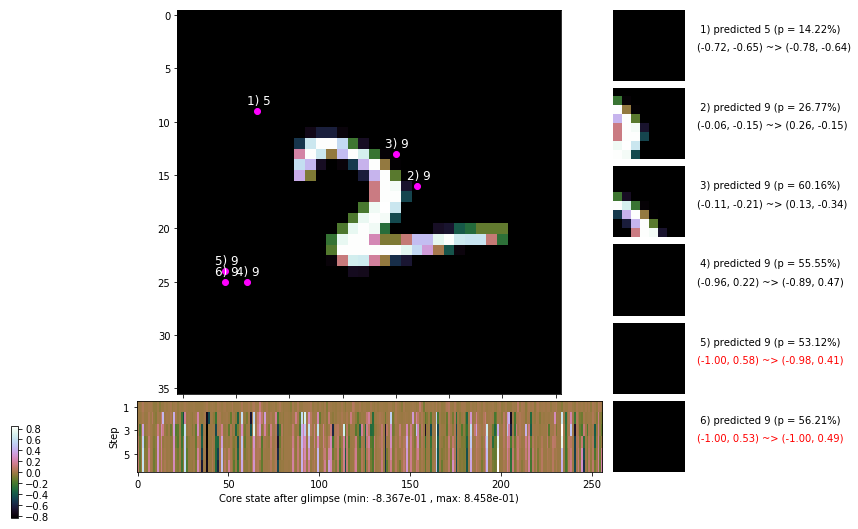

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 184.4 ms/b | lr: 4.76e-04 | grad 2norm:  7.44 | grad inf norm:  2.149
         Weights || abs max:  2.20 ( 3410.53) | mean: -6.47e-04 ( 0.02) | var: 7.57e-02 (  258.31)
          Biases || abs max:  1.35 (  336.19) | mean: -1.48e-01 ( 0.23) | var: 9.64e-02 ( 3027.02)
                    class loss: 0.302 | steps: 2.225 | reward:  4.497 | acc.: 89.73%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 168.5 ms/b | lr: 4.76e-04 | grad 2norm:  7.56 | grad inf norm:  2.030
         Weights || abs max:  2.18 ( 2312.55) | mean: -6.42e-04 ( 0.01) | var: 7.57e-02 (   80.36)
          Biases || abs max:  1.34 (  382.77) | mean: -1.48e-01 ( 0.25) | var: 9.64e-02 ( 2698.83)
                    class loss: 0.327 | steps: 2.244 | reward:  4.466 | acc.: 88.80%

	Target class: 7 | Discounted rewards: [0.000, 0.001, 0.0

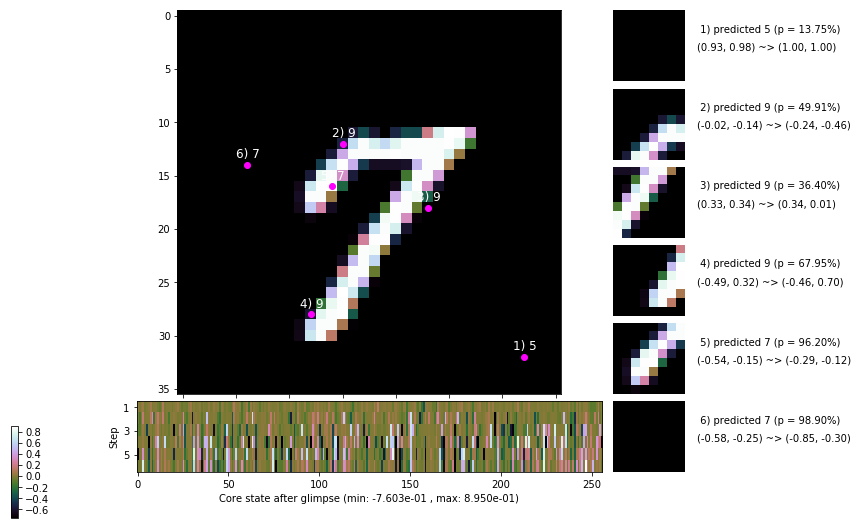

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 166.0 ms/b | lr: 4.75e-04 | grad 2norm:  7.54 | grad inf norm:  2.055
         Weights || abs max:  2.18 ( 4146.64) | mean: -6.59e-04 ( 0.02) | var: 7.58e-02 (  553.46)
          Biases || abs max:  1.35 (  303.72) | mean: -1.48e-01 ( 0.22) | var: 9.67e-02 ( 3342.56)
                    class loss: 0.333 | steps: 2.231 | reward:  4.477 | acc.: 88.93%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 162.9 ms/b | lr: 4.74e-04 | grad 2norm:  7.56 | grad inf norm:  2.273
         Weights || abs max:  2.19 ( 8412.34) | mean: -6.53e-04 ( 0.03) | var: 7.58e-02 (10641.01)
          Biases || abs max:  1.34 (  196.66) | mean: -1.48e-01 ( 0.19) | var: 9.67e-02 ( 1011.97)
                    class loss: 0.335 | steps: 2.254 | reward:  4.468 | acc.: 89.08%

	Target class: 5 | Discounted rewards: [0.000, 0.000, 0.0

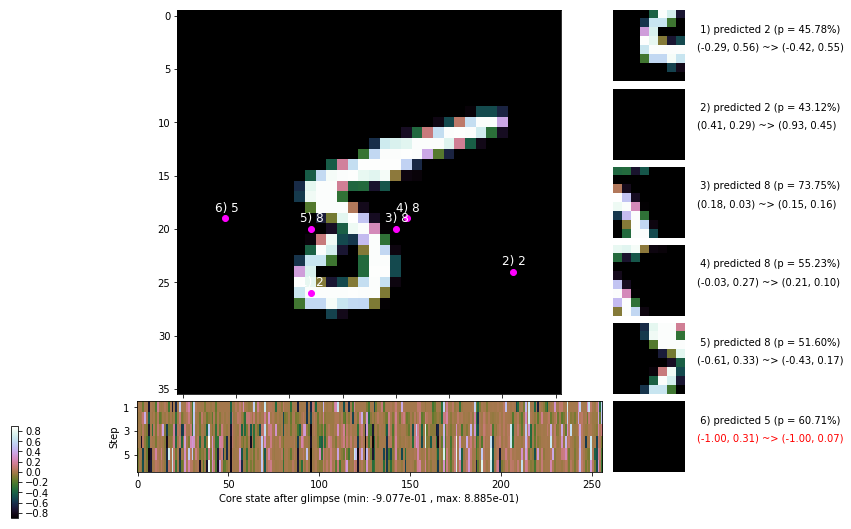

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 161.9 ms/b | lr: 4.73e-04 | grad 2norm:  7.45 | grad inf norm:  2.103
         Weights || abs max:  2.20 ( 5833.78) | mean: -6.59e-04 ( 0.02) | var: 7.59e-02 ( 3352.50)
          Biases || abs max:  1.35 (  246.50) | mean: -1.48e-01 ( 0.20) | var: 9.67e-02 ( 1119.17)
                    class loss: 0.345 | steps: 2.251 | reward:  4.459 | acc.: 88.43%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 160.9 ms/b | lr: 4.73e-04 | grad 2norm:  7.51 | grad inf norm:  2.124
         Weights || abs max:  2.19 ( 3103.82) | mean: -6.61e-04 ( 0.02) | var: 7.59e-02 (  717.86)
          Biases || abs max:  1.35 (  182.87) | mean: -1.48e-01 ( 0.17) | var: 9.67e-02 (  537.96)
                    class loss: 0.314 | steps: 2.216 | reward:  4.497 | acc.: 89.58%

	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.1

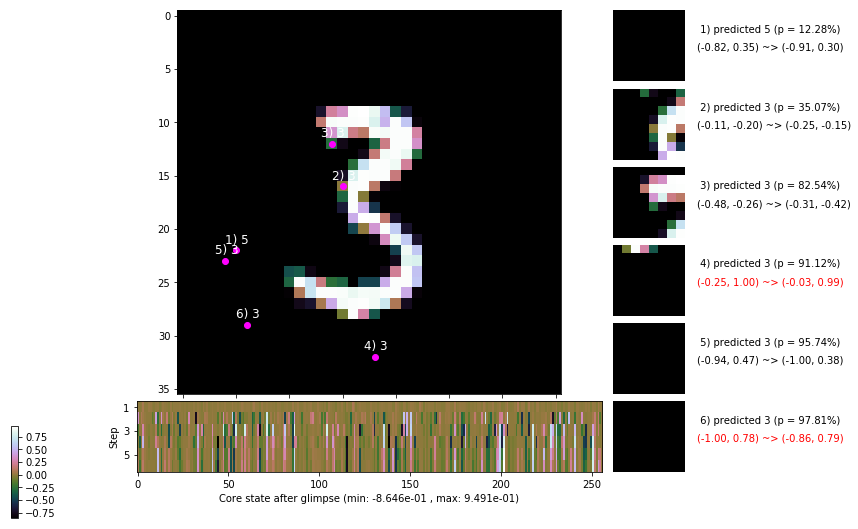

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


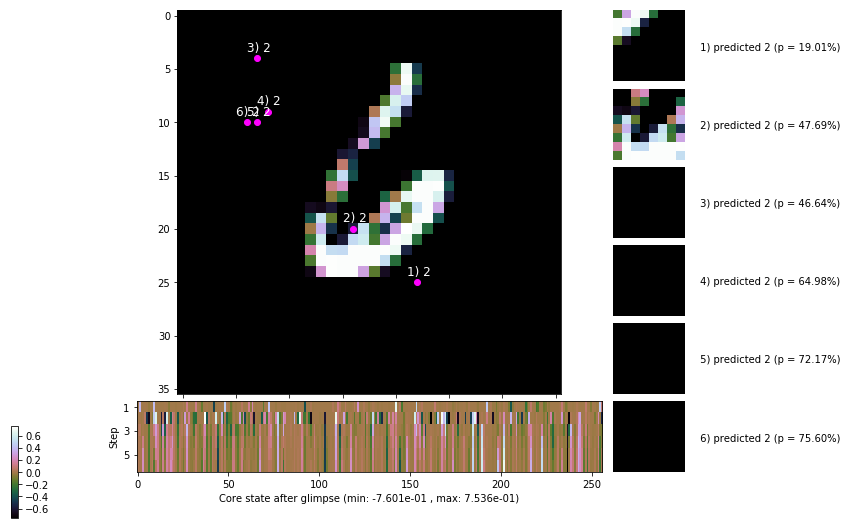


	Target class: 6 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


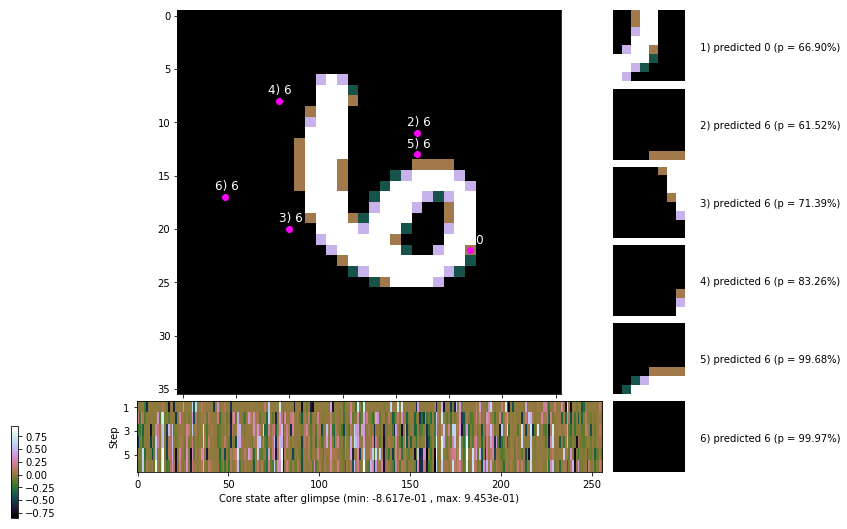

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


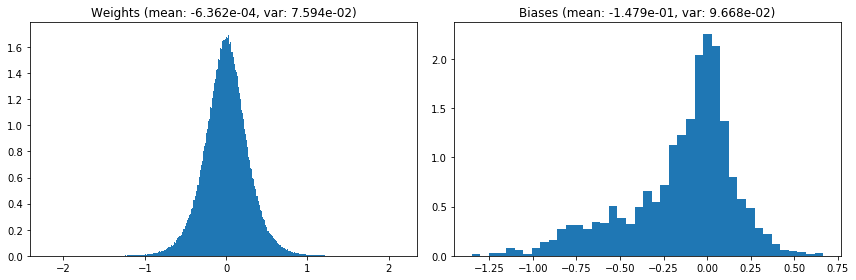

                                      Location network weights and biases


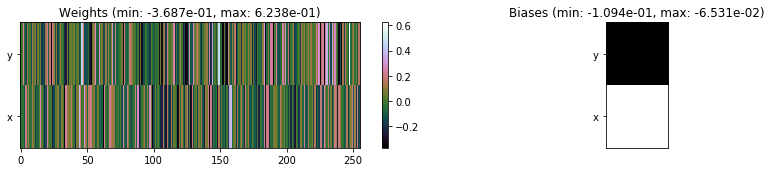

---------------------------------------------------------------------------------------------------------------
Elapsed time:  496.32 sec | TRAIN >> class loss: 0.3217 | steps:  2.232 :( | reward:  4.4881 :( | acc.: 89.397% :(
                          | VAL   >> class loss: 0.3646 | steps:  2.160 :( | reward:  4.5494 :( | acc.: 88.000% :(


Epoch  51/400) lr = 0.0004722
 b    300/  3000 >> 158.4 ms/b | lr: 4.72e-04 | grad 2norm:  7.48 | grad inf norm:  2.154
         Weights || abs max:  2.20 ( 6276.73) | mean: -6.49e-04 ( 0.02) | var: 7.60e-02 ( 5211.80)
          Biases || abs max:  1.35 (  241.57) | mean: -1.48e-01 ( 0.22) | var: 9.68e-02 (  306.96)
                    class loss: 0.335 | steps: 2.241 | reward:  4.451 | acc.: 88.70%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 162.2 ms/b | lr: 4.71e-04 | grad 2norm:  7.29 | grad inf norm:  2.143
         Weights || abs max:  2.19 ( 2947.24) | mean: -6.73e-04 (

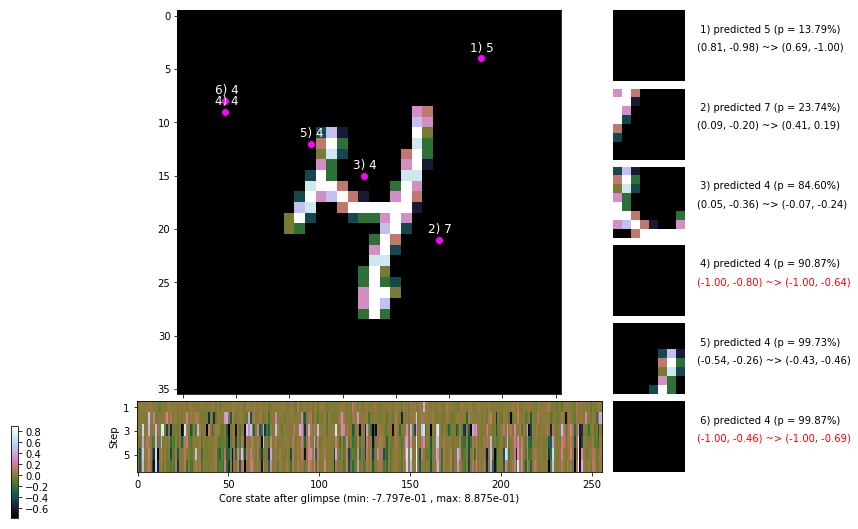

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 162.4 ms/b | lr: 4.70e-04 | grad 2norm:  7.42 | grad inf norm:  2.108
         Weights || abs max:  2.19 ( 2451.20) | mean: -6.87e-04 ( 0.01) | var: 7.61e-02 (   84.24)
          Biases || abs max:  1.36 (  561.16) | mean: -1.49e-01 ( 0.33) | var: 9.71e-02 ( 6272.23)
                    class loss: 0.330 | steps: 2.244 | reward:  4.469 | acc.: 88.73%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 158.8 ms/b | lr: 4.70e-04 | grad 2norm:  7.50 | grad inf norm:  2.082
         Weights || abs max:  2.20 ( 6584.05) | mean: -6.72e-04 ( 0.02) | var: 7.61e-02 ( 9806.55)
          Biases || abs max:  1.36 (  187.36) | mean: -1.49e-01 ( 0.18) | var: 9.73e-02 (  836.93)
                    class loss: 0.332 | steps: 2.255 | reward:  4.457 | acc.: 88.92%

	Target class: 2 | Discounted rewards: [0.111, 1.111, 1.1

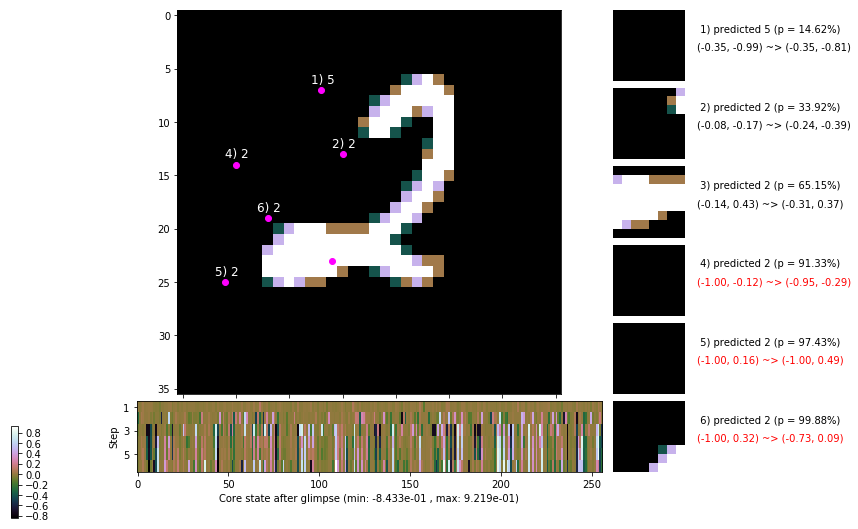

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 163.7 ms/b | lr: 4.69e-04 | grad 2norm:  7.51 | grad inf norm:  2.155
         Weights || abs max:  2.20 ( 2351.40) | mean: -6.73e-04 ( 0.01) | var: 7.62e-02 (   71.28)
          Biases || abs max:  1.37 (  131.81) | mean: -1.49e-01 ( 0.14) | var: 9.72e-02 (   63.68)
                    class loss: 0.328 | steps: 2.232 | reward:  4.476 | acc.: 89.28%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 160.0 ms/b | lr: 4.68e-04 | grad 2norm:  7.55 | grad inf norm:  2.167
         Weights || abs max:  2.20 ( 3639.59) | mean: -6.97e-04 ( 0.02) | var: 7.62e-02 (  520.36)
          Biases || abs max:  1.37 (  123.89) | mean: -1.49e-01 ( 0.14) | var: 9.73e-02 (   89.53)
                    class loss: 0.330 | steps: 2.212 | reward:  4.502 | acc.: 89.13%

	Target class: 5 | Discounted rewards: [1.000, 0.000, 0.0

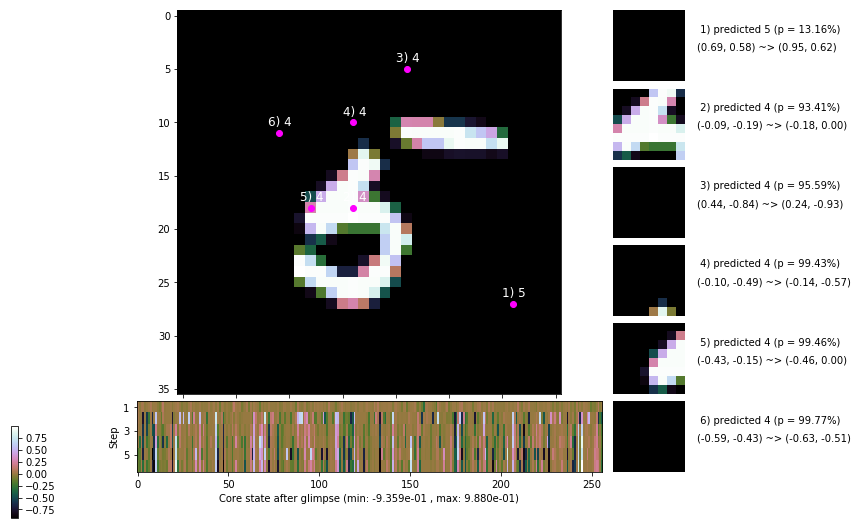

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 184.3 ms/b | lr: 4.67e-04 | grad 2norm:  7.48 | grad inf norm:  2.136
         Weights || abs max:  2.20 (15205.78) | mean: -6.97e-04 ( 0.04) | var: 7.63e-02 (51457.04)
          Biases || abs max:  1.37 (  238.82) | mean: -1.49e-01 ( 0.20) | var: 9.74e-02 (  363.70)
                    class loss: 0.345 | steps: 2.244 | reward:  4.474 | acc.: 88.80%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 166.3 ms/b | lr: 4.67e-04 | grad 2norm:  7.35 | grad inf norm:  2.094
         Weights || abs max:  2.21 ( 4060.74) | mean: -7.00e-04 ( 0.02) | var: 7.63e-02 ( 1187.22)
          Biases || abs max:  1.37 (   98.24) | mean: -1.49e-01 ( 0.13) | var: 9.74e-02 (   20.78)
                    class loss: 0.336 | steps: 2.238 | reward:  4.469 | acc.: 88.95%

	Target class: 6 | Discounted rewards: [0.111, 1.111, 1.1

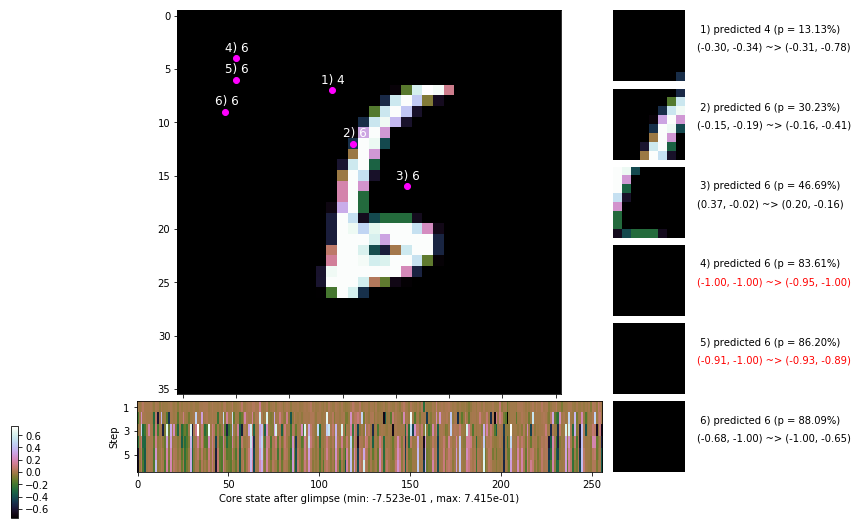

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 164.8 ms/b | lr: 4.66e-04 | grad 2norm:  7.57 | grad inf norm:  2.148
         Weights || abs max:  2.22 ( 3226.23) | mean: -7.20e-04 ( 0.02) | var: 7.64e-02 (  230.71)
          Biases || abs max:  1.36 (  152.59) | mean: -1.49e-01 ( 0.15) | var: 9.74e-02 (   67.15)
                    class loss: 0.343 | steps: 2.242 | reward:  4.455 | acc.: 88.63%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 159.1 ms/b | lr: 4.66e-04 | grad 2norm:  7.44 | grad inf norm:  2.124
         Weights || abs max:  2.22 (11056.58) | mean: -7.29e-04 ( 0.03) | var: 7.64e-02 (16670.05)
          Biases || abs max:  1.37 (   70.69) | mean: -1.49e-01 ( 0.11) | var: 9.76e-02 (   11.31)
                    class loss: 0.345 | steps: 2.244 | reward:  4.455 | acc.: 88.72%

	Target class: 6 | Discounted rewards: [0.000, 0.000, 0.0

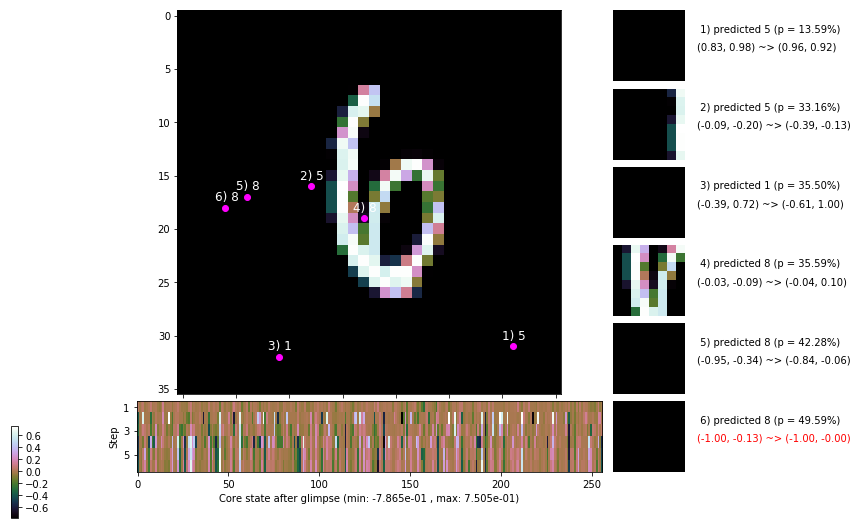

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


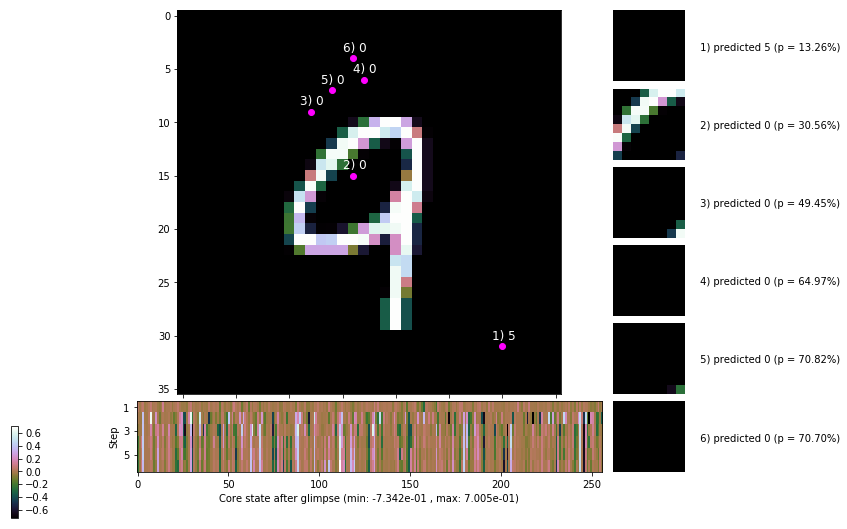


	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


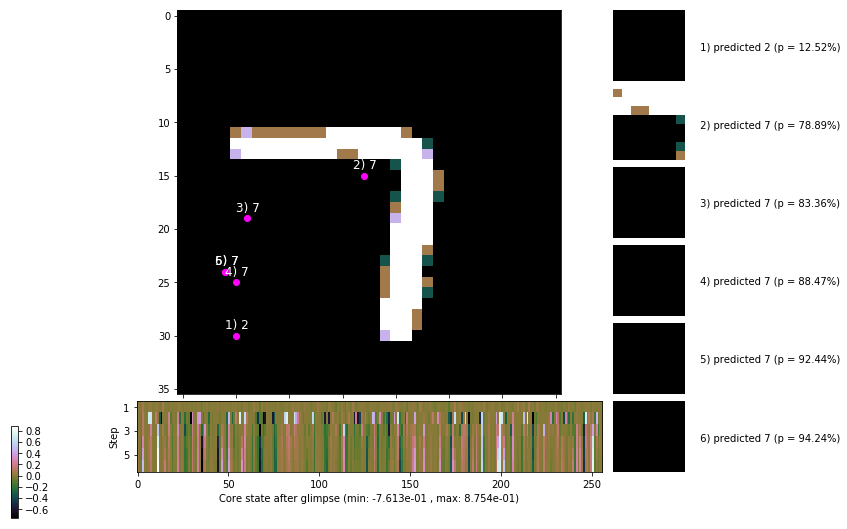

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


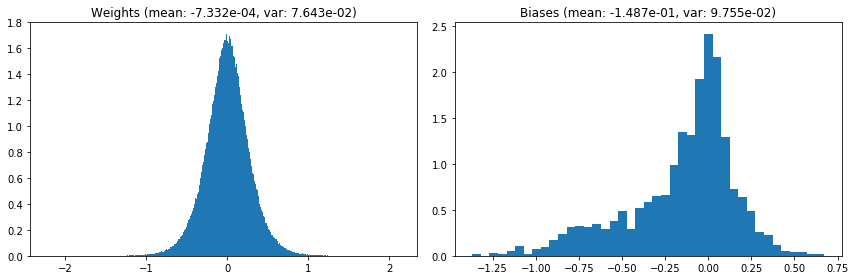

                                      Location network weights and biases


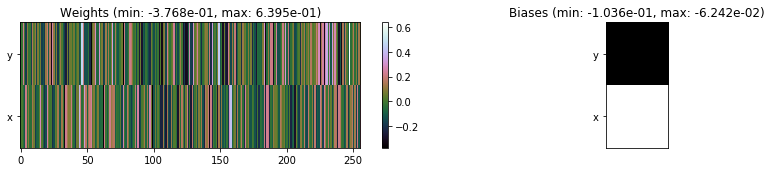

---------------------------------------------------------------------------------------------------------------
Elapsed time:  492.62 sec | TRAIN >> class loss: 0.3339 | steps:  2.236 :( | reward:  4.4709 :( | acc.: 88.950% :(
                          | VAL   >> class loss: 0.3520 | steps:  2.168 :( | reward:  4.5328 :( | acc.: 88.120% :(


Epoch  52/400) lr = 0.0004652
 b    300/  3000 >> 159.5 ms/b | lr: 4.65e-04 | grad 2norm:  7.55 | grad inf norm:  2.130
         Weights || abs max:  2.22 ( 2592.61) | mean: -7.11e-04 ( 0.01) | var: 7.65e-02 (   78.18)
          Biases || abs max:  1.37 ( 3877.70) | mean: -1.48e-01 ( 1.60) | var: 9.75e-02 (1656918.50)
                    class loss: 0.302 | steps: 2.211 | reward:  4.511 | acc.: 89.93%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 163.0 ms/b | lr: 4.64e-04 | grad 2norm:  7.70 | grad inf norm:  2.137
         Weights || abs max:  2.22 ( 4220.22) | mean: -7.09e-04

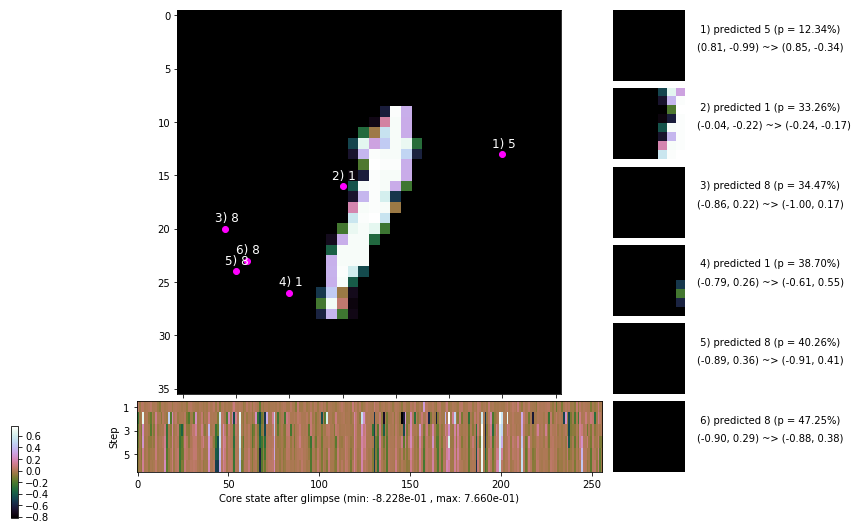

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 163.0 ms/b | lr: 4.63e-04 | grad 2norm:  7.42 | grad inf norm:  2.207
         Weights || abs max:  2.22 ( 3872.77) | mean: -7.31e-04 ( 0.02) | var: 7.66e-02 (  503.32)
          Biases || abs max:  1.36 (  169.28) | mean: -1.48e-01 ( 0.16) | var: 9.78e-02 (  202.45)
                    class loss: 0.322 | steps: 2.238 | reward:  4.474 | acc.: 89.12%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 162.4 ms/b | lr: 4.63e-04 | grad 2norm:  7.50 | grad inf norm:  2.153
         Weights || abs max:  2.22 ( 6734.88) | mean: -7.46e-04 ( 0.02) | var: 7.66e-02 ( 4721.32)
          Biases || abs max:  1.37 (  562.95) | mean: -1.49e-01 ( 0.35) | var: 9.79e-02 (15935.85)
                    class loss: 0.339 | steps: 2.265 | reward:  4.454 | acc.: 89.02%

	Target class: 9 | Discounted rewards: [0.000, 0.001, 0.0

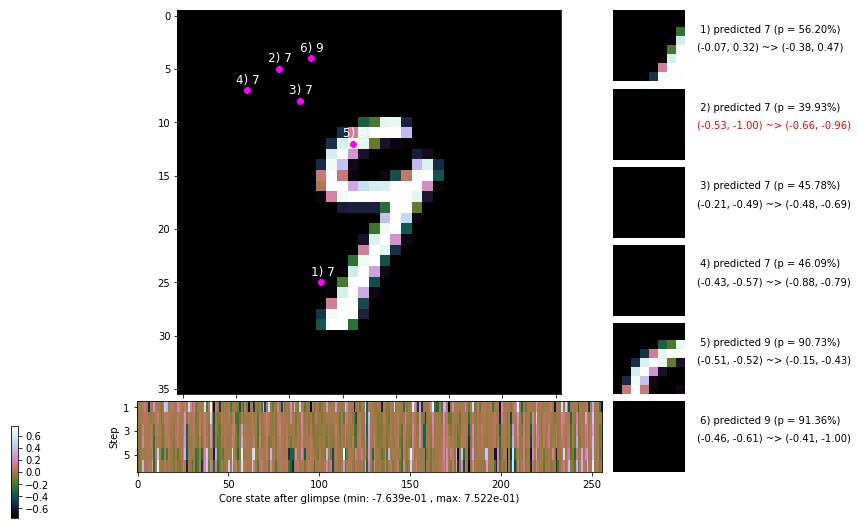

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 162.7 ms/b | lr: 4.62e-04 | grad 2norm:  7.30 | grad inf norm:  2.019
         Weights || abs max:  2.22 ( 8138.84) | mean: -7.23e-04 ( 0.02) | var: 7.66e-02 (13206.79)
          Biases || abs max:  1.37 (  166.11) | mean: -1.49e-01 ( 0.15) | var: 9.80e-02 (  313.09)
                    class loss: 0.325 | steps: 2.226 | reward:  4.495 | acc.: 89.37%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 160.8 ms/b | lr: 4.61e-04 | grad 2norm:  7.39 | grad inf norm:  2.088
         Weights || abs max:  2.23 ( 4803.35) | mean: -6.94e-04 ( 0.02) | var: 7.67e-02 ( 1258.56)
          Biases || abs max:  1.36 (  220.70) | mean: -1.49e-01 ( 0.19) | var: 9.79e-02 (  831.76)
                    class loss: 0.315 | steps: 2.212 | reward:  4.507 | acc.: 89.92%

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.1

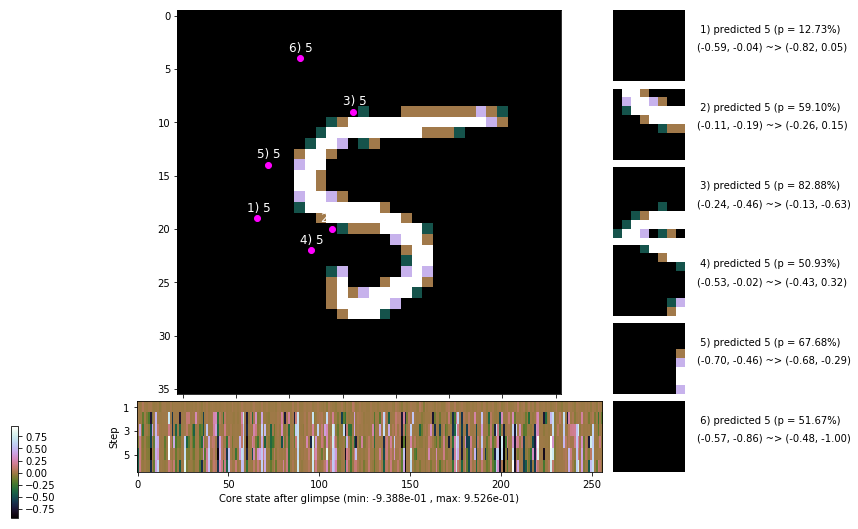

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 162.9 ms/b | lr: 4.61e-04 | grad 2norm:  7.41 | grad inf norm:  2.084
         Weights || abs max:  2.23 ( 3042.80) | mean: -6.88e-04 ( 0.02) | var: 7.67e-02 (  237.97)
          Biases || abs max:  1.36 (  286.82) | mean: -1.49e-01 ( 0.21) | var: 9.78e-02 (  606.52)
                    class loss: 0.322 | steps: 2.221 | reward:  4.487 | acc.: 89.60%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 160.3 ms/b | lr: 4.60e-04 | grad 2norm:  7.63 | grad inf norm:  2.144
         Weights || abs max:  2.23 ( 3778.05) | mean: -7.00e-04 ( 0.02) | var: 7.68e-02 (  443.69)
          Biases || abs max:  1.36 (  360.15) | mean: -1.49e-01 ( 0.24) | var: 9.78e-02 (  620.02)
                    class loss: 0.329 | steps: 2.241 | reward:  4.470 | acc.: 88.93%

	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.0

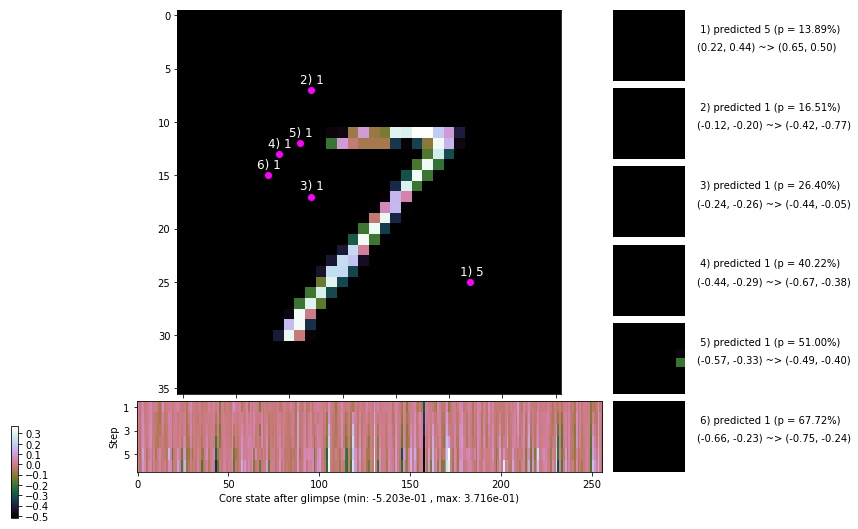

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 169.9 ms/b | lr: 4.59e-04 | grad 2norm:  7.32 | grad inf norm:  2.075
         Weights || abs max:  2.22 ( 3882.20) | mean: -6.93e-04 ( 0.02) | var: 7.68e-02 (  245.07)
          Biases || abs max:  1.35 (  121.50) | mean: -1.49e-01 ( 0.14) | var: 9.80e-02 (   29.32)
                    class loss: 0.321 | steps: 2.237 | reward:  4.475 | acc.: 89.20%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 180.6 ms/b | lr: 4.59e-04 | grad 2norm:  7.42 | grad inf norm:  2.099
         Weights || abs max:  2.22 ( 3936.45) | mean: -6.82e-04 ( 0.02) | var: 7.68e-02 (  721.51)
          Biases || abs max:  1.35 (  485.51) | mean: -1.49e-01 ( 0.29) | var: 9.82e-02 ( 4401.30)
                    class loss: 0.328 | steps: 2.220 | reward:  4.495 | acc.: 89.27%

	Target class: 6 | Discounted rewards: [0.111, 1.111, 1.1

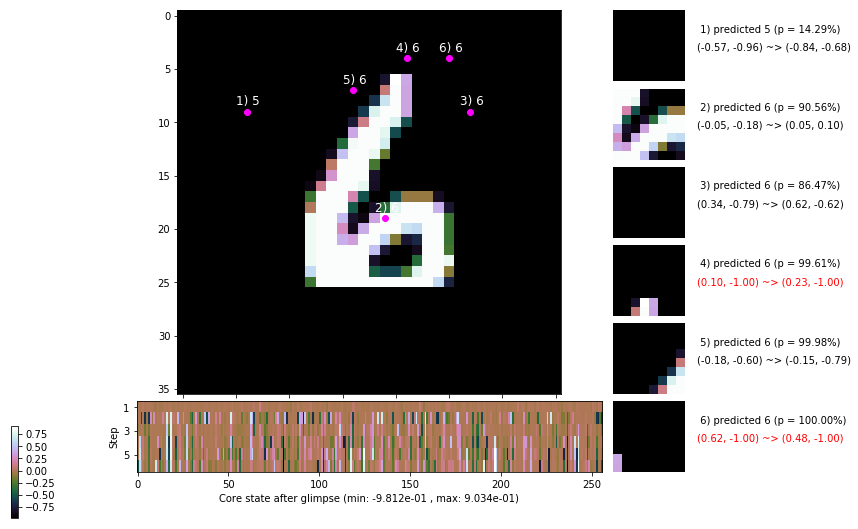

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


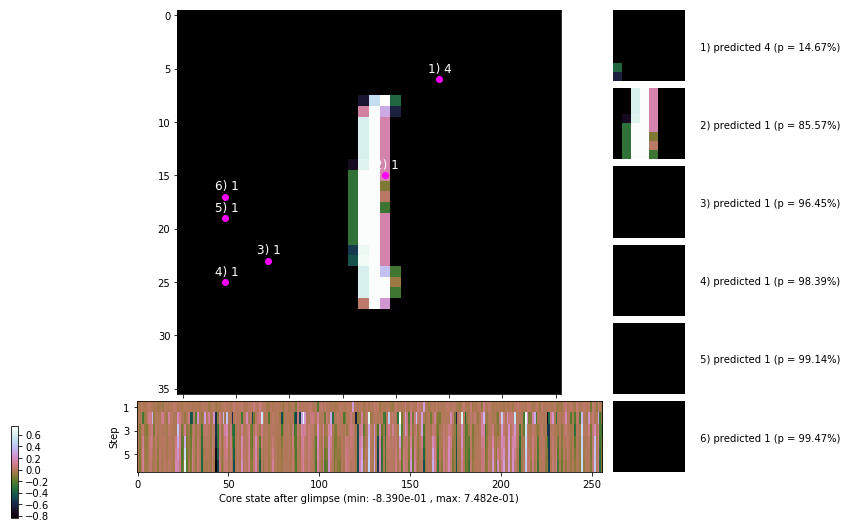


	Target class: 2 | Discounted rewards: [1.100, 1.000, 0.000, 0.000, 0.000, 0.000]


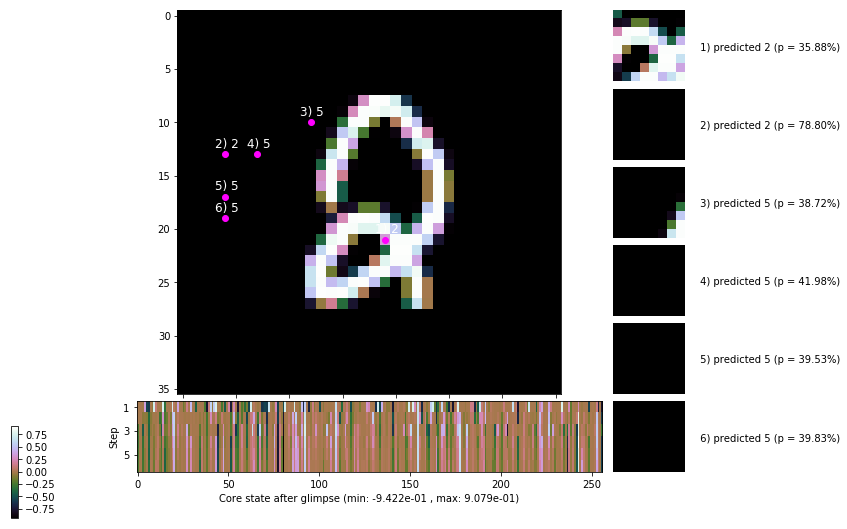

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


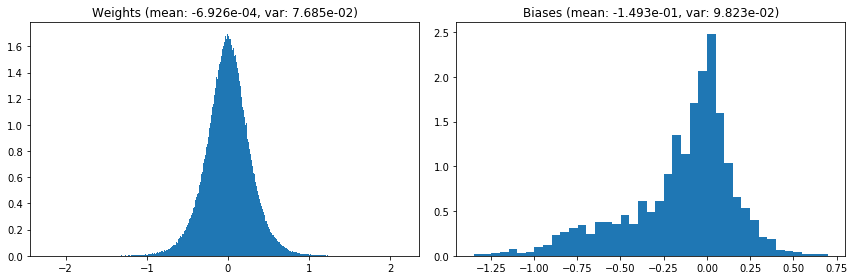

                                      Location network weights and biases


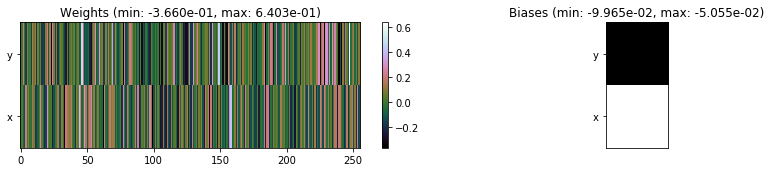

---------------------------------------------------------------------------------------------------------------
Elapsed time:  494.34 sec | TRAIN >> class loss: 0.3228 | steps:  2.233 :( | reward:  4.4824 :( | acc.: 89.330% :(
                          | VAL   >> class loss: 0.3390 | steps:  2.167 :( | reward:  4.5736 :( | acc.: 88.900% 


Epoch  53/400) lr = 0.0004582
 b    300/  3000 >> 161.1 ms/b | lr: 4.58e-04 | grad 2norm:  7.35 | grad inf norm:  2.073
         Weights || abs max:  2.22 ( 4285.27) | mean: -6.93e-04 ( 0.02) | var: 7.69e-02 (  625.44)
          Biases || abs max:  1.35 (   73.03) | mean: -1.49e-01 ( 0.12) | var: 9.83e-02 (   17.45)
                    class loss: 0.309 | steps: 2.204 | reward:  4.516 | acc.: 89.85%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 161.7 ms/b | lr: 4.57e-04 | grad 2norm:  7.14 | grad inf norm:  2.069
         Weights || abs max:  2.22 ( 7262.55) | mean: -7.15e-04 ( 0

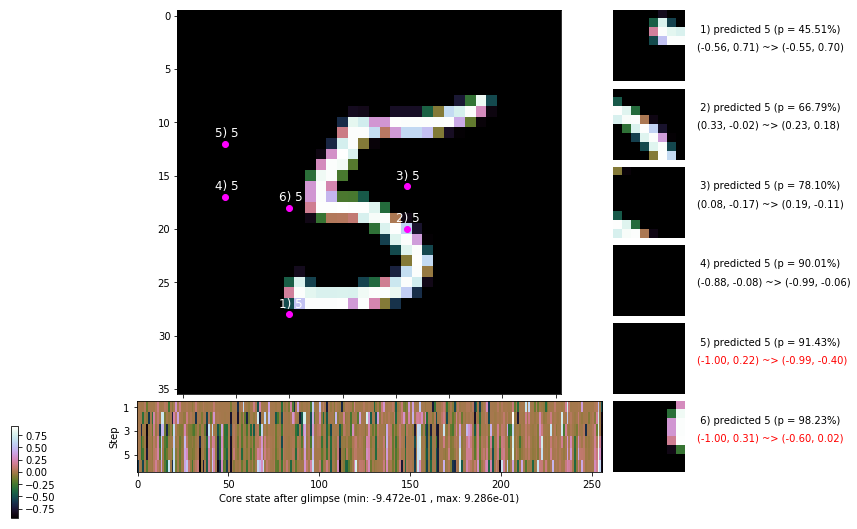

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 161.3 ms/b | lr: 4.56e-04 | grad 2norm:  7.39 | grad inf norm:  2.130
         Weights || abs max:  2.22 ( 4121.26) | mean: -7.04e-04 ( 0.02) | var: 7.70e-02 (  379.15)
          Biases || abs max:  1.35 (  186.80) | mean: -1.49e-01 ( 0.17) | var: 9.82e-02 (  262.09)
                    class loss: 0.319 | steps: 2.212 | reward:  4.522 | acc.: 89.98%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 161.1 ms/b | lr: 4.56e-04 | grad 2norm:  7.46 | grad inf norm:  2.213
         Weights || abs max:  2.22 ( 8805.26) | mean: -6.79e-04 ( 0.03) | var: 7.70e-02 (10047.67)
          Biases || abs max:  1.36 (  168.00) | mean: -1.49e-01 ( 0.15) | var: 9.84e-02 (  143.90)
                    class loss: 0.321 | steps: 2.216 | reward:  4.515 | acc.: 89.68%

	Target class: 3 | Discounted rewards: [0.001, 0.011, 0.1

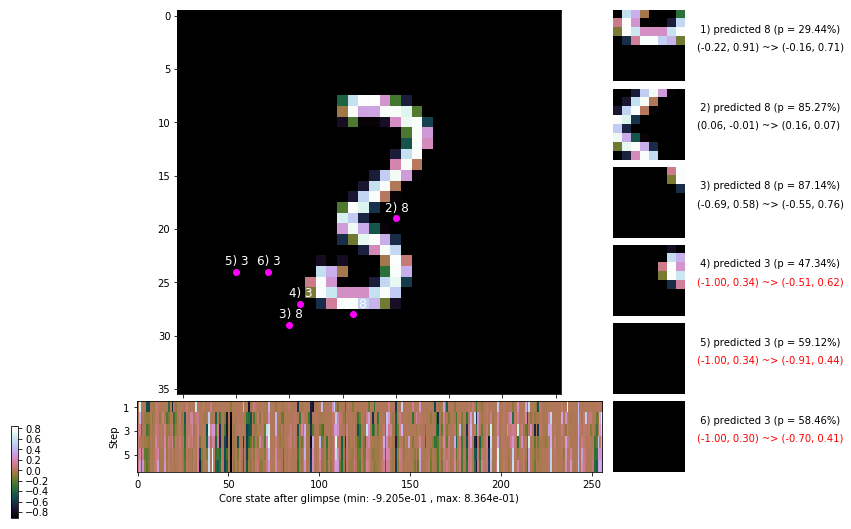

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 163.3 ms/b | lr: 4.55e-04 | grad 2norm:  7.52 | grad inf norm:  2.130
         Weights || abs max:  2.22 ( 3309.07) | mean: -6.44e-04 ( 0.02) | var: 7.71e-02 (  299.65)
          Biases || abs max:  1.36 (  124.55) | mean: -1.49e-01 ( 0.14) | var: 9.84e-02 (   73.65)
                    class loss: 0.320 | steps: 2.224 | reward:  4.493 | acc.: 89.45%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 160.7 ms/b | lr: 4.55e-04 | grad 2norm:  7.27 | grad inf norm:  2.108
         Weights || abs max:  2.22 (37056.63) | mean: -6.49e-04 ( 0.08) | var: 7.71e-02 (621751.94)
          Biases || abs max:  1.36 (  132.57) | mean: -1.49e-01 ( 0.14) | var: 9.84e-02 (  215.88)
                    class loss: 0.309 | steps: 2.210 | reward:  4.505 | acc.: 89.72%

	Target class: 4 | Discounted rewards: [0.111, 1.111, 1.

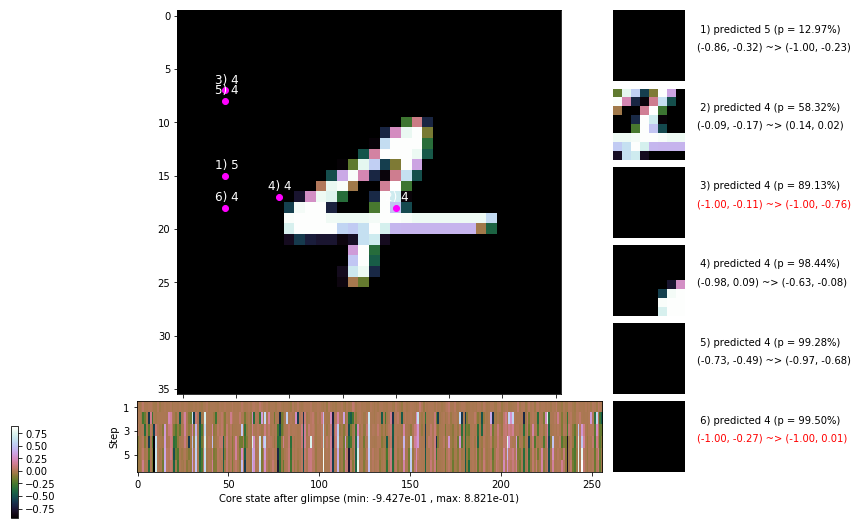

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 162.5 ms/b | lr: 4.54e-04 | grad 2norm:  7.21 | grad inf norm:  2.010
         Weights || abs max:  2.23 ( 2989.40) | mean: -6.47e-04 ( 0.02) | var: 7.72e-02 (  163.81)
          Biases || abs max:  1.36 (  835.16) | mean: -1.49e-01 ( 0.42) | var: 9.84e-02 (32438.67)
                    class loss: 0.305 | steps: 2.202 | reward:  4.531 | acc.: 89.92%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 160.7 ms/b | lr: 4.53e-04 | grad 2norm:  7.46 | grad inf norm:  2.090
         Weights || abs max:  2.23 ( 2887.39) | mean: -6.67e-04 ( 0.02) | var: 7.72e-02 (  257.67)
          Biases || abs max:  1.36 (  261.60) | mean: -1.49e-01 ( 0.20) | var: 9.86e-02 ( 1701.84)
                    class loss: 0.327 | steps: 2.245 | reward:  4.481 | acc.: 89.33%

	Target class: 1 | Discounted rewards: [0.011, 0.111, 1.1

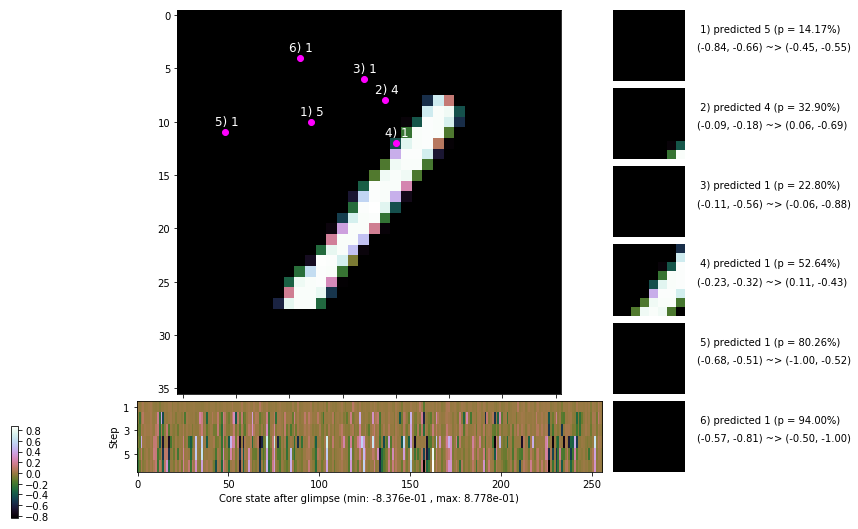

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 164.1 ms/b | lr: 4.52e-04 | grad 2norm:  7.62 | grad inf norm:  2.222
         Weights || abs max:  2.24 ( 4887.05) | mean: -6.79e-04 ( 0.02) | var: 7.72e-02 ( 3252.45)
          Biases || abs max:  1.36 (   99.49) | mean: -1.50e-01 ( 0.13) | var: 9.86e-02 (   68.03)
                    class loss: 0.316 | steps: 2.231 | reward:  4.496 | acc.: 89.45%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 159.3 ms/b | lr: 4.52e-04 | grad 2norm:  7.34 | grad inf norm:  2.039
         Weights || abs max:  2.23 ( 2900.41) | mean: -6.97e-04 ( 0.01) | var: 7.73e-02 (  246.66)
          Biases || abs max:  1.36 (  184.55) | mean: -1.50e-01 ( 0.17) | var: 9.86e-02 (   93.82)
                    class loss: 0.321 | steps: 2.208 | reward:  4.518 | acc.: 89.48%

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.1

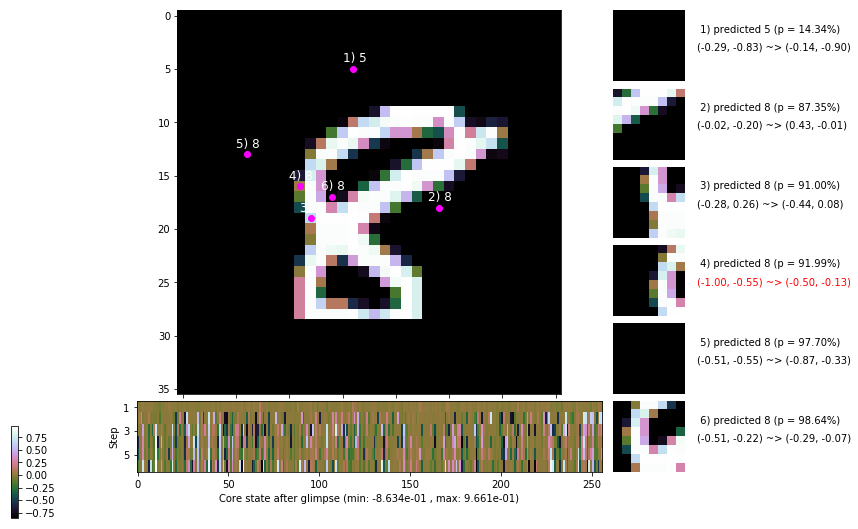

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


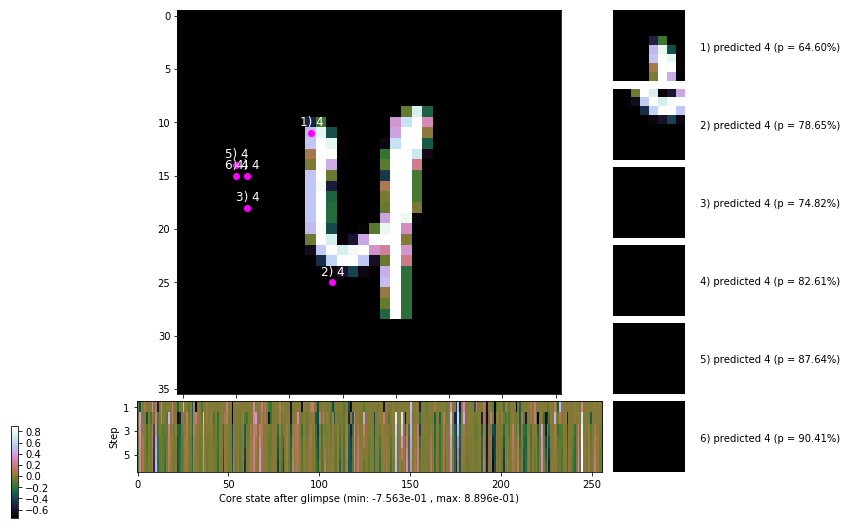


	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


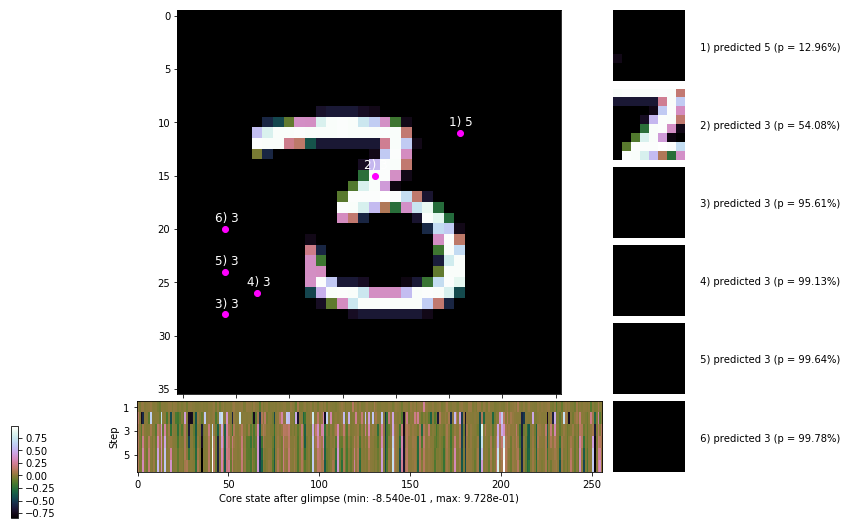

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


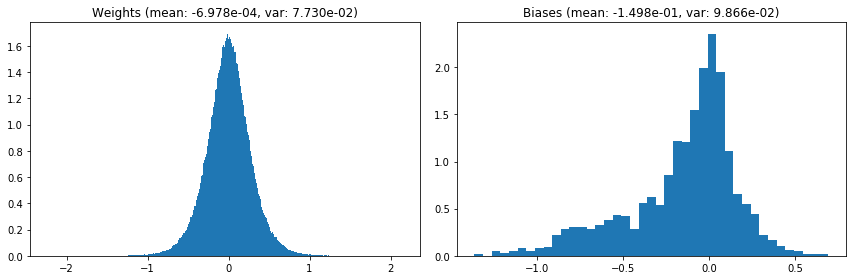

                                      Location network weights and biases


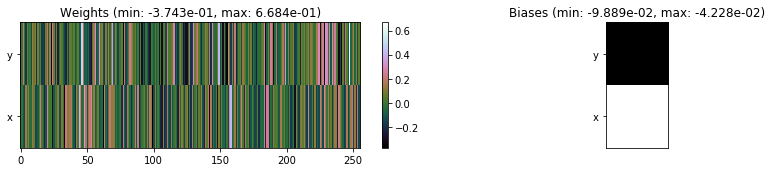

---------------------------------------------------------------------------------------------------------------
Elapsed time:  485.34 sec | TRAIN >> class loss: 0.3163 | steps:  2.217    | reward:  4.5098    | acc.: 89.652% :(
                          | VAL   >> class loss: 0.3441 | steps:  2.136    | reward:  4.5958    | acc.: 88.360% :(


Epoch  54/400) lr = 0.0004514
 b    300/  3000 >> 183.7 ms/b | lr: 4.51e-04 | grad 2norm:  7.27 | grad inf norm:  2.032
         Weights || abs max:  2.22 ( 8906.31) | mean: -6.92e-04 ( 0.03) | var: 7.73e-02 (13482.82)
          Biases || abs max:  1.36 (  147.34) | mean: -1.50e-01 ( 0.15) | var: 9.87e-02 (   85.14)
                    class loss: 0.317 | steps: 2.204 | reward:  4.517 | acc.: 89.67%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 165.4 ms/b | lr: 4.50e-04 | grad 2norm:  7.49 | grad inf norm:  2.086
         Weights || abs max:  2.23 ( 5110.89) | mean: -6.92e-04 (

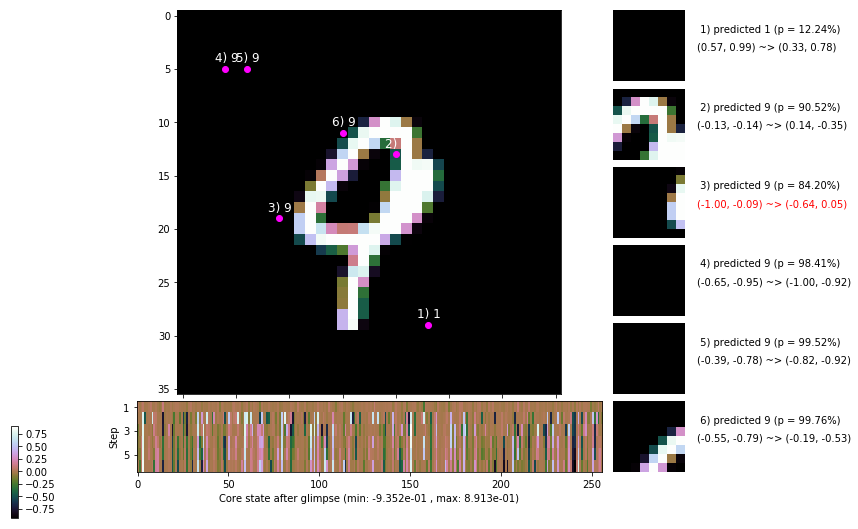

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 163.1 ms/b | lr: 4.50e-04 | grad 2norm:  7.51 | grad inf norm:  2.176
         Weights || abs max:  2.22 ( 9407.81) | mean: -7.09e-04 ( 0.03) | var: 7.74e-02 (16129.38)
          Biases || abs max:  1.37 (  202.37) | mean: -1.50e-01 ( 0.18) | var: 9.87e-02 (  180.10)
                    class loss: 0.336 | steps: 2.225 | reward:  4.479 | acc.: 88.63%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 161.2 ms/b | lr: 4.49e-04 | grad 2norm:  7.43 | grad inf norm:  2.125
         Weights || abs max:  2.21 ( 4018.64) | mean: -7.28e-04 ( 0.02) | var: 7.74e-02 (  740.55)
          Biases || abs max:  1.37 (  293.06) | mean: -1.51e-01 ( 0.21) | var: 9.89e-02 ( 2260.63)
                    class loss: 0.327 | steps: 2.221 | reward:  4.486 | acc.: 88.87%

	Target class: 4 | Discounted rewards: [1.111, 1.111, 1.1

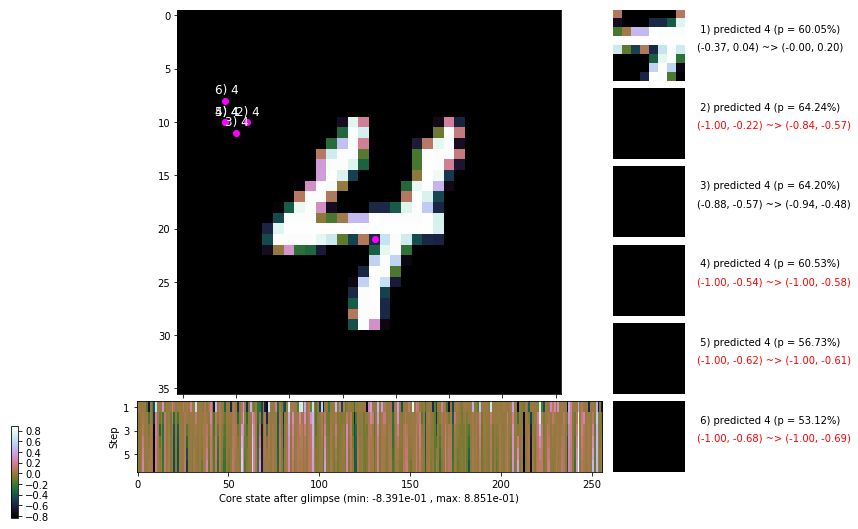

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 162.7 ms/b | lr: 4.48e-04 | grad 2norm:  7.35 | grad inf norm:  2.067
         Weights || abs max:  2.22 ( 3357.19) | mean: -7.34e-04 ( 0.02) | var: 7.75e-02 (  222.93)
          Biases || abs max:  1.36 (  223.71) | mean: -1.50e-01 ( 0.18) | var: 9.90e-02 (  673.13)
                    class loss: 0.331 | steps: 2.228 | reward:  4.491 | acc.: 89.33%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 162.0 ms/b | lr: 4.48e-04 | grad 2norm:  7.40 | grad inf norm:  2.125
         Weights || abs max:  2.23 (10532.21) | mean: -7.23e-04 ( 0.03) | var: 7.75e-02 (26037.18)
          Biases || abs max:  1.36 (  234.32) | mean: -1.50e-01 ( 0.19) | var: 9.91e-02 (  470.69)
                    class loss: 0.319 | steps: 2.220 | reward:  4.487 | acc.: 89.12%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.1

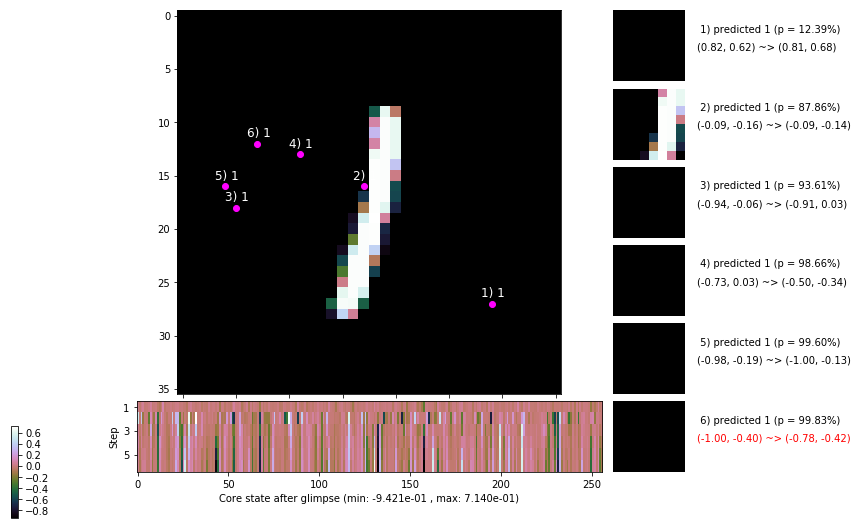

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 162.2 ms/b | lr: 4.47e-04 | grad 2norm:  7.33 | grad inf norm:  2.048
         Weights || abs max:  2.22 ( 3530.96) | mean: -7.45e-04 ( 0.02) | var: 7.76e-02 (  232.91)
          Biases || abs max:  1.36 (  150.18) | mean: -1.50e-01 ( 0.15) | var: 9.91e-02 (  105.59)
                    class loss: 0.318 | steps: 2.217 | reward:  4.511 | acc.: 89.42%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 160.6 ms/b | lr: 4.46e-04 | grad 2norm:  7.31 | grad inf norm:  2.095
         Weights || abs max:  2.23 ( 8781.33) | mean: -7.47e-04 ( 0.03) | var: 7.76e-02 (14306.37)
          Biases || abs max:  1.35 (  244.66) | mean: -1.50e-01 ( 0.19) | var: 9.91e-02 (  356.38)
                    class loss: 0.326 | steps: 2.209 | reward:  4.525 | acc.: 89.78%

	Target class: 9 | Discounted rewards: [1.111, 1.111, 1.1

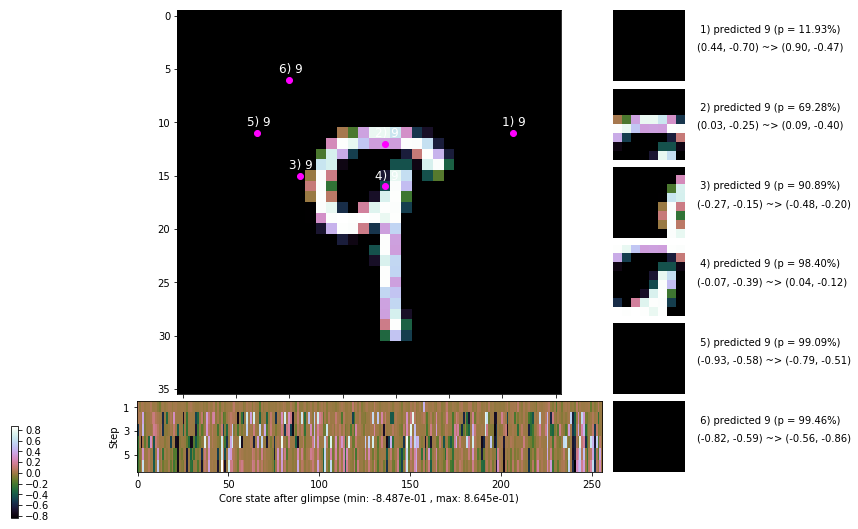

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 163.6 ms/b | lr: 4.46e-04 | grad 2norm:  7.27 | grad inf norm:  2.043
         Weights || abs max:  2.22 ( 2590.46) | mean: -7.30e-04 ( 0.01) | var: 7.77e-02 (  138.97)
          Biases || abs max:  1.35 (  209.36) | mean: -1.50e-01 ( 0.19) | var: 9.90e-02 (  474.22)
                    class loss: 0.320 | steps: 2.221 | reward:  4.487 | acc.: 89.10%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 160.0 ms/b | lr: 4.45e-04 | grad 2norm:  7.68 | grad inf norm:  2.223
         Weights || abs max:  2.23 (34111.30) | mean: -7.48e-04 ( 0.07) | var: 7.77e-02 (423739.47)
          Biases || abs max:  1.35 (  192.75) | mean: -1.50e-01 ( 0.18) | var: 9.90e-02 (  263.91)
                    class loss: 0.348 | steps: 2.261 | reward:  4.444 | acc.: 88.28%

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.

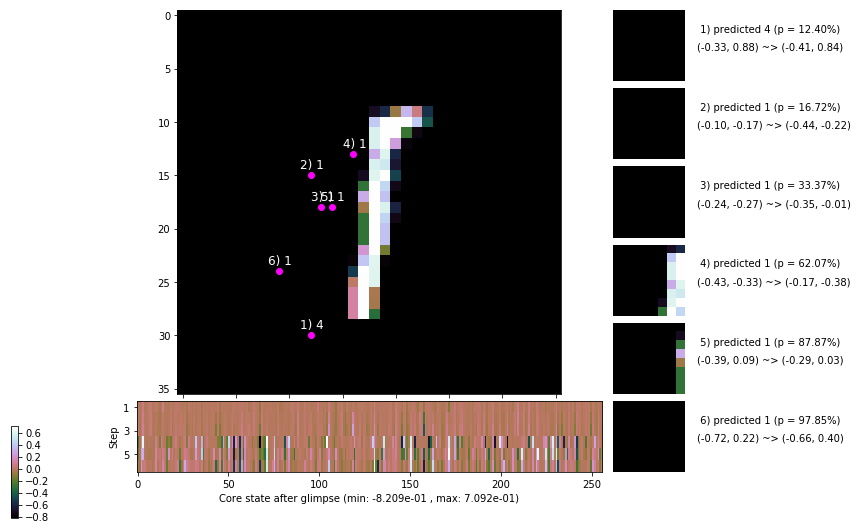

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


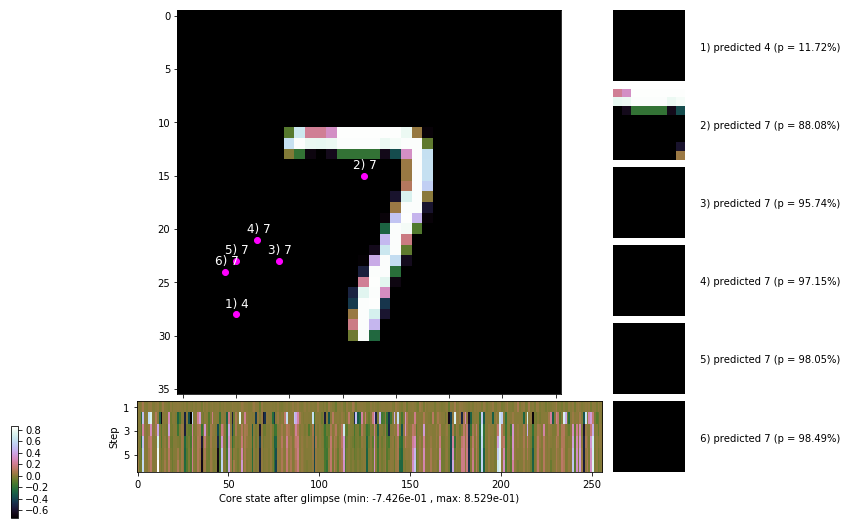


	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


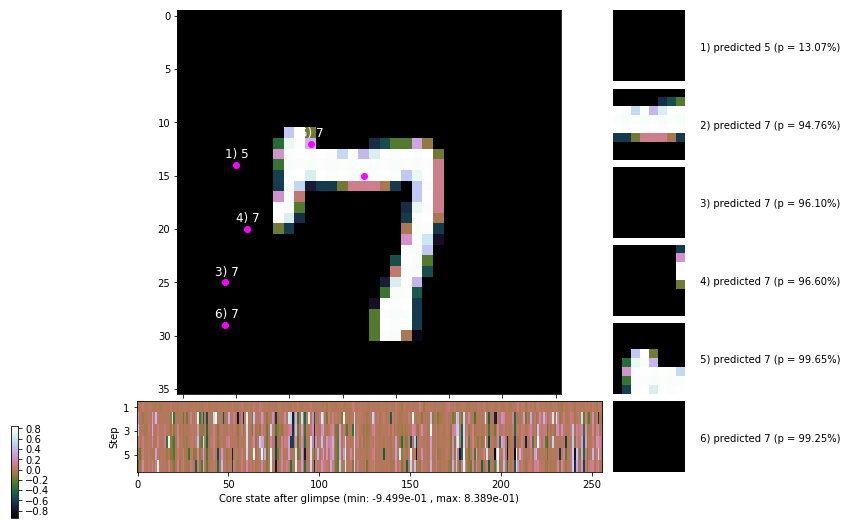

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


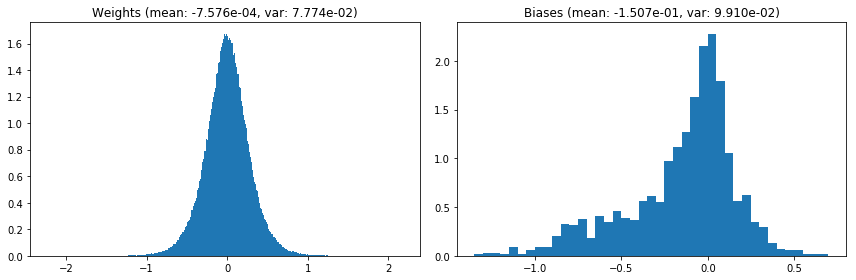

                                      Location network weights and biases


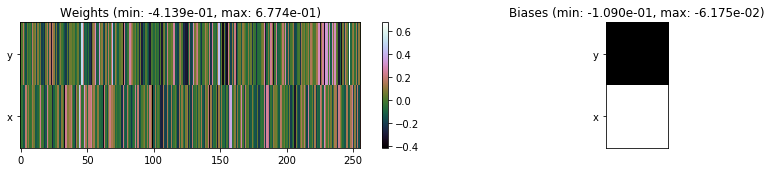

---------------------------------------------------------------------------------------------------------------
Elapsed time:  494.00 sec | TRAIN >> class loss: 0.3279 | steps:  2.226 :( | reward:  4.4904 :( | acc.: 89.142% :(
                          | VAL   >> class loss: 0.3707 | steps:  2.181 :( | reward:  4.5316 :( | acc.: 87.480% :(


Epoch  55/400) lr = 0.0004447
 b    300/  3000 >> 160.6 ms/b | lr: 4.44e-04 | grad 2norm:  7.40 | grad inf norm:  2.170
         Weights || abs max:  2.22 ( 4537.56) | mean: -7.55e-04 ( 0.02) | var: 7.78e-02 ( 3395.26)
          Biases || abs max:  1.35 (  193.31) | mean: -1.51e-01 ( 0.16) | var: 9.90e-02 ( 1479.81)
                    class loss: 0.338 | steps: 2.267 | reward:  4.439 | acc.: 88.82%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 158.8 ms/b | lr: 4.44e-04 | grad 2norm:  7.12 | grad inf norm:  2.054
         Weights || abs max:  2.23 ( 2909.27) | mean: -7.35e-04 (

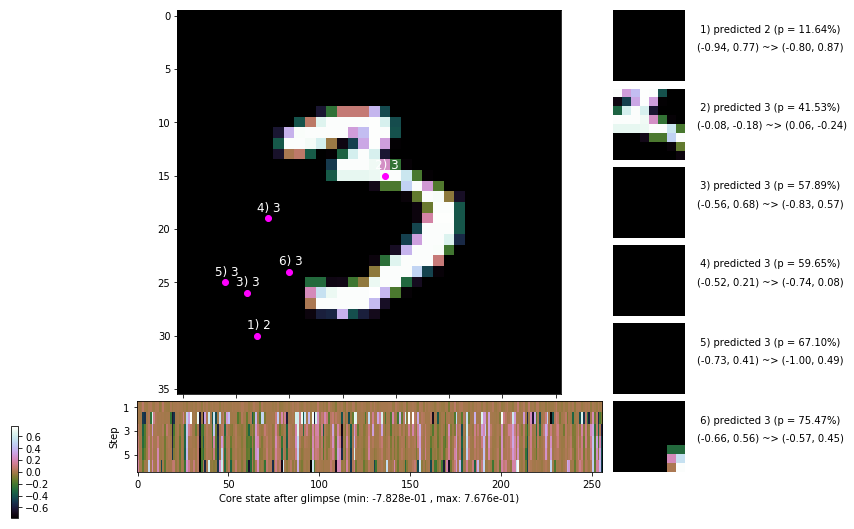

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 186.2 ms/b | lr: 4.43e-04 | grad 2norm:  7.41 | grad inf norm:  2.107
         Weights || abs max:  2.23 ( 2780.55) | mean: -7.35e-04 ( 0.02) | var: 7.78e-02 (  115.26)
          Biases || abs max:  1.35 (  212.80) | mean: -1.51e-01 ( 0.21) | var: 9.92e-02 ( 1141.35)
                    class loss: 0.337 | steps: 2.215 | reward:  4.479 | acc.: 88.40%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 164.1 ms/b | lr: 4.42e-04 | grad 2norm:  7.30 | grad inf norm:  2.087
         Weights || abs max:  2.23 (24569.05) | mean: -7.28e-04 ( 0.06) | var: 7.79e-02 (226413.23)
          Biases || abs max:  1.35 (   93.21) | mean: -1.51e-01 ( 0.13) | var: 9.93e-02 (   18.78)
                    class loss: 0.320 | steps: 2.212 | reward:  4.510 | acc.: 89.23%

	Target class: 4 | Discounted rewards: [0.111, 1.111, 1.

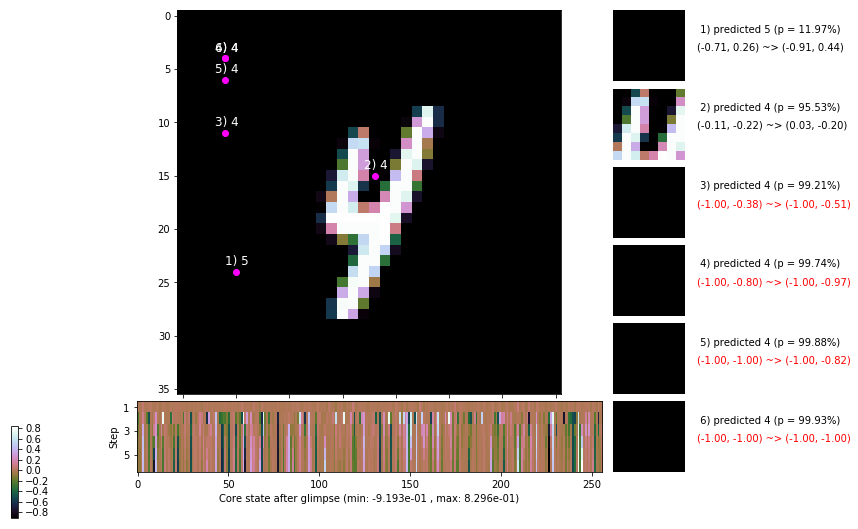

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 163.2 ms/b | lr: 4.42e-04 | grad 2norm:  7.43 | grad inf norm:  2.019
         Weights || abs max:  2.22 ( 4165.97) | mean: -7.37e-04 ( 0.02) | var: 7.79e-02 (  387.78)
          Biases || abs max:  1.35 (  403.80) | mean: -1.51e-01 ( 0.26) | var: 9.95e-02 ( 4236.74)
                    class loss: 0.331 | steps: 2.212 | reward:  4.498 | acc.: 89.10%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 160.3 ms/b | lr: 4.41e-04 | grad 2norm:  7.43 | grad inf norm:  2.149
         Weights || abs max:  2.22 ( 3187.13) | mean: -7.41e-04 ( 0.02) | var: 7.80e-02 (  195.05)
          Biases || abs max:  1.35 (  100.65) | mean: -1.51e-01 ( 0.13) | var: 9.96e-02 (   19.12)
                    class loss: 0.330 | steps: 2.208 | reward:  4.495 | acc.: 89.03%

	Target class: 3 | Discounted rewards: [0.100, 1.000, 0.0

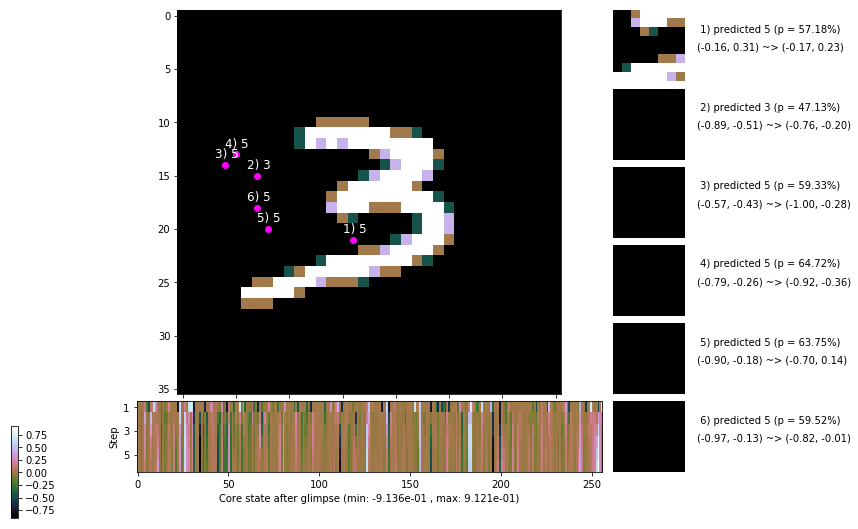

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 162.5 ms/b | lr: 4.40e-04 | grad 2norm:  7.59 | grad inf norm:  2.129
         Weights || abs max:  2.23 ( 3305.51) | mean: -7.37e-04 ( 0.02) | var: 7.80e-02 (  186.09)
          Biases || abs max:  1.36 (  199.49) | mean: -1.51e-01 ( 0.19) | var: 9.95e-02 (  108.17)
                    class loss: 0.348 | steps: 2.227 | reward:  4.473 | acc.: 88.20%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 160.9 ms/b | lr: 4.40e-04 | grad 2norm:  7.38 | grad inf norm:  2.089
         Weights || abs max:  2.23 ( 7972.94) | mean: -7.38e-04 ( 0.03) | var: 7.81e-02 ( 8295.47)
          Biases || abs max:  1.36 (  301.44) | mean: -1.51e-01 ( 0.24) | var: 9.95e-02 ( 1382.63)
                    class loss: 0.324 | steps: 2.220 | reward:  4.487 | acc.: 89.02%

	Target class: 2 | Discounted rewards: [1.111, 1.111, 1.1

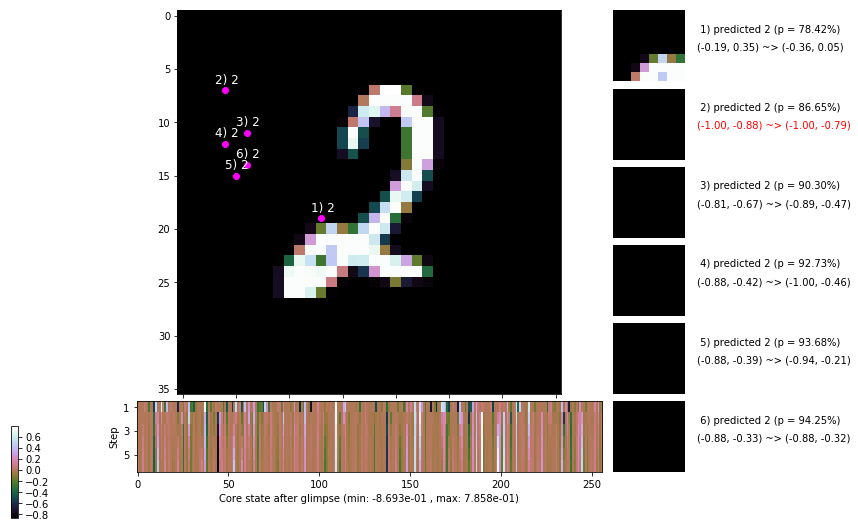

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 161.1 ms/b | lr: 4.39e-04 | grad 2norm:  7.64 | grad inf norm:  2.099
         Weights || abs max:  2.23 ( 3971.49) | mean: -7.16e-04 ( 0.02) | var: 7.81e-02 (  567.28)
          Biases || abs max:  1.36 (  155.79) | mean: -1.51e-01 ( 0.17) | var: 9.94e-02 (   67.74)
                    class loss: 0.339 | steps: 2.219 | reward:  4.491 | acc.: 88.75%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 161.7 ms/b | lr: 4.38e-04 | grad 2norm:  7.36 | grad inf norm:  2.167
         Weights || abs max:  2.23 (37110.01) | mean: -7.07e-04 ( 0.08) | var: 7.82e-02 (643951.31)
          Biases || abs max:  1.36 (  310.18) | mean: -1.51e-01 ( 0.28) | var: 9.94e-02 ( 4128.09)
                    class loss: 0.336 | steps: 2.231 | reward:  4.477 | acc.: 88.95%

	Target class: 2 | Discounted rewards: [0.011, 0.111, 1.

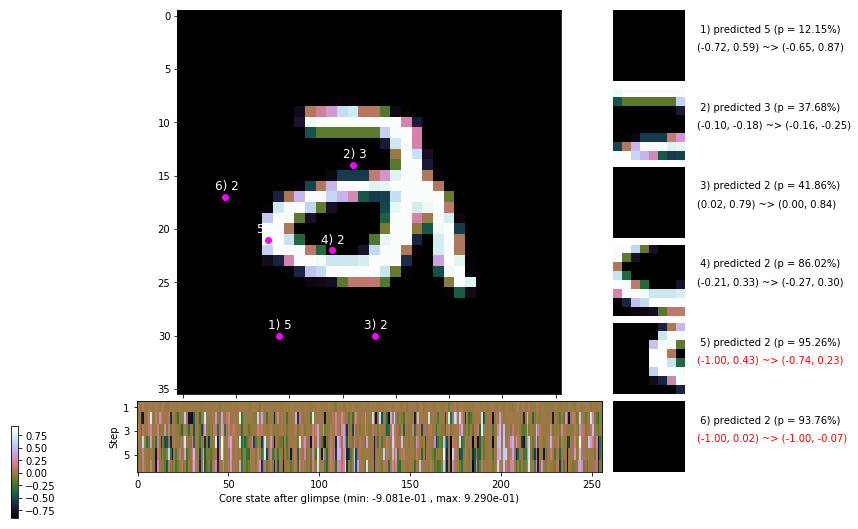

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


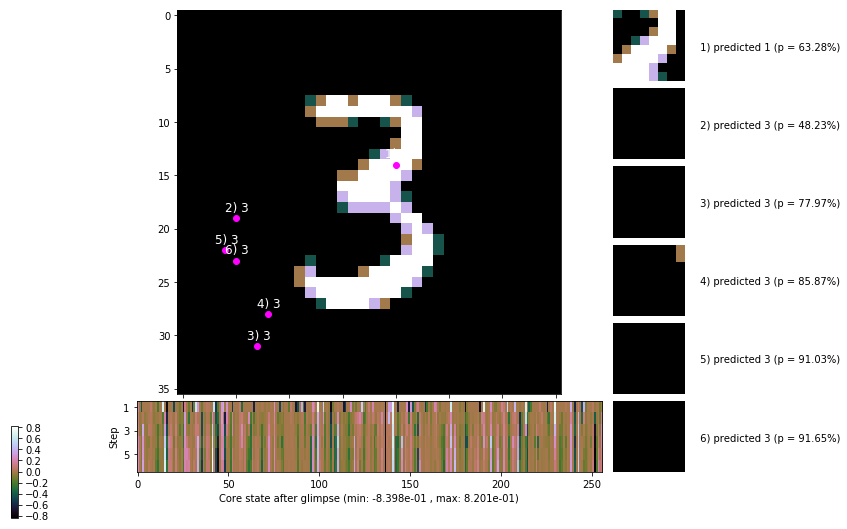


	Target class: 2 | Discounted rewards: [1.111, 1.111, 1.110, 1.100, 1.000, 0.000]


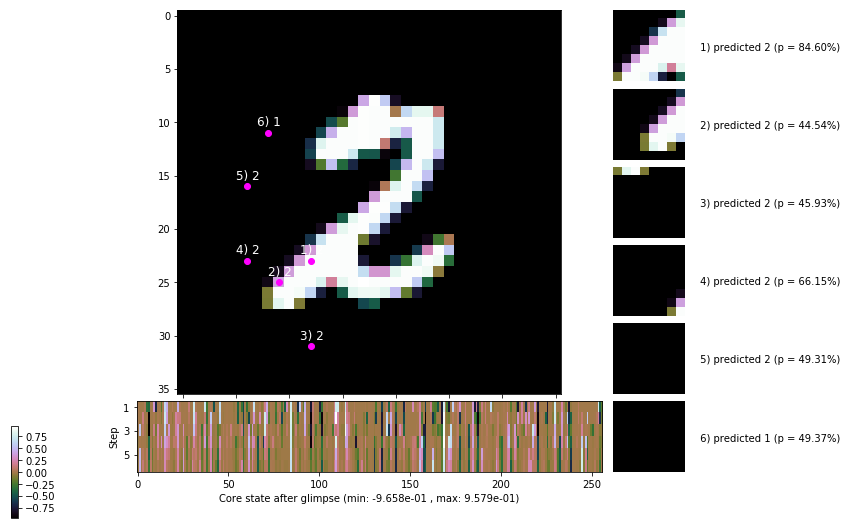

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


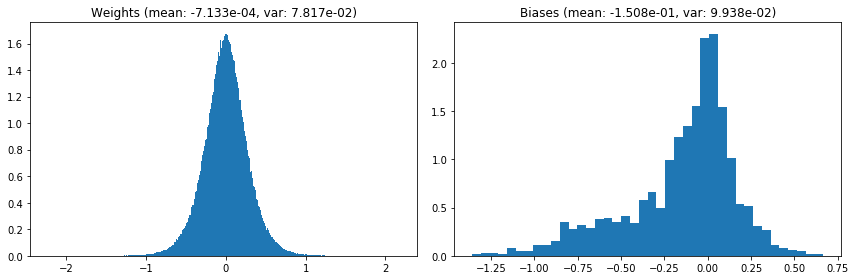

                                      Location network weights and biases


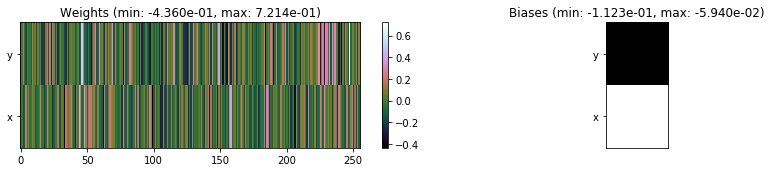

---------------------------------------------------------------------------------------------------------------
Elapsed time:  492.68 sec | TRAIN >> class loss: 0.3324 | steps:  2.222 :( | reward:  4.4857 :( | acc.: 88.900% :(
                          | VAL   >> class loss: 0.3650 | steps:  2.152 :( | reward:  4.5770 :( | acc.: 88.080% :(


Epoch  56/400) lr = 0.0004381
 b    300/  3000 >> 159.4 ms/b | lr: 4.38e-04 | grad 2norm:  7.57 | grad inf norm:  2.151
         Weights || abs max:  2.23 ( 3141.19) | mean: -7.17e-04 ( 0.02) | var: 7.82e-02 (  301.44)
          Biases || abs max:  1.36 (  279.03) | mean: -1.51e-01 ( 0.23) | var: 9.94e-02 ( 1720.73)
                    class loss: 0.334 | steps: 2.217 | reward:  4.490 | acc.: 88.98%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 161.3 ms/b | lr: 4.37e-04 | grad 2norm:  7.49 | grad inf norm:  2.105
         Weights || abs max:  2.22 ( 4724.07) | mean: -7.01e-04 (

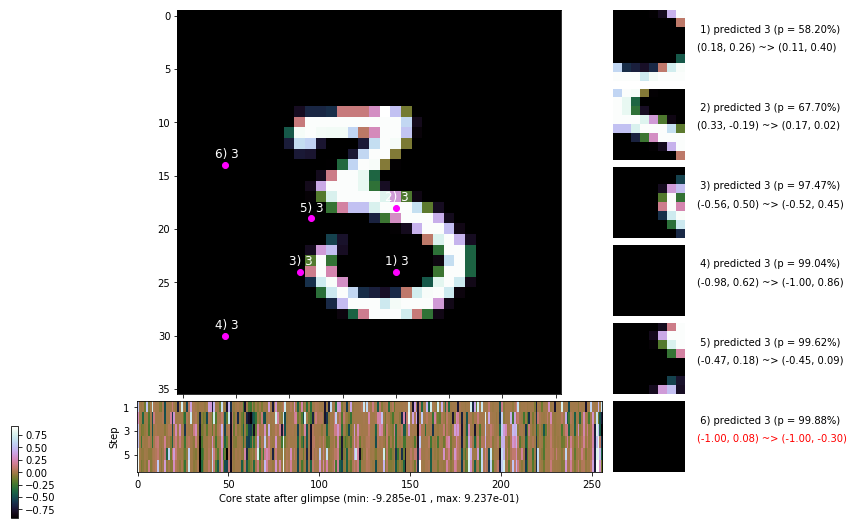

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 162.9 ms/b | lr: 4.36e-04 | grad 2norm:  6.97 | grad inf norm:  2.043
         Weights || abs max:  2.22 (11272.05) | mean: -7.06e-04 ( 0.03) | var: 7.83e-02 (12798.91)
          Biases || abs max:  1.37 (  264.43) | mean: -1.51e-01 ( 0.21) | var: 9.98e-02 (  921.25)
                    class loss: 0.313 | steps: 2.184 | reward:  4.532 | acc.: 89.63%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 160.3 ms/b | lr: 4.36e-04 | grad 2norm:  7.39 | grad inf norm:  2.113
         Weights || abs max:  2.22 ( 2709.21) | mean: -6.92e-04 ( 0.01) | var: 7.83e-02 (  188.12)
          Biases || abs max:  1.37 (   99.65) | mean: -1.51e-01 ( 0.11) | var: 9.99e-02 (   44.12)
                    class loss: 0.330 | steps: 2.214 | reward:  4.489 | acc.: 88.92%

	Target class: 8 | Discounted rewards: [0.000, 0.000, 0.0

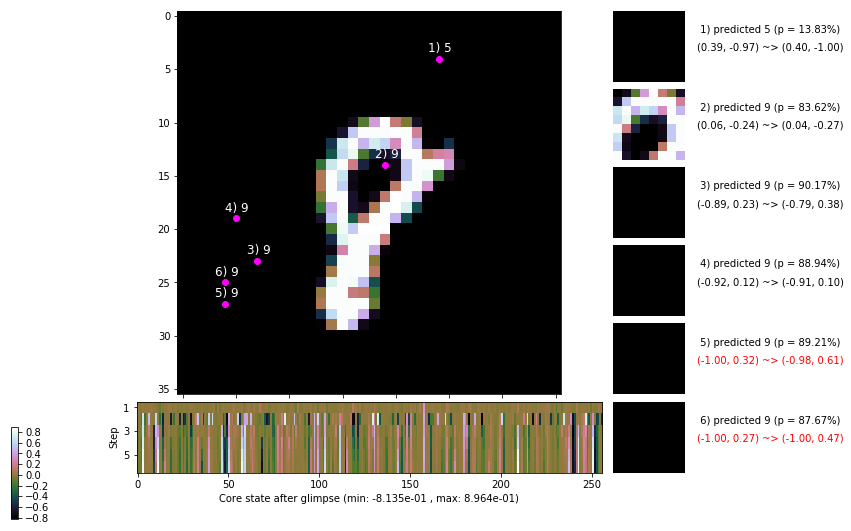

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 188.6 ms/b | lr: 4.35e-04 | grad 2norm:  7.13 | grad inf norm:  2.040
         Weights || abs max:  2.22 ( 2851.55) | mean: -6.94e-04 ( 0.02) | var: 7.83e-02 (  195.36)
          Biases || abs max:  1.37 (   79.45) | mean: -1.51e-01 ( 0.10) | var: 9.97e-02 (   62.84)
                    class loss: 0.321 | steps: 2.244 | reward:  4.507 | acc.: 89.77%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 166.3 ms/b | lr: 4.35e-04 | grad 2norm:  7.57 | grad inf norm:  2.166
         Weights || abs max:  2.23 ( 6798.87) | mean: -6.78e-04 ( 0.02) | var: 7.84e-02 ( 4489.28)
          Biases || abs max:  1.37 (  130.16) | mean: -1.51e-01 ( 0.14) | var: 9.96e-02 (  173.49)
                    class loss: 0.322 | steps: 2.242 | reward:  4.461 | acc.: 88.95%

	Target class: 4 | Discounted rewards: [1.111, 1.111, 1.1

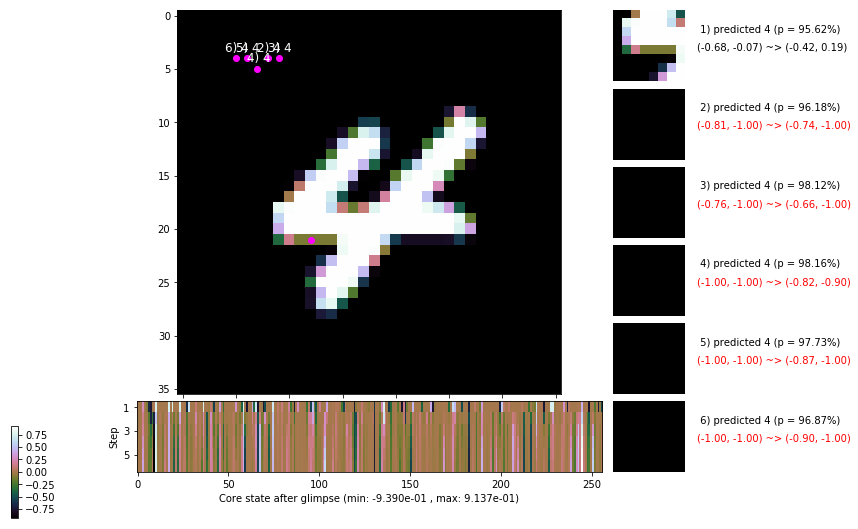

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 164.3 ms/b | lr: 4.34e-04 | grad 2norm:  7.59 | grad inf norm:  2.150
         Weights || abs max:  2.23 ( 8937.46) | mean: -6.87e-04 ( 0.03) | var: 7.84e-02 (20669.59)
          Biases || abs max:  1.37 (  193.47) | mean: -1.51e-01 ( 0.16) | var: 9.96e-02 (  502.72)
                    class loss: 0.311 | steps: 2.197 | reward:  4.527 | acc.: 89.78%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 160.4 ms/b | lr: 4.33e-04 | grad 2norm:  7.31 | grad inf norm:  2.104
         Weights || abs max:  2.23 ( 3613.65) | mean: -6.91e-04 ( 0.02) | var: 7.85e-02 (  440.36)
          Biases || abs max:  1.37 (  119.99) | mean: -1.52e-01 ( 0.12) | var: 9.96e-02 (   48.35)
                    class loss: 0.326 | steps: 2.206 | reward:  4.516 | acc.: 89.80%

	Target class: 6 | Discounted rewards: [0.111, 1.111, 1.1

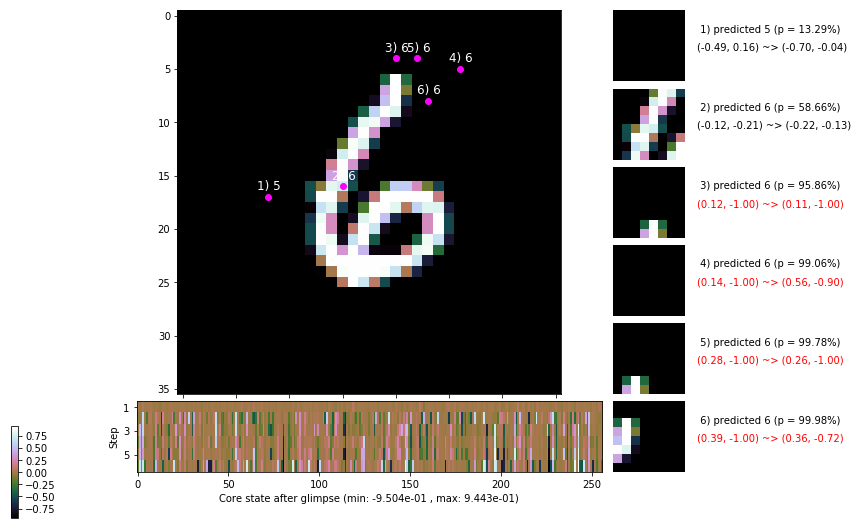

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 162.8 ms/b | lr: 4.32e-04 | grad 2norm:  7.17 | grad inf norm:  2.068
         Weights || abs max:  2.24 ( 3385.92) | mean: -6.97e-04 ( 0.02) | var: 7.85e-02 (  240.18)
          Biases || abs max:  1.37 (  112.52) | mean: -1.51e-01 ( 0.12) | var: 9.94e-02 (   96.61)
                    class loss: 0.319 | steps: 2.222 | reward:  4.501 | acc.: 89.47%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 165.4 ms/b | lr: 4.32e-04 | grad 2norm:  7.54 | grad inf norm:  2.143
         Weights || abs max:  2.23 ( 3112.26) | mean: -6.96e-04 ( 0.02) | var: 7.85e-02 (  297.18)
          Biases || abs max:  1.37 (  101.87) | mean: -1.52e-01 ( 0.12) | var: 9.96e-02 (   95.44)
                    class loss: 0.365 | steps: 2.283 | reward:  4.423 | acc.: 87.88%

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.1

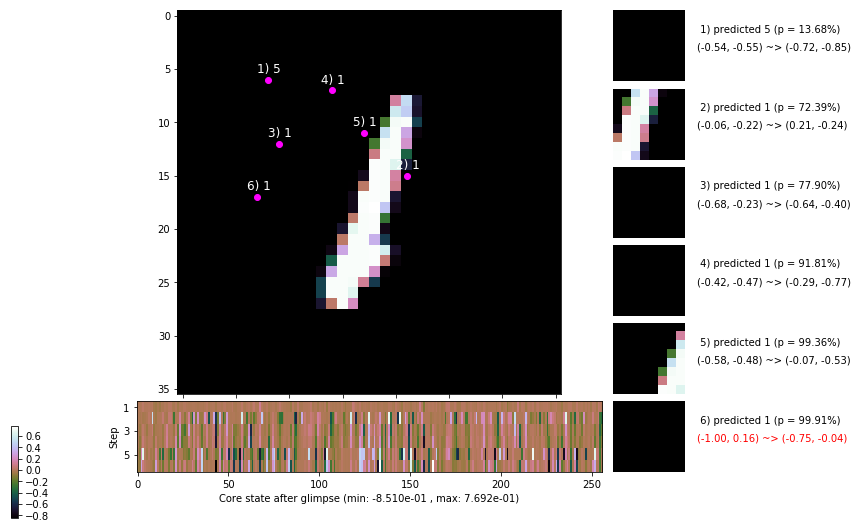

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


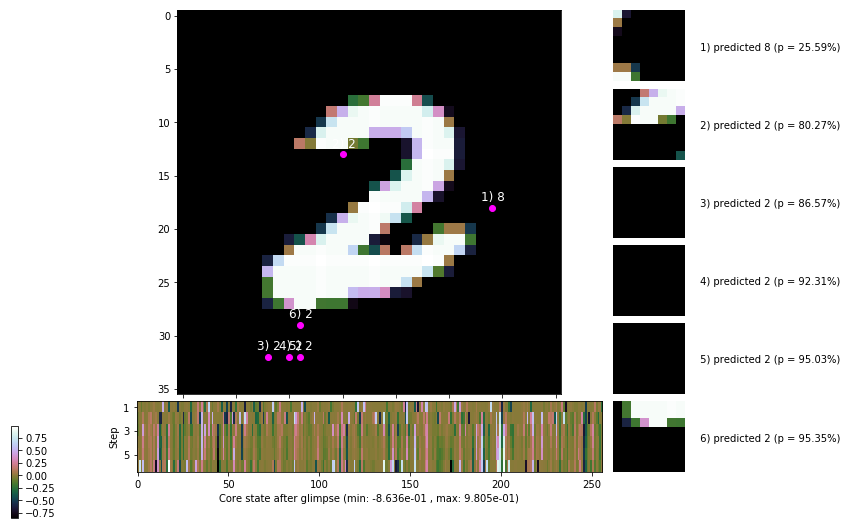


	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


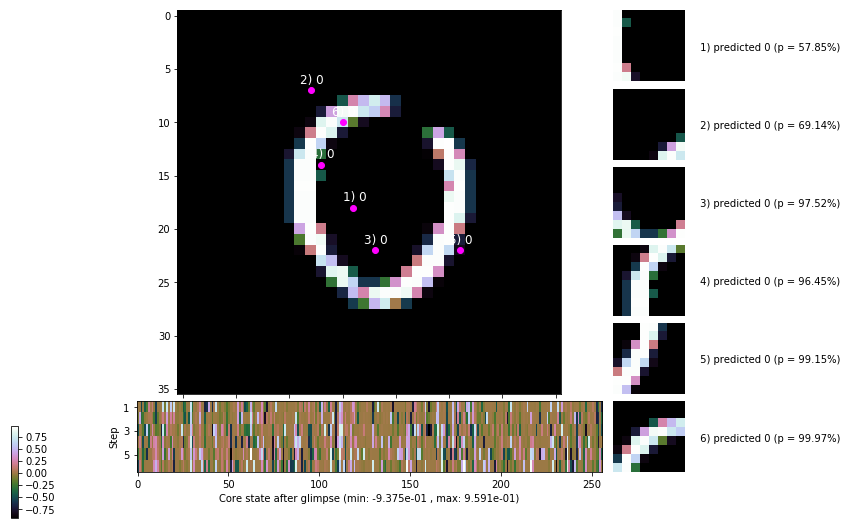

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


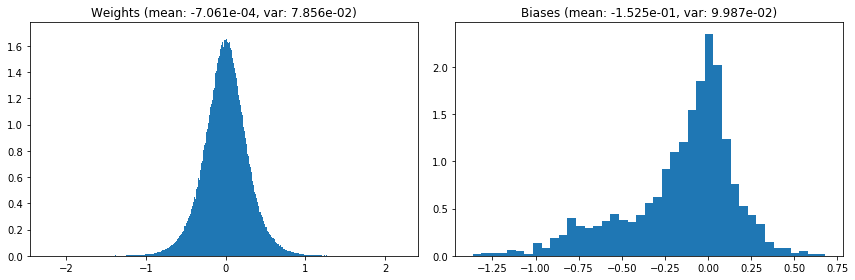

                                      Location network weights and biases


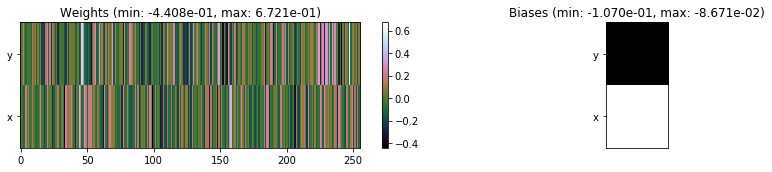

---------------------------------------------------------------------------------------------------------------
Elapsed time:  496.44 sec | TRAIN >> class loss: 0.3284 | steps:  2.225 :( | reward:  4.4912 :( | acc.: 89.190% :(
                          | VAL   >> class loss: 0.3790 | steps:  2.152 :( | reward:  4.5544 :( | acc.: 87.580% :(


Epoch  57/400) lr = 0.0004315
 b    300/  3000 >> 164.0 ms/b | lr: 4.31e-04 | grad 2norm:  7.14 | grad inf norm:  2.047
         Weights || abs max:  2.23 ( 4239.80) | mean: -6.98e-04 ( 0.02) | var: 7.86e-02 (  601.72)
          Biases || abs max:  1.36 (   61.32) | mean: -1.52e-01 ( 0.11) | var: 9.97e-02 (   13.89)
                    class loss: 0.331 | steps: 2.236 | reward:  4.489 | acc.: 89.47%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.5 ms/b | lr: 4.31e-04 | grad 2norm:  7.25 | grad inf norm:  2.060
         Weights || abs max:  2.24 ( 2410.42) | mean: -7.03e-04 (

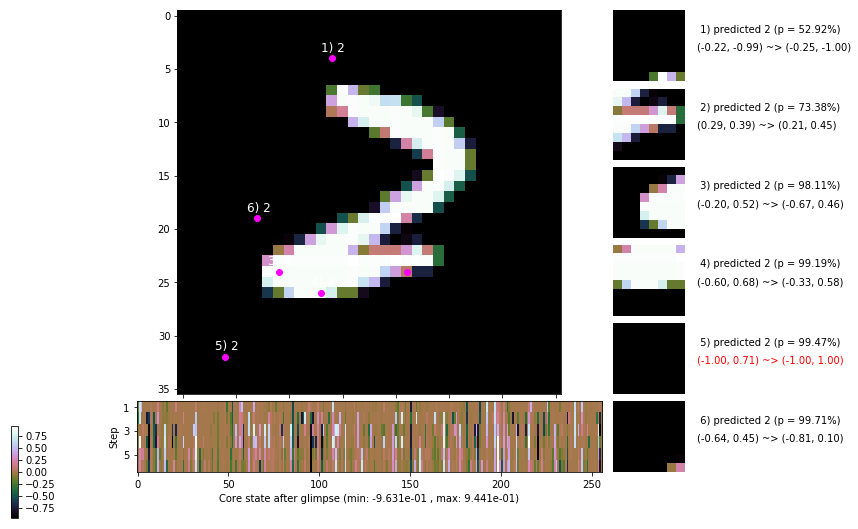

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 157.5 ms/b | lr: 4.30e-04 | grad 2norm:  7.42 | grad inf norm:  2.090
         Weights || abs max:  2.24 ( 5903.62) | mean: -7.07e-04 ( 0.02) | var: 7.87e-02 ( 3079.32)
          Biases || abs max:  1.35 (   98.47) | mean: -1.52e-01 ( 0.13) | var: 9.98e-02 (   58.36)
                    class loss: 0.334 | steps: 2.235 | reward:  4.480 | acc.: 88.95%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 157.7 ms/b | lr: 4.29e-04 | grad 2norm:  7.29 | grad inf norm:  2.146
         Weights || abs max:  2.23 ( 3509.04) | mean: -6.84e-04 ( 0.02) | var: 7.87e-02 (  246.18)
          Biases || abs max:  1.36 (  317.82) | mean: -1.52e-01 ( 0.23) | var: 9.97e-02 ( 1327.84)
                    class loss: 0.335 | steps: 2.211 | reward:  4.508 | acc.: 89.22%

	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.1

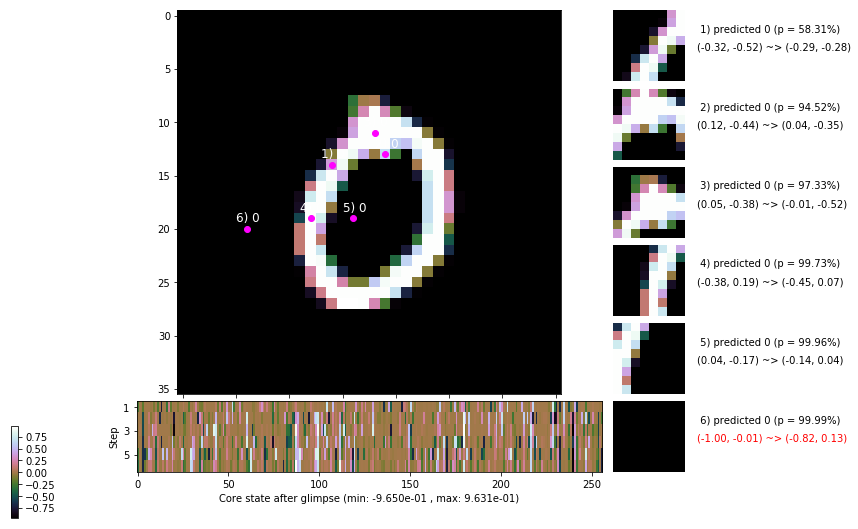

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 157.8 ms/b | lr: 4.29e-04 | grad 2norm:  7.20 | grad inf norm:  2.152
         Weights || abs max:  2.23 ( 2229.18) | mean: -6.87e-04 ( 0.01) | var: 7.88e-02 (   65.83)
          Biases || abs max:  1.36 (  162.82) | mean: -1.52e-01 ( 0.17) | var: 9.97e-02 (  142.34)
                    class loss: 0.333 | steps: 2.226 | reward:  4.499 | acc.: 89.12%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.1 ms/b | lr: 4.28e-04 | grad 2norm:  7.35 | grad inf norm:  2.070
         Weights || abs max:  2.22 ( 2819.09) | mean: -6.87e-04 ( 0.02) | var: 7.88e-02 (  143.97)
          Biases || abs max:  1.35 (  220.69) | mean: -1.52e-01 ( 0.22) | var: 9.97e-02 ( 1267.55)
                    class loss: 0.348 | steps: 2.220 | reward:  4.476 | acc.: 88.40%

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.1

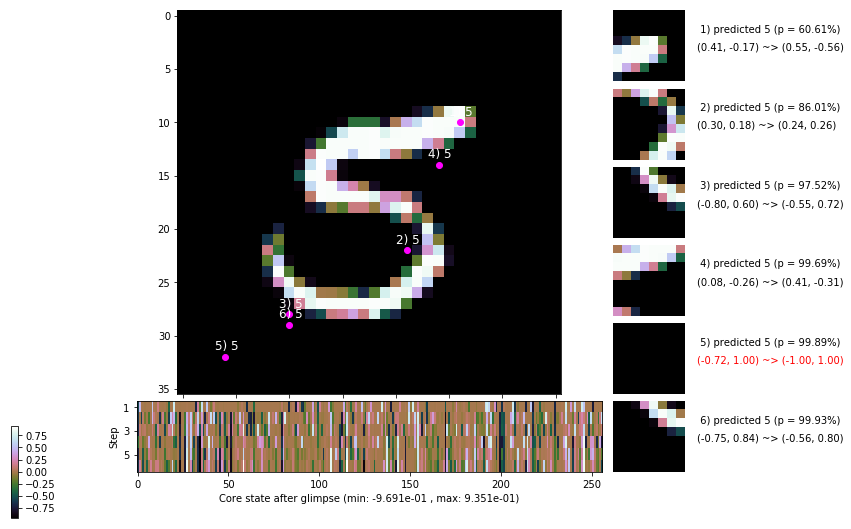

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 159.7 ms/b | lr: 4.27e-04 | grad 2norm:  7.53 | grad inf norm:  2.049
         Weights || abs max:  2.23 (11270.62) | mean: -7.09e-04 ( 0.03) | var: 7.88e-02 (43063.09)
          Biases || abs max:  1.36 (  476.08) | mean: -1.52e-01 ( 0.29) | var: 9.98e-02 ( 4182.42)
                    class loss: 0.342 | steps: 2.232 | reward:  4.473 | acc.: 88.53%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 155.6 ms/b | lr: 4.27e-04 | grad 2norm:  7.44 | grad inf norm:  2.100
         Weights || abs max:  2.23 ( 3998.77) | mean: -7.01e-04 ( 0.02) | var: 7.89e-02 (  761.56)
          Biases || abs max:  1.36 (  234.11) | mean: -1.52e-01 ( 0.20) | var: 9.98e-02 (  755.56)
                    class loss: 0.356 | steps: 2.225 | reward:  4.455 | acc.: 88.02%

	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.0

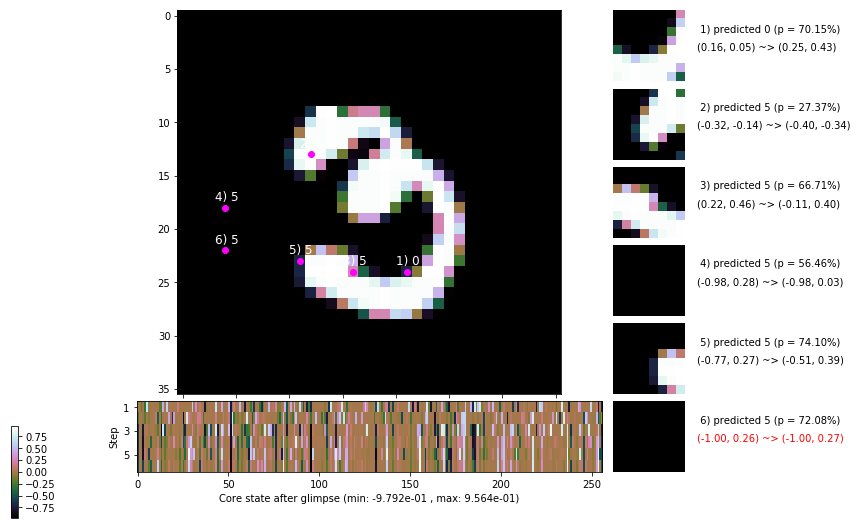

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 157.5 ms/b | lr: 4.26e-04 | grad 2norm:  7.42 | grad inf norm:  2.058
         Weights || abs max:  2.23 ( 2970.82) | mean: -7.18e-04 ( 0.02) | var: 7.89e-02 (  164.59)
          Biases || abs max:  1.35 (  179.16) | mean: -1.52e-01 ( 0.18) | var: 9.97e-02 (  288.61)
                    class loss: 0.345 | steps: 2.254 | reward:  4.455 | acc.: 88.47%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 154.7 ms/b | lr: 4.26e-04 | grad 2norm:  7.58 | grad inf norm:  2.112
         Weights || abs max:  2.23 ( 2725.18) | mean: -7.29e-04 ( 0.02) | var: 7.89e-02 (   90.66)
          Biases || abs max:  1.34 (  227.49) | mean: -1.52e-01 ( 0.19) | var: 9.98e-02 (  441.54)
                    class loss: 0.361 | steps: 2.258 | reward:  4.427 | acc.: 87.98%

	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.1

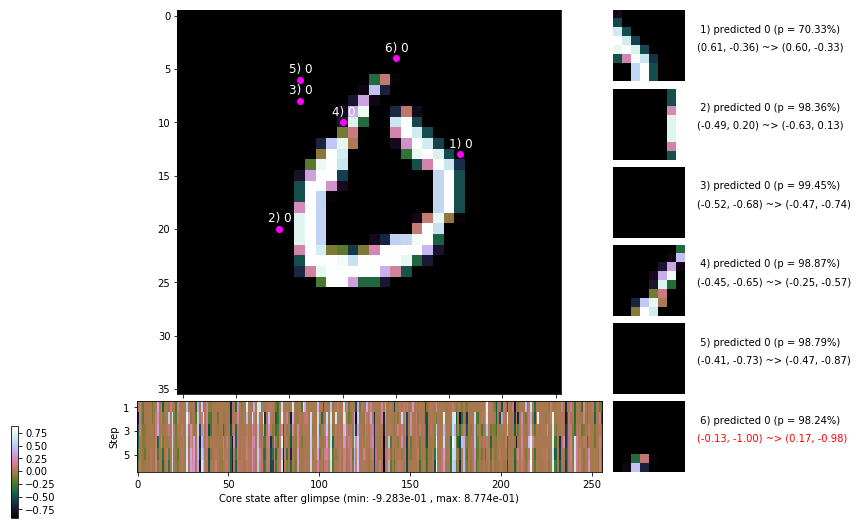

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


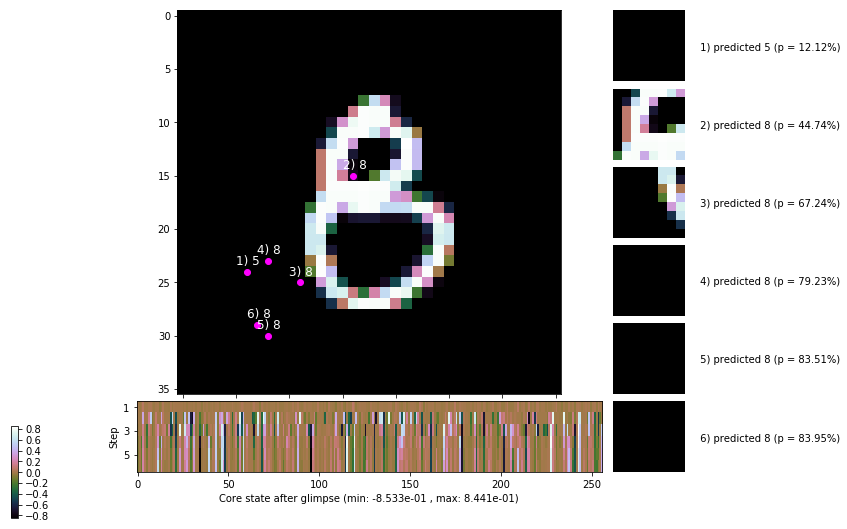


	Target class: 0 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


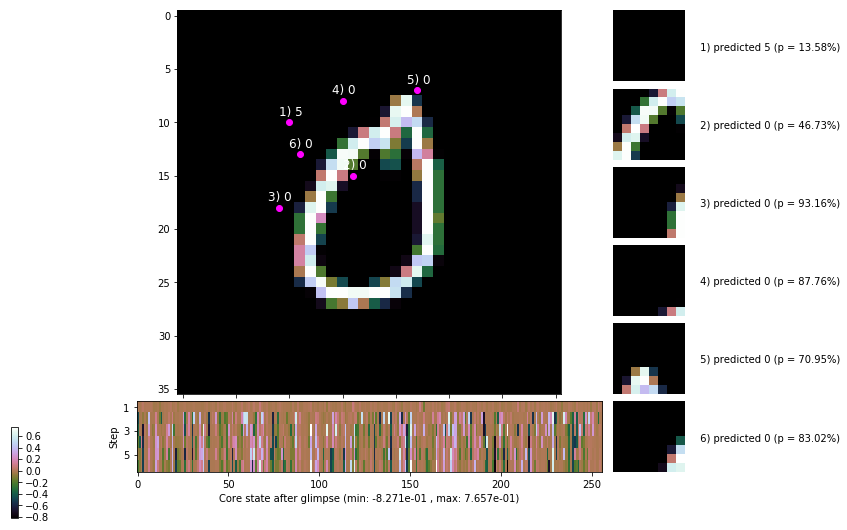

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


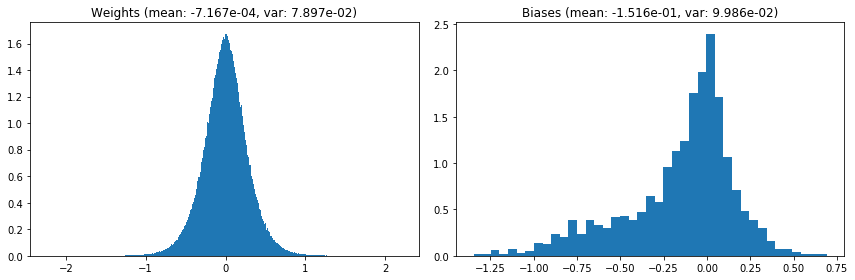

                                      Location network weights and biases


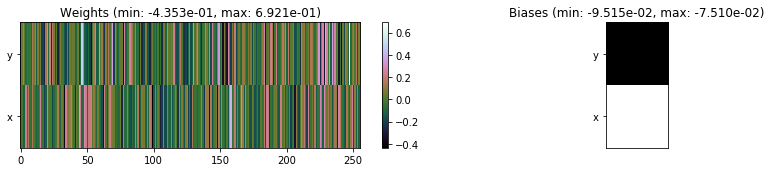

---------------------------------------------------------------------------------------------------------------
Elapsed time:  471.64 sec | TRAIN >> class loss: 0.3419 | steps:  2.232 :( | reward:  4.4752 :( | acc.: 88.703% :(
                          | VAL   >> class loss: 0.3715 | steps:  2.162 :( | reward:  4.5398 :( | acc.: 87.380% :(


Epoch  58/400) lr = 0.0004251
 b    300/  3000 >> 153.7 ms/b | lr: 4.25e-04 | grad 2norm:  7.62 | grad inf norm:  2.116
         Weights || abs max:  2.22 ( 3703.55) | mean: -7.15e-04 ( 0.02) | var: 7.90e-02 (  202.61)
          Biases || abs max:  1.35 (  230.92) | mean: -1.52e-01 ( 0.20) | var: 9.99e-02 (  386.12)
                    class loss: 0.362 | steps: 2.247 | reward:  4.451 | acc.: 88.62%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 157.8 ms/b | lr: 4.24e-04 | grad 2norm:  7.32 | grad inf norm:  2.092
         Weights || abs max:  2.22 ( 3249.67) | mean: -7.28e-04 (

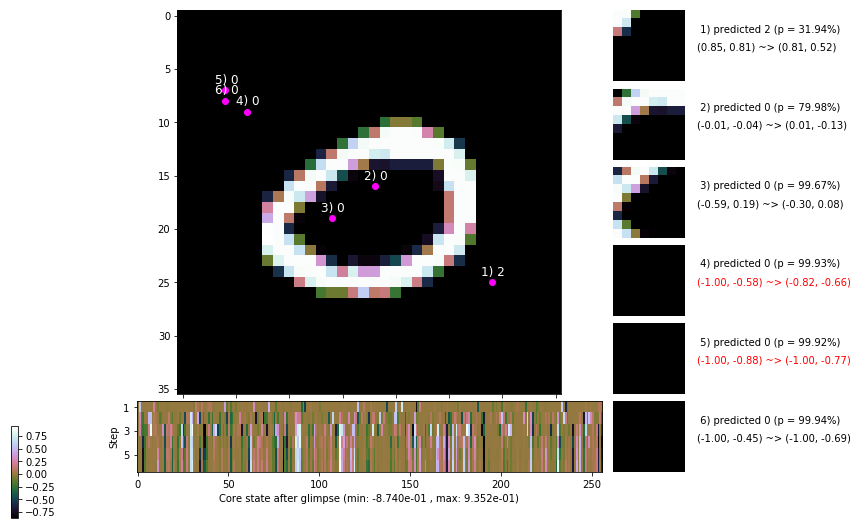

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 158.7 ms/b | lr: 4.23e-04 | grad 2norm:  7.58 | grad inf norm:  2.130
         Weights || abs max:  2.22 ( 2881.12) | mean: -7.16e-04 ( 0.02) | var: 7.91e-02 (   80.10)
          Biases || abs max:  1.34 (  185.78) | mean: -1.52e-01 ( 0.17) | var: 9.95e-02 (  278.97)
                    class loss: 0.339 | steps: 2.208 | reward:  4.511 | acc.: 89.35%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 156.3 ms/b | lr: 4.23e-04 | grad 2norm:  7.44 | grad inf norm:  2.159
         Weights || abs max:  2.23 ( 3337.14) | mean: -7.03e-04 ( 0.02) | var: 7.91e-02 (  241.63)
          Biases || abs max:  1.34 (  465.52) | mean: -1.52e-01 ( 0.28) | var: 9.98e-02 ( 7834.51)
                    class loss: 0.321 | steps: 2.237 | reward:  4.479 | acc.: 89.47%

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.1

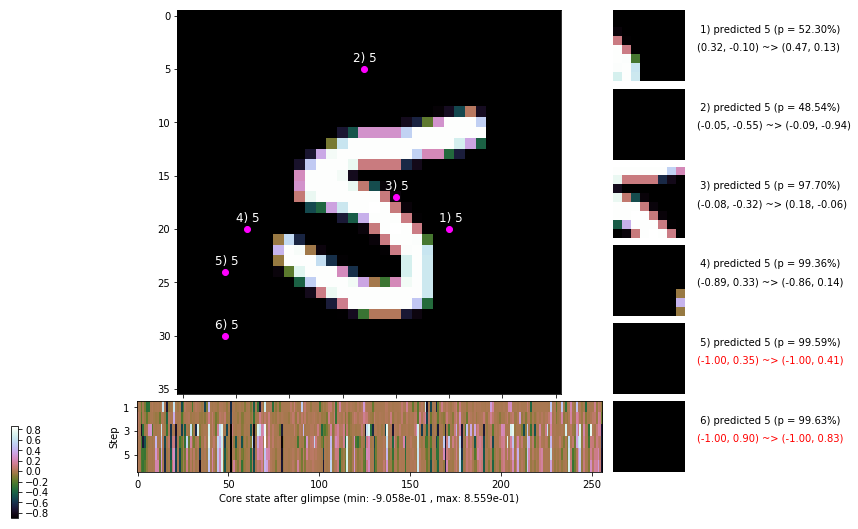

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 159.7 ms/b | lr: 4.22e-04 | grad 2norm:  7.52 | grad inf norm:  2.049
         Weights || abs max:  2.24 (18343.09) | mean: -7.01e-04 ( 0.05) | var: 7.91e-02 (60996.95)
          Biases || abs max:  1.34 (  163.35) | mean: -1.52e-01 ( 0.16) | var: 9.99e-02 (  135.57)
                    class loss: 0.336 | steps: 2.254 | reward:  4.444 | acc.: 88.30%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 154.2 ms/b | lr: 4.22e-04 | grad 2norm:  7.27 | grad inf norm:  2.056
         Weights || abs max:  2.24 (15403.98) | mean: -7.03e-04 ( 0.04) | var: 7.91e-02 (37026.01)
          Biases || abs max:  1.34 (  603.32) | mean: -1.52e-01 ( 0.47) | var: 1.00e-01 (23477.47)
                    class loss: 0.318 | steps: 2.205 | reward:  4.513 | acc.: 89.13%

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.1

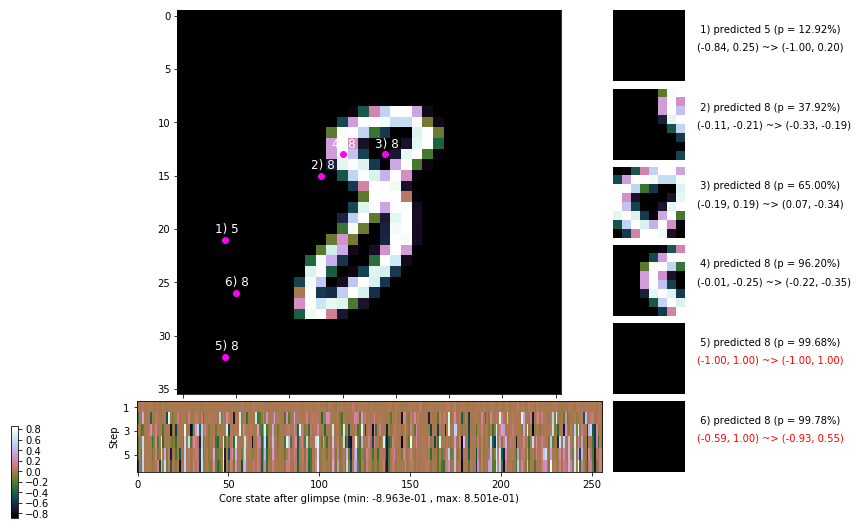

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 161.7 ms/b | lr: 4.21e-04 | grad 2norm:  7.24 | grad inf norm:  1.996
         Weights || abs max:  2.24 ( 2529.84) | mean: -6.99e-04 ( 0.02) | var: 7.92e-02 (   59.36)
          Biases || abs max:  1.34 (  157.53) | mean: -1.52e-01 ( 0.18) | var: 1.00e-01 (  449.00)
                    class loss: 0.308 | steps: 2.175 | reward:  4.545 | acc.: 89.72%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.5 ms/b | lr: 4.20e-04 | grad 2norm:  7.28 | grad inf norm:  2.052
         Weights || abs max:  2.24 ( 9704.01) | mean: -6.87e-04 ( 0.03) | var: 7.92e-02 (17855.22)
          Biases || abs max:  1.34 (  145.91) | mean: -1.52e-01 ( 0.15) | var: 1.00e-01 (   88.61)
                    class loss: 0.300 | steps: 2.184 | reward:  4.535 | acc.: 90.18%

	Target class: 9 | Discounted rewards: [0.011, 0.111, 1.1

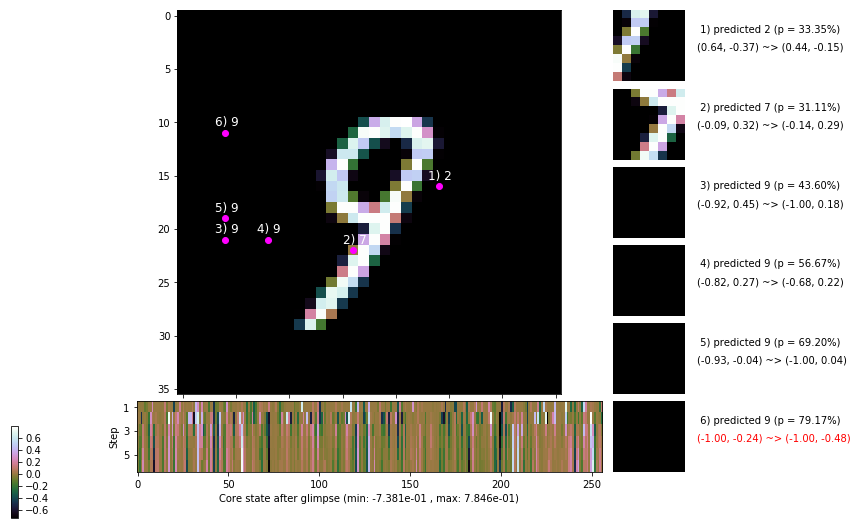

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 159.4 ms/b | lr: 4.20e-04 | grad 2norm:  7.33 | grad inf norm:  2.064
         Weights || abs max:  2.23 (12813.49) | mean: -7.09e-04 ( 0.03) | var: 7.92e-02 (36805.35)
          Biases || abs max:  1.34 (  331.85) | mean: -1.52e-01 ( 0.24) | var: 1.00e-01 ( 1959.85)
                    class loss: 0.329 | steps: 2.231 | reward:  4.484 | acc.: 89.28%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 158.7 ms/b | lr: 4.19e-04 | grad 2norm:  7.31 | grad inf norm:  2.041
         Weights || abs max:  2.22 ( 5613.06) | mean: -7.16e-04 ( 0.02) | var: 7.93e-02 ( 1810.34)
          Biases || abs max:  1.35 (  219.79) | mean: -1.52e-01 ( 0.24) | var: 1.00e-01 ( 1667.30)
                    class loss: 0.298 | steps: 2.191 | reward:  4.544 | acc.: 90.07%

	Target class: 7 | Discounted rewards: [1.011, 0.111, 1.1

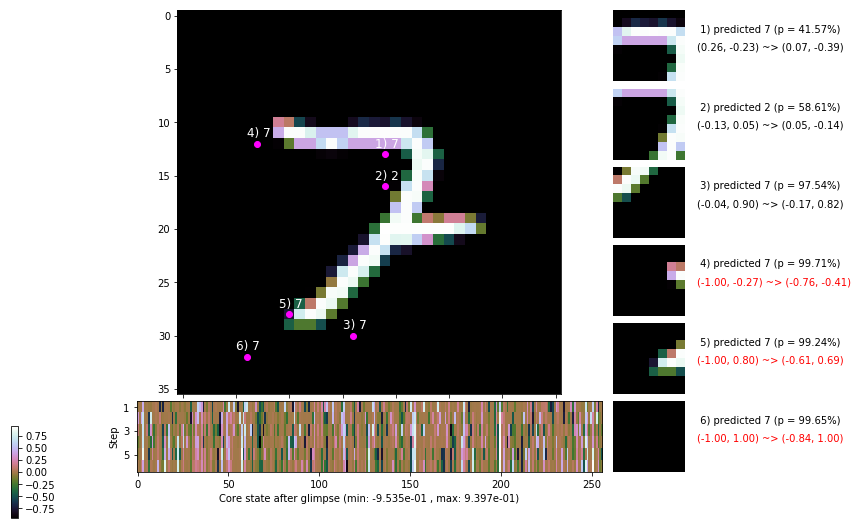

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


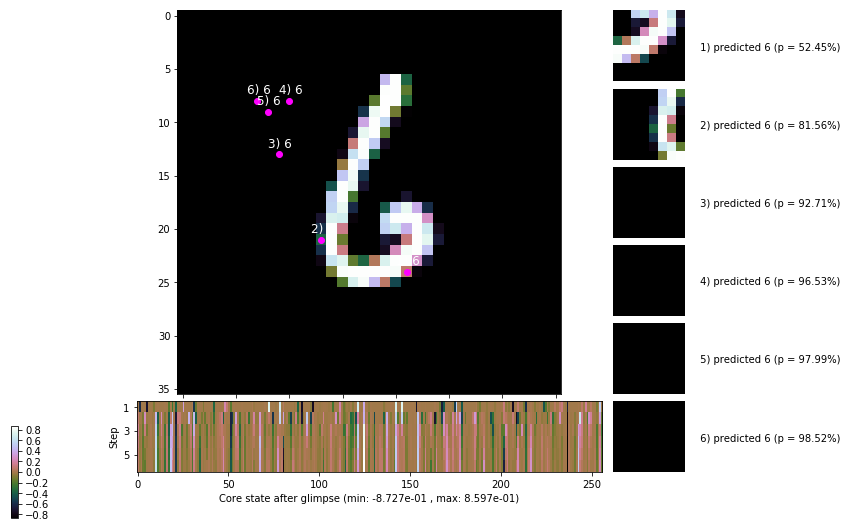


	Target class: 6 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


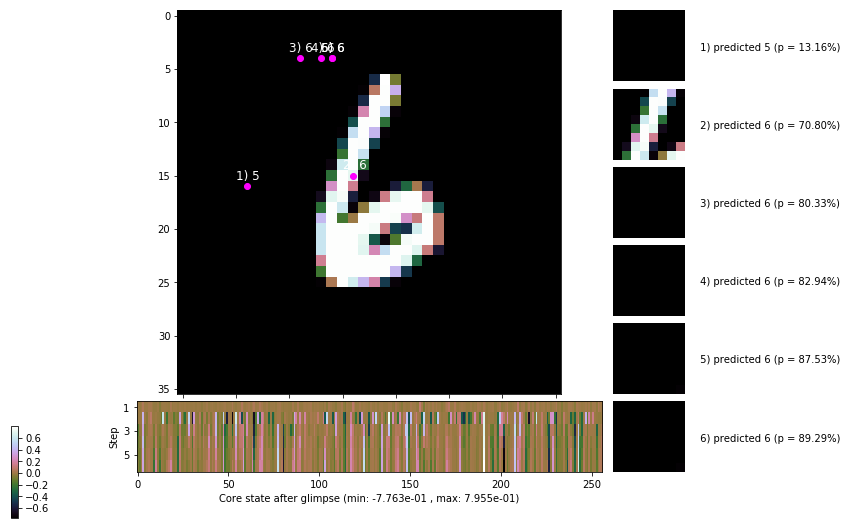

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


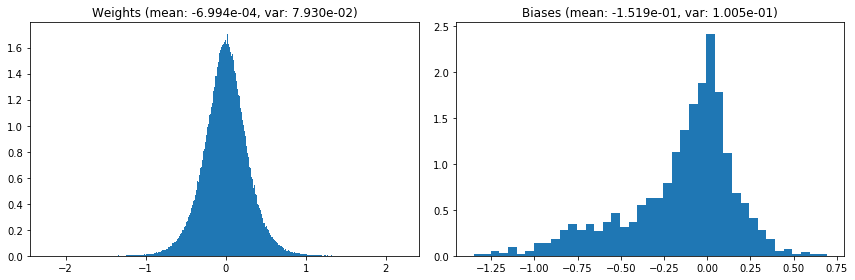

                                      Location network weights and biases


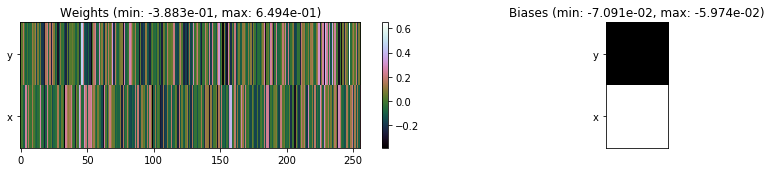

---------------------------------------------------------------------------------------------------------------
Elapsed time:  472.98 sec | TRAIN >> class loss: 0.3242 | steps:  2.213    | reward:  4.5025 :( | acc.: 89.348% :(
                          | VAL   >> class loss: 0.3400 | steps:  2.112    | reward:  4.5980    | acc.: 88.520% :(


Epoch  59/400) lr = 0.0004188
 b    300/  3000 >> 163.8 ms/b | lr: 4.18e-04 | grad 2norm:  7.04 | grad inf norm:  2.028
         Weights || abs max:  2.23 ( 3543.02) | mean: -6.84e-04 ( 0.02) | var: 7.93e-02 (  201.93)
          Biases || abs max:  1.35 (  119.62) | mean: -1.52e-01 ( 0.16) | var: 1.00e-01 (   64.35)
                    class loss: 0.281 | steps: 2.162 | reward:  4.570 | acc.: 90.40%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 168.5 ms/b | lr: 4.18e-04 | grad 2norm:  7.37 | grad inf norm:  2.057
         Weights || abs max:  2.23 ( 3179.17) | mean: -6.82e-04 (

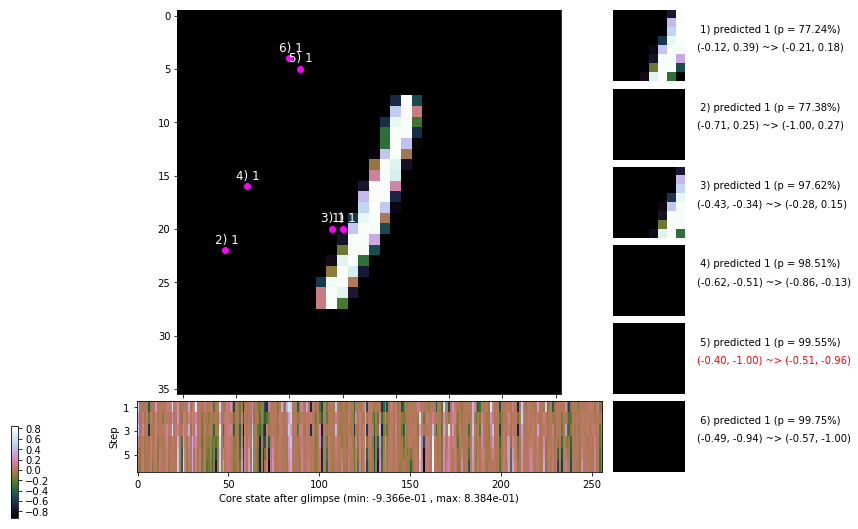

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 167.5 ms/b | lr: 4.17e-04 | grad 2norm:  7.41 | grad inf norm:  2.116
         Weights || abs max:  2.23 ( 4850.58) | mean: -6.88e-04 ( 0.02) | var: 7.94e-02 (  572.70)
          Biases || abs max:  1.35 (  279.04) | mean: -1.52e-01 ( 0.21) | var: 1.01e-01 ( 1089.43)
                    class loss: 0.303 | steps: 2.203 | reward:  4.540 | acc.: 90.25%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 169.3 ms/b | lr: 4.17e-04 | grad 2norm:  7.27 | grad inf norm:  1.998
         Weights || abs max:  2.23 ( 4874.50) | mean: -6.84e-04 ( 0.02) | var: 7.94e-02 ( 1337.88)
          Biases || abs max:  1.35 (  154.29) | mean: -1.52e-01 ( 0.15) | var: 1.01e-01 (  114.41)
                    class loss: 0.309 | steps: 2.193 | reward:  4.542 | acc.: 90.13%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.1

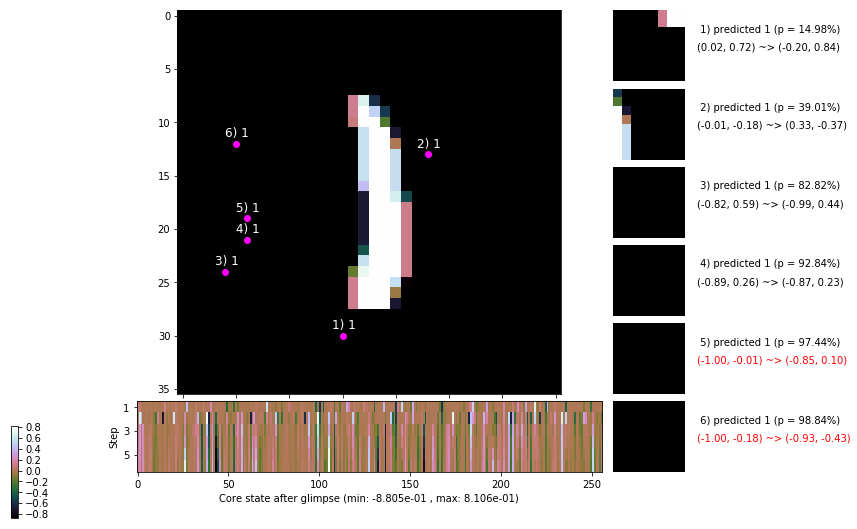

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 166.7 ms/b | lr: 4.16e-04 | grad 2norm:  7.62 | grad inf norm:  2.096
         Weights || abs max:  2.24 (30792.00) | mean: -6.74e-04 ( 0.07) | var: 7.95e-02 (284641.31)
          Biases || abs max:  1.35 (  229.59) | mean: -1.52e-01 ( 0.20) | var: 1.01e-01 (  333.03)
                    class loss: 0.331 | steps: 2.239 | reward:  4.470 | acc.: 88.65%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 167.8 ms/b | lr: 4.15e-04 | grad 2norm:  7.49 | grad inf norm:  2.189
         Weights || abs max:  2.24 ( 2514.90) | mean: -6.75e-04 ( 0.01) | var: 7.95e-02 (   88.95)
          Biases || abs max:  1.36 (  214.59) | mean: -1.52e-01 ( 0.19) | var: 1.01e-01 (  370.44)
                    class loss: 0.319 | steps: 2.184 | reward:  4.543 | acc.: 89.38%

	Target class: 6 | Discounted rewards: [1.111, 1.111, 1.

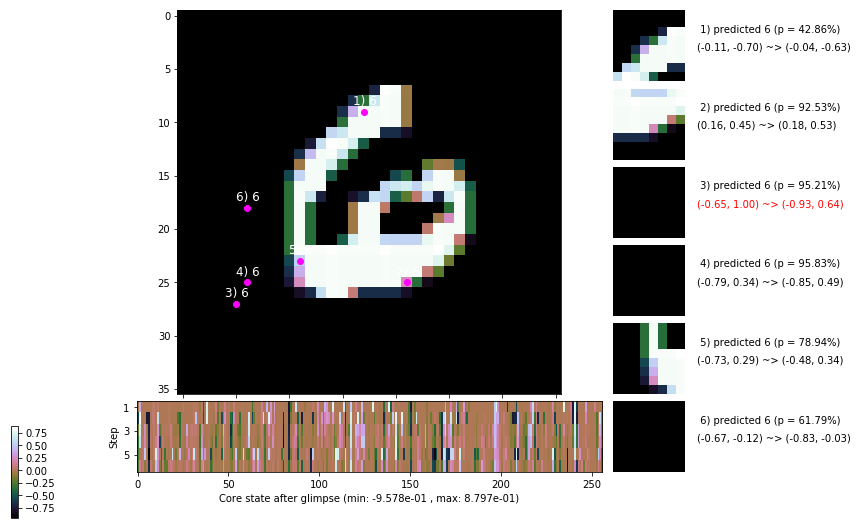

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 171.0 ms/b | lr: 4.15e-04 | grad 2norm:  7.56 | grad inf norm:  2.167
         Weights || abs max:  2.24 ( 4076.80) | mean: -6.74e-04 ( 0.02) | var: 7.95e-02 (  622.86)
          Biases || abs max:  1.35 (  263.62) | mean: -1.52e-01 ( 0.18) | var: 1.01e-01 ( 3006.08)
                    class loss: 0.342 | steps: 2.226 | reward:  4.482 | acc.: 88.57%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 165.4 ms/b | lr: 4.14e-04 | grad 2norm:  7.18 | grad inf norm:  2.045
         Weights || abs max:  2.25 ( 2409.60) | mean: -6.73e-04 ( 0.01) | var: 7.95e-02 (   73.75)
          Biases || abs max:  1.34 (  168.46) | mean: -1.53e-01 ( 0.15) | var: 1.01e-01 (  148.82)
                    class loss: 0.312 | steps: 2.179 | reward:  4.545 | acc.: 89.78%

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.1

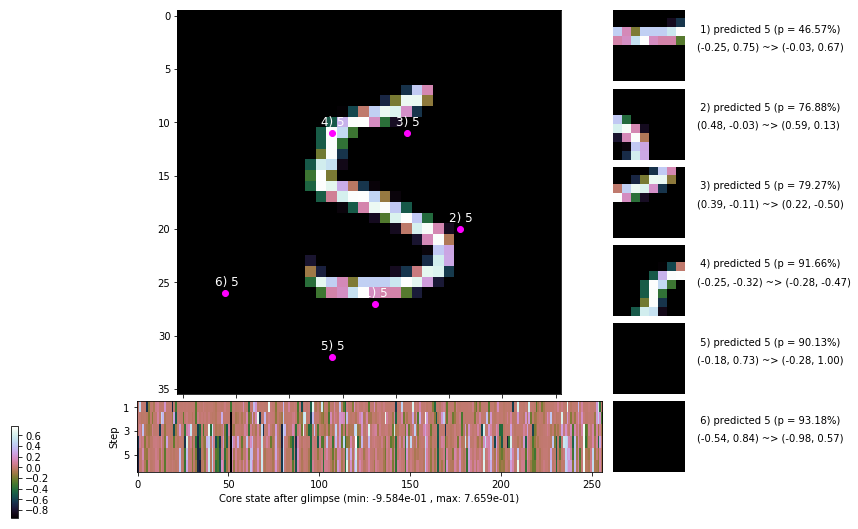

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 169.5 ms/b | lr: 4.13e-04 | grad 2norm:  7.37 | grad inf norm:  2.052
         Weights || abs max:  2.25 ( 2668.94) | mean: -6.86e-04 ( 0.01) | var: 7.96e-02 (  133.84)
          Biases || abs max:  1.34 (  144.42) | mean: -1.53e-01 ( 0.15) | var: 1.01e-01 (  101.91)
                    class loss: 0.322 | steps: 2.225 | reward:  4.492 | acc.: 88.98%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 166.4 ms/b | lr: 4.13e-04 | grad 2norm:  7.51 | grad inf norm:  2.090
         Weights || abs max:  2.25 ( 4171.31) | mean: -7.13e-04 ( 0.02) | var: 7.96e-02 ( 1108.96)
          Biases || abs max:  1.34 (  221.66) | mean: -1.53e-01 ( 0.19) | var: 1.01e-01 (  455.08)
                    class loss: 0.323 | steps: 2.207 | reward:  4.510 | acc.: 89.62%

	Target class: 5 | Discounted rewards: [1.000, 0.000, 0.0

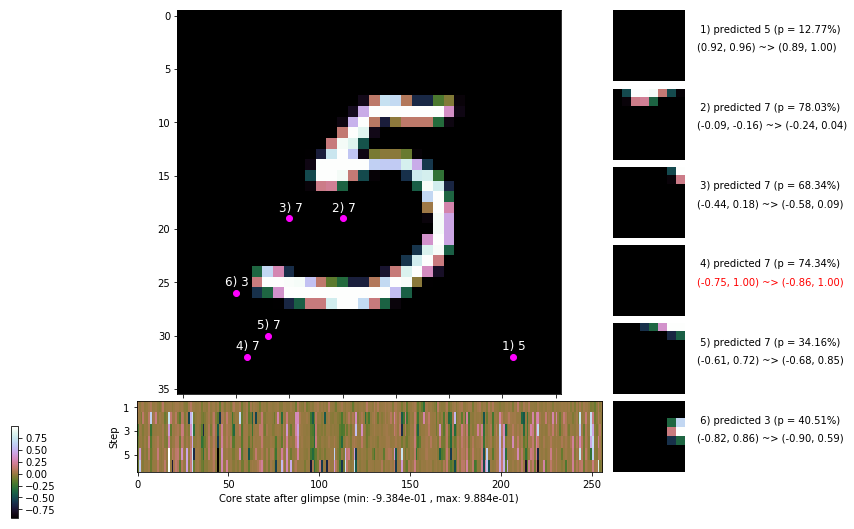

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


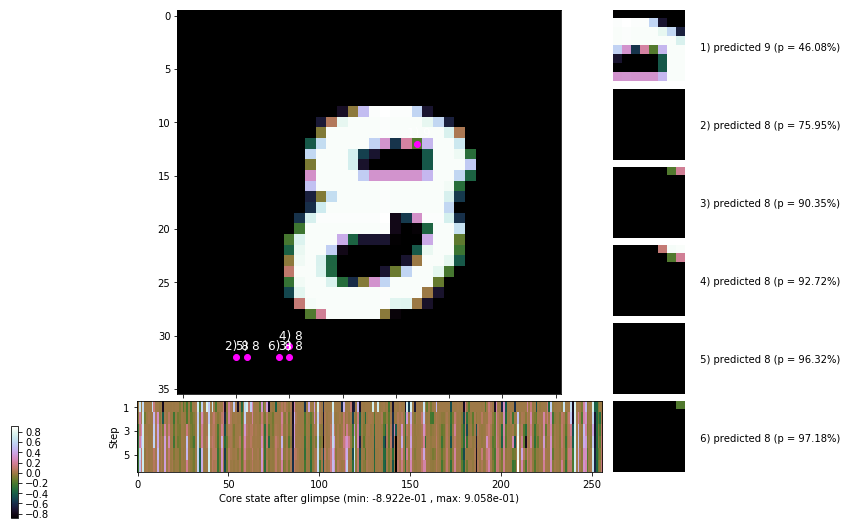


	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


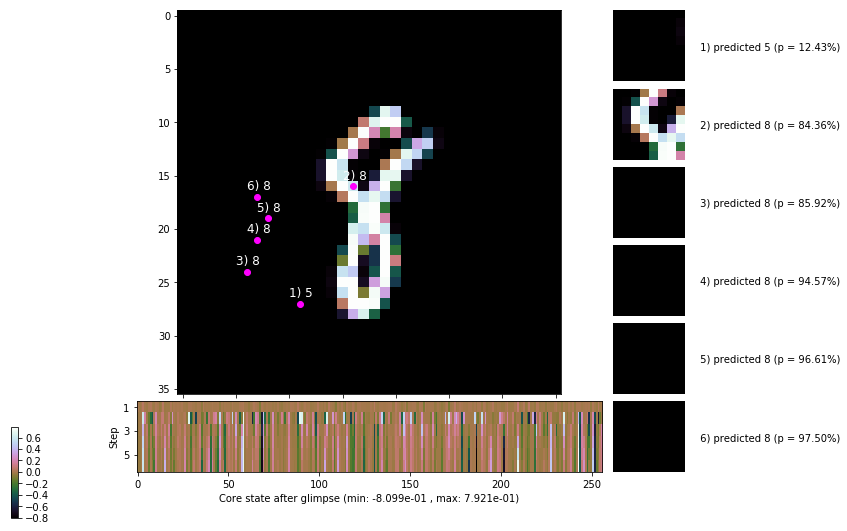

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


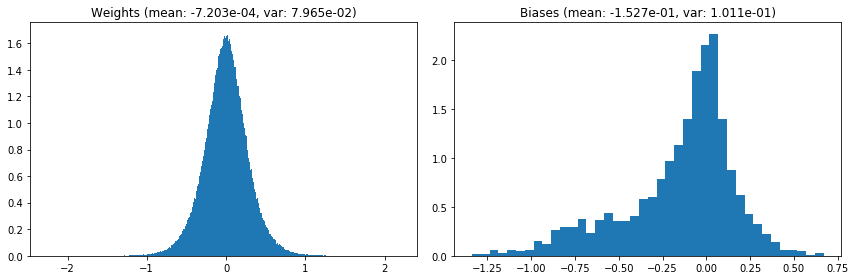

                                      Location network weights and biases


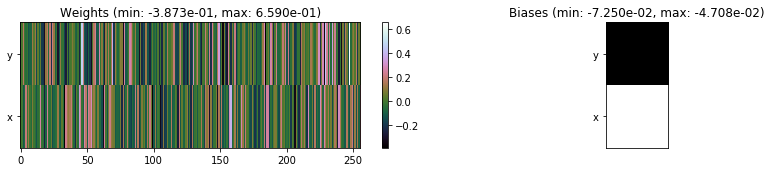

---------------------------------------------------------------------------------------------------------------
Elapsed time:  503.37 sec | TRAIN >> class loss: 0.3150 | steps:  2.202    | reward:  4.5208    | acc.: 89.560% :(
                          | VAL   >> class loss: 0.3350 | steps:  2.127 :( | reward:  4.6126    | acc.: 88.940% 


Epoch  60/400) lr = 0.0004125
 b    300/  3000 >> 169.6 ms/b | lr: 4.12e-04 | grad 2norm:  7.33 | grad inf norm:  2.041
         Weights || abs max:  2.25 ( 3756.47) | mean: -7.08e-04 ( 0.02) | var: 7.97e-02 (  473.16)
          Biases || abs max:  1.34 (  362.48) | mean: -1.52e-01 ( 0.25) | var: 1.01e-01 ( 1683.69)
                    class loss: 0.300 | steps: 2.177 | reward:  4.556 | acc.: 90.47%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 164.7 ms/b | lr: 4.12e-04 | grad 2norm:  7.39 | grad inf norm:  2.022
         Weights || abs max:  2.25 (10349.48) | mean: -7.03e-04 ( 0

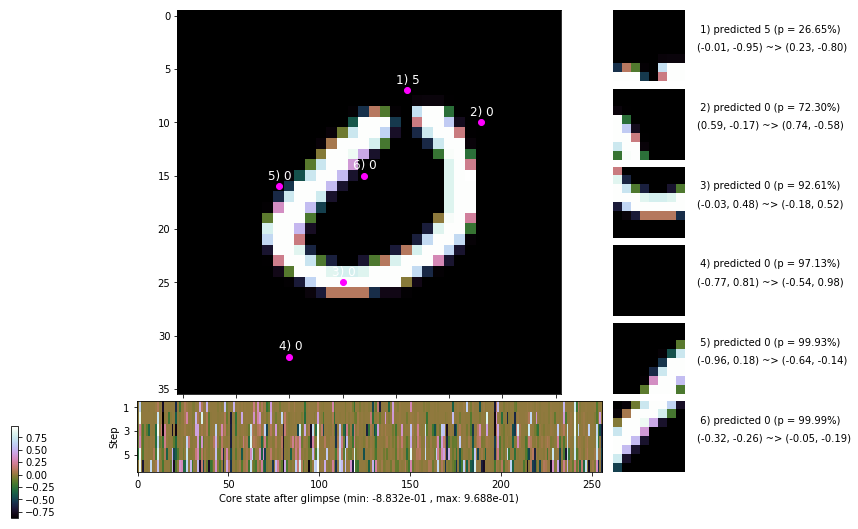

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 167.9 ms/b | lr: 4.11e-04 | grad 2norm:  7.45 | grad inf norm:  2.145
         Weights || abs max:  2.26 (35988.71) | mean: -7.06e-04 ( 0.08) | var: 7.97e-02 (347533.81)
          Biases || abs max:  1.33 (   90.46) | mean: -1.53e-01 ( 0.12) | var: 1.01e-01 (   24.76)
                    class loss: 0.313 | steps: 2.229 | reward:  4.479 | acc.: 89.20%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 167.6 ms/b | lr: 4.10e-04 | grad 2norm:  7.52 | grad inf norm:  2.107
         Weights || abs max:  2.26 ( 6849.04) | mean: -7.21e-04 ( 0.02) | var: 7.98e-02 ( 4137.85)
          Biases || abs max:  1.33 (  152.75) | mean: -1.52e-01 ( 0.16) | var: 1.01e-01 (  101.54)
                    class loss: 0.325 | steps: 2.231 | reward:  4.499 | acc.: 89.33%

	Target class: 4 | Discounted rewards: [1.001, 0.011, 0.

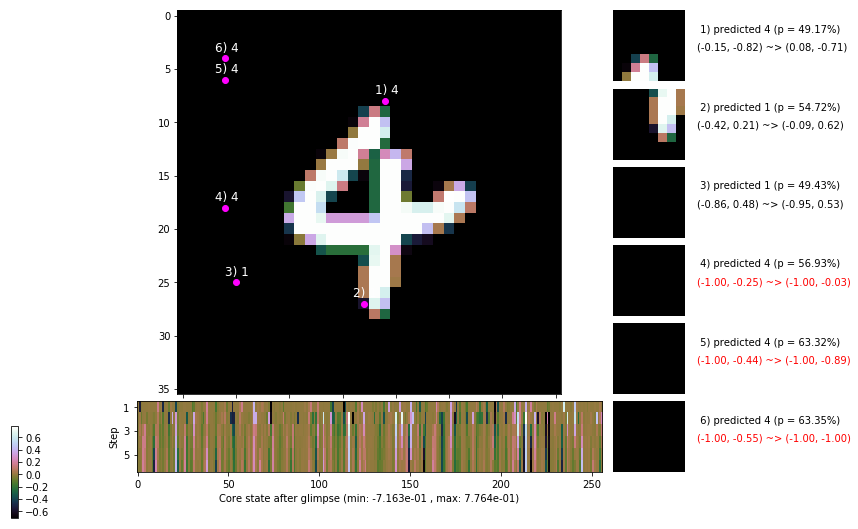

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 168.1 ms/b | lr: 4.10e-04 | grad 2norm:  7.24 | grad inf norm:  2.101
         Weights || abs max:  2.27 (24329.36) | mean: -7.30e-04 ( 0.06) | var: 7.98e-02 (87315.51)
          Biases || abs max:  1.34 (  307.11) | mean: -1.53e-01 ( 0.23) | var: 1.01e-01 ( 1057.62)
                    class loss: 0.316 | steps: 2.212 | reward:  4.502 | acc.: 89.80%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 168.6 ms/b | lr: 4.09e-04 | grad 2norm:  7.52 | grad inf norm:  2.129
         Weights || abs max:  2.28 ( 9296.34) | mean: -7.23e-04 ( 0.03) | var: 7.99e-02 ( 5959.98)
          Biases || abs max:  1.33 (  213.07) | mean: -1.52e-01 ( 0.18) | var: 1.01e-01 (  757.10)
                    class loss: 0.319 | steps: 2.200 | reward:  4.513 | acc.: 89.25%

	Target class: 7 | Discounted rewards: [0.011, 0.111, 1.1

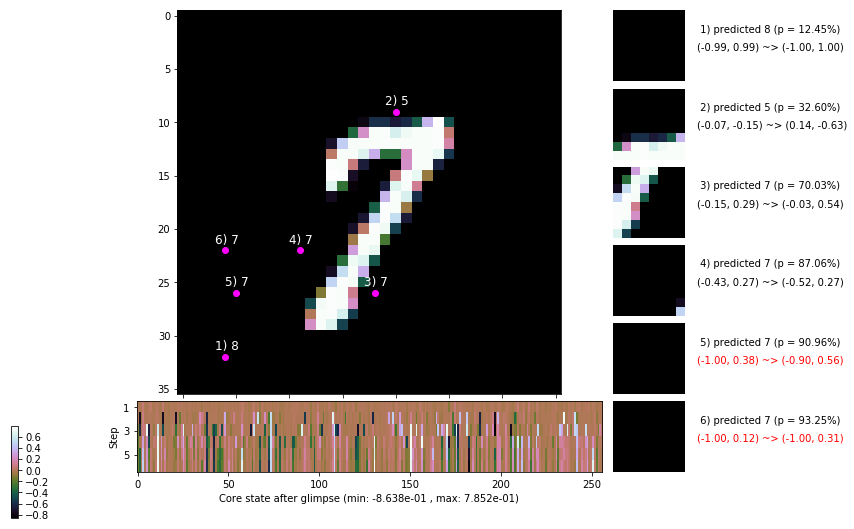

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 164.5 ms/b | lr: 4.08e-04 | grad 2norm:  7.37 | grad inf norm:  2.123
         Weights || abs max:  2.27 ( 3280.00) | mean: -7.01e-04 ( 0.02) | var: 7.99e-02 (  244.34)
          Biases || abs max:  1.33 (  162.45) | mean: -1.52e-01 ( 0.18) | var: 1.01e-01 (  421.07)
                    class loss: 0.325 | steps: 2.209 | reward:  4.503 | acc.: 88.98%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 166.8 ms/b | lr: 4.08e-04 | grad 2norm:  7.55 | grad inf norm:  2.164
         Weights || abs max:  2.27 ( 2251.39) | mean: -7.07e-04 ( 0.01) | var: 8.00e-02 (   55.62)
          Biases || abs max:  1.34 (  155.35) | mean: -1.52e-01 ( 0.16) | var: 1.01e-01 (   66.01)
                    class loss: 0.335 | steps: 2.219 | reward:  4.486 | acc.: 88.88%

	Target class: 5 | Discounted rewards: [0.111, 1.111, 1.1

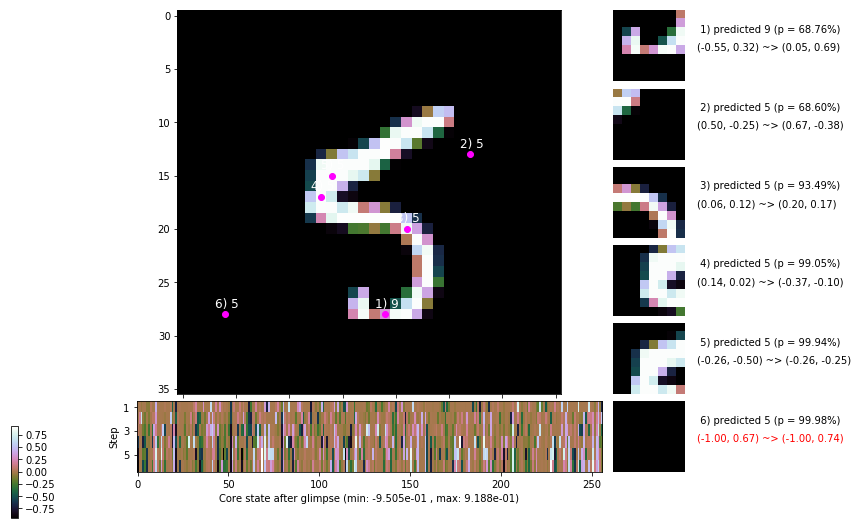

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 171.6 ms/b | lr: 4.07e-04 | grad 2norm:  7.48 | grad inf norm:  2.152
         Weights || abs max:  2.26 ( 4833.20) | mean: -7.16e-04 ( 0.02) | var: 8.00e-02 ( 2433.08)
          Biases || abs max:  1.34 (  270.42) | mean: -1.52e-01 ( 0.20) | var: 1.01e-01 ( 1171.18)
                    class loss: 0.327 | steps: 2.192 | reward:  4.518 | acc.: 89.00%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 166.3 ms/b | lr: 4.07e-04 | grad 2norm:  7.63 | grad inf norm:  2.144
         Weights || abs max:  2.26 ( 8246.11) | mean: -7.26e-04 ( 0.03) | var: 8.00e-02 ( 4427.12)
          Biases || abs max:  1.35 (  147.85) | mean: -1.52e-01 ( 0.17) | var: 1.01e-01 (   74.09)
                    class loss: 0.340 | steps: 2.230 | reward:  4.478 | acc.: 88.73%

	Target class: 2 | Discounted rewards: [0.111, 1.111, 1.1

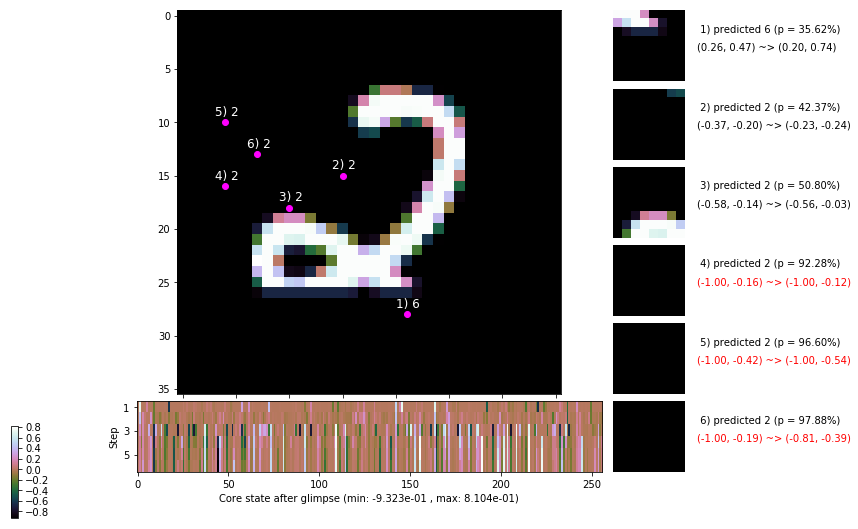

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [1.010, 0.100, 1.000, 0.000, 0.000, 0.000]


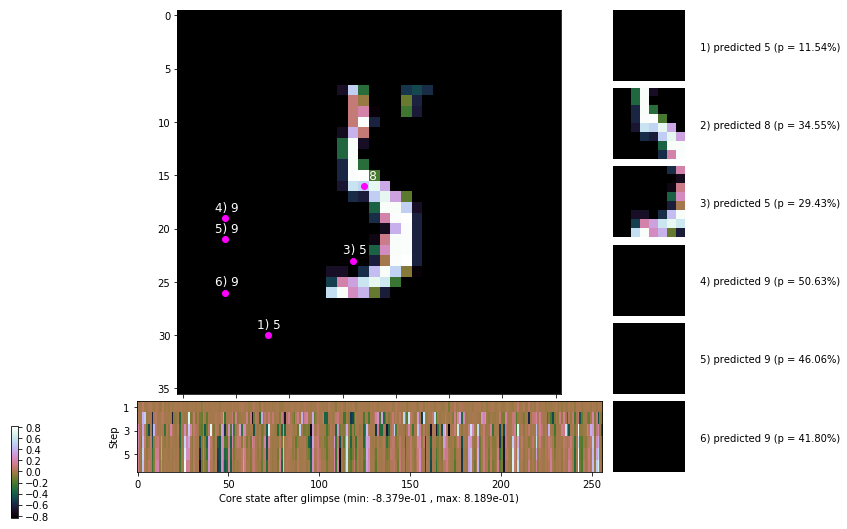


	Target class: 9 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


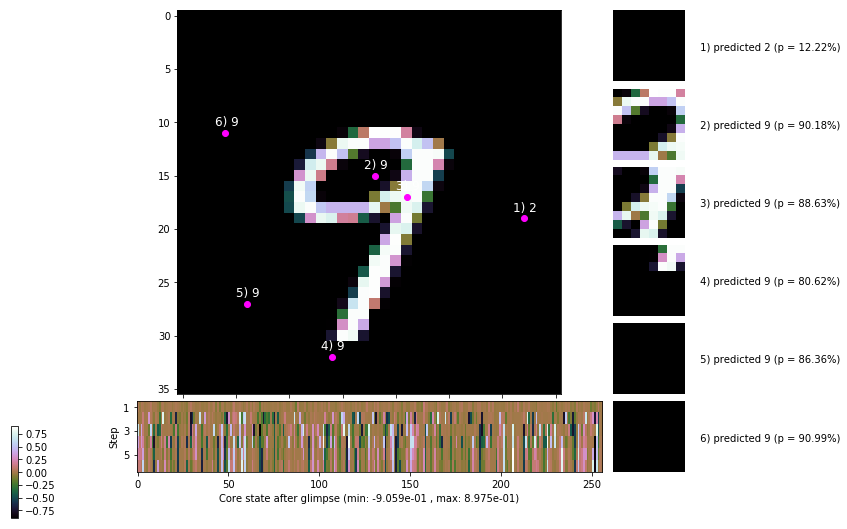

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


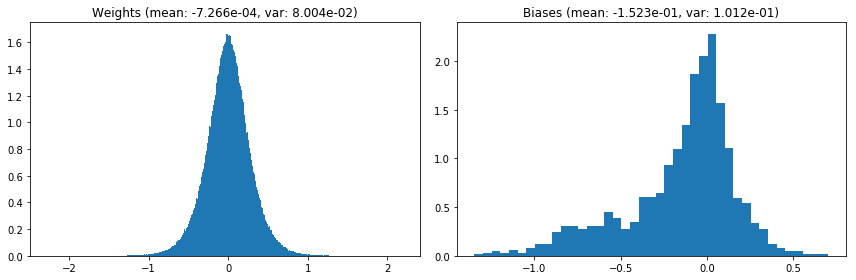

                                      Location network weights and biases


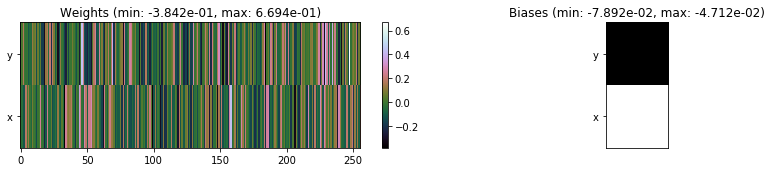

---------------------------------------------------------------------------------------------------------------
Elapsed time:  503.39 sec | TRAIN >> class loss: 0.3231 | steps:  2.211 :( | reward:  4.5038 :( | acc.: 89.280% :(
                          | VAL   >> class loss: 0.3533 | steps:  2.151 :( | reward:  4.5608 :( | acc.: 87.800% :(


Epoch  61/400) lr = 0.0004064
 b    300/  3000 >> 165.2 ms/b | lr: 4.06e-04 | grad 2norm:  7.41 | grad inf norm:  2.184
         Weights || abs max:  2.27 ( 4640.35) | mean: -7.22e-04 ( 0.02) | var: 8.01e-02 (  371.61)
          Biases || abs max:  1.34 (  212.00) | mean: -1.52e-01 ( 0.18) | var: 1.01e-01 ( 1264.07)
                    class loss: 0.320 | steps: 2.217 | reward:  4.494 | acc.: 88.97%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 164.1 ms/b | lr: 4.06e-04 | grad 2norm:  7.49 | grad inf norm:  2.117
         Weights || abs max:  2.27 ( 4060.33) | mean: -7.40e-04 (

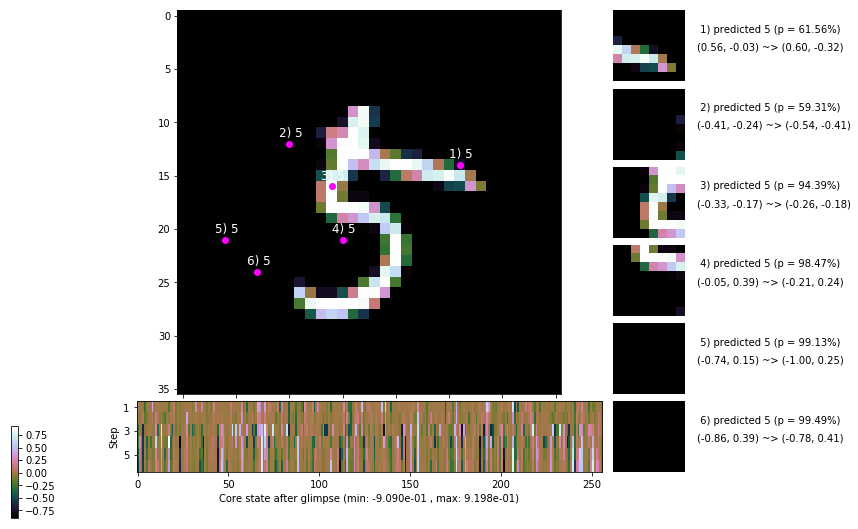

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 168.2 ms/b | lr: 4.05e-04 | grad 2norm:  7.62 | grad inf norm:  2.257
         Weights || abs max:  2.28 ( 4594.80) | mean: -7.42e-04 ( 0.02) | var: 8.01e-02 ( 1739.25)
          Biases || abs max:  1.35 (  182.85) | mean: -1.52e-01 ( 0.19) | var: 1.01e-01 (  222.50)
                    class loss: 0.336 | steps: 2.189 | reward:  4.508 | acc.: 88.93%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 155.3 ms/b | lr: 4.04e-04 | grad 2norm:  7.28 | grad inf norm:  2.014
         Weights || abs max:  2.28 ( 3614.97) | mean: -7.51e-04 ( 0.02) | var: 8.01e-02 (  355.71)
          Biases || abs max:  1.34 (  148.66) | mean: -1.52e-01 ( 0.17) | var: 1.01e-01 (   94.56)
                    class loss: 0.326 | steps: 2.210 | reward:  4.521 | acc.: 89.67%

	Target class: 6 | Discounted rewards: [0.001, 0.011, 0.1

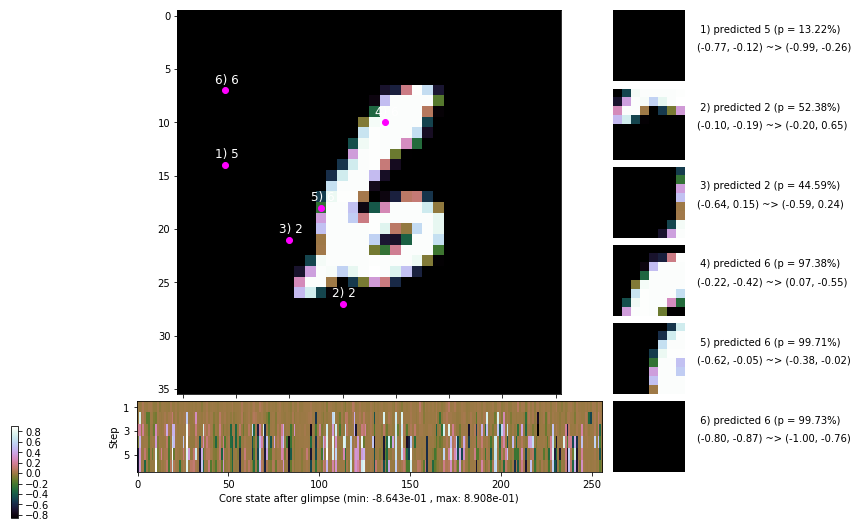

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 158.8 ms/b | lr: 4.04e-04 | grad 2norm:  7.48 | grad inf norm:  2.180
         Weights || abs max:  2.28 ( 2869.48) | mean: -7.61e-04 ( 0.02) | var: 8.02e-02 (   88.67)
          Biases || abs max:  1.33 (  144.94) | mean: -1.52e-01 ( 0.15) | var: 1.01e-01 (  155.88)
                    class loss: 0.316 | steps: 2.203 | reward:  4.523 | acc.: 89.30%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 154.9 ms/b | lr: 4.03e-04 | grad 2norm:  7.39 | grad inf norm:  2.116
         Weights || abs max:  2.27 (17951.73) | mean: -7.56e-04 ( 0.04) | var: 8.02e-02 (113003.92)
          Biases || abs max:  1.34 (  689.81) | mean: -1.52e-01 ( 0.48) | var: 1.01e-01 (25993.37)
                    class loss: 0.315 | steps: 2.216 | reward:  4.516 | acc.: 89.60%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.

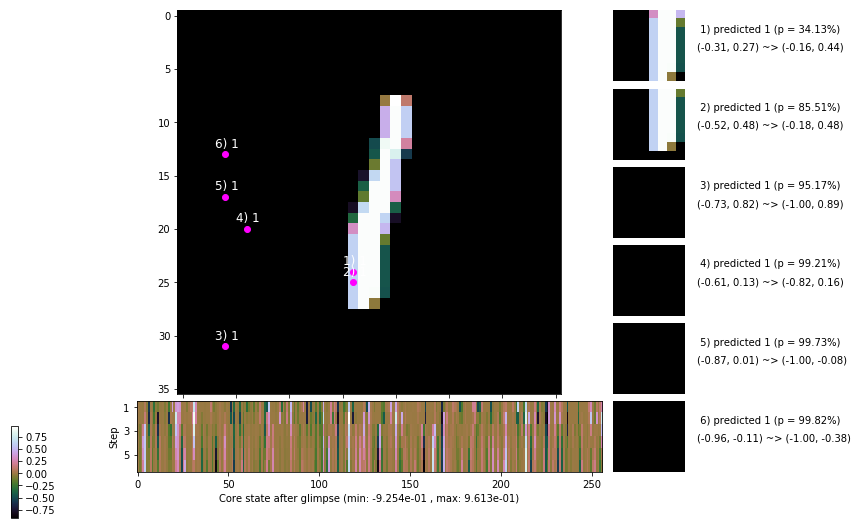

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.9 ms/b | lr: 4.02e-04 | grad 2norm:  7.51 | grad inf norm:  2.201
         Weights || abs max:  2.27 (10415.58) | mean: -7.52e-04 ( 0.03) | var: 8.03e-02 (17848.38)
          Biases || abs max:  1.34 (  353.89) | mean: -1.52e-01 ( 0.25) | var: 1.02e-01 ( 5602.61)
                    class loss: 0.323 | steps: 2.240 | reward:  4.476 | acc.: 88.77%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 158.8 ms/b | lr: 4.02e-04 | grad 2norm:  7.37 | grad inf norm:  2.066
         Weights || abs max:  2.27 ( 3291.25) | mean: -7.61e-04 ( 0.02) | var: 8.03e-02 (  500.91)
          Biases || abs max:  1.34 (  877.35) | mean: -1.52e-01 ( 0.55) | var: 1.02e-01 (29722.72)
                    class loss: 0.334 | steps: 2.203 | reward:  4.518 | acc.: 89.37%

	Target class: 4 | Discounted rewards: [1.111, 1.111, 1.1

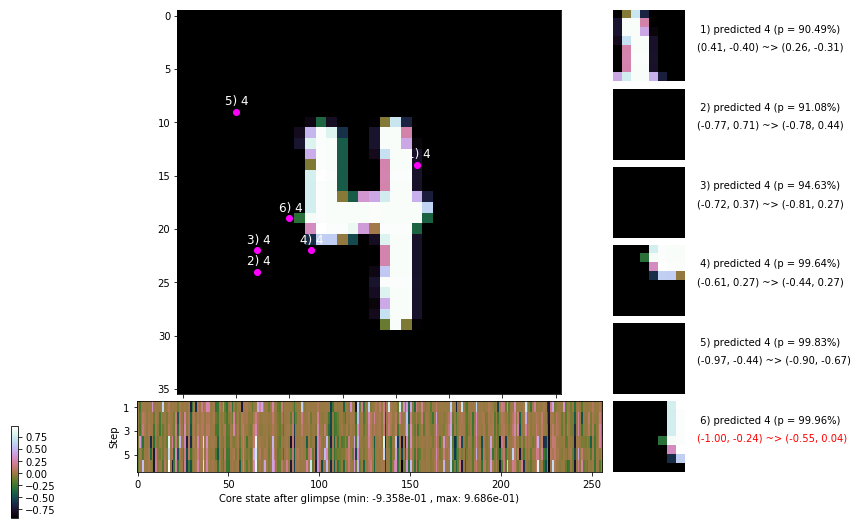

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 163.2 ms/b | lr: 4.01e-04 | grad 2norm:  7.59 | grad inf norm:  2.102
         Weights || abs max:  2.26 ( 7707.43) | mean: -7.66e-04 ( 0.03) | var: 8.03e-02 ( 8302.58)
          Biases || abs max:  1.34 (  288.25) | mean: -1.52e-01 ( 0.26) | var: 1.02e-01 (  545.44)
                    class loss: 0.320 | steps: 2.198 | reward:  4.518 | acc.: 89.52%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 162.6 ms/b | lr: 4.01e-04 | grad 2norm:  7.29 | grad inf norm:  2.087
         Weights || abs max:  2.26 ( 3226.64) | mean: -7.65e-04 ( 0.02) | var: 8.04e-02 (  102.27)
          Biases || abs max:  1.33 (  191.55) | mean: -1.52e-01 ( 0.21) | var: 1.02e-01 (  769.81)
                    class loss: 0.315 | steps: 2.184 | reward:  4.540 | acc.: 89.62%

	Target class: 6 | Discounted rewards: [0.111, 1.111, 1.1

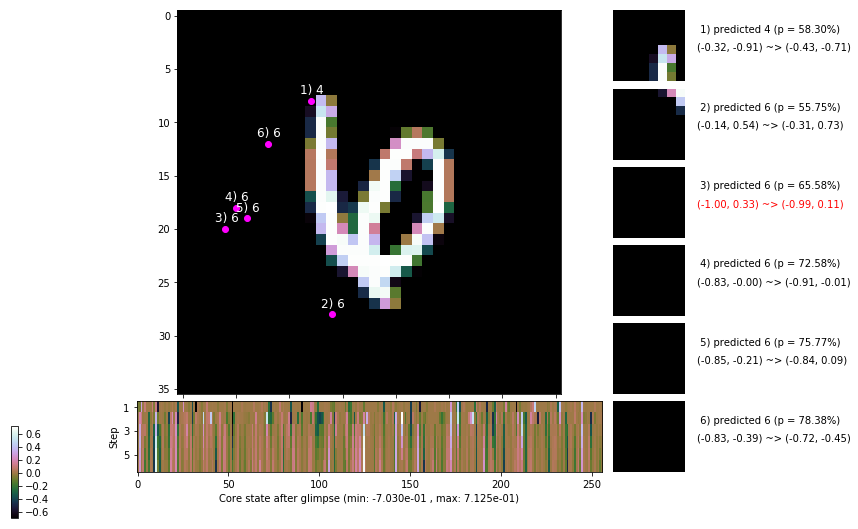

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


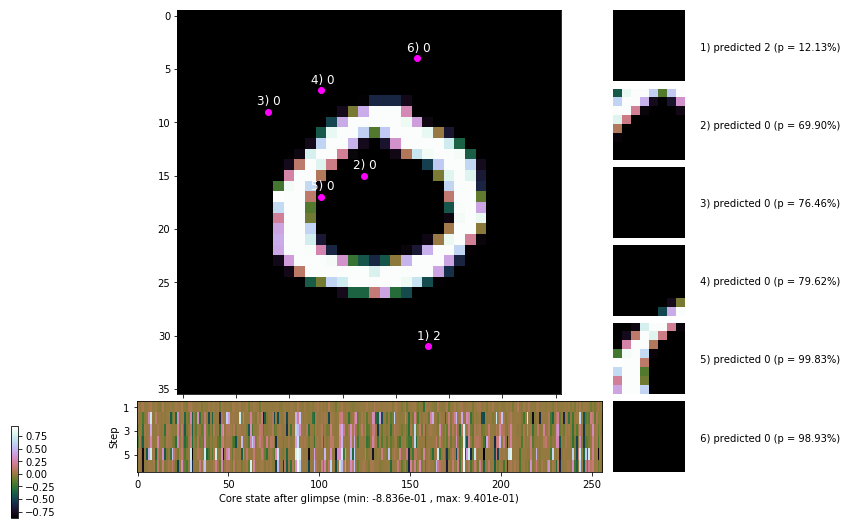


	Target class: 0 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


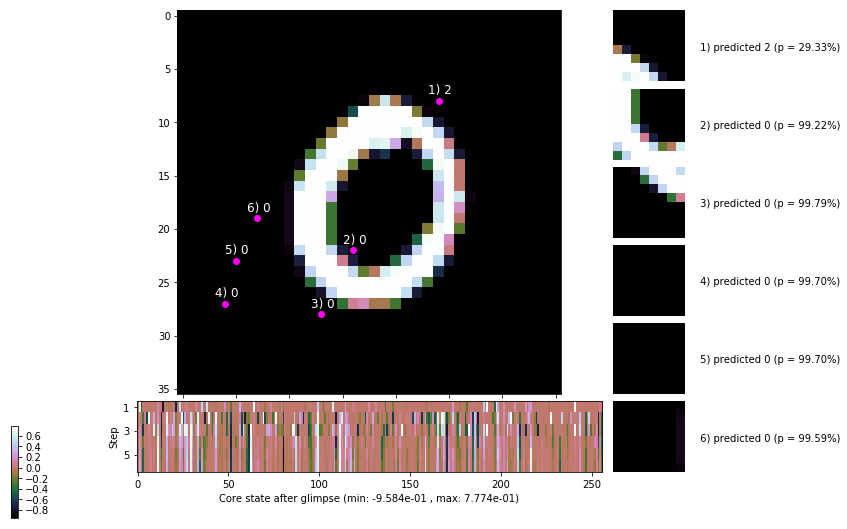

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


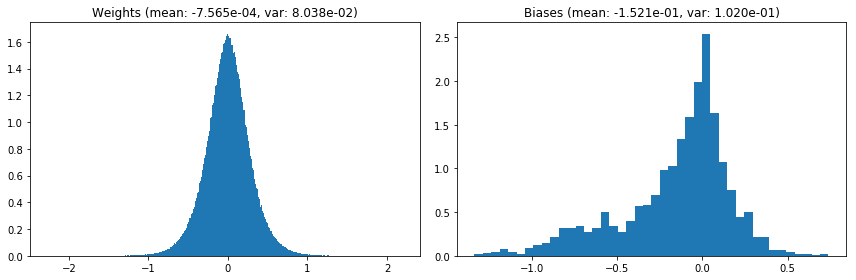

                                      Location network weights and biases


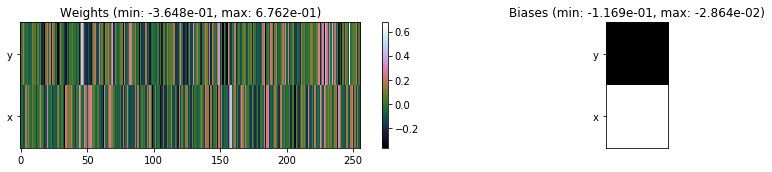

---------------------------------------------------------------------------------------------------------------
Elapsed time:  482.67 sec | TRAIN >> class loss: 0.3234 | steps:  2.208 :( | reward:  4.5108 :( | acc.: 89.270% :(
                          | VAL   >> class loss: 0.3367 | steps:  2.122 :( | reward:  4.6236    | acc.: 88.920% :(


Epoch  62/400) lr = 0.0004003
 b    300/  3000 >> 150.7 ms/b | lr: 4.00e-04 | grad 2norm:  7.37 | grad inf norm:  2.105
         Weights || abs max:  2.26 ( 6924.45) | mean: -7.57e-04 ( 0.02) | var: 8.04e-02 ( 3930.02)
          Biases || abs max:  1.33 (  244.22) | mean: -1.52e-01 ( 0.20) | var: 1.02e-01 (  927.00)
                    class loss: 0.320 | steps: 2.209 | reward:  4.519 | acc.: 89.47%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 148.4 ms/b | lr: 4.00e-04 | grad 2norm:  7.39 | grad inf norm:  2.079
         Weights || abs max:  2.25 ( 5508.68) | mean: -7.60e-04 (

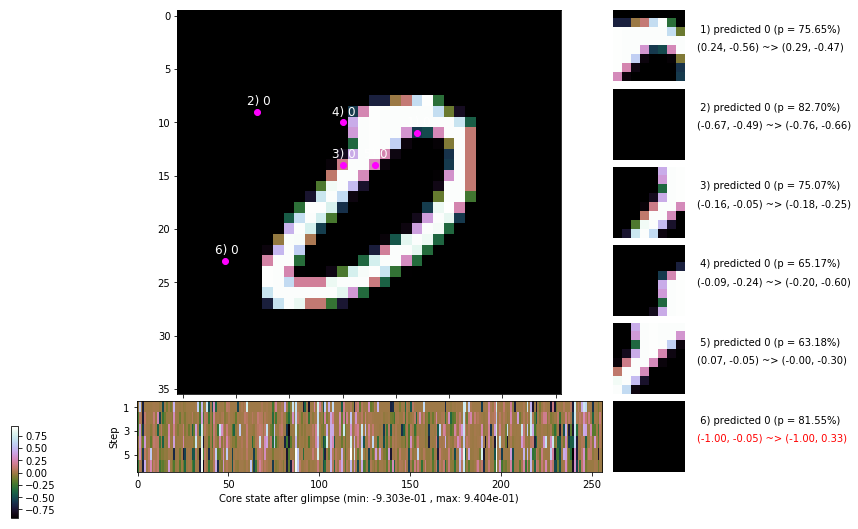

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 152.5 ms/b | lr: 3.99e-04 | grad 2norm:  7.30 | grad inf norm:  2.014
         Weights || abs max:  2.25 ( 3673.92) | mean: -7.62e-04 ( 0.02) | var: 8.05e-02 (  659.25)
          Biases || abs max:  1.34 (  222.66) | mean: -1.52e-01 ( 0.19) | var: 1.02e-01 (  494.10)
                    class loss: 0.304 | steps: 2.171 | reward:  4.539 | acc.: 89.30%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 148.9 ms/b | lr: 3.98e-04 | grad 2norm:  7.45 | grad inf norm:  2.158
         Weights || abs max:  2.26 ( 4604.14) | mean: -7.83e-04 ( 0.02) | var: 8.05e-02 (  613.26)
          Biases || abs max:  1.34 (  188.38) | mean: -1.52e-01 ( 0.17) | var: 1.02e-01 (  191.62)
                    class loss: 0.315 | steps: 2.207 | reward:  4.520 | acc.: 89.83%

	Target class: 0 | Discounted rewards: [0.011, 0.111, 1.1

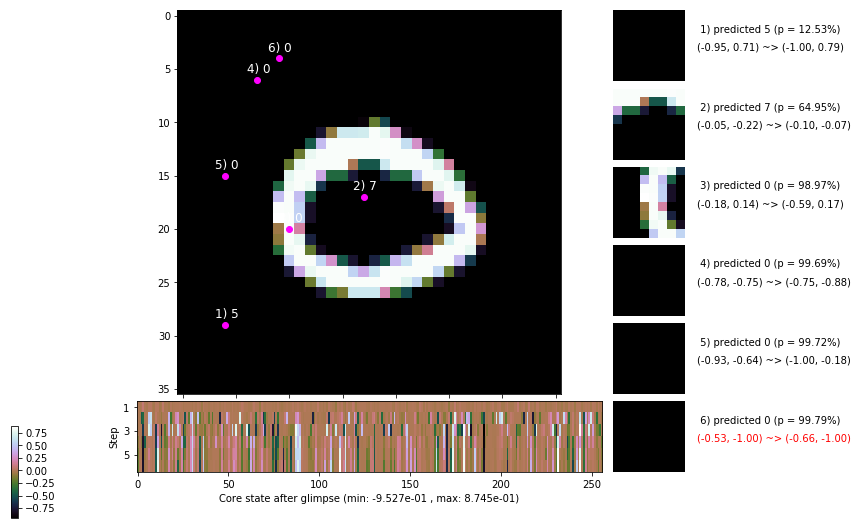

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 153.1 ms/b | lr: 3.98e-04 | grad 2norm:  7.62 | grad inf norm:  2.178
         Weights || abs max:  2.27 ( 5843.60) | mean: -7.95e-04 ( 0.02) | var: 8.05e-02 ( 1344.81)
          Biases || abs max:  1.34 (  235.77) | mean: -1.52e-01 ( 0.19) | var: 1.02e-01 (  345.46)
                    class loss: 0.321 | steps: 2.190 | reward:  4.513 | acc.: 89.37%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 153.7 ms/b | lr: 3.97e-04 | grad 2norm:  7.35 | grad inf norm:  2.113
         Weights || abs max:  2.27 ( 4053.16) | mean: -7.99e-04 ( 0.02) | var: 8.05e-02 (  261.59)
          Biases || abs max:  1.35 (  151.74) | mean: -1.52e-01 ( 0.15) | var: 1.02e-01 (  204.88)
                    class loss: 0.298 | steps: 2.177 | reward:  4.553 | acc.: 90.28%

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.1

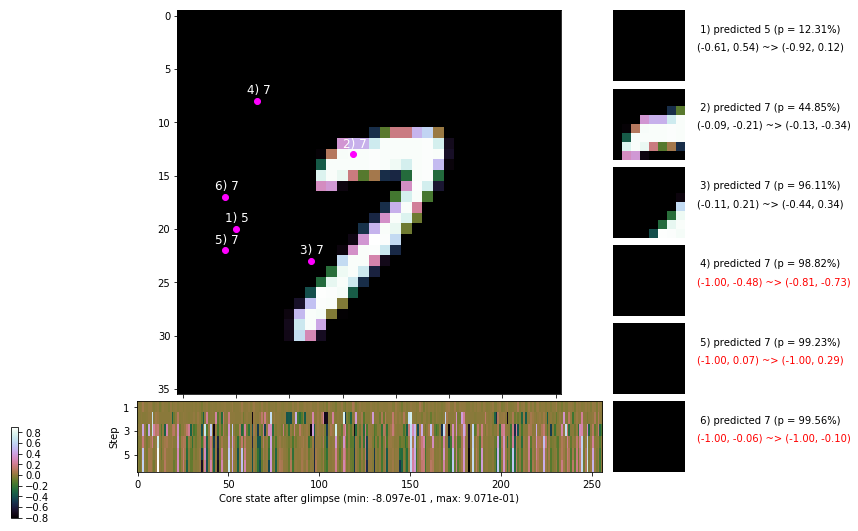

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 163.3 ms/b | lr: 3.96e-04 | grad 2norm:  7.45 | grad inf norm:  2.081
         Weights || abs max:  2.27 ( 2979.96) | mean: -8.14e-04 ( 0.02) | var: 8.06e-02 (  189.39)
          Biases || abs max:  1.35 (  128.87) | mean: -1.52e-01 ( 0.16) | var: 1.02e-01 (   53.78)
                    class loss: 0.290 | steps: 2.175 | reward:  4.553 | acc.: 90.43%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 159.3 ms/b | lr: 3.96e-04 | grad 2norm:  7.42 | grad inf norm:  2.073
         Weights || abs max:  2.27 ( 2966.78) | mean: -8.30e-04 ( 0.02) | var: 8.06e-02 (  417.62)
          Biases || abs max:  1.35 (  353.56) | mean: -1.52e-01 ( 0.25) | var: 1.02e-01 (  954.52)
                    class loss: 0.302 | steps: 2.193 | reward:  4.536 | acc.: 89.82%

	Target class: 7 | Discounted rewards: [0.011, 0.111, 1.1

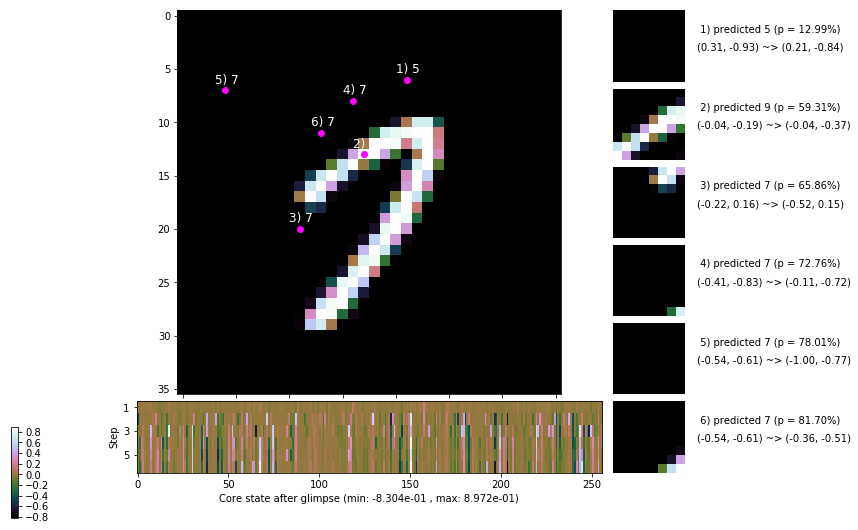

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 151.1 ms/b | lr: 3.95e-04 | grad 2norm:  7.16 | grad inf norm:  2.010
         Weights || abs max:  2.27 ( 5028.94) | mean: -8.53e-04 ( 0.02) | var: 8.06e-02 ( 4124.31)
          Biases || abs max:  1.36 (  185.54) | mean: -1.53e-01 ( 0.16) | var: 1.02e-01 (  387.06)
                    class loss: 0.304 | steps: 2.182 | reward:  4.544 | acc.: 89.83%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 154.6 ms/b | lr: 3.95e-04 | grad 2norm:  7.53 | grad inf norm:  2.138
         Weights || abs max:  2.28 ( 2432.30) | mean: -8.61e-04 ( 0.01) | var: 8.07e-02 (   57.41)
          Biases || abs max:  1.35 (  126.52) | mean: -1.53e-01 ( 0.15) | var: 1.02e-01 (   60.59)
                    class loss: 0.325 | steps: 2.186 | reward:  4.519 | acc.: 89.05%

	Target class: 2 | Discounted rewards: [0.011, 0.111, 1.1

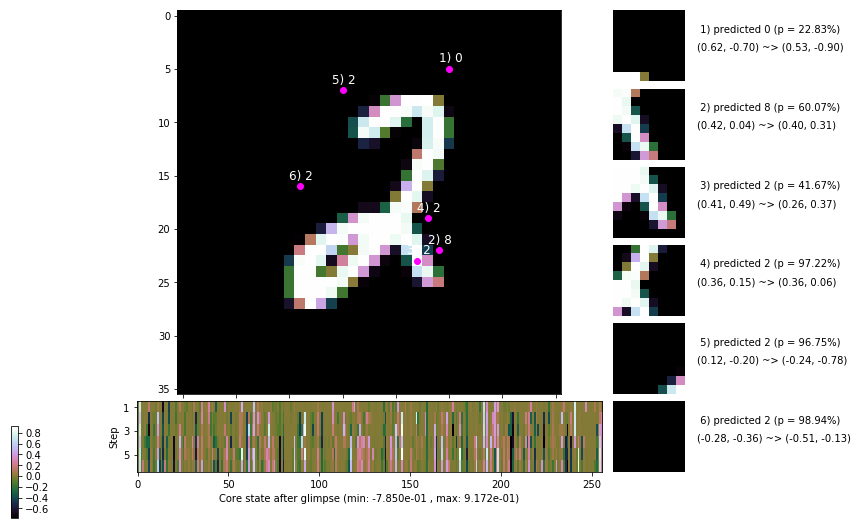

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


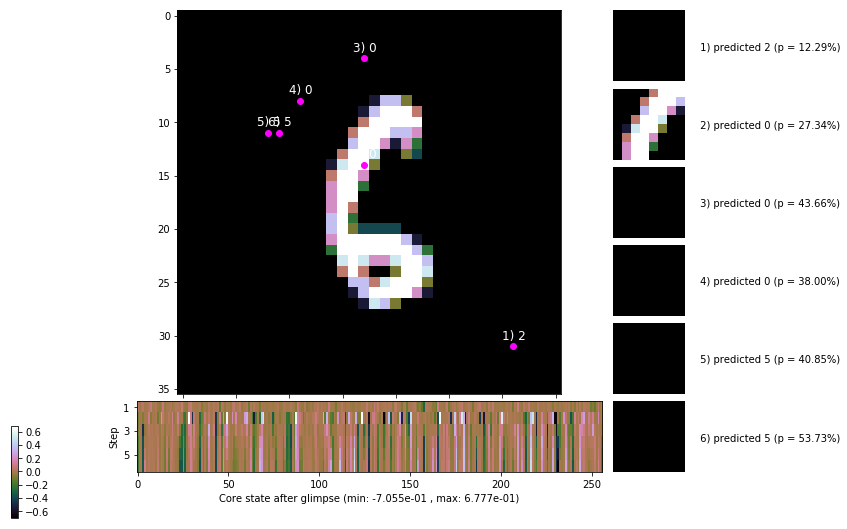


	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


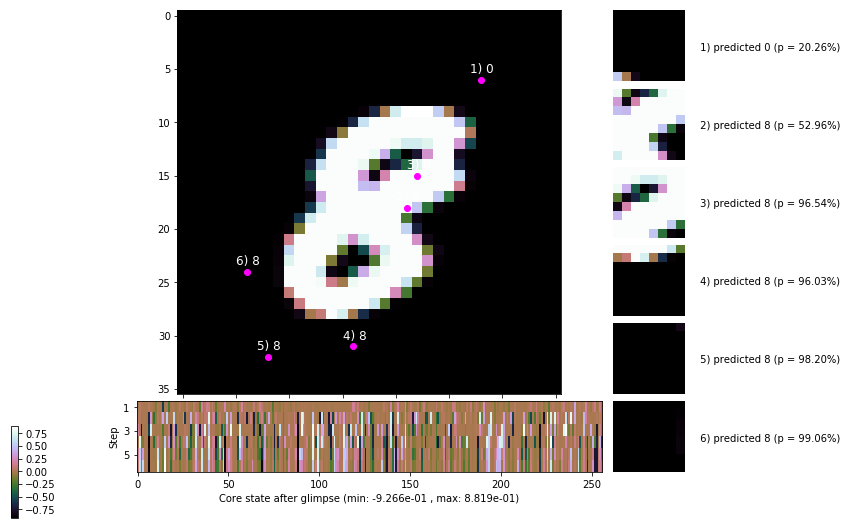

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


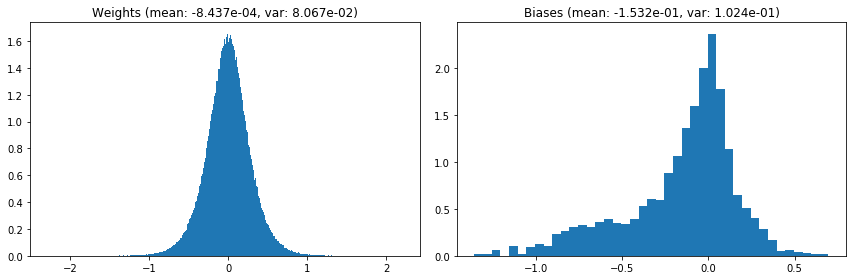

                                      Location network weights and biases


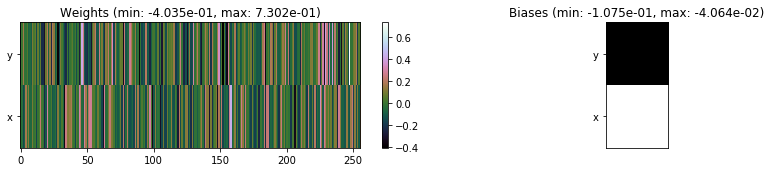

---------------------------------------------------------------------------------------------------------------
Elapsed time:  461.56 sec | TRAIN >> class loss: 0.3113 | steps:  2.192    | reward:  4.5294    | acc.: 89.642% :(
                          | VAL   >> class loss: 0.3395 | steps:  2.148 :( | reward:  4.5922 :( | acc.: 88.740% :(


Epoch  63/400) lr = 0.0003944
 b    300/  3000 >> 152.1 ms/b | lr: 3.94e-04 | grad 2norm:  7.13 | grad inf norm:  2.075
         Weights || abs max:  2.28 ( 6532.82) | mean: -8.35e-04 ( 0.02) | var: 8.07e-02 ( 2681.43)
          Biases || abs max:  1.35 (  165.30) | mean: -1.53e-01 ( 0.17) | var: 1.02e-01 (  162.91)
                    class loss: 0.301 | steps: 2.183 | reward:  4.553 | acc.: 90.15%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 150.0 ms/b | lr: 3.94e-04 | grad 2norm:  7.28 | grad inf norm:  2.042
         Weights || abs max:  2.28 ( 4574.46) | mean: -8.09e-04 (

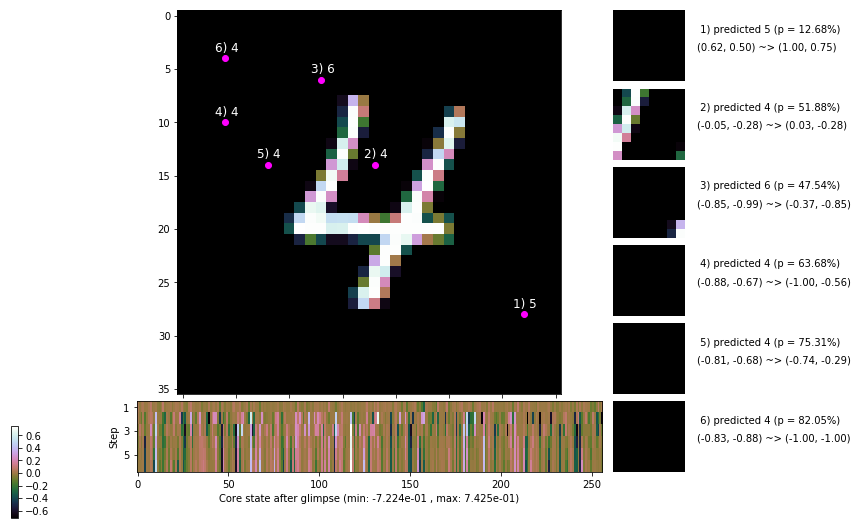

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 157.1 ms/b | lr: 3.93e-04 | grad 2norm:  7.49 | grad inf norm:  2.100
         Weights || abs max:  2.27 ( 3965.67) | mean: -8.29e-04 ( 0.02) | var: 8.07e-02 (  309.70)
          Biases || abs max:  1.35 (  258.57) | mean: -1.53e-01 ( 0.21) | var: 1.02e-01 (  390.70)
                    class loss: 0.308 | steps: 2.168 | reward:  4.569 | acc.: 90.38%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 150.8 ms/b | lr: 3.92e-04 | grad 2norm:  7.32 | grad inf norm:  2.020
         Weights || abs max:  2.27 (18048.63) | mean: -8.27e-04 ( 0.04) | var: 8.08e-02 (125114.94)
          Biases || abs max:  1.34 (  263.01) | mean: -1.53e-01 ( 0.21) | var: 1.02e-01 (  358.94)
                    class loss: 0.283 | steps: 2.170 | reward:  4.559 | acc.: 90.70%

	Target class: 6 | Discounted rewards: [0.111, 1.111, 1.

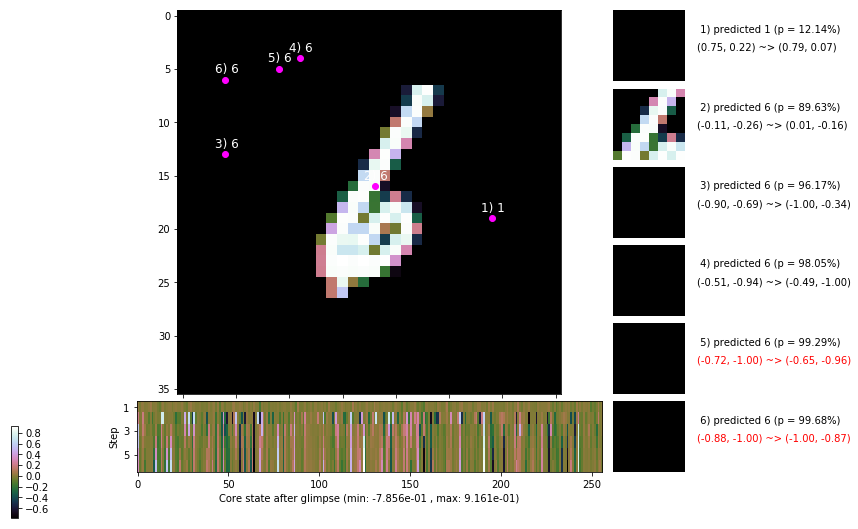

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 153.3 ms/b | lr: 3.92e-04 | grad 2norm:  7.57 | grad inf norm:  2.122
         Weights || abs max:  2.27 ( 5936.48) | mean: -8.13e-04 ( 0.02) | var: 8.08e-02 ( 1489.02)
          Biases || abs max:  1.34 (  221.99) | mean: -1.52e-01 ( 0.21) | var: 1.02e-01 (  339.17)
                    class loss: 0.306 | steps: 2.192 | reward:  4.521 | acc.: 89.88%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 153.2 ms/b | lr: 3.91e-04 | grad 2norm:  7.59 | grad inf norm:  2.120
         Weights || abs max:  2.27 ( 3324.28) | mean: -8.16e-04 ( 0.02) | var: 8.08e-02 (  217.73)
          Biases || abs max:  1.34 (  352.82) | mean: -1.52e-01 ( 0.26) | var: 1.02e-01 ( 1095.54)
                    class loss: 0.308 | steps: 2.194 | reward:  4.529 | acc.: 89.87%

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.1

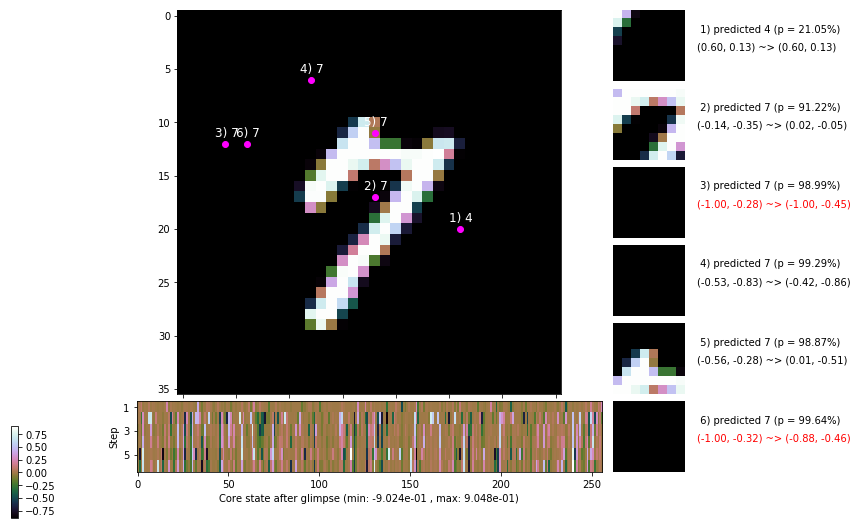

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 153.5 ms/b | lr: 3.90e-04 | grad 2norm:  7.21 | grad inf norm:  2.059
         Weights || abs max:  2.28 (10012.64) | mean: -7.99e-04 ( 0.03) | var: 8.09e-02 ( 7443.26)
          Biases || abs max:  1.34 (  238.01) | mean: -1.52e-01 ( 0.20) | var: 1.02e-01 (  571.41)
                    class loss: 0.304 | steps: 2.176 | reward:  4.546 | acc.: 89.90%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.3 ms/b | lr: 3.90e-04 | grad 2norm:  7.18 | grad inf norm:  2.095
         Weights || abs max:  2.28 ( 4356.93) | mean: -7.86e-04 ( 0.02) | var: 8.09e-02 (  564.82)
          Biases || abs max:  1.34 (  177.82) | mean: -1.52e-01 ( 0.19) | var: 1.02e-01 (  318.18)
                    class loss: 0.314 | steps: 2.171 | reward:  4.554 | acc.: 89.82%

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.1

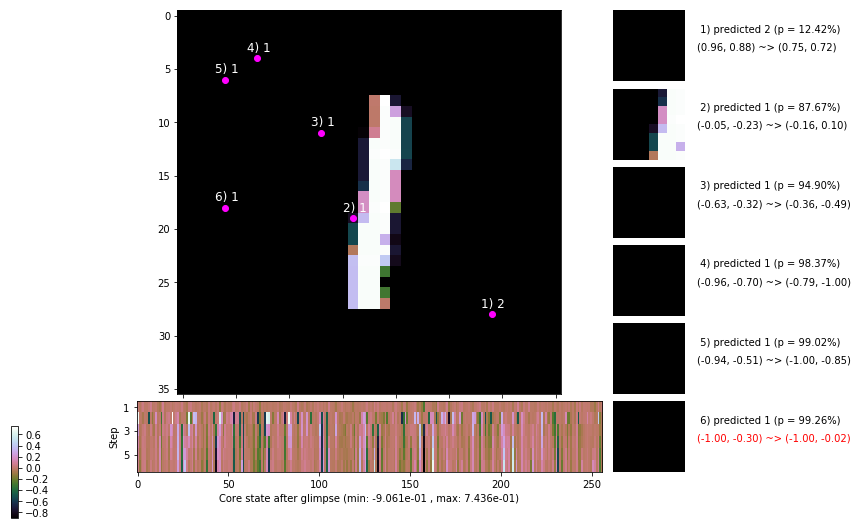

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 155.7 ms/b | lr: 3.89e-04 | grad 2norm:  7.33 | grad inf norm:  2.147
         Weights || abs max:  2.28 ( 4510.23) | mean: -7.96e-04 ( 0.02) | var: 8.09e-02 (  324.66)
          Biases || abs max:  1.34 (  226.70) | mean: -1.52e-01 ( 0.19) | var: 1.02e-01 (  672.30)
                    class loss: 0.327 | steps: 2.181 | reward:  4.532 | acc.: 89.48%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 148.9 ms/b | lr: 3.89e-04 | grad 2norm:  7.41 | grad inf norm:  2.196
         Weights || abs max:  2.27 ( 3785.40) | mean: -8.05e-04 ( 0.02) | var: 8.10e-02 (  957.51)
          Biases || abs max:  1.34 (  302.15) | mean: -1.53e-01 ( 0.24) | var: 1.02e-01 ( 1261.84)
                    class loss: 0.332 | steps: 2.194 | reward:  4.509 | acc.: 88.60%

	Target class: 6 | Discounted rewards: [0.111, 1.111, 1.1

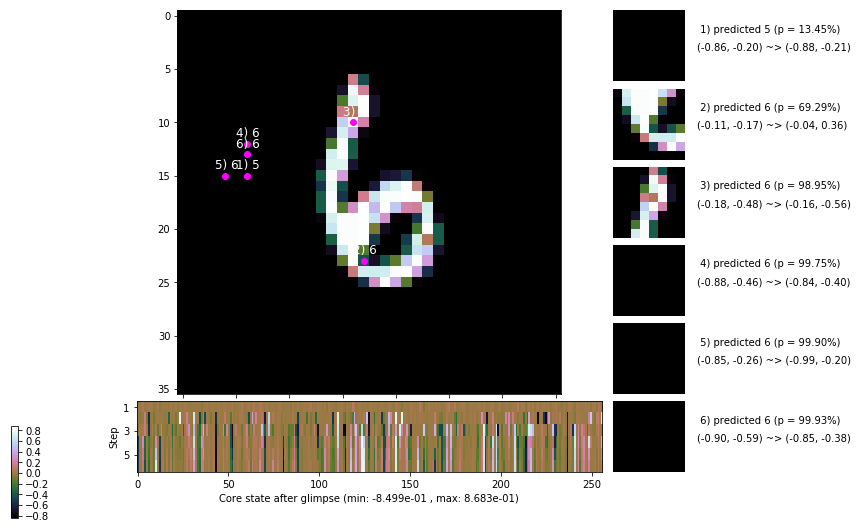

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


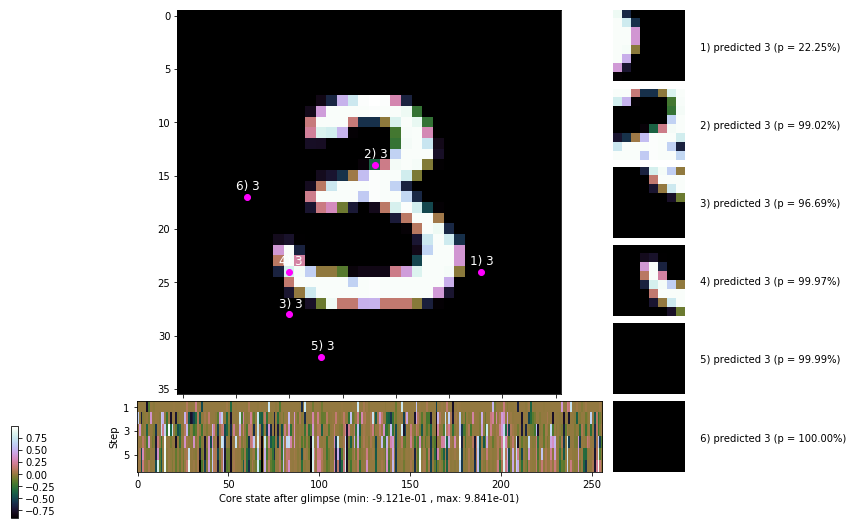


	Target class: 8 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


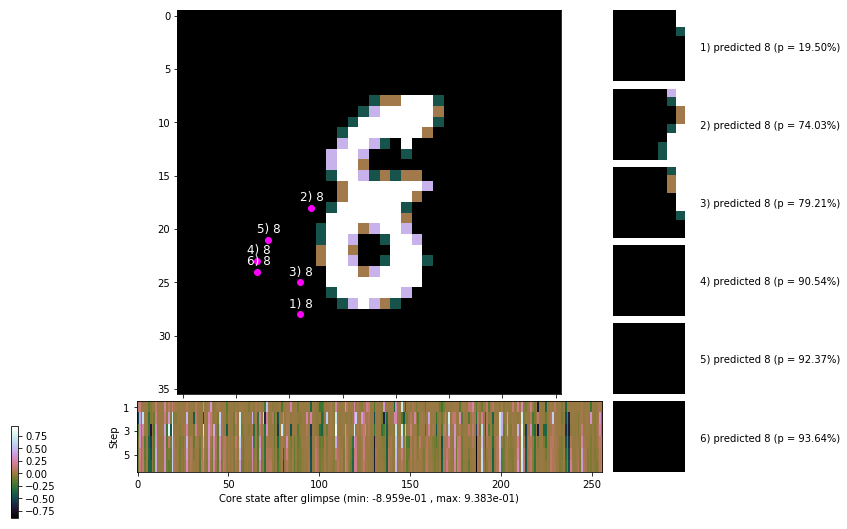

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


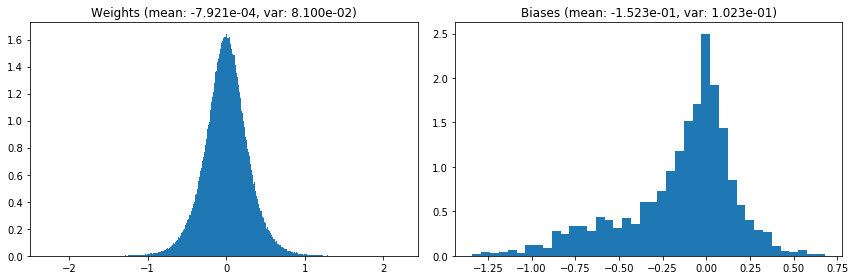

                                      Location network weights and biases


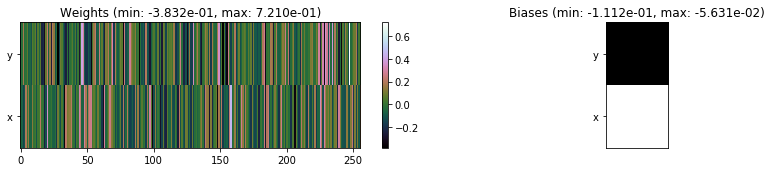

---------------------------------------------------------------------------------------------------------------
Elapsed time:  458.38 sec | TRAIN >> class loss: 0.3080 | steps:  2.182    | reward:  4.5418    | acc.: 89.898% 
                          | VAL   >> class loss: 0.3633 | steps:  2.140 :( | reward:  4.5798 :( | acc.: 88.120% :(


Epoch  64/400) lr = 0.0003885
 b    300/  3000 >> 151.2 ms/b | lr: 3.88e-04 | grad 2norm:  7.15 | grad inf norm:  2.030
         Weights || abs max:  2.27 ( 3506.14) | mean: -7.94e-04 ( 0.02) | var: 8.10e-02 (  250.08)
          Biases || abs max:  1.34 ( 1086.17) | mean: -1.52e-01 ( 0.88) | var: 1.02e-01 (146087.92)
                    class loss: 0.315 | steps: 2.197 | reward:  4.532 | acc.: 89.75%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 149.4 ms/b | lr: 3.88e-04 | grad 2norm:  7.57 | grad inf norm:  2.255
         Weights || abs max:  2.28 (11295.26) | mean: -7.86e-04 ( 

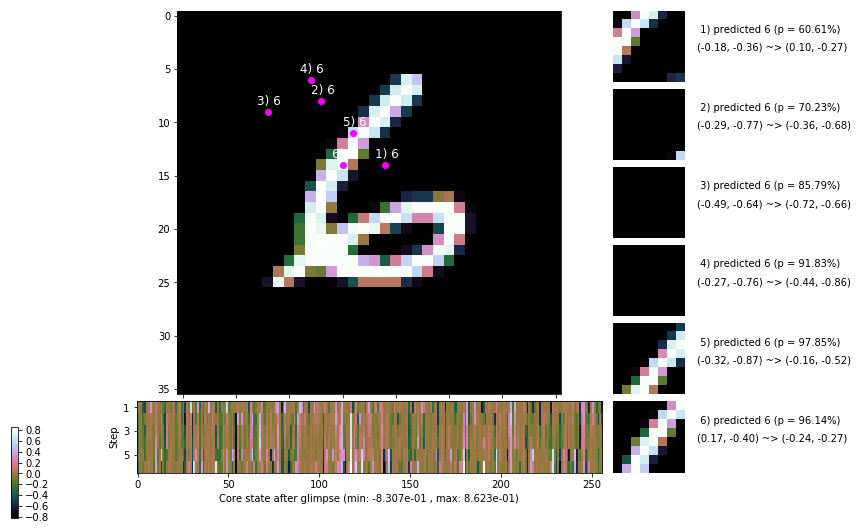

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 152.2 ms/b | lr: 3.87e-04 | grad 2norm:  7.40 | grad inf norm:  2.160
         Weights || abs max:  2.27 (10569.39) | mean: -7.90e-04 ( 0.03) | var: 8.11e-02 (10107.49)
          Biases || abs max:  1.34 (  387.24) | mean: -1.53e-01 ( 0.26) | var: 1.02e-01 ( 6149.70)
                    class loss: 0.326 | steps: 2.213 | reward:  4.494 | acc.: 89.18%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 152.0 ms/b | lr: 3.87e-04 | grad 2norm:  7.51 | grad inf norm:  2.214
         Weights || abs max:  2.27 ( 4207.70) | mean: -7.66e-04 ( 0.02) | var: 8.11e-02 (  545.20)
          Biases || abs max:  1.34 (  191.01) | mean: -1.53e-01 ( 0.19) | var: 1.02e-01 (  105.93)
                    class loss: 0.319 | steps: 2.205 | reward:  4.508 | acc.: 89.22%

	Target class: 9 | Discounted rewards: [0.111, 1.111, 1.1

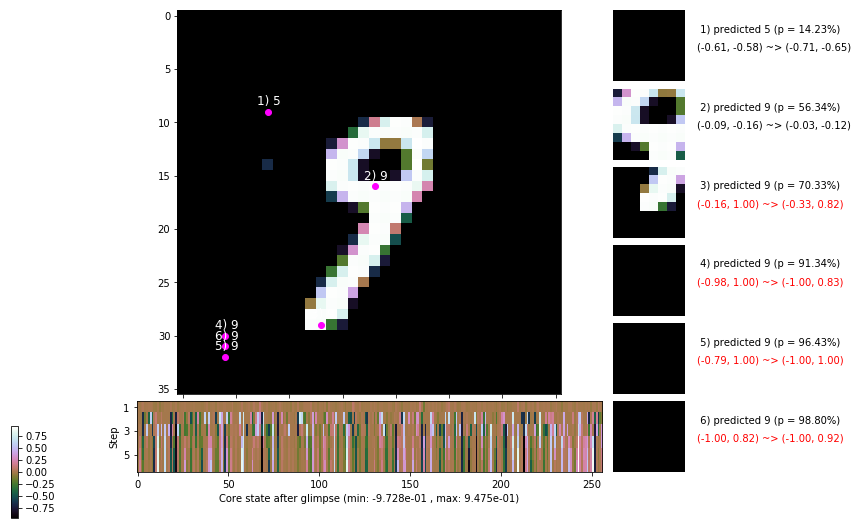

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 158.2 ms/b | lr: 3.86e-04 | grad 2norm:  7.37 | grad inf norm:  2.202
         Weights || abs max:  2.27 ( 3100.42) | mean: -7.56e-04 ( 0.02) | var: 8.11e-02 (  129.01)
          Biases || abs max:  1.33 (  419.95) | mean: -1.53e-01 ( 0.29) | var: 1.02e-01 ( 4118.46)
                    class loss: 0.301 | steps: 2.174 | reward:  4.540 | acc.: 90.18%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 162.0 ms/b | lr: 3.85e-04 | grad 2norm:  7.42 | grad inf norm:  2.084
         Weights || abs max:  2.27 ( 4154.28) | mean: -7.45e-04 ( 0.02) | var: 8.12e-02 (  502.70)
          Biases || abs max:  1.33 (  500.51) | mean: -1.53e-01 ( 0.32) | var: 1.02e-01 ( 2921.99)
                    class loss: 0.316 | steps: 2.196 | reward:  4.521 | acc.: 89.98%

	Target class: 6 | Discounted rewards: [1.111, 1.111, 1.1

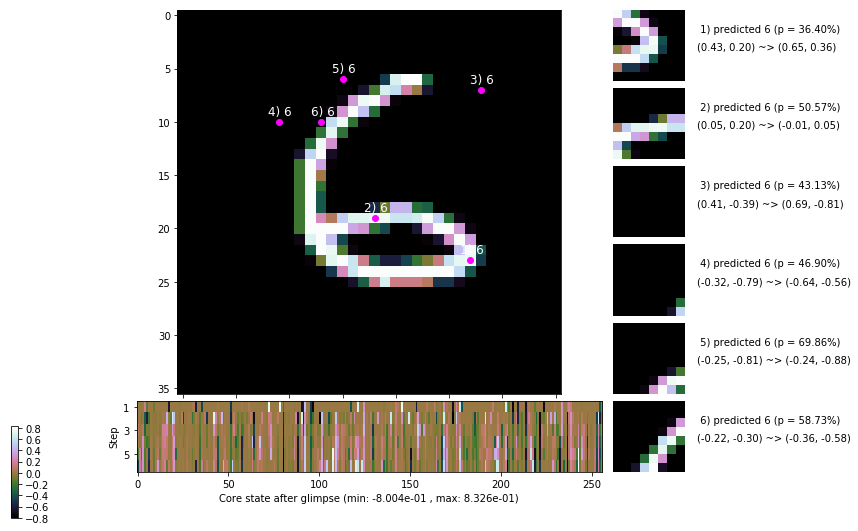

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 159.1 ms/b | lr: 3.85e-04 | grad 2norm:  7.11 | grad inf norm:  2.068
         Weights || abs max:  2.28 ( 3289.19) | mean: -7.37e-04 ( 0.02) | var: 8.12e-02 (  310.73)
          Biases || abs max:  1.32 (  136.96) | mean: -1.53e-01 ( 0.15) | var: 1.02e-01 (   49.42)
                    class loss: 0.287 | steps: 2.162 | reward:  4.564 | acc.: 90.50%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 156.5 ms/b | lr: 3.84e-04 | grad 2norm:  7.37 | grad inf norm:  2.079
         Weights || abs max:  2.28 ( 6078.38) | mean: -7.35e-04 ( 0.02) | var: 8.12e-02 ( 1577.05)
          Biases || abs max:  1.33 (  204.18) | mean: -1.53e-01 ( 0.19) | var: 1.02e-01 (  173.14)
                    class loss: 0.314 | steps: 2.213 | reward:  4.500 | acc.: 89.37%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.1

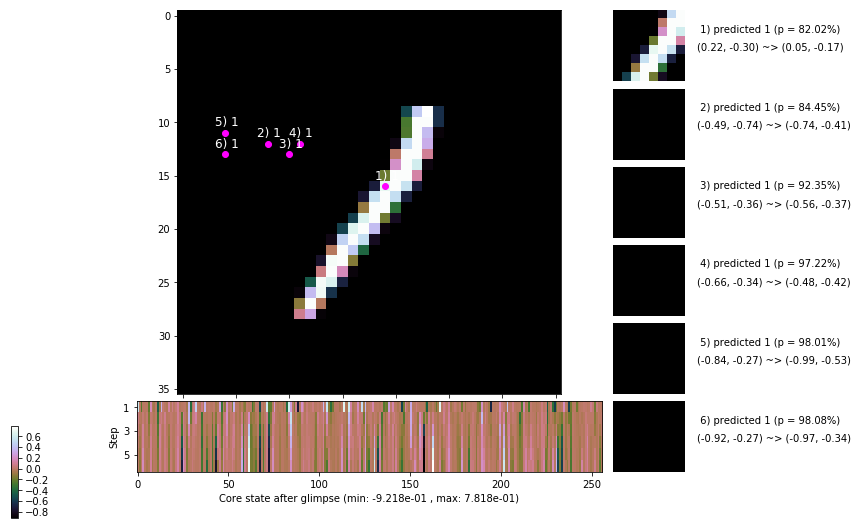

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 159.5 ms/b | lr: 3.83e-04 | grad 2norm:  7.24 | grad inf norm:  2.043
         Weights || abs max:  2.28 ( 2691.67) | mean: -7.37e-04 ( 0.02) | var: 8.12e-02 (  101.10)
          Biases || abs max:  1.34 (  145.43) | mean: -1.53e-01 ( 0.15) | var: 1.03e-01 (   94.56)
                    class loss: 0.318 | steps: 2.205 | reward:  4.519 | acc.: 89.50%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 160.7 ms/b | lr: 3.83e-04 | grad 2norm:  7.21 | grad inf norm:  2.009
         Weights || abs max:  2.28 ( 5786.73) | mean: -7.31e-04 ( 0.02) | var: 8.13e-02 (  936.25)
          Biases || abs max:  1.35 (  163.72) | mean: -1.53e-01 ( 0.17) | var: 1.02e-01 (  139.47)
                    class loss: 0.304 | steps: 2.185 | reward:  4.550 | acc.: 89.90%

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.1

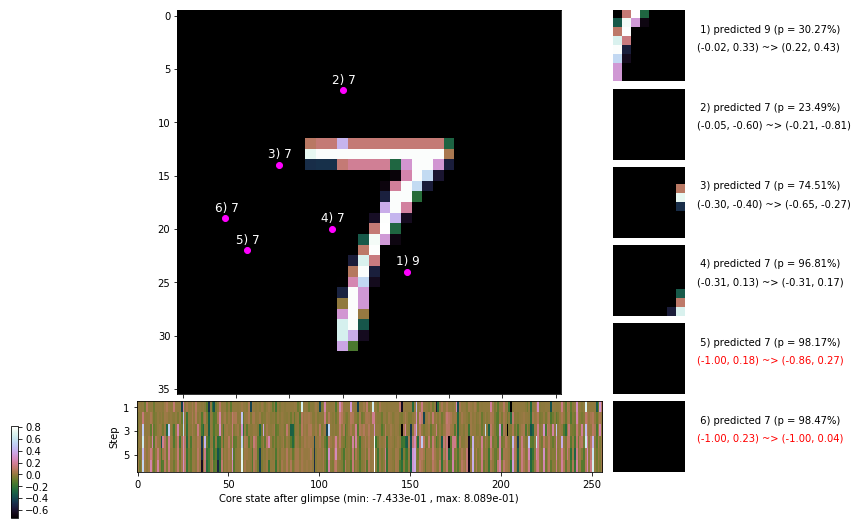

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


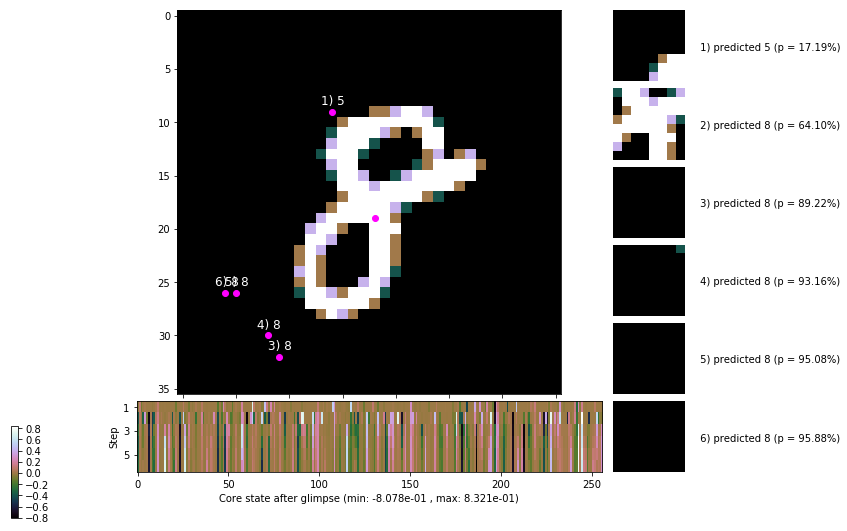


	Target class: 6 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


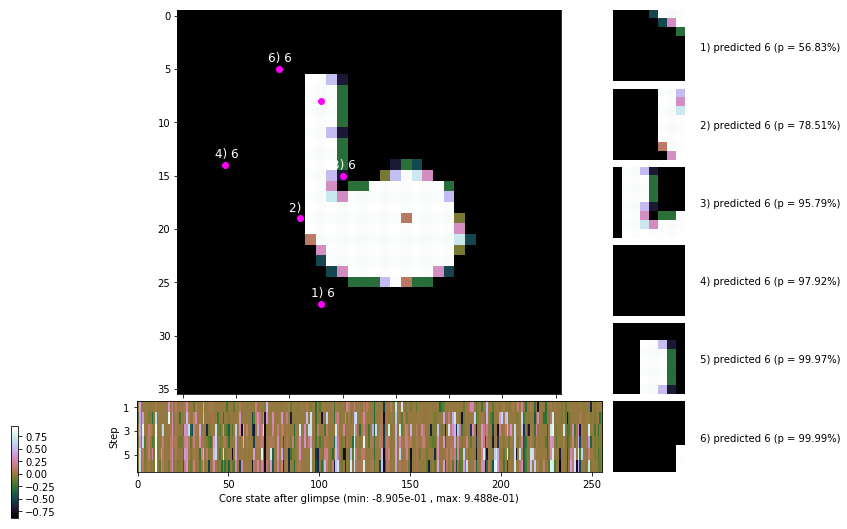

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


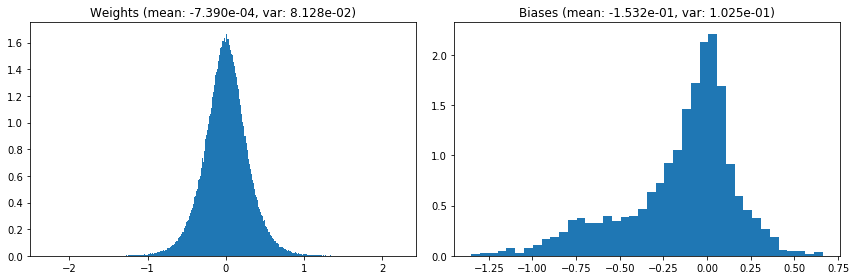

                                      Location network weights and biases


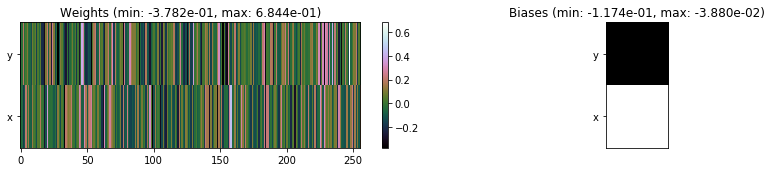

---------------------------------------------------------------------------------------------------------------
Elapsed time:  468.88 sec | TRAIN >> class loss: 0.3136 | steps:  2.198 :( | reward:  4.5212 :( | acc.: 89.633% :(
                          | VAL   >> class loss: 0.3444 | steps:  2.121 :( | reward:  4.6024 :( | acc.: 88.560% :(


Epoch  65/400) lr = 0.0003827
 b    300/  3000 >> 166.5 ms/b | lr: 3.82e-04 | grad 2norm:  7.23 | grad inf norm:  2.016
         Weights || abs max:  2.28 ( 2562.96) | mean: -7.55e-04 ( 0.02) | var: 8.13e-02 (   94.97)
          Biases || abs max:  1.35 (  331.95) | mean: -1.53e-01 ( 0.24) | var: 1.02e-01 ( 1596.78)
                    class loss: 0.335 | steps: 2.205 | reward:  4.506 | acc.: 88.85%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 161.2 ms/b | lr: 3.82e-04 | grad 2norm:  7.02 | grad inf norm:  1.998
         Weights || abs max:  2.28 ( 5060.18) | mean: -7.50e-04 (

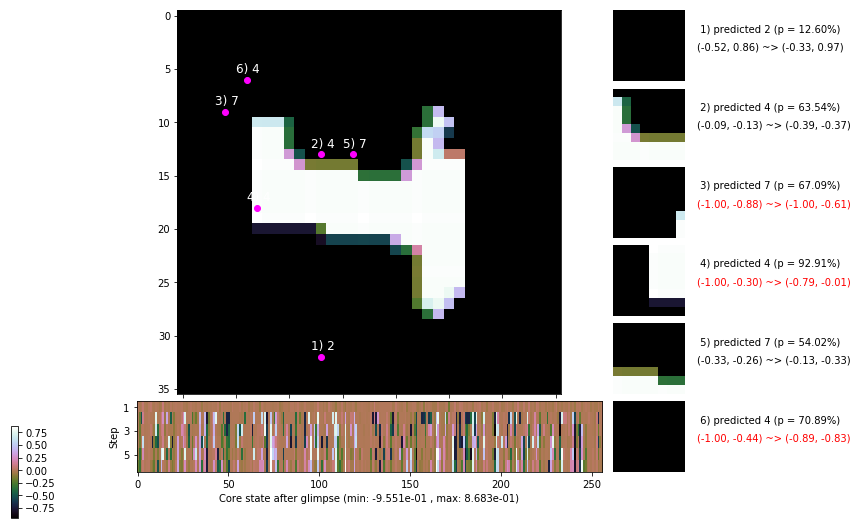

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 170.4 ms/b | lr: 3.81e-04 | grad 2norm:  7.45 | grad inf norm:  2.084
         Weights || abs max:  2.27 ( 2656.92) | mean: -7.56e-04 ( 0.01) | var: 8.14e-02 (  180.64)
          Biases || abs max:  1.35 (  264.38) | mean: -1.52e-01 ( 0.21) | var: 1.02e-01 ( 1301.50)
                    class loss: 0.302 | steps: 2.174 | reward:  4.540 | acc.: 89.72%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 163.7 ms/b | lr: 3.81e-04 | grad 2norm:  7.30 | grad inf norm:  2.152
         Weights || abs max:  2.27 ( 4225.58) | mean: -7.76e-04 ( 0.02) | var: 8.14e-02 (  662.95)
          Biases || abs max:  1.34 (  130.40) | mean: -1.53e-01 ( 0.16) | var: 1.02e-01 (  126.48)
                    class loss: 0.309 | steps: 2.175 | reward:  4.558 | acc.: 89.88%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.1

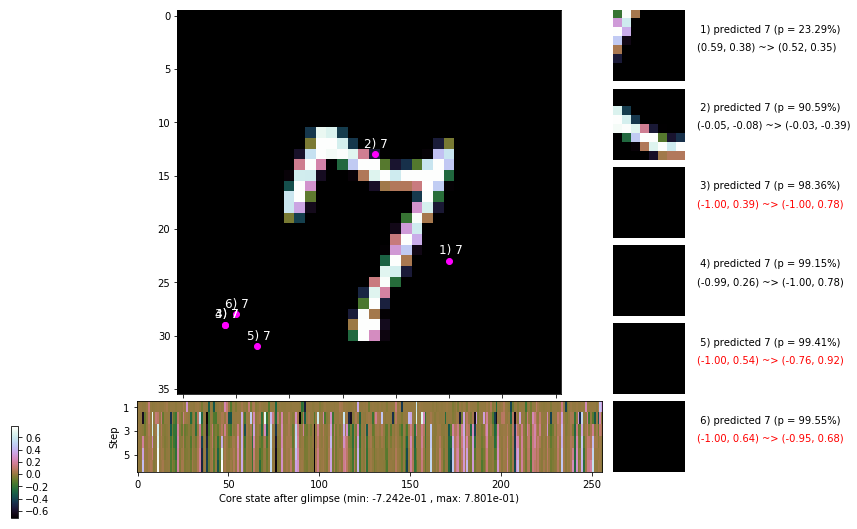

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 159.6 ms/b | lr: 3.80e-04 | grad 2norm:  7.16 | grad inf norm:  2.078
         Weights || abs max:  2.27 ( 3538.65) | mean: -7.92e-04 ( 0.02) | var: 8.14e-02 (  383.09)
          Biases || abs max:  1.34 (  223.86) | mean: -1.53e-01 ( 0.19) | var: 1.02e-01 (  369.97)
                    class loss: 0.321 | steps: 2.180 | reward:  4.548 | acc.: 89.57%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 157.6 ms/b | lr: 3.80e-04 | grad 2norm:  7.29 | grad inf norm:  2.178
         Weights || abs max:  2.27 ( 3262.68) | mean: -7.89e-04 ( 0.02) | var: 8.14e-02 (  393.19)
          Biases || abs max:  1.33 (  337.41) | mean: -1.53e-01 ( 0.27) | var: 1.03e-01 (  451.45)
                    class loss: 0.319 | steps: 2.200 | reward:  4.524 | acc.: 89.33%

	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.1

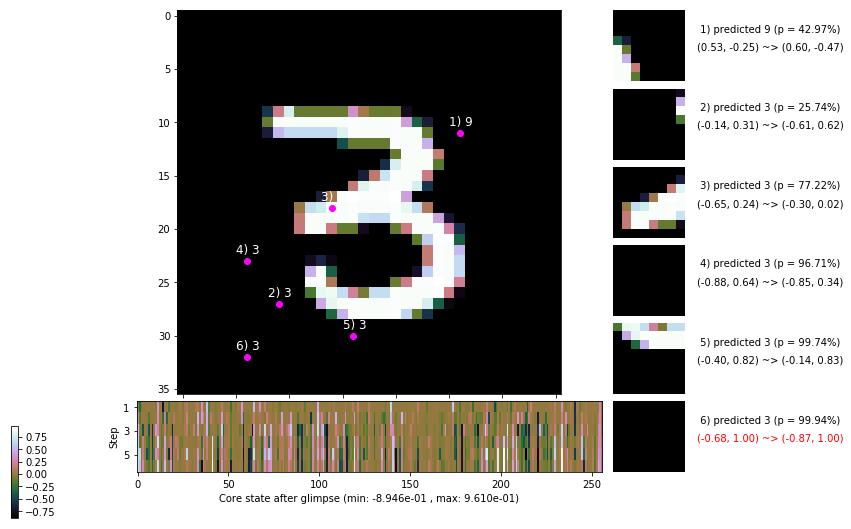

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 160.1 ms/b | lr: 3.79e-04 | grad 2norm:  7.13 | grad inf norm:  2.065
         Weights || abs max:  2.26 ( 4257.50) | mean: -7.80e-04 ( 0.02) | var: 8.15e-02 (  451.26)
          Biases || abs max:  1.33 (  581.72) | mean: -1.53e-01 ( 0.33) | var: 1.03e-01 (11596.11)
                    class loss: 0.318 | steps: 2.189 | reward:  4.538 | acc.: 89.62%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 157.4 ms/b | lr: 3.79e-04 | grad 2norm:  7.10 | grad inf norm:  2.077
         Weights || abs max:  2.26 (17295.83) | mean: -7.67e-04 ( 0.04) | var: 8.15e-02 (120396.82)
          Biases || abs max:  1.33 (  647.68) | mean: -1.53e-01 ( 0.38) | var: 1.03e-01 (11963.05)
                    class loss: 0.320 | steps: 2.218 | reward:  4.508 | acc.: 89.57%

	Target class: 8 | Discounted rewards: [0.011, 0.111, 1.

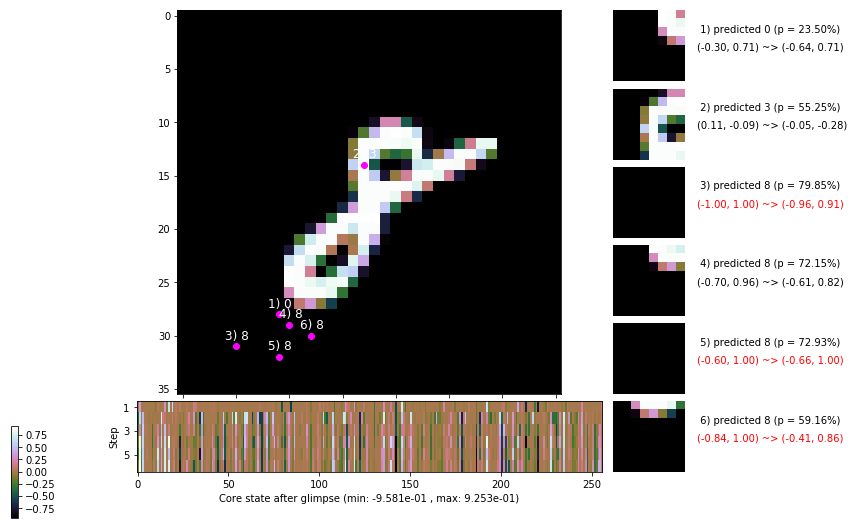

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 158.4 ms/b | lr: 3.78e-04 | grad 2norm:  7.28 | grad inf norm:  2.112
         Weights || abs max:  2.27 ( 6476.45) | mean: -7.69e-04 ( 0.02) | var: 8.15e-02 ( 5270.90)
          Biases || abs max:  1.33 (  321.93) | mean: -1.52e-01 ( 0.24) | var: 1.03e-01 ( 4525.16)
                    class loss: 0.309 | steps: 2.181 | reward:  4.537 | acc.: 89.83%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 155.3 ms/b | lr: 3.77e-04 | grad 2norm:  7.38 | grad inf norm:  2.162
         Weights || abs max:  2.26 ( 2341.15) | mean: -7.80e-04 ( 0.01) | var: 8.16e-02 (   89.26)
          Biases || abs max:  1.34 (  142.03) | mean: -1.52e-01 ( 0.16) | var: 1.03e-01 (   42.04)
                    class loss: 0.311 | steps: 2.226 | reward:  4.505 | acc.: 89.33%

	Target class: 9 | Discounted rewards: [0.000, 0.000, 0.0

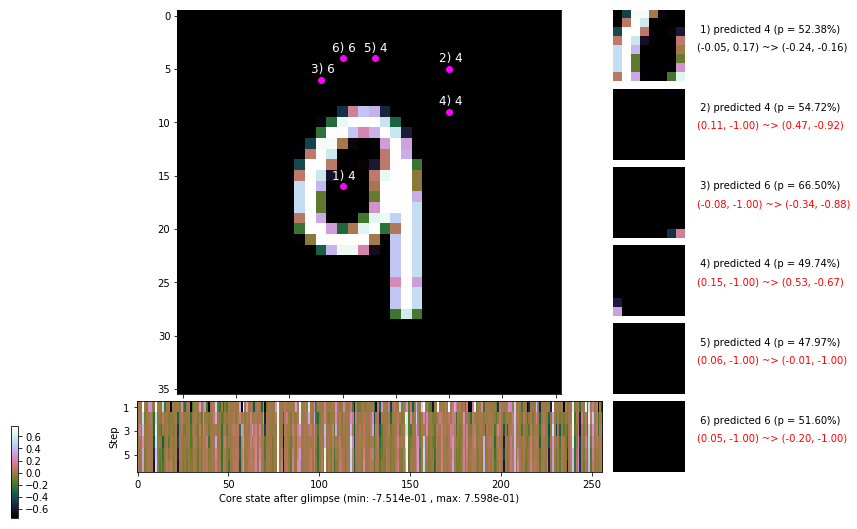

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


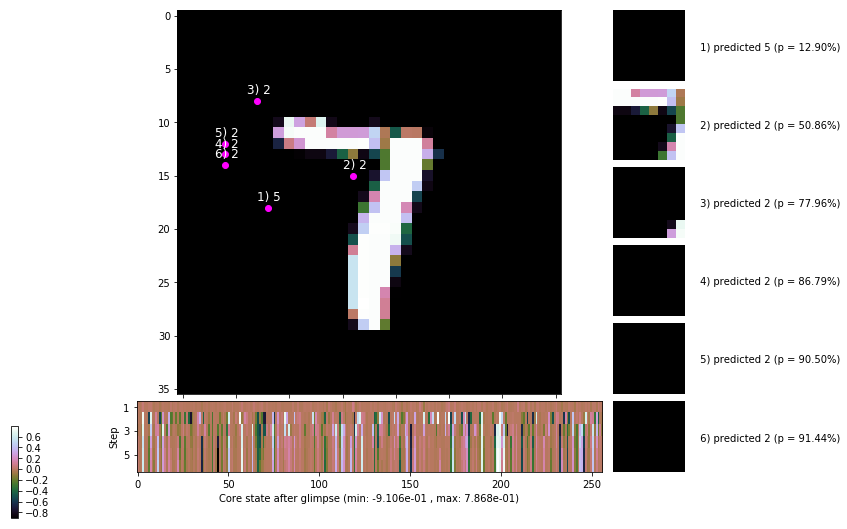


	Target class: 4 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


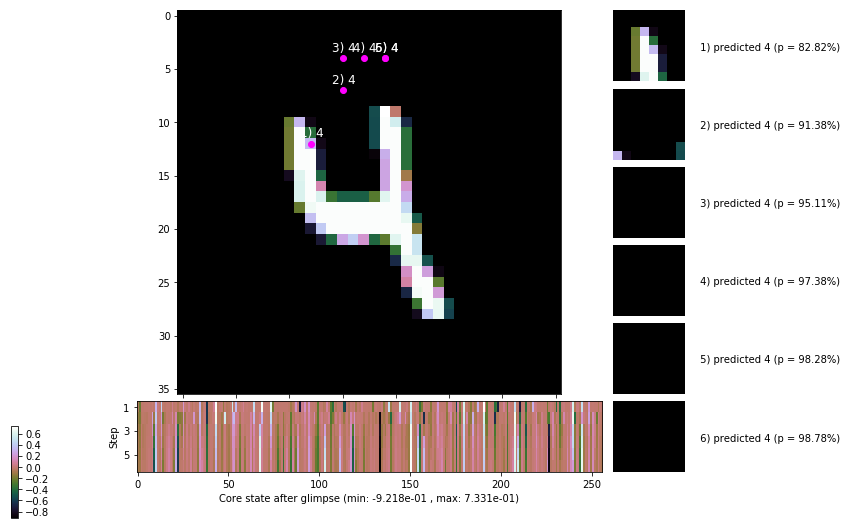

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


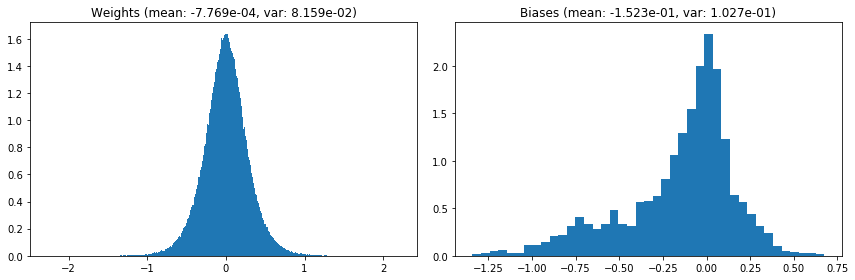

                                      Location network weights and biases


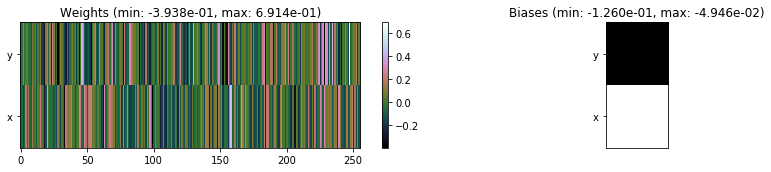

---------------------------------------------------------------------------------------------------------------
Elapsed time:  483.88 sec | TRAIN >> class loss: 0.3138 | steps:  2.195 :( | reward:  4.5296 :( | acc.: 89.572% :(
                          | VAL   >> class loss: 0.3395 | steps:  2.138 :( | reward:  4.5970 :( | acc.: 88.500% :(


Epoch  66/400) lr = 0.000377
 b    300/  3000 >> 157.7 ms/b | lr: 3.77e-04 | grad 2norm:  7.04 | grad inf norm:  2.067
         Weights || abs max:  2.26 (43959.56) | mean: -7.80e-04 ( 0.09) | var: 8.16e-02 (715477.38)
          Biases || abs max:  1.34 (  131.92) | mean: -1.52e-01 ( 0.16) | var: 1.03e-01 (  103.52)
                    class loss: 0.313 | steps: 2.218 | reward:  4.504 | acc.: 89.65%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 158.4 ms/b | lr: 3.76e-04 | grad 2norm:  7.11 | grad inf norm:  2.046
         Weights || abs max:  2.26 ( 3751.86) | mean: -7.54e-04 (

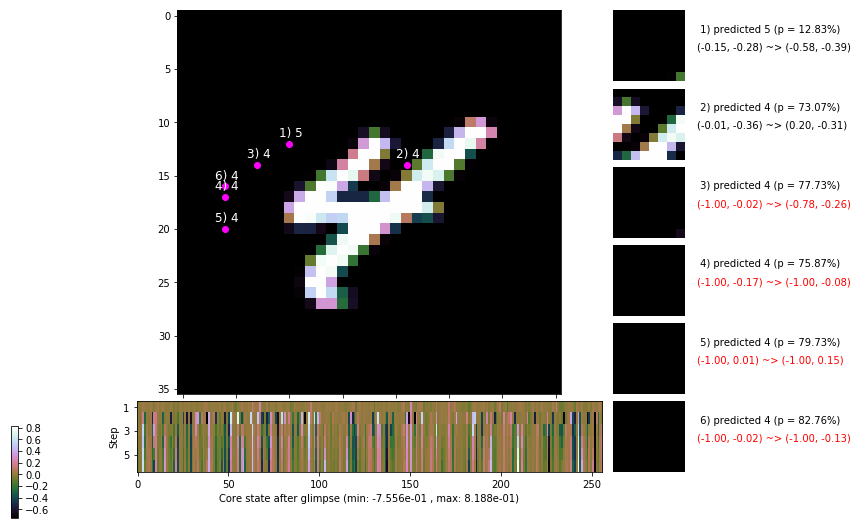

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 166.3 ms/b | lr: 3.76e-04 | grad 2norm:  7.09 | grad inf norm:  1.987
         Weights || abs max:  2.27 ( 7000.55) | mean: -7.51e-04 ( 0.02) | var: 8.17e-02 ( 2336.92)
          Biases || abs max:  1.34 ( 1314.94) | mean: -1.52e-01 ( 0.63) | var: 1.03e-01 (83647.64)
                    class loss: 0.311 | steps: 2.186 | reward:  4.547 | acc.: 89.70%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 159.1 ms/b | lr: 3.75e-04 | grad 2norm:  7.13 | grad inf norm:  2.061
         Weights || abs max:  2.28 ( 4732.63) | mean: -7.34e-04 ( 0.02) | var: 8.17e-02 ( 1001.54)
          Biases || abs max:  1.34 (  145.60) | mean: -1.52e-01 ( 0.15) | var: 1.03e-01 (  106.16)
                    class loss: 0.300 | steps: 2.200 | reward:  4.524 | acc.: 89.93%

	Target class: 2 | Discounted rewards: [0.001, 0.011, 0.1

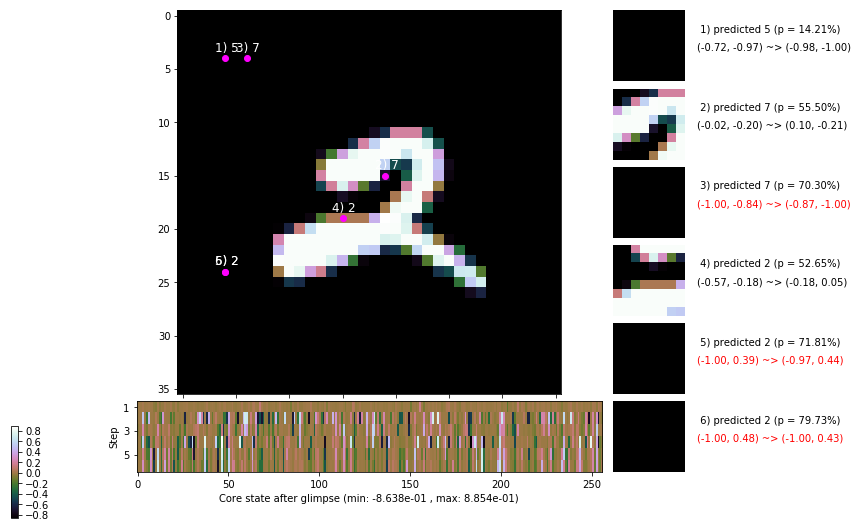

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 169.9 ms/b | lr: 3.74e-04 | grad 2norm:  7.17 | grad inf norm:  2.007
         Weights || abs max:  2.28 ( 7318.25) | mean: -7.17e-04 ( 0.03) | var: 8.17e-02 ( 1707.70)
          Biases || abs max:  1.34 (  171.35) | mean: -1.52e-01 ( 0.18) | var: 1.03e-01 (  131.38)
                    class loss: 0.279 | steps: 2.173 | reward:  4.568 | acc.: 90.67%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 159.0 ms/b | lr: 3.74e-04 | grad 2norm:  7.30 | grad inf norm:  2.060
         Weights || abs max:  2.28 ( 3426.84) | mean: -7.20e-04 ( 0.02) | var: 8.18e-02 (  171.92)
          Biases || abs max:  1.34 (  565.14) | mean: -1.52e-01 ( 0.33) | var: 1.03e-01 ( 8846.05)
                    class loss: 0.307 | steps: 2.196 | reward:  4.528 | acc.: 89.52%

	Target class: 6 | Discounted rewards: [0.111, 1.111, 1.1

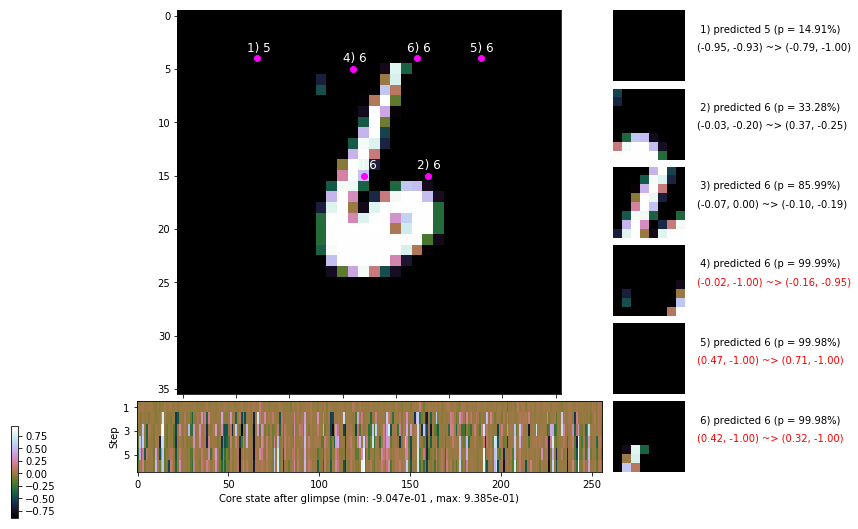

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 165.1 ms/b | lr: 3.73e-04 | grad 2norm:  7.37 | grad inf norm:  2.063
         Weights || abs max:  2.27 ( 2983.75) | mean: -7.51e-04 ( 0.02) | var: 8.18e-02 (  208.75)
          Biases || abs max:  1.34 (  273.33) | mean: -1.52e-01 ( 0.22) | var: 1.03e-01 (  632.20)
                    class loss: 0.296 | steps: 2.189 | reward:  4.555 | acc.: 90.48%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.7 ms/b | lr: 3.73e-04 | grad 2norm:  7.09 | grad inf norm:  1.976
         Weights || abs max:  2.27 ( 3947.32) | mean: -7.52e-04 ( 0.02) | var: 8.18e-02 ( 1067.64)
          Biases || abs max:  1.34 (  261.36) | mean: -1.52e-01 ( 0.21) | var: 1.03e-01 ( 1400.90)
                    class loss: 0.283 | steps: 2.162 | reward:  4.583 | acc.: 91.08%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.1

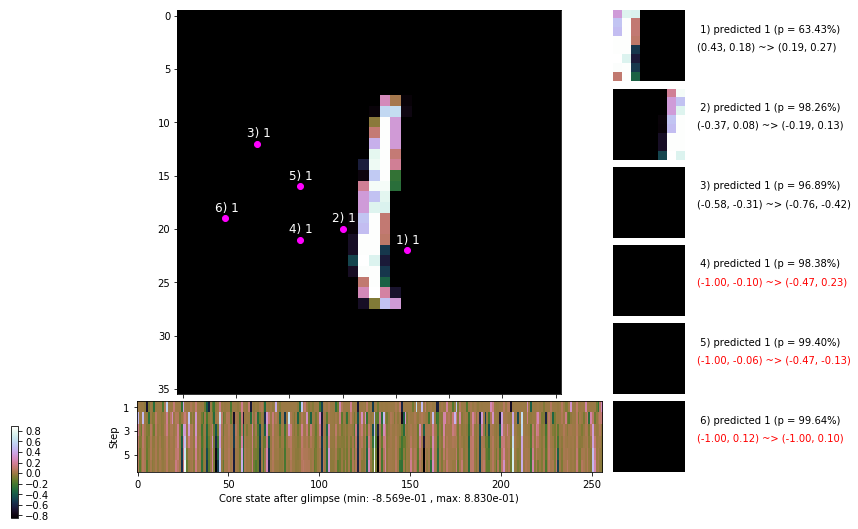

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 152.9 ms/b | lr: 3.72e-04 | grad 2norm:  7.44 | grad inf norm:  2.052
         Weights || abs max:  2.28 ( 7859.58) | mean: -7.45e-04 ( 0.03) | var: 8.18e-02 ( 3969.85)
          Biases || abs max:  1.34 (   98.41) | mean: -1.53e-01 ( 0.14) | var: 1.03e-01 (   72.24)
                    class loss: 0.312 | steps: 2.170 | reward:  4.561 | acc.: 90.02%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 147.9 ms/b | lr: 3.72e-04 | grad 2norm:  7.37 | grad inf norm:  2.115
         Weights || abs max:  2.28 ( 6794.10) | mean: -7.33e-04 ( 0.02) | var: 8.19e-02 ( 4569.71)
          Biases || abs max:  1.33 (  130.29) | mean: -1.53e-01 ( 0.15) | var: 1.03e-01 (   68.69)
                    class loss: 0.327 | steps: 2.168 | reward:  4.525 | acc.: 88.77%

	Target class: 8 | Discounted rewards: [1.111, 1.111, 1.1

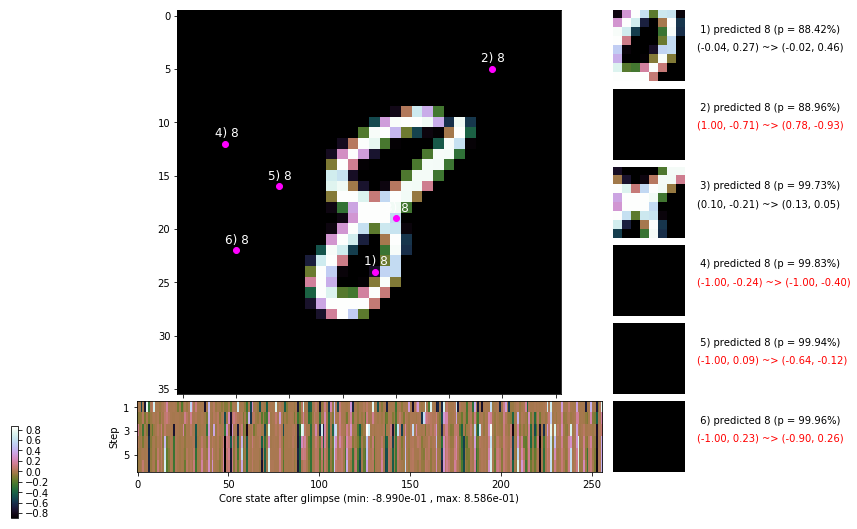

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [1.011, 0.111, 1.111, 1.110, 1.100, 1.000]


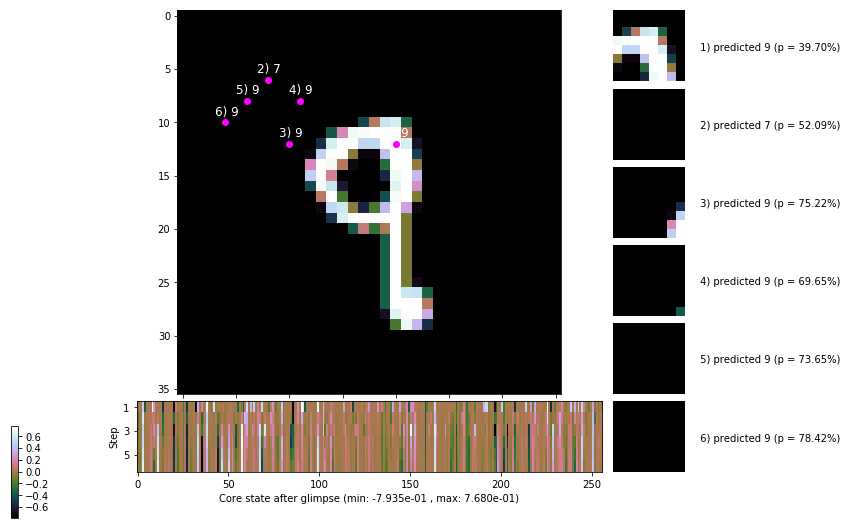


	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


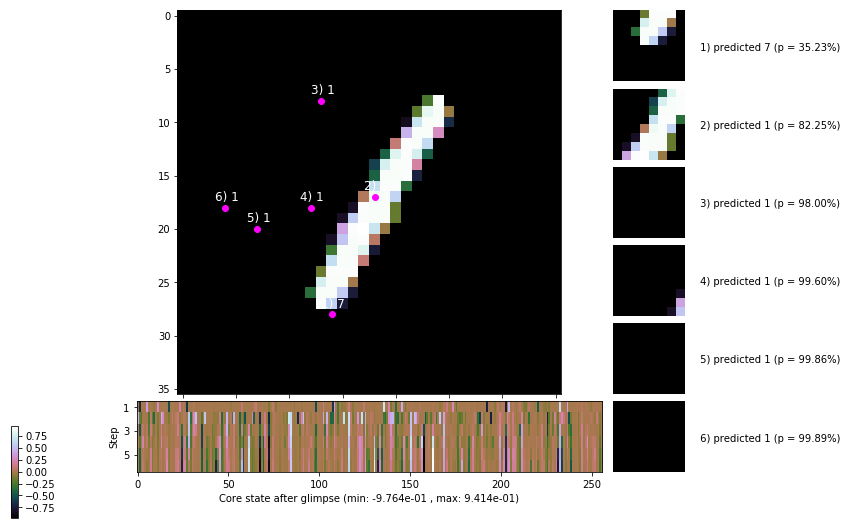

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


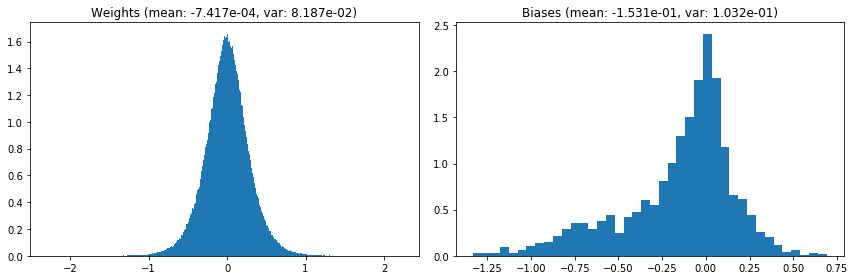

                                      Location network weights and biases


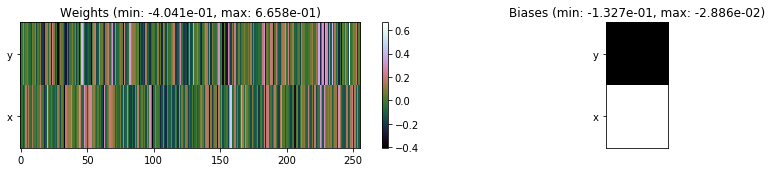

---------------------------------------------------------------------------------------------------------------
Elapsed time:  477.80 sec | TRAIN >> class loss: 0.3031 | steps:  2.187 :( | reward:  4.5430    | acc.: 89.942% 
                          | VAL   >> class loss: 0.3454 | steps:  2.134 :( | reward:  4.6030 :( | acc.: 88.420% :(


Epoch  67/400) lr = 0.0003714
 b    300/  3000 >> 150.4 ms/b | lr: 3.71e-04 | grad 2norm:  7.13 | grad inf norm:  2.096
         Weights || abs max:  2.29 ( 3614.41) | mean: -7.34e-04 ( 0.02) | var: 8.19e-02 (  256.42)
          Biases || abs max:  1.33 (  212.45) | mean: -1.53e-01 ( 0.19) | var: 1.03e-01 (  172.12)
                    class loss: 0.303 | steps: 2.188 | reward:  4.558 | acc.: 90.05%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 148.3 ms/b | lr: 3.71e-04 | grad 2norm:  7.55 | grad inf norm:  2.177
         Weights || abs max:  2.29 ( 5273.17) | mean: -7.26e-04 ( 0

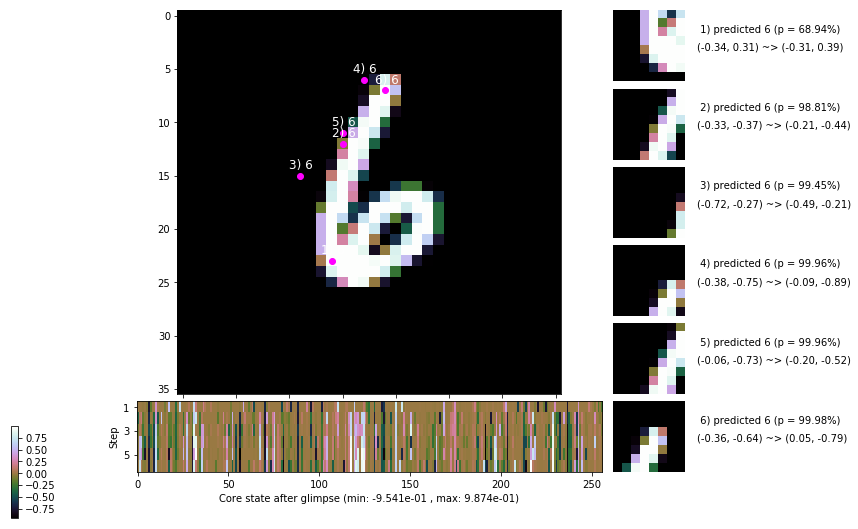

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 154.5 ms/b | lr: 3.70e-04 | grad 2norm:  7.37 | grad inf norm:  2.177
         Weights || abs max:  2.29 ( 6042.53) | mean: -7.42e-04 ( 0.02) | var: 8.20e-02 ( 1234.54)
          Biases || abs max:  1.33 (  159.41) | mean: -1.52e-01 ( 0.16) | var: 1.03e-01 (  102.14)
                    class loss: 0.314 | steps: 2.205 | reward:  4.516 | acc.: 89.92%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 150.0 ms/b | lr: 3.70e-04 | grad 2norm:  7.27 | grad inf norm:  2.076
         Weights || abs max:  2.29 (32029.71) | mean: -7.32e-04 ( 0.07) | var: 8.20e-02 (400660.88)
          Biases || abs max:  1.34 (  193.42) | mean: -1.52e-01 ( 0.19) | var: 1.03e-01 (  363.26)
                    class loss: 0.295 | steps: 2.170 | reward:  4.561 | acc.: 90.03%

	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.

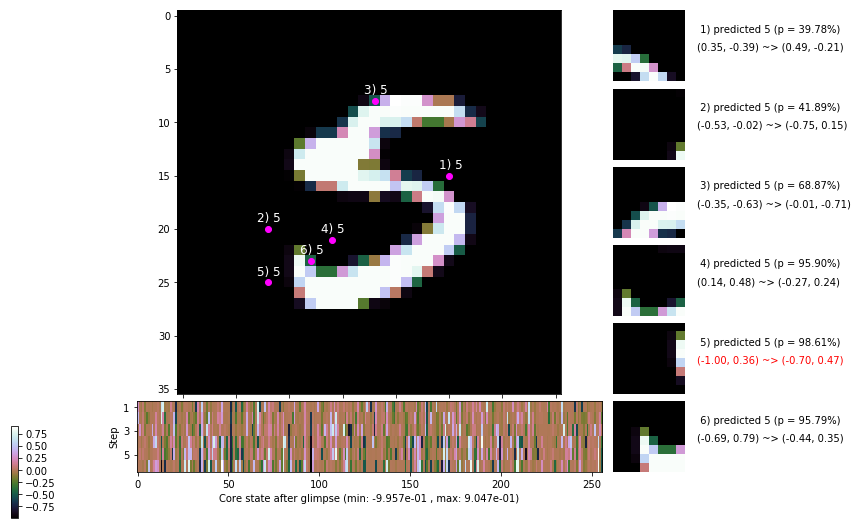

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.1 ms/b | lr: 3.69e-04 | grad 2norm:  7.16 | grad inf norm:  2.064
         Weights || abs max:  2.29 ( 7717.94) | mean: -7.32e-04 ( 0.03) | var: 8.20e-02 ( 4371.14)
          Biases || abs max:  1.33 (  152.37) | mean: -1.53e-01 ( 0.17) | var: 1.03e-01 (  167.34)
                    class loss: 0.311 | steps: 2.186 | reward:  4.530 | acc.: 89.77%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 150.7 ms/b | lr: 3.68e-04 | grad 2norm:  7.27 | grad inf norm:  2.133
         Weights || abs max:  2.30 ( 2580.22) | mean: -7.28e-04 ( 0.02) | var: 8.20e-02 (  163.29)
          Biases || abs max:  1.33 (  340.06) | mean: -1.53e-01 ( 0.25) | var: 1.03e-01 (  890.51)
                    class loss: 0.310 | steps: 2.187 | reward:  4.545 | acc.: 89.87%

	Target class: 6 | Discounted rewards: [0.111, 1.111, 1.1

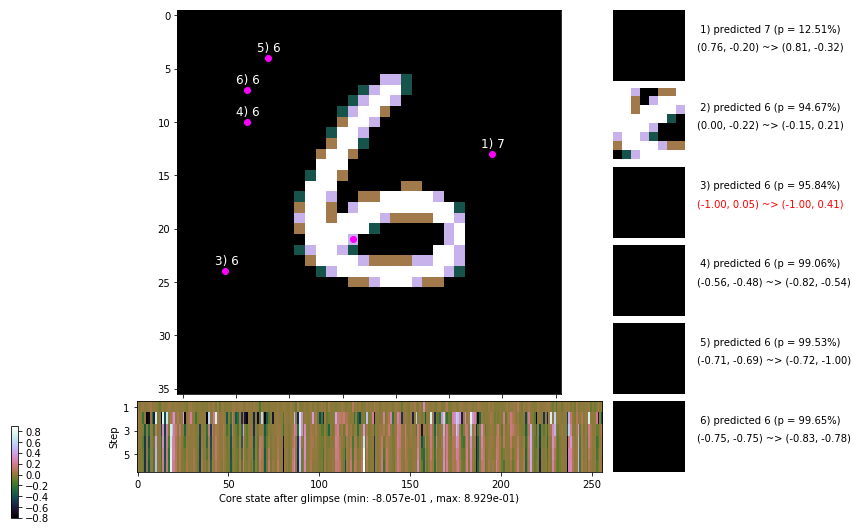

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 152.8 ms/b | lr: 3.68e-04 | grad 2norm:  7.34 | grad inf norm:  2.120
         Weights || abs max:  2.29 ( 3320.43) | mean: -7.07e-04 ( 0.02) | var: 8.21e-02 (  230.68)
          Biases || abs max:  1.33 (  162.59) | mean: -1.53e-01 ( 0.15) | var: 1.03e-01 (  130.46)
                    class loss: 0.301 | steps: 2.183 | reward:  4.541 | acc.: 89.53%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 161.1 ms/b | lr: 3.67e-04 | grad 2norm:  7.17 | grad inf norm:  2.100
         Weights || abs max:  2.29 ( 8898.29) | mean: -7.31e-04 ( 0.03) | var: 8.21e-02 (17332.29)
          Biases || abs max:  1.34 (  217.57) | mean: -1.53e-01 ( 0.18) | var: 1.03e-01 (  258.19)
                    class loss: 0.302 | steps: 2.197 | reward:  4.519 | acc.: 89.75%

	Target class: 9 | Discounted rewards: [1.000, 0.000, 0.0

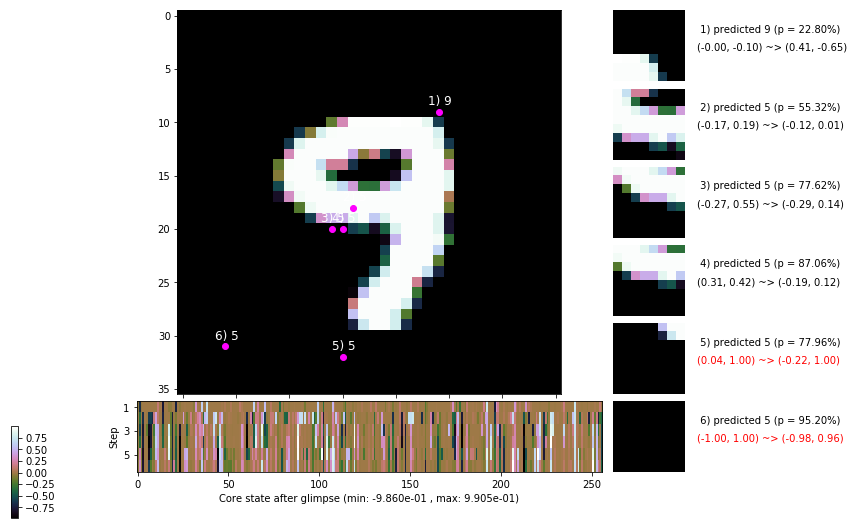

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 164.0 ms/b | lr: 3.67e-04 | grad 2norm:  7.25 | grad inf norm:  2.133
         Weights || abs max:  2.30 ( 4551.10) | mean: -7.59e-04 ( 0.02) | var: 8.21e-02 ( 1401.81)
          Biases || abs max:  1.35 (  133.82) | mean: -1.52e-01 ( 0.14) | var: 1.03e-01 (   69.93)
                    class loss: 0.311 | steps: 2.205 | reward:  4.526 | acc.: 89.48%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 166.2 ms/b | lr: 3.66e-04 | grad 2norm:  7.17 | grad inf norm:  2.066
         Weights || abs max:  2.30 ( 5337.93) | mean: -7.61e-04 ( 0.02) | var: 8.22e-02 ( 1002.23)
          Biases || abs max:  1.34 (  193.96) | mean: -1.52e-01 ( 0.16) | var: 1.03e-01 (  436.12)
                    class loss: 0.307 | steps: 2.167 | reward:  4.563 | acc.: 89.83%

	Target class: 1 | Discounted rewards: [0.011, 0.111, 1.1

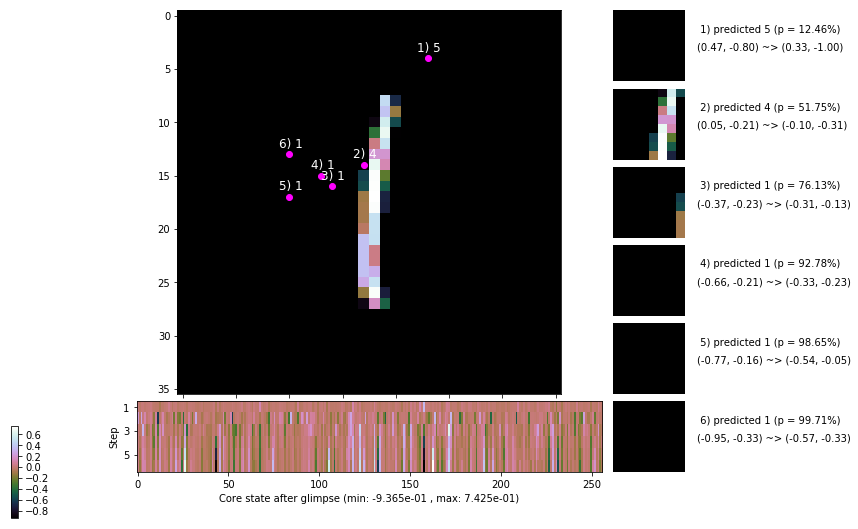

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


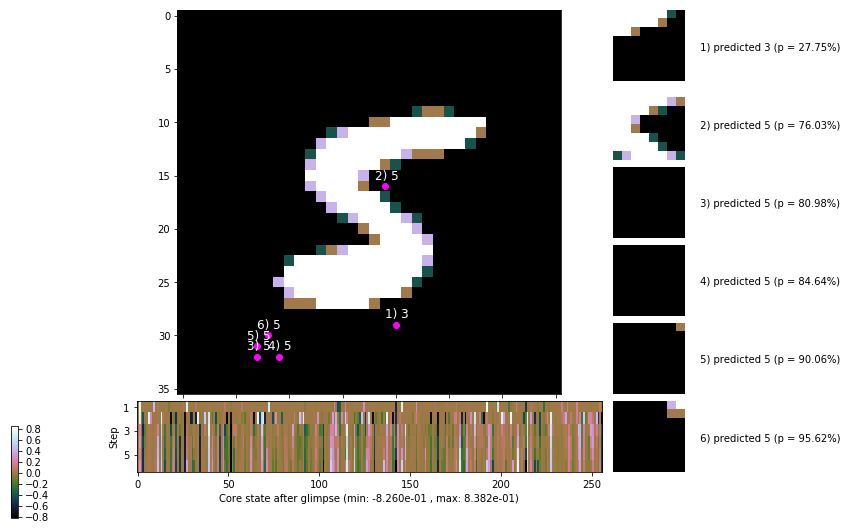


	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


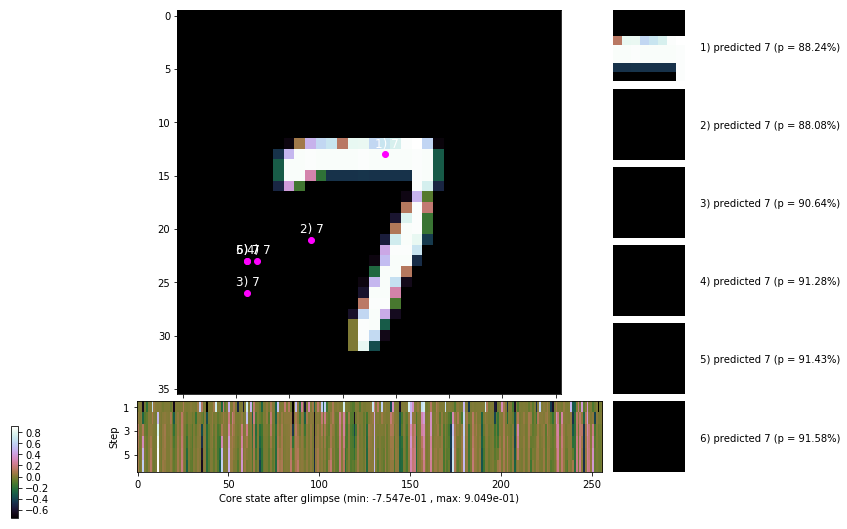

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


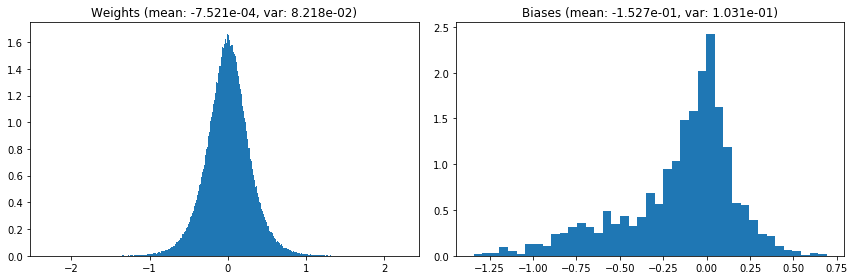

                                      Location network weights and biases


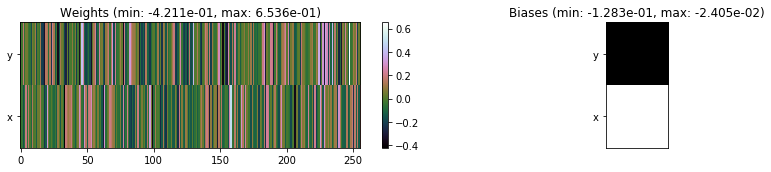

---------------------------------------------------------------------------------------------------------------
Elapsed time:  466.34 sec | TRAIN >> class loss: 0.3065 | steps:  2.187 :( | reward:  4.5385 :( | acc.: 89.748% :(
                          | VAL   >> class loss: 0.3497 | steps:  2.106    | reward:  4.6138 :( | acc.: 88.520% :(


Epoch  68/400) lr = 0.0003659
 b    300/  3000 >> 165.5 ms/b | lr: 3.65e-04 | grad 2norm:  7.24 | grad inf norm:  2.136
         Weights || abs max:  2.31 ( 6017.41) | mean: -7.64e-04 ( 0.02) | var: 8.22e-02 ( 5783.80)
          Biases || abs max:  1.34 (  407.65) | mean: -1.53e-01 ( 0.26) | var: 1.03e-01 ( 1985.38)
                    class loss: 0.316 | steps: 2.169 | reward:  4.567 | acc.: 89.52%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 158.6 ms/b | lr: 3.65e-04 | grad 2norm:  7.18 | grad inf norm:  2.128
         Weights || abs max:  2.31 ( 5059.02) | mean: -7.70e-04 (

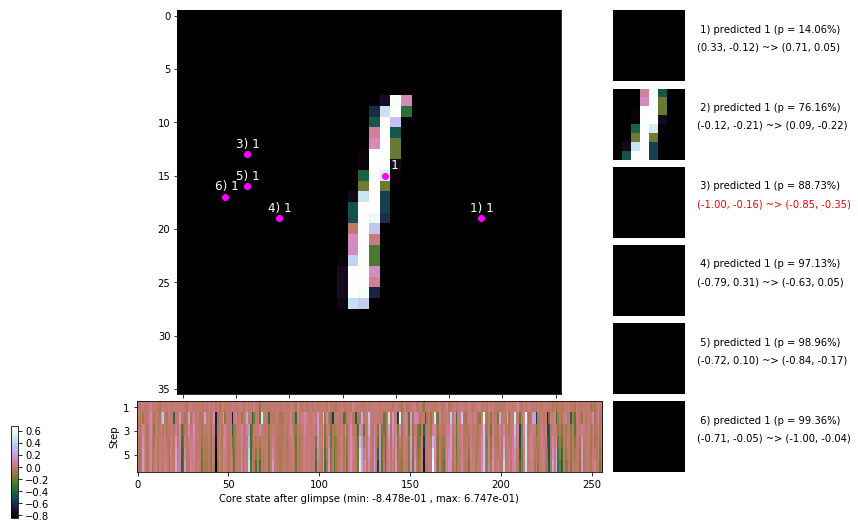

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 160.8 ms/b | lr: 3.64e-04 | grad 2norm:  7.25 | grad inf norm:  2.110
         Weights || abs max:  2.31 ( 6917.15) | mean: -7.86e-04 ( 0.02) | var: 8.23e-02 ( 2404.93)
          Biases || abs max:  1.33 (  297.29) | mean: -1.53e-01 ( 0.22) | var: 1.03e-01 ( 1276.34)
                    class loss: 0.321 | steps: 2.199 | reward:  4.547 | acc.: 89.82%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 157.5 ms/b | lr: 3.64e-04 | grad 2norm:  7.36 | grad inf norm:  2.054
         Weights || abs max:  2.31 ( 8475.98) | mean: -7.76e-04 ( 0.03) | var: 8.23e-02 (10687.44)
          Biases || abs max:  1.34 (  244.49) | mean: -1.53e-01 ( 0.21) | var: 1.03e-01 (  878.05)
                    class loss: 0.327 | steps: 2.199 | reward:  4.519 | acc.: 88.95%

	Target class: 3 | Discounted rewards: [0.000, 0.000, 0.0

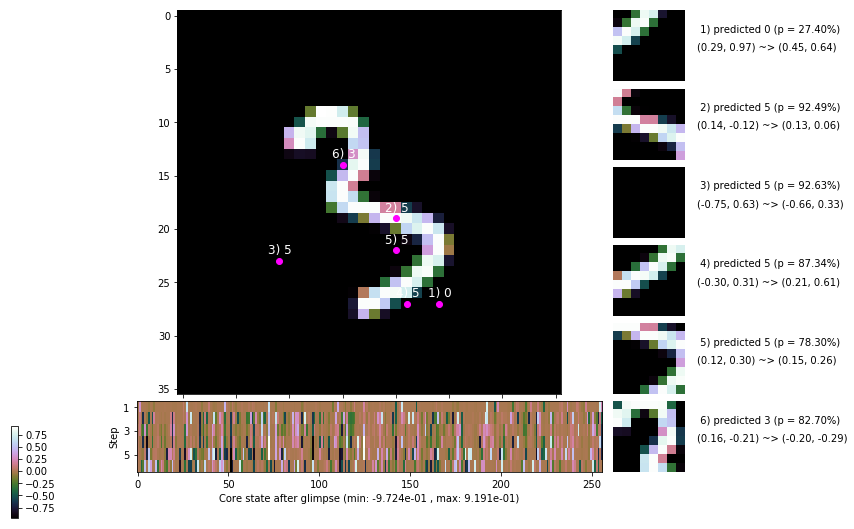

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 158.8 ms/b | lr: 3.63e-04 | grad 2norm:  6.97 | grad inf norm:  2.002
         Weights || abs max:  2.31 ( 4703.51) | mean: -7.45e-04 ( 0.02) | var: 8.23e-02 (  467.97)
          Biases || abs max:  1.35 (  135.89) | mean: -1.53e-01 ( 0.15) | var: 1.03e-01 (  161.47)
                    class loss: 0.298 | steps: 2.184 | reward:  4.564 | acc.: 90.10%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 156.3 ms/b | lr: 3.63e-04 | grad 2norm:  7.09 | grad inf norm:  2.003
         Weights || abs max:  2.31 (12972.67) | mean: -7.54e-04 ( 0.03) | var: 8.23e-02 (47291.81)
          Biases || abs max:  1.35 (  124.08) | mean: -1.53e-01 ( 0.15) | var: 1.03e-01 (   56.93)
                    class loss: 0.309 | steps: 2.163 | reward:  4.562 | acc.: 89.80%

	Target class: 2 | Discounted rewards: [0.000, 0.001, 0.0

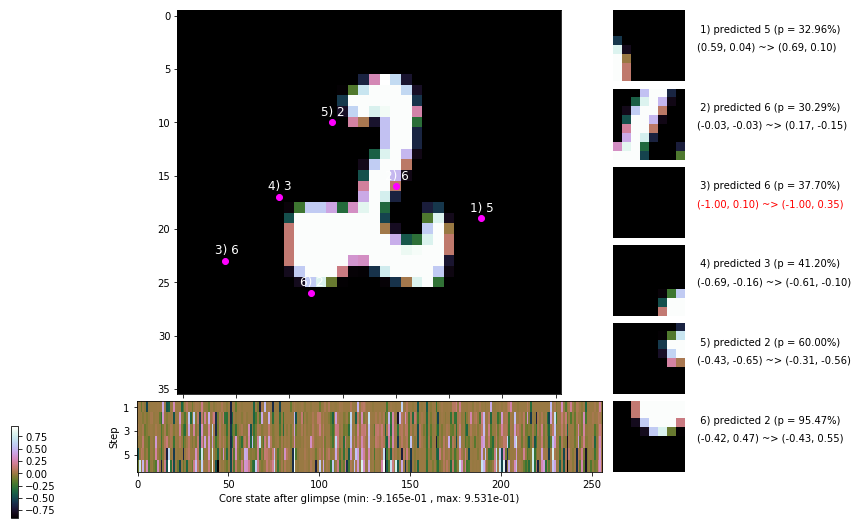

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 160.6 ms/b | lr: 3.62e-04 | grad 2norm:  7.12 | grad inf norm:  2.073
         Weights || abs max:  2.31 ( 3912.89) | mean: -7.62e-04 ( 0.02) | var: 8.24e-02 (  359.22)
          Biases || abs max:  1.34 (  125.21) | mean: -1.53e-01 ( 0.14) | var: 1.03e-01 (  111.90)
                    class loss: 0.308 | steps: 2.199 | reward:  4.535 | acc.: 89.78%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 163.5 ms/b | lr: 3.62e-04 | grad 2norm:  7.39 | grad inf norm:  2.202
         Weights || abs max:  2.31 ( 8640.38) | mean: -7.95e-04 ( 0.03) | var: 8.24e-02 (20494.31)
          Biases || abs max:  1.34 (  199.92) | mean: -1.54e-01 ( 0.18) | var: 1.03e-01 (  399.59)
                    class loss: 0.337 | steps: 2.211 | reward:  4.515 | acc.: 89.07%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.1

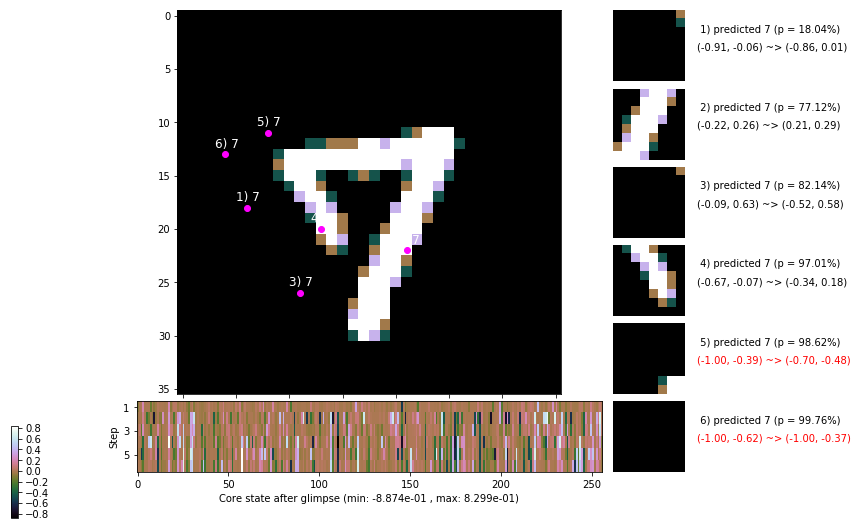

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 162.6 ms/b | lr: 3.61e-04 | grad 2norm:  7.35 | grad inf norm:  2.151
         Weights || abs max:  2.31 ( 4629.53) | mean: -8.14e-04 ( 0.02) | var: 8.24e-02 ( 2313.54)
          Biases || abs max:  1.34 (  326.12) | mean: -1.54e-01 ( 0.23) | var: 1.03e-01 (  753.13)
                    class loss: 0.329 | steps: 2.179 | reward:  4.518 | acc.: 89.02%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 164.8 ms/b | lr: 3.61e-04 | grad 2norm:  7.07 | grad inf norm:  2.033
         Weights || abs max:  2.31 ( 4605.04) | mean: -8.14e-04 ( 0.02) | var: 8.24e-02 (  455.28)
          Biases || abs max:  1.34 (  230.35) | mean: -1.54e-01 ( 0.19) | var: 1.03e-01 (  446.39)
                    class loss: 0.292 | steps: 2.126 | reward:  4.592 | acc.: 89.83%

	Target class: 7 | Discounted rewards: [0.011, 0.111, 1.1

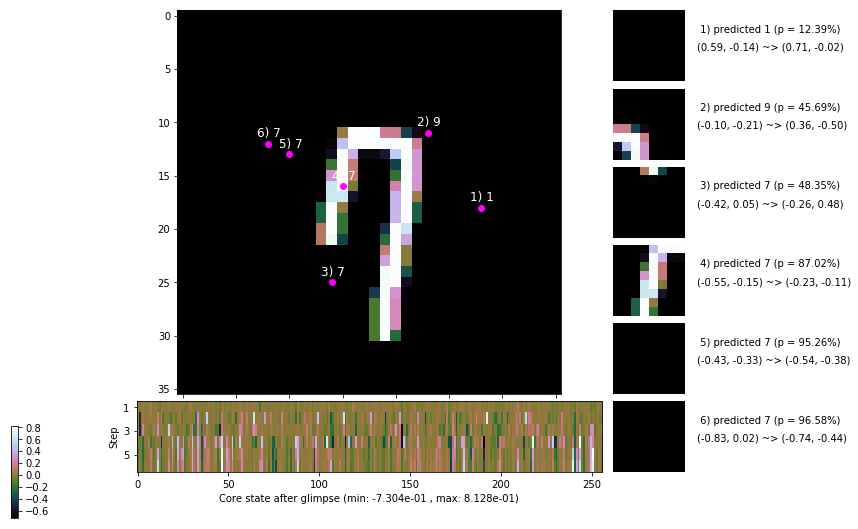

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


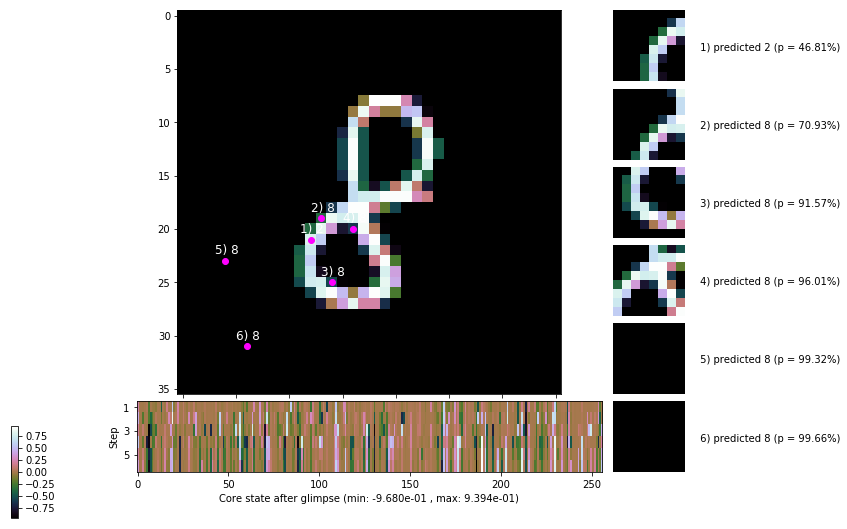


	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


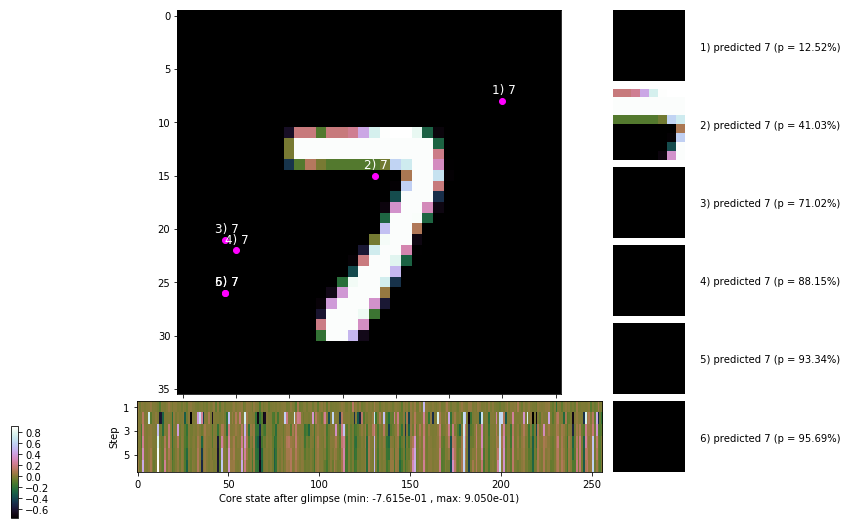

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


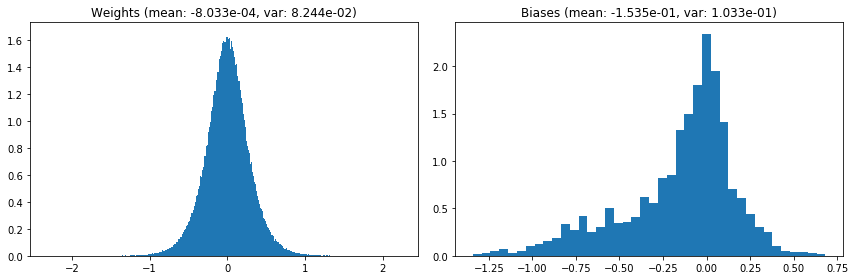

                                      Location network weights and biases


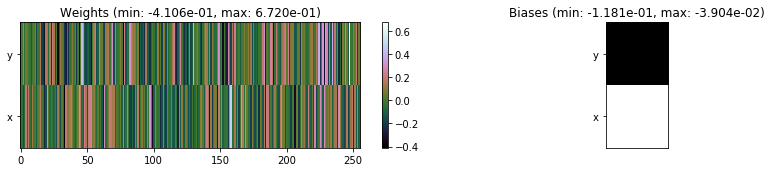

---------------------------------------------------------------------------------------------------------------
Elapsed time:  483.59 sec | TRAIN >> class loss: 0.3146 | steps:  2.183 :( | reward:  4.5455    | acc.: 89.550% :(
                          | VAL   >> class loss: 0.3395 | steps:  2.113 :( | reward:  4.6074 :( | acc.: 88.680% :(


Epoch  69/400) lr = 0.0003604
 b    300/  3000 >> 164.0 ms/b | lr: 3.60e-04 | grad 2norm:  7.32 | grad inf norm:  2.122
         Weights || abs max:  2.31 ( 5483.47) | mean: -7.97e-04 ( 0.02) | var: 8.25e-02 ( 1157.40)
          Biases || abs max:  1.34 (  152.66) | mean: -1.53e-01 ( 0.15) | var: 1.03e-01 (  127.57)
                    class loss: 0.304 | steps: 2.183 | reward:  4.558 | acc.: 90.07%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 157.7 ms/b | lr: 3.60e-04 | grad 2norm:  7.02 | grad inf norm:  2.037
         Weights || abs max:  2.31 (19203.42) | mean: -7.98e-04 (

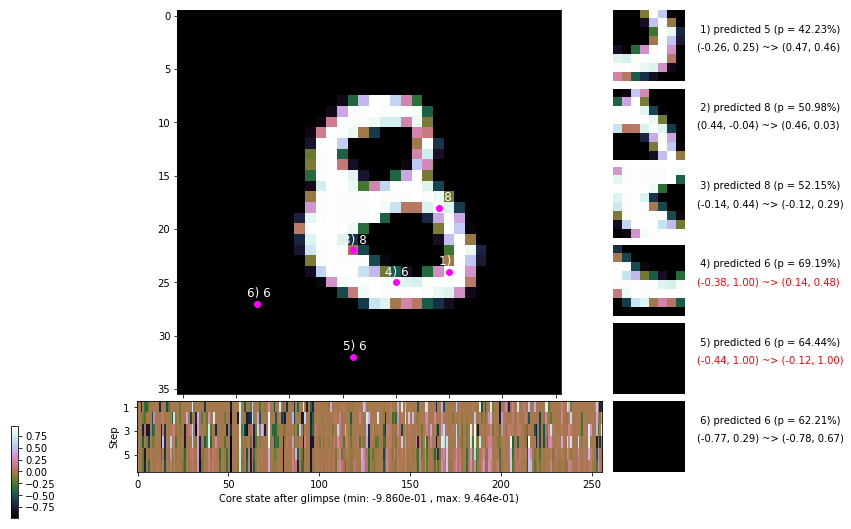

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 161.7 ms/b | lr: 3.59e-04 | grad 2norm:  7.19 | grad inf norm:  2.045
         Weights || abs max:  2.31 ( 4231.15) | mean: -8.08e-04 ( 0.02) | var: 8.25e-02 (  408.09)
          Biases || abs max:  1.34 (28898.24) | mean: -1.54e-01 (11.32) | var: 1.03e-01 (96586752.00)
                    class loss: 0.306 | steps: 2.179 | reward:  4.561 | acc.: 89.75%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 155.9 ms/b | lr: 3.59e-04 | grad 2norm:  7.58 | grad inf norm:  2.096
         Weights || abs max:  2.31 ( 3408.44) | mean: -8.04e-04 ( 0.02) | var: 8.25e-02 (  598.84)
          Biases || abs max:  1.34 (  233.79) | mean: -1.53e-01 ( 0.20) | var: 1.03e-01 (  851.30)
                    class loss: 0.316 | steps: 2.207 | reward:  4.521 | acc.: 89.62%

	Target class: 3 | Discounted rewards: [1.111, 1.111, 

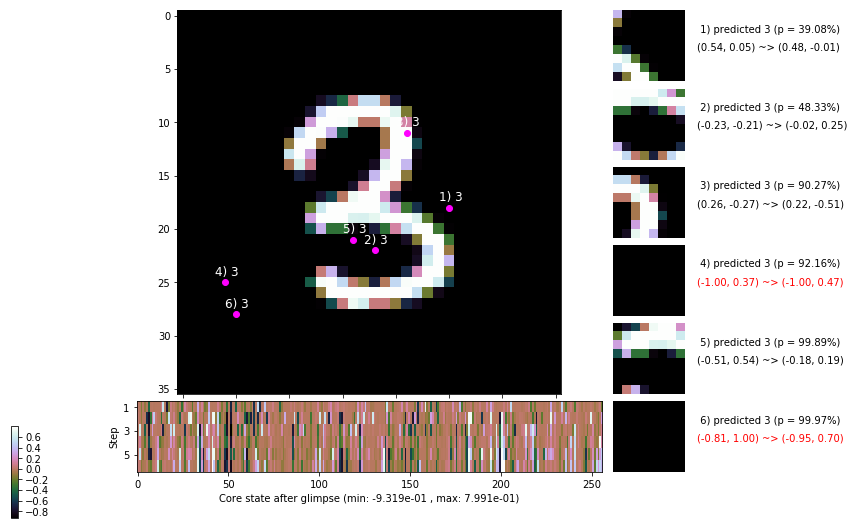

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 157.9 ms/b | lr: 3.58e-04 | grad 2norm:  7.22 | grad inf norm:  2.142
         Weights || abs max:  2.31 (13311.60) | mean: -8.00e-04 ( 0.04) | var: 8.26e-02 (24404.74)
          Biases || abs max:  1.35 (  205.49) | mean: -1.53e-01 ( 0.21) | var: 1.03e-01 ( 1152.10)
                    class loss: 0.301 | steps: 2.200 | reward:  4.533 | acc.: 89.80%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 163.9 ms/b | lr: 3.58e-04 | grad 2norm:  7.38 | grad inf norm:  2.103
         Weights || abs max:  2.31 ( 5919.15) | mean: -8.07e-04 ( 0.02) | var: 8.26e-02 ( 2841.06)
          Biases || abs max:  1.34 (  335.88) | mean: -1.53e-01 ( 0.25) | var: 1.04e-01 (  301.06)
                    class loss: 0.318 | steps: 2.191 | reward:  4.545 | acc.: 89.67%

	Target class: 8 | Discounted rewards: [1.000, 0.001, 0.0

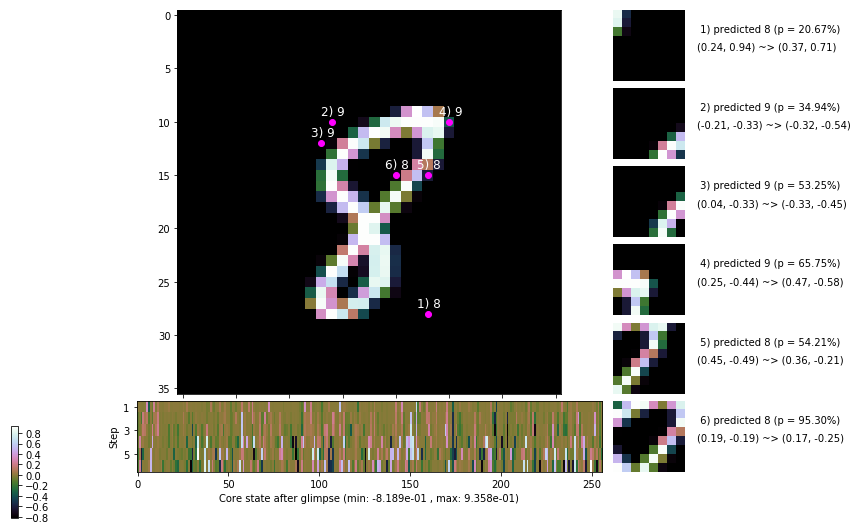

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 160.9 ms/b | lr: 3.57e-04 | grad 2norm:  7.25 | grad inf norm:  2.147
         Weights || abs max:  2.32 ( 4248.56) | mean: -8.10e-04 ( 0.02) | var: 8.26e-02 (  458.07)
          Biases || abs max:  1.35 (  183.42) | mean: -1.53e-01 ( 0.21) | var: 1.04e-01 (  131.52)
                    class loss: 0.319 | steps: 2.198 | reward:  4.531 | acc.: 89.77%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 159.0 ms/b | lr: 3.56e-04 | grad 2norm:  7.21 | grad inf norm:  2.029
         Weights || abs max:  2.32 ( 2541.45) | mean: -8.10e-04 ( 0.01) | var: 8.26e-02 (  124.85)
          Biases || abs max:  1.35 (  183.92) | mean: -1.53e-01 ( 0.19) | var: 1.04e-01 (  263.34)
                    class loss: 0.318 | steps: 2.191 | reward:  4.545 | acc.: 89.53%

	Target class: 3 | Discounted rewards: [1.111, 1.111, 1.1

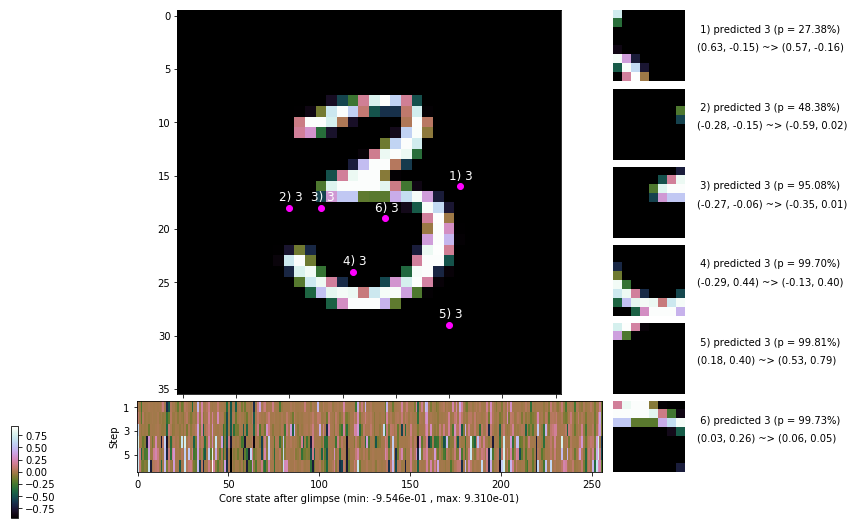

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 159.8 ms/b | lr: 3.56e-04 | grad 2norm:  7.35 | grad inf norm:  2.176
         Weights || abs max:  2.32 ( 4114.08) | mean: -8.03e-04 ( 0.02) | var: 8.27e-02 (  485.62)
          Biases || abs max:  1.36 (  160.24) | mean: -1.53e-01 ( 0.17) | var: 1.04e-01 (  297.39)
                    class loss: 0.308 | steps: 2.216 | reward:  4.519 | acc.: 89.85%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 160.8 ms/b | lr: 3.55e-04 | grad 2norm:  7.26 | grad inf norm:  2.057
         Weights || abs max:  2.31 ( 4882.73) | mean: -8.11e-04 ( 0.02) | var: 8.27e-02 ( 1850.97)
          Biases || abs max:  1.35 (  478.04) | mean: -1.53e-01 ( 0.39) | var: 1.04e-01 (11981.97)
                    class loss: 0.310 | steps: 2.185 | reward:  4.532 | acc.: 89.53%

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.1

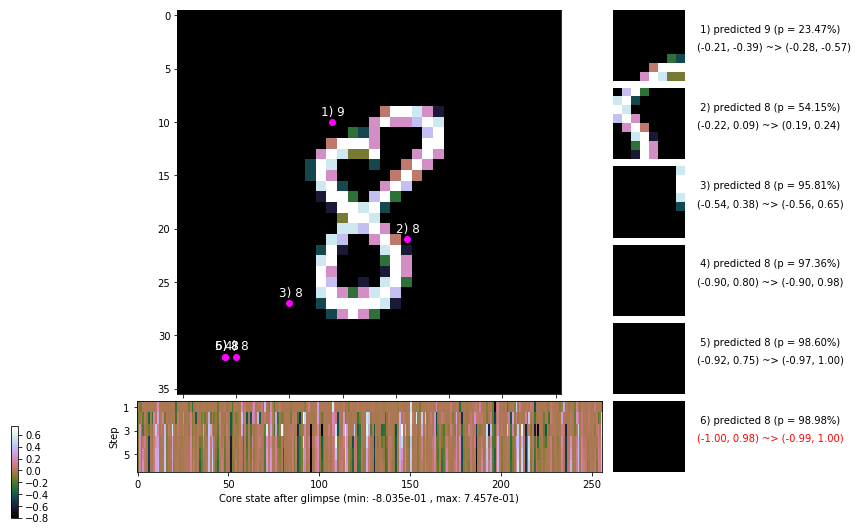

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


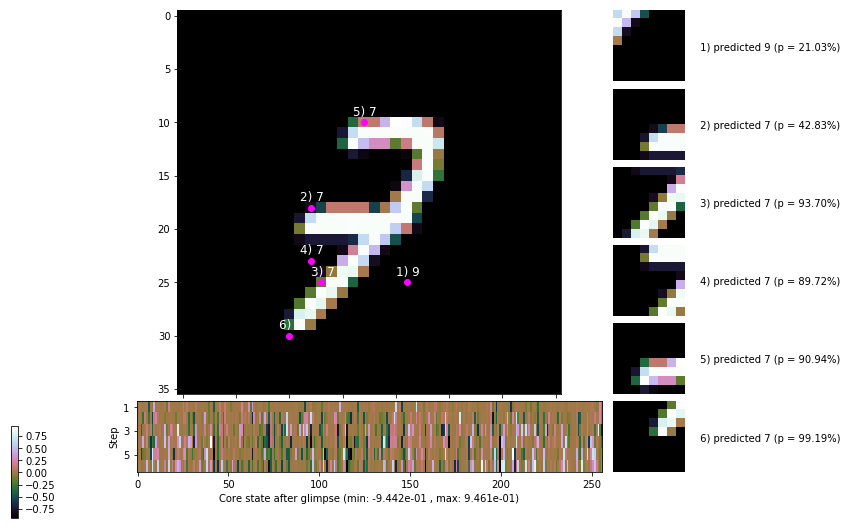


	Target class: 9 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


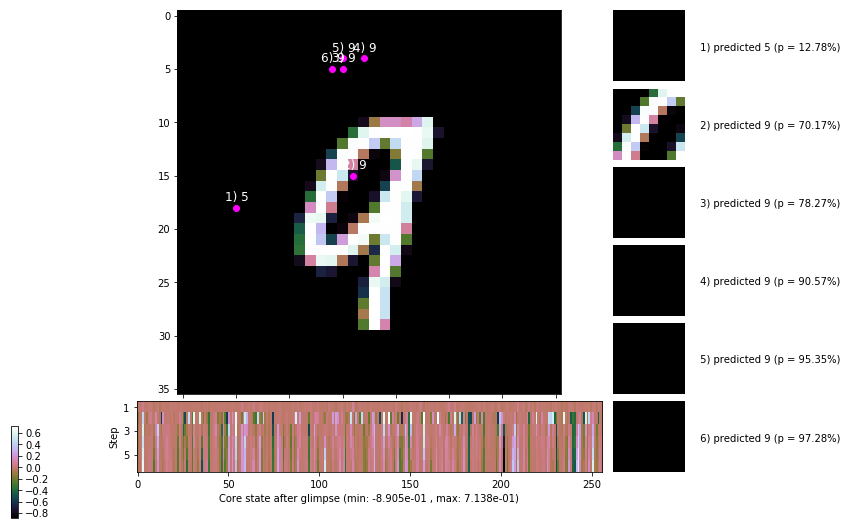

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


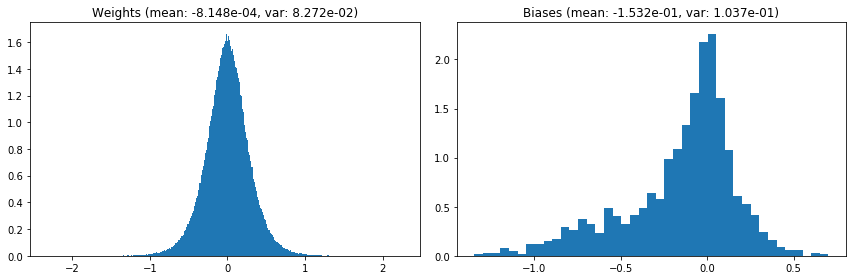

                                      Location network weights and biases


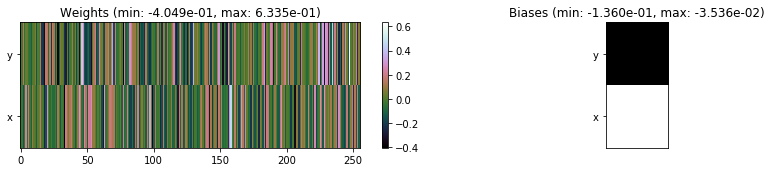

---------------------------------------------------------------------------------------------------------------
Elapsed time:  481.08 sec | TRAIN >> class loss: 0.3097 | steps:  2.191 :( | reward:  4.5415 :( | acc.: 89.773% :(
                          | VAL   >> class loss: 0.3373 | steps:  2.112 :( | reward:  4.6302    | acc.: 89.000% 


Epoch  70/400) lr = 0.000355
 b    300/  3000 >> 149.0 ms/b | lr: 3.55e-04 | grad 2norm:  7.22 | grad inf norm:  2.148
         Weights || abs max:  2.31 ( 3957.35) | mean: -8.19e-04 ( 0.02) | var: 8.27e-02 (  715.51)
          Biases || abs max:  1.35 (  361.23) | mean: -1.53e-01 ( 0.23) | var: 1.04e-01 ( 1668.55)
                    class loss: 0.309 | steps: 2.178 | reward:  4.557 | acc.: 89.65%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 150.9 ms/b | lr: 3.54e-04 | grad 2norm:  7.03 | grad inf norm:  2.025
         Weights || abs max:  2.31 ( 7514.67) | mean: -8.30e-04 ( 0.

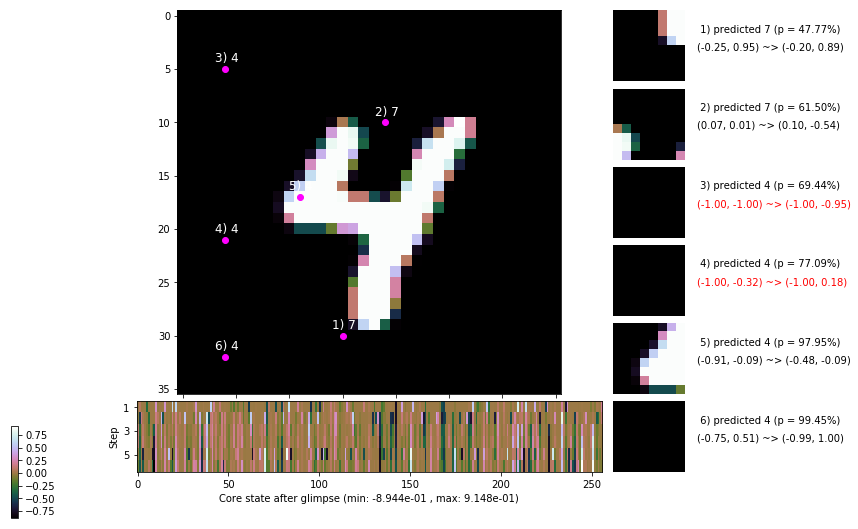

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 151.5 ms/b | lr: 3.54e-04 | grad 2norm:  7.17 | grad inf norm:  2.028
         Weights || abs max:  2.30 ( 2789.85) | mean: -8.19e-04 ( 0.02) | var: 8.28e-02 (   78.44)
          Biases || abs max:  1.36 (  364.64) | mean: -1.53e-01 ( 0.25) | var: 1.04e-01 ( 1072.87)
                    class loss: 0.290 | steps: 2.166 | reward:  4.574 | acc.: 90.58%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 147.6 ms/b | lr: 3.53e-04 | grad 2norm:  7.33 | grad inf norm:  2.213
         Weights || abs max:  2.30 ( 4254.95) | mean: -7.97e-04 ( 0.02) | var: 8.28e-02 (  802.85)
          Biases || abs max:  1.36 (  261.54) | mean: -1.53e-01 ( 0.21) | var: 1.04e-01 ( 1839.54)
                    class loss: 0.301 | steps: 2.196 | reward:  4.539 | acc.: 89.93%

	Target class: 5 | Discounted rewards: [0.100, 1.000, 0.0

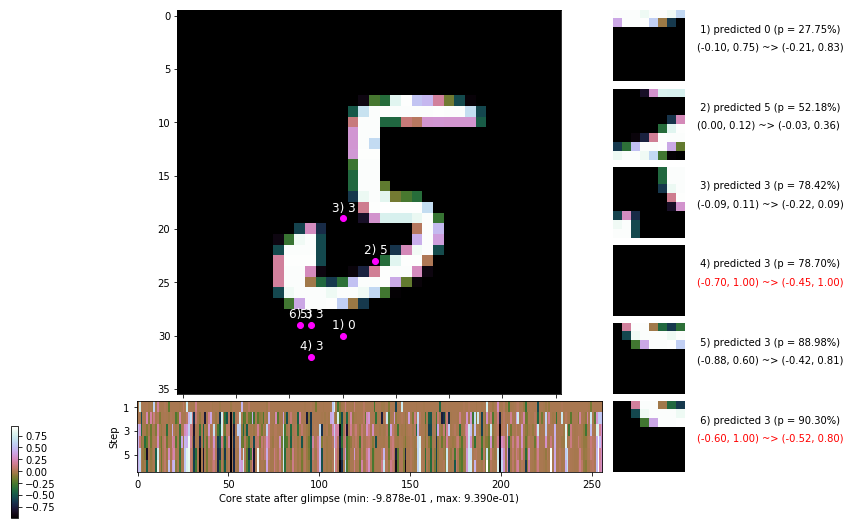

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 153.9 ms/b | lr: 3.53e-04 | grad 2norm:  7.33 | grad inf norm:  2.140
         Weights || abs max:  2.31 ( 6037.30) | mean: -8.24e-04 ( 0.02) | var: 8.28e-02 ( 1843.18)
          Biases || abs max:  1.36 (  146.93) | mean: -1.53e-01 ( 0.17) | var: 1.04e-01 (   53.17)
                    class loss: 0.309 | steps: 2.198 | reward:  4.543 | acc.: 89.92%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 151.1 ms/b | lr: 3.52e-04 | grad 2norm:  7.18 | grad inf norm:  2.105
         Weights || abs max:  2.32 ( 7055.48) | mean: -8.27e-04 ( 0.02) | var: 8.29e-02 ( 4199.30)
          Biases || abs max:  1.36 (  716.77) | mean: -1.53e-01 ( 0.37) | var: 1.04e-01 (17773.19)
                    class loss: 0.312 | steps: 2.183 | reward:  4.536 | acc.: 89.55%

	Target class: 7 | Discounted rewards: [1.111, 1.111, 1.1

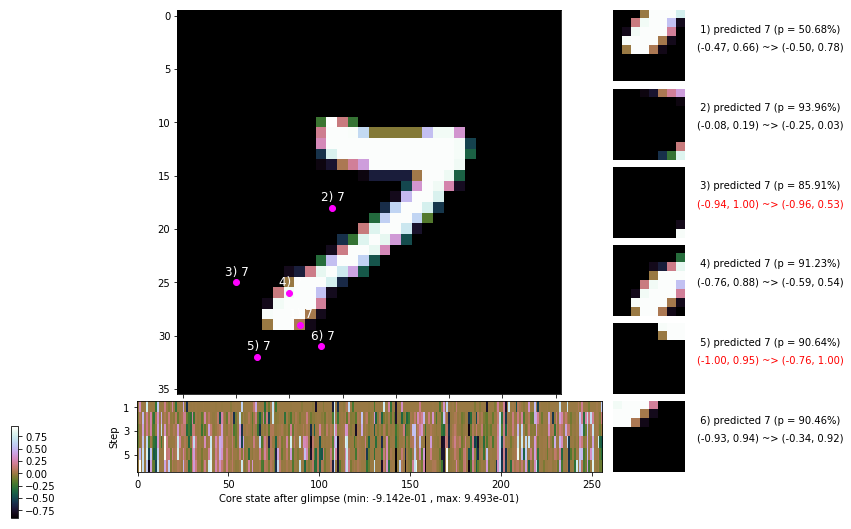

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 153.7 ms/b | lr: 3.52e-04 | grad 2norm:  7.31 | grad inf norm:  2.124
         Weights || abs max:  2.33 ( 5149.78) | mean: -8.00e-04 ( 0.02) | var: 8.29e-02 (  754.05)
          Biases || abs max:  1.36 (  364.72) | mean: -1.53e-01 ( 0.23) | var: 1.04e-01 ( 6022.13)
                    class loss: 0.323 | steps: 2.214 | reward:  4.513 | acc.: 89.18%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 150.3 ms/b | lr: 3.51e-04 | grad 2norm:  7.19 | grad inf norm:  2.093
         Weights || abs max:  2.33 ( 3140.24) | mean: -8.00e-04 ( 0.02) | var: 8.29e-02 (  199.11)
          Biases || abs max:  1.37 (  114.21) | mean: -1.53e-01 ( 0.14) | var: 1.04e-01 (   84.05)
                    class loss: 0.309 | steps: 2.198 | reward:  4.529 | acc.: 89.67%

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.1

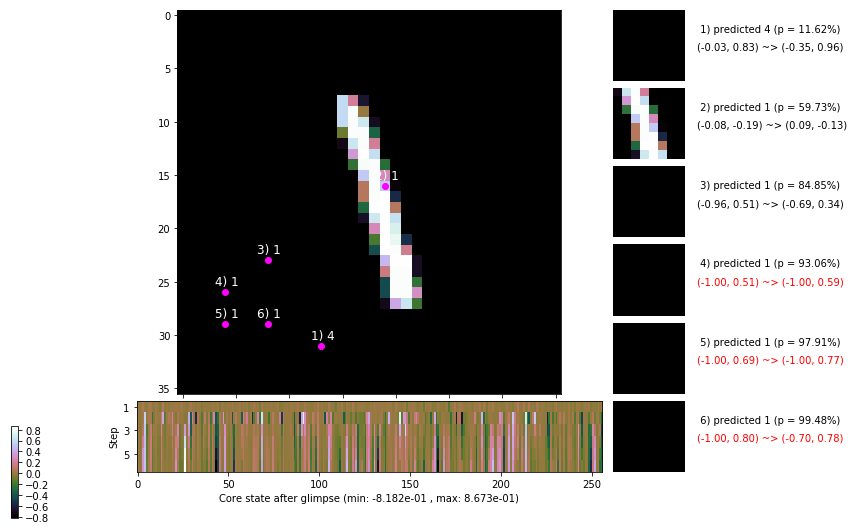

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 152.2 ms/b | lr: 3.50e-04 | grad 2norm:  7.14 | grad inf norm:  2.027
         Weights || abs max:  2.32 (33689.11) | mean: -7.73e-04 ( 0.07) | var: 8.29e-02 (493704.44)
          Biases || abs max:  1.37 (  113.75) | mean: -1.53e-01 ( 0.13) | var: 1.04e-01 (   50.16)
                    class loss: 0.308 | steps: 2.226 | reward:  4.528 | acc.: 89.65%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 151.1 ms/b | lr: 3.50e-04 | grad 2norm:  7.07 | grad inf norm:  2.168
         Weights || abs max:  2.32 ( 3805.47) | mean: -7.69e-04 ( 0.02) | var: 8.30e-02 (  538.67)
          Biases || abs max:  1.37 (  161.57) | mean: -1.53e-01 ( 0.16) | var: 1.04e-01 (  312.89)
                    class loss: 0.298 | steps: 2.176 | reward:  4.569 | acc.: 89.80%

	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.

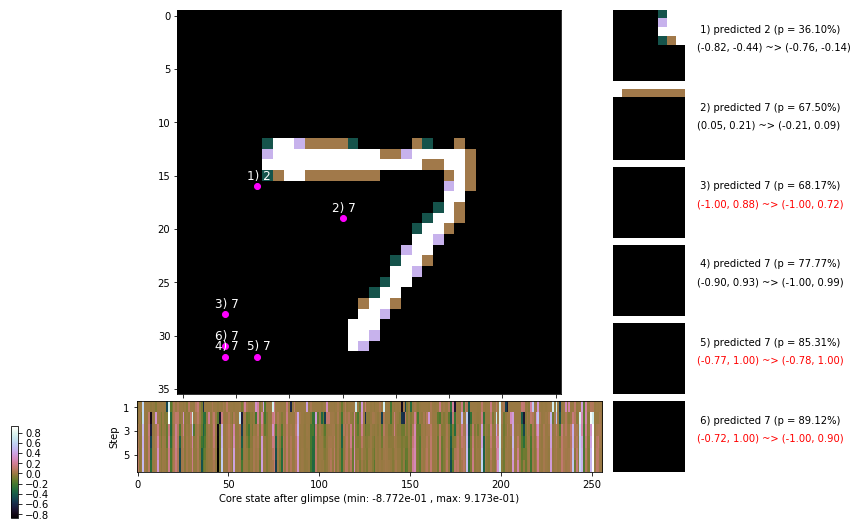

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


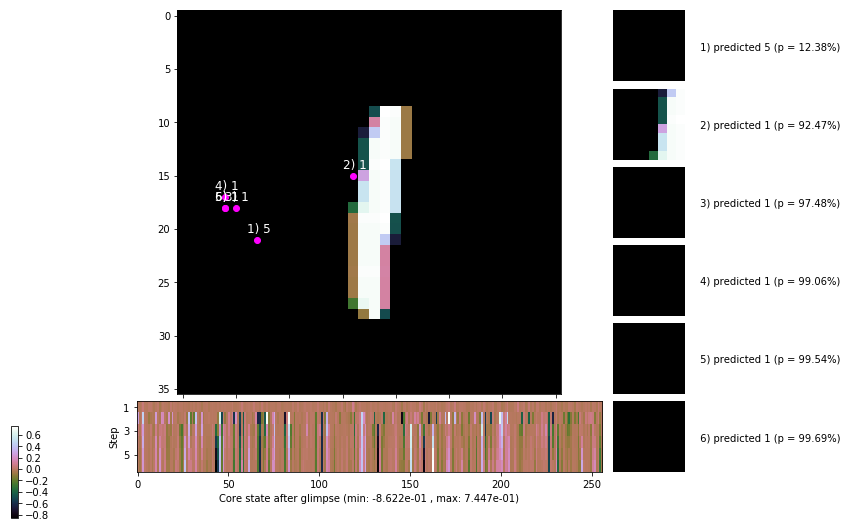


	Target class: 6 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


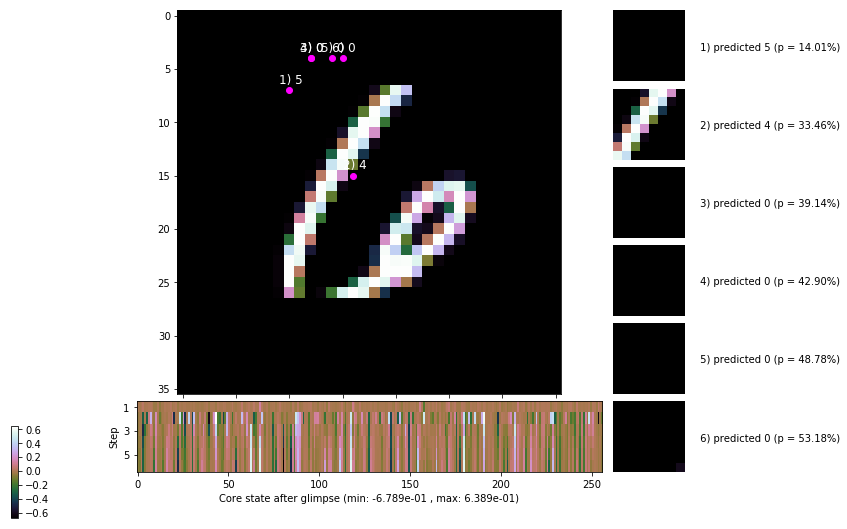

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


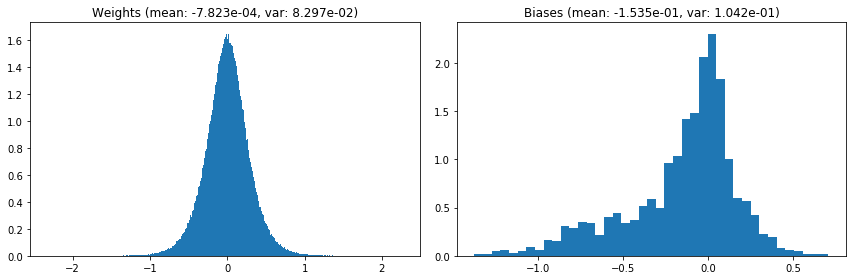

                                      Location network weights and biases


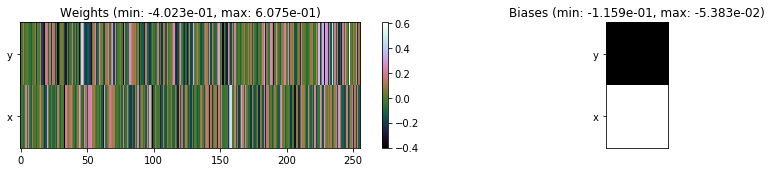

---------------------------------------------------------------------------------------------------------------
Elapsed time:  454.04 sec | TRAIN >> class loss: 0.3065 | steps:  2.192 :( | reward:  4.5428 :( | acc.: 89.820% :(
                          | VAL   >> class loss: 0.3192 | steps:  2.112 :( | reward:  4.6272 :( | acc.: 89.080% 


Epoch  71/400) lr = 0.0003498
 b    300/  3000 >> 160.4 ms/b | lr: 3.49e-04 | grad 2norm:  7.07 | grad inf norm:  1.995
         Weights || abs max:  2.32 ( 3636.53) | mean: -7.71e-04 ( 0.02) | var: 8.30e-02 (  464.08)
          Biases || abs max:  1.37 (  124.13) | mean: -1.53e-01 ( 0.15) | var: 1.04e-01 (   43.21)
                    class loss: 0.284 | steps: 2.183 | reward:  4.569 | acc.: 90.58%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 166.7 ms/b | lr: 3.49e-04 | grad 2norm:  7.31 | grad inf norm:  2.137
         Weights || abs max:  2.32 ( 8506.49) | mean: -7.55e-04 ( 0

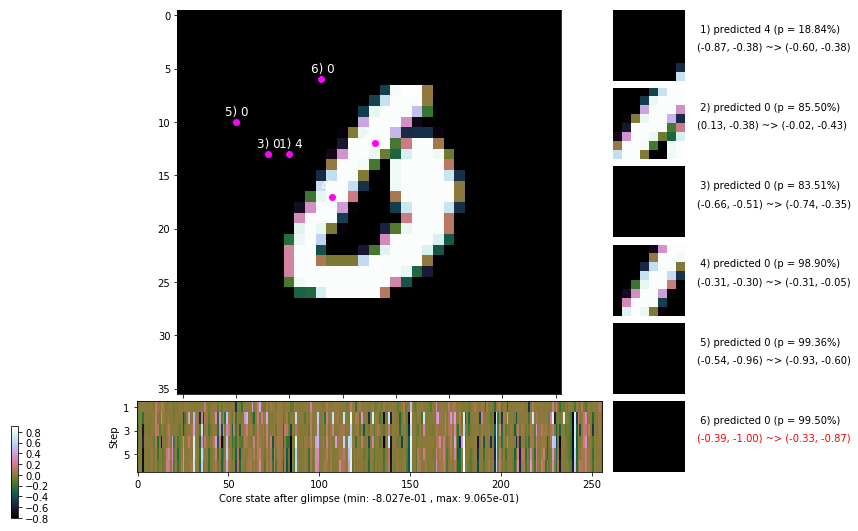

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 165.7 ms/b | lr: 3.48e-04 | grad 2norm:  7.15 | grad inf norm:  2.055
         Weights || abs max:  2.32 ( 9895.54) | mean: -7.56e-04 ( 0.03) | var: 8.30e-02 (17461.04)
          Biases || abs max:  1.37 (  236.58) | mean: -1.54e-01 ( 0.20) | var: 1.04e-01 ( 1683.24)
                    class loss: 0.325 | steps: 2.179 | reward:  4.531 | acc.: 89.80%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 163.4 ms/b | lr: 3.48e-04 | grad 2norm:  7.02 | grad inf norm:  2.068
         Weights || abs max:  2.32 ( 3827.88) | mean: -7.63e-04 ( 0.02) | var: 8.30e-02 (  526.16)
          Biases || abs max:  1.37 (  139.40) | mean: -1.54e-01 ( 0.16) | var: 1.04e-01 (   69.48)
                    class loss: 0.306 | steps: 2.186 | reward:  4.550 | acc.: 89.68%

	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.1

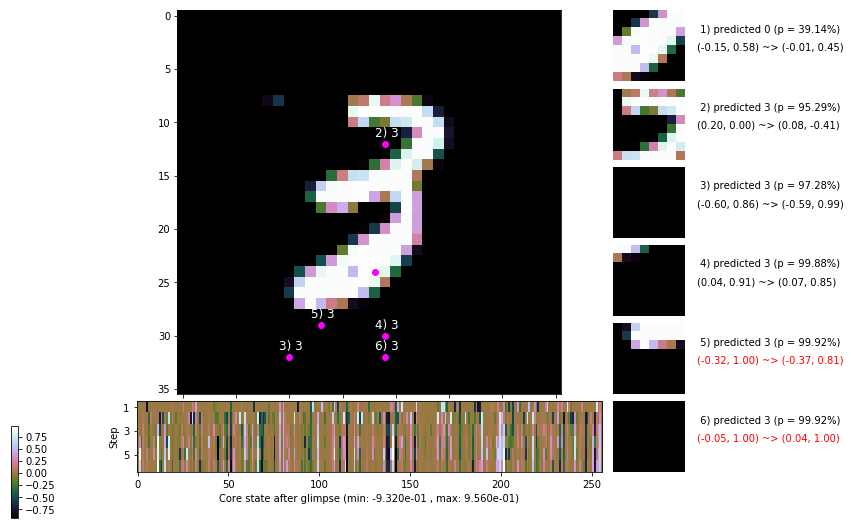

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 158.3 ms/b | lr: 3.47e-04 | grad 2norm:  7.19 | grad inf norm:  2.018
         Weights || abs max:  2.32 ( 8526.10) | mean: -7.62e-04 ( 0.03) | var: 8.31e-02 ( 5141.67)
          Biases || abs max:  1.37 (  170.49) | mean: -1.54e-01 ( 0.18) | var: 1.04e-01 (  112.58)
                    class loss: 0.318 | steps: 2.202 | reward:  4.530 | acc.: 89.58%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 158.3 ms/b | lr: 3.47e-04 | grad 2norm:  7.20 | grad inf norm:  2.150
         Weights || abs max:  2.32 ( 6468.77) | mean: -7.55e-04 ( 0.02) | var: 8.31e-02 ( 3109.46)
          Biases || abs max:  1.37 (  197.14) | mean: -1.54e-01 ( 0.22) | var: 1.04e-01 ( 2051.34)
                    class loss: 0.311 | steps: 2.187 | reward:  4.527 | acc.: 89.28%

	Target class: 9 | Discounted rewards: [0.111, 1.111, 1.1

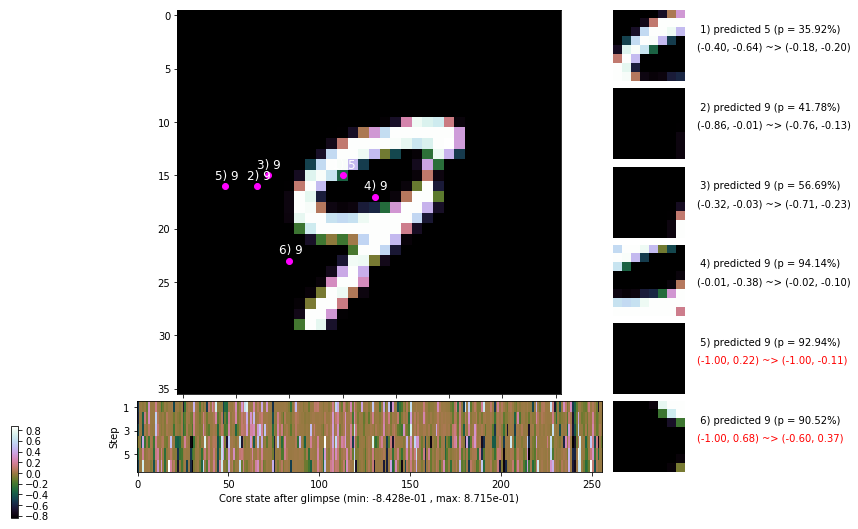

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 160.7 ms/b | lr: 3.46e-04 | grad 2norm:  7.27 | grad inf norm:  2.212
         Weights || abs max:  2.32 ( 3225.64) | mean: -7.55e-04 ( 0.02) | var: 8.31e-02 (  246.40)
          Biases || abs max:  1.37 (  189.24) | mean: -1.54e-01 ( 0.20) | var: 1.04e-01 (  615.46)
                    class loss: 0.303 | steps: 2.210 | reward:  4.508 | acc.: 89.53%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 158.1 ms/b | lr: 3.46e-04 | grad 2norm:  7.23 | grad inf norm:  2.071
         Weights || abs max:  2.32 ( 4953.94) | mean: -7.68e-04 ( 0.02) | var: 8.31e-02 ( 1695.73)
          Biases || abs max:  1.37 (  342.23) | mean: -1.54e-01 ( 0.24) | var: 1.04e-01 ( 1585.99)
                    class loss: 0.318 | steps: 2.211 | reward:  4.520 | acc.: 89.57%

	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.1

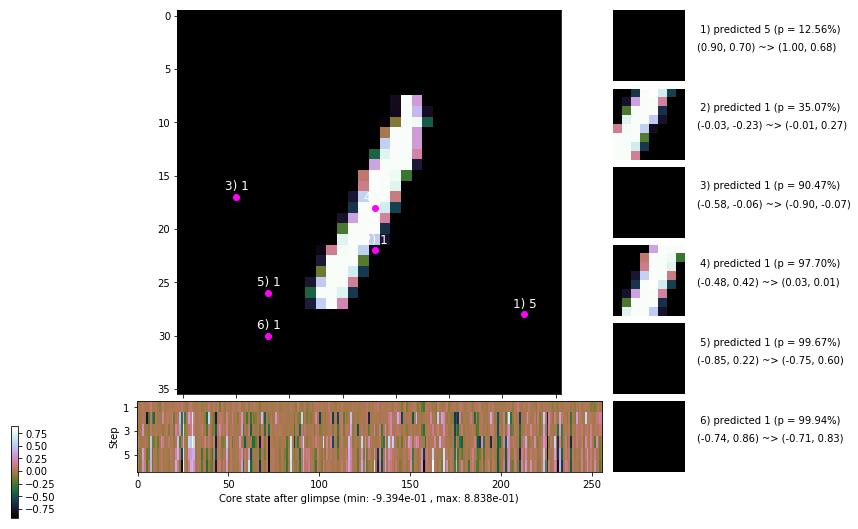

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 159.1 ms/b | lr: 3.45e-04 | grad 2norm:  7.25 | grad inf norm:  2.130
         Weights || abs max:  2.31 ( 6622.24) | mean: -7.51e-04 ( 0.02) | var: 8.32e-02 ( 2519.27)
          Biases || abs max:  1.37 ( 1007.15) | mean: -1.53e-01 ( 0.53) | var: 1.04e-01 (27597.54)
                    class loss: 0.309 | steps: 2.189 | reward:  4.532 | acc.: 89.38%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 156.2 ms/b | lr: 3.45e-04 | grad 2norm:  7.16 | grad inf norm:  2.173
         Weights || abs max:  2.32 ( 4132.44) | mean: -7.52e-04 ( 0.02) | var: 8.32e-02 (  513.85)
          Biases || abs max:  1.37 (  643.99) | mean: -1.53e-01 ( 0.37) | var: 1.04e-01 (20358.62)
                    class loss: 0.316 | steps: 2.210 | reward:  4.524 | acc.: 89.13%

	Target class: 4 | Discounted rewards: [1.111, 1.111, 1.1

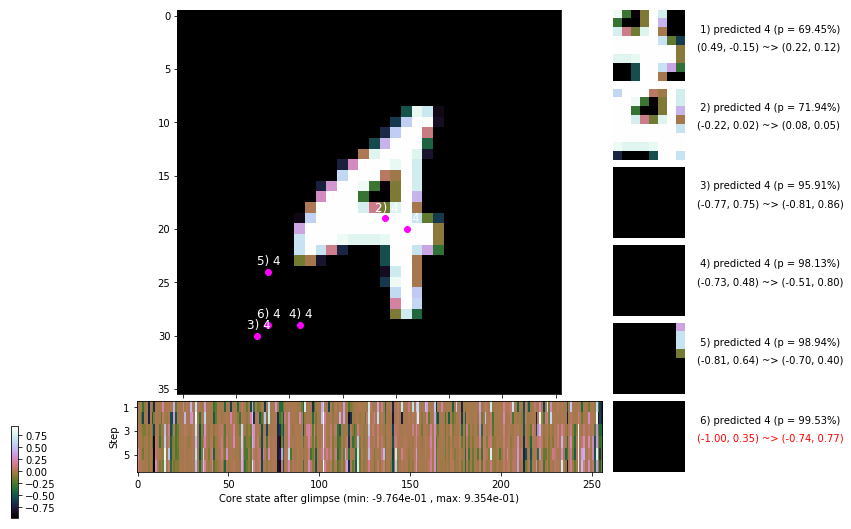

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [0.100, 1.000, 0.000, 0.000, 0.000, 0.000]


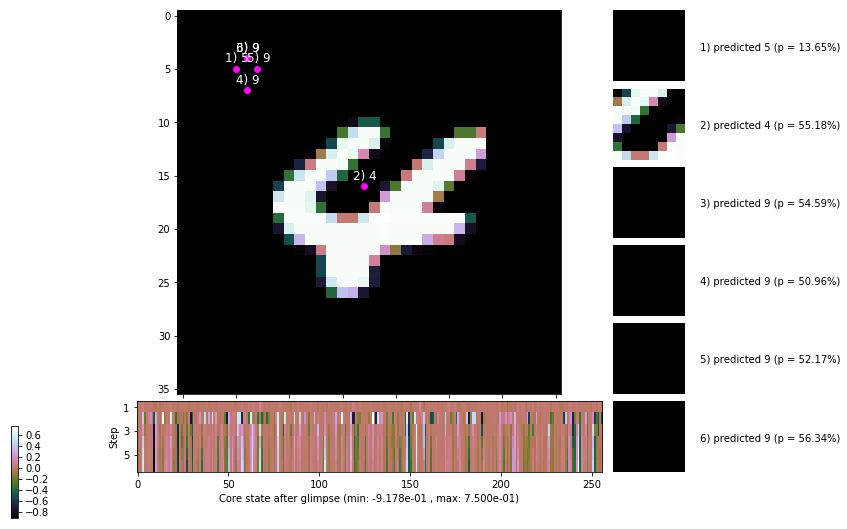


	Target class: 7 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


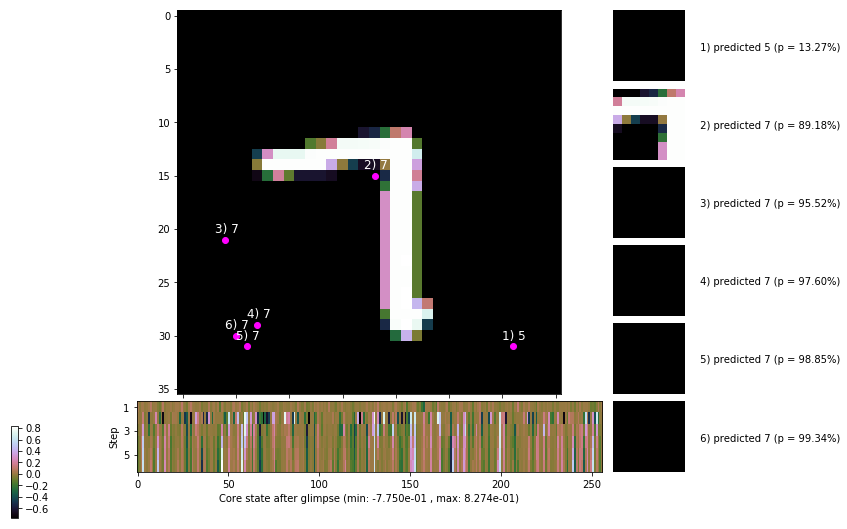

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


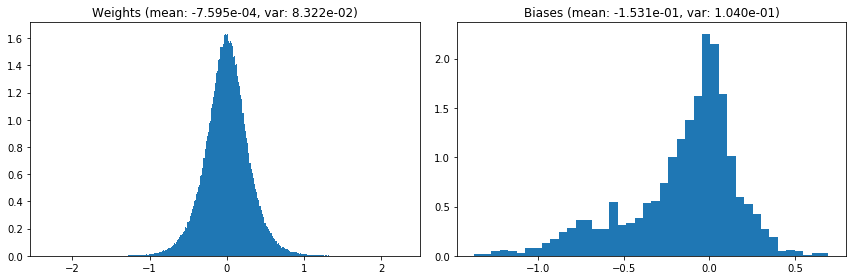

                                      Location network weights and biases


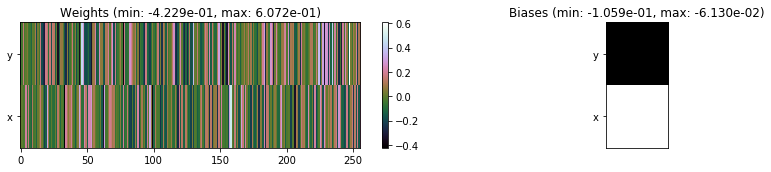

---------------------------------------------------------------------------------------------------------------
Elapsed time:  482.93 sec | TRAIN >> class loss: 0.3104 | steps:  2.197 :( | reward:  4.5315 :( | acc.: 89.663% :(
                          | VAL   >> class loss: 0.3455 | steps:  2.131 :( | reward:  4.5856 :( | acc.: 88.120% :(


Epoch  72/400) lr = 0.0003445
 b    300/  3000 >> 157.4 ms/b | lr: 3.44e-04 | grad 2norm:  6.95 | grad inf norm:  2.031
         Weights || abs max:  2.31 ( 6743.36) | mean: -7.52e-04 ( 0.02) | var: 8.32e-02 ( 2616.63)
          Biases || abs max:  1.37 (  207.81) | mean: -1.53e-01 ( 0.17) | var: 1.04e-01 (  649.28)
                    class loss: 0.325 | steps: 2.177 | reward:  4.533 | acc.: 88.88%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 156.2 ms/b | lr: 3.44e-04 | grad 2norm:  7.07 | grad inf norm:  2.031
         Weights || abs max:  2.31 ( 2941.00) | mean: -7.58e-04 (

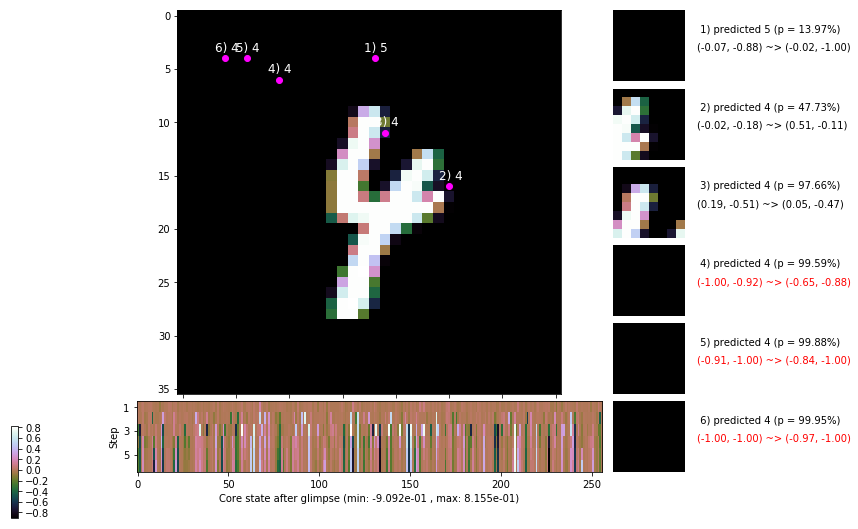

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 161.1 ms/b | lr: 3.43e-04 | grad 2norm:  7.30 | grad inf norm:  2.110
         Weights || abs max:  2.31 (10677.77) | mean: -7.59e-04 ( 0.03) | var: 8.33e-02 (27435.78)
          Biases || abs max:  1.37 (  287.52) | mean: -1.54e-01 ( 0.21) | var: 1.04e-01 (  748.27)
                    class loss: 0.327 | steps: 2.195 | reward:  4.515 | acc.: 88.83%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 158.8 ms/b | lr: 3.43e-04 | grad 2norm:  7.11 | grad inf norm:  2.061
         Weights || abs max:  2.31 (59411.40) | mean: -7.70e-04 ( 0.12) | var: 8.33e-02 (1530891.88)
          Biases || abs max:  1.38 (  215.54) | mean: -1.54e-01 ( 0.20) | var: 1.04e-01 (  529.04)
                    class loss: 0.304 | steps: 2.200 | reward:  4.524 | acc.: 89.37%

	Target class: 4 | Discounted rewards: [0.000, 0.000, 0

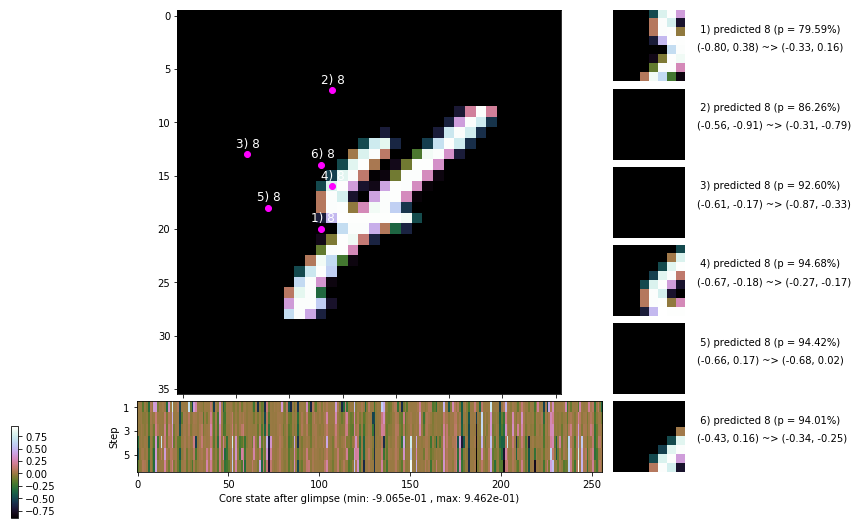

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 164.3 ms/b | lr: 3.42e-04 | grad 2norm:  7.27 | grad inf norm:  2.126
         Weights || abs max:  2.31 (10411.08) | mean: -7.67e-04 ( 0.03) | var: 8.33e-02 (25804.25)
          Biases || abs max:  1.38 (  218.71) | mean: -1.54e-01 ( 0.22) | var: 1.04e-01 (  245.22)
                    class loss: 0.332 | steps: 2.220 | reward:  4.485 | acc.: 88.83%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 161.2 ms/b | lr: 3.42e-04 | grad 2norm:  7.03 | grad inf norm:  1.972
         Weights || abs max:  2.31 ( 4366.25) | mean: -7.61e-04 ( 0.02) | var: 8.33e-02 (  625.25)
          Biases || abs max:  1.38 (  155.51) | mean: -1.54e-01 ( 0.16) | var: 1.04e-01 (  234.12)
                    class loss: 0.291 | steps: 2.180 | reward:  4.548 | acc.: 90.23%

	Target class: 3 | Discounted rewards: [0.011, 0.111, 1.1

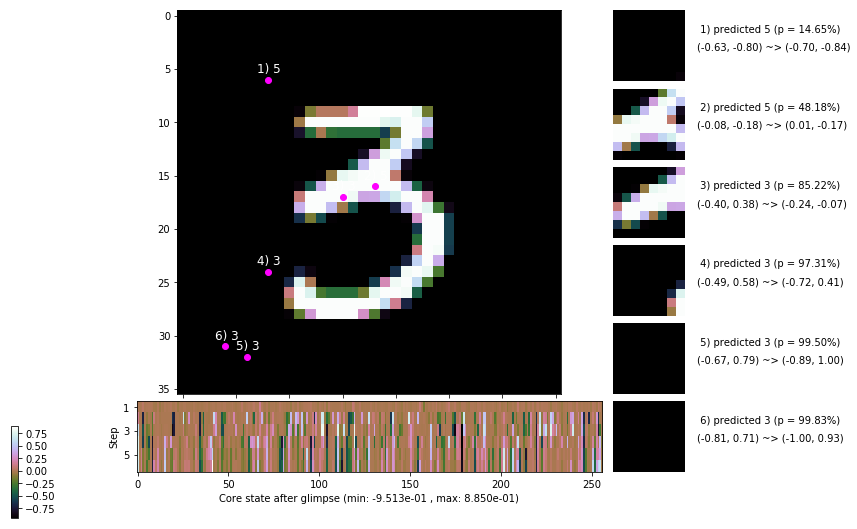

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 168.0 ms/b | lr: 3.41e-04 | grad 2norm:  7.26 | grad inf norm:  2.074
         Weights || abs max:  2.32 ( 4266.45) | mean: -7.63e-04 ( 0.02) | var: 8.34e-02 ( 1626.98)
          Biases || abs max:  1.37 (  138.24) | mean: -1.54e-01 ( 0.15) | var: 1.04e-01 (  121.58)
                    class loss: 0.322 | steps: 2.207 | reward:  4.505 | acc.: 89.22%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 163.7 ms/b | lr: 3.41e-04 | grad 2norm:  7.16 | grad inf norm:  2.056
         Weights || abs max:  2.31 ( 6059.73) | mean: -7.50e-04 ( 0.02) | var: 8.34e-02 ( 4330.11)
          Biases || abs max:  1.37 (  205.34) | mean: -1.54e-01 ( 0.18) | var: 1.04e-01 (  600.62)
                    class loss: 0.316 | steps: 2.207 | reward:  4.513 | acc.: 89.22%

	Target class: 9 | Discounted rewards: [1.111, 1.111, 1.1

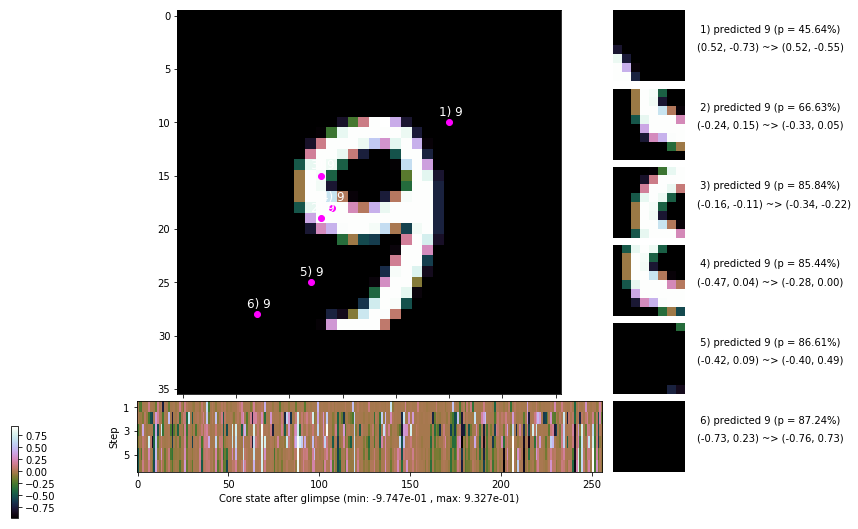

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 159.4 ms/b | lr: 3.40e-04 | grad 2norm:  7.15 | grad inf norm:  2.091
         Weights || abs max:  2.32 ( 4819.74) | mean: -7.52e-04 ( 0.02) | var: 8.34e-02 ( 1027.38)
          Biases || abs max:  1.37 (  110.10) | mean: -1.54e-01 ( 0.14) | var: 1.04e-01 (   47.24)
                    class loss: 0.311 | steps: 2.197 | reward:  4.538 | acc.: 89.58%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 155.7 ms/b | lr: 3.40e-04 | grad 2norm:  7.11 | grad inf norm:  2.019
         Weights || abs max:  2.31 ( 2153.21) | mean: -7.51e-04 ( 0.01) | var: 8.34e-02 (   37.98)
          Biases || abs max:  1.37 (  116.81) | mean: -1.55e-01 ( 0.13) | var: 1.05e-01 (   66.15)
                    class loss: 0.312 | steps: 2.191 | reward:  4.548 | acc.: 89.55%

	Target class: 2 | Discounted rewards: [0.001, 0.011, 0.1

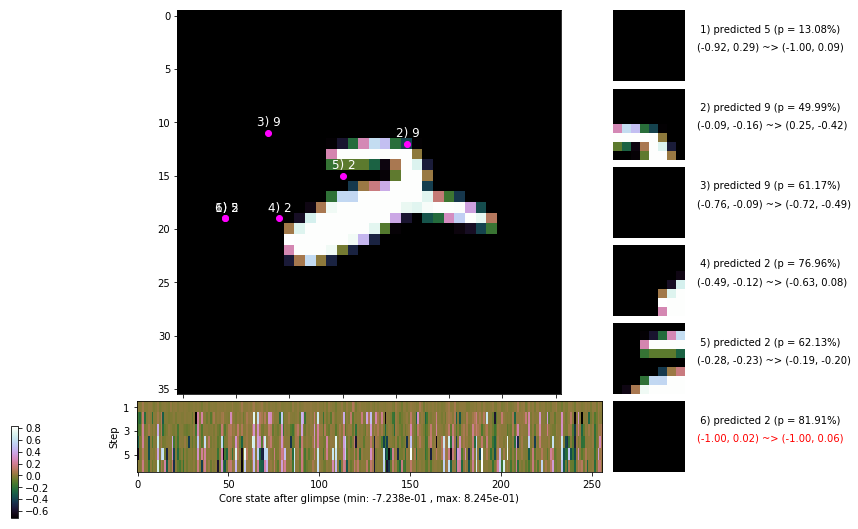

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.011, 0.110, 1.100, 1.000, 0.000, 0.000]


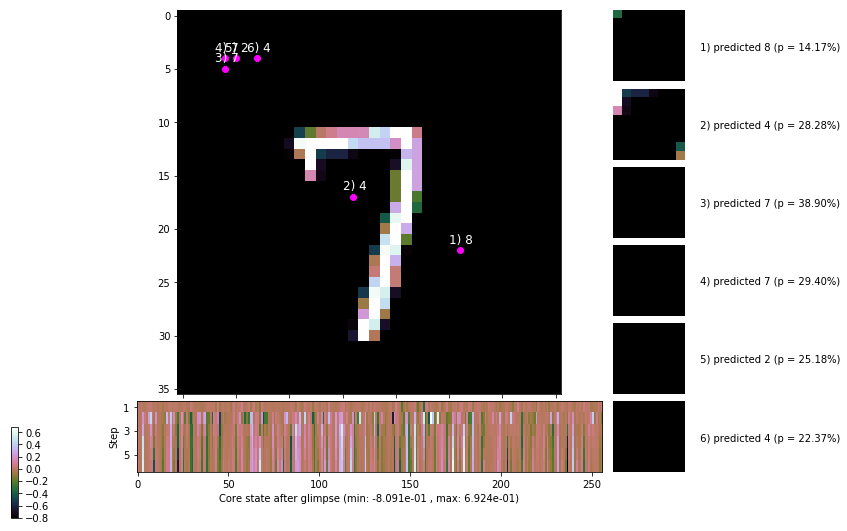


	Target class: 0 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


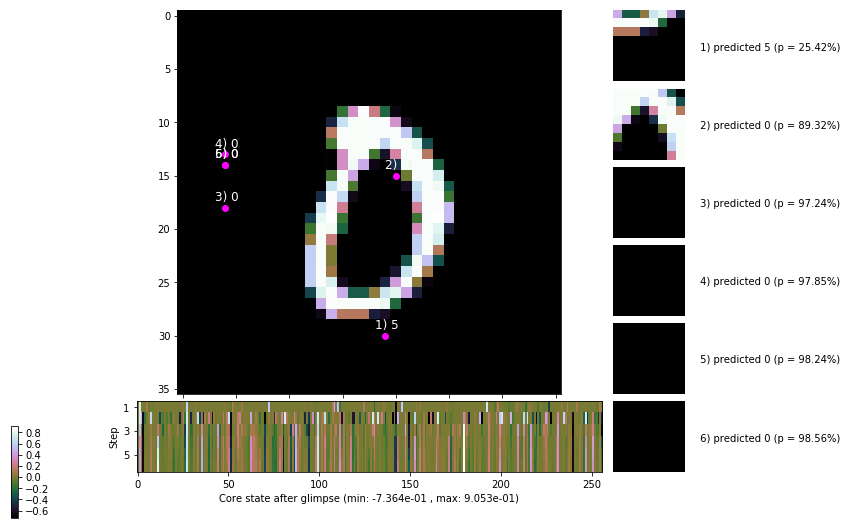

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


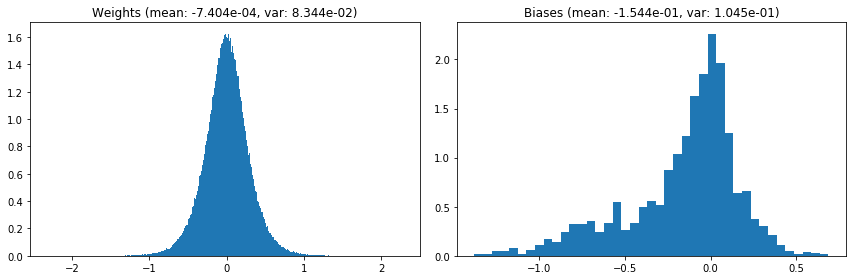

                                      Location network weights and biases


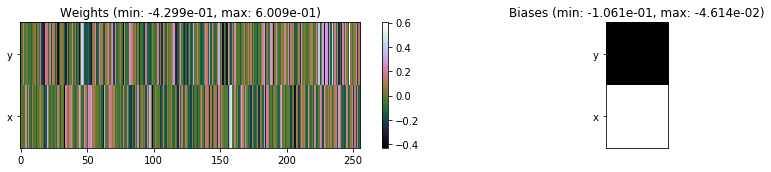

---------------------------------------------------------------------------------------------------------------
Elapsed time:  482.60 sec | TRAIN >> class loss: 0.3138 | steps:  2.194 :( | reward:  4.5266 :( | acc.: 89.327% :(
                          | VAL   >> class loss: 0.3323 | steps:  2.137 :( | reward:  4.6070 :( | acc.: 88.700% :(


Epoch  73/400) lr = 0.0003394
 b    300/  3000 >> 156.2 ms/b | lr: 3.39e-04 | grad 2norm:  7.13 | grad inf norm:  2.126
         Weights || abs max:  2.31 ( 4858.43) | mean: -7.30e-04 ( 0.02) | var: 8.34e-02 ( 1053.83)
          Biases || abs max:  1.38 (  354.41) | mean: -1.54e-01 ( 0.26) | var: 1.05e-01 ( 1375.23)
                    class loss: 0.307 | steps: 2.194 | reward:  4.528 | acc.: 89.57%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 155.9 ms/b | lr: 3.39e-04 | grad 2norm:  7.05 | grad inf norm:  2.038
         Weights || abs max:  2.31 ( 2221.17) | mean: -7.39e-04 (

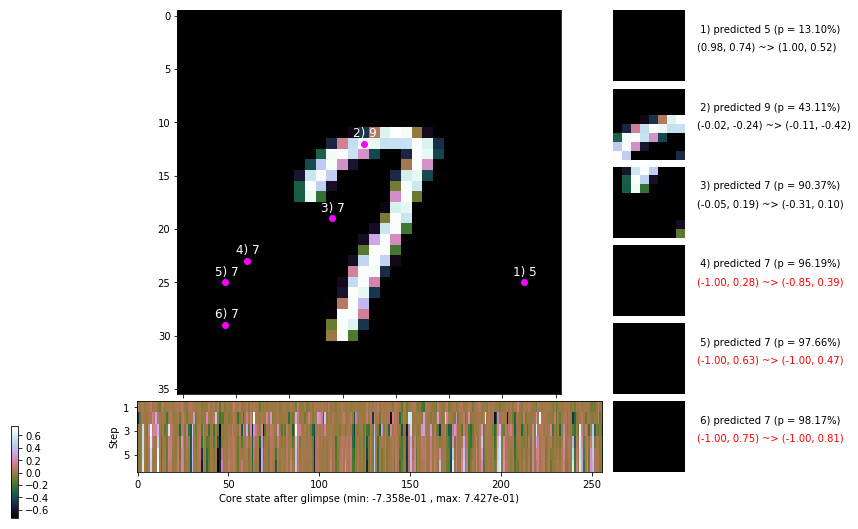

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 161.2 ms/b | lr: 3.38e-04 | grad 2norm:  7.12 | grad inf norm:  2.026
         Weights || abs max:  2.31 ( 8534.06) | mean: -7.30e-04 ( 0.03) | var: 8.35e-02 ( 4091.52)
          Biases || abs max:  1.38 (  562.19) | mean: -1.54e-01 ( 0.34) | var: 1.05e-01 ( 2793.81)
                    class loss: 0.318 | steps: 2.215 | reward:  4.527 | acc.: 89.55%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 149.3 ms/b | lr: 3.38e-04 | grad 2norm:  7.11 | grad inf norm:  2.105
         Weights || abs max:  2.30 ( 7096.03) | mean: -7.08e-04 ( 0.02) | var: 8.35e-02 ( 5753.08)
          Biases || abs max:  1.38 (  194.58) | mean: -1.54e-01 ( 0.17) | var: 1.05e-01 (  921.35)
                    class loss: 0.308 | steps: 2.178 | reward:  4.556 | acc.: 89.60%

	Target class: 6 | Discounted rewards: [1.111, 1.111, 1.1

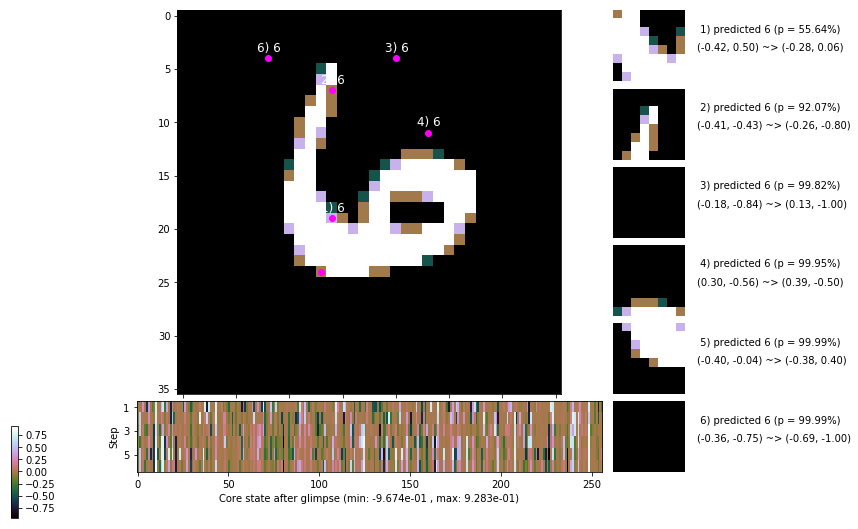

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 152.4 ms/b | lr: 3.37e-04 | grad 2norm:  7.08 | grad inf norm:  2.100
         Weights || abs max:  2.30 ( 4301.79) | mean: -7.13e-04 ( 0.02) | var: 8.36e-02 (  896.96)
          Biases || abs max:  1.38 (  163.11) | mean: -1.54e-01 ( 0.17) | var: 1.04e-01 (  140.47)
                    class loss: 0.320 | steps: 2.217 | reward:  4.513 | acc.: 88.90%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 149.3 ms/b | lr: 3.37e-04 | grad 2norm:  7.22 | grad inf norm:  2.046
         Weights || abs max:  2.31 (28472.52) | mean: -7.39e-04 ( 0.06) | var: 8.36e-02 (336417.69)
          Biases || abs max:  1.38 (  730.79) | mean: -1.54e-01 ( 0.40) | var: 1.04e-01 (26335.22)
                    class loss: 0.343 | steps: 2.228 | reward:  4.481 | acc.: 88.70%

	Target class: 5 | Discounted rewards: [1.011, 0.111, 1.

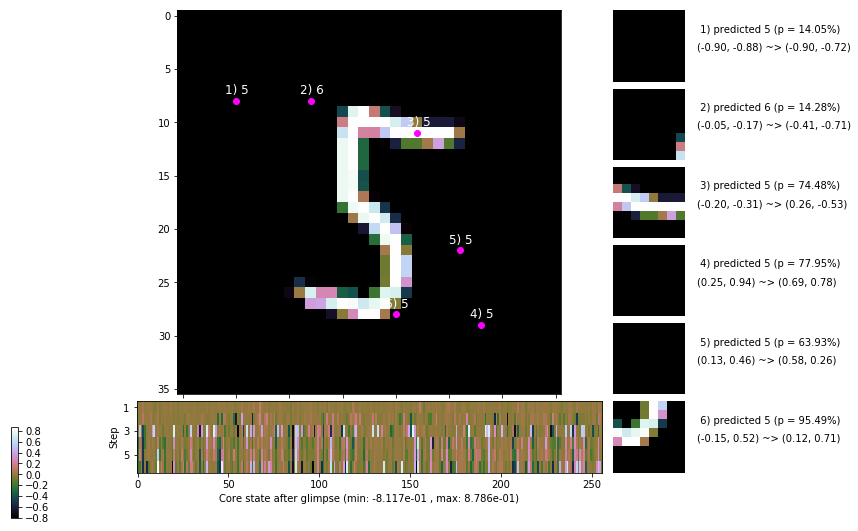

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 153.7 ms/b | lr: 3.36e-04 | grad 2norm:  7.19 | grad inf norm:  2.109
         Weights || abs max:  2.31 ( 6369.18) | mean: -7.51e-04 ( 0.02) | var: 8.36e-02 ( 3053.42)
          Biases || abs max:  1.38 (  126.68) | mean: -1.54e-01 ( 0.16) | var: 1.04e-01 (   90.45)
                    class loss: 0.320 | steps: 2.218 | reward:  4.503 | acc.: 89.12%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.5 ms/b | lr: 3.36e-04 | grad 2norm:  7.01 | grad inf norm:  2.014
         Weights || abs max:  2.31 ( 8378.69) | mean: -7.46e-04 ( 0.03) | var: 8.36e-02 ( 4653.70)
          Biases || abs max:  1.38 (  245.92) | mean: -1.54e-01 ( 0.21) | var: 1.04e-01 (  312.37)
                    class loss: 0.313 | steps: 2.206 | reward:  4.529 | acc.: 89.82%

	Target class: 3 | Discounted rewards: [1.111, 1.111, 1.1

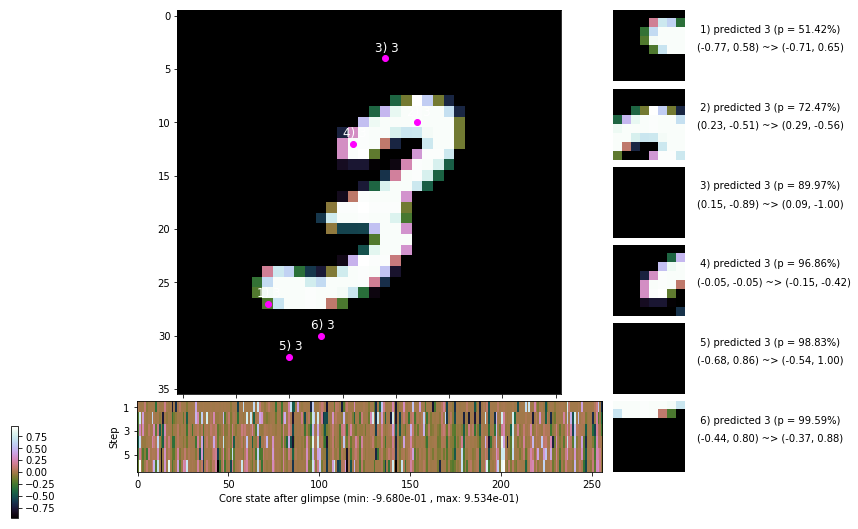

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 153.6 ms/b | lr: 3.35e-04 | grad 2norm:  7.08 | grad inf norm:  2.084
         Weights || abs max:  2.31 ( 3715.31) | mean: -7.34e-04 ( 0.02) | var: 8.36e-02 (  289.47)
          Biases || abs max:  1.38 (  172.33) | mean: -1.54e-01 ( 0.16) | var: 1.04e-01 (  388.04)
                    class loss: 0.321 | steps: 2.216 | reward:  4.519 | acc.: 89.42%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 146.9 ms/b | lr: 3.35e-04 | grad 2norm:  7.21 | grad inf norm:  2.104
         Weights || abs max:  2.31 ( 6021.72) | mean: -7.24e-04 ( 0.02) | var: 8.37e-02 ( 2430.10)
          Biases || abs max:  1.37 (  187.80) | mean: -1.54e-01 ( 0.18) | var: 1.04e-01 (  225.76)
                    class loss: 0.332 | steps: 2.215 | reward:  4.499 | acc.: 88.42%

	Target class: 6 | Discounted rewards: [0.111, 1.111, 1.1

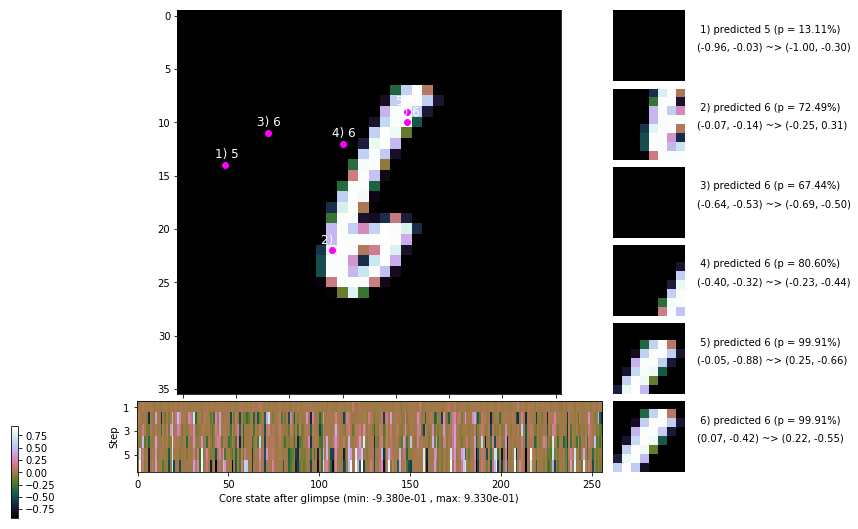

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


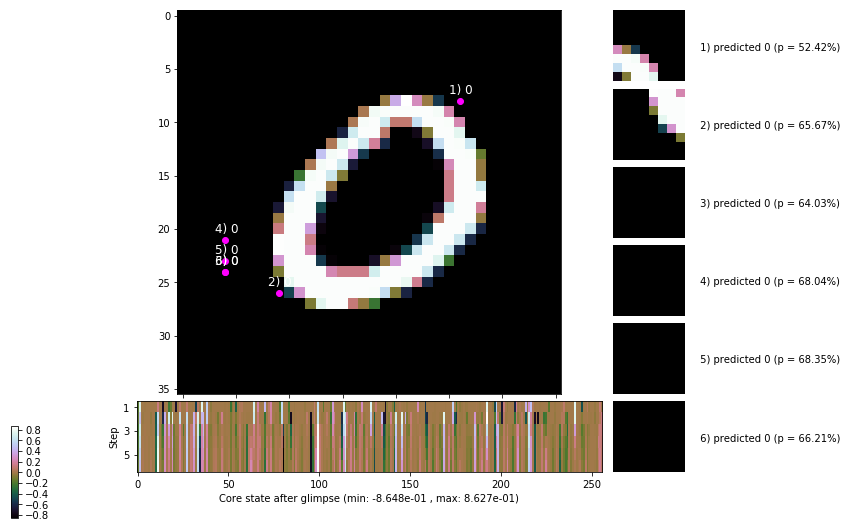


	Target class: 5 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


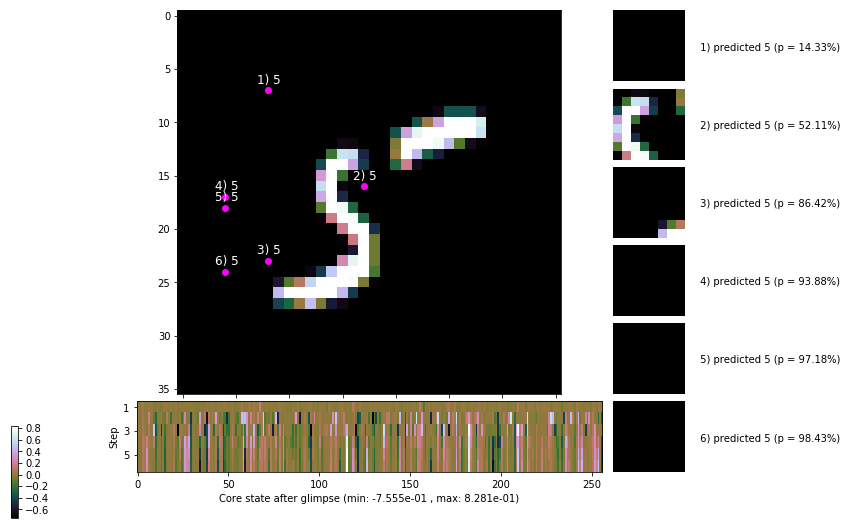

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


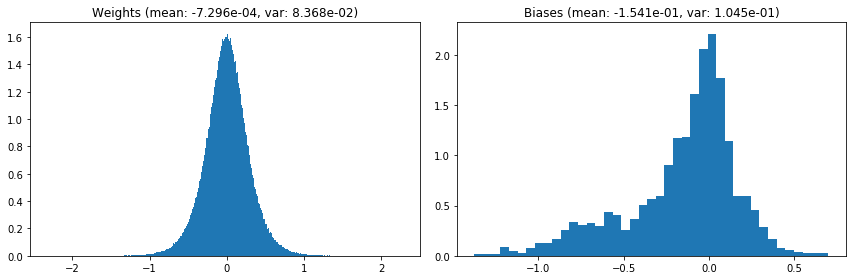

                                      Location network weights and biases


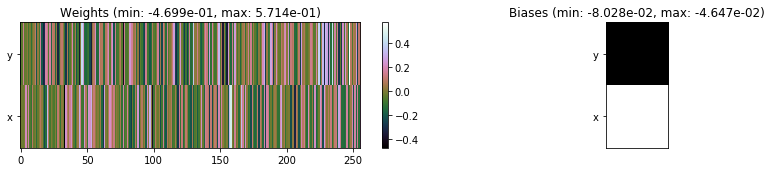

---------------------------------------------------------------------------------------------------------------
Elapsed time:  459.60 sec | TRAIN >> class loss: 0.3201 | steps:  2.209 :( | reward:  4.5168 :( | acc.: 89.188% :(
                          | VAL   >> class loss: 0.3511 | steps:  2.144 :( | reward:  4.5780 :( | acc.: 88.680% :(


Epoch  74/400) lr = 0.0003344
 b    300/  3000 >> 145.4 ms/b | lr: 3.34e-04 | grad 2norm:  6.92 | grad inf norm:  2.002
         Weights || abs max:  2.32 ( 3216.85) | mean: -7.41e-04 ( 0.02) | var: 8.37e-02 (  320.53)
          Biases || abs max:  1.38 (  181.43) | mean: -1.54e-01 ( 0.18) | var: 1.04e-01 (   98.19)
                    class loss: 0.303 | steps: 2.175 | reward:  4.556 | acc.: 89.95%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 147.1 ms/b | lr: 3.34e-04 | grad 2norm:  7.21 | grad inf norm:  2.033
         Weights || abs max:  2.31 ( 5891.75) | mean: -7.29e-04 (

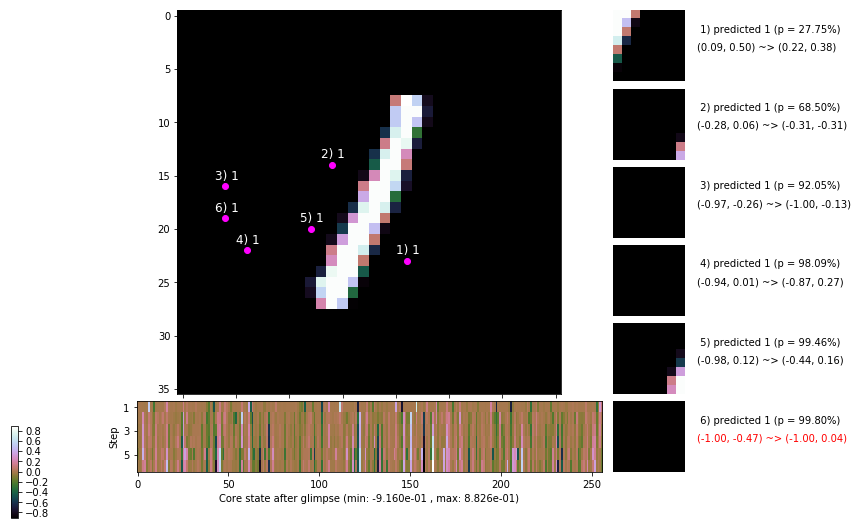

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 155.3 ms/b | lr: 3.33e-04 | grad 2norm:  7.07 | grad inf norm:  2.025
         Weights || abs max:  2.31 ( 8194.13) | mean: -7.26e-04 ( 0.03) | var: 8.37e-02 (13158.50)
          Biases || abs max:  1.38 (  157.35) | mean: -1.54e-01 ( 0.15) | var: 1.04e-01 (  144.04)
                    class loss: 0.294 | steps: 2.186 | reward:  4.548 | acc.: 89.78%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 162.0 ms/b | lr: 3.33e-04 | grad 2norm:  7.01 | grad inf norm:  2.052
         Weights || abs max:  2.32 ( 2617.05) | mean: -7.44e-04 ( 0.01) | var: 8.38e-02 (   98.89)
          Biases || abs max:  1.39 (  440.42) | mean: -1.54e-01 ( 0.28) | var: 1.04e-01 (10958.26)
                    class loss: 0.325 | steps: 2.216 | reward:  4.500 | acc.: 89.27%

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.1

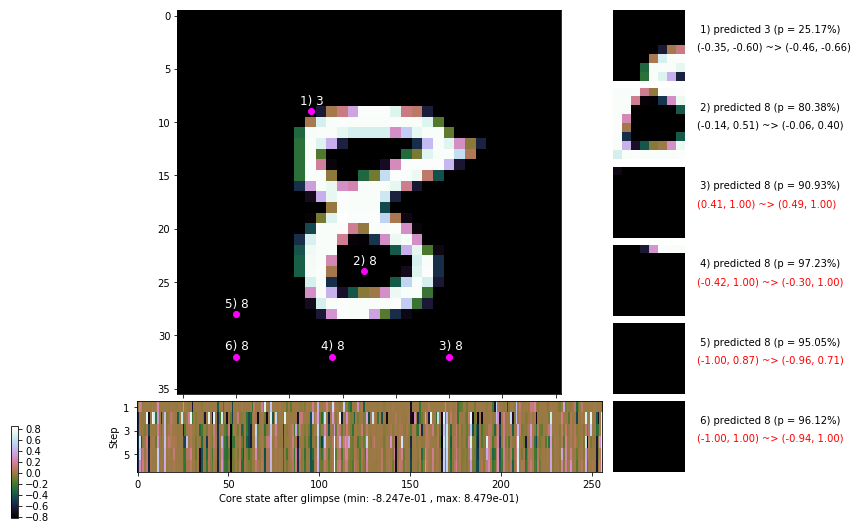

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 165.2 ms/b | lr: 3.32e-04 | grad 2norm:  7.18 | grad inf norm:  2.119
         Weights || abs max:  2.32 ( 3248.57) | mean: -7.66e-04 ( 0.02) | var: 8.38e-02 (  678.74)
          Biases || abs max:  1.39 (  100.81) | mean: -1.54e-01 ( 0.13) | var: 1.04e-01 (   63.00)
                    class loss: 0.311 | steps: 2.177 | reward:  4.543 | acc.: 89.50%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 168.1 ms/b | lr: 3.32e-04 | grad 2norm:  7.11 | grad inf norm:  2.120
         Weights || abs max:  2.32 ( 2785.85) | mean: -7.63e-04 ( 0.02) | var: 8.38e-02 (  156.12)
          Biases || abs max:  1.39 (  144.39) | mean: -1.54e-01 ( 0.17) | var: 1.05e-01 (  132.40)
                    class loss: 0.318 | steps: 2.202 | reward:  4.531 | acc.: 89.58%

	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.1

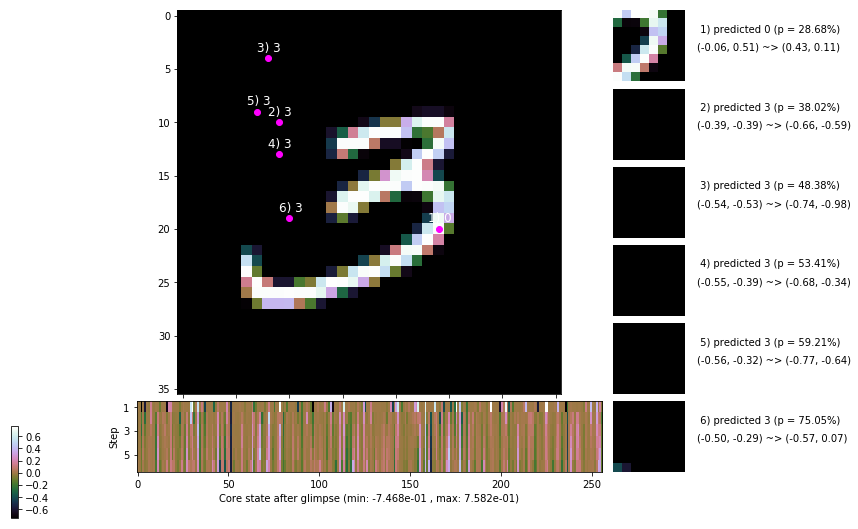

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 166.5 ms/b | lr: 3.31e-04 | grad 2norm:  7.15 | grad inf norm:  2.052
         Weights || abs max:  2.32 ( 6863.30) | mean: -7.36e-04 ( 0.02) | var: 8.38e-02 ( 7040.58)
          Biases || abs max:  1.39 (  637.61) | mean: -1.54e-01 ( 0.36) | var: 1.05e-01 (16555.01)
                    class loss: 0.315 | steps: 2.180 | reward:  4.544 | acc.: 89.30%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 162.8 ms/b | lr: 3.31e-04 | grad 2norm:  7.05 | grad inf norm:  2.093
         Weights || abs max:  2.32 ( 3514.36) | mean: -7.47e-04 ( 0.02) | var: 8.39e-02 (  692.78)
          Biases || abs max:  1.39 (  496.17) | mean: -1.54e-01 ( 0.31) | var: 1.05e-01 ( 2881.53)
                    class loss: 0.327 | steps: 2.174 | reward:  4.532 | acc.: 89.30%

	Target class: 2 | Discounted rewards: [0.111, 1.111, 1.1

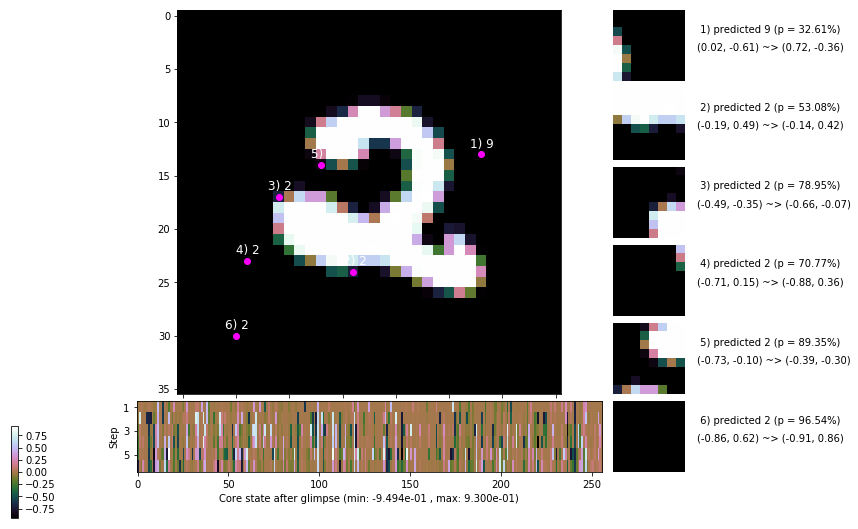

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 160.3 ms/b | lr: 3.30e-04 | grad 2norm:  6.90 | grad inf norm:  2.028
         Weights || abs max:  2.31 ( 3425.84) | mean: -7.44e-04 ( 0.02) | var: 8.39e-02 (  240.34)
          Biases || abs max:  1.39 (  165.90) | mean: -1.54e-01 ( 0.19) | var: 1.05e-01 (  120.55)
                    class loss: 0.314 | steps: 2.162 | reward:  4.569 | acc.: 89.67%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 162.6 ms/b | lr: 3.30e-04 | grad 2norm:  7.13 | grad inf norm:  2.172
         Weights || abs max:  2.31 ( 9083.31) | mean: -7.38e-04 ( 0.03) | var: 8.39e-02 ( 4833.50)
          Biases || abs max:  1.40 (  264.35) | mean: -1.54e-01 ( 0.22) | var: 1.05e-01 (  648.71)
                    class loss: 0.313 | steps: 2.189 | reward:  4.542 | acc.: 89.33%

	Target class: 6 | Discounted rewards: [0.011, 0.111, 1.1

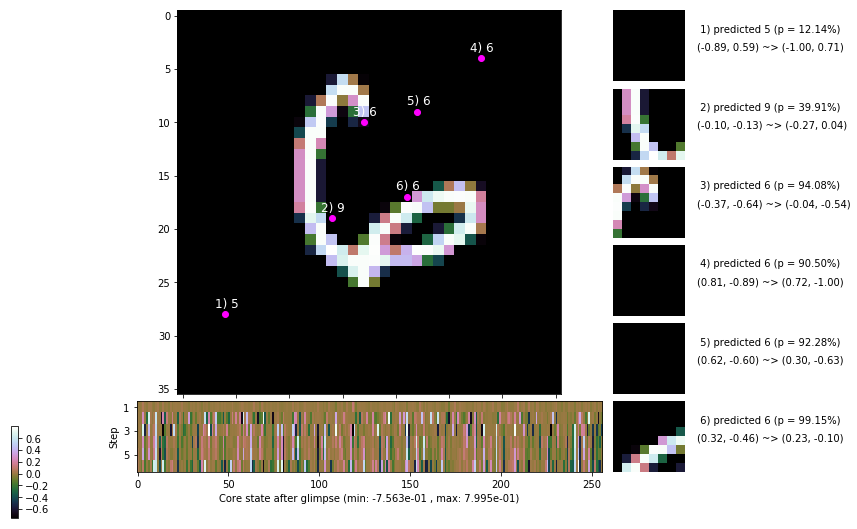

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


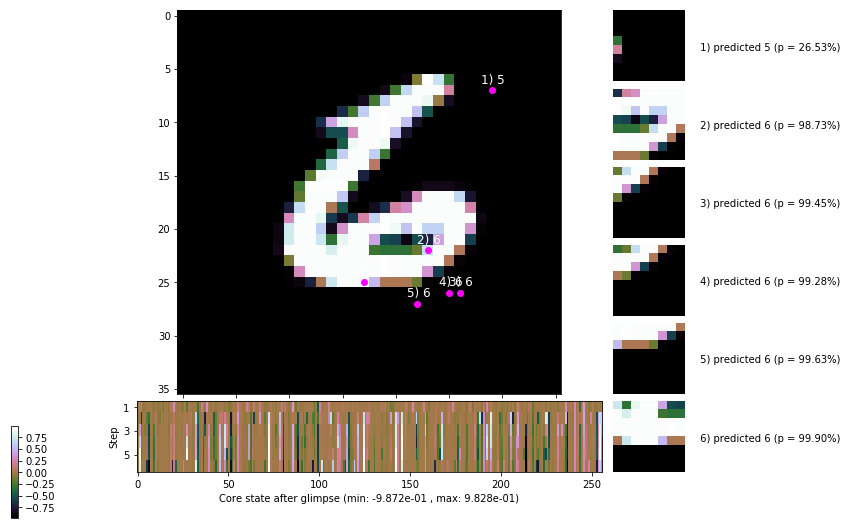


	Target class: 1 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


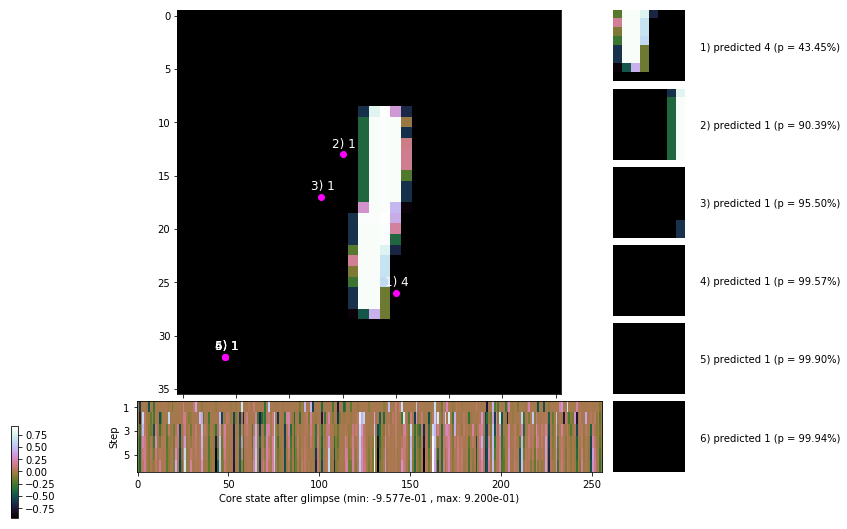

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


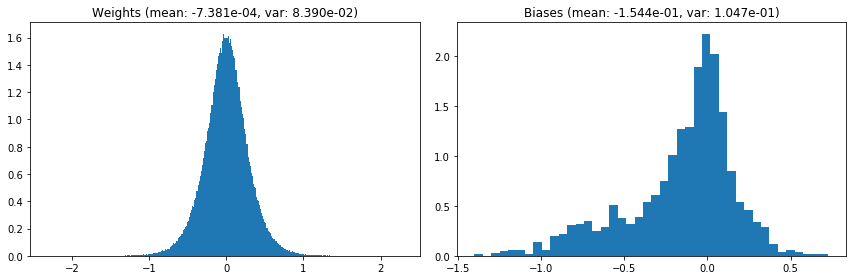

                                      Location network weights and biases


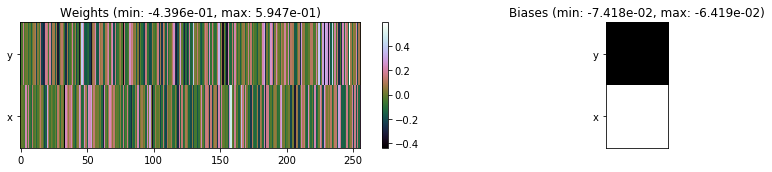

---------------------------------------------------------------------------------------------------------------
Elapsed time:  479.19 sec | TRAIN >> class loss: 0.3117 | steps:  2.186 :( | reward:  4.5377 :( | acc.: 89.525% :(
                          | VAL   >> class loss: 0.3671 | steps:  2.129 :( | reward:  4.5656 :( | acc.: 87.220% :(


Epoch  75/400) lr = 0.0003294
 b    300/  3000 >> 157.7 ms/b | lr: 3.29e-04 | grad 2norm:  7.11 | grad inf norm:  2.144
         Weights || abs max:  2.32 ( 5508.59) | mean: -7.37e-04 ( 0.02) | var: 8.39e-02 (  847.92)
          Biases || abs max:  1.40 (  253.95) | mean: -1.55e-01 ( 0.25) | var: 1.05e-01 (  644.32)
                    class loss: 0.319 | steps: 2.205 | reward:  4.522 | acc.: 89.50%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 167.5 ms/b | lr: 3.29e-04 | grad 2norm:  6.82 | grad inf norm:  2.010
         Weights || abs max:  2.32 ( 9584.09) | mean: -7.42e-04 (

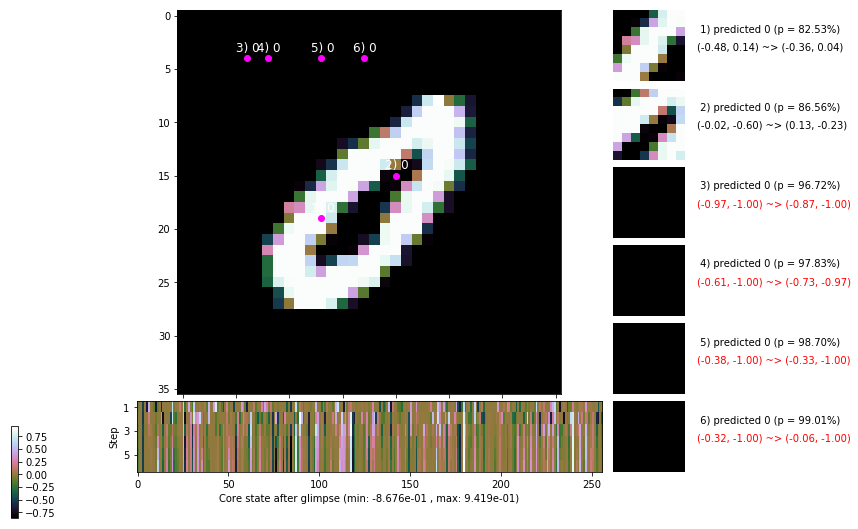

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 166.7 ms/b | lr: 3.28e-04 | grad 2norm:  7.14 | grad inf norm:  2.113
         Weights || abs max:  2.32 ( 4849.51) | mean: -7.45e-04 ( 0.02) | var: 8.40e-02 (  917.32)
          Biases || abs max:  1.39 (  892.56) | mean: -1.55e-01 ( 0.48) | var: 1.05e-01 (42166.40)
                    class loss: 0.321 | steps: 2.186 | reward:  4.525 | acc.: 89.47%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 160.8 ms/b | lr: 3.28e-04 | grad 2norm:  7.03 | grad inf norm:  2.042
         Weights || abs max:  2.32 ( 6766.99) | mean: -7.53e-04 ( 0.02) | var: 8.40e-02 ( 3016.95)
          Biases || abs max:  1.39 (  293.59) | mean: -1.54e-01 ( 0.21) | var: 1.05e-01 (  661.26)
                    class loss: 0.316 | steps: 2.196 | reward:  4.555 | acc.: 89.60%

	Target class: 4 | Discounted rewards: [0.111, 1.111, 1.1

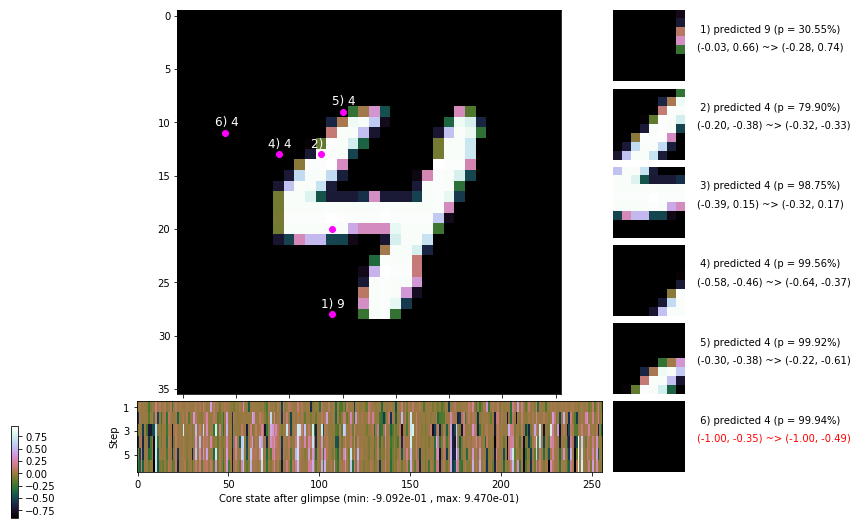

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 159.6 ms/b | lr: 3.27e-04 | grad 2norm:  7.15 | grad inf norm:  2.121
         Weights || abs max:  2.31 ( 3468.93) | mean: -7.42e-04 ( 0.02) | var: 8.40e-02 (  205.14)
          Biases || abs max:  1.39 (  173.56) | mean: -1.55e-01 ( 0.17) | var: 1.05e-01 (  368.42)
                    class loss: 0.323 | steps: 2.182 | reward:  4.539 | acc.: 89.50%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 155.8 ms/b | lr: 3.27e-04 | grad 2norm:  6.89 | grad inf norm:  2.072
         Weights || abs max:  2.31 ( 3246.59) | mean: -7.24e-04 ( 0.02) | var: 8.41e-02 (  148.54)
          Biases || abs max:  1.39 (  887.51) | mean: -1.55e-01 ( 0.46) | var: 1.05e-01 (51372.54)
                    class loss: 0.304 | steps: 2.152 | reward:  4.587 | acc.: 89.73%

	Target class: 4 | Discounted rewards: [0.111, 1.111, 1.1

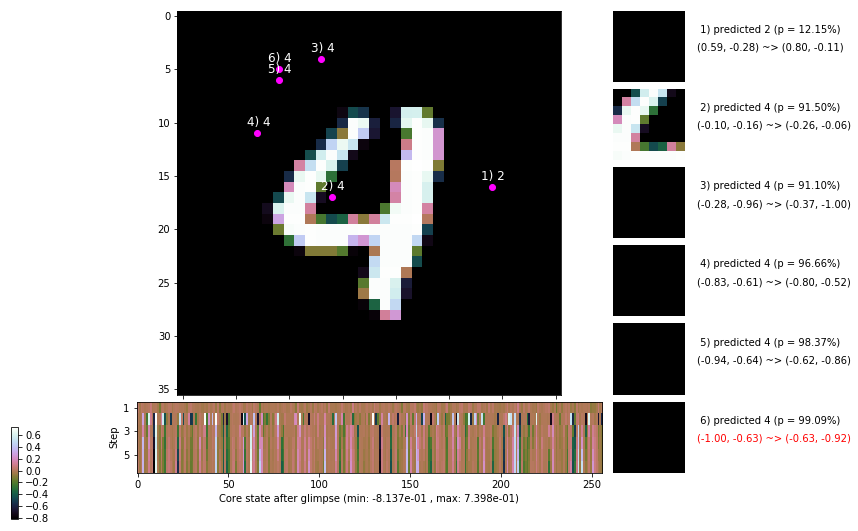

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 160.3 ms/b | lr: 3.26e-04 | grad 2norm:  7.24 | grad inf norm:  2.114
         Weights || abs max:  2.32 ( 4122.14) | mean: -7.15e-04 ( 0.02) | var: 8.41e-02 (  341.35)
          Biases || abs max:  1.39 (  223.72) | mean: -1.55e-01 ( 0.20) | var: 1.05e-01 (  146.49)
                    class loss: 0.322 | steps: 2.220 | reward:  4.511 | acc.: 89.27%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 156.7 ms/b | lr: 3.26e-04 | grad 2norm:  7.34 | grad inf norm:  2.273
         Weights || abs max:  2.32 (10798.67) | mean: -7.19e-04 ( 0.03) | var: 8.41e-02 (15540.96)
          Biases || abs max:  1.39 (  296.18) | mean: -1.55e-01 ( 0.24) | var: 1.05e-01 ( 1595.10)
                    class loss: 0.328 | steps: 2.225 | reward:  4.484 | acc.: 88.38%

	Target class: 7 | Discounted rewards: [1.010, 0.101, 1.0

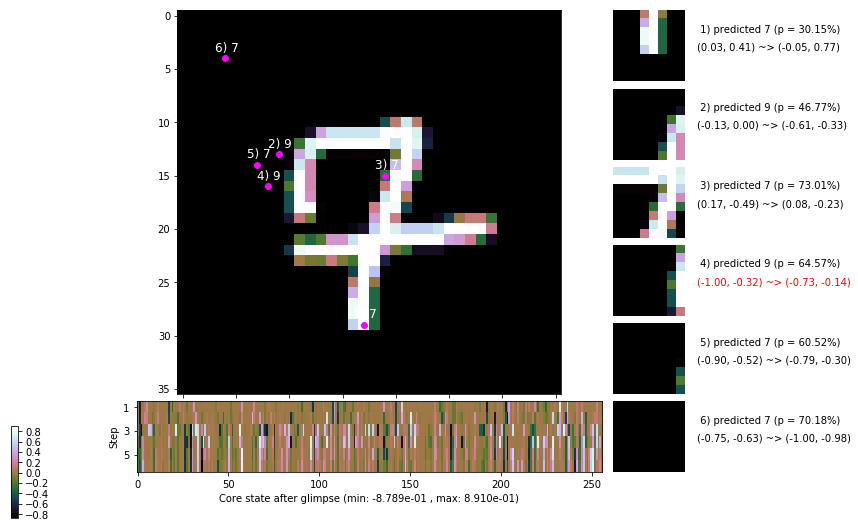

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 158.4 ms/b | lr: 3.25e-04 | grad 2norm:  6.88 | grad inf norm:  2.024
         Weights || abs max:  2.32 ( 3741.56) | mean: -7.22e-04 ( 0.02) | var: 8.41e-02 (  584.55)
          Biases || abs max:  1.39 (  308.06) | mean: -1.55e-01 ( 0.26) | var: 1.05e-01 (  653.07)
                    class loss: 0.328 | steps: 2.204 | reward:  4.532 | acc.: 89.50%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 159.1 ms/b | lr: 3.25e-04 | grad 2norm:  7.14 | grad inf norm:  2.070
         Weights || abs max:  2.32 ( 9464.30) | mean: -7.24e-04 ( 0.03) | var: 8.41e-02 (20186.23)
          Biases || abs max:  1.39 (  166.01) | mean: -1.55e-01 ( 0.17) | var: 1.05e-01 (  264.40)
                    class loss: 0.337 | steps: 2.182 | reward:  4.513 | acc.: 88.57%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.1

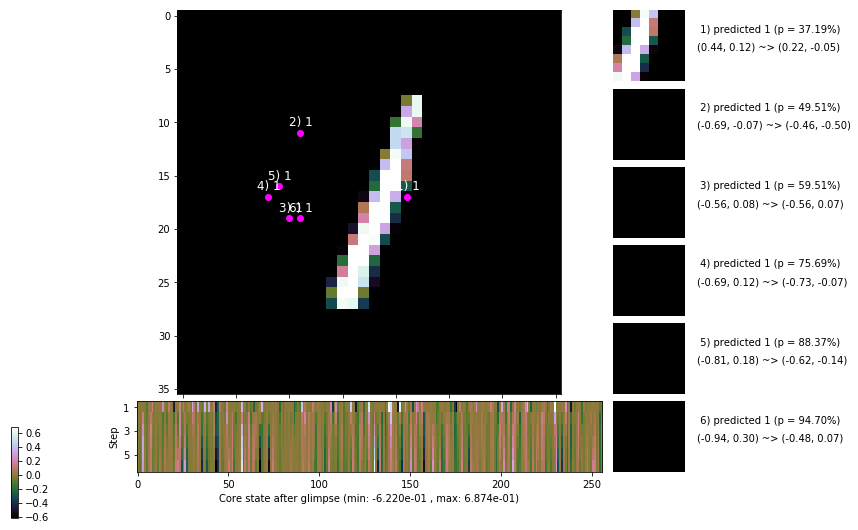

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.001, 0.010, 0.100, 1.000, 0.000, 0.000]


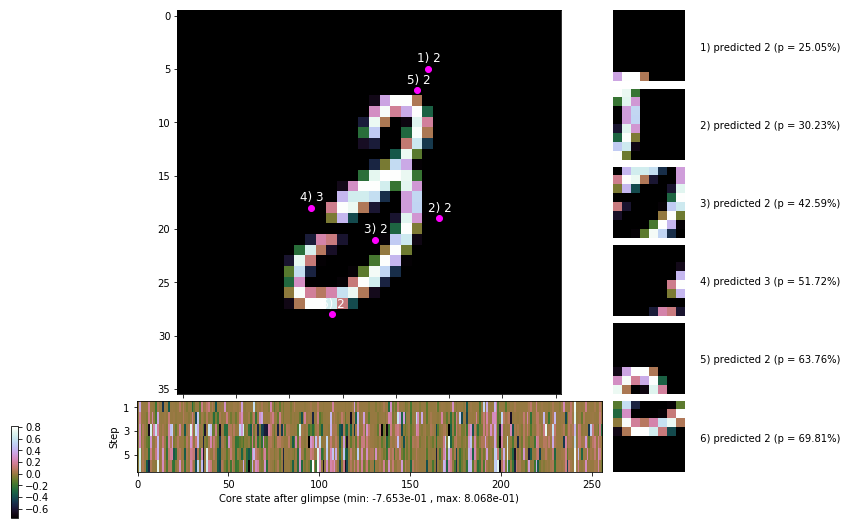


	Target class: 0 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


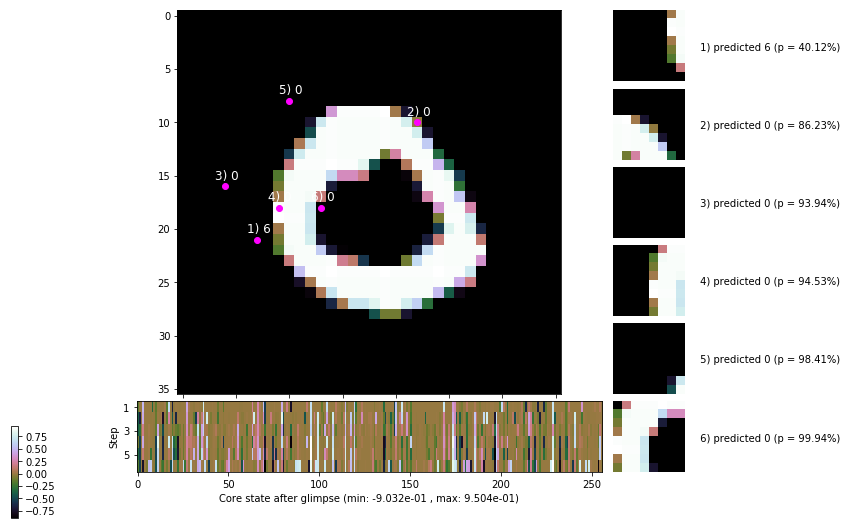

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


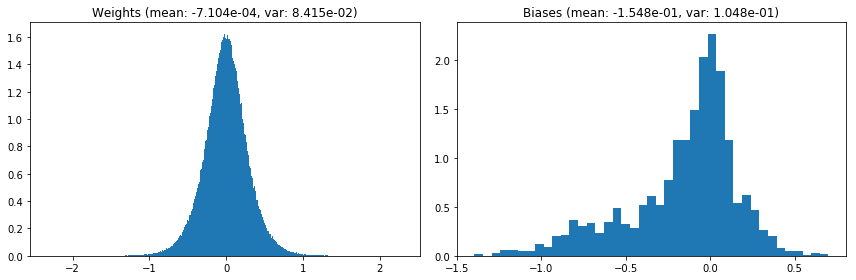

                                      Location network weights and biases


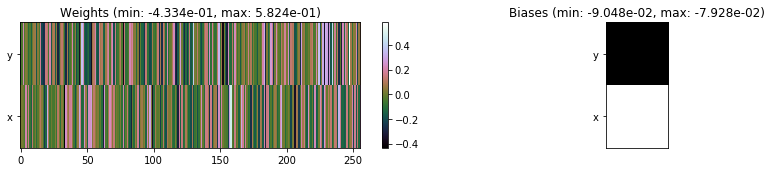

---------------------------------------------------------------------------------------------------------------
Elapsed time:  481.62 sec | TRAIN >> class loss: 0.3198 | steps:  2.195 :( | reward:  4.5315 :( | acc.: 89.325% :(
                          | VAL   >> class loss: 0.3449 | steps:  2.117 :( | reward:  4.6156 :( | acc.: 88.160% :(


Epoch  76/400) lr = 0.0003245
 b    300/  3000 >> 159.4 ms/b | lr: 3.24e-04 | grad 2norm:  6.98 | grad inf norm:  2.105
         Weights || abs max:  2.32 ( 5532.62) | mean: -7.16e-04 ( 0.02) | var: 8.42e-02 (  675.50)
          Biases || abs max:  1.40 (  164.80) | mean: -1.55e-01 ( 0.19) | var: 1.05e-01 (   79.78)
                    class loss: 0.294 | steps: 2.158 | reward:  4.576 | acc.: 89.87%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 164.0 ms/b | lr: 3.24e-04 | grad 2norm:  7.01 | grad inf norm:  2.040
         Weights || abs max:  2.32 ( 3907.33) | mean: -7.15e-04 (

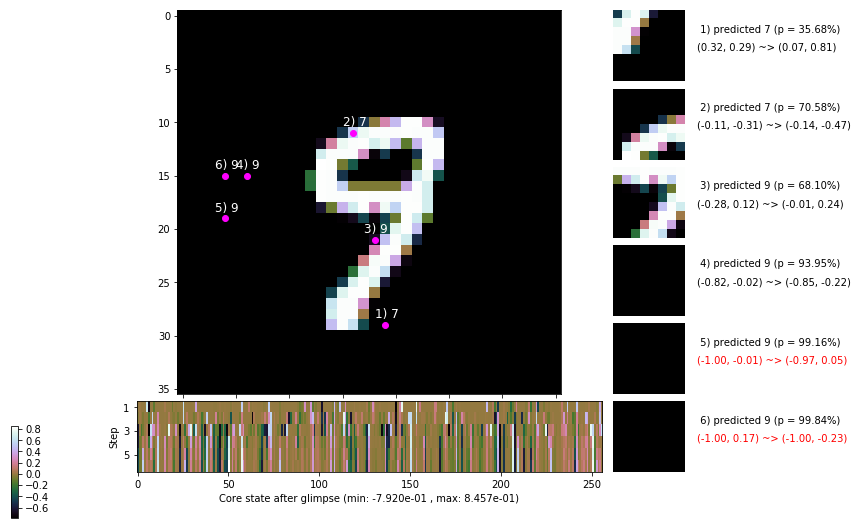

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 163.8 ms/b | lr: 3.23e-04 | grad 2norm:  6.94 | grad inf norm:  2.088
         Weights || abs max:  2.32 ( 3392.99) | mean: -7.10e-04 ( 0.02) | var: 8.42e-02 (  306.59)
          Biases || abs max:  1.40 (  466.51) | mean: -1.55e-01 ( 0.31) | var: 1.05e-01 ( 8970.62)
                    class loss: 0.306 | steps: 2.172 | reward:  4.566 | acc.: 90.20%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 167.6 ms/b | lr: 3.23e-04 | grad 2norm:  7.13 | grad inf norm:  2.047
         Weights || abs max:  2.32 ( 7164.97) | mean: -7.13e-04 ( 0.02) | var: 8.42e-02 ( 7214.75)
          Biases || abs max:  1.40 (  113.76) | mean: -1.55e-01 ( 0.13) | var: 1.05e-01 (  173.67)
                    class loss: 0.335 | steps: 2.203 | reward:  4.508 | acc.: 88.83%

	Target class: 8 | Discounted rewards: [1.111, 1.111, 1.1

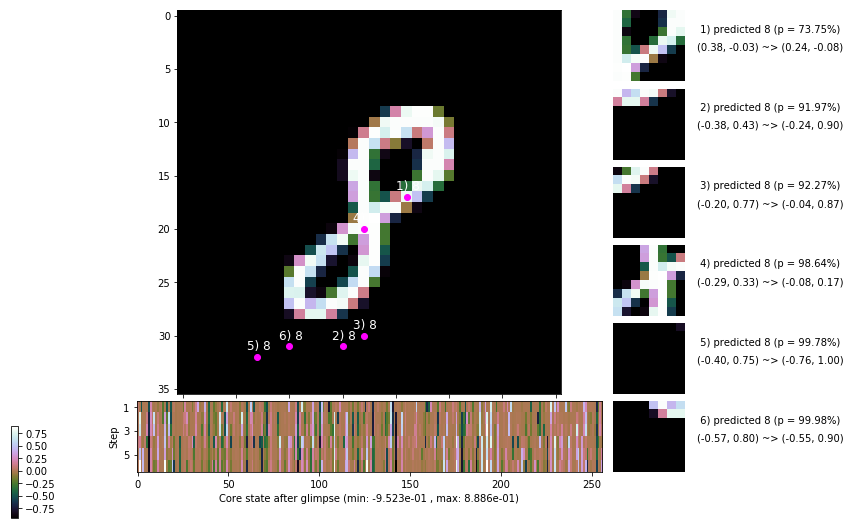

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 167.9 ms/b | lr: 3.22e-04 | grad 2norm:  7.14 | grad inf norm:  2.076
         Weights || abs max:  2.32 ( 4737.25) | mean: -7.20e-04 ( 0.02) | var: 8.42e-02 ( 1776.59)
          Biases || abs max:  1.40 (  128.48) | mean: -1.55e-01 ( 0.15) | var: 1.05e-01 (   79.32)
                    class loss: 0.305 | steps: 2.211 | reward:  4.537 | acc.: 89.85%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 160.4 ms/b | lr: 3.22e-04 | grad 2norm:  7.17 | grad inf norm:  2.113
         Weights || abs max:  2.32 ( 3073.86) | mean: -7.11e-04 ( 0.02) | var: 8.42e-02 (  246.23)
          Biases || abs max:  1.40 (  218.37) | mean: -1.55e-01 ( 0.20) | var: 1.05e-01 (  315.12)
                    class loss: 0.324 | steps: 2.180 | reward:  4.538 | acc.: 89.20%

	Target class: 2 | Discounted rewards: [0.111, 1.111, 1.1

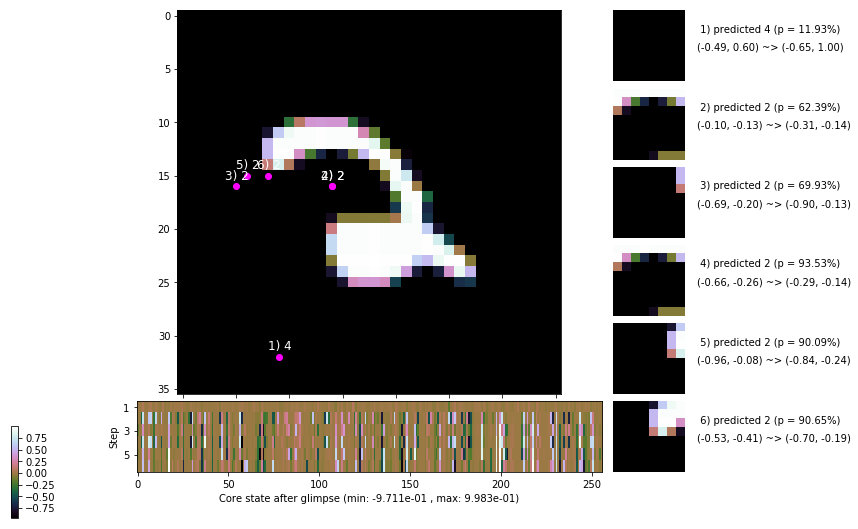

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 155.3 ms/b | lr: 3.21e-04 | grad 2norm:  7.14 | grad inf norm:  2.090
         Weights || abs max:  2.32 ( 5661.52) | mean: -7.30e-04 ( 0.02) | var: 8.43e-02 ( 4477.06)
          Biases || abs max:  1.40 (  188.28) | mean: -1.55e-01 ( 0.19) | var: 1.05e-01 (  202.20)
                    class loss: 0.324 | steps: 2.196 | reward:  4.535 | acc.: 88.97%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 149.2 ms/b | lr: 3.21e-04 | grad 2norm:  7.10 | grad inf norm:  2.065
         Weights || abs max:  2.32 ( 3556.03) | mean: -7.25e-04 ( 0.02) | var: 8.43e-02 (  268.32)
          Biases || abs max:  1.39 ( 3200.40) | mean: -1.55e-01 ( 1.58) | var: 1.05e-01 (528496.94)
                    class loss: 0.323 | steps: 2.213 | reward:  4.509 | acc.: 89.08%

	Target class: 8 | Discounted rewards: [0.111, 1.111, 1.

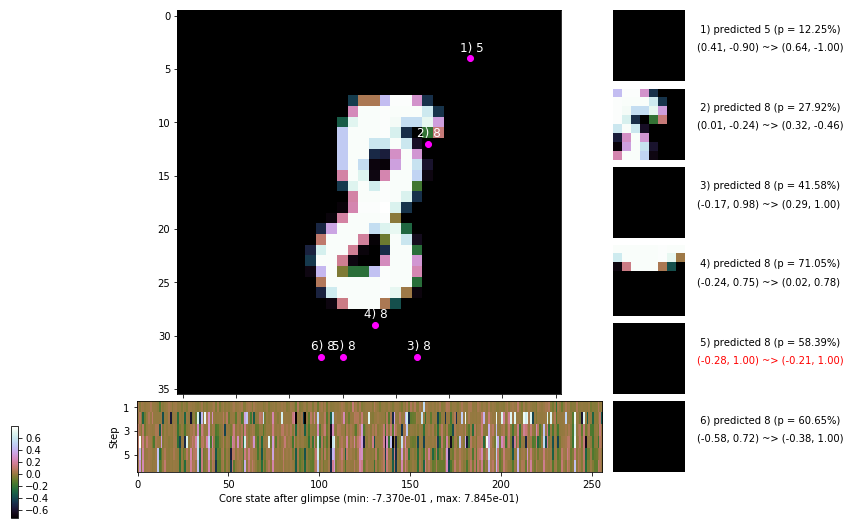

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.0 ms/b | lr: 3.20e-04 | grad 2norm:  7.10 | grad inf norm:  2.147
         Weights || abs max:  2.32 ( 7103.10) | mean: -7.28e-04 ( 0.02) | var: 8.43e-02 (10654.34)
          Biases || abs max:  1.40 (  540.45) | mean: -1.55e-01 ( 0.33) | var: 1.05e-01 (12064.97)
                    class loss: 0.327 | steps: 2.201 | reward:  4.515 | acc.: 88.95%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 151.9 ms/b | lr: 3.20e-04 | grad 2norm:  7.12 | grad inf norm:  2.099
         Weights || abs max:  2.32 ( 4689.75) | mean: -7.18e-04 ( 0.02) | var: 8.43e-02 ( 1924.94)
          Biases || abs max:  1.39 (  178.84) | mean: -1.55e-01 ( 0.20) | var: 1.05e-01 (  231.68)
                    class loss: 0.330 | steps: 2.224 | reward:  4.500 | acc.: 89.20%

	Target class: 3 | Discounted rewards: [0.111, 1.111, 1.1

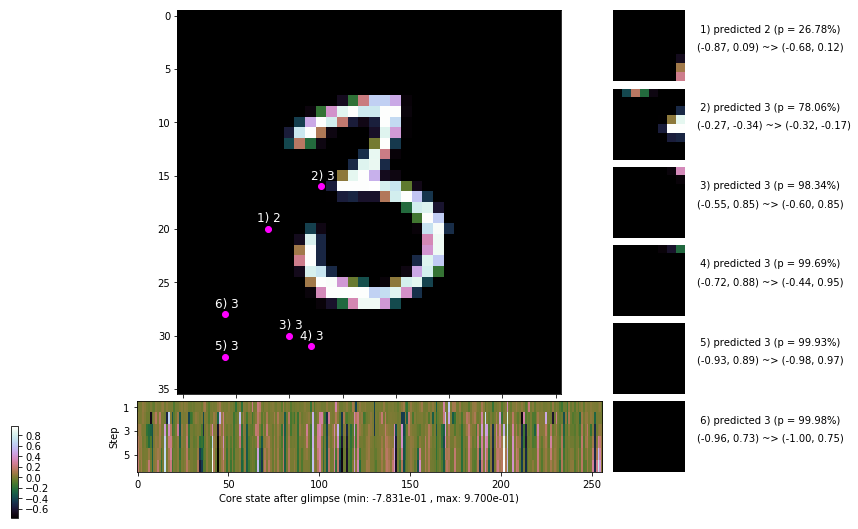

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.011, 0.111, 1.111, 1.110, 1.100, 1.000]


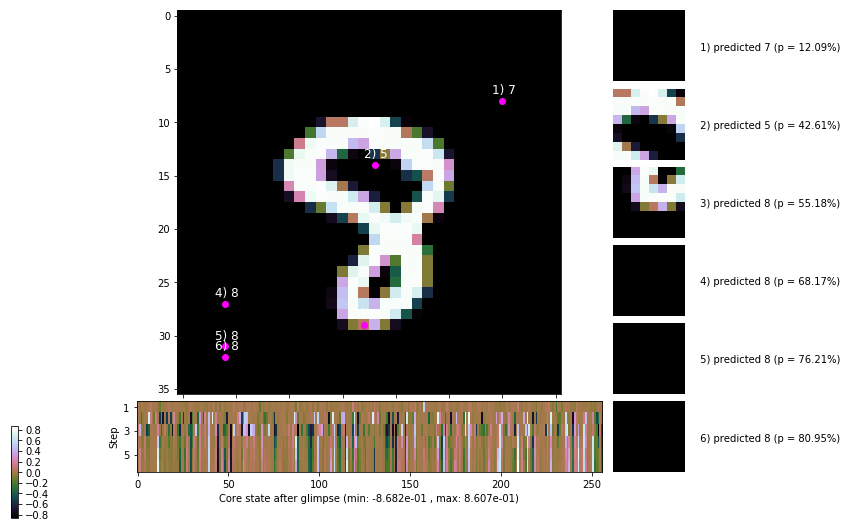


	Target class: 0 | Discounted rewards: [0.011, 0.111, 1.111, 1.110, 1.100, 1.000]


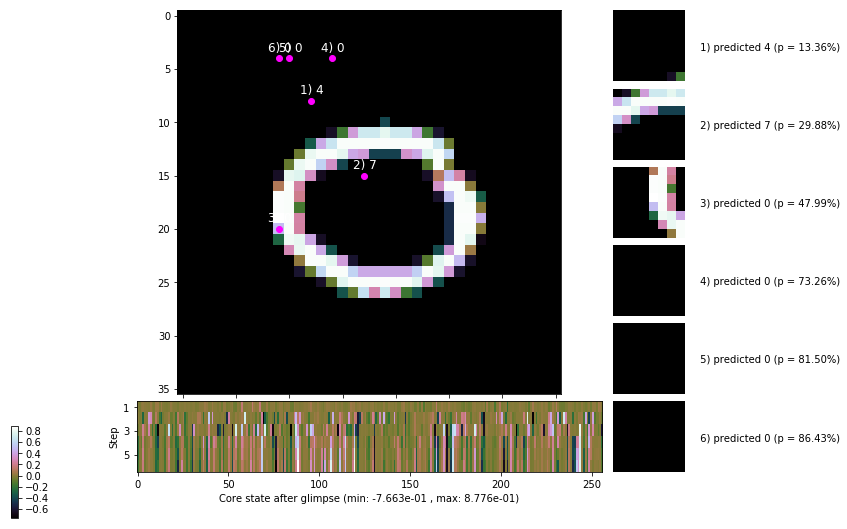

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


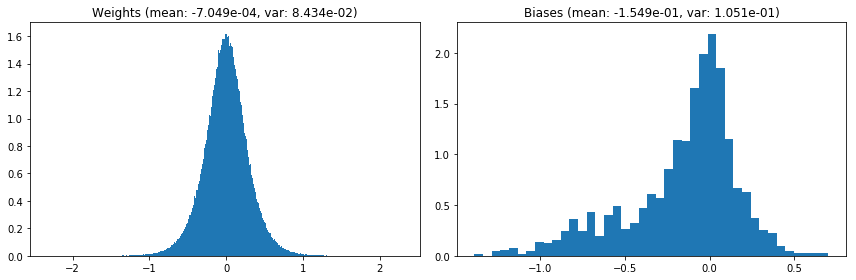

                                      Location network weights and biases


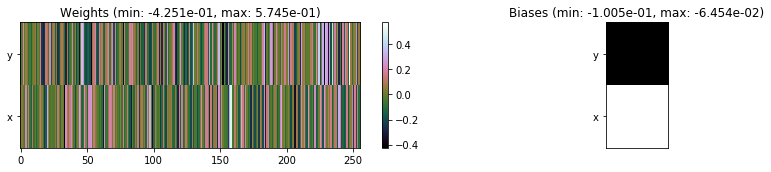

---------------------------------------------------------------------------------------------------------------
Elapsed time:  478.87 sec | TRAIN >> class loss: 0.3189 | steps:  2.195 :( | reward:  4.5317 :( | acc.: 89.338% :(
                          | VAL   >> class loss: 0.3547 | steps:  2.139 :( | reward:  4.5764 :( | acc.: 87.800% :(


Epoch  77/400) lr = 0.0003196
 b    300/  3000 >> 151.9 ms/b | lr: 3.19e-04 | grad 2norm:  6.96 | grad inf norm:  2.066
         Weights || abs max:  2.32 ( 3186.24) | mean: -7.07e-04 ( 0.02) | var: 8.44e-02 (  376.34)
          Biases || abs max:  1.39 (  177.78) | mean: -1.55e-01 ( 0.17) | var: 1.05e-01 (   83.84)
                    class loss: 0.305 | steps: 2.176 | reward:  4.557 | acc.: 89.73%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 150.1 ms/b | lr: 3.19e-04 | grad 2norm:  7.23 | grad inf norm:  2.147
         Weights || abs max:  2.32 ( 4539.29) | mean: -7.11e-04 (

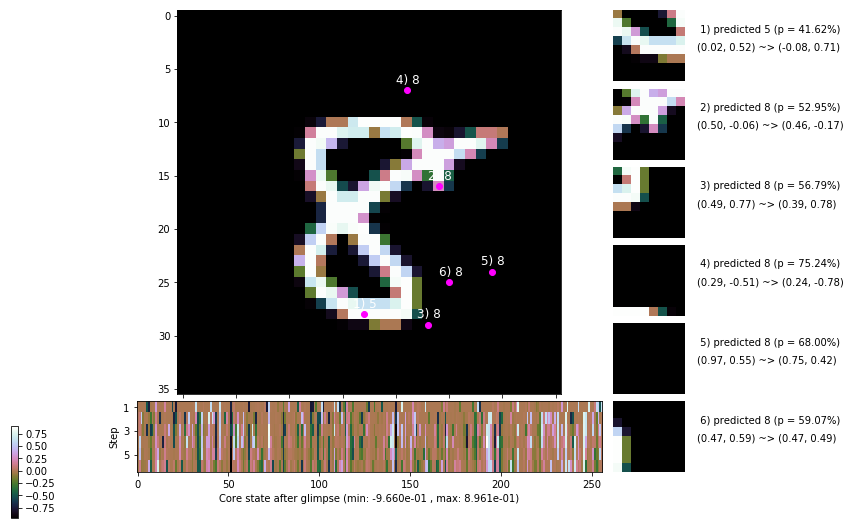

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 153.6 ms/b | lr: 3.18e-04 | grad 2norm:  7.01 | grad inf norm:  2.093
         Weights || abs max:  2.32 ( 2795.64) | mean: -7.30e-04 ( 0.02) | var: 8.44e-02 (   98.60)
          Biases || abs max:  1.39 ( 1050.59) | mean: -1.55e-01 ( 0.51) | var: 1.05e-01 (95921.74)
                    class loss: 0.327 | steps: 2.217 | reward:  4.499 | acc.: 89.08%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 153.2 ms/b | lr: 3.18e-04 | grad 2norm:  7.01 | grad inf norm:  2.081
         Weights || abs max:  2.33 ( 5782.36) | mean: -7.31e-04 ( 0.02) | var: 8.44e-02 ( 2692.82)
          Biases || abs max:  1.39 (  150.75) | mean: -1.55e-01 ( 0.17) | var: 1.05e-01 (   54.74)
                    class loss: 0.320 | steps: 2.194 | reward:  4.540 | acc.: 89.35%

	Target class: 4 | Discounted rewards: [1.001, 0.011, 0.1

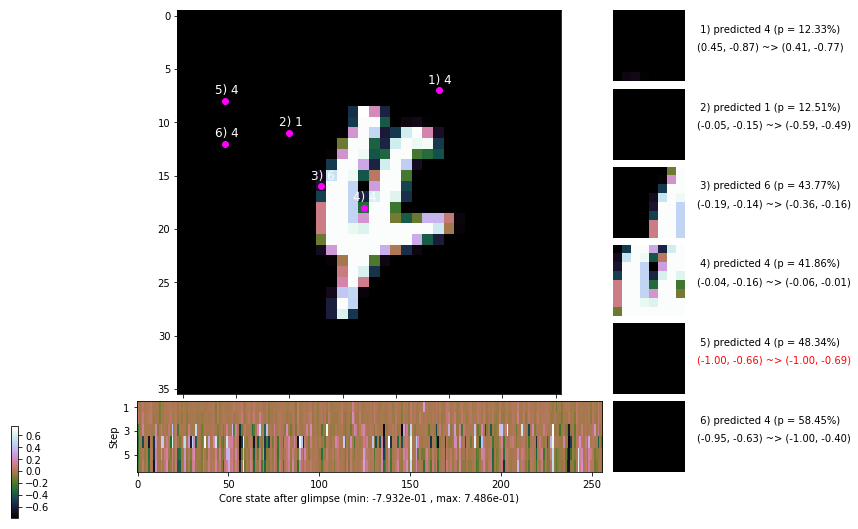

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.7 ms/b | lr: 3.17e-04 | grad 2norm:  7.20 | grad inf norm:  2.085
         Weights || abs max:  2.32 ( 3065.61) | mean: -7.33e-04 ( 0.02) | var: 8.44e-02 (  171.43)
          Biases || abs max:  1.40 (  117.47) | mean: -1.55e-01 ( 0.14) | var: 1.05e-01 (   59.70)
                    class loss: 0.340 | steps: 2.203 | reward:  4.506 | acc.: 88.70%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 151.7 ms/b | lr: 3.17e-04 | grad 2norm:  6.99 | grad inf norm:  2.157
         Weights || abs max:  2.32 ( 8602.32) | mean: -7.37e-04 ( 0.03) | var: 8.44e-02 ( 6557.63)
          Biases || abs max:  1.40 (  101.97) | mean: -1.56e-01 ( 0.15) | var: 1.05e-01 (   35.87)
                    class loss: 0.328 | steps: 2.204 | reward:  4.513 | acc.: 89.15%

	Target class: 1 | Discounted rewards: [1.111, 1.111, 1.1

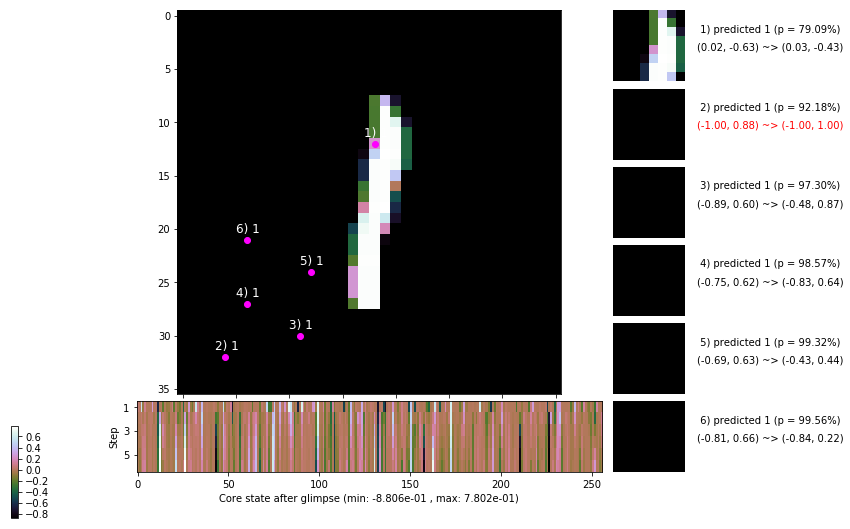

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 166.4 ms/b | lr: 3.16e-04 | grad 2norm:  6.87 | grad inf norm:  1.986
         Weights || abs max:  2.33 ( 5873.97) | mean: -7.20e-04 ( 0.02) | var: 8.45e-02 ( 1413.83)
          Biases || abs max:  1.39 (  413.19) | mean: -1.56e-01 ( 0.27) | var: 1.05e-01 ( 3593.44)
                    class loss: 0.309 | steps: 2.191 | reward:  4.533 | acc.: 89.70%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 161.3 ms/b | lr: 3.16e-04 | grad 2norm:  6.80 | grad inf norm:  2.013
         Weights || abs max:  2.33 ( 3857.02) | mean: -7.15e-04 ( 0.02) | var: 8.45e-02 (  290.69)
          Biases || abs max:  1.39 (  100.97) | mean: -1.55e-01 ( 0.14) | var: 1.05e-01 (  118.56)
                    class loss: 0.298 | steps: 2.165 | reward:  4.575 | acc.: 89.95%

	Target class: 6 | Discounted rewards: [0.111, 1.111, 1.1

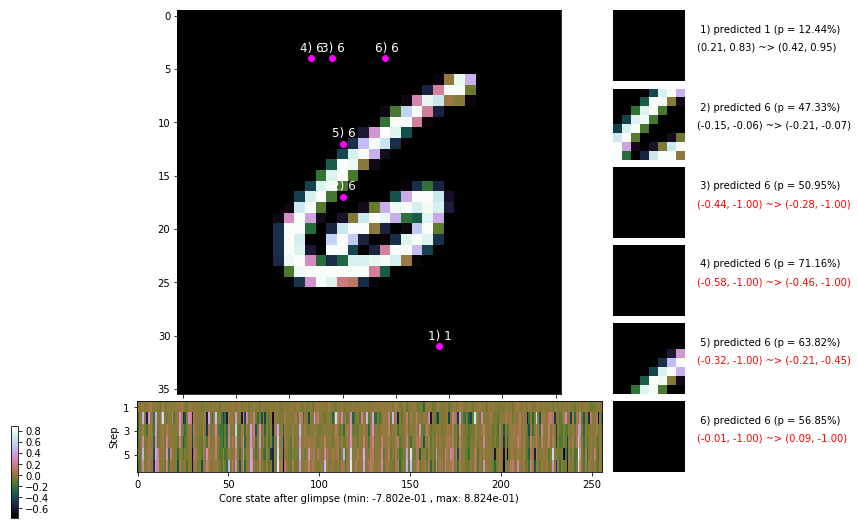

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 172.9 ms/b | lr: 3.16e-04 | grad 2norm:  6.75 | grad inf norm:  1.918
         Weights || abs max:  2.33 ( 2962.11) | mean: -7.04e-04 ( 0.02) | var: 8.45e-02 (  100.17)
          Biases || abs max:  1.39 (  205.69) | mean: -1.55e-01 ( 0.18) | var: 1.05e-01 (  265.67)
                    class loss: 0.287 | steps: 2.158 | reward:  4.595 | acc.: 90.27%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 166.9 ms/b | lr: 3.15e-04 | grad 2norm:  7.25 | grad inf norm:  2.120
         Weights || abs max:  2.33 ( 3365.63) | mean: -6.96e-04 ( 0.02) | var: 8.45e-02 ( 1047.52)
          Biases || abs max:  1.39 (  262.36) | mean: -1.55e-01 ( 0.23) | var: 1.05e-01 (  572.15)
                    class loss: 0.317 | steps: 2.197 | reward:  4.522 | acc.: 89.17%

	Target class: 5 | Discounted rewards: [0.111, 1.111, 1.1

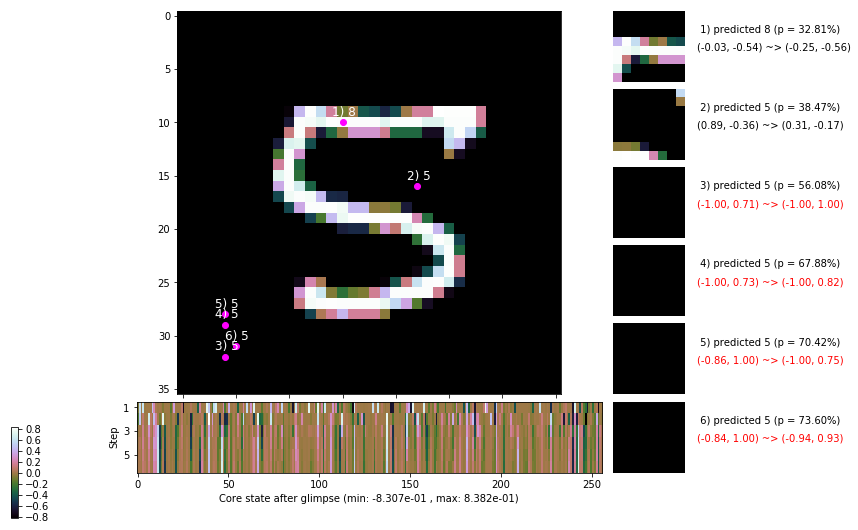

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


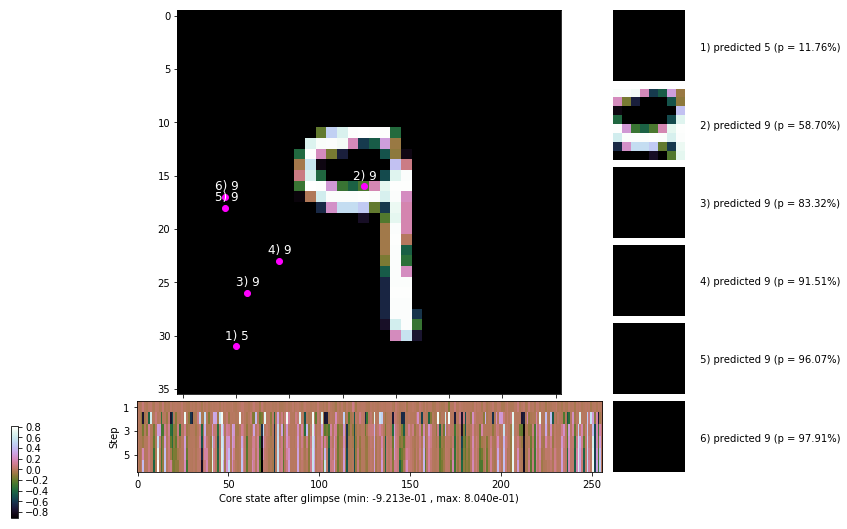


	Target class: 7 | Discounted rewards: [0.000, 0.000, 0.000, 0.000, 0.000, 0.000]


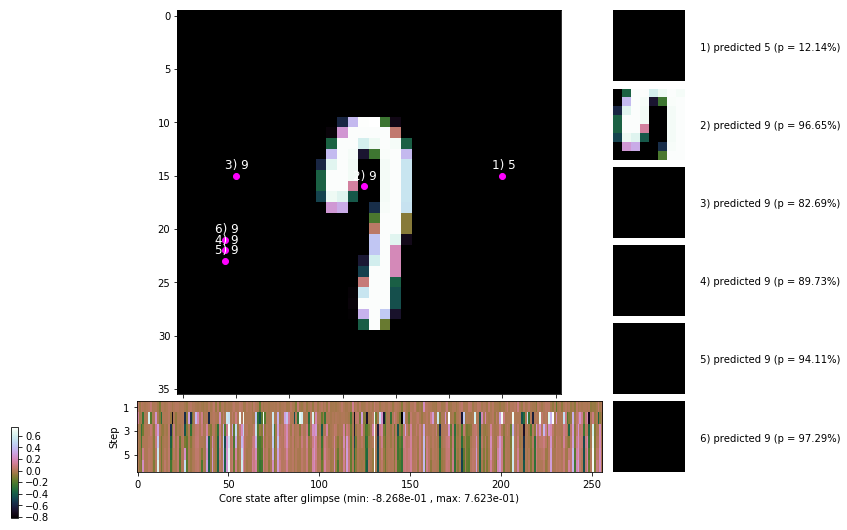

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


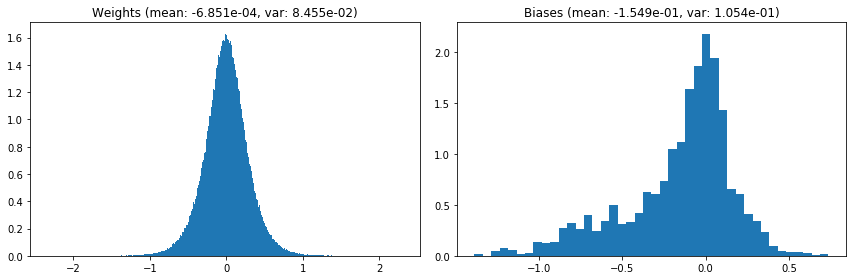

                                      Location network weights and biases


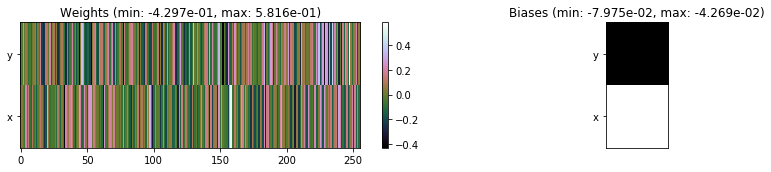

---------------------------------------------------------------------------------------------------------------
Elapsed time:  475.39 sec | TRAIN >> class loss: 0.3165 | steps:  2.191 :( | reward:  4.5339 :( | acc.: 89.382% :(
                          | VAL   >> class loss: 0.3229 | steps:  2.126 :( | reward:  4.6218 :( | acc.: 88.760% :(


Epoch  78/400) lr = 0.0003149
 b    300/  3000 >> 160.2 ms/b | lr: 3.15e-04 | grad 2norm:  7.22 | grad inf norm:  2.125
         Weights || abs max:  2.33 ( 7076.95) | mean: -6.83e-04 ( 0.02) | var: 8.46e-02 ( 2054.88)
          Biases || abs max:  1.39 (  184.71) | mean: -1.55e-01 ( 0.20) | var: 1.05e-01 (  143.12)
                    class loss: 0.314 | steps: 2.209 | reward:  4.534 | acc.: 89.42%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 158.6 ms/b | lr: 3.14e-04 | grad 2norm:  7.08 | grad inf norm:  2.136
         Weights || abs max:  2.33 ( 6642.51) | mean: -6.87e-04 (

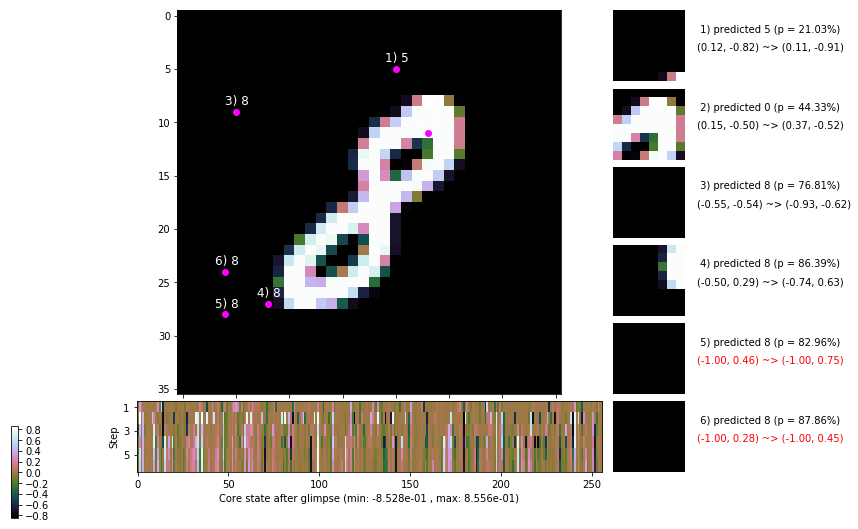

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 160.5 ms/b | lr: 3.14e-04 | grad 2norm:  6.95 | grad inf norm:  2.028
         Weights || abs max:  2.33 (10508.75) | mean: -6.94e-04 ( 0.03) | var: 8.46e-02 (21668.17)
          Biases || abs max:  1.39 (  488.14) | mean: -1.55e-01 ( 0.31) | var: 1.05e-01 ( 7732.95)
                    class loss: 0.314 | steps: 2.192 | reward:  4.531 | acc.: 89.52%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 155.0 ms/b | lr: 3.13e-04 | grad 2norm:  6.91 | grad inf norm:  2.002
         Weights || abs max:  2.32 (13789.95) | mean: -6.81e-04 ( 0.04) | var: 8.46e-02 (42118.64)
          Biases || abs max:  1.38 (  165.13) | mean: -1.55e-01 ( 0.17) | var: 1.05e-01 (   93.52)
                    class loss: 0.298 | steps: 2.174 | reward:  4.564 | acc.: 90.07%

	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.1

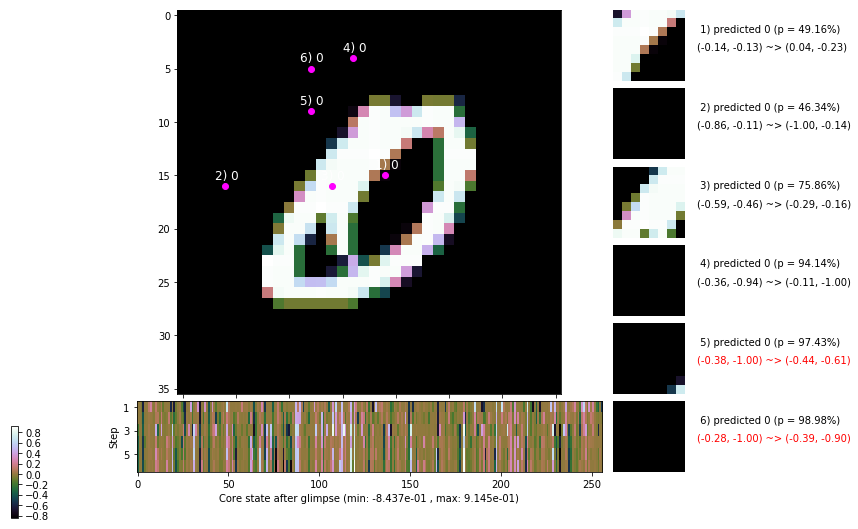

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 160.8 ms/b | lr: 3.13e-04 | grad 2norm:  7.04 | grad inf norm:  2.014
         Weights || abs max:  2.33 ( 7173.55) | mean: -6.78e-04 ( 0.02) | var: 8.46e-02 ( 7943.20)
          Biases || abs max:  1.38 (  331.03) | mean: -1.55e-01 ( 0.23) | var: 1.05e-01 (  837.48)
                    class loss: 0.317 | steps: 2.178 | reward:  4.540 | acc.: 89.65%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 156.8 ms/b | lr: 3.12e-04 | grad 2norm:  6.83 | grad inf norm:  1.990
         Weights || abs max:  2.32 (11942.48) | mean: -6.80e-04 ( 0.03) | var: 8.46e-02 (17447.75)
          Biases || abs max:  1.38 (  320.61) | mean: -1.55e-01 ( 0.23) | var: 1.05e-01 ( 2813.01)
                    class loss: 0.303 | steps: 2.191 | reward:  4.538 | acc.: 89.90%

	Target class: 4 | Discounted rewards: [0.111, 1.111, 1.1

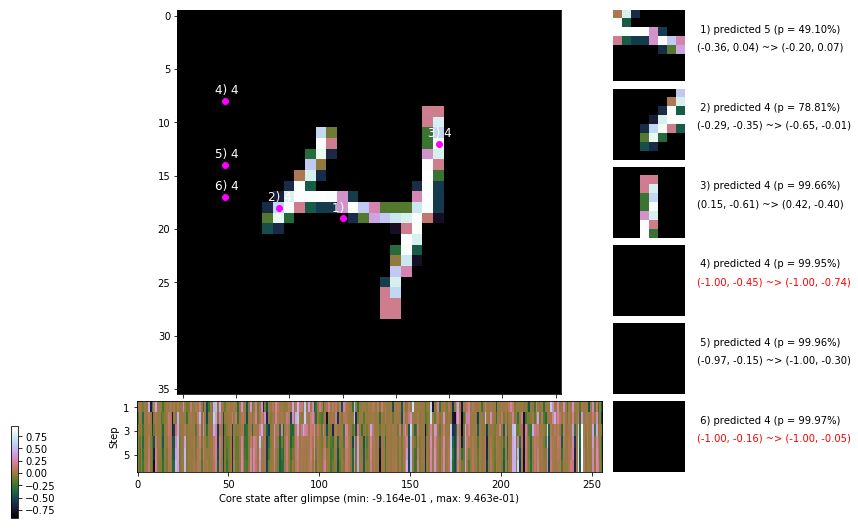

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 168.7 ms/b | lr: 3.12e-04 | grad 2norm:  7.08 | grad inf norm:  2.122
         Weights || abs max:  2.33 ( 3937.43) | mean: -6.74e-04 ( 0.02) | var: 8.46e-02 (  365.94)
          Biases || abs max:  1.39 (  539.85) | mean: -1.55e-01 ( 0.32) | var: 1.06e-01 (11083.39)
                    class loss: 0.318 | steps: 2.214 | reward:  4.488 | acc.: 88.97%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 171.5 ms/b | lr: 3.11e-04 | grad 2norm:  7.04 | grad inf norm:  2.068
         Weights || abs max:  2.33 ( 2954.44) | mean: -6.82e-04 ( 0.02) | var: 8.47e-02 (  212.04)
          Biases || abs max:  1.38 (  358.47) | mean: -1.56e-01 ( 0.29) | var: 1.06e-01 (  974.93)
                    class loss: 0.308 | steps: 2.199 | reward:  4.521 | acc.: 89.75%

	Target class: 8 | Discounted rewards: [0.011, 0.111, 1.1

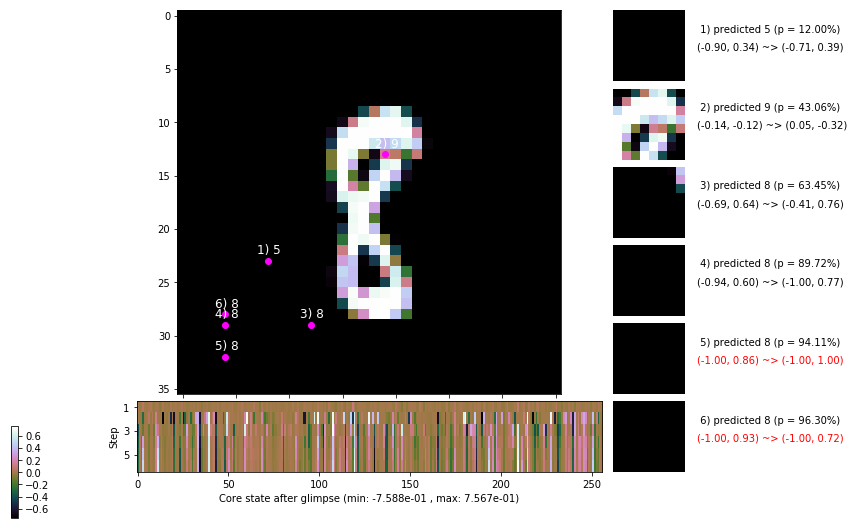

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 167.8 ms/b | lr: 3.11e-04 | grad 2norm:  6.86 | grad inf norm:  2.027
         Weights || abs max:  2.34 ( 4235.82) | mean: -6.85e-04 ( 0.02) | var: 8.47e-02 (  730.37)
          Biases || abs max:  1.39 (  141.03) | mean: -1.56e-01 ( 0.18) | var: 1.06e-01 (  155.81)
                    class loss: 0.292 | steps: 2.181 | reward:  4.556 | acc.: 90.13%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 170.2 ms/b | lr: 3.10e-04 | grad 2norm:  7.14 | grad inf norm:  2.014
         Weights || abs max:  2.34 ( 6673.29) | mean: -6.73e-04 ( 0.02) | var: 8.47e-02 ( 1712.79)
          Biases || abs max:  1.39 (   90.62) | mean: -1.55e-01 ( 0.13) | var: 1.06e-01 (   85.18)
                    class loss: 0.308 | steps: 2.196 | reward:  4.536 | acc.: 89.63%

	Target class: 0 | Discounted rewards: [0.111, 1.111, 1.1

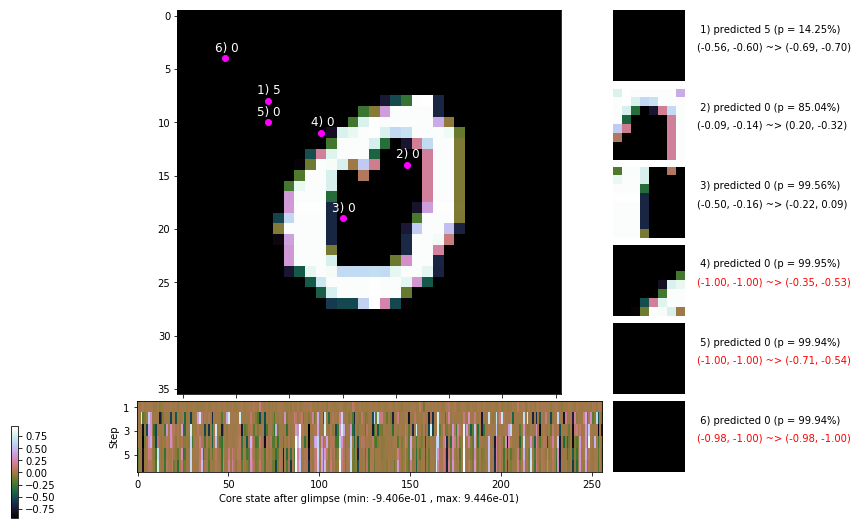

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [1.111, 1.111, 1.111, 1.110, 1.100, 1.000]


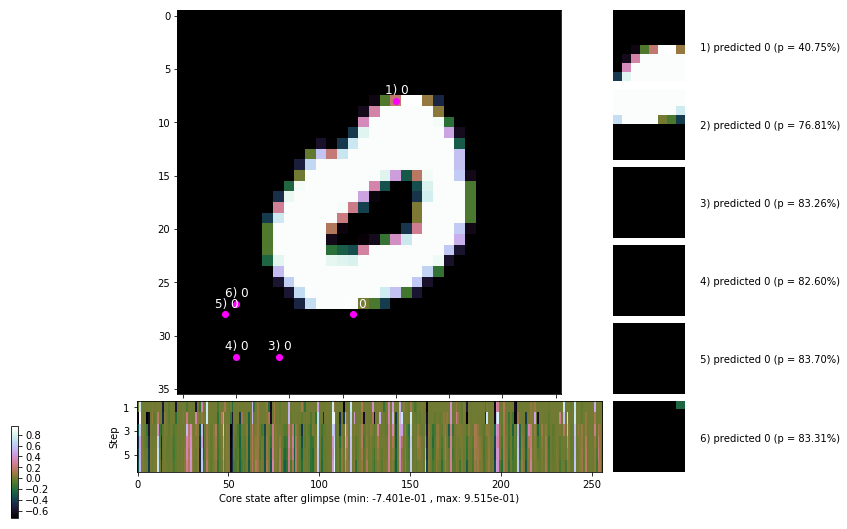


	Target class: 5 | Discounted rewards: [0.011, 0.111, 1.111, 1.110, 1.100, 1.000]


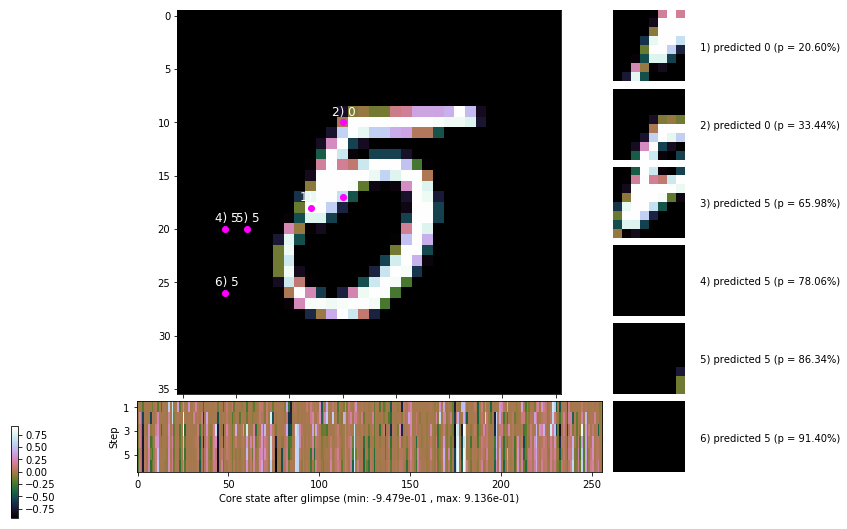

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


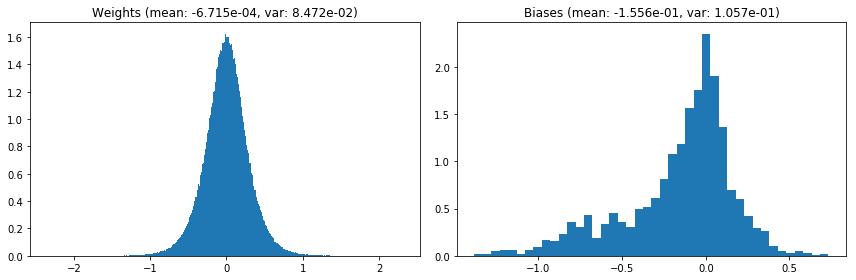

                                      Location network weights and biases


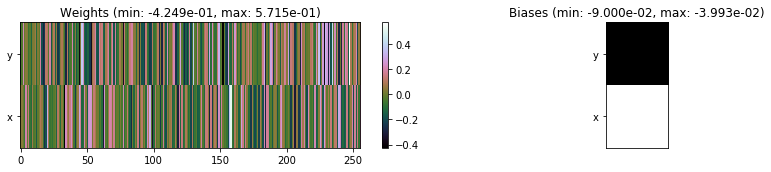

---------------------------------------------------------------------------------------------------------------
Elapsed time:  490.02 sec | TRAIN >> class loss: 0.3072 | steps:  2.190 :( | reward:  4.5376 :( | acc.: 89.700% :(
                          | VAL   >> class loss: 0.3278 | steps:  2.126 :( | reward:  4.6092 :( | acc.: 88.880% :(



			---~~~=== End of training ===~~~---

Evaluating on the TEST dataset...

	Target class: 4 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


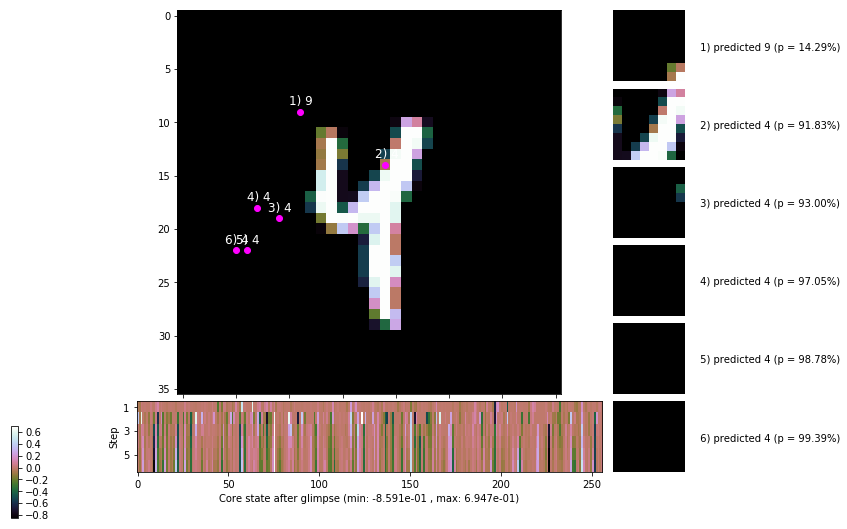


	Target class: 5 | Discounted rewards: [0.111, 1.111, 1.111, 1.110, 1.100, 1.000]


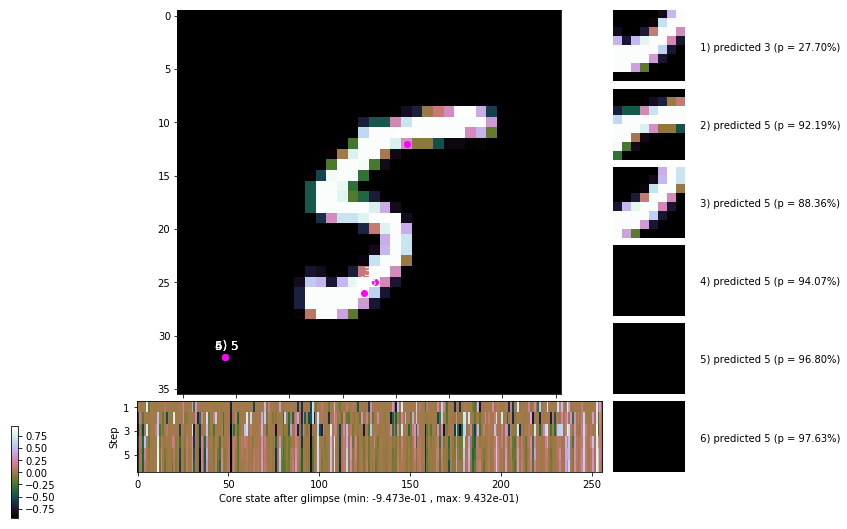

	>> class loss: 0.3154 | steps:  2.104 | reward:  4.6342 | acc.: 89.760%


In [7]:
model_info, train_info, val_info, test_info, epochs = train_eval_loop(
    model = model, epochs = num_epochs, image_size = image_size,
    train_data = train_data, val_data = val_data, test_data = test_data,
    padding = padding, optimizer = optimizer, lr_scheduler = lr_scheduler,
    class_criterion = class_criterion, error_penalty = error_penalty,
    loc_std = loc_std, random_start_loc = random_start_loc, gamma = gamma,
    grad_clip = grad_clip, steps_per_epoch = steps_per_epoch,
    max_ep_len = max_ep_len, log_freq = log_freq, viz_freq = viz_freq,
    early_stopping = early_stopping, eval_viz_freq = eval_viz_freq,
    reward_all_correct = True
)

In [8]:
print('Trained over %d epochs\n' % epochs)

for name, best_stats in zip(['train', 'val'], [train_info['bests'], val_info['bests']]):
    print('Best %s stats:' % name)
    for k, v in best_stats.items():
        print('    %s: %.2f (epoch %d)' % (k, v[k], v['epoch']))
    print('')

Trained over 78 epochs

Best train stats:
    steps: 2.18 (epoch 63)
    reward: 4.55 (epoch 68)
    accuracy: 0.90 (epoch 66)

Best val stats:
    steps: 2.11 (epoch 67)
    reward: 4.63 (epoch 69)
    accuracy: 0.89 (epoch 70)



### Training curves

In [9]:
epoch_range = range(1, epochs+1)
train_col = (1, 0, 0); train_err_col = (1, 0.1, 0.1)
val_col = (0, 0, 1); val_err_col = (0.1, 0.1, 1)

Text(0.5,1,'Weight and bias values over training time')

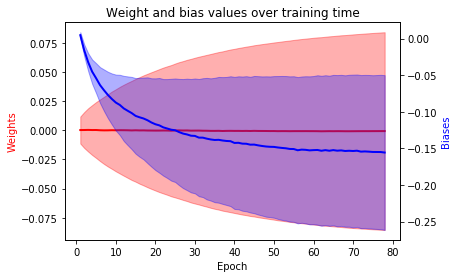

In [10]:
wts_mean = np.array(model_info['weights']['mean'])
wts_var = np.array(model_info['weights']['var'])
bias_mean = np.array(model_info['biases']['mean'])
bias_var = np.array(model_info['biases']['var'])

fig, wts_ax = plt.subplots()
wts_ax.plot(epoch_range, wts_mean, color = train_col, linewidth = 2)
wts_ax.fill_between(epoch_range,
    wts_mean - wts_var, wts_mean + wts_var,
    alpha = 0.35, edgecolor = train_col, facecolor = train_err_col
)
wts_ax.set_xlabel('Epoch')
wts_ax.set_ylabel('Weights', color = train_col)

bias_ax = wts_ax.twinx()
bias_ax.plot(epoch_range, bias_mean, color = val_col, linewidth = 2)
bias_ax.fill_between(epoch_range,
    bias_mean - bias_var, bias_mean + bias_var,
    alpha = 0.35, edgecolor = val_col, facecolor = val_err_col
)
bias_ax.set_ylabel('Biases', color = val_col)

plt.title('Weight and bias values over training time')

Text(0.5,1,'Max absolute weight and bias values over training time')

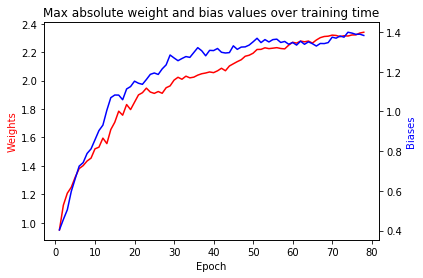

In [11]:
wts_absmax = np.array(model_info['weights']['abs max'])
bias_absmax = np.array(model_info['biases']['abs max'])

fig, wts_ax = plt.subplots()
wts_ax.plot(epoch_range, wts_absmax, color = train_col)
wts_ax.set_xlabel('Epoch')
wts_ax.set_ylabel('Weights', color = train_col)

bias_ax = wts_ax.twinx()
bias_ax.plot(epoch_range, bias_absmax, color = val_col)
bias_ax.set_ylabel('Biases', color = val_col)

plt.title('Max absolute weight and bias values over training time')

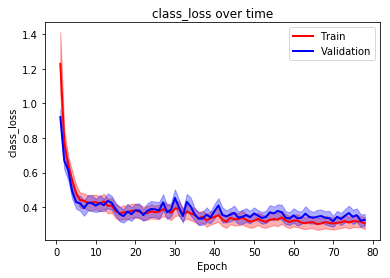

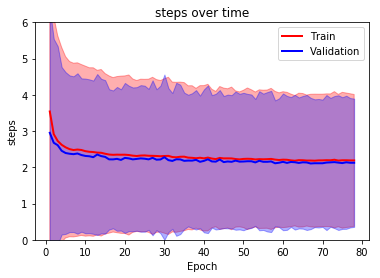

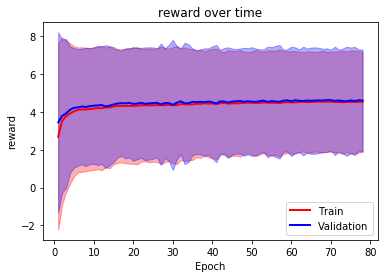

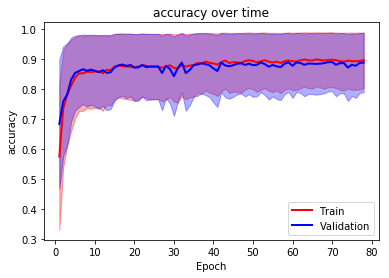

In [12]:
things_to_plot = ['class_loss', 'steps', 'reward', 'accuracy']
for thing in things_to_plot:
    train_avg = np.array([info['averages'][thing] for info in train_info['stats']])
    train_err = np.array([np.var(info['histories'][thing]) for info in train_info['stats']])
    
    val_avg = np.array([info['averages'][thing] for info in val_info['stats']])
    val_err = np.array([np.var(info['histories'][thing]) for info in val_info['stats']])
    
    plt.plot(epoch_range, train_avg, color = train_col, linewidth = 2)
    plt.plot(epoch_range, val_avg, color = val_col, linewidth = 2)
    plt.fill_between(epoch_range,
        train_avg - train_err, train_avg + train_err, alpha = 0.35,
        edgecolor = train_col, facecolor = train_err_col
    )
    plt.fill_between(epoch_range,
        val_avg - val_err, val_avg + val_err, alpha = 0.35,
        edgecolor = val_col, facecolor = val_err_col
    )
    if thing == 'steps':
        plt.ylim([0, 6])
    plt.legend(['Train', 'Validation'], loc = 'upper right' if thing in ['class_loss', 'steps'] else 'lower right')
    plt.xlabel('Epoch'); plt.ylabel(thing)
    plt.title('%s over time' % thing)
    plt.show()
    print('')

Text(0.5,1,'Gradient norms over training time')

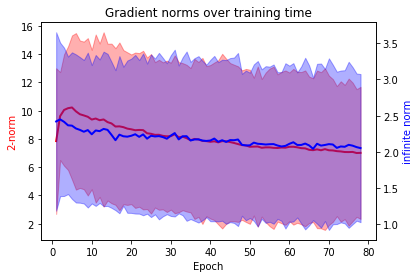

In [13]:
# Gradient stats
grad_2norm = np.array([info['averages']['grad_2norm'] for info in train_info['stats']])
grad_inf_norm = np.array([info['averages']['grad_inf_norm'] for info in train_info['stats']])
grad_2norm_err = np.array([np.var(info['histories']['grad_2norm']) for info in train_info['stats']])
grad_inf_norm_err = np.array([np.var(info['histories']['grad_inf_norm']) for info in train_info['stats']])

fig, pnorm_ax = plt.subplots()
pnorm_ax.plot(epoch_range, grad_2norm, color = train_col, linewidth = 2)
pnorm_ax.fill_between(epoch_range,
    grad_2norm - grad_2norm_err, grad_2norm + grad_2norm_err,
    alpha = 0.35, edgecolor = train_col, facecolor = train_err_col
)
pnorm_ax.set_xlabel('Epoch');
pnorm_ax.set_ylabel('2-norm', color = train_col)

infnorm_ax = pnorm_ax.twinx()
infnorm_ax.plot(epoch_range, grad_inf_norm, color = val_col, linewidth = 2)
infnorm_ax.fill_between(epoch_range,
    grad_inf_norm - grad_inf_norm_err, grad_inf_norm + grad_inf_norm_err,
    alpha = 0.35, edgecolor = val_col, facecolor = val_err_col
)
infnorm_ax.set_ylabel('infinite norm', color = val_col)

plt.title('Gradient norms over training time')